# Install & Import

In [97]:

# pip install pandas-profiling[notebook]  
#!pip install https://github.com/pandas-profiling/pandas-profiling/archive/master.zip
    
    
import numpy as np
import pandas as pd
import tensorflow as tf
import torch
import seaborn as sns
import matplotlib.pyplot as plt

from pandas_profiling import ProfileReport

from sklearn.datasets import fetch_openml
from scipy import stats
from statsmodels.datasets import get_rdataset
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
from statsmodels.stats.diagnostic import acorr_ljungbox
from statsmodels.tsa.stattools import adfuller, kpss


# Check GPU is available 

In [98]:
physical_devices = tf.config.list_physical_devices('GPU')
print("# of GPUs : ", len(physical_devices))
from tensorflow.python.client import device_lib
import tensorflow as tf 
print(tf.config.list_logical_devices())
tf.debugging.set_log_device_placement(True)
#print("# of GPUs : ", len(physical_devices))


# of GPUs :  1
[LogicalDevice(name='/device:CPU:0', device_type='CPU'), LogicalDevice(name='/device:GPU:0', device_type='GPU')]


# Utility Functions

## Show basic info of np/df

In [99]:
# print np or df information
def print_data_info(data, msg="") :
    if( type(data) == type ( np.empty([2, 2]) ) ) :

        print("\n============================")
        print(msg)
        print("============================")
        print("Type : ",  type(data))
        print("Shape : ", data.shape)
        print("Unique : ", np.unique(data, return_counts=True))
        print("Data : ", data)
        print("============================\n")
    elif ( type(data) == type(pd.DataFrame([1])) ) :
        print("\n============================")
        print(msg)
        print("============================")
        print(type(data))
        print("Unique : ", np.unique(np.array(data), return_counts=True))
        print(data.info())
        print(data.head())
        print("============================\n")
    else :
        print("\n============================")
        print(msg)
        print("============================")
        print(type(data))
        print("Data : ", data)
        print("============================\n")
    

## Show Data Frame Analysis

In [100]:
df = pd.read_csv('https://raw.githubusercontent.com/JWarmenhoven/ISLR-python/master/Notebooks/Data/Advertising.csv', usecols=[1,2,3,4])

def boxplot(df, col):
    sns.boxplot(data=df,x=df[f"{col}"])
    plt.title(f"Feature {col}")
    plt.show()

def show_df_info(data, x=None, hue=None):
    print("show_df_info : ", x)
    display(data.head(3))

    fig, axes = plt.subplots(1,2, figsize=(10, 5))
    # fig.suptitle('Features')
    #sns.histplot(data=penguins, x="flipper_length_mm", kde=True)
    #sns.histplot(x=x, data=data, kde=True, hue=hue)

    sns.histplot(ax=axes[0], data=data, x=x, kde=True) #, hue=hue)    
    sns.boxplot(ax=axes[1], data=data[x])
    plt.show()


def print_df_info(df) :
    print("====================================================================")
    print("=           DataFrame Information                                  =")
    print("====================================================================")
    print(df.info())

    print("====================================================================")
    display(df.head(3))
    print("====================================================================")
    print()


    print("====================================================================")
    print("[Columns]\t", df.columns)
    print("====================================================================")
    print()

    print("====================================================================")
    print("[INDICES]\t",df.index)
    print("====================================================================")

    print()
    print("====================================================================")
    print("=           DataFrame Description                                  =")
    print("====================================================================")

    print(df.describe())
    print("====================================================================")



    for col in df.columns :
        print("====================================================================")
        print("[ " +  str(col) + " ]")
        print("====================================================================")
        show_df_info(df, col)

        print(str(col) + "   Unique : ", df[col].unique())
        print("--------------------------------------------------------------------")
        print(str(col) + "   N unique : ", df[col].nunique())
        print("--------------------------------------------------------------------")
        print(str(col) + "   Value Counts : ", df[col].value_counts())
        print("--------------------------------------------------------------------")
        print()
        print()
        print()

        
    sns.pairplot(df)
    plt.show()

    plt.figure(figsize=(15, 10))
    sns.heatmap(df, cmap=sns.cubehelix_palette(as_cmap=True))
    plt.show()


# print_df_info(df)

# Read Data

In [106]:

path = './data'

#!ls ./

df_strain = pd.read_csv(f'{path}/S_train.csv')
df_xtrain = pd.read_csv(f'{path}/X_train.csv')
df_xtest = pd.read_csv(f'{path}/X_test.csv')
df_ytrain = pd.read_csv(f'{path}/Y_train.csv')

In [107]:
!pwd

/c/Users/SNUAI/Excercise/ML_Excercise/ML_SNU


# Show basic information of S train / X test 

=           DataFrame Information                                  =
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 600 entries, 0 to 599
Columns: 2194 entries, 0 to 2193
dtypes: float64(2), int64(2191), object(1)
memory usage: 10.0+ MB
None


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A



[Columns]	 Index(['0', '1', '2', '3', '4', '5', '6', '7', '8', '9',
       ...
       '2184', '2185', '2186', '2187', '2188', '2189', '2190', '2191', '2192',
       '2193'],
      dtype='object', length=2194)

[INDICES]	 RangeIndex(start=0, stop=600, step=1)

=           DataFrame Description                                  =
                 0             1           2             3             4  \
count   600.000000    600.000000  600.000000    600.000000    600.000000   
mean   2419.328333  16475.148333    0.735000   6907.666667  12748.211667   
std     438.971990   2265.773097    4.485343    969.271245   1787.275146   
min    1287.000000   9405.000000    0.000000   3829.000000   7903.000000   
25%    2128.750000  14925.500000    0.000000   6246.500000  11449.250000   
50%    2401.000000  16340.000000    0.000000   6880.500000  12619.500000   
75%    2699.000000  18005.250000    0.000000   7534.250000  13871.500000   
max    4042.000000  26774.000000   72.000000  10959.000000  18

,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


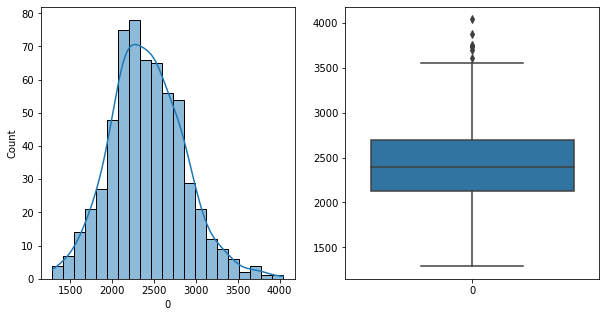

0   Unique :  [2699 2274 2450 2516 1952 2002 2783 2462 1837 1599 2286 2269 2735 3007
 2214 2468 2078 2497 2030 1914 3142 2667 2537 2405 2265 2336 2500 2136
 2851 1761 3018 2755 2872 1966 1773 2216 2325 2422 2577 1957 2168 2967
 2390 2125 3328 2840 2211 1948 2530 2920 1955 1462 1927 2153 2954 2442
 2255 2668 2554 3504 1709 2510 2502 2623 3236 2345 2570 1971 3062 2467
 2574 2848 2090 2157 2307 2791 1958 2244 2815 3731 2340 2161 2123 2947
 1583 2724 1827 3227 2744 3323 1482 1779 1926 2278 2513 2514 2097 1988
 2371 3350 2911 2709 2912 2762 3749 1783 2057 2386 2033 1993 1863 2304
 2767 2276 2181 2310 2650 2387 1657 2842 2637 2159 2373 2130 2750 2098
 2134 2175 1653 2145 3047 1324 1977 2042 2158 3156 2633 2227 3272 2786
 3410 2603 2115 2475 2105 1859 1909 2972 1659 2029 2187 2208 2196 2693
 2809 2073 2117 3701 2361 2378 2794 3014 3225 3758 2469 3023 2167 2754
 3035 3174 2047 2837 2046 2128 1674 1785 2838 1603 2802 1980 2080 1459
 2645 2449 2541 3290 2544 2252 2677 2301 2402 2410 2535 1892 18

,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


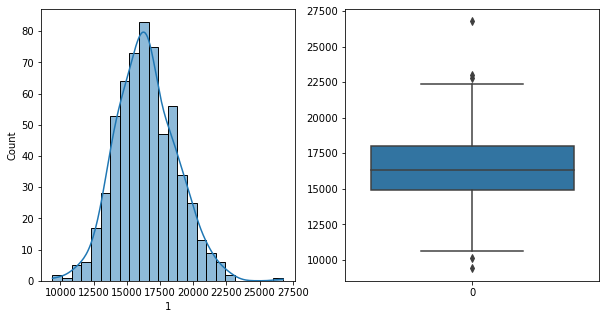

1   Unique :  [17997 18152 18228 18368 15859 15546 15929 16967 15706 10123 15257 16034
 19218 18914 18294 19845 14624 21301 14281 13769 19794 16404 16047 15890
 14902 16132 16359 11379 17502 13766 19451 18204 16885 13778 11153 17435
 16664 15574 17378 15406 18115 16637 16908 16658 18606 15509 18778 14183
 15907 17090 13598 13315 13764 15580 16421 15019 16687 18499 20560 19968
 13974 17034 16552 18114 16437 18142 16745 16056 12937 18860 22369 17476
 19016 15051 14496 17334 16148 15285 19288 15109 20072 13257 15515 16810
 13332 20398 13854 15214 15072 21189 16787 21872 13840 14564 15055 17416
 19798 19248 16207 15076 16549 18935 18231 18818 19429 11480 17851 18381
 18030 12987 18099 12896 14142 12479 14520 16646 15797 14312 17620 17451
 15050 14580 18374 17856 16240 15006 16660 13384 18086 15437 17096 14497
 15001 13493 17072 11021 14309 15199 15749 15206 13381 17943 15870 22132
 19512 22159 16667 20738 17157 15789 16489 18773 13718 18072 14282 16312
 16879 12761 16539 17638 16170 16642 

,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


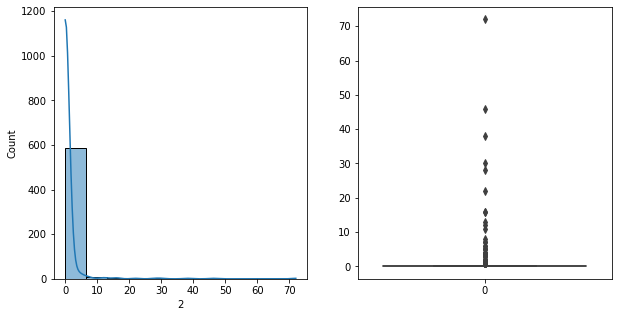

2   Unique :  [ 0  8 30  6  1  4  2  7 38 72  3 16 28  5 46 11 13 22 12]
--------------------------------------------------------------------
2   N unique :  19
--------------------------------------------------------------------
2   Value Counts :  0     531
1      28
2      12
4       6
3       4
5       3
6       2
7       2
16      2
22      1
13      1
11      1
46      1
72      1
28      1
8       1
38      1
30      1
12      1
Name: 2, dtype: int64
--------------------------------------------------------------------



[ 3 ]
show_df_info :  3


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


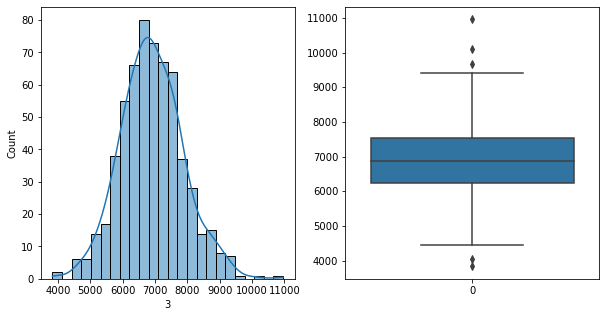

3   Unique :  [ 7262  6745  7058  6196  7445  6980  7138  7913  5197  7362  6529  6689
  7122  6679  6050  6249  6546  7285  5621  5705  6875  6901  8632  5853
  8143  7677  5977  7318  5825  8623  8865  8901  7665  6660  4610  6190
  7300  6047  6742  6892  6577  6408  6981  6073  8362  5635  6682  6277
  7361  7633  6331  4037  6074  7568  7417  7460  6606  8078  8001  7813
  6480  7267  6478  7878  7801  6966  7093  5797  7324  7345  8097  7839
  5851  5989  5693  8052  6292  7561  6873  7921  6933  5618  5489  8104
  5300  6809  6076  7769  7634  7734  5586  6189  7586  7457  7862  8175
  6475  6699  7143  7532  8548  7193  7558  7171  6690  8061  5844  6239
  6274  5356  5435  7566  5405  6719  6433  6160  5937  6381  8025  7120
  5234  6392  7992  6791  7077  7683  7061  8704  7173  5714  6908  6472
  6619  4981  4648  6532  7191  5892  6013  8874  7339  8650  7210 10098
  6228  6199  7280  6746  6415  4697  6970  8581  5746  5704  7824  8127
  6725  6737  8890  7819  6590  8170 

,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


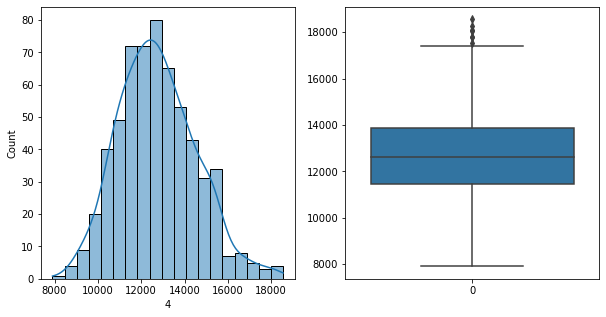

4   Unique :  [13700 14012 12814 13503 10656 11661 11120 13374 11912  9322 12164 12266
 16158 15199 13085 13199 12100 15069 12980 10526 12122 11634 12187 10975
 12838 11947 11904 11116 13451  9484 15181 15415 12328 11249  9073 12425
 14397 11290 13128 12801 14995 12275 12399 10062 13792 12644 12227 10867
 13895 14005 10667 11542 10471 12569 13079 14588 12161 16975 14268 15033
 10415 15448 11162 14330 13005 13051 11909 13830 10706 14766 17807 15205
 13811 11717 12650 12333 11802 13133 13265 13371 15117 11850  9714 11388
 10271 16352 10947 12475 12247 14313 12973 16692 10531 10156 11594 13094
 13349 14537 12137 11135 11495 12295 14216 14865 13647 11332 14328 14231
 12238 13804 13797  8712  9958 10935 10863 13906 12081 10823 12432 14008
 13344 10555 13680 13656 12955 14422 13777 13959 11936 15305  9336 10848
 10092 11852 11394 17388 10966 12500 11035 12026 13998 11550 15114 13702
 14569 14215 14958 12935 15654 13089  9430 12362 16927 10597 13806 13635
 10520 12169  9691 15208 13039 11659 

,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


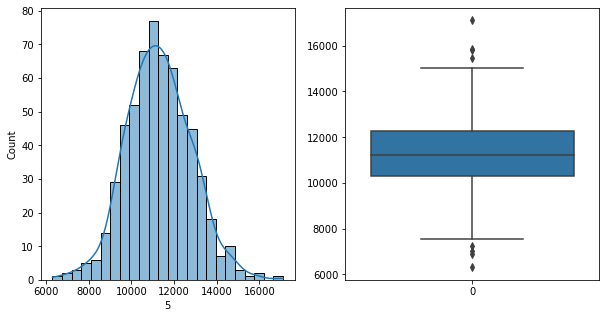

5   Unique :  [11147 11664 13077 14309  9714  9730 11384 11207  9708  7032 12028 10665
 13452 12709 10970 11077  9359 14652 10207  9213 12961 10504 11920 12555
 10384 11466 11229  9254 10883  9662 13547 13075 13120 10344  8205 10432
 10302  9436 11434 10675 11284 12741 10975  9579 14967 10782 11810 10393
  9898 12733 10087  9396  9287 11092 13466 13203 11179 13601 12433 13026
  9924 12703 10368 12211 13175 14116 12749 11867  8520 11799 13950 12509
 13613 11543 10878 10654 11924  9689 11421 13673 14439 11256 10188 11232
  9349 13388  9763 10255 10037 14255 11469 12956  7877  9613 10272 11120
 11641 10634 10015  9925 11698 13770 11782 12827 12170 10640 11713 13920
 10145 10367 14771 11343  8933  9972  9355 10273 12251 11915 11214 11196
 12035 12046  9333 11523 11697 10860 11413 11276 10481 13518 10630 12503
  9584  9165 10462 12719  7231  8260 10317 11748 13224  9380 12804 11177
 14551 11933 14500 10601 10650 10451 11097 10164 12371  9110 12828  8579
  9693 11133  8996 10524 11898 12990 

,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


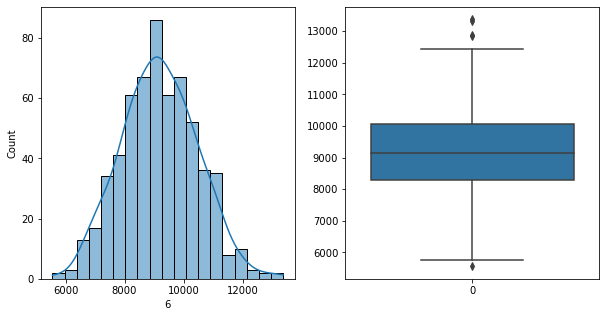

6   Unique :  [10643  9310 10697 13317  7970  8473  9871  9788  8817  8220  9339  8641
  9913 11091  9115  9431  9641 11191  9887  7397  9636  9409  9796  8335
  9324  9273  9302  8031  9702  7099  9855  9540 10038  7749  7258  8863
  7742  9584  7373 10179  9601  9224  7812 11638  9214 10787  8280  9935
  9783  8093  8595  9083 11549 10454  8977  8983 10775 10952  9025  8184
 10715  7104  9187 11154 10530  8991  7920  7270 11118 12068 11759 10510
  9572  7453  9543  9840  8164 10716  9890  9791  9022  8226  9131  6890
 10032  8156  7978  8744 10210  9542 10547  7776  7791  6718  8198 10126
 11779  8685  8703  9500 10315 11587  8343 10652 10187  9011  7456 10323
  8035  7506  8251  7442  9457  8692  8292  9374  8667  9134  9854 10228
  9243  8701  9070 10118 11025  9861 10040  8406  7021  9145 10403  6650
  6747  7853  8308 10131  8347 10543 11340  9812 10243 11029 11092 11127
  8153 11197 10800  8591  9369  7446  7837 11122  7768  6755  9719 10336
  9078  9086  9524 10541  8509 10439 

,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


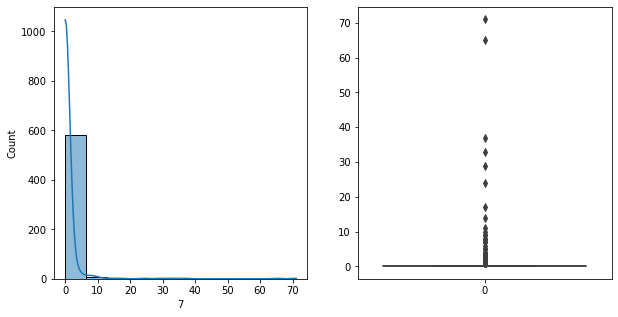

7   Unique :  [ 0  1  2  9 10 29 14  4 71  7  5  8 24  3 37  6 17 11 33 65]
--------------------------------------------------------------------
7   N unique :  20
--------------------------------------------------------------------
7   Value Counts :  0     527
1      25
2      14
3       8
4       5
8       3
5       3
7       2
9       2
14      1
71      1
29      1
10      1
24      1
37      1
6       1
17      1
11      1
33      1
65      1
Name: 7, dtype: int64
--------------------------------------------------------------------



[ 8 ]
show_df_info :  8


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


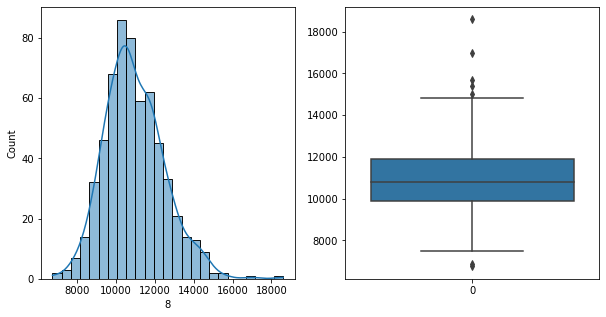

8   Unique :  [10932 12054 10639 10434  9518 10488  9790 12018  9997  6750 12611 12213
 13811 14215 10552 12316  9275 14655  9397  9438 11930 10507 11704  9784
 10262  8576 10572  8593 13549  9496 11997 12072 10853  9449  8891 11809
 10675  9747 11440 11884 13964 12488 10477  9106 10706 11740 10831  8803
 14345 11643  9097 10576  9656 12519 11811 11788 10018 13722 12375 10950
 10006 11993 10680 10939 11502 11763 10798  9774 10546 14760 14449 14226
 11423 11442 11516 10362 10138  9852 10618 13128 11352 11457 10909 10828
  8759 13013  9893  9040  9989 12662 11706  9279  9587  8851 12130 11990
 12239 10943  9596 10446 11813 10839  7882 11539 11791 10416  9468 10149
  8285  8430 11142  9871 10227 11807  9638 10871  9062  9726  9767  9612
 11911 11845 10811 11454 11836  9510 12804  9459 10460  9710  9301  9366
 14270  9937 10626  9529 11068  9073 12961 12264 12531 12875 11335 10629
 13976 13156 12180 10981 14225 10125 12113 11165  8721  8597 10037 12499
 11541  9885  9632 13918 11775  9675 

,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


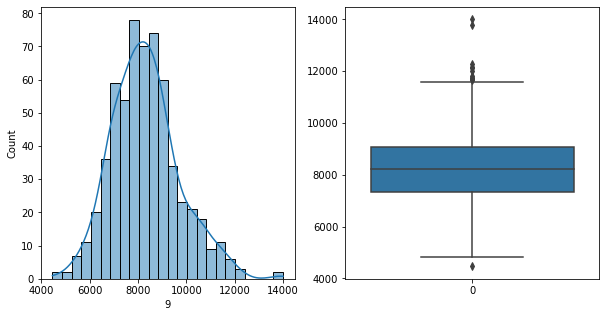

9   Unique :  [ 8115  6974  8944  8250  6422  7686  7065 11991  8634  5186  6852  9044
  7981  8247  8427  8875  9560  8761  6615  8325  7610  6910  8217  7310
  9030  7096  7131  6406  7885  6825  8820 11400  8721  5982  4812  8481
  8863  6958  8482  8033  8473  8277  6466  8525  8452  6884  7881  7725
  8095  7988  8628  7174  6879  8297  8365 10350  7738 10889 10448 10737
  8132  8831  6795  8581  8932  8479  8713  6187  7202  9544 11248 10734
  8963  8830  7434  6903  8300  7138  7797  8846  9874  7489  5894  8476
  6162  8458  5881  6137  8064 10103  8073 10248  5986  6392  8176  9470
  7539  9080  7832  7766  8567  9669  8992  8919  8637  9172  8358  8193
  8673  7465 12122  5635  7748  9339  5558  7910  8042  6169  7088  6773
  8973  7757  8045  6556  7284  9900  9825 10685  5731  7590  6586  7821
  6253  7880  6677 11423  6570  6496  8448  7651  8978  8347 10275  8298
 11175  8220 10768  8173 10731  7383  9299  7445 11051 10531  8135  8897
  7496  7774  8113  5961  9064  9610 

,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


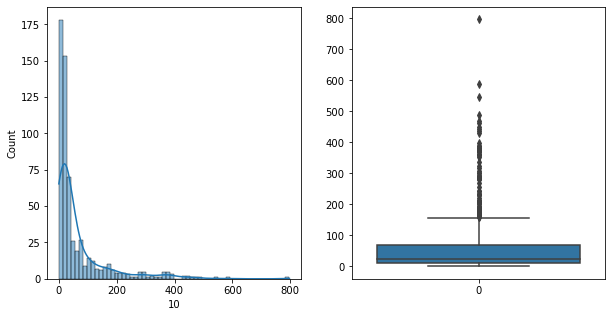

10   Unique :  [ 66  15  12  19  24 168  16  21   6   8 211 173  13  70  60   9  78  80
  28  75  33  56  25 172  10 353  18  50 133   1 202  22  43 244  32  36
  73   3  46  79  72 150   2   5 285  51 437 101   7 193   4   0  11  20
  29 545  27 487  30 141  35  45 177  62 797 368  40 153  26 283  37  17
 110 281  38 397  53 114  14  99  91  23 118 588 212 360 160 108  31  81
 102 117  49  93 188 470 180 359 256 122  74 373 300 176 376 450 162 382
 463 292 105 286  95 293 131  84  34 371  71 301 233  64 374 242  92  61
 132 148 144  98  59 209 171 166 362 387 190 291 390 323 268 104 442 220
  65 234  68  42 232  96 121 136 120  44  39  77 113 100 184 128 195 134
 112  58 138 181 229  54 109 318 336  86 430 155  76 215  82 309 206  69
 282 130]
--------------------------------------------------------------------
10   N unique :  182
--------------------------------------------------------------------
10   Value Counts :  13     26
8      22
9      19
21     17
5      16
       ..
122  

,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


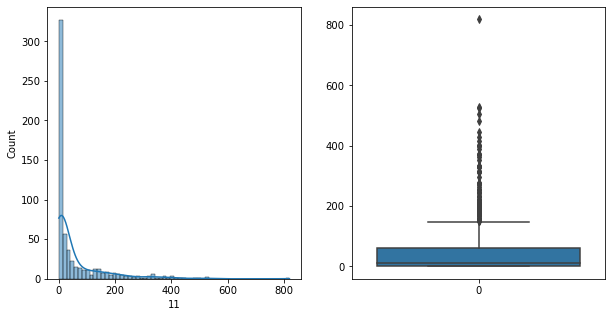

11   Unique :  [ 47   3   4   2  11 122   6   9  29 173   0 119  33   1  12  23  55  20
  32  34  13 254  17 313   5 140 215  14 329  50 205 252  10 257 372 100
  40 276  21 108 525  94 530  24  42 139  30  52 175 819 388   7   8 186
  70  28  56 172  88 233 328  26 120  46  59  16  15 142 101 133 482 109
  19 352  38 231  68  49 102  95 447 187  84  80 174 128  36 314 220  75
 246  22 200 127  39  48 137 330 244  71 199 364 402  78 170 332 104  91
 208 278  54  65 203  76 166  53 107  86  89 144 333 156 264 171  18  73
  51 150 180  81 177 149 155 135 416 223 369  25 505 194 212 428  31 158
  74 136 201 271 115  43  62 196 138  41  58  64 112  98 125 183 147 192
 181  37 126  82  35 148 106 162 317 296 123 398 159 152 232  72 209 124
  60]
--------------------------------------------------------------------
11   N unique :  181
--------------------------------------------------------------------
11   Value Counts :  0      61
1      49
2      44
3      35
4      25
       ..
447     1

,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


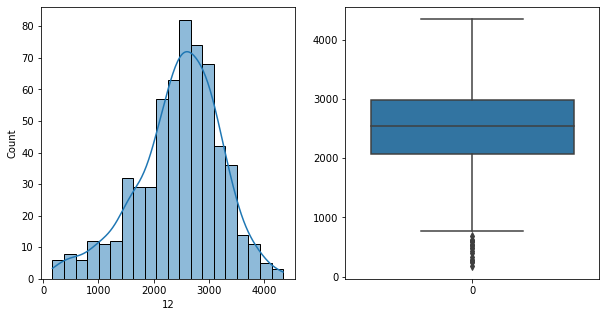

12   Unique :  [2958 2802 2895  960 2670 3016 2092 2919 2090 1613 1501 2302 3384 3247
 1921 2986 3210 2705 1578 2522 2233 3197 2972 1527 4117 3194 2821 1023
 3046 3121 3023 2630 2329 2947 1320 2467 3346 2064 2594 2861 2355 2810
 2370 3001 1193 1214 2770 2519 2498 2210 1584 2187 1893 2995 3489 3015
 2699 3360 3006 2865 2688 2909 2656 3238 2479 3037 1903 2059 3142 2354
 2990 2640 2806 2250 2419 2466 3147 1969 2910 2526 2484 2179  677 1749
 2295 3442  275  901 1663  940 2687 3026 2695 1436 3664 2941 2510 3198
 2060 2863 2956 3405 3440 2318 2647 3040 2525 2680 1575 2832  402 1148
 2429 1642 2111 2608 2321 1991 2360 2565 2156 1861  436 2496 3660 2401
 2924 2587 3108 1794 1119 2454  879 2511 1240 2121 2346 3145 2140 2473
 2706 2477 3056 2625 2336  334 2326  242  239 2855 2068 2747 1871 1559
 2291 1997 2901 3401 2994 3506 3789 2543 3518 1729 3740 1470 2230 3309
 2860 3244 1805 1479 2166 3453 1823 2544 1547 2364 1804 2242 3819 2571
 2085 1002 2492 3100 2128 3032 2529 2538 2211 2795 2556 1013 2

,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


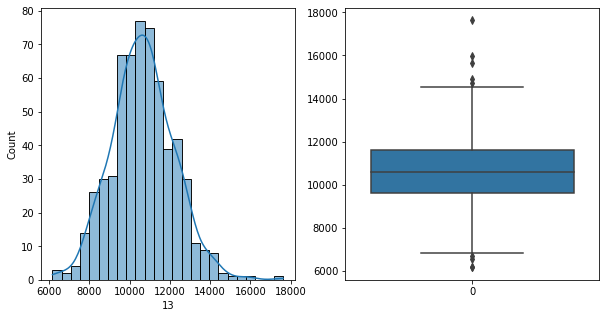

13   Unique :  [10722 10902 11032 12212  9127  9920 10858  8761 11213  7672  9984 11586
 10848 11695 10388 11603 11441 14132 10762  9990 11245 10502 12765 11418
 10377  9532 10006  7954  9834  8176 11763 12591 10075  9767  7961 10525
 10500  9433 11448 11142 10933 10795  9252  9711 12312  9577  9849 10072
 10605 13155  9958  7995  7922 11437 12399 10734 10913 14153 11023 11670
  8152 10832  8469 12236  9496 11774 10979  9646  8251 10975 12497 13126
 12314 10166 10235 10846 10368  9945 10587 10565 13772 10600  9052 11026
  8829 12523  6581 10623  8657 12393 12258 12795  9699  9803 10422  9831
 11100 13301  9939  9053 12142 12268 11889 11905 11877  8070 12604 13135
  9034  8355  8802  7613  8944  9516  9029  8950 10465  9571 11188  9677
 12133 11280  8745 10484 12842 10823  9771 11070  9421 11541 11226 11072
  8068  9002  9499 13090  7818  8939  9913 10040 11230  8524 11371  8811
 13533 13138 14057  9245 17624  8415 10218  9368 13019 11419  9613  8866
 11220  8365 10455 11109 12013  9688

,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


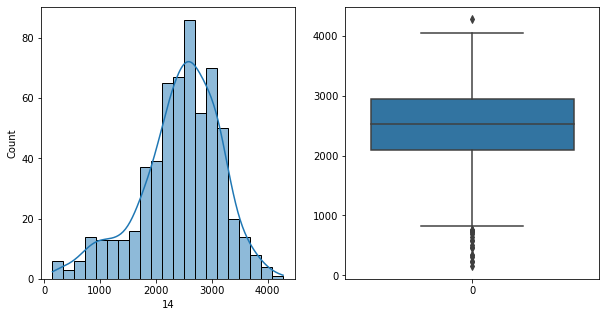

14   Unique :  [3166 2651 2100  565 2669 3039 2088 3017 1883 1285 1965 1992 3144 2702
 1857 2471 2641 2609 1617 2316 2185 3025 2818 1385 3679 3000 2691  894
 2696 3760 2987 2101 2472  902 2601 2898 2207 2346 2678 2205 2647 2777
 2850  926 1044 2633 2211 2689 2355 1507 1047 2076 2937 3402 3029 2261
 3165 3153 2799 2814 2592 2975 3045 2720 2653 2255 2275 2893 2109 2915
 3121 3140 2224 2498 2339 3020 2151 2956 3412 2288 1939  454 1996 2507
 2982  344 1055 2162  644 2595 2984 2225 1247 3768 2416 3251 1814 2563
 2912 3291 3079 2297 2776 2848 2767 3101 1841 2957 2478  885 2371 1767
 2293 2946 2407 2754 2269 2688 1744 1300  340 2310 3200 2717 3046 3360
 2405 2780 2039 1330 2383 1746 1167  690 2257 2439 3073 2447 2659 2541
 2515 3493 2618 2516  305 2954  235 2855  507 2925 2137 2430 1867 1289
 2184 1013 2520 3163 3276 3008 3387 3673 2450 3162 1761 3548 1361 2567
 3160 2878 3237 1799 3467 2116 2428 2165 2289 1851 1920 4025 2299 2028
  927 2477 3209 2486 2771 2627 2667 2664 2458 2712 1059 2887 2

,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


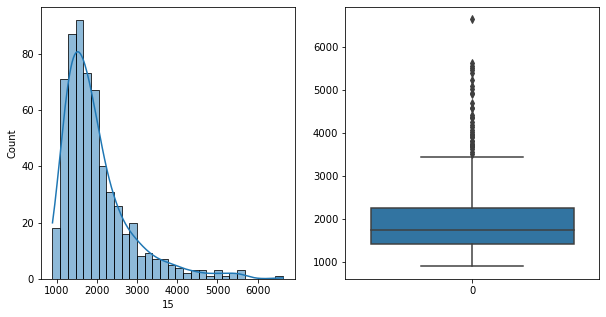

15   Unique :  [1621 1574 1636 2583 2744 1496 2373 1278 1119 1568 2417 1315 1715 1397
 1090 2995 1466 1774 1418 1448 1889 1696 1839 1775 2411 1955 1417 2058
 2579 1982 1681 1669 1859 1019 1793 1629 1204 1024 1961 1181 1831 2249
 1176 1816 2961 2674 1326 2477 1533 1289 2341 1482 2841 2016 1593 1248
 1468 2486 1611 1229 1302 1689 1868 1277 1258 1751 1761 1032 2540 3402
 4347 1615 1298 1293 1246 1330 1014 1532 3621 3739 4563 2077 2665 1286
 2429 2871 1613 2102 1255 1965 2567 3214 2401 1569 1794 1491 1409 2480
 2125  980 1999 1863 2743 1558 2281 2891 2002 2816 2037 1950 3369 1644
 2798 1092 3105 2049 1974 1385 2300 1275 1993 1446 1213 1734 2161 2576
 1618 1048 1182 3155 2009 2720 1444 1108 1143 1687 1826 2454 1809 1817
 1511 2662 4402 5023 4180 1416 2144 3437 2866 2965 2778 2803 1141 2355
 1304 1932 2275 1548 1353 1396 1479 2085 1856 1272 2728 1588 2054 2183
 1542 2098 2393 1601 1079 2181 1832 1711 1676 1002 2459 3895 1252 2832
 1297 1776 1662 2978 2922 3351 1440 1639 1324 5451 1314 1726 1

,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


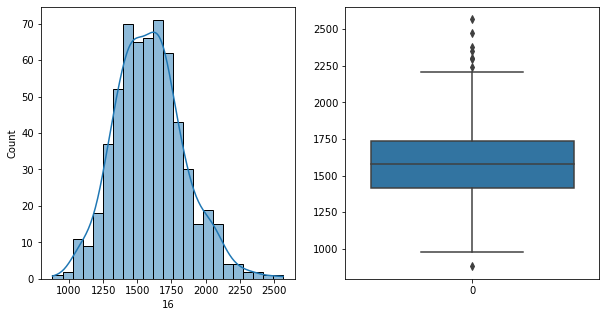

16   Unique :  [1735 1555 1983 1797 1631 1964 1562 1291 1284 1216 1064 1559 1612 1809
 1519 1642 1392 1452 1658 1257 1935 1661 1423 1900 1671 1426 1323 1413
 1674 1258 2001 1868 1577 1699 1485 1800 1981 1358 1563 1506 1644 1695
 1742 1212 1880 1543 1470 1550 1669 2105 1711 1053 1332 1294 2201 2050
 1982 1761 1566 1376 2072 1352 2099 1750 1726 1688 1402 1628 2306 1428
 1640 1718 1572 1568 1306 1794 1790 1638 1525 1585 1215 1398 2117 1693
 1676 1081 1590 1429 1300 1288 1357 1567 1384 1513 1209 1401 1684 1663
 1656 1775 1373 1757 1849 1097 1571 1477 1532 1522 1339 1692 1343 1624
 1367 1490 1578 1885 2031 1771 1838 1907 1459 1655 1702 1341 1279 1340
 2239 1176 1552 1450 1691 1866 1362 2188 1931 2375 1440 1447 1271 2075
 1826 1445 1458 1580 1687 1949 1803 1603 1609 1823 1881 1721 1913 1817
 1772 1596 1518 1544 1592 1833 1453 1872 1500 1606 1397 1635 1193 1854
 1511 1336 1475 1331 1434 1442 1739 1115 1786 1995 1621 1395 1410 1360
 1448 1650 1382 1290 1703 1802 1322 1604 1795 1729 1385 1743 1

,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


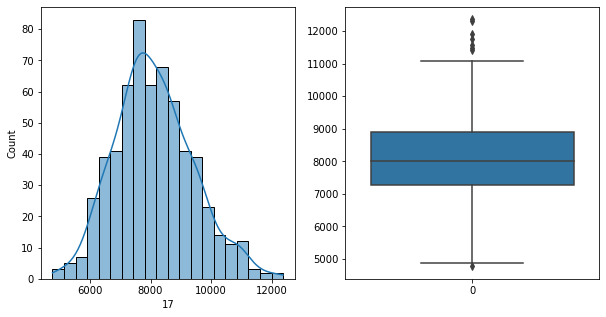

17   Unique :  [ 7548  8229  9764  9495  7234  8549  8637  8480  6870  4767  7379  8467
  7741  8858  7897  7011  8015  7520  8435  8374  9896  8194  8192  7665
  9719  8281  7738  6813  7768  6098  9192 11470  8059  6377  7693  9377
  8564  6644  9010  7479  8911  7974  7585 11068  8240  9051  8293  6917
  8678  9356  7682  8658  6650  9124  9062  9470  8183  9312 10418 10388
  7627  8883  7515  9819  7909  8795  6904  9491 10218  9135 10541  6946
  6664  8686  9801  6646  7902  5923 10013  6080  6492  8964  6794  7478
  7983  6500  6405  8348  8142  8502  6563  6170  6863  7018  9361 10990
  6955  6485  9123  8592  9702  9725  7334  8573  9458 10792  7821 10336
  7721  4866  8200  7132  8207  8698  7298 10061 12366  7474  5589  6516
 10158  7790  9739  7364  8018  6481  7859  7258  6510  7269  7156  9761
  5811  6219  6159  6567  8499  7537 11027  8011  9503  9206  8733  6232
  9701  8075  8591  9161  7752  8488  8675  7530  8590  6893  5975 11096
  8665 10223  7424 10775  8514  7302

,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


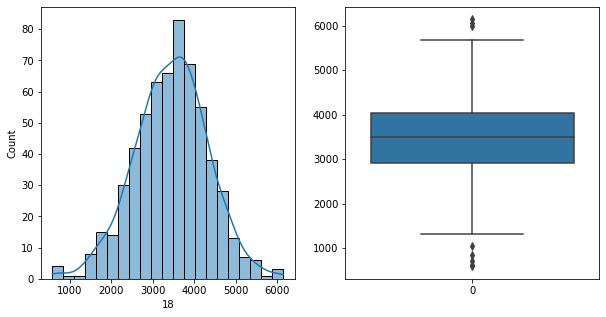

18   Unique :  [3946 3308 3140 2937 2556 2637 4424 3433 1518 2631 2361 4073 4085 4269
 2744 3130 2301 3314 3709 1989 3039 4310 4798 3535 3703 4262 3800 3256
 4495 2971 4856 3915 3869 3300 1425 3510 3502 2909 2907 3485 4434 2947
 4033 2244 3546 3004 3506 3073 3722 3666 3298 1846 3647 3828 4418 4900
 2994 3789 4058 3235 1739 3745 4126 4018 4487 4397 3893 3750 2610 3354
 4767 2840 3128 3509 3663 2769 2804 3093 4105 2905 3195 2647 2212 3387
 1544 5358 3595 6142 3970 3600 1604 2451 2526 2736 4287 3176 2998 3362
 4385 4078 4110 4038 3297 3799 4720 3131 3277 3306 4669 1819 4754 3737
 2047 3832 5527 4765 4215 4809 4255 3261 2981 4019 3482 3411 2599 2877
 3549 5322 2327 4512 3211 3963 3567 3691 2363 4353 3005 4064 4086 4187
 4814 2388 3237 2288 3414 2660 3965 1953 4183 3692 3268 3940 2136 2739
 3752 3919 2705 2946 4864 3043 3080 2626 4079 4483 4853 2935 3719 1046
 3603 3557 3803 1875 3913 2797 2399 3218 4121 1552 4248 2595 3787 2885
 2029 2593 4219 2173 3820 2967 2581 2492 3172 3886 2389 2486 2

,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


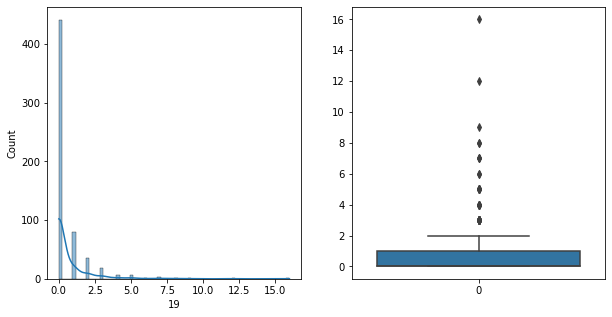

19   Unique :  [ 8  1  0  3  2  5  7  9  4 12  6 16]
--------------------------------------------------------------------
19   N unique :  12
--------------------------------------------------------------------
19   Value Counts :  0     441
1      80
2      36
3      19
5       7
4       7
7       3
8       2
6       2
9       1
12      1
16      1
Name: 19, dtype: int64
--------------------------------------------------------------------



[ 20 ]
show_df_info :  20


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


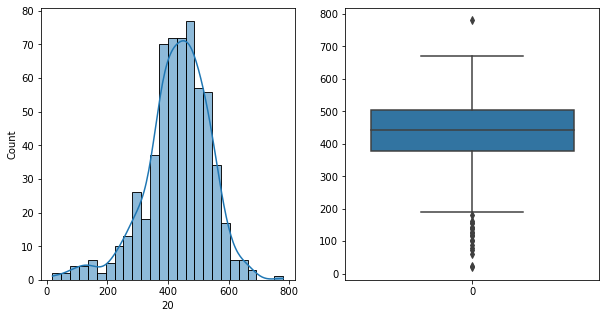

20   Unique :  [446 485 605 119 308 476 367 528 235 217 331 375 475 670 379 359 457 421
 290 390 512 429 407 222 511 453 396 292 477 335 573 532 373 541 246 394
 516 376 424 443 365 452 389 350 486 397 357 445 471 128 266 505 563 509
 481 531 487 524 555 360 434 371 400 664 599 635 454 496 572 436 425 411
 461 378 144 385 538 105 392 336 523 662 182 263 380 514 383 576 464 416
 648 533 399 535 465 543 382 325 435 521 230 310 372 315 448 451 440 449
 423  72 419 403 551 250 426 298 468  79 483 482 480 189 406 139 450 138
 519 285 467 283 415 579 631 592 780 458 413 508 660 493 374 574 568 484
 525 404 356 251 502 338 327 321 306 577 428 495 491 442 427 522 412 410
 363 504 529 548 539 530 564 439 405 116 500 553 422 393 157 447 387 474
 518 210 534 560 546  23 270 366 545  99 253 370 408 349 364  61 286 215
 441 401 490 237 381 517 417 462 460 479 262 433 488  19 369 537 355 295
 507 494 536 289 418 562 499 241 282 430 402 388 386 503 466 328 556 469
 294 571 628 542 420 547 667 497 395

,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


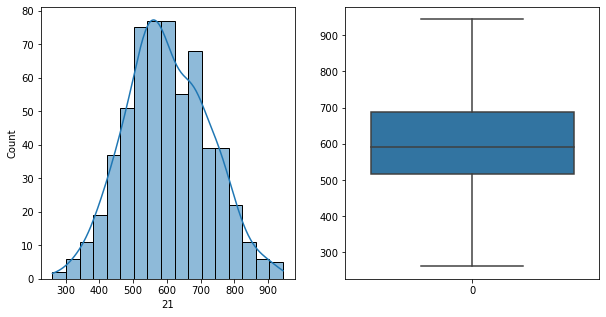

21   Unique :  [762 584 640 628 523 437 576 679 322 484 474 656 848 744 491 607 672 535
 396 347 544 857 406 735 494 504 756 469 753 634 694 578 329 633 711 436
 555 550 737 522 566 261 697 426 456 390 749 686 603 380 648 662 534 826
 623 667 691 620 889 742 657 594 727 438 684 924 493 593 581 529 802 748
 541 739 567 530 423 443 508 599 458 616 447 718 597 378 408 601 665 596
 746 755 562 465 681 404 612 269 559 759 442 626 540 887 450 791 714 573
 701 658 542 741 488 433 473 605 444 439 712 715 631 729 552 778 583 556
 644 666 514 722 331 716 476 609 401 502 604 703 663 509 630 914 721 560
 470 676 388 660 624 413 547 526 424 515 700 792 513 564 592 359 506 333
 441 881 772 503 661 539 532 587 507 602 411 572 728 689 698 475 743 632
 606 799 754 361 685 805 690 516 357 481 557 501 455 590 776 512 472 793
 675 638 659 673 688 402 480 533 553 561 528 649 613 731 575 669 589 777
 324 655 346 478 645 432 434 524 453 500 651 586 520 858 409 531 763 680
 518 342 468 394 785 460 549 580 641

,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


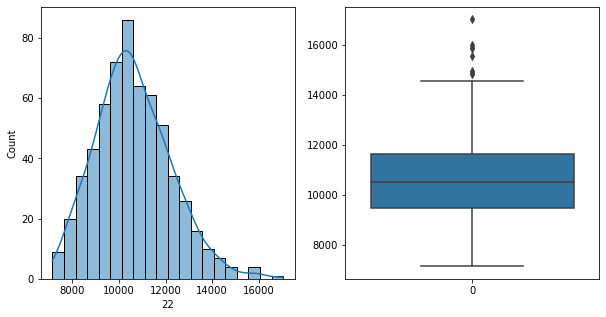

22   Unique :  [12508 10859 11590 15896 10308  9787 10961 11132  9821  9015 10932 10134
  9877 12243 11040 12211 10440 13037 11544  9702 10532  9662  9812  9490
 12514  9265 10474  9136 10968  7760 11155 10866 10284 10130  8406  9791
  9247  8116 10516  9561 10204 12714  9511  9945 14407 10293 11775  9111
 11679 13186 10020 10142  9559 11324 11277 10933 10066 12708 12613 10746
  8104 11781  7900 11985 11635 12432 11097  8961  7921 13057 14566 13009
 12295 10771  9962 10099 12059  9904 11423 13036 13803 10715  9415  8396
 12269 10540  9793 10785 11284  9505 13282  9731  8911  8612  8874 11114
 12645  9391 10008  9772 10909 11799 10602 12551 10555 11054 11762 10397
  8274  8883 10696  8246  9060  8217  9970 10652  9159 10520 10534 11131
 11687  9204 13184  9902 10523  9494 10285 12104 12421 11443 10688  8323
  7844 10585 12564  8671  8090  9284  9591 12219  8292 12733  8774 14961
 11962 12576 10221 11970 11512  9648 12954 12171  9488  9925 10414  9108
 12025  9356  9150 11286 11184  9739

,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


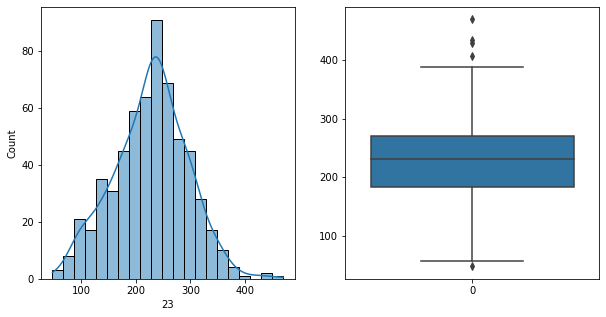

23   Unique :  [333 253 285 228 196 216 190 311 151 219 179 181 352 292 242 231 204 135
 223 233 171 256 290  99 224 267 373 194 239 317 235 218 191 180 249 208
 268 257 244 245 288 238 283 143 155 248 166 296 293 251 433 272 309 241
 274 270 229 255 348 307 302 232 349 112 243 207 215 158 282 265 388 206
 156 304 271 328  90 246 380 174 303 188 355  86 217 291 227 236 266 281
 368 310  73 142 289 159 140 146  57 263 221 261 321 298 286 262 130 200
 185 250 313 139 222 345 469 103 199 331 240 225 306 187 269  89 356 252
 114 157 264 230 144 259 115 295 209 214 120 258 254 184 148 101 175 287
 273 110 220  74 173 152 129 165 132 210  87 365 202 198 315 429 167  96
 226 237 312 109 344 342 100  81 160 137 193 195  77 178 131  84 183 205
 162 163 203 186 211 234  62 122 138 336 164 301 113 150 189 276 168 406
  98 169 329 347 147 340 318 299  92 102 134 308 124 247 176 117 379 320
  91 277  48 294 284 104 326 119  88 123 359 161 335 126 325 136 133 192
 177 197 280 260 339 108]
----------

,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


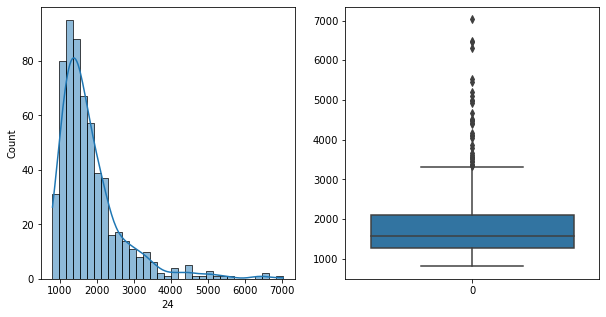

24   Unique :  [1509 1353 1384 2074 2631 1249 2514 1465 1109 1179 2129 1256 1391 1203
  970 2867 1461 1552 1489 1280 1706 1604 1854 1495 2224 1693 1511 1721
 2751 1893 1544 1285 1550 1050 1767 1549 1077  925 1322 1070 1745 2179
 1626 2411 2167  966 2608 1584 1086 2053 1423 3031 1867 1419 1152 1120
 2160 1451 1138 1228 1363 1669 1266 1018 1656 1701  859 2682 2598 5539
 1319 1121 1288 1059 1153  884 1289 2115 4111 4033 1911 2325  999 2071
 2238 1829 1502 1402 1411 1603 1972 3000 2173 1278 1793 2472 1394 1578
 2059 1888 1063 1758 1697 2370 1396 2211 2539 1969 3312 1892 2206 2534
 1769 2825 1901 1025 2783 1986 1864 1216 2645 1930 1275 1081 1637 2041
 1525 2201 1448  946 1307 3533 2030 2689 1358  923 1045 1782 1619 2221
 1842 1943 1338 2327 4495 4994 4972 1204 1813 1641 3289 1409 2136 3360
 2094 1168 2069 1082 1837 2818 1335 1296 1291 1154 1253 1225 1643 1860
 1085 2329 1265 1790 1848 1422 2272 2285 1551 1636  911 1666 1505 1613
 1463  849 2194 3085 1046 2821 1298 1066 1556 1624 2953 2448 3

,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


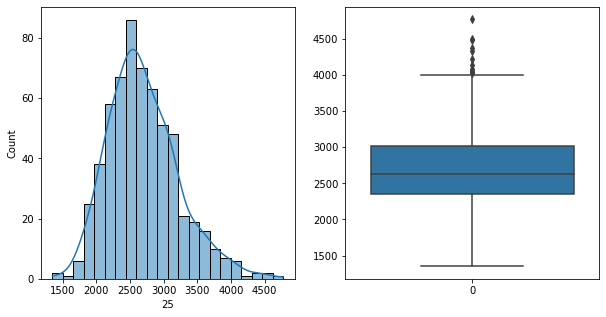

25   Unique :  [3674 3193 3309 4495 2755 2359 3385 2908 2533 2580 2705 2483 2777 3204
 2803 3425 2433 2554 2948 2547 2832 2658 2973 2378 3245 2322 2439 2010
 3010 2424 2904 2459 1459 2485 3477 2250 2134 2749 2828 3557 2894 2660
 1707 2833 2719 3225 1872 3505 2740 2177 3600 2126 3085 2774 3295 2596
 2142 2706 2564 1819 2549 2584 2710 2955 2991 2212 1974 1952 3095 3345
 4772 2942 2520 2034 2356 2492 2452 3440 2895 2573 2081 2566 3226 2230
 2799 3022 2352 2644 2100 2906 2345 2053 3601 3069 2493 3510 2868 2949
 2716 3099 2388 3116 3108 2171 3120 2467 1681 2925 2557 2413 2271 2260
 2556 3067 2488 2383 3263 2535 2883 3033 2523 2434 1854 2339 2501 2550
 4217 2069 2384 2840 2449 2115 2418 2980 2474 3656 2784 3457 2330 3765
 2712 2797 2603 3790 3066 2066 2702 1946 3042 2166 2518 2333 3057 2055
 3049 3090 2757 2928 2207 2745 2336 2870 2414 2953 2076 3123 2450 2570
 2185 1919 2646 2355 3571 2758 1349 2241 1615 3034 3710 2688 2456 2885
 2900 2471 3594 2510 2912 2639 2299 2787 2430 2215 2204 2067 1

,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


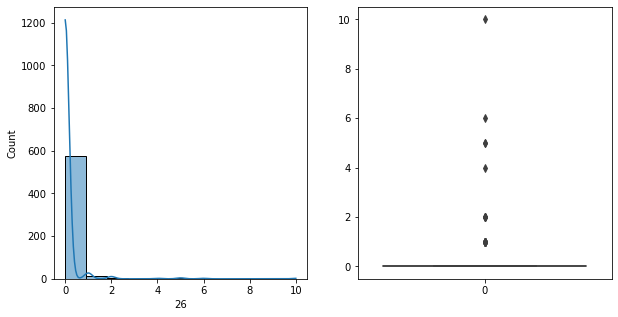

26   Unique :  [ 0  2 10  6  1  4  5]
--------------------------------------------------------------------
26   N unique :  7
--------------------------------------------------------------------
26   Value Counts :  0     577
1      13
2       5
5       2
10      1
6       1
4       1
Name: 26, dtype: int64
--------------------------------------------------------------------



[ 27 ]
show_df_info :  27


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


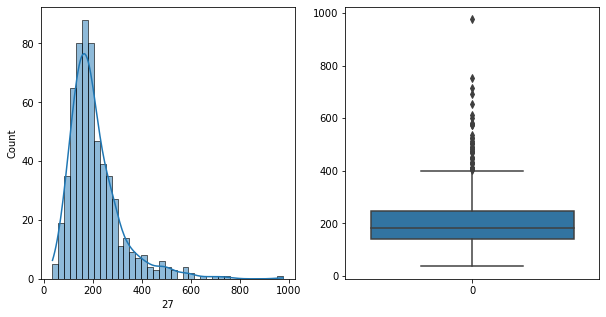

27   Unique :  [191 203 151 161 388 210 249 148 127 573 180 120 141 270 163 139 340 212
 221 292 125 272 601 232 134 297 714 110 218 251 317 274 169 143 112 227
 146 179 154 128  48 289 412 137 209  75 217 294 168 153 200 129 136 263
 165 205 245 157 273 614 178 162 103 145 473 281 132 204  92 177  98  87
 194 175  81 691 524 172 224 269 277 225 130 330 242 287 449 214 366 135
 105 186 223  77 271 149 354 174 159 259 184 199 360  61 170 208 282  90
 190 197 121 231 183 278 580 576 503 104 195 409 310 164 333 202 268 206
 304 491 309 155 238 189  95 255 173 158 160 181 185 117 207 144 239 123
 118 196 327 267 119 358 193 215 375 481 343 505 124 325 133 122 367 156
 235 240 329  89 404 513 976 261 400 192 452 182 424  66 295  82  76 537
 256 265 188 201 226  94 302 213 198 293 374 142  36 220 754 303 150 276
 236 250  50 237 477 113 140 280 152 176 138  65 335  73  59 114  91  85
 167 171 253  41  78  71 244 106  97 233 100 246 279 290 254  96 234  84
 389 109 434 332 187 312 166 504  80

,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


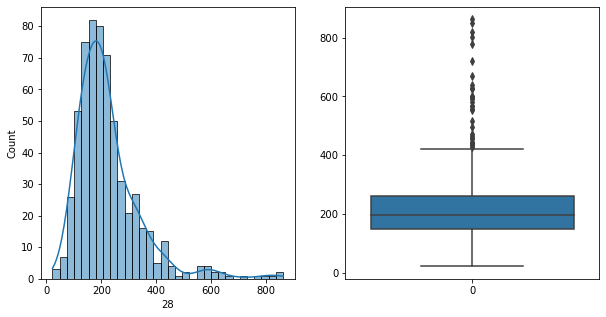

28   Unique :  [202 175 161 113 180 281 205 130 102 383 154  66 145 251 144 208 346 160
  71 137 159 339 189 263 602 170 232 194 567  72 268 256 313 223 221 152
 115 209 262 279 132 136 105 322 109 317 103 171 121 308 181 191 149 172
 201 163 238 217 252 273 197 283 354 818 640 151 120 186 284 118 406 580
 276  75 178 222 125 155 164 158 248 285 599 325 131 445 382 226 239  79
 148 340 234 309 228  88 146 211 150 176 270 204 216  91 318 192 324 214
 123 422 157 314 107 299  99 272 225 298 219 421 719 200 162 166 417 187
 174 235 220 363 290 598 359 193 110 328 168 179 247 212  76  82 230 289
 129 391 297 101 218 323 240 165 376 367 141  97 249 203 275 379 213 215
 185 198  74 143 779 400 862 207 434 419  47 122 227 182  83 236  23 568
 104 259 134 199  93 244 330 327 229  78 117  85 849 440 370 333  22 190
 124 188 555 437 126 282 195 224 260 128 385 108 147 133 316 241 135 250
 169 344 341 173 372 242 116 253 138  70  95 183  92 261 334 496 156 300
 111 336 210 114 411 302 465 280 306

,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


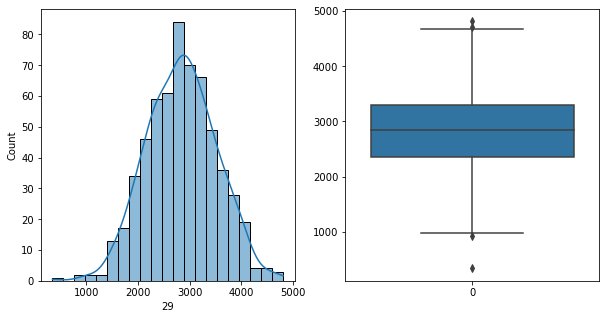

29   Unique :  [3005 2808 3418 2796 3021 1947 2988 3348 1699 3029 2333 3412 3903 3757
 2485 2565 3506 2104 2084 1932 2623 3712 3144 1764 3715 2687 2236 1945
 2676 2830 3752 3676 3154 3075 1990 3377 3834 2516 1982 3431 3274 3057
 3230 1632 3429 2109 2277 2054 2202 3499 3472 1423 1981 2829 3047 3783
 2730 3515 3295 3433 2148 3767 4044 4808 3759 4138 3232 2393 1606 3176
 3437 1776 3887 2843 3837 3579 3463 3807 2587 2778 2181 1961 1780 2340
 3358 3145 2263 2825 2908 3108 1678 1608 1860 3713 3076 3117 2751 2814
 3387 3635 3309 2582 2789 1889 2365 3640 2497 2483 3307 2322 2533 2904
 1506 3151 3371 2628 2945 2861 3661 3451 1928 3086 3992 3886 3792 2293
 2698 2032 2889 2881 2858 2191 2528  932 2258 3185 3501 3329 2906 3943
 1919 3218 3555 3349 2264 1926 2777 2255 2225 2781 1503 3733 1742 2583
 2574 1933 2422 3647 3702 3406 2453 4180 3235 3013 2794 3916 4457 2984
 2670 2823 2353 3035 2471 3339 1559 3318 3008 2026 2442 3178 1879 4175
 1834 2201 1712 2330 3389 3089 2862 3469 2334 3659 2891 1765 3

,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


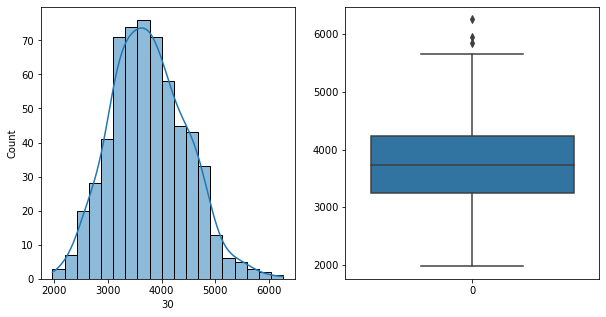

30   Unique :  [4055 5318 4901 5946 3209 3130 3868 4878 3394 3453 2826 3813 4043 4638
 3638 3604 4920 3887 3167 3054 4844 3413 3341 4174 2906 3326 3913 2624
 3144 2508 4760 4386 3999 2629 2451 3849 3905 3698 3947 4098 3319 4547
 3581 2819 4803 2829 4217 3121 3519 3515 3525 3444 2603 4165 5042 4196
 3449 3675 4658 3052 1974 4069 3333 3665 4694 4101 3574 3029 4254 3987
 4419 4295 3766 3372 3754 3150 3777 3407 4126 3985 3232 3212 3445 4810
 3013 3822 3511 3472 4709 3071 3010 2546 2657 4072 3718 4143 3194 3840
 2565 4660 4223 4757 5646 4332 3242 3257 4730 4240 3171 3051 2816 4398
 3292 3809 4784 3559 2782 4769 3714 3792 3853 4066 3584 4449 2717 4256
 3151 3414 3306 5594 3146 2939 4182 2992 4569 3218 4536 4131 5321 3746
 4304 5380 3420 3046 4330 4277 3034 4301 2536 2972 3471 2150 3791 4154
 3057 3159 5074 4372 3910 4081 4620 4651 3402 3309 3270 4341 3657 4009
 3942 2392 4476 3271 3704 2403 2579 4326 3094 5281 3290 2689 3172 3217
 4628 3876 4657 3544 3200 3161 4022 3470 3436 3239 3428 3779 3

,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


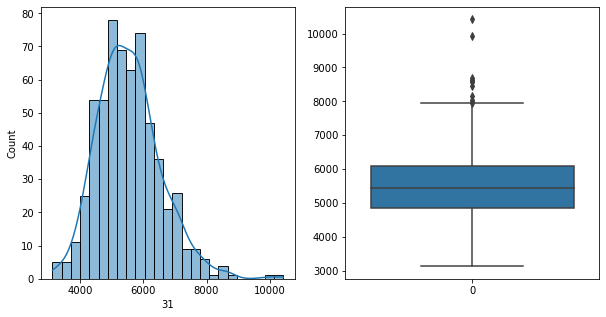

31   Unique :  [ 6043  7963  5017  7763  4484  4446  5874  7196  5991  3916  4940  5011
  7109  5206  5465  5260  6496  5482  5133  4510  5000  4509  6086  5853
  5554  5870  4835  4458  5010  5033  6959  6728  6015  4895  4311  5167
  6062  4487  5254  5288  6319  5221  4410  5528  5549  4435  5527  4669
  6313  6259  4027  6991  3909  6754  5752  5906  5731  4858  6420  6560
  4020  5135  4945  5001  5942  6369  4920  5341  5374  8645  8687  6625
  6182  5375  6359  6036  4289  5379  4865  7941  6596  4504  4790  5621
  4159  6095  5928  5098  5898  5777  7583  5605  4259  4913  4703  6123
  5961  6134  4870  5424  4098  5657  6210  6045  5869  5728  6152  5705
  6361  4814  5072  5550  7723  5893  4750  4651  4668  4252  7080  5908
  5450  5805  5767  4715  5724  5402  5021  4526  3260  4490  7145  7011
  4590  4323  4566  4530  5828  5603  8582  6804  7423  6053  5595  7482
  5354  6825  5181  7620  5018  6397  4720  4821  6285  4404  4493  5129
  6004  4840  5806  6810  5362  5573

,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


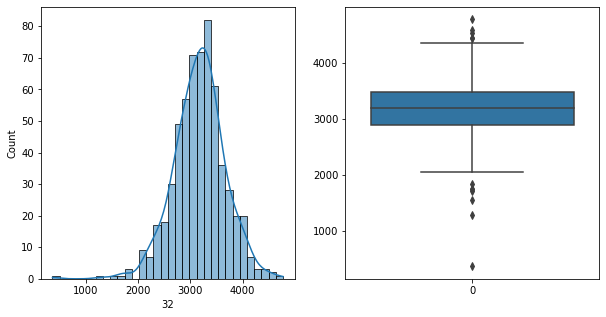

32   Unique :  [3358 3417 3484 2122 3597 3136 3126 3197 2551 3357 3625 2994 3365 3731
 3037 3651 3562 2853 3186 3795 3264 3851 2521 3570 4145 2455 2673 3906
 3344 3285 3017 3033 2328 3190 3104 2392 3542 2728 2999 3610 2748 3332
 3398 2915 2997 3061 3182 3217 2990 3333 2660 4358 3469 3389 3089 3441
 3519 3504 2823 2772 3098 3337 3395 3237 2959 3070 2711 3284 3458 4445
 3047 2560 3174 2838 3130 2640 2276 4323 3059 3588 2891 3244 2944 3619
 1746 3095 2801 2493 3281 3583 2473 2495 4031 3148 3049 3473 2810 3768
 3306 3751 2912 2857 3692 3405 3236 2965  363 2403 3071 3470 3162 3307
 3222 2670 3282 2760 3308 2850 1741 3342 3328 2949 3280 3489 2998 3302
 2134 2730 2301 4032 2373 2533 2780 3193 3681 3694 3163 3998 3120 3756
 2146 3363 1707 2948 1829 3453 3279 3012 3202 3316 2627 3035 4016 3593
 3717 3648 3325 3596 2968 3703 2680 3219 3324 2985 2830 3456 3485 2675
 3340 2936 2273 3809 4286 2597 2755 3301 3207 3808 2722 3345 3143 3419
 2693 3840 3374 2871 3630 2203 3375 3475 3576 3437 2874 3985 3

,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


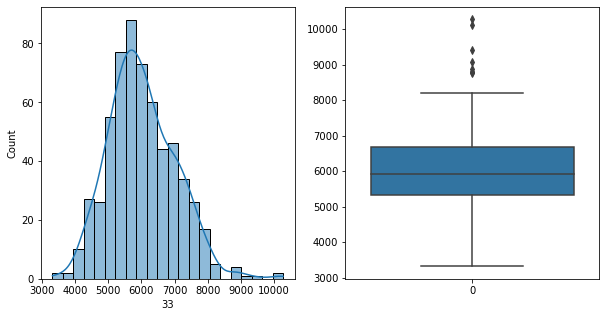

33   Unique :  [ 7162  6167  5910  6695  5384  6145  5040  5547  5848  4558  4582  6303
  5795  6073  6211  7241  6567  6058  5780  4532  5790  5615  7942  5132
  6016  4479  5761  5095  7257  5351  6189  7999  6397  6076  7491  5663
  7574  5310  6344  4512  6440  6873  5028  5826  5518  5401  6475  4779
  7400  7231  6545  7040  5445  5565  6734  6960  6335  7147  7221  7107
  4240  7102  5239  6252  5495  7276  5632  6229  5345  6035  6950  5335
  7651  5907  5576  4603  6366  5350  6943  6754  7541  4993  5815  6365
  6317  6593  4422  5322  4802  6427  6110  7435  6286  4627  4969  6140
  6649  7708  6078  4902  5307  6816  7366  5534  6589  4547  7639  5159
  5323  5016  5891  5452  5296  5325  6136  4593  5659  6032  5626  7424
  6430  5658  6105  5846  6698  7316  7794  5514  6028  6688  5390  4271
  6241  4911  7507  4491  5699  4795  4801  5300  4960  7500  6986  9414
  6164  7269  4503  7110  5711  6324  5586  6306  4412  5675  5456  4774
  5372  5121  5698  7758  7876  7389

,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


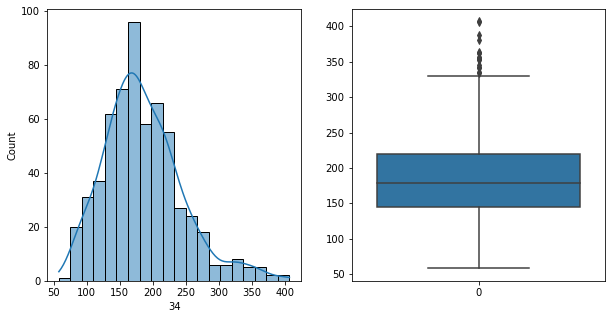

34   Unique :  [287 177 179 232 166 117 407 137 214 100 253 157 134  90 199 250 162 170
 165 209 174 225 167 178 252 110 222 125 212 131 235 195 132 180 207 242
 144 240 204 141 142  86 224 168 149 184 108 353 127 147 171 138 106 275
 158 139 208 188 249 258  98 122 192  83  88 118 211 259 202 130 120 299
 145 324 135 210 282 354 221 200 237 271 109 181 261 356 255 163 257 150
 189 123 362 152 175 248 136 183 102 315 155 114 154 326 364 206 151 280
 327 312 325 233 216 159 187 173 230  92  85 161  93 156 223 164 217 104
 238 229 198 226 246 128 227 169 148 140 330 270 293  79 194 215 272 113
 273 182 172 388 292 335 129 124 160 341  80 201 190  78 107 262 112 197
 133 243  82 193 126 316 334  95 247 185 284 276 186 153 251 213 176 317
 239  84  58 264 121 196 228 381 277 265  96 289  94 218 355 241 260 254
 343 346 294 105 219 116 322 406 146 101 205 231 191 244 256 203 279]
--------------------------------------------------------------------
34   N unique :  215
----------------------

,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


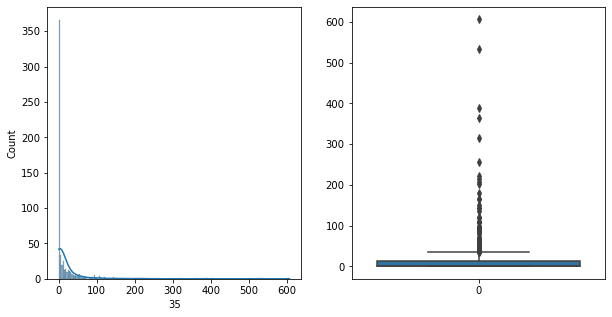

35   Unique :  [  0  18   1  10 109   6  26  13  31  14   2  11  33  50   3 257  12   4
   5  45  24  32  49  22  27  58 144   8  94   7  55  19   9  63  17  53
  34  95  66  29 221 389  35  93 202  15  52  16  48 150  36 179  28  62
  41  51  84 165 110  30  20 214  54 316  43  44  70  38 120 606  37  57
  68  21  47  67  89  71 166 207  25 136  23  56 533  80  99 121  39  59
  88  96  65 363]
--------------------------------------------------------------------
35   N unique :  94
--------------------------------------------------------------------
35   Value Counts :  0      256
1       65
2       30
3       15
5       13
      ... 
316      1
43       1
44       1
70       1
363      1
Name: 35, Length: 94, dtype: int64
--------------------------------------------------------------------



[ 36 ]
show_df_info :  36


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


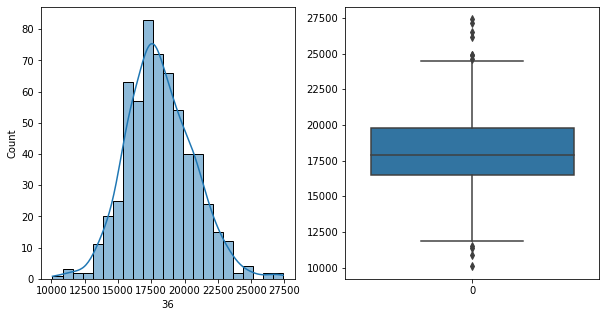

36   Unique :  [18318 18376 17563 18535 15522 17091 17422 20034 17974 13622 16653 17551
 18687 20792 19809 21725 15718 23534 18642 15756 21180 16448 19779 18614
 18130 17621 16579 14486 19747 14079 20505 23356 16067 15185 13235 18660
 19412 16779 17561 16590 19916 19092 15900 16814 20745 15387 19073 15720
 19596 18883 16481 14470 16085 17424 18358 19066 17073 22126 21407 20377
 15352 20071 18326 20728 16035 20872 16718 16016 14084 21594 27396 20100
 20057 18683 17590 17332 18931 17279 20620 17802 19349 15980 16203 17562
 15081 22476 11884 17689 16893 21336 18578 26184 15701 14900 15117 18935
 20434 20047 17865 17364 18407 19752 21073 19774 21900 14696 19323 21624
 17870 15815 16163 14290 15526 15914 14111 16103 17452 18164 17359 18293
 19751 18257 18375 15935 19400 17270 19244 13436 20650 17439 19555 15309
 15429 14419 21568 14100 15964 17086 16224 18001 13582 21964 16410 24093
 19554 22413 19094 21421 20900 16719 15501 19612 18630 16664 16951 20656
 14258 16599 19237 19222 17291 15094

,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


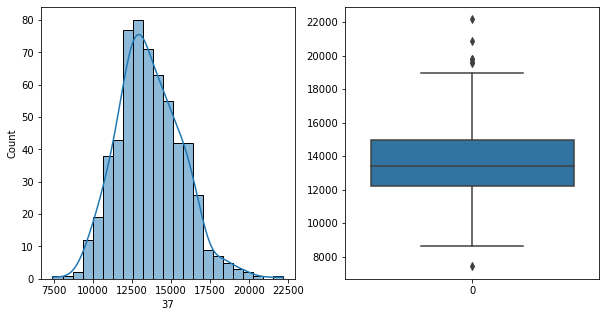

37   Unique :  [14629 15314 13508 14934 15283 10846 13583 17019 12692  7421 11925 14836
 12842 15723 13264 16966 16169 15058 13740 11873 16022 10741 15540 12945
 15009 11846 14415 13071 15128 11469 16427 15604 14392 10818 11022 14402
 14145 10794 12487 13326 19590 15324 12596 10968 15019 15541 13406 12605
 15504 16942 10421 13125  9581 16668 15893 16391 13088 18148 15783 17448
  9374 13472 11704 15411 13878 15303 12996 10941 18953 18497 16083 13854
 12725 14885  9882 12177 11974 15025 13007 15133 14755 12981 18290 12123
 14475 13902 13167 12280 14364 13248 14436 11341 11170 11496 12377 12729
 15523 12312 11552 16633 13796 15410 14941 13636 12270 13577 15211 13454
 14657 16329 11435 10430 13994 11570 12513 14004 11008 12509 12691 14044
 12572 12522 15890 13436 13367 14409 14685 12397 12804 12164 12727 10494
 12845 16274 15315 10887 11495 11739  9852 14876 11994 13866 13708 17097
 13290 14407 12943 16708 16683 13534 14896 14717 11678 13458 11599 13668
 12136  9678 12189 16593  9943 14902

,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


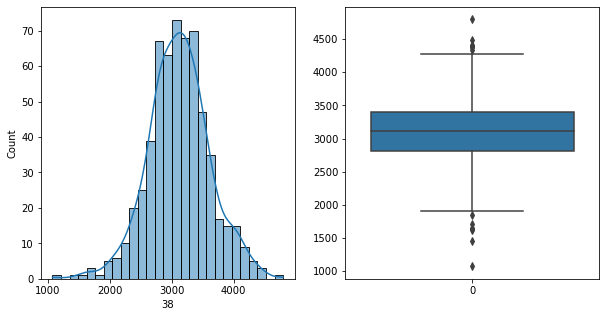

38   Unique :  [3370 3175 3003 1845 3235 3301 2919 2821 2489 3099 3570 2836 3390 3422
 2979 3427 3385 2606 3127 3467 3007 3949 2399 3652 4003 2542 2765 3241
 3752 3211 3367 2984 2832 2261 3088 3053 2319 3638 2782 2989 3315 2770
 3339 3306 2842 2899 2884 3282 2995 2982 2763 4159 3101 3384 3040 3187
 3392 3386 2918 2668 3121 3278 3054 3083 2791 2781 2750 3316 2695 4394
 2999 2751 3056 2598 2361 4795 4178 3279 2302 3397 3043 3298 1619 3067
 3095 2583 3114 3781 2066 2115 4138 3214 2885 3517 2783 3557 3911 2809
 2988 2928 3498 3157 3663 3082 2646 2180 3033 3287 2972 3229 3338 2724
 3477 3305 2666 1452 2929 3135 3413 2923 3097 3512 3017 2980 2278 2672
 2197 2734 3933 1636 2686 2799 3146 3582 3252 3708 3183 4031 3055 3725
 3129 3448 2737 2897 2006 3407 3060 3181 3028 3403 2874 4271 3654 3702
 3476 3572 3675 3300 3540 2880 3618 2445 2930 2862 3194 2994 3191 2920
 3218 3263 3152 2769 3110 2334 3682 2871 4142 2426 2523 3111 2903 3866
 3307 2825 3333 3076 3506 3454 3120 3636 3374 2991 2818 3310 2

,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


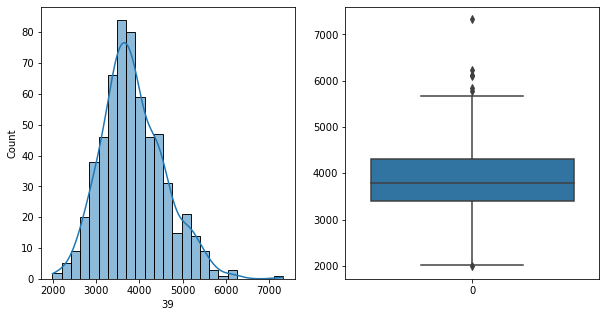

39   Unique :  [5362 4935 3580 5159 3827 3643 4764 4737 4368 3315 3795 3906 5089 4303
 3728 3383 3143 4865 4047 3392 4480 3974 3685 2962 3370 2856 3359 3426
 4371 3365 5040 3777 4170 2560 3424 3841 4471 3491 3412 3990 4260 4475
 2778 4421 4474 3366 3951 3072 4532 3658 2531 3737 2976 3891 4319 4758
 3390 4703 4398 3939 3209 3262 4392 3411 4424 4251 2357 3801 2872 4960
 5554 5085 4166 3425 5143 3516 3188 3042 4331 5670 4201 3423 2837 4311
 4092 5043 3553 4685 3562 3673 4506 2968 2845 3743 4375 4986 3544 4009
 3084 4413 4137 3711 3908 3846 4078 2931 4449 4325 3009 3172 3204 3475
 3549 4438 2825 3415 3065 2878 4293 4056 3928 4709 5843 3818 3252 3849
 4485 3604 3106 2441 3870 4734 7323 2690 2737 4115 3246 4618 3861 4048
 3275 4881 4126 3765 4444 4254 4593 3610 4562 5288 4549 3919 3309 4310
 3239 2848 3429 3581 3759 2573 4827 4776 3909 5108 3740 4277 4107 4109
 3815 3780 3700 3992 2864 5130 3735 3306 3241 3471 3558 3814 5365 4294
 2624 3357 3153 3876 5536 3679 3797 3833 5228 4465 3090 3539 3

,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


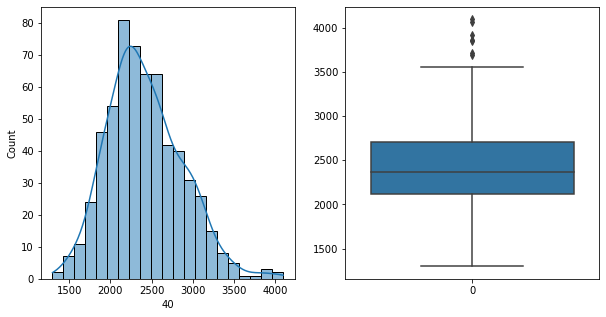

40   Unique :  [3425 3115 2394 3414 2022 1828 2609 3118 2260 1519 2568 2162 1770 2667
 2049 3024 2597 2993 2542 2181 2830 2873 2593 3200 1935 2395 2063 2392
 2008 2249 2782 2327 2050 2209 2834 2212 1908 2701 2399 2890 2519 2324
 1886 2754 2086 2322 1944 3053 2169 1939 2521 1964 2514 2714 3017 2569
 2996 3202 1968 2550 2237 1969 2349 2184 2662 1861 1970 2387 4072 3125
 3318 1891 2059 1913 1689 2228 2891 2374 2128 2534 2888 2160 2622 2141
 2353 2474 2205 2537 2384 2280 1672 2810 3170 3033 2588 1912 2292 2889
 2578 2606 3178 2233 2089 3291 2371 1919 2221 1532 2036 1985 1994 1943
 2334 2165 2168 2024 3248 3182 2429 3042 2599 2285 2948 2197 1614 1834
 2651 1808 1736 2520 2118 2120 2108 2837 2618 3123 2411 2950 2476 2783
 2549 2691 2719 2763 2019 2907 2431 2081 2522 1883 2073 2886 1851 1823
 2064 3159 2185 2582 2766 2468 2171 2283 2503 2548 3019 2001 3095 2490
 1748 2007 2839 2078 3279 2398 1324 2136 1991 2777 3037 2095 2299 3374
 2315 2731 2495 2172 2727 2335 2707 2361 2496 2698 2990 3234 2

,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


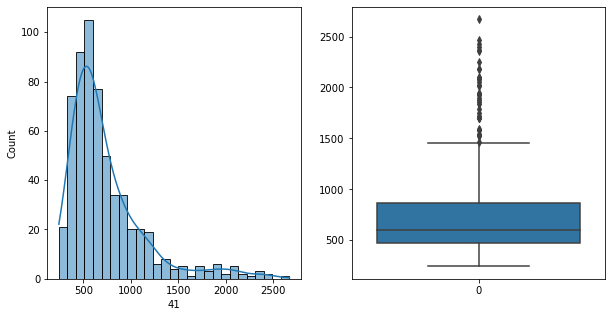

41   Unique :  [ 724  449  597 1183 1531  483 1218  788  339  877  377  631  514  479
 1231  443  680 1159  343  742  401  608  754  393  703  729  714  802
  488  559  513  553  644  542  384  255  490  325  870  733  942 1025
 1325  599  515 1031  648  383  642  672 1837  866  547  340  604  701
  568  341  603  689  551  349  450  662  574  405 1942 1082 2669  508
  387  736  357  268  509  705 1935  897  588  783 1324  534  459  381
  669  671  785 1040  595  792  475  520  606  353  763  463  859  800
  992 1115 1580  649  647 1293  565 1242  622  402 1074  826  576  503
 1157  619  456  429  679  584  746  522  418  545 2354  902  683  502
  260  420  776  732  627  726  874 1433 1238 1878  677 1001  712  715
  878  834 1056  797  855  761  533  685  519  438  558  376  504  578
  556  824  460  825  555 1068  445  617  971  516  727  345  690  444
  537  543  314  907  582  410 1248  609  390  740 1578 1062  782  457
  769  407 1196  757 1016 1753 2179  535  920  605  531 2247  

,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


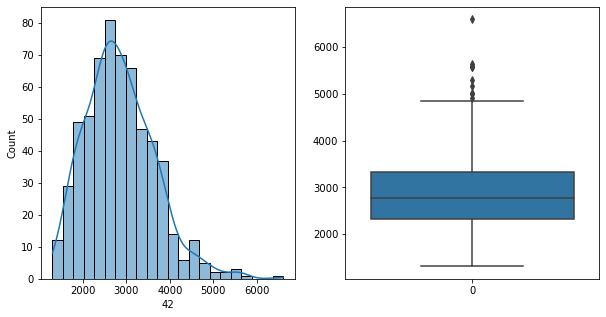

42   Unique :  [3019 2624 2869 4540 3003 2307 3714 2320 2453 2130 3146 1875 2999 2741
 2684 3145 1783 3398 2984 2109 3400 1975 3244 2392 2983 2805 3305 3969
 4076 2134 2479 2296 2543 2058 2514 2542 1904 1576 1666 2837 3078 2424
 3113 3728 3950 2245 2832 3908 2824 2173 3715 2645 3602 3640 3009 2017
 3408 2325 1912 2395 1930 2394 2035 1773 2708 1978 3753 3702 5176 2592
 1806 2406 1489 2060 1460 2250 4012 4543 3896 2847 3105 1907 3237 4059
 2626 2411 2722 2331 3193 3217 3271 2860 1828 2861 3521 2199 2766 3225
 2021 1696 3195 3099 4002 2217 3528 3457 3198 2467 3043 2545 2511 1633
 3748 3824 2702 3067 3745 3228 1813 1838 1894 3014 2761 3938 2903 1800
 2055 3660 4907 2855 1491 1492 2655 2994 2628 2857 3443 3294 3972 3768
 5018 4202 2774 3544 3517 3264 2470 3065 4464 2967 3073 2627 3607 2031
 2941 2819 1784 2798 2524 2884 2725 2133 3604 3230 2575 3445 2830 3634
 3568 2596 2299 2342 2773 2343 3812 3430 2498 2509 2581 3912 3529 3560
 2345 1531 2463 3622 3535 2896 3857 2455 2107 2636 2810 2255 3

,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


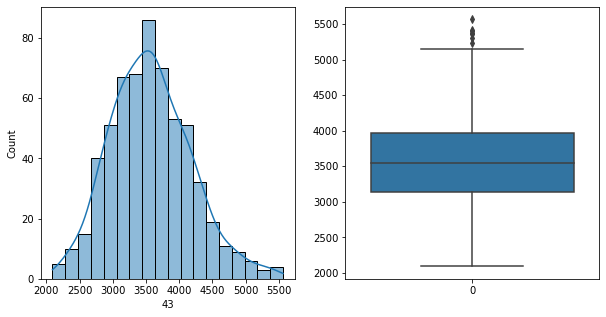

43   Unique :  [4398 4474 4406 3706 2747 3129 3398 3892 3389 2258 3338 3574 3428 3503
 4214 3940 3564 3121 3594 3568 3120 2588 3537 3736 3496 3751 3630 3018
 3784 3376 4115 4081 3885 2960 3774 3370 4439 3187 5103 2974 3718 3763
 2965 3302 4263 3502 3925 2778 4213 4441 3295 2679 2781 2887 3642 4222
 3526 3147 4856 3039 3494 3028 4000 4126 4767 3786 3611 3073 4197 4047
 3522 3844 3097 3588 3723 3836 2609 5419 3859 3469 2586 4238 4527 3602
 3976 3056 4004 4310 3739 3020 2523 2697 3148 4337 4107 3837 3052 3105
 3694 4108 3877 3941 3478 4940 3907 3081 3397 4147 2093 2882 2914 3339
 3402 2981 2498 2836 4515 3448 2760 3660 3816 4232 4082 4692 2929 3690
 3456 3628 2320 3289 3118 4068 3604 2915 2740 3331 3007 3640 3453 4483
 4896 3987 4042 2802 4656 3386 2903 3089 5361 2942 4282 2555 2972 3636
 2575 2487 3962 4165 3792 2379 4304 3679 3184 4114 5399 3199 3857 3304
 3306 2888 3895 3724 3995 3076 3414 2181 2669 2808 5225 2714 2470 2327
 3795 4722 4218 3490 2381 3847 2449 4283 3387 4163 2931 2366 3

,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


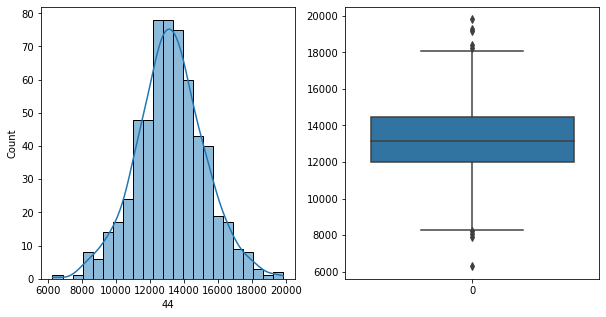

44   Unique :  [13987 13353 15774 13756  9017 12483 13173 14058 13844  9311 11980 13881
 12452 16010 13876 12636 13071 15185 12368 11099 14732 12940 14446 13536
 14066 15562 10056 11641 13647  8981 16582 16920 13905 11423 10793 13102
 13666 12196 13669 11870 13759 14072 12355 12091 14403 13130 14845 12554
 13947 14938 12668  9394 11248 11921 15879 15072 12881 15512 16444 13040
  8885 14003 10933 15036 14468 16957 13976 11051 15195 15964 12488 14149
 14466 12689 13475 13588 12142 13804 11584 16827 11888 10212 11458 12225
 17049  8472 11436 10579 18085 13927 14044 10802 10657 11357 12614 16518
 15264 13256 11011 12804 16548 16111 14542 14454 12194 14205 14777 12437
 11447  8067  9626 11330 11770 11375 12928 14807 10903 14658 13101 14809
 13895  8532 13755 15897 13574 13942 13908 11361 14919 12047 12011 10831
 12260 16490 11234 11754 12594 12702 14928 11168 15569 11401 17298 16128
 17884 10560 13116 11624 13333 11633 14264 10470 14190 11342 11021 13250
  9805 10311 16905 15222 13444 10443

,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


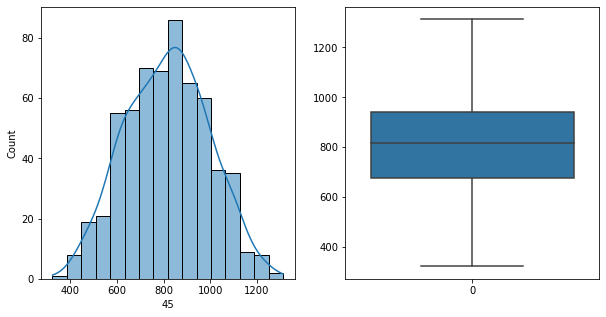

45   Unique :  [ 934  813  976  625  841  731  616  921  507  669  391  778 1124 1126
  654  827  971  704  779  547  843 1028  864  648 1101  855  575  708
 1073  450 1162 1094  820  912  440  969 1052  657  516  880  868  830
  647  481  856  603  595  558  903  953  499  618 1058  980  681 1312
 1102  853  587 1074  839 1140 1046  874  966  870  610  802 1274  658
  721  961  743  939 1105 1071  803 1053  772  751  394  677  782  505
  825  621  789  933  637  638  546  729 1030 1013  600  995 1037  818
  668  748  960  605  699  459  511  707  861  424  831  582  784 1189
  902  455  952  885  935  998 1099  811  706  866  730  574  860  594
  642  919  928  982 1051  494 1054  781  438  832  798  914 1021  583
  908  724  722  858  563  792  676  767  992  828  999  816 1088  702
  842  529 1206  887  973  599  927  420  876  562  850  955  696 1188
  664  636  854  814  773  639  601  994  967  573  571  632  527  846
  888  728 1082  727 1057 1153  750  742  809  717  906  989  

,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


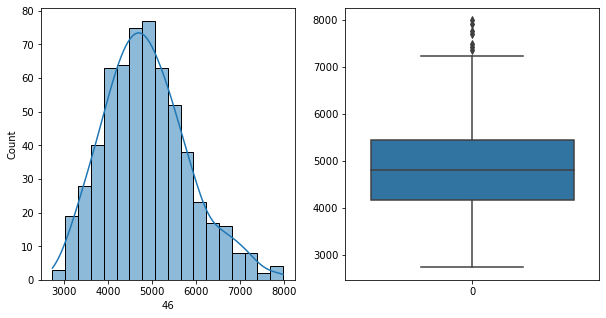

46   Unique :  [3139 5489 5768 7033 5217 5678 5120 4139 4080 2928 4892 5247 4664 7919
 4559 4915 6723 3815 3749 4120 7474 3906 4884 3427 4692 4585 3080 4940
 4419 4361 5697 5828 6160 3186 3259 4870 4298 3598 4494 3901 4379 3765
 5256 4207 5467 5004 4091 4115 5722 6000 4492 4287 4035 5148 6494 5274
 4970 5338 7208 5926 4059 4587 4307 5352 5313 5193 5546 4205 3559 6366
 7703 7224 6585 4808 4024 3651 4258 3997 4518 4668 4967 3464 3398 5528
 3878 3890 4259 4352 4173 4261 4610 7416 4130 4182 4845 5594 5283 7066
 6401 3780 5264 5949 7987 5666 4117 4652 3362 5292 6815 5403 4802 3900
 4472 3732 5976 4837 4119 4162 4695 5668 3779 5069 4830 4321 4434 4571
 5630 3702 4333 4353 4941 4566 4908 4084 5231 3612 3623 5372 4813 3910
 4479 6388 3687 4745 5524 6285 4423 5587 4410 5007 5223 4222 3988 5093
 4850 3303 5344 3417 4619 3458 4440 6133 4267 5015 7152 5414 6795 5152
 5290 5378 4791 6352 3722 4925 3755 4454 5933 4295 6125 4832 7168 5263
 3216 3571 3070 5560 5267 4011 4541 5027 4765 5977 5535 4332 6

,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


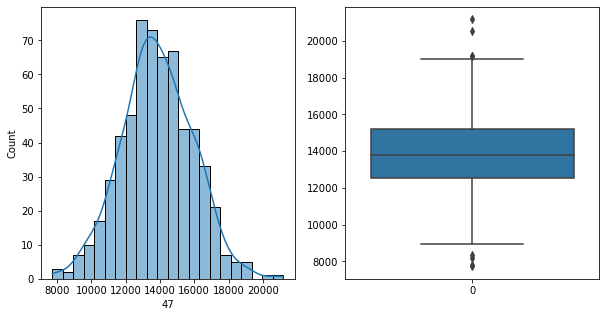

47   Unique :  [16052 15912 15830 17431 12423 13131 14673 16502 12301  9578 11682 14632
 12040 17099 16376 14002 13879 16159 13688 11354 15187 13419 13593 12904
 15594 13967 11930 10308 14280  9639 16772 17584 16193 13212 12091 13172
 15237 13217 15734 14829 13962 13234 11674 10309 16078 12930 16598 11997
 15600 15861 12356 11210 10353 14101 16364 15922 15544 17207 16712 14374
  8191 15471 13646 15573 13870 16255 15294 13022 10582 14099 18411 13619
 16609 14428 14422 13673 13517 12338 13747 14291 14150 14059 12350 13071
 12695 14693 10056 13711 10491 16489 12795 13496 10744 11132 10388 12988
 15688 17580 13227 10621 13959 14467 17501 16112 16916 11617 14526 14912
 13469 12049 11851 10079 12206 13181 11133 13001 12697 14169 13481 14624
 13884  9264 15440 14482 13943 14032 13749 14036 16206 13054 15097 11839
 11079 13561 17575 15224 11638 14600 13546 13615 12358 16954 12657 19005
 15873 16133 11558 15791 14868 14219 12721 13709 12688 16056 11765 12447
 14144 10196 12537 19032 12168 13830

,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


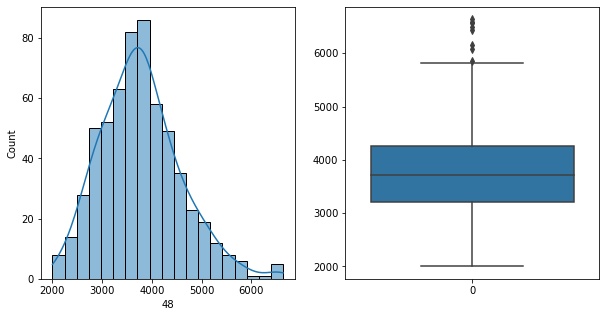

48   Unique :  [4758 4860 3933 6494 3317 2335 5625 5067 4081 2676 3667 4422 5580 3673
 3538 3144 3287 4947 3911 2235 4234 4686 3497 3468 3894 3142 4910 4408
 3913 3242 3909 3095 4231 3556 3460 3420 4312 2863 3641 3920 4124 4674
 3707 3801 5862 2958 3491 2811 4531 4245 2662 3389 2400 3421 4629 4398
 3514 4094 4476 4063 2357 3576 2950 2967 3836 5239 3688 3255 3241 3208
 4678 3467 5427 3700 4127 3251 2476 2574 3265 5785 4290 3363 3368 4785
 3479 3892 3394 3527 3531 4314 3547 3298 2871 2687 2001 3781 4423 5078
 2879 3837 3777 5223 4055 3957 4296 3623 3905 2079 3904 3222 2803 3645
 4200 3768 3617 2801 3742 2796 3182 4834 3980 3927 5032 4804 4054 3076
 2915 4271 4122 3529 2392 3764 5523 6430 2954 3121 4479 4871 3870 4336
 3447 5395 3903 3712 4859 3946 5130 2968 5116 5193 3445 4278 3135 2940
 2596 3695 3813 4106 3027 2757 4266 4770 3112 4334 3986 5050 2990 4536
 4072 3589 3977 4103 4464 2661 4592 4427 3084 3052 4257 3738 3507 2885
 3269 3902 4477 3343 3926 3244 4750 3448 2518 2867 4292 3253 3

,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


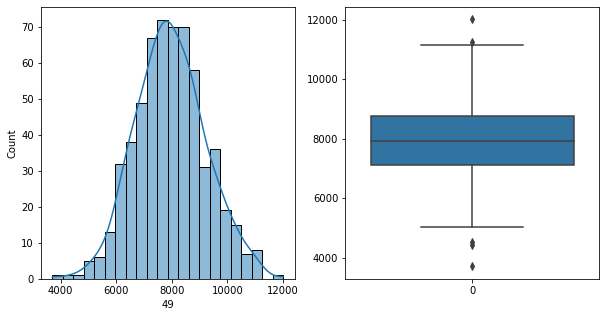

49   Unique :  [ 9381  9622  7272  6591  5902  6469  6705  8268  7048  4433  6555  8240
  9806  9059  8544  7730  7333  9948  6087  6695  8392  7478  7986  7229
  7233  7290  6563  5251  9141  7081  8917  9430  7699  6876  5652  8142
  8023  6434  8579  7422  8772  8612  7652  6256  7446  6197  8833  7069
  8313  9380  7461  6685  5572  8289  7524  8231  7737 10354  9907  7938
  6675  8295  7649  8024 10009  7778  7191  8104  7495 10216 11249  8698
 10325  9045  6728  7249  7291  7828  9407  9923  8865  7978  6455  8496
  6355 10053  5037  7992  7138 10887  7942  8322  6600  6397  6474 10075
  9500  8446  7654  7858  8560 10273  9677  7946  7912  5164  8593  9414
  7129  7110  5510  6191  7117  6916  7547  7337  9635  6105  7729  6237
  6308  5834  8678  7326  7154  9155  7376  5030  8761  5867  8307  6898
  7666  7002 10296  6220  7753  7387  6872  8116  6839  9227  8477 10136
  9029 10347  6325  9327  7036  7219  6671  9434  6567 10086  7314  7557
  6200  6783  7245  9803  7439  9511

,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


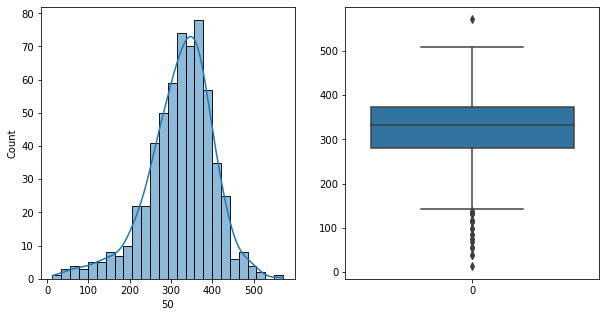

50   Unique :  [371 329 425  84 366 285 358 200 220 274 337 345 507 268 310 306 343 267
 370 376 374 373 199 407 341 288 265 357 203 428 404 318 395 263 477 331
 287 293 295 297 299 238 261 316 334 441 355 239 269 377 421 381 346 432
 369 260 300 414 399 434 280 350 291 178 438 443 413 322 426 284 277 317
 340 259 115 309 279 418  55 255 230 379 473 222 187 258 385 319 283 431
 363 315 347 359 397 237 144 286 312 221 367 296 324  76 352 380 435 353
 215 250 332 232 118 333 100 339 400 326 430  87  98 348  38 191 305 213
 247 320 257 416 485 368 349 571 327 409 360 494 382 419 301 276 225 157
 304 314 508 241 224 226 427 338 362 351 342 398 344 170 328 406 378 242
 383 361 372 294 271  56 390 180 321 251 249 254 405 160 325 114  68 134
 410 364 423 402 476 439 281 158 336 412 391  13 411 302 354 479 307 206
 440 137 392 183 244 207 252 273 356 278 262 282 210 469 490 375 303 246
 290 387 403 311 313  74 143 422 272 214 323 292 393 456 154 275 401 235
 116 132 245 388 384 253 270 131 437

,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


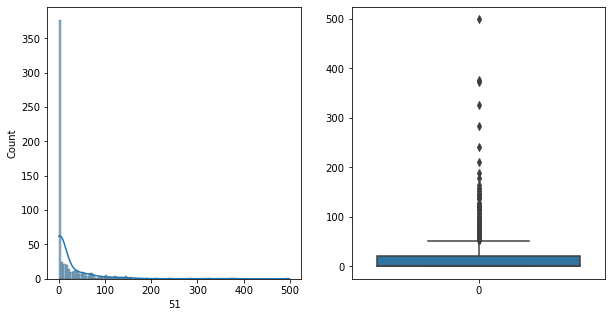

51   Unique :  [  0 153 125  71   3   1  22 123   2  60 127   7   4  42  21  14  34  57
  79  11 108 499  52  19  50  69  25   9  43  61  27  12 100 179  17  63
   6  68  37 373  51  13  20  76  66   8 284  49  93  24  16  64 121  35
   5  67 129  23 211  39  72 147  40 138 112  56  33  32  53  95 242  10
  83 164  44  73  31  54  59  15  74 137  30 126  91  45  18 122  84  89
  86 157 145  58 188 117 376  41 105  36 326  65 158  99 141  96 113  70
  47]
--------------------------------------------------------------------
51   N unique :  109
--------------------------------------------------------------------
51   Value Counts :  0      287
1       37
3       25
2       16
4       12
      ... 
112      1
33       1
242      1
83       1
47       1
Name: 51, Length: 109, dtype: int64
--------------------------------------------------------------------



[ 52 ]
show_df_info :  52


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


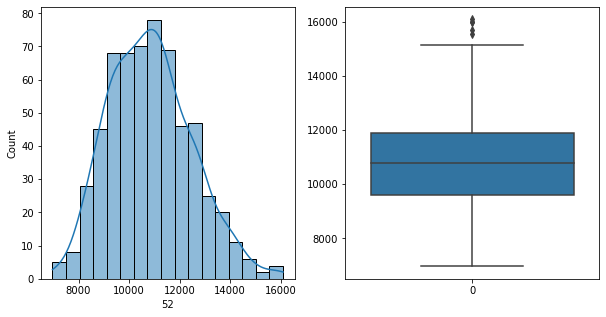

52   Unique :  [11325 10844 13777 12818 12000 10788  8757 12313 10347  7074  9902 10546
 10518 12166 11021 13879 13868 12513 16091 10602  9558  8617 11390  8631
 10870 10416 11666 10088 11383  8149 11555 11919 10190 10962 12035 10402
 11494  9738 10914 10458 13013 12488  9131 10606 11812 10314 11242  7864
 11549 11664  7792 12265  8907 11488 11691 12639  9425 12676 10656 13569
 10887 11163  7960 10380 10068 11803 10424 11670  9086 14792 14047 10880
 12569 10495 11745  9272  9123  9726 11115  9614 13902  9814  8228 11577
 10866 12970 13097  8144  9401 13293 10056 14909  9845  8722  8865  9404
 13224 13045  8964 10059  7912 11802 13059 10812 11373 10446 12449 12938
 12199 12289 11883  9130  8396  8340  8674 10639 10236  9875 10440 11463
 10958 11862  9531 11288  9508 11456 12232 13157  8275 11356 10257  9018
  8572  9345  9426 12576 11271 10115  8660  9635 13528  8909 10931 10622
 12222 10213 12718 11921 11504 10797 13276  8982 10478 10591 10168  8416
  9337  9846 12335 10755 12848  8244

,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


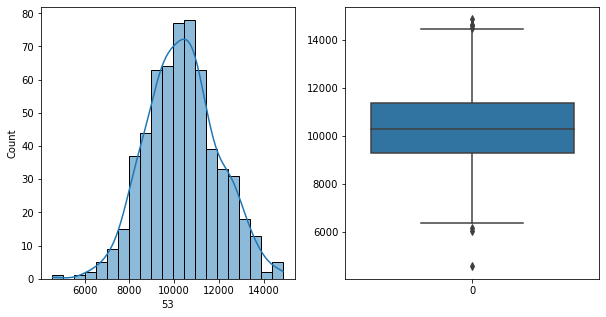

53   Unique :  [10638 11670 11091 10685  8918 10032  9735  9702 10133  7822  9339 11153
 12722 11150 10413 10838  7356 10503  9567  8644 12889  9982 12042 12224
  9516  8932 10123  7322 10588  8035 12976  9975  7579  7482 10010 10238
  8036 11536  9726 11142  9688  9713  9371 10931  9935 10548 10596 10203
 12906 10003  7664  7548 10262 11516 11700 11786 12953 11180 11691 10090
 11463  9853 11694 10934 10965  9031  8570 10982 13207 10609 12155 10955
  9910 11052  9694 10663 12321 11339 10978  9360  7361 10577  9556 11875
  6022 10666  9321 12911 12950 13561  7090  8135  8215 10054 11585 11603
 10255  9472 11161 11601 13311 12830 12645  8339 11386 14641  8179  8688
 12013  9052  8507  9548  9628  8915 12096  8178 11130  9887  9401  9430
  8164  9972 12355  9944 10832 11192  8997 10497 10199 11322  9456  9036
  9358 13071  6782  8823  9837 10325  8253 10435  8676 13351 11820 11259
  9603 11268  8040  9026 10061  7952  9506  8182 10441 11502  7741  8334
 11869 12587 10723  8153 11422 10531

,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


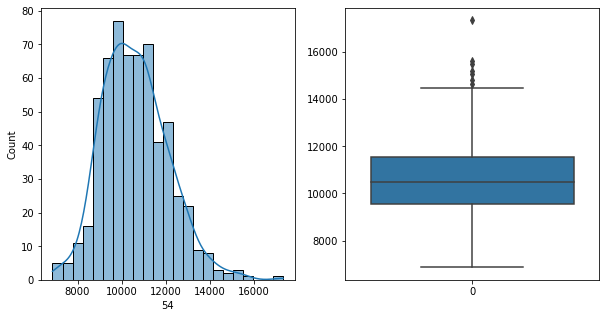

54   Unique :  [10551 10999 11106 15620  8887 10969  9825 12484  9769  7319 11554 10357
 12304 11168 11577 11495  8840 14812 10988  8852 11251  9697 12675  9067
 11279  9605 10241  9146 10051  8792 12041 14183 11663 11369  9842  9823
 10955  9049 10611  9113 14004 11245  9496  9715 13014 10289 10923  9007
  9822 12255  8954 10466  9192 10682 11117 12354  9185 12194 11662 13162
  9629 11919  7892 11228 11999  9640 10439  9954 11986 14473 14655 11356
  8421 11629 11355 10448  8700  9501 11883 12674 11652 10021 10893  8831
 12754  8787  9281 10237 11932 10897 12064  8187  9407  9873 10012 10286
 11372 10856  9812  9579 10124 11153 12155 10081  9552 11692 12329  9835
 11461 10469  8500  8702  9258  8707 10095 10107  9036 10014 10833  8744
  9126 10970 10928 11158 10586 11601 11723 10227 12044  9582  9141  9377
  9379  9300 12223  9484  9533  9523  9855 10824  8125 11717 11041 15176
 11768 10811 12991 13695 11903  9826 11155 12574  8978 10888 10182  9520
 10558  6858  9955 12860 10387  9907

,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


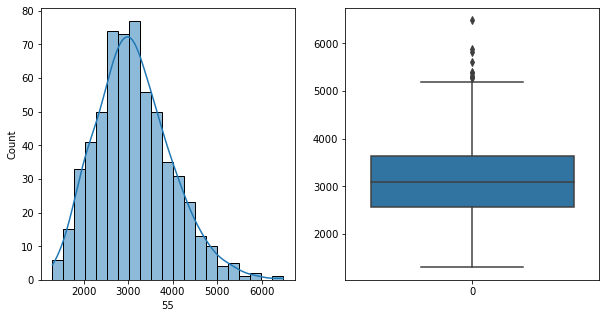

55   Unique :  [3369 2356 2919 5195 3394 1817 4010 3680 2435 2482 4085 2387 3015 2989
 2496 4076 2323 2931 3494 1902 3712 2049 3251 3514 3453 2964 3673 3590
 3809 2770 2054 2994 2733 2955 2265 3078 2013 1555 3098 2516 3123 2154
 3247 3715 3637 2417 2896 4276 2970 1914 3618 3108 3698 4544 3600 2246
 2692 3107 3109 1991 2903 2099 2679 2055 2352 2738 3704 1876 4657 4369
 5826 3333 2699 2887 1674 1636 1294 2225 4294 4962 4126 2923 3742 2064
 3474 3798 3153 2834 2353 2283 3636 3492 3482 2503 1948 3156 4077 2720
 3345 3080 2065 1746 3479 4066 4069 2497 3774 4637 4015 3452 2876 3640
 3215 3986 1779 3787 4040 2910 2872 4273 3588 2243 2284 2040 3446 3697
 3001 3271 2001 2538 3861 4822 3068 3113 1645 2012 2630 3324 3888 3598
 3000 3897 3528 5297 3727 2620 4116 4144 3679 3278 3221 4456 3148 3011
 1940 3133 3079 3114 2563 2498 2433 2930 2576 2456 3500 3706 2672 3926
 2942 4106 4701 2484 2841 3613 3206 2602 3781 2862 2880 2592 2130 4162
 2873 2772 4295 2177 1851 2578 4893 3576 4377 2447 2182 2885 2

,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


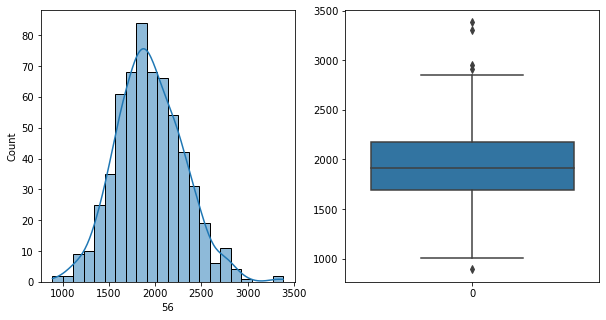

56   Unique :  [1875 1805 2041 1994 1769 1787 2010 1712 1664 1209 1849 2067 2582 2159
 1685 1743 1519 2028 2246 1484 2483 1930 2547 1901 1990 1991 2272 1992
 2205 1206 2130 2238 2358 1507 1968 2277 1821 1539 1601 2243 1830 1383
 2270 2221 1689 1733 2273 2286 1741 1331 1678 2145 2165 1688 2392 2306
 2795 1295 1963 1580 2283 2499 2504 1866 1840 2184 2222 2211 2252 1884
 1765 1634 2157 1728 2100 2009 2498 2125 1441 1897 1373 2764 1030 1876
 1299 2756 1913 2766 1459 1363 1583 1661 1908 2173 1730 1405 2029 2378
 2094 2468 1486 2515 2739 1629 1575 1395 1126 1868 2035 1344 1255 2175
 1850 1806 2480 1946 1535 1947 2219 1564 2076 1814 2031 2152 1591 1835
 1716 1570 1782 2414 1533 1783 1637 1650 2711 1619 2242 1590 2627 2055
 2807 2026 1506 1547 1934 1960 1479 2071 1335 1346 1879 1707 2237 2334
 1729 1521 3307 1883 1839 1896 2206 2290 2552 2473 1586 2348 2364 1450
 1755 1279 1603 2390 1393 2079 1742 1501 1702 2021 2225 1953 1794 1615
 2551 1956 1940 1861 1734 2030 2039 1713 1309 2323 1662 1703 2

,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


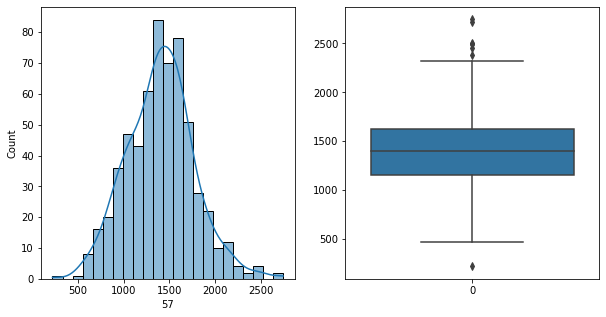

57   Unique :  [1380 1396 1162 1660 1339 1191 1863 1473  859 1044 1089 1555 1723 1917
  880 1408 1149 1187 1501  807 1464 2082 1968 1322 1620 2379 1349 1543
 1636 1166 1599 1732 1576 1249  555 1390 1711  937  768 1567 1554  975
 1247  722 1423  872 1312 1201 1957 1674 1477  565 1264 1692 1960 1297
  843 1427 1281 1324  578 2073 1313 1943 1605 1624 1500 1449  763 2745
 1355 1600 1253  998 1256  951 1679 1108 1320 1294 1405  939 1033 1252
 1310 1747 1056 2502 1573 1812 1037  990 1126 1544 1802 1585 1419 1080
 1840 1447 1716  962 1558 1894 1693 1168 1352 1598  576 1717 1771  619
 1524 2251 1651 1714 1871 1075 1192 1517 1466 1497 1343 1545 1641  921
 2717 1529 1367 1463 1603  900 1727 1472 1479 2039 1483 1518 1958 2154
 1675 1049  896 1219 1167  876 1587 1552 1433 1668 1286  890  967 1523
 2172  999 1370 2045  946 1237 1586 1230 1736 1724 1243  871 1369 1519
  713 1645 1274 1068 1019 2000  688 2492 1114 1261  950 1549 1471 1391
 1024 1849  852 1216 1494 1881 1418  966  969 1206  752 1094  

,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


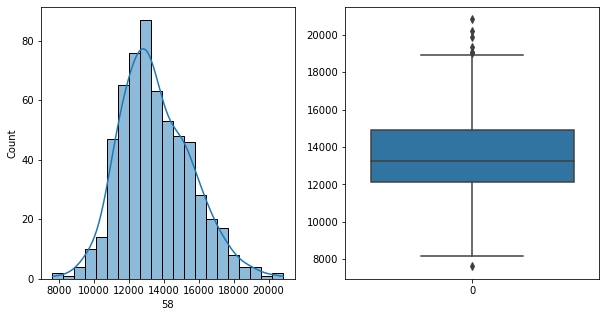

58   Unique :  [14941 13617 13926 16202 14829 13002 14202 16687 12518  7609 11774 13795
 14718 14885 14261 15095 16222 13040 13422 10813 15202 11419 13248 12100
 14229 12328 12142 12937 12600 10243 15228 15717 13574 10304 11533 13341
 14438 11681 13579 11889 18804 13357 14083 11352 15833 14501 12606 12180
 16084 16412 11175 12222  9607 15279 15146 16616 11609 15878 17838 17093
 11577 13921 12772 12542 13487 14780 14227 13095 10838 18576 20826 17288
 16808 12994 13715 10819 12488 10871 15295 14934 17862 12632 13012 19043
 11843 15658 11145 11325 12321 13784 11767 15554 11441  9675 11087 12696
 13752 15755 12433 11653 12964 15444 12801 15776 11735 13751 16574 13395
 12400 15163 11322  9006 14841 11493 13075 13728 14033 11985 12285 11395
 10635 12506 14812 13407 11573 14176 13940 13687 12171 11880 10923 11920
 16228 19359 11022 11821 11232 12246 11591 13722 16495 14666 18039 14124
 13702 12996 17559 14354 12107 17048 13242 15328 10978 12782 13418 10840
 10689 16642 12833 16536 11069 15396

,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


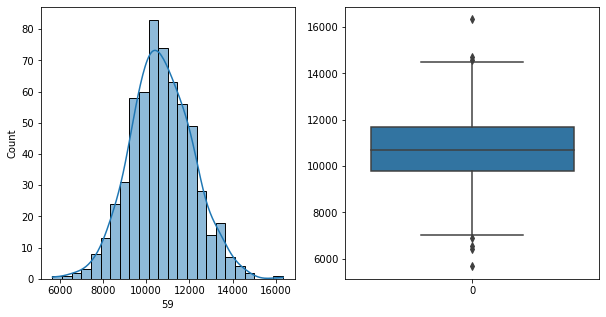

59   Unique :  [ 9868 10303 11542 13232  9431  9588 11404 10142  9818  6562 10343 10092
 11570 11738  9111 11302  9100 12622 10677  8927 11357 10033 11266 11863
 10445 10195 10595  9595 10946  8244 13103 12085 10738 10099  8944  9816
  9643  8597 10707  9533 10937 11786  9429  8743 13248  9864  9901 10060
  9894 11150  9604  8103  9017 10779 11339 11595 10125 14172 12054 12036
  8682 12074  9288 12271 12892 11881 11704 10594  7604 11540 14074 11287
 11828 11077 10489 10284 11180 10144 11049 11919 14110 11313  8907 10363
  8738 13741  8647 10123  9638 14569 11146 12762  8166  8509  8445 10388
 10518 10745 10147  9119 10298 11462 11114 12605 11424 10371 12396 13416
  9400  9803  7587  9823  9762 10570  9098  9398 12181 11073 10243 10180
 12543 11986  9393 11154 12163  9534 10650 10803  9446 11441 10128 12143
  8689  8734  9791 13498  8275  9404 10701 10804 13239  8790 12298 10891
 14464 11519 13252  9329  9596 10717 10213  9759 10220  9403 11974  7805
  8181 11539  8948 10940 11758 12203

,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


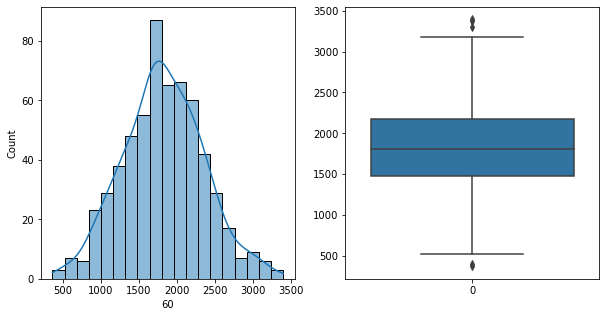

60   Unique :  [1889 1900 1625 1814 2110 1600 1456 1660  650 1352  765 1725 2198 3303
 1099 1453 1613 1318 2443  882 2039 2888 2512 1229 2135 3015 1442 1920
 2378 1056 3395 2366 2475 1785  925 1573 2235 1469 1811 2228 1360 1710
  989 1796 1439 1609 1679 2636 2353 2213  594 1585 1642 2974 2292  803
 2237 1918 1706  548 3085 1712 2786 1704 2192 1465 1586 2019 2871 1544
 1628 2293 1638 3124 1750 1828 1924 2150 2429 2075 2367 1004 1351 1888
 1634 2743 1692 2432 1877 2004 2142 1265 1158 1685 2258 1416 1833  994
 2618 1989 2484 2026 1474 1263 3176 1653 1435  553  790 2242 2389  907
 1713 3026 2413 2520 2063 2284 1312 1647 1921 2560 2160 1904 2140 1281
 2264 1612 1674 2077 1516 2281 1489 2640 2130 2032 2241 1768 2921 2394
 1854 1002 1218 1191 1697 1367 2231 1233 2280 2234 1749 1423 1033 1719
 2641 1983  954 1641 2338 1928 2206 2410 2161 1486 2288 1153  946  894
 2155 2406 2875 1088 2109 1005 2230 1506 1752 2506 1046 2916 1668 1542
 1245 2033 2154 1974 2089 1717 1736 1441 1879 1631 2072 1599 1

,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


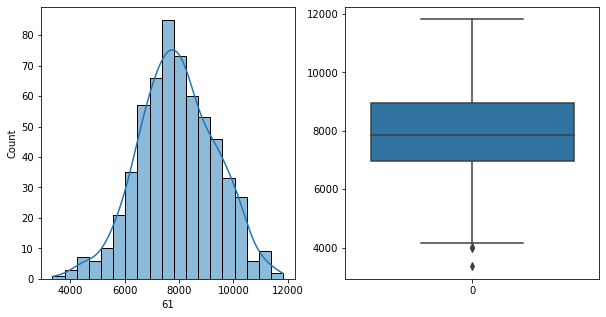

61   Unique :  [ 7893  8117 11331 10961  8208  8021  7847  9459  6567  6670  5684  8703
  6833 10571  8535  7502  7993  8145  9747  5928  8633 10476 11015  8121
  9207  9100  5168  6191  7843  3986 10034  9893  9824  7780  5067  9379
  8330  7749  8666  7921  9269  7996  6895  6711 10247  8854  8241  7361
  8604 11104  8344  5626  6349  8573  7576  8476  7303  9141 10393  8053
  4168 10302  8017  9128  9462  9014  7539  6975  5547  7277 10297  7696
  7726  6868  7400  7970  8227  6121  8372  9742  9759  7417  6354  6552
  6136  7862  7047  8956  6709  9397  7083  7553  7368  6007  5794  7651
 10291  8959  7742  6529  9762  8031  7526  9713  9570  6579 10259  8554
  6701  7729  4032  4457  7451  7487  5852  7411  7091  8209  8943  7534
  8738 10854  5107  9319  8808  9842  9574 10176 10285  7819  9561  6897
  5799  8237  9543  7782  5689  9477  8527  8705  6293  9957  7148  8669
  8416  9491  6176  8182  6781  9147  6230  6825  7766  9317  6985  7516
  9283  7076  7198  9447  8294  7618

,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


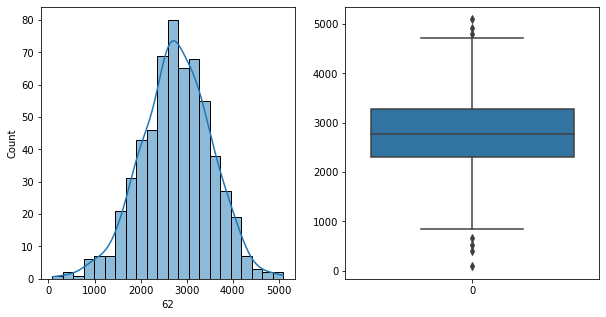

62   Unique :  [2210 2754 3405 2772 2456 2583 2733 2458 1558 2016 1358 3498 2768 4083
 2186 2621 1668 3382 2877 1627 2902 3572 3888 2375 3632 4795 2798 3535
 3184 1297 3773 3197 3304 4446 2315 2724 2730 2627 2459 2930 3884 2217
 2348 1857 2935 1935 2860 2648 3236 3216  851 2636 2377 4131 3484 1186
 4561 3428 1962 1486 3842 2386 3618 2908 3699 2166 2656 2085 2787 3434
 3027 2618 2843 3250 3628 2640 2897 3038 2975 3755 2763 3220 2057 2265
 2928 1901 3782 2522 3470 3204 2939 2202 2310 2065 2024 3452 2371 2374
 2530 3585 3598 4101 3394 1914 2482 3564 2198 2948 2422   87 1910 3033
 3668 1495 2151 4576 3723 3985 2786 3190 2305 3338 2702 2717 3286 2681
 3141 3185 2031 3379 2586 2517 2209 2032 2920 2557 4103 2497 2924 2625
 2563 2382 2520 3705 2864 1733 1839 2409 2303 3542 1852 4331 3218 3694
 2454 2345 2729 4156 3325 2095 2521 3274 3064 3124 2792 2890 3397 3358
 2296 1134 1095 3094 2974 3863 2384 3263 1099 3070 2000 3006 3243 1508
 3324 3105 3138 1904 1858 3009 2447 3352 2221 3276 2537 2572 2

,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


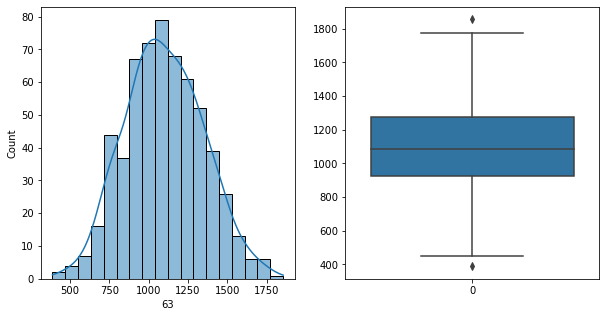

63   Unique :  [1262 1301 1336 1062 1049  872  863  914  542  643  552  841 1504 1333
  771 1119 1143  937 1226  698 1040 1367 1255  954 1207 1597  723  980
 1180  737 1773 1082 1364 1105  754 1033 1253  667  747 1028 1034  983
 1048  725 1024  776  619 1436 1193 1158  690  782  671 1513 1495  809
 1237 1021  633 1558  955 1270 1410 1265  998  866 1425 1855 1186 1011
 1267  824 1472 1204  918 1185 1163 1426 1266 1086  827  811 1102  917
 1025  913 1032 1065 1229  500  721  898  982  702 1283 1052  987 1051
 1624 1041  887 1077  610 1293 1043 1615  911 1164 1285 1106 1214  812
 1166  895 1148 1216 1222 1074 1013  970 1443  759  929 1210 1584 1181
  795 1298 1030 1291 1070  765 1703 1422 1542  975 1395 1053 1231 1457
  708 1303 1149 1409  920  716 1004 1234 1432  733 1331 1399 1054 1273
 1319 1602 1206 1008 1390 1499 1279  758 1084 1215  786 1398  800 1483
 1118  717  936 1192 1306  949 1152 1726  807 1095 1202 1604 1406 1114
  724  803  903  828  757  756  940 1600  962 1484  909 1252 1

,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


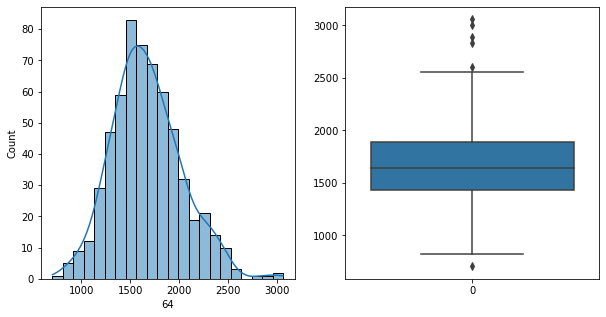

64   Unique :  [2040 1763 1801 1874 1682 1775 1734 1929 1791 1140 1318 1452 1708 2318
 1424 1931 1912 1832 1522 1293 2094 1809 1365 1382 1354 1700 1291 1156
 1995  856 2168 1701 2010  819  980 1620 2226 1679 1960 2553 1780 1746
 1304 1520 1856 1485 1795 1026 1360 1720 1658 1350 1199 2201 1988 2447
 1979 1233 2286 1656 1391 1341 1846 1895 1924 1748 1811 1650 1184 2155
 2297 2230 2257 1509 1288 1168 1303 1904 2418 2415 1373 1524 1532 1810
 1434 1024 1335 1247 1957 1797 1714 1276 1397 1093 1709 2322 1472 1458
 2317 1875 1460 2265 1256 1926 2208 1185 1176 2095 1313 1721 1155 1501
 1428 1672 1213 1395 1606 2462 1977 2159 1592 1681 2070 1928 1465 1351
 2310 1040 1347 1551 1900 1816 2479 1366  704 1531 1526 2331 1742 2102
 1517 2489 1265 1808 1506 1927 2068 1410 1755 1467 1515 2320 1470 1103
 1425 2016 1544 1191 1691 1663 1674 1847 2371 2207 2438 1776 1644 1666
 1595 1062 1782 1489  983 1437 1559 2091 1576 2172 1383 1046 1923 2288
 1296 1464 1327 2604 1749 1162 1487 1760 1651 1586 1272 1516 1

,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


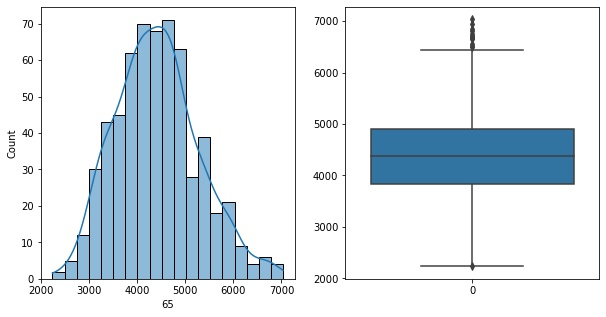

65   Unique :  [4937 5461 4286 5575 3706 4639 5435 5348 4853 3527 4448 4828 6158 5177
 4349 5106 3630 4775 3722 3672 4708 4327 4829 4025 4562 3141 4891 3755
 5935 3863 6669 5247 4193 3079 4134 3268 4792 3473 4056 4394 5820 4489
 3108 3886 4695 3344 5092 3736 4701 4586 2800 4924 3052 4649 4686 4239
 4716 5262 3978 3775 3965 5295 4362 4449 4574 3459 4171 4269 5439 5980
 4712 4071 4871 3992 2895 3686 4416 6752 4917 4682 5045 5449 3929 4928
 3841 3920 3998 4637 4098 3209 3508 4346 4347 4840 4070 3895 3478 4028
 5281 3844 5406 4496 4021 4338 4426 3202 3843 3586 3146 6018 4794 3646
 4205 3118 3454 4503 4734 5818 4505 5583 4545 4816 4690 3258 3306 4492
 6944 6161 2640 3252 2936 3245 5233 5278 5702 4223 5186 4451 6702 4801
 6002 4406 4885 6687 3968 4711 6048 3995 3521 4041 3855 4133 3354 5712
 2676 4899 5403 4229 4617 3211 4688 4892 3885 4445 4643 3914 3375 5275
 4525 5040 3618 2956 4611 4031 5399 4396 3095 4484 3382 4122 4733 3918
 3276 5394 4102 2696 4786 4868 3599 4060 3172 3984 3976 3996 3

,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


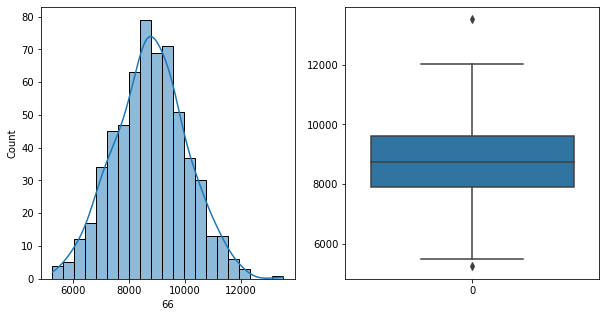

66   Unique :  [10107  9171 10303 11202  7296  8521  9031  8442  8393  6841  7294  8530
  9473 11294  9639  8846  8853  9032  9075  6481  9738  9361  8918  8125
  7727  9663  6501  9788  6574 10204  9963 10901  5489  7472  8797  9694
  8367  9344  9565  9959  9476  8328  7823  9538  8885  9214  7576  7973
 10619  8209  7091  7390  9915  8807 11259  7571  7553 11124 10849  6581
  8713  8358 10195  9225 11693 10850  9458  6000  9606 11376  8597  9803
  9892  8456  9041  7033  7772  8991  9997 10030  6601  8115 10729  8262
  9687  7845  8717  8466 10748  8048  9130  6934  6017  7641  7585  9219
 10500  7770  8510  9053 10549 10231  8402  9878  7634 10441  9308  7262
  8197 11053  8016  7067  8948  7668  8490  9784  8299  9691  8581  9909
  8572  8754  9598  9390  9428  8977  9306  6970 11153  8731 10264  7527
  9868 10636 11993  9088  5587  8787  7482 10747  8736  9901  7282 10410
 10963  9011  8734  7969  8816  7394 10557  7530  9541  6592  7864  8587
  5535  7011  9917  8538 10236  7637

,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


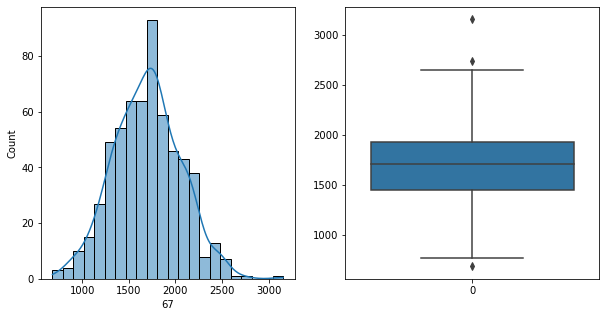

67   Unique :  [1805 1736 1779 1812 1777 1448 2117 1847 1191 1120 1222 1704 2403 1975
 1397 1755 1453 1711 1560  857 1867 2455 2046 1653 2174 2168 1447 1515
 2076 1463 2072 1997 1904 1622 1396 1786 1930  906 1013 1772 1480 1563
 1496 1809 1298 1717 1145 2010 1630 1592 1324 1456 2220 2143 1371 1743
 1732  970 1865 1506 1968 2060 2135 1629 2001  956 2231 3154 1785 1819
 1525 1067 1993 1160 1991 1293 1724 1468 1759 1532 1657 1613 1627 1249
 2292 1839 1774 1399  762 1193 2148 2235 1633 1567 1475 1922 1919 1714
 1491 1926 2078 1671 1628 1612 1356 1596 1798 1933 1286 1643 2153 1758
 1952 2005 1589 1342 1994 2008 1913 1765 1813 2115 1313 1309 1932 1540
 1358 1703 1221 1931 1677 1340 2075 2471 2249 1495 1244 1642 1498 1279
 1696 1180 2095 1615 2245 1403 1140 1084 1741 2246 1493 1575 2391 1478
 1751 1305 2170 2491 1720 1776 1927 1706 1299 1792 1605 1529 1161 1439
 2120 1038 2071 1320 1990 1791 1716 1423 2295 1098 1322 2239 1569 1857
 1109 1226 2445 2124 1849 1775 2307 2070 1428 1784 1634 1957 2

,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


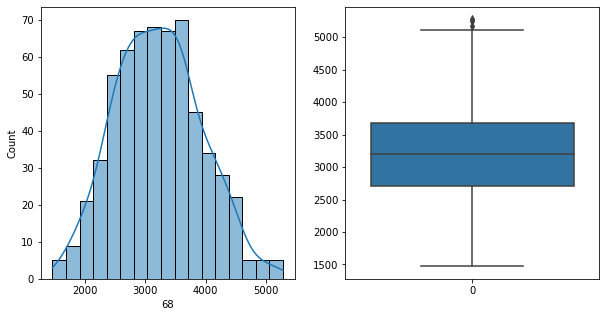

68   Unique :  [3712 2938 3927 3431 3417 3090 2958 3233 2009 2603 2030 3607 4373 4237
 2719 3100 3095 2572 2917 2221 3293 4086 3533 2038 3765 3139 1945 2600
 2892 2338 5060 3781 3502 3393 2852 3248 4731 3240 2507 3115 3405 3381
 3368 2152 3650 2481 2683 2434 2695 3802 3779 1710 2101 2592 3351 3741
 2802 4451 4006 3326 2296 4184 3648 5112 4030 4516 3682 2797 2560 3447
 4114 2566 3320 3800 2819 4151 4546 3895 4376 3077 3374 2511 2792 1702
 2652 3547 2771 3260 2056 3067 3400 2721 2533 1933 1635 4388 3420 3659
 2461 2479 3524 4165 4224 2737 2732 2469 4185 2728 2785 1470 2470 3152
 3454 1867 3588 4019 2826 3083 3275 3569 2232 3932 3222 4319 4436 3443
 1665 3315 2884 3284 3279 2364 2744 3438 1932 2800 3476 3635 3848 3042
 3575 2293 4405 4010 3829 2644 3337 3182 2291 2498 3807 3208 2544 2430
 3645 3750 3280 2798 4547 3726 3587 3636 4273 4816 3833 2804 2961 2831
 3660 2794 3644 2823 3748 2812 2952 2248 3185 3542 2551 4491 2215 2815
 1964 4064 3059 3775 3934 2979 3639 2706 3391 2078 4021 3592 2

,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


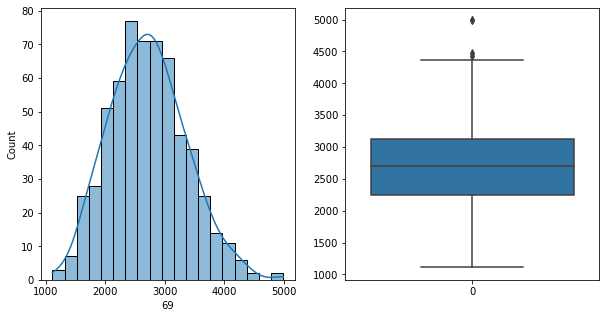

69   Unique :  [3289 3200 3555 1645 3118 3414 1723 2998 2122 2768 2233 2416 3606 3228
 2440 2049 3286 4094 1705 3702 3041 2752 2164 1731 3977 1479 2256 2273
 2166 3293 4987 2962 1896 1696 1109 2095 4197 3050 3425 3812 3017 2510
 2063 1842 2756 1711 2129 2688 2191 2716 1806 2297 2508 2989 2612 3330
 3171 2726 3291 2509 2649 3426 4215 2786 3454 2484 2623 2841 2082 3187
 2310 3525 3205 2614 2694 3026 2713 3804 3508 2394 2196 2138 3197 2754
 1425 1931 2088 2997 4264 2254 1983 1979 3107 4010 3427 2331 2464 2330
 3034 3389 2260 3067 3014 2502 3637 2561 2680 2157 1687 1557 3078 2661
 2320 2455 1643 2382 2337 3857 1848 1893 3036 3559 3250 3001 2916 1751
 2125 1709 1959 2445 2432 1864 2947 1902 2160 2522 3816 2374 2735 2780
 2333 3374 2750 2105 1322 2451 1570 2622 1180 3009 2397 2628 1927 1969
 2670 1525 2466 3781 2820 2939 4368 3343 2523 2593 2595 3240 2918 2224
 3147 2821 3671 2462 2158 3174 3252 2179 1930 3297 2599 2174 3758 2690
 2151 1682 1773 2933 2413 3165 2744 1953 2186 2869 2201 2831 2

,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


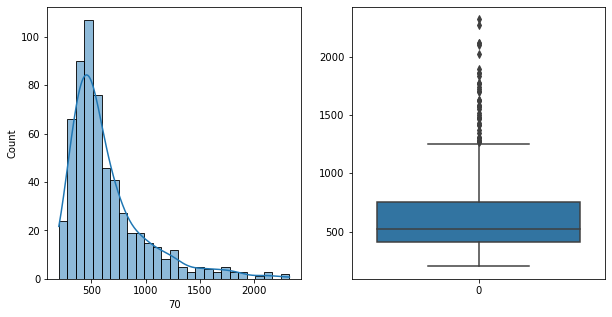

70   Unique :  [ 573  396  535 1143 1151  309  993  493  363  732  750  322  588  483
  446  672  361  758  730  289  657  329  621  702  688  689 1116 1100
  482  561  416  495  960  532  470  241  441  302  762  659  266  952
 1198 1477  459  513  903  645  293  678  569 1057  703  430  270  528
  994  509  313  486  330  462  347  355  508  449  299 1772  948 2123
  950  450  279  531  243 1429 1515  972  474 1112  424  572  875  674
  409  379  326  454  634  724  484  559  522  556  383  594  666  277
  577  490  726 1034  473  954  725  870  620  498 1281  489 1632  600
  334  941  520  977  584  501  394  554  465 1047  421  315  542 1721
  933  574  328  237  333  472  638  469  511  464  886 1060 1115  746
  519  924  541 1091 1124  722  619  479  926  480  385  516  400 1002
  716  422  548  847  816  381  589  568  524  264  715  622  558  366
  898  712  358  670  389  311  468  704 1346  996  990  467  398  444
 1226  368  382  597  660 1276  544 1566  452  676  344  418 1

,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


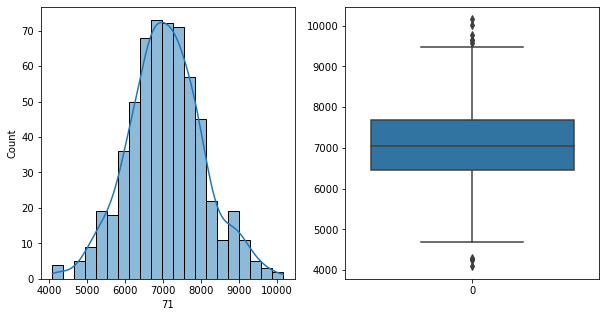

71   Unique :  [ 7927  7317  7885  6662  6499  7194  7339  7700  5503  6104  5990  7648
  7943  7494  6264  7422  6959  7461  6068  5616  7052  8022  8267  6139
  8724  7722  5849  7723  6400  6845  8994  9784  8026  7322  5354  7035
  7871  6382  7237  7191  6708  7341  6690  5956  9129  6384  7427  6642
  7743  7266  6631  4895  6130  6627  7805  7914  7593  8271  8513  7995
  5888  7561  6634  8304  7750  6871  6795  7414  5759  7817  7921  7783
  7695  6348  6577  6142  7813  6074  6440  9484  7193  6804  6113  5336
  8919  6097  6379  5278  7318  8021  7759  6688  5267  8767  7900  8216
  8134  6973  6748  7310  7716  8820  7577  8086  7701  6730  7580  5684
  6459  4091  5992  5668  7112  5262  6715  6701  6496  6423  6059  8232
  7512  4264  7282  8804  6681  6801  8149  7804  8442  6955  7354  5685
  6117  5829  7128  5373  5099  6532  6892  8012  6044  7392  5881  8625
  7098  8649  7285  7719  6324  6989  6616  7996  6612  7059  5332  5915
 10022  5543  6120  7853  8082  6502

,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


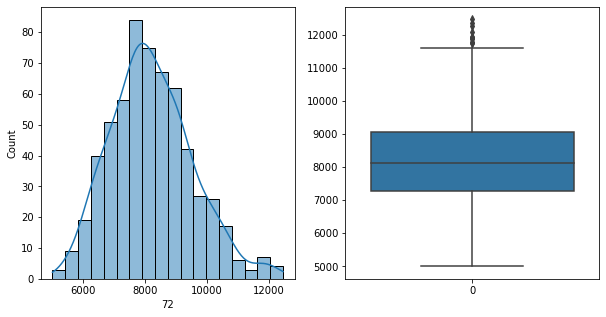

72   Unique :  [ 8429  7596  7849  9286  8382  6761  7527  7792  7042  5263  7246  7481
  8476  8596  8092 10178  9245  7553  8664  7342  9033  7065  8162  5647
  8039  7544  9265  7524  8920  6302  8941  8990  7677  6976  6355  8519
  9144  7256  8577  8772 10028  8277  7119  7998  7703  8695  5913  8184
  8716  6564  7729  6896  8912 10410  8531  7832  9069  8564 10062  6751
  8330  7238  9117  7852  9844  6928  9127  6672  8521 10358  7790  9431
  7204  8169  7146  6924  8259  8925  7232 10272  6727  5738  8220  7730
 10048  9054  6387  7138  9076  7842  9642  7482  5638  6213  8446  8928
  8462  7029  8182  6903  8793  9465  8273  7609  8671 10493  8582  8180
  9337  6294  6266  5908  8194  8132  7460  6415  8886  9450  8022  7723
  7791  9369  7873  9638 10142 10779  6338  8422  7805  8047  6590  7622
  7935 10891  6776  8004  6150  8239  9010  7350 10232  8474 11092  7870
  8470  7007  9711  7255  7520  8591 10556  7702  7718  7279  6414  5588
  6118  7412  9627 10063  8495  6120

,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


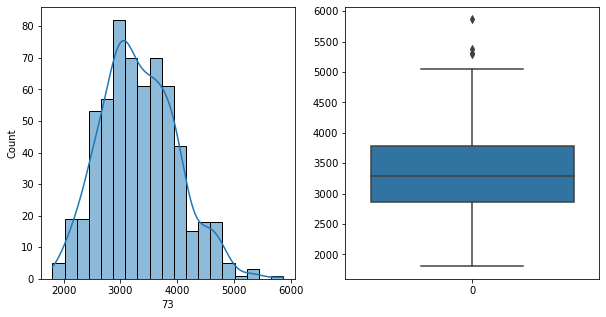

73   Unique :  [4025 3858 3683 4429 2802 2331 4380 3565 3591 2625 3146 3157 4774 3575
 3042 2977 2945 3854 3834 2220 4076 3863 3269 2519 3058 2653 3916 3380
 3398 3857 2830 4097 2443 3076 2080 3498 2586 3280 3734 3597 4188 2938
 2754 3825 3634 3760 2097 2875 3672 3129 3775 2803 3482 3259 3713 3009
 3367 3314 2188 3102 4162 3510 3950 5318 3403 3930 2191 3010 4843 4260
 4626 3625 2843 2394 2655 2820 5293 3782 3051 3661 3073 4553 2962 2799
 2632 3748 3179 2552 4057 3145 2510 2365 2993 3440 3873 3571 3135 4011
 3742 3047 3749 2992 3070 2245 4022 3586 2953 3048 3299 3336 3862 2794
 2976 2634 3538 4787 3855 3706 4634 3034 4371 3103 3611 2911 2669 4063
 4897 5865 2828 2460 3563 2917 3818 2892 3406 2219 4624 3678 3525 4519
 3234 4036 3573 3655 3530 3835 2504 3666 2595 3136 2814 3410 3224 3758
 3648 2721 3446 3540 3900 3378 4060 2797 3337 2815 3499 2259 3313 2844
 2665 2728 2819 3894 3320 4701 3601 2852 2494 3204 5381 3208 2630 4151
 4610 2569 2922 3692 2457 3128 2793 3812 3783 3143 2473 2941 2

,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


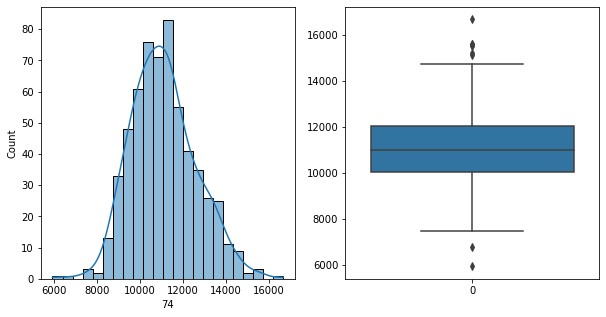

74   Unique :  [12413 12494 11114 10424  9906 11723 10632 14291 11397  6768 10665 11943
 13970 14460 11597 11244  9981 13450 10753  9959 11930 10703 10862 10037
 11345  9005  9816  8681 11615  9062 11541 12151  9832  9834  9087 10900
 10364  9440 11987 11533 13235 12311 10237  9820 13111 10974 10497  8884
 12760 13939 10208  9896  9576 11007 11340 12767 14726 12085 12279 10494
 11580 10124 12410 11194 10028  9361 10445 13943 15597 12824 12089 10882
 11404 10386 11087 10121  9909 11482 13417 11149  9588  9991  9213 12511
  8473  9718  9698 13277 11376 13739  8480  9531  9230 11763 12000 12298
 11136  9861 11347 13438 11628 11403 11428  9540 11758 11700 11643  9549
 13156  9472  9649 11044  8661  9652 11270 10574 11098  9385 11294 10270
  9182 11516 11082 11425 10425 10981 10591 13320  8633 11264  9729 10728
  9233 14475  7750 10133  9614 12690  9031 13486 11837 13934 13558 13115
  9890 13330 10218 11860 11091 13201 10226 11534  9057 10542  8235  9755
 12513 11405  9568  9894 15509 11078

,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


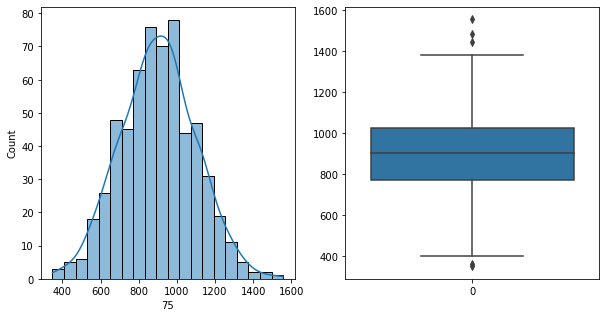

75   Unique :  [1074  960 1104  593  941  689  743  844  535  790  534  834 1445 1156
  713  958 1257  753  884  590  937  993  916  801 1140 1016  750  837
 1135  399 1255 1081 1008  987  545 1043 1216  721  613  965  889  778
  607  908  669  836  630  998 1101  913  603  711  919 1363  774 1184
 1158  939  583 1121  822 1132 1275  980  921  963  701 1004 1308 1045
  751  894  938  988  763  973  924 1099  917  860  449  592  887  616
  788  817  952  821  706  619  759 1091 1293  875  675 1094 1151  922
  754  995 1051  651  758  568  516  799  526  961 1002  663  928  413
 1049 1030  951 1234 1119  893  673 1168  782  652  702  906  850  726
  857  970 1034  678 1556 1191 1117  455 1003  828  964  756 1031  707
 1152  865  891  654  842 1231  816  914 1011  838  950 1062  840 1198
 1160  825  551 1297 1125 1217  600  558 1023  497  883  720 1251  762
  646 1130 1041  752 1067  760  943  687 1189  926  631  648  667  735
  864 1065 1344 1123  886  803  927 1134  855  685  879  994 1

,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


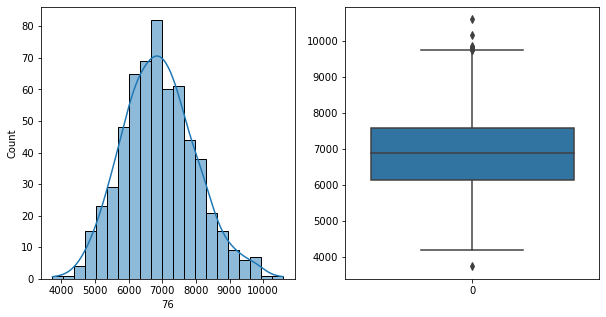

76   Unique :  [ 8650  7663  7144  8123  5728  5167  6725  6560  7221  5199  5328  7134
  9857  7562  6513  6125  6926  8700  7390  5655  7510  6739  7294  6493
  6804  5809  6157  5915  7449  5958  7541  7357  8273  5046  5795  6669
  8480  5829  6452  6059  7850  8130  7101  6509  9467  7043  7670  6410
  7873  7247  6890  5861  7573  8085  7284  5746  7841  7312  7432  5361
  7912  6178  6279  7886  9293  7210  7650  6047  7621  7807  7129  8187
  6762  7493  6557  5515  5688  6321  7476  6932  6986  6409  7506  6391
  7597  6800  7286  8154  6683  7082  6859  5472  5850  6959  8812  6782
  5387  6524  6358  7054  7773  6451  8899  5461  6195  6422  5817  5213
  6031  6481  6196  6257  5613  7340  6060  7184  7551  7741  7260  6711
  8106  6266  6984  6997  7308  7103  5996  6407  7410 10593  5791  5800
  7117  6954  8164  6741  8672  6814  9730  8165  8897  5612  7385  5725
  6510  6807  8028  6209  6951  4907  6545  6785  5411  6322  8304  6735
  6809  5269  8750  7376  6387  8355

,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


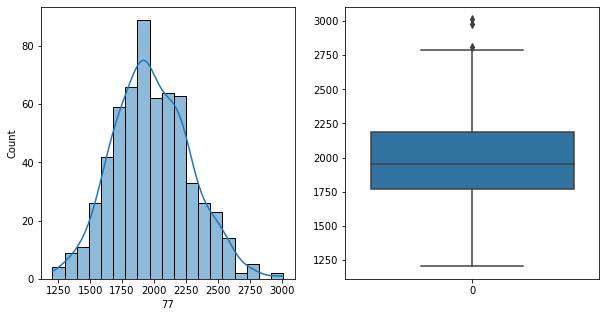

77   Unique :  [1870 1747 2273 2544 1924 2177 2212 1871 1660 1580 1499 1926 2288 2116
 1761 1949 1804 1897 1858 1509 2390 1972 2150 2313 2238 2009 1586 1538
 2036 1732 2236 2308 1701 1767 1551 2122 2247 1774 1920 1912 2094 1939
 2141 1387 2139 1695 1889 1724 2090 2489 1958 1426 1754 1969 2520 2559
 2112 2370 2168 2175 1708 2395 1885 2297 2044 2575 2235 2035 1258 2014
 3012 2290 2051 1599 2391 1694 2012 1793 1927 1648 1631 1849 1384 2364
 1950 1987 1482 2103 1981 1596 1204 1559 2056 1763 1880 1684 2193 2025
 1791 2100 1852 2231 1974 2611 1731 1853 1956 1540 2169 2230 1919 2217
 1902 1894 2413 2211 2144 2259 2136 2182 1692 2275 2184 1652 1809 2350
 1873 1461 1957 2145 1845 2595 1546 2346 2249 2607 1696 1646 1832 1598
 1792 2225 1374 1608 2020 1512 1966 2266 2484 2508 1627 2556 1921 2229
 2464 2319 2059 2471 1988 1990 2321 2199 1508 2528 2158 1674 1784 1863
 2630 1356 1619 1626 2101 2240 1954 1702 2571 1558 1618 2134 2254 1913
 1657 1729 2024 1685 1645 1576 2216 1964 1932 2352 1877 2029 1

,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


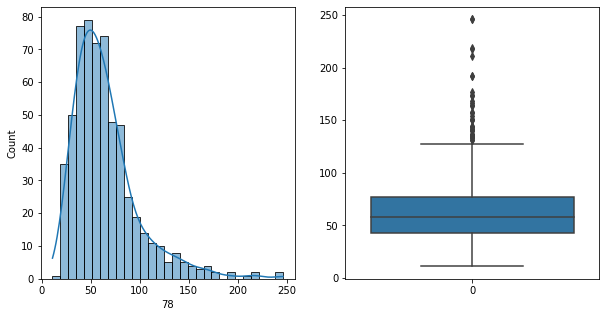

78   Unique :  [105  58  75  76  86  54 103  42  68  49  48  25  59  56  43  82  67 164
  44  64  81  95  63  41 107  26  33 134  87  73  53  60  69  35  79 106
  40  65  61  93  46  24 158  32  38  70  30  55  84  83  27 124  47  57
 104  78  37  34 133  98  62  50  52  77 218 111  66  74  29  80 120  39
  89  94 136  28  36 137  20 173  51 122 125  91  97 102  72 150  96  45
 108  11 142 144  31 126 219 177 157 131  99 211 118  88 174 119 109 114
 135 115 165  85 192 145  71 110 140 166 151 141 154 100  23  92 246  21
 168 116 127]
--------------------------------------------------------------------
78   N unique :  129
--------------------------------------------------------------------
78   Value Counts :  43     17
53     15
49     12
65     12
48     12
       ..
219     1
177     1
157     1
211     1
127     1
Name: 78, Length: 129, dtype: int64
--------------------------------------------------------------------



[ 79 ]
show_df_info :  79


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


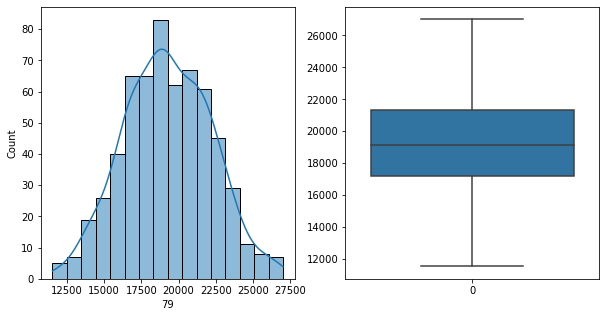

79   Unique :  [21958 21001 21595 21678 18197 17685 18416 23956 16031 13467 19214 18429
 21350 21714 20288 19632 18690 18540 19379 16428 19647 21717 19978 19812
 21233 19814 13887 13426 22518 15628 23750 21937 21163 13705 14258 19066
 21042 19263 21481 18829 20803 19815 18149 16077 25051 21990 17765 19636
 21203 18681 14068 15790 21917 22599 22928 19221 18045 22462 20920 14234
 23116 16750 22575 20676 21424 19135 18648 12481 18815 25734 18266 22063
 19522 19592 20053 22167 18600 19693 20358 21750 16665 16183 17224 15729
 18199 13560 20096 16150 25449 20376 24723 12271 15278 15261 18991 23454
 23822 19392 16996 21878 26007 19628 26758 17908 21377 22819 19133 14992
 22408 13836 16948 16779 17280 17267 20375 15557 20182 18376 20017 14982
 15184 22228 19899 20476 21455 19212 19784 23534 17359 20981 15086 16513
 19086 23274 15396 13024 18522 21649 17191 22311 17486 24670 22471 25829
 16638 18677 21114 20291 16817 19804 16732 21100 16621 15658 20622 15794
 14155 25247 21033 19937 16032 26983

,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


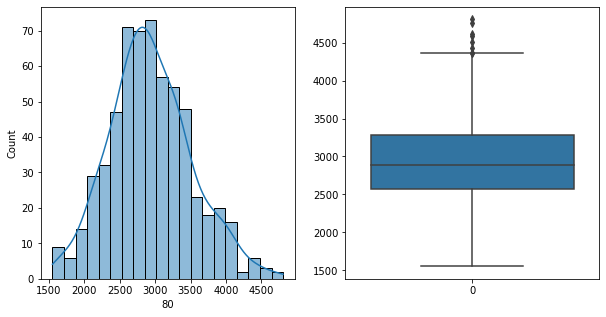

80   Unique :  [3376 3670 2912 3989 2571 2444 3182 3081 2686 2447 3042 3119 3499 3606
 3216 2692 3188 2829 2406 2910 3550 2625 2458 2555 2925 2609 2600 2386
 3135 2317 3261 3179 3418 1714 1715 2927 4005 2604 3212 3283 3641 3860
 2205 2491 3193 2323 2896 1915 2742 3607 2364 3352 1849 4070 3154 4369
 2709 2396 3980 2861 2044 3493 2953 3488 2863 2810 2764 2809 3698 3900
 3287 3658 2873 2179 2859 2367 2160 3164 3444 3419 2081 2043 2487 2697
 2850 2144 1888 2202 2451 3356 3710 2106 2436 2799 3343 2687 3202 2585
 2588 2958 3120 2622 3362 3752 3355 3160 2890 2814 3619 2338 2200 3215
 2979 2250 2513 2282 3985 2174 3378 2838 2217 3924 3077 3589 2215 3214
 2276 3192 3411 3021 4806 2152 1673 2862 2766 3257 2871 3568 2295 3709
 2757 3815 3194 4209 2264 2636 2932 2643 3059 1989 2441 2780 2211 3295
 2726 3403 3108 3469 3329 2818 3024 4151 2409 3899 2574 3440 2784 2754
 2337 4029 2529 2157 2947 3147 3111 3793 3002 2235 2383 2333 2922 3893
 3181 2787 3082 4433 2214 2658 2540 2470 2785 2811 2646 2601 2

,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


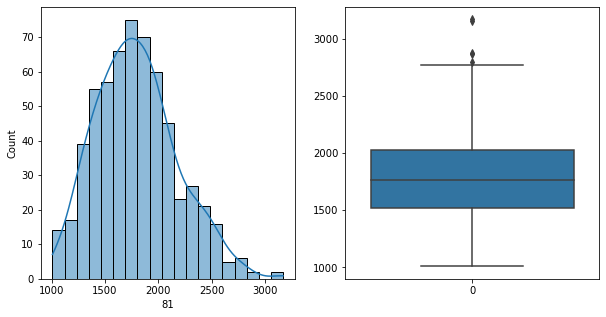

81   Unique :  [1675 1623 1845 3154 1583 1121 2059 1779 1375 1229 2047 1291 1804 1307
 1531 1795 1284 2026 2134 1253 1906 2375 1912 2075 1560 2192 2303 1903
 2136 1542 1869 1496 1636 1622 1967 2084 1299 1065 1785 1527 1446 2061
 1513 2346 1650 1380 1693 1852 1948 1302 1983 1958 2597 1937 1571 1233
 2146 1846 1223 1708 1293 1617 1287 1430 1681 2483 2168 2624 2728 1409
 1565 1889 1442 1041 2203 2514 2113 2458 1971 1343 1814 2091 1835 1973
 1953 1799 1872 1855 1968 1749 1400 1685 2187 1667 1725 1536 1676 1225
 2122 2032 1769 2111 1522 2074 2399 2012 1939 2406 1701 1394 1862 2140
 1853 2005 2767 1738 1402 1456 1395 1842 2243 1975 2106 1877 1248 1562
 1913 2472 1728 1700 1089 1171 1793 1673 2098 1731 1956 1482 1844 2270
 1722 1397 2238 2127 2451 2403 2551 2267 1963 1789 1977 2055 1729 1461
 1388 1241 1303 1767 2037 1610 2040 1742 1952 2541 1582 1666 1698 1534
 1168 1386 1671 1323 2044 2214 1297 2152 1516 1389 1985 2228 1486 1451
 1969 1462 1733 1773 1744 1579 2419 1690 1616 2019 2350 1485 2

,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


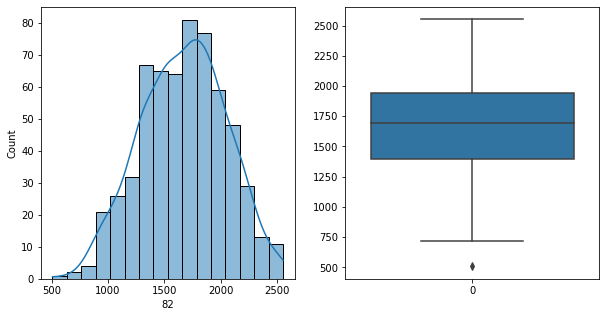

82   Unique :  [2284 1862 1962 1159 1744 1481 1948 1829 1009 1331 1085 1494 2153 2143
 1333 1771 1830 1454 1222 1221 1590 2199 1939 1086 2225 1869 1267 1073
 1933 1230 2261 1943 1860 1656  812 1940 1822 1208 1094 2097 1902 1642
 1566  728 1899 1023 1523 1288 1947 2120 1733 1389 1289 1867 2298 1531
 2223 2437 1790 1150 2116 1844 2098 2521 2133 1886 1842 1132 1805 2402
 1189 2042 1353 1714 1705 1834 1599 2056 1691 1574 1293 1090 1180 1823
 1029 1593 1949 1839 1743  905 1880 2021 1891 2148 1586 1627 2006 1896
 1695 1745 1964 2018 1746 2047 1425 1463  850 1512 1580  876 1789 1725
 1347 1721 1758 2279 1634  835 1900 2036 2130 2017 1506 1802 1775 1127
 1765 1517 1503 1287 1753 1069 1118 1715 1930 1669 1645 2204 1362 1911
 2175 2478  903 1748 1164 1942 1279 1904 1393 1811 1486 1772 1675 1122
 1304 2167 2126 1537 1801 2090 1909 1689 1870 1738 2536 1578 1812  914
 2453 1576 1938  970 2043 1562 1635 1089 1483 1927 1033 2537  998 1278
 1275 2073 1545 2326 1317 1307 1321 2245 1717 1923 1207 1241 1

,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


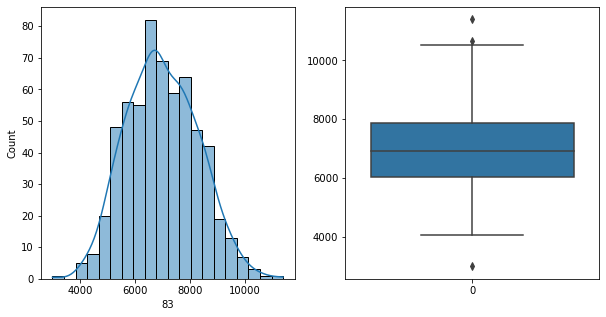

83   Unique :  [ 7189  8400  7719  6825  6026  6482  6551  7619  4392  5598  6579  6807
  6582  9302  8690  6377  6604  6703  6806  5854  6494  7365  8143  6660
  7037  7702  5198  6050  6641  4812  7771  8313  7833  5378  5266  6869
  6680  6543  6508  8175  7050  5916  6283  5290  6416  7548  6843  9260
  8462  5118  5232  6208  7802  7628  7372  7618  5391  8599  7931  4065
  8248  6538  8738  6952  8394  7989  5971  4157  6675 10261  7251  8808
  6969  7762  6927  7506  5671  7610  8484  8301  6013  5892  5384  5771
  6921  5689  8132  5723 11397  5761  7869  4320  5128  5817  6507  7858
  7907  7295  5195  8824  8287  7704  6896  8562  6367  9216  8531  6848
  4851  8755  4735  6038  6085  5758  7794  7153  7687  5953  6981  6585
  6235  7840  7529  6948  9083  7817  6928  8843  5412  7428  5072  6419
  7686  8481  6380  4447  8450  6475  7389  6809  9782  6669  9442  7937
  8945  5132  7375  5727  7319  5424  6813  5142  8658  6035  5408  6823
  4870  5171  8862  7752  6515  6480

,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


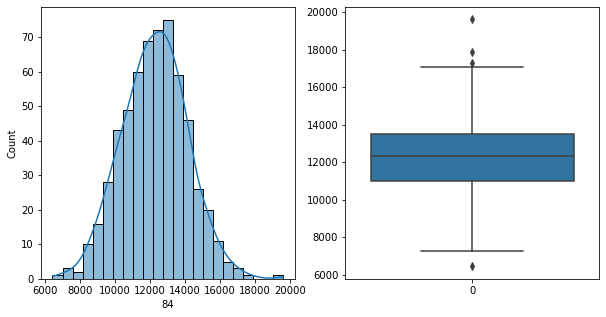

84   Unique :  [11865 13337 13720 13329  9773 11998 11682 13993 11805  9139  9994 12029
 13461 15231 13507 12127 12221 11632 11270  9989 13042 11355 12733 12648
 13187 14078  9697  9365 13528  9055 15314 15661 13735  8780  8617 13310
 11051 13855 11386 12581 12008 11747 10156 12199 11624 13234 12002 12767
 14046 11516  8674 10190 12051 13517 14815 12253 12012 14792 14183 10325
 13458 11740 14980 13836 14840 12908 11191  8919 14519 14077 13224 13439
 11522 11190 11746 11990 11189 15182 11271 13238 10359 10022 10287 10694
 15278  7577 11257 11951 15189 13231 13798  8893  9502 10826 12716 15136
 13780 12429 11170 12047 15509 14896 11480 13967 11525 15467 14252 10622
  9982 13838  7277 10347 10136 10664 12222 12990 10736 13048 14532 13270
 11964  9014 12393 12975 14299 14025 12623 11691 15000 10675 14092 10046
 11712 11080 15917 10483  9446 10442 13623 12702 12239 12041 11392 14479
 15152 15999  9517 15259  9891 12067  9914 17299  9551 14165 10703  8199
 12408  8976  9132 15945 14228 14011

,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


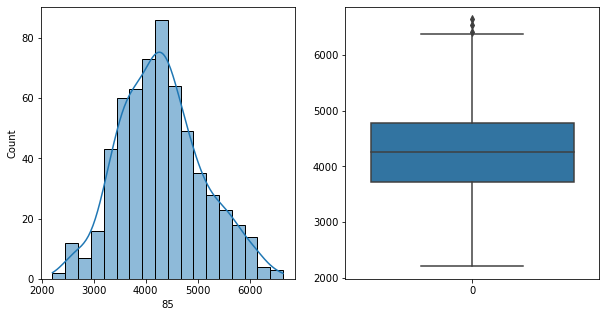

85   Unique :  [5179 4762 4576 5735 3906 3336 4616 5559 3824 3203 3955 4329 4254 5025
 3627 4620 4553 3932 3730 3271 6375 4345 3538 5775 4250 4151 3674 3607
 4954 3565 4943 4817 4248 3231 3054 4691 3930 4102 4774 4412 4400 4366
 2679 4270 4348 4378 4220 3296 3870 5127 3232 4393 2507 4084 5320 5665
 4381 3367 5792 4819 2552 3873 5447 5625 4758 4371 5332 4146 3810 4451
 6542 5475 5742 3719 4564 4445 3778 3168 4551 5112 5971 5533 3794 4398
 3625 4391 4215 3882 3366 4995 5049 4004 3974 2894 2816 5875 5026 5685
 4314 4438 4446 6033 4375 4829 5314 3814 3387 5384 4372 5058 4390 3918
 4029 4152 3597 5486 3537 3988 3375 3741 4448 4573 4083 5002 4315 3192
 3265 5705 3706 4705 3159 4174 6410 3630 3137 3508 4421 3633 4636 3718
 4941 4768 6099 3769 6122 4910 4581 3733 3819 4051 2626 3088 4257 2564
 4016 4685 3705 3379 4135 4064 4185 4259 4368 4566 5560 4032 4357 4081
 3253 4384 4076 5326 2789 4782 3969 4294 4020 4208 3196 4209 4117 3480
 3227 2337 4300 4323 3190 3223 4301 4103 3905 5106 4650 3592 4

,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


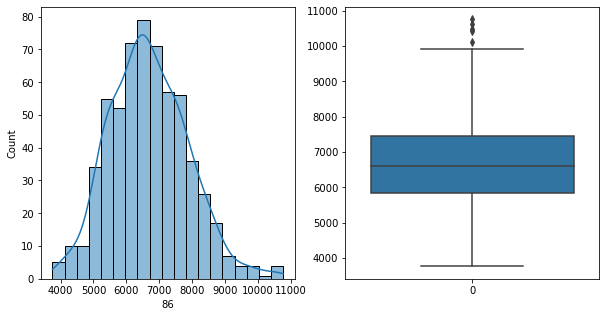

86   Unique :  [ 6750  6763  6038  8545  7508  6476  7709  7706  5418  3755  5430  7277
  5852  7267  6898  8736  8953  5089  6962  7604  7244  6297  6612  5483
  7009  6717  4984  5568  6313  6329  9777  7419  5827  6688  6404  6600
  6477  5013  7263  6857  8763  7195  5425  6231  6879  6845  6062  5217
  7358  8387  6933  8569  6003  7465  8125  9536  6343  6481 10615  7092
  4848  6710  6433  7105  7212  6553  7236  6958  5168  8872  8963  7878
  8236  6677  5702  6203  6712  5631  7964  6169  7278  5549  6091  6323
  7926  6601  5565  5970  5850  8081  6258  5442  5452  7065  7447  9226
  6520  5504  6936  6523  8715  5524  6728  5253  7640  7701  6759  7382
  6732  6189  4275  6560  6117  5230  5682  5262  6298  6513  7367  5416
  5615  7685  5609  6512  7107  5383  7467  5928  6143  5473  7338  8431
  8202  4648  6073  6468  5786  6332  4833 10128  6748  7529  6314  7169
  6286  8142  7827  5949  7734  7832  4834  7697  5803  4980  6552  4289
  7162  9532  5366  6557  4943  7775

,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


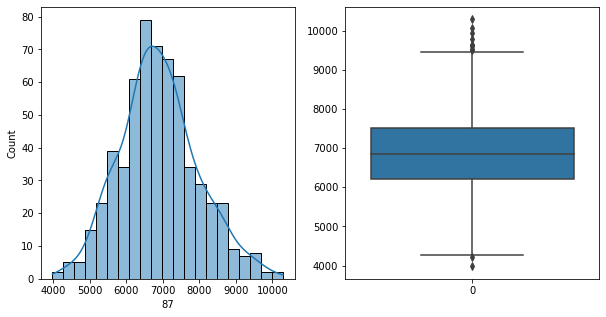

87   Unique :  [ 8684  8084  6995  7726  6112  5295  6994  7943  6777  6129  6162  7001
  9412  7775  6599  5147  6247  7440  6302  5021  7099  6535  8759  6254
  7140  6501  6341  5018  6407  6097  7974  7904  7220  4409  6289  7010
  8213  6311  6562  5690  7315  7297  6441  7169  9535  6449  7473  6499
  6625  6840  6187  5364  5112  6663  8298  8192  6553  7008  8612  7228
  4647  8212  7319  6623  7863  8234  7281  7181  5524  8108  7869  6851
  7717  6554  7467  6368  6421  6381  7048  6686  8547  6244  4941  8041
  7039  8673  7608  6760  6936  6294  6601  6807  5367  4878  5513  6456
  8094  6369  5890  5476  5361  8619  8449  6658  6454  6542  7283  8962
  5282  7047  8543  6397  6028  6216  6494  7721  6118  7353  7004  6486
  6347  7547  8721  8166  8316  7336  6262  6734  7299  6616  7334  5864
  6291  6477  9098  5666  5219  6706  6522  9249  6643  9025  8610  9938
  7975  9063  5954  6876  6282  6937  6470  8220  5498  7756  4509  5519
  8394  5470  6219  8423  8165  5078

,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


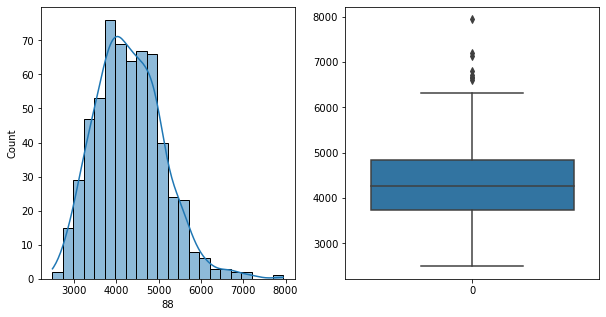

88   Unique :  [5647 5706 4912 4756 5091 3772 4908 5415 3763 2989 3940 4144 5893 4486
 4542 3739 3721 5465 3616 3382 5040 3771 4526 2766 4307 3961 4039 3773
 4175 3311 6038 4264 4418 2654 3303 3839 4174 3414 3907 4119 5679 5027
 3764 4060 4919 3834 5157 3203 4280 4552 2983 4382 2823 4379 5645 5003
 4345 5041 4795 4696 2854 4180 4311 3966 4839 5065 3513 4103 2836 5466
 7124 6804 4875 4403 4341 5018 3278 3980 3811 7189 4940 4278 3423 5347
 3950 5877 3850 4668 4239 4182 4095 4893 3745 3274 3166 4810 4511 4953
 3799 3429 3428 4755 4427 4592 4541 5025 4100 4757 3458 4009 4987 3391
 4122 3815 4431 4716 4589 3255 3828 3353 4679 4746 5685 4084 5102 5147
 4819 3817 3636 5004 3459 3508 3335 4477 5986 7940 3963 3031 5046 4202
 4916 4525 5978 4471 5903 4506 4487 4390 5009 5247 3879 4673 5070 4581
 3503 3117 4803 4149 3355 4674 4350 4112 3047 5758 4783 3618 5290 3761
 5081 4125 4992 3930 4859 3477 4138 3112 5799 4982 4013 4092 3741 4887
 4333 5553 4398 3372 2770 3264 4197 6724 4578 4497 4414 6640 3

,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


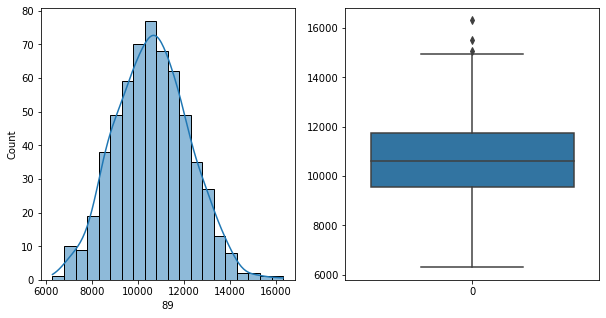

89   Unique :  [10978 11107 12468 15490  9215  9934 10210 10710  9177  8076  7073 10159
 11525 14052 10468 10056 10949 11056 10820  7598 12012 12862  9789 10893
 11833 11962  9609 10698 11872  7239 13421 11398 12085  9241  7793 12041
 12499 10483 11593 11021 10137 11027 10938  9088 11956  9826 10681  9541
 11570 12829 10231  8696  8718 10495 12397 15079 10867 11871 12656 10789
  6885 11179  8661 11462 11477 12416 13898 10228  8587 11164 14333 10065
 10462 10544  9741  9752  9328  9002 10712 10731 13082  9357  9645 10592
  9454 13279 11403  9572  8808 12660 10156  9551  8678  7939  7542 11329
 12770 12552  9374  8298 10702 13836 11436 10843 12152  8416 10842  8183
  9534  8534  9813  8797  8947  9338  9863 12618 10375 11084 10554 10676
 11750  9554 12572 13696 10692 13071 11938  8737 13611 11633 11335  8814
  9931 12086 13708  9872  8235 10713  8970 13660  9155 13115  8945 14359
 12707 11976 10643  9970 10610 11663 11111 10636  8977 11209  8252 10002
 11390  7858 10235 12157  9879 11787

,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


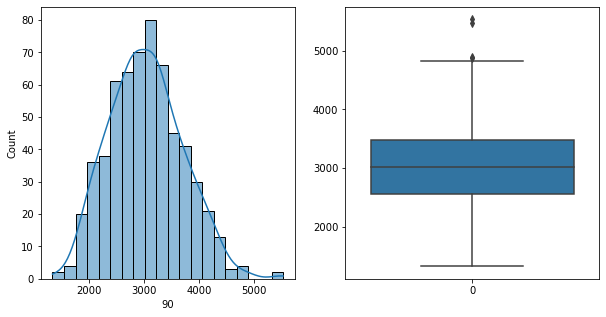

90   Unique :  [4233 3759 4415 1967 3805 4191 2205 3226 2179 2621 2523 2474 4069 3380
 2680 2496 3147 4355 1942 3515 3634 3102 2656 2135 4347 1897 2730 2235
 2119 4005 5532 3251 2762 1947 1325 2525 4559 3293 3575 4455 3554 2882
 2387 2139 3670 2193 2500 3089 3301 2917 2858 2142 3021 2624 3409 2710
 3691 3617 3160 3768 2861 3011 3273 4381 2803 3342 2268 2820 3244 2090
 3480 2916 3930 3194 2552 2883 3373 2942 3988 3834 3685 2386 2080 2384
 3368 2879 1679 2202 2388 3152 4610 3364 2385 2002 3825 3813 3867 2682
 2568 2708 3616 3573 2415 3517 2789 3376 2657 2839 3660 2226 1945 3038
 2698 2895 2830 2134 2417 2430 4705 2126 2381 3316 3629 3547 3309 3013
 2555 1805 2120 2872 2749 2293 3624 1922 2522 2855 4154 2321 3162 3001
 2853 3209 2554 2204 1854 2819 1893 1387 4042 2373 2900 1892 2057 3667
 1588 2383 4046 3521 3502 2800 4867 3950 3034 3314 3092 3504 3192 2683
 3584 3050 4234 2357 2780 2503 3496 2878 2787 2364 3296 3336 2322 4299
 2908 2374 1797 2922 2849 3360 2940 2076 2643 2776 3128 2814 3

,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


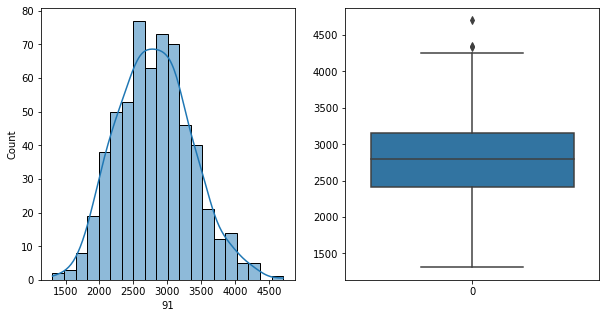

91   Unique :  [3270 4347 3342 4332 2418 1449 3232 3635 3065 2565 2610 3388 3576 3098
 3151 2412 3167 3740 2531 1782 3289 2218 2390 3250 3213 2278 2712 2741
 3139 2716 3181 2706 3215 1847 1635 2544 3422 2646 2812 2932 3205 3267
 2543 2751 2840 2376 2997 2162 2340 2691 2359 2977 1553 2587 3477 3152
 2766 2816 3439 2321 1784 2236 2780 2272 2900 2878 3111 2993 2043 2810
 3581 2890 4143 1945 3075 2849 2496 2110 2382 3173 3955 2769 2040 3022
 2229 3615 2189 2165 2135 1995 2277 2479 2327 1745 2535 3033 3572 3189
 2989 2186 3607 3109 2915 3107 3301 3144 3459 2307 3699 3143 2635 2121
 2431 2575 2488 2644 2605 1926 2357 2996 3523 2243 3335 3431 3048 2108
 2717 2185 2875 1767 3715 4048 2410 1961 2310 2893 2980 3200 2901 2588
 3479 2434 3004 4249 3190 2161 2983 3424 2853 2259 2267 1885 2574 2506
 3027 2553 2703 2348 3124 4066 2758 3278 2799 4212 2438 2937 2859 3358
 3238 2959 2913 2155 3912 3262 2287 2896 2492 2877 3252 3102 2909 2010
 2303 2729 3403 3414 2636 3116 3455 2136 1772 2848 2391 2346 2

,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


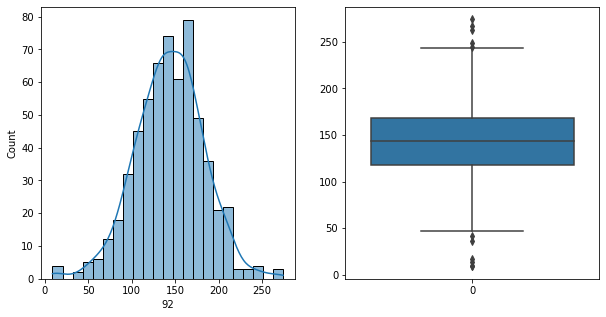

92   Unique :  [174  83 175 274  88 137 113 210  97 108 202 123 140 150 127 145 154  36
 102 132 133 196 184 176  95 125 112 152 138 185  99 121 136 143 157  98
 164 130  61 166 118 105 230  58 135 170 177 165 163 160 178 168 214  85
 156 195 180 141 267 109  82 142 172 158 189 205 120 190 173 183  89 146
 110 191 106 228 161 116 119  93 149  14 208 139 263 159 167 115 235 249
 131 213 181 103  55 124  71  78 187 162 201  67 155  70  96 122 243 134
 171 179 151 197 153 111  79 107 144 104  94  87 114 224  90 169 148 186
 226  49 101 126 128  77  76 192 212 182 147  10 203  65  42 193 194 211
  75  68  56 215 216 241   9 117 209 204 217 188 198  17  66 129 244  63
  47 100  92]
--------------------------------------------------------------------
92   N unique :  165
--------------------------------------------------------------------
92   Value Counts :  154    13
163    11
177    11
130    11
159    10
       ..
212     1
182     1
61      1
10      1
92      1
Name: 92, Length: 165, d

,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


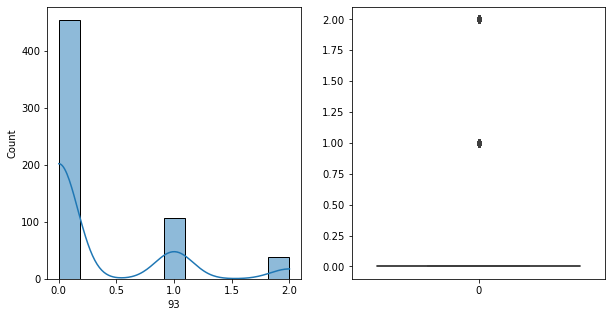

93   Unique :  [0 1 2]
--------------------------------------------------------------------
93   N unique :  3
--------------------------------------------------------------------
93   Value Counts :  0    454
1    107
2     39
Name: 93, dtype: int64
--------------------------------------------------------------------



[ 94 ]
show_df_info :  94


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


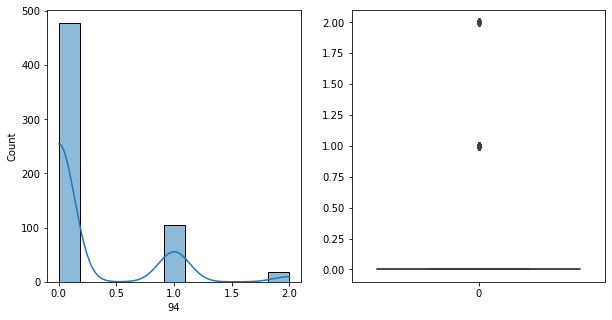

94   Unique :  [0 1 2]
--------------------------------------------------------------------
94   N unique :  3
--------------------------------------------------------------------
94   Value Counts :  0    478
1    104
2     18
Name: 94, dtype: int64
--------------------------------------------------------------------



[ 95 ]
show_df_info :  95


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


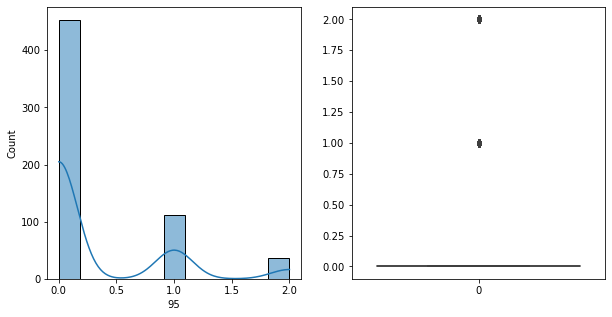

95   Unique :  [0 1 2]
--------------------------------------------------------------------
95   N unique :  3
--------------------------------------------------------------------
95   Value Counts :  0    453
1    111
2     36
Name: 95, dtype: int64
--------------------------------------------------------------------



[ 96 ]
show_df_info :  96


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


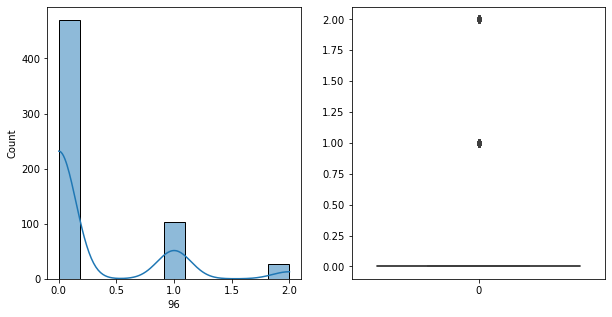

96   Unique :  [1 0 2]
--------------------------------------------------------------------
96   N unique :  3
--------------------------------------------------------------------
96   Value Counts :  0    470
1    104
2     26
Name: 96, dtype: int64
--------------------------------------------------------------------



[ 97 ]
show_df_info :  97


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


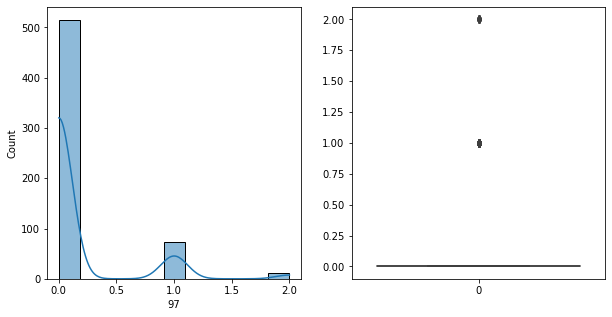

97   Unique :  [0 2 1]
--------------------------------------------------------------------
97   N unique :  3
--------------------------------------------------------------------
97   Value Counts :  0    515
1     73
2     12
Name: 97, dtype: int64
--------------------------------------------------------------------



[ 98 ]
show_df_info :  98


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


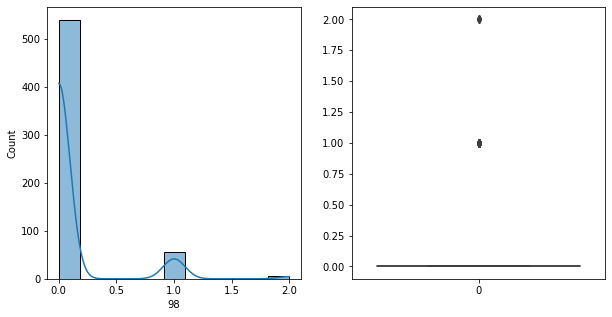

98   Unique :  [0 1 2]
--------------------------------------------------------------------
98   N unique :  3
--------------------------------------------------------------------
98   Value Counts :  0    539
1     55
2      6
Name: 98, dtype: int64
--------------------------------------------------------------------



[ 99 ]
show_df_info :  99


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


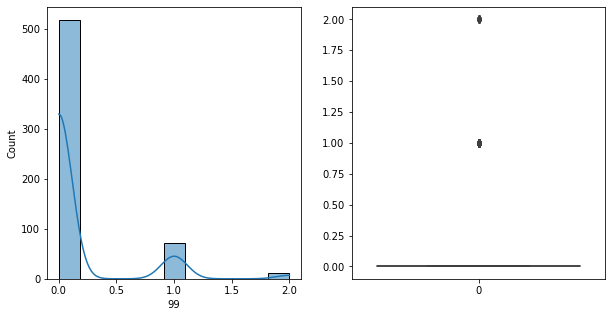

99   Unique :  [0 1 2]
--------------------------------------------------------------------
99   N unique :  3
--------------------------------------------------------------------
99   Value Counts :  0    518
1     71
2     11
Name: 99, dtype: int64
--------------------------------------------------------------------



[ 100 ]
show_df_info :  100


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


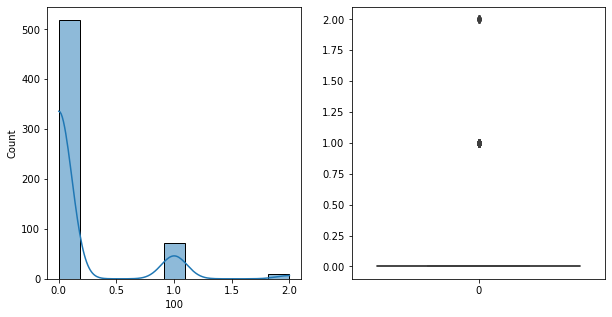

100   Unique :  [0 1 2]
--------------------------------------------------------------------
100   N unique :  3
--------------------------------------------------------------------
100   Value Counts :  0    519
1     71
2     10
Name: 100, dtype: int64
--------------------------------------------------------------------



[ 101 ]
show_df_info :  101


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


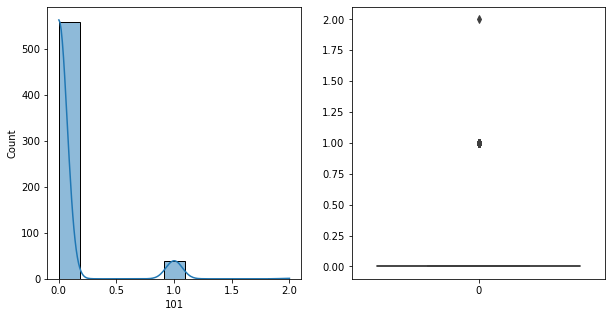

101   Unique :  [1 0 2]
--------------------------------------------------------------------
101   N unique :  3
--------------------------------------------------------------------
101   Value Counts :  0    560
1     39
2      1
Name: 101, dtype: int64
--------------------------------------------------------------------



[ 102 ]
show_df_info :  102


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


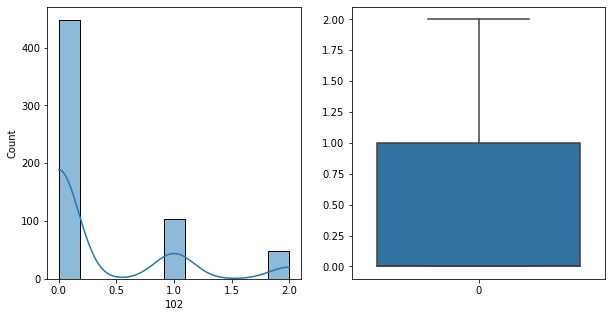

102   Unique :  [1 0 2]
--------------------------------------------------------------------
102   N unique :  3
--------------------------------------------------------------------
102   Value Counts :  0    448
1    104
2     48
Name: 102, dtype: int64
--------------------------------------------------------------------



[ 103 ]
show_df_info :  103


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


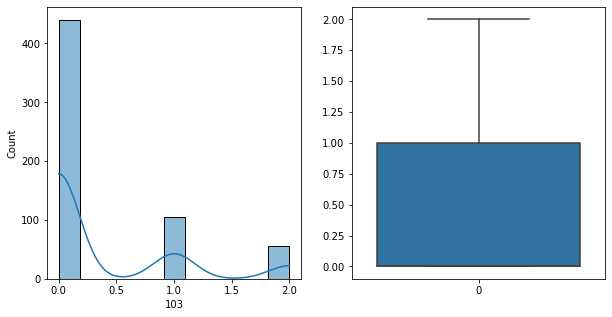

103   Unique :  [0 2 1]
--------------------------------------------------------------------
103   N unique :  3
--------------------------------------------------------------------
103   Value Counts :  0    440
1    105
2     55
Name: 103, dtype: int64
--------------------------------------------------------------------



[ 104 ]
show_df_info :  104


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


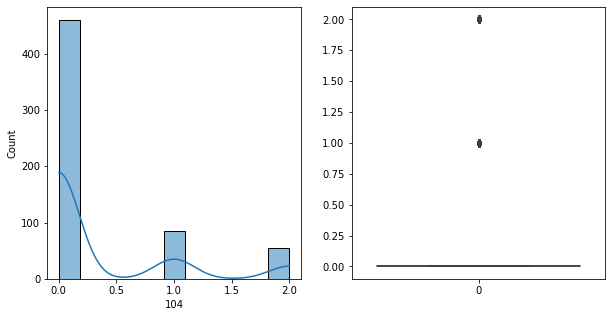

104   Unique :  [0 2 1]
--------------------------------------------------------------------
104   N unique :  3
--------------------------------------------------------------------
104   Value Counts :  0    460
1     85
2     55
Name: 104, dtype: int64
--------------------------------------------------------------------



[ 105 ]
show_df_info :  105


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


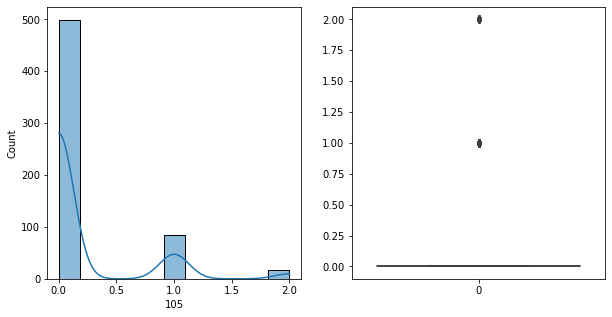

105   Unique :  [0 2 1]
--------------------------------------------------------------------
105   N unique :  3
--------------------------------------------------------------------
105   Value Counts :  0    499
1     84
2     17
Name: 105, dtype: int64
--------------------------------------------------------------------



[ 106 ]
show_df_info :  106


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


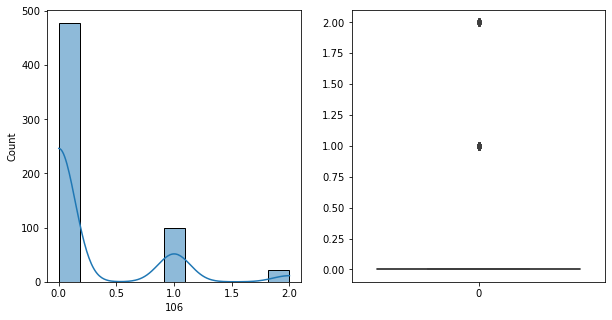

106   Unique :  [0 2 1]
--------------------------------------------------------------------
106   N unique :  3
--------------------------------------------------------------------
106   Value Counts :  0    478
1    100
2     22
Name: 106, dtype: int64
--------------------------------------------------------------------



[ 107 ]
show_df_info :  107


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


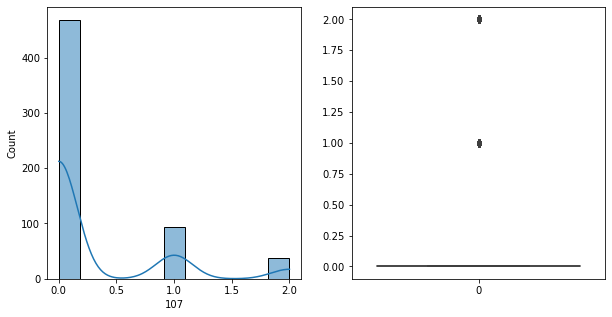

107   Unique :  [1 0 2]
--------------------------------------------------------------------
107   N unique :  3
--------------------------------------------------------------------
107   Value Counts :  0    468
1     94
2     38
Name: 107, dtype: int64
--------------------------------------------------------------------



[ 108 ]
show_df_info :  108


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


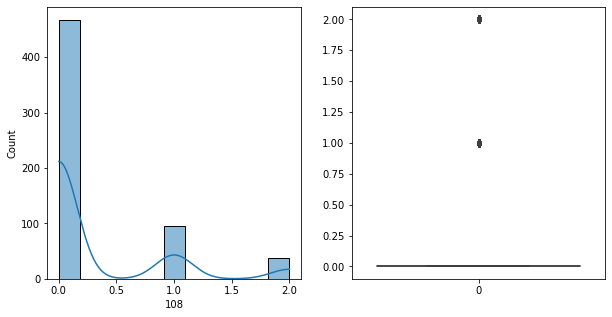

108   Unique :  [1 0 2]
--------------------------------------------------------------------
108   N unique :  3
--------------------------------------------------------------------
108   Value Counts :  0    467
1     95
2     38
Name: 108, dtype: int64
--------------------------------------------------------------------



[ 109 ]
show_df_info :  109


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


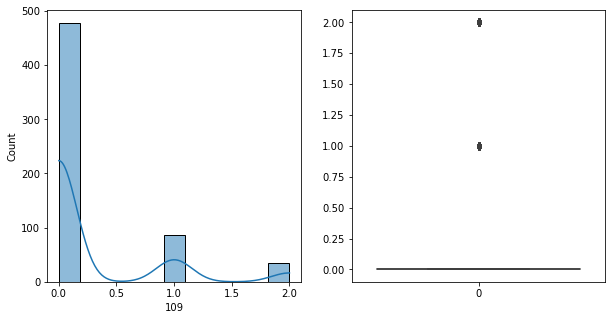

109   Unique :  [1 0 2]
--------------------------------------------------------------------
109   N unique :  3
--------------------------------------------------------------------
109   Value Counts :  0    478
1     87
2     35
Name: 109, dtype: int64
--------------------------------------------------------------------



[ 110 ]
show_df_info :  110


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


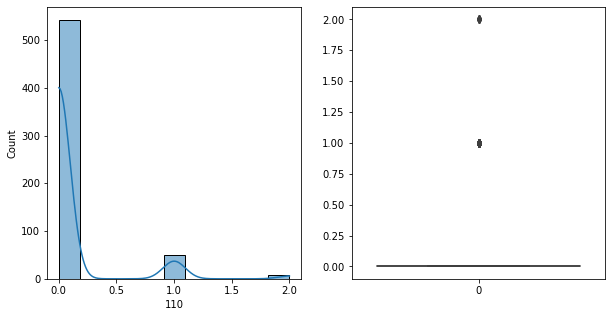

110   Unique :  [0 1 2]
--------------------------------------------------------------------
110   N unique :  3
--------------------------------------------------------------------
110   Value Counts :  0    542
1     50
2      8
Name: 110, dtype: int64
--------------------------------------------------------------------



[ 111 ]
show_df_info :  111


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


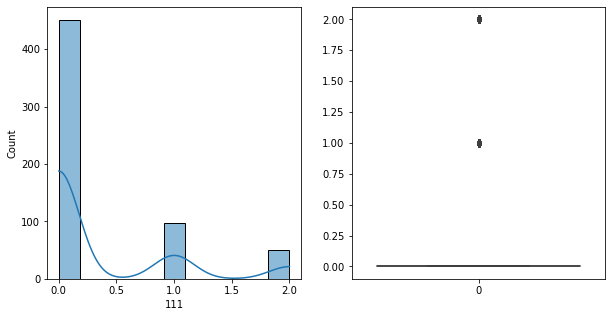

111   Unique :  [1 0 2]
--------------------------------------------------------------------
111   N unique :  3
--------------------------------------------------------------------
111   Value Counts :  0    451
1     98
2     51
Name: 111, dtype: int64
--------------------------------------------------------------------



[ 112 ]
show_df_info :  112


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


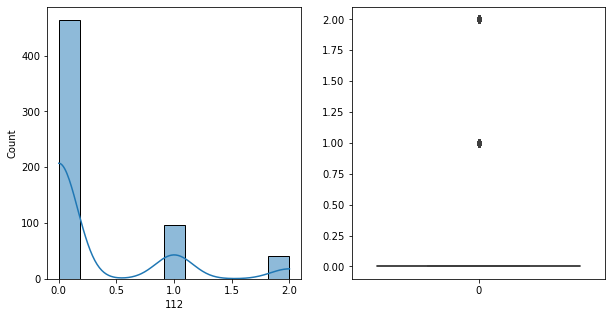

112   Unique :  [1 0 2]
--------------------------------------------------------------------
112   N unique :  3
--------------------------------------------------------------------
112   Value Counts :  0    464
1     96
2     40
Name: 112, dtype: int64
--------------------------------------------------------------------



[ 113 ]
show_df_info :  113


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


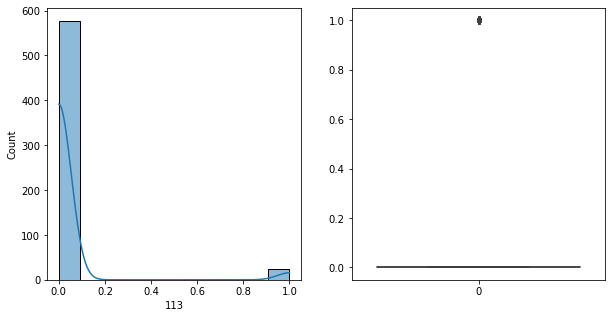

113   Unique :  [0 1]
--------------------------------------------------------------------
113   N unique :  2
--------------------------------------------------------------------
113   Value Counts :  0    577
1     23
Name: 113, dtype: int64
--------------------------------------------------------------------



[ 114 ]
show_df_info :  114


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


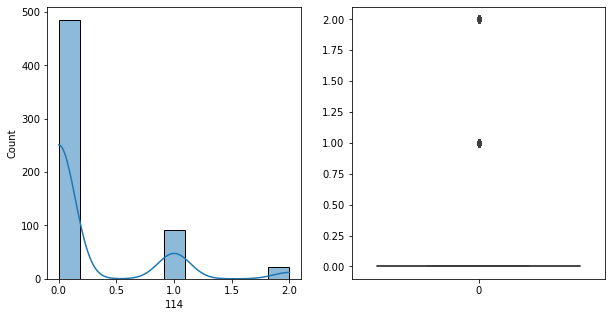

114   Unique :  [0 1 2]
--------------------------------------------------------------------
114   N unique :  3
--------------------------------------------------------------------
114   Value Counts :  0    485
1     92
2     23
Name: 114, dtype: int64
--------------------------------------------------------------------



[ 115 ]
show_df_info :  115


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


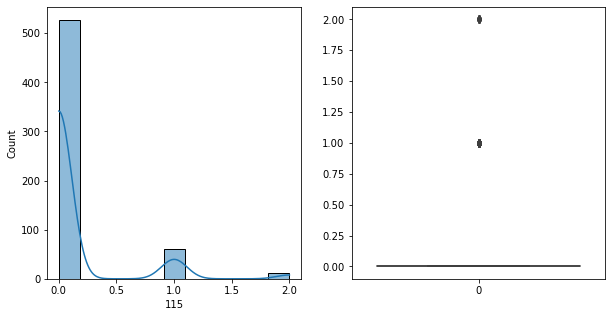

115   Unique :  [1 0 2]
--------------------------------------------------------------------
115   N unique :  3
--------------------------------------------------------------------
115   Value Counts :  0    527
1     61
2     12
Name: 115, dtype: int64
--------------------------------------------------------------------



[ 116 ]
show_df_info :  116


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


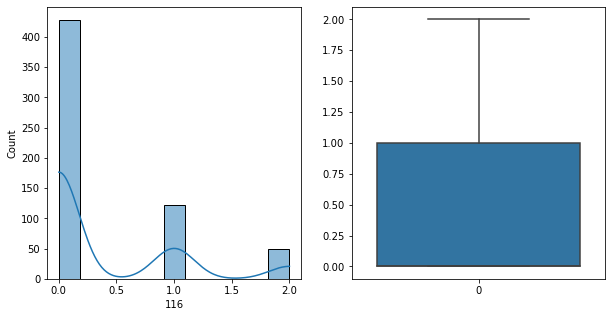

116   Unique :  [0 2 1]
--------------------------------------------------------------------
116   N unique :  3
--------------------------------------------------------------------
116   Value Counts :  0    428
1    122
2     50
Name: 116, dtype: int64
--------------------------------------------------------------------



[ 117 ]
show_df_info :  117


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


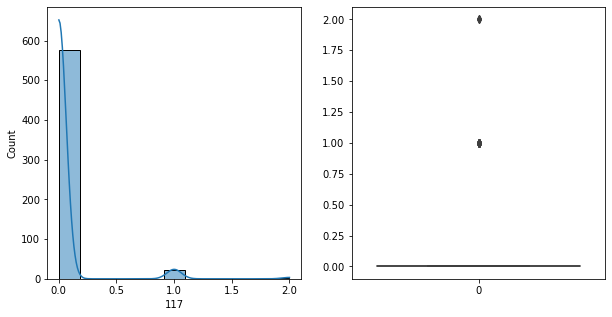

117   Unique :  [0 1 2]
--------------------------------------------------------------------
117   N unique :  3
--------------------------------------------------------------------
117   Value Counts :  0    576
1     21
2      3
Name: 117, dtype: int64
--------------------------------------------------------------------



[ 118 ]
show_df_info :  118


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


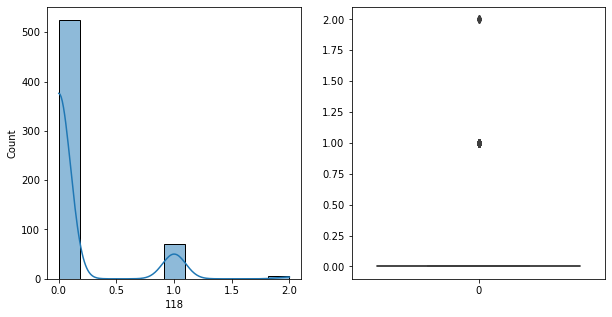

118   Unique :  [1 0 2]
--------------------------------------------------------------------
118   N unique :  3
--------------------------------------------------------------------
118   Value Counts :  0    525
1     70
2      5
Name: 118, dtype: int64
--------------------------------------------------------------------



[ 119 ]
show_df_info :  119


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


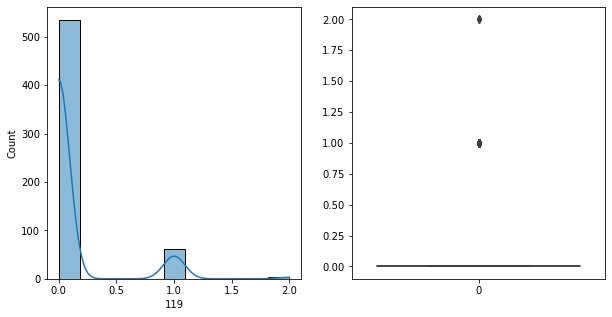

119   Unique :  [1 0 2]
--------------------------------------------------------------------
119   N unique :  3
--------------------------------------------------------------------
119   Value Counts :  0    535
1     61
2      4
Name: 119, dtype: int64
--------------------------------------------------------------------



[ 120 ]
show_df_info :  120


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


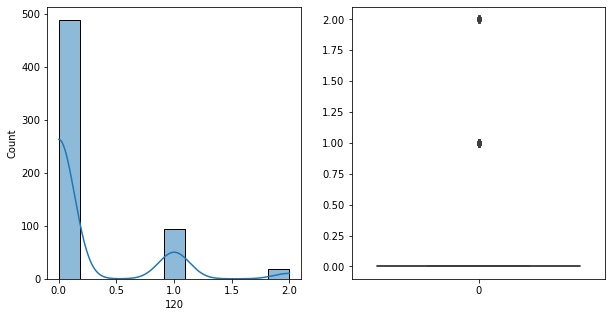

120   Unique :  [1 0 2]
--------------------------------------------------------------------
120   N unique :  3
--------------------------------------------------------------------
120   Value Counts :  0    488
1     93
2     19
Name: 120, dtype: int64
--------------------------------------------------------------------



[ 121 ]
show_df_info :  121


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


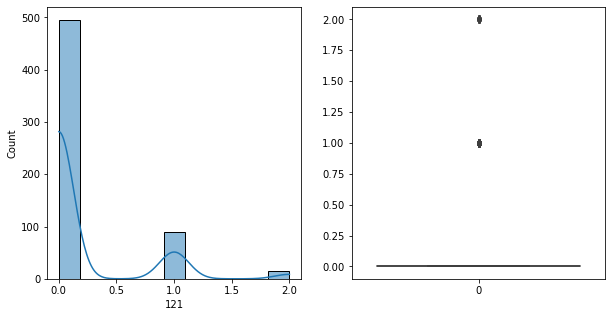

121   Unique :  [1 0 2]
--------------------------------------------------------------------
121   N unique :  3
--------------------------------------------------------------------
121   Value Counts :  0    495
1     90
2     15
Name: 121, dtype: int64
--------------------------------------------------------------------



[ 122 ]
show_df_info :  122


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


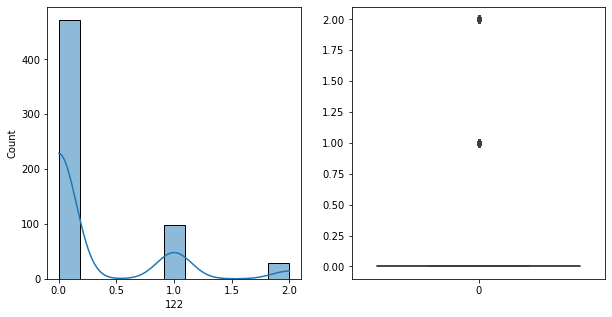

122   Unique :  [1 0 2]
--------------------------------------------------------------------
122   N unique :  3
--------------------------------------------------------------------
122   Value Counts :  0    472
1     99
2     29
Name: 122, dtype: int64
--------------------------------------------------------------------



[ 123 ]
show_df_info :  123


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


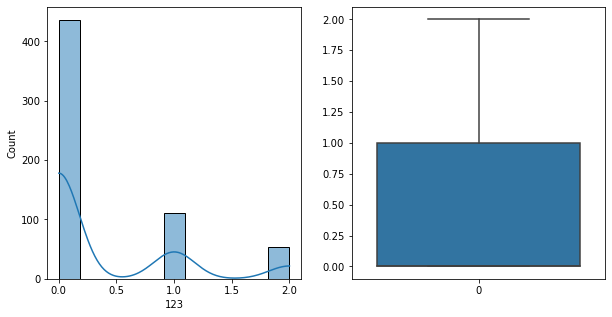

123   Unique :  [1 0 2]
--------------------------------------------------------------------
123   N unique :  3
--------------------------------------------------------------------
123   Value Counts :  0    436
1    111
2     53
Name: 123, dtype: int64
--------------------------------------------------------------------



[ 124 ]
show_df_info :  124


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


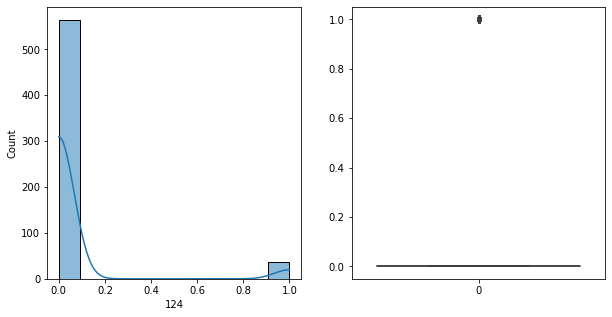

124   Unique :  [0 1]
--------------------------------------------------------------------
124   N unique :  2
--------------------------------------------------------------------
124   Value Counts :  0    564
1     36
Name: 124, dtype: int64
--------------------------------------------------------------------



[ 125 ]
show_df_info :  125


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


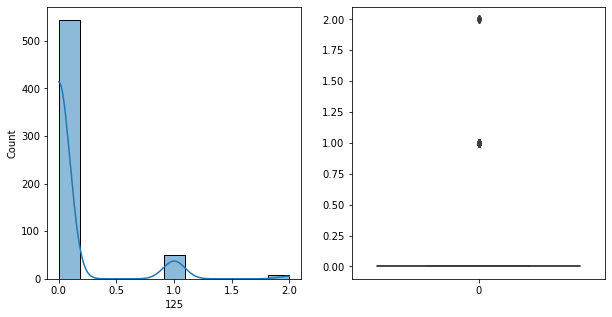

125   Unique :  [0 2 1]
--------------------------------------------------------------------
125   N unique :  3
--------------------------------------------------------------------
125   Value Counts :  0    544
1     49
2      7
Name: 125, dtype: int64
--------------------------------------------------------------------



[ 126 ]
show_df_info :  126


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


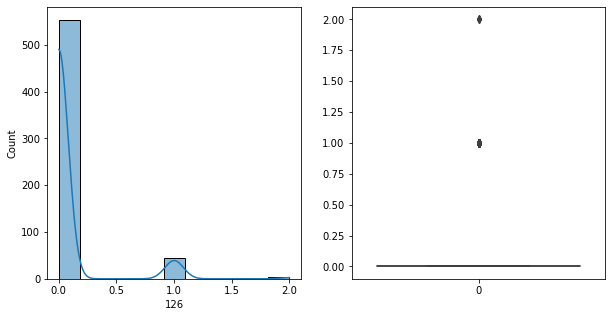

126   Unique :  [0 1 2]
--------------------------------------------------------------------
126   N unique :  3
--------------------------------------------------------------------
126   Value Counts :  0    553
1     44
2      3
Name: 126, dtype: int64
--------------------------------------------------------------------



[ 127 ]
show_df_info :  127


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


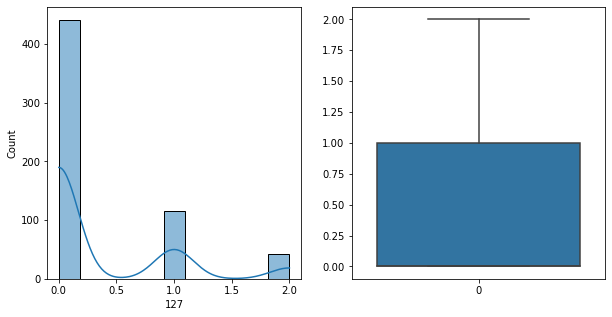

127   Unique :  [1 0 2]
--------------------------------------------------------------------
127   N unique :  3
--------------------------------------------------------------------
127   Value Counts :  0    441
1    116
2     43
Name: 127, dtype: int64
--------------------------------------------------------------------



[ 128 ]
show_df_info :  128


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


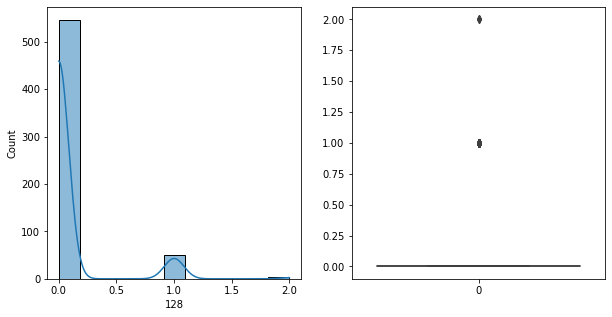

128   Unique :  [0 1 2]
--------------------------------------------------------------------
128   N unique :  3
--------------------------------------------------------------------
128   Value Counts :  0    546
1     51
2      3
Name: 128, dtype: int64
--------------------------------------------------------------------



[ 129 ]
show_df_info :  129


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


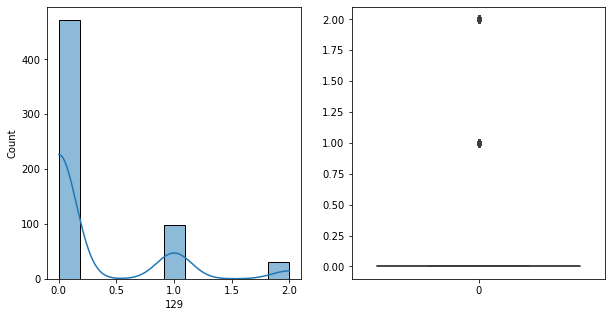

129   Unique :  [1 0 2]
--------------------------------------------------------------------
129   N unique :  3
--------------------------------------------------------------------
129   Value Counts :  0    472
1     98
2     30
Name: 129, dtype: int64
--------------------------------------------------------------------



[ 130 ]
show_df_info :  130


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


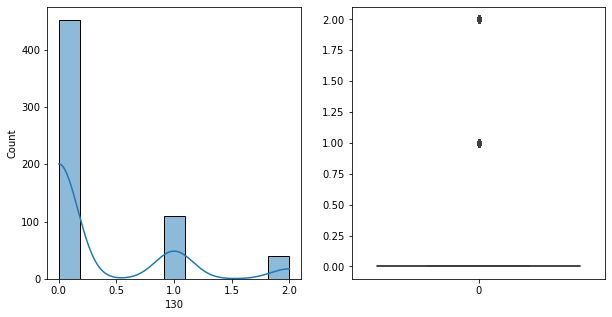

130   Unique :  [1 0 2]
--------------------------------------------------------------------
130   N unique :  3
--------------------------------------------------------------------
130   Value Counts :  0    452
1    109
2     39
Name: 130, dtype: int64
--------------------------------------------------------------------



[ 131 ]
show_df_info :  131


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


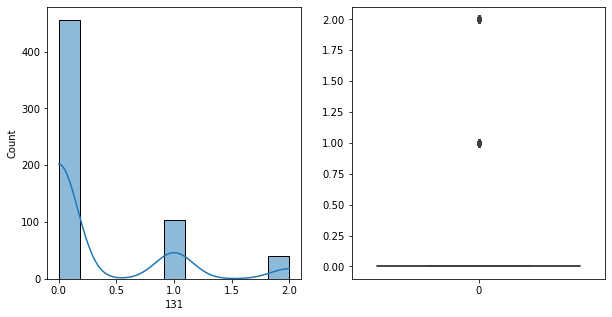

131   Unique :  [1 0 2]
--------------------------------------------------------------------
131   N unique :  3
--------------------------------------------------------------------
131   Value Counts :  0    456
1    104
2     40
Name: 131, dtype: int64
--------------------------------------------------------------------



[ 132 ]
show_df_info :  132


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


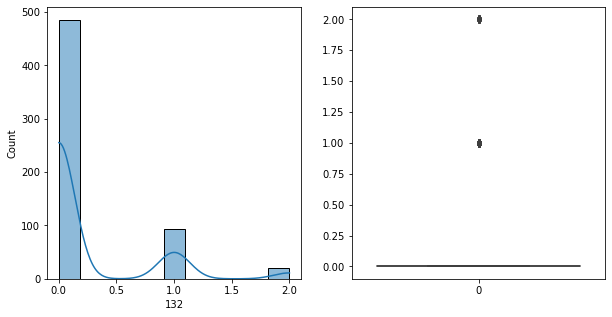

132   Unique :  [1 0 2]
--------------------------------------------------------------------
132   N unique :  3
--------------------------------------------------------------------
132   Value Counts :  0    485
1     94
2     21
Name: 132, dtype: int64
--------------------------------------------------------------------



[ 133 ]
show_df_info :  133


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


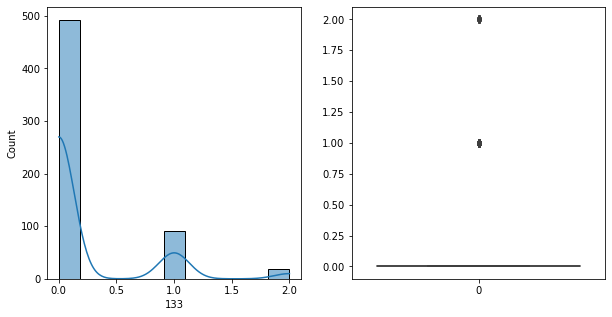

133   Unique :  [0 1 2]
--------------------------------------------------------------------
133   N unique :  3
--------------------------------------------------------------------
133   Value Counts :  0    492
1     90
2     18
Name: 133, dtype: int64
--------------------------------------------------------------------



[ 134 ]
show_df_info :  134


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


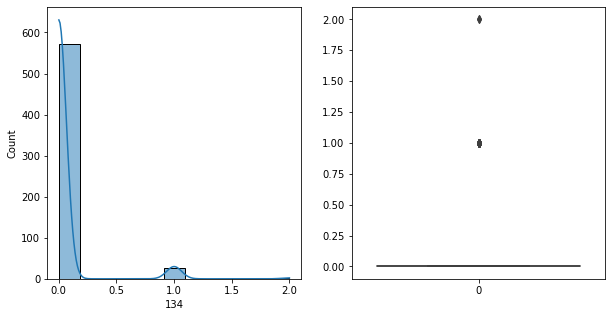

134   Unique :  [0 1 2]
--------------------------------------------------------------------
134   N unique :  3
--------------------------------------------------------------------
134   Value Counts :  0    571
1     27
2      2
Name: 134, dtype: int64
--------------------------------------------------------------------



[ 135 ]
show_df_info :  135


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


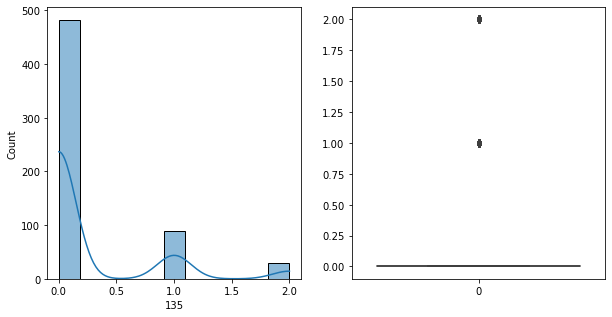

135   Unique :  [1 0 2]
--------------------------------------------------------------------
135   N unique :  3
--------------------------------------------------------------------
135   Value Counts :  0    482
1     89
2     29
Name: 135, dtype: int64
--------------------------------------------------------------------



[ 136 ]
show_df_info :  136


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


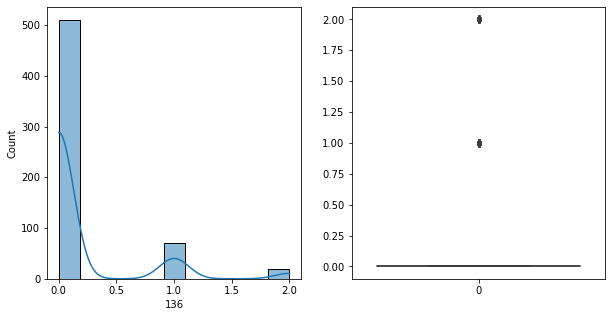

136   Unique :  [0 1 2]
--------------------------------------------------------------------
136   N unique :  3
--------------------------------------------------------------------
136   Value Counts :  0    510
1     71
2     19
Name: 136, dtype: int64
--------------------------------------------------------------------



[ 137 ]
show_df_info :  137


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


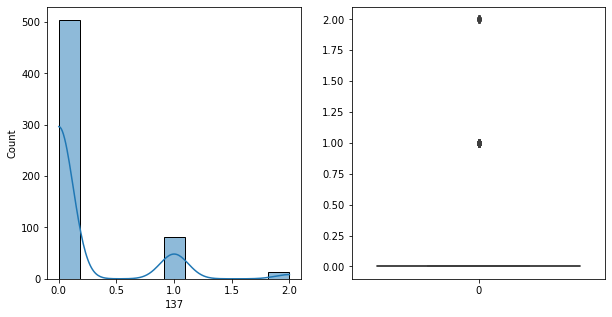

137   Unique :  [0 1 2]
--------------------------------------------------------------------
137   N unique :  3
--------------------------------------------------------------------
137   Value Counts :  0    504
1     82
2     14
Name: 137, dtype: int64
--------------------------------------------------------------------



[ 138 ]
show_df_info :  138


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


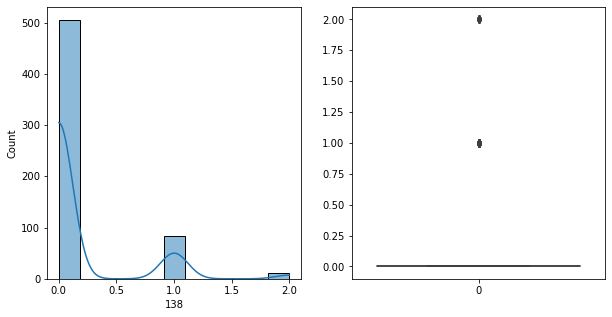

138   Unique :  [0 1 2]
--------------------------------------------------------------------
138   N unique :  3
--------------------------------------------------------------------
138   Value Counts :  0    505
1     83
2     12
Name: 138, dtype: int64
--------------------------------------------------------------------



[ 139 ]
show_df_info :  139


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


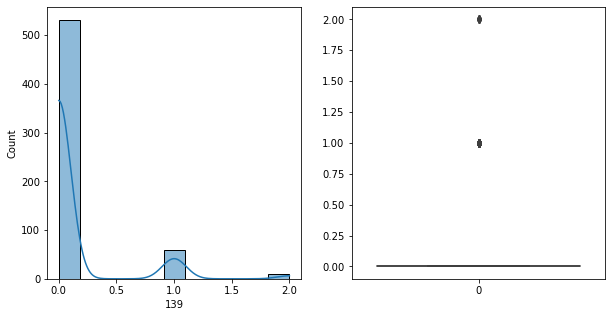

139   Unique :  [1 0 2]
--------------------------------------------------------------------
139   N unique :  3
--------------------------------------------------------------------
139   Value Counts :  0    531
1     60
2      9
Name: 139, dtype: int64
--------------------------------------------------------------------



[ 140 ]
show_df_info :  140


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


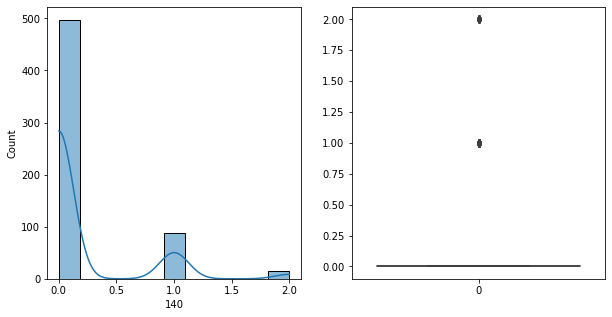

140   Unique :  [2 0 1]
--------------------------------------------------------------------
140   N unique :  3
--------------------------------------------------------------------
140   Value Counts :  0    497
1     88
2     15
Name: 140, dtype: int64
--------------------------------------------------------------------



[ 141 ]
show_df_info :  141


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


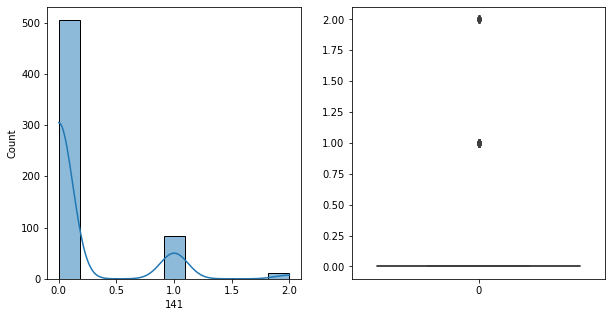

141   Unique :  [0 1 2]
--------------------------------------------------------------------
141   N unique :  3
--------------------------------------------------------------------
141   Value Counts :  0    505
1     83
2     12
Name: 141, dtype: int64
--------------------------------------------------------------------



[ 142 ]
show_df_info :  142


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


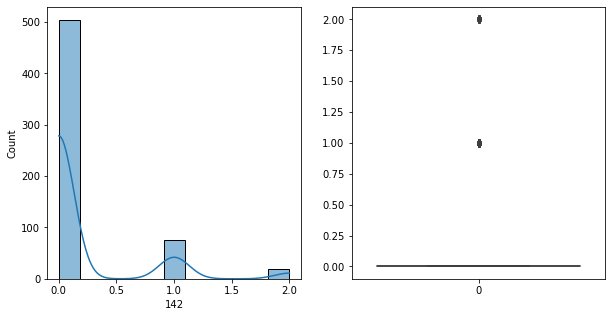

142   Unique :  [0 1 2]
--------------------------------------------------------------------
142   N unique :  3
--------------------------------------------------------------------
142   Value Counts :  0    504
1     76
2     20
Name: 142, dtype: int64
--------------------------------------------------------------------



[ 143 ]
show_df_info :  143


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


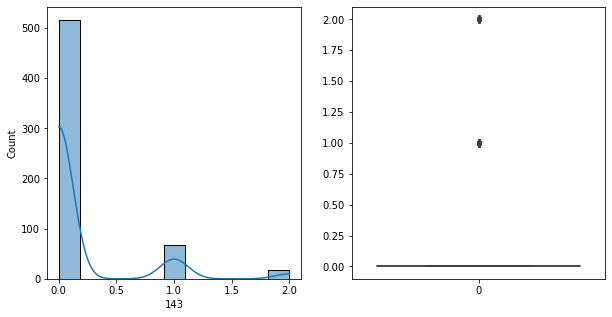

143   Unique :  [0 1 2]
--------------------------------------------------------------------
143   N unique :  3
--------------------------------------------------------------------
143   Value Counts :  0    516
1     67
2     17
Name: 143, dtype: int64
--------------------------------------------------------------------



[ 144 ]
show_df_info :  144


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


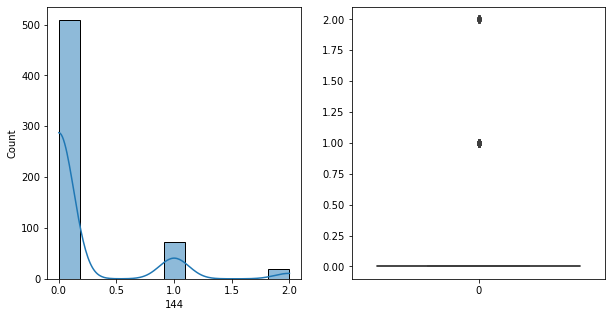

144   Unique :  [0 1 2]
--------------------------------------------------------------------
144   N unique :  3
--------------------------------------------------------------------
144   Value Counts :  0    509
1     72
2     19
Name: 144, dtype: int64
--------------------------------------------------------------------



[ 145 ]
show_df_info :  145


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


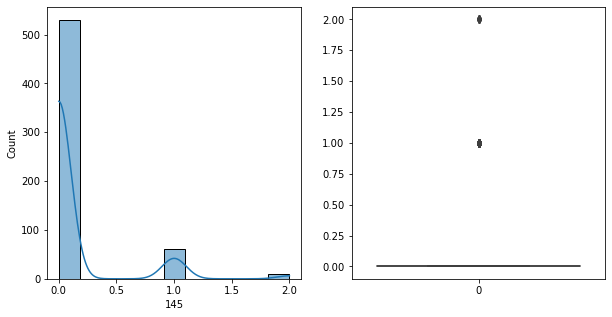

145   Unique :  [0 1 2]
--------------------------------------------------------------------
145   N unique :  3
--------------------------------------------------------------------
145   Value Counts :  0    530
1     61
2      9
Name: 145, dtype: int64
--------------------------------------------------------------------



[ 146 ]
show_df_info :  146


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


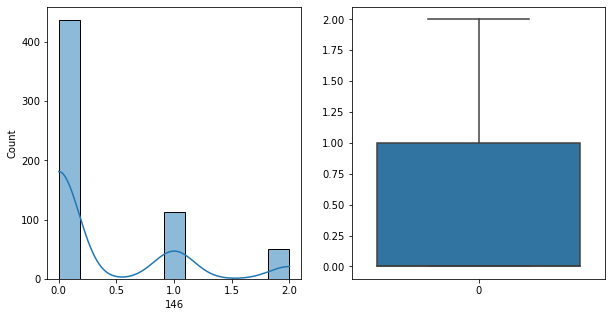

146   Unique :  [1 0 2]
--------------------------------------------------------------------
146   N unique :  3
--------------------------------------------------------------------
146   Value Counts :  0    437
1    113
2     50
Name: 146, dtype: int64
--------------------------------------------------------------------



[ 147 ]
show_df_info :  147


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


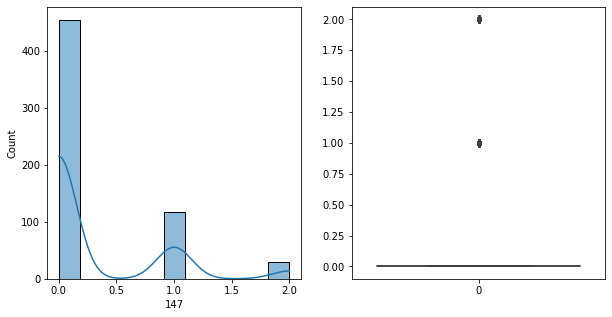

147   Unique :  [0 1 2]
--------------------------------------------------------------------
147   N unique :  3
--------------------------------------------------------------------
147   Value Counts :  0    454
1    117
2     29
Name: 147, dtype: int64
--------------------------------------------------------------------



[ 148 ]
show_df_info :  148


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


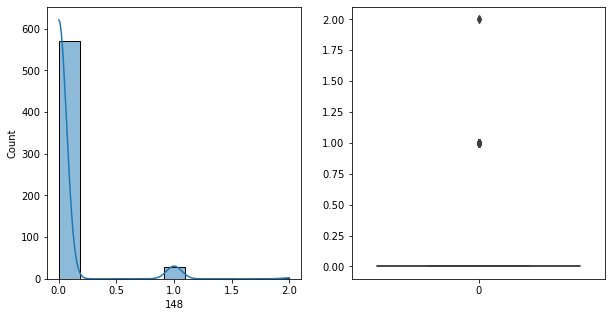

148   Unique :  [0 1 2]
--------------------------------------------------------------------
148   N unique :  3
--------------------------------------------------------------------
148   Value Counts :  0    570
1     28
2      2
Name: 148, dtype: int64
--------------------------------------------------------------------



[ 149 ]
show_df_info :  149


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


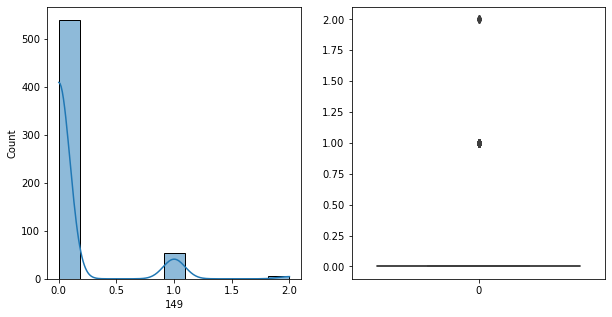

149   Unique :  [0 1 2]
--------------------------------------------------------------------
149   N unique :  3
--------------------------------------------------------------------
149   Value Counts :  0    540
1     54
2      6
Name: 149, dtype: int64
--------------------------------------------------------------------



[ 150 ]
show_df_info :  150


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


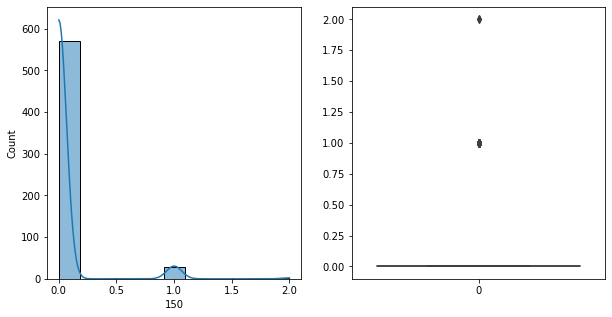

150   Unique :  [0 1 2]
--------------------------------------------------------------------
150   N unique :  3
--------------------------------------------------------------------
150   Value Counts :  0    570
1     28
2      2
Name: 150, dtype: int64
--------------------------------------------------------------------



[ 151 ]
show_df_info :  151


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


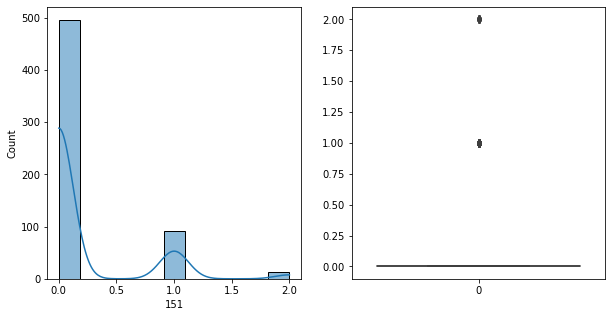

151   Unique :  [0 1 2]
--------------------------------------------------------------------
151   N unique :  3
--------------------------------------------------------------------
151   Value Counts :  0    496
1     91
2     13
Name: 151, dtype: int64
--------------------------------------------------------------------



[ 152 ]
show_df_info :  152


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


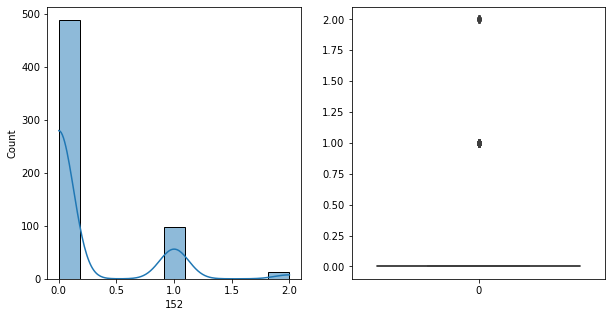

152   Unique :  [1 0 2]
--------------------------------------------------------------------
152   N unique :  3
--------------------------------------------------------------------
152   Value Counts :  0    489
1     98
2     13
Name: 152, dtype: int64
--------------------------------------------------------------------



[ 153 ]
show_df_info :  153


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


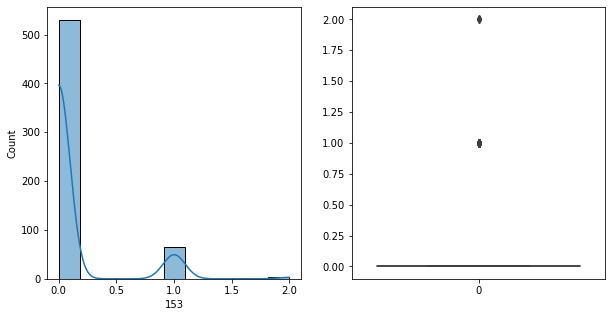

153   Unique :  [0 1 2]
--------------------------------------------------------------------
153   N unique :  3
--------------------------------------------------------------------
153   Value Counts :  0    530
1     66
2      4
Name: 153, dtype: int64
--------------------------------------------------------------------



[ 154 ]
show_df_info :  154


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


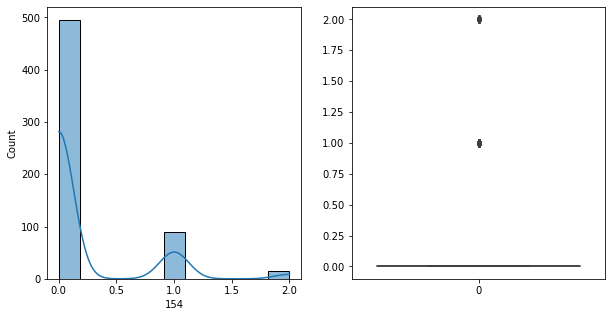

154   Unique :  [0 1 2]
--------------------------------------------------------------------
154   N unique :  3
--------------------------------------------------------------------
154   Value Counts :  0    495
1     90
2     15
Name: 154, dtype: int64
--------------------------------------------------------------------



[ 155 ]
show_df_info :  155


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


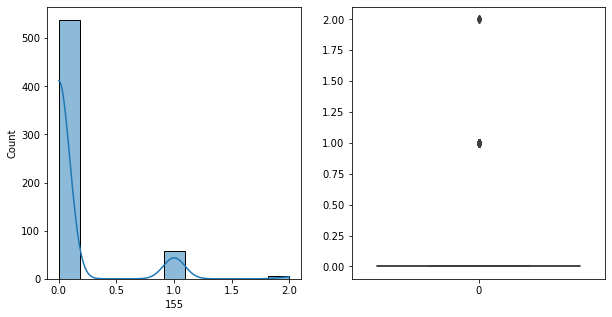

155   Unique :  [0 1 2]
--------------------------------------------------------------------
155   N unique :  3
--------------------------------------------------------------------
155   Value Counts :  0    538
1     57
2      5
Name: 155, dtype: int64
--------------------------------------------------------------------



[ 156 ]
show_df_info :  156


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


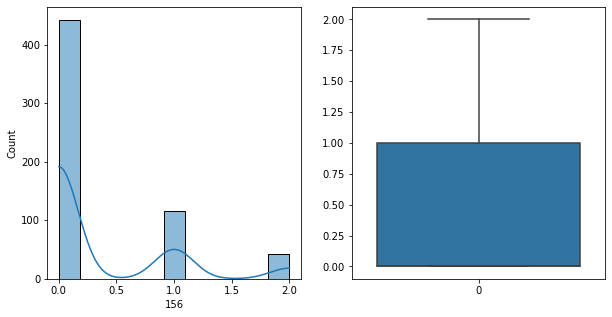

156   Unique :  [2 0 1]
--------------------------------------------------------------------
156   N unique :  3
--------------------------------------------------------------------
156   Value Counts :  0    442
1    116
2     42
Name: 156, dtype: int64
--------------------------------------------------------------------



[ 157 ]
show_df_info :  157


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


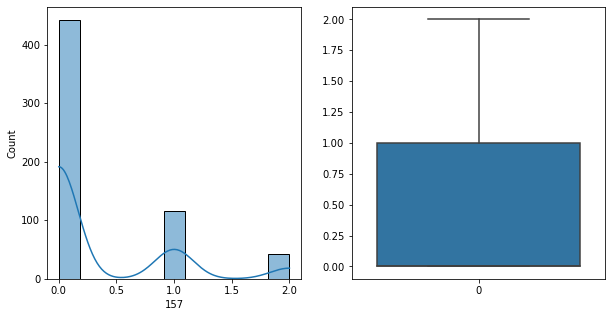

157   Unique :  [2 0 1]
--------------------------------------------------------------------
157   N unique :  3
--------------------------------------------------------------------
157   Value Counts :  0    442
1    116
2     42
Name: 157, dtype: int64
--------------------------------------------------------------------



[ 158 ]
show_df_info :  158


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


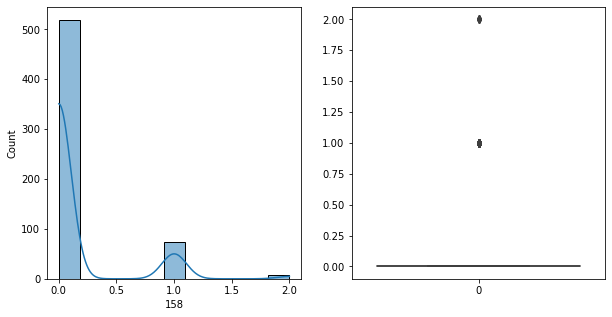

158   Unique :  [0 1 2]
--------------------------------------------------------------------
158   N unique :  3
--------------------------------------------------------------------
158   Value Counts :  0    519
1     74
2      7
Name: 158, dtype: int64
--------------------------------------------------------------------



[ 159 ]
show_df_info :  159


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


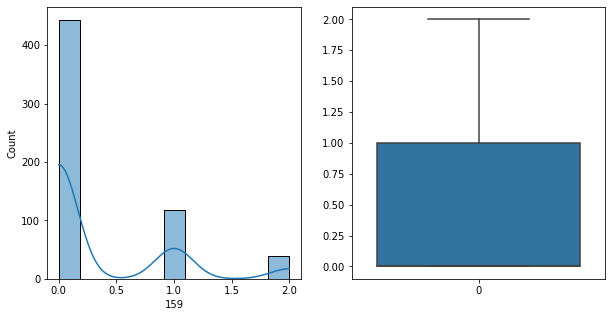

159   Unique :  [2 0 1]
--------------------------------------------------------------------
159   N unique :  3
--------------------------------------------------------------------
159   Value Counts :  0    443
1    118
2     39
Name: 159, dtype: int64
--------------------------------------------------------------------



[ 160 ]
show_df_info :  160


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


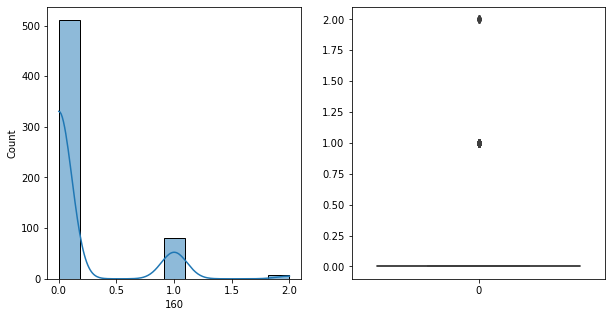

160   Unique :  [0 1 2]
--------------------------------------------------------------------
160   N unique :  3
--------------------------------------------------------------------
160   Value Counts :  0    511
1     81
2      8
Name: 160, dtype: int64
--------------------------------------------------------------------



[ 161 ]
show_df_info :  161


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


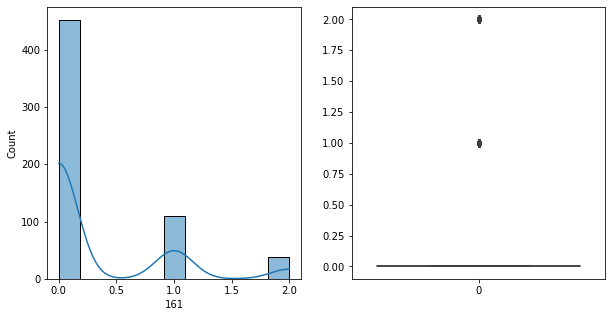

161   Unique :  [0 1 2]
--------------------------------------------------------------------
161   N unique :  3
--------------------------------------------------------------------
161   Value Counts :  0    452
1    110
2     38
Name: 161, dtype: int64
--------------------------------------------------------------------



[ 162 ]
show_df_info :  162


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


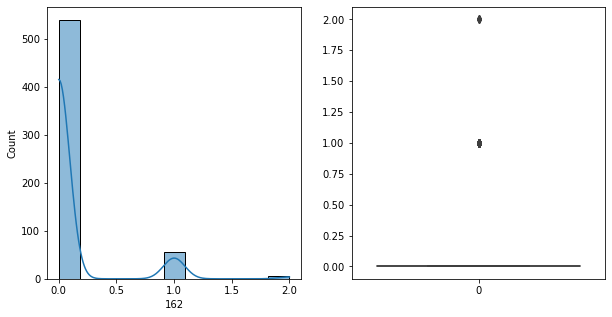

162   Unique :  [0 1 2]
--------------------------------------------------------------------
162   N unique :  3
--------------------------------------------------------------------
162   Value Counts :  0    539
1     56
2      5
Name: 162, dtype: int64
--------------------------------------------------------------------



[ 163 ]
show_df_info :  163


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


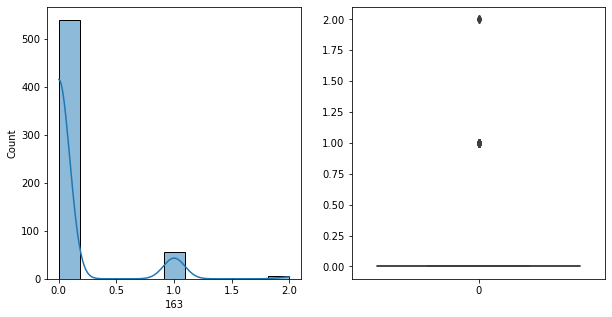

163   Unique :  [0 1 2]
--------------------------------------------------------------------
163   N unique :  3
--------------------------------------------------------------------
163   Value Counts :  0    539
1     56
2      5
Name: 163, dtype: int64
--------------------------------------------------------------------



[ 164 ]
show_df_info :  164


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


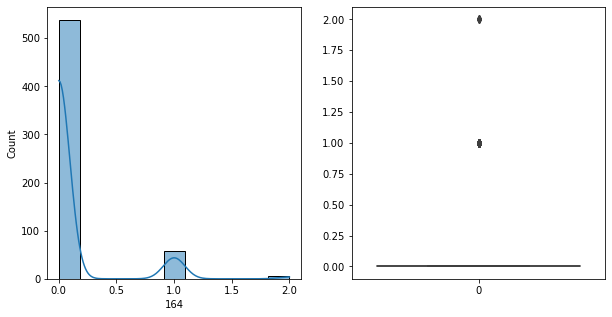

164   Unique :  [0 2 1]
--------------------------------------------------------------------
164   N unique :  3
--------------------------------------------------------------------
164   Value Counts :  0    538
1     57
2      5
Name: 164, dtype: int64
--------------------------------------------------------------------



[ 165 ]
show_df_info :  165


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


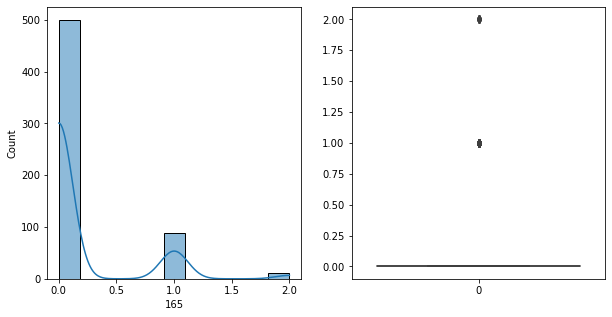

165   Unique :  [1 0 2]
--------------------------------------------------------------------
165   N unique :  3
--------------------------------------------------------------------
165   Value Counts :  0    500
1     89
2     11
Name: 165, dtype: int64
--------------------------------------------------------------------



[ 166 ]
show_df_info :  166


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


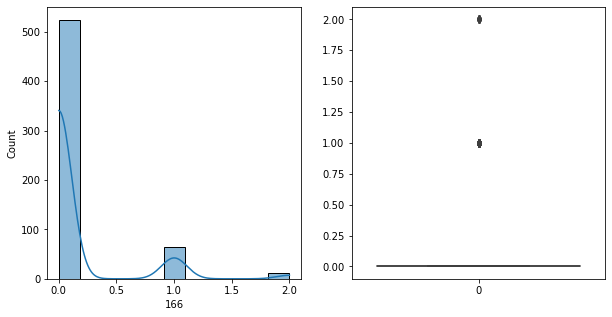

166   Unique :  [0 1 2]
--------------------------------------------------------------------
166   N unique :  3
--------------------------------------------------------------------
166   Value Counts :  0    524
1     65
2     11
Name: 166, dtype: int64
--------------------------------------------------------------------



[ 167 ]
show_df_info :  167


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


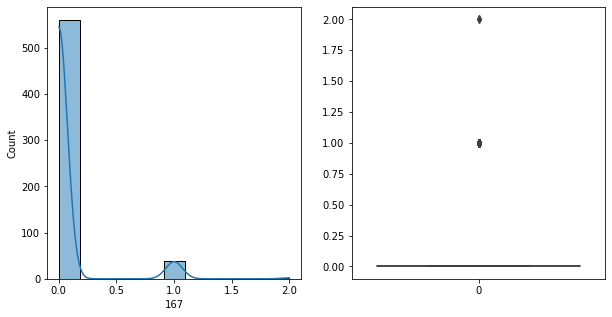

167   Unique :  [0 1 2]
--------------------------------------------------------------------
167   N unique :  3
--------------------------------------------------------------------
167   Value Counts :  0    560
1     38
2      2
Name: 167, dtype: int64
--------------------------------------------------------------------



[ 168 ]
show_df_info :  168


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


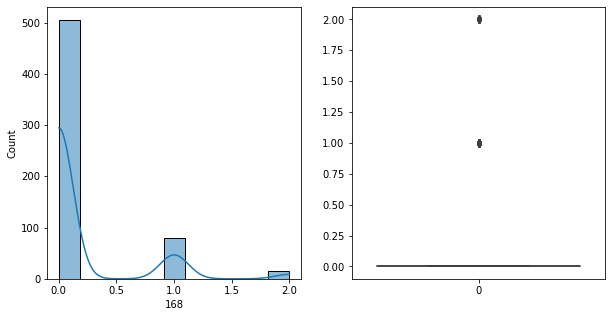

168   Unique :  [0 2 1]
--------------------------------------------------------------------
168   N unique :  3
--------------------------------------------------------------------
168   Value Counts :  0    505
1     80
2     15
Name: 168, dtype: int64
--------------------------------------------------------------------



[ 169 ]
show_df_info :  169


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


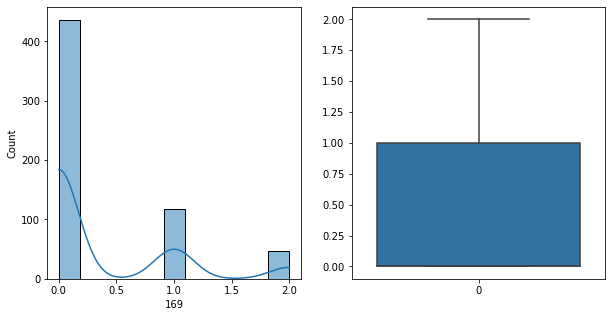

169   Unique :  [1 0 2]
--------------------------------------------------------------------
169   N unique :  3
--------------------------------------------------------------------
169   Value Counts :  0    436
1    118
2     46
Name: 169, dtype: int64
--------------------------------------------------------------------



[ 170 ]
show_df_info :  170


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


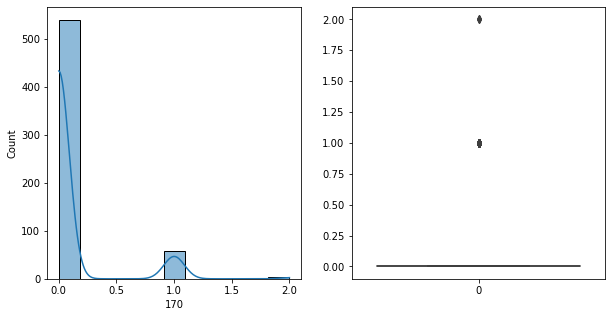

170   Unique :  [0 1 2]
--------------------------------------------------------------------
170   N unique :  3
--------------------------------------------------------------------
170   Value Counts :  0    539
1     58
2      3
Name: 170, dtype: int64
--------------------------------------------------------------------



[ 171 ]
show_df_info :  171


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


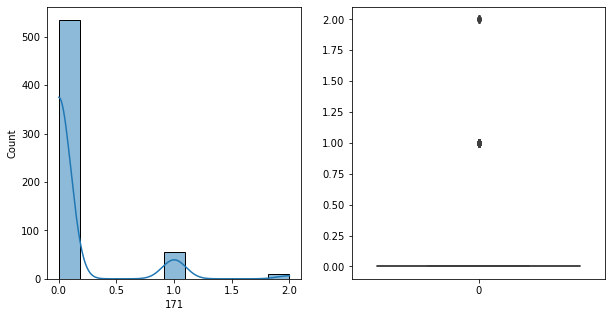

171   Unique :  [0 1 2]
--------------------------------------------------------------------
171   N unique :  3
--------------------------------------------------------------------
171   Value Counts :  0    535
1     56
2      9
Name: 171, dtype: int64
--------------------------------------------------------------------



[ 172 ]
show_df_info :  172


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


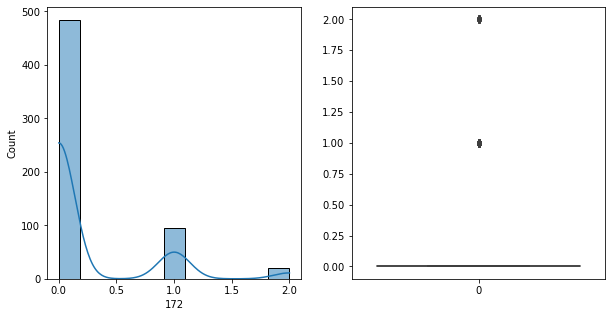

172   Unique :  [1 0 2]
--------------------------------------------------------------------
172   N unique :  3
--------------------------------------------------------------------
172   Value Counts :  0    484
1     95
2     21
Name: 172, dtype: int64
--------------------------------------------------------------------



[ 173 ]
show_df_info :  173


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


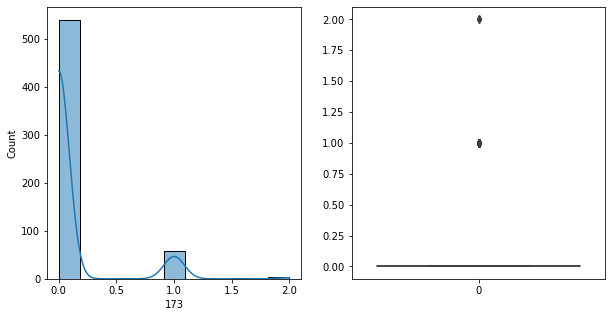

173   Unique :  [0 1 2]
--------------------------------------------------------------------
173   N unique :  3
--------------------------------------------------------------------
173   Value Counts :  0    539
1     58
2      3
Name: 173, dtype: int64
--------------------------------------------------------------------



[ 174 ]
show_df_info :  174


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


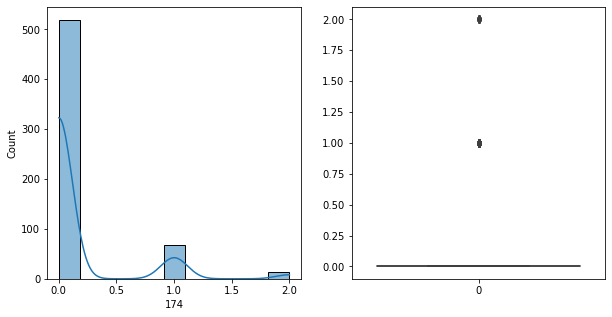

174   Unique :  [0 1 2]
--------------------------------------------------------------------
174   N unique :  3
--------------------------------------------------------------------
174   Value Counts :  0    519
1     68
2     13
Name: 174, dtype: int64
--------------------------------------------------------------------



[ 175 ]
show_df_info :  175


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


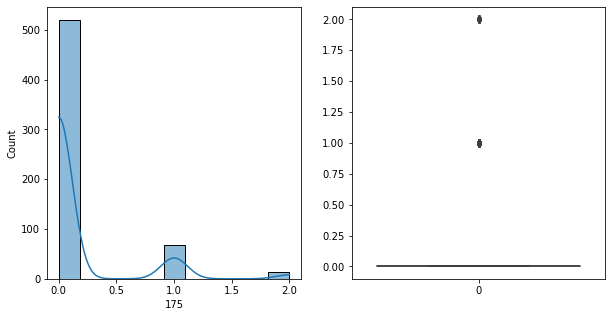

175   Unique :  [0 1 2]
--------------------------------------------------------------------
175   N unique :  3
--------------------------------------------------------------------
175   Value Counts :  0    520
1     67
2     13
Name: 175, dtype: int64
--------------------------------------------------------------------



[ 176 ]
show_df_info :  176


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


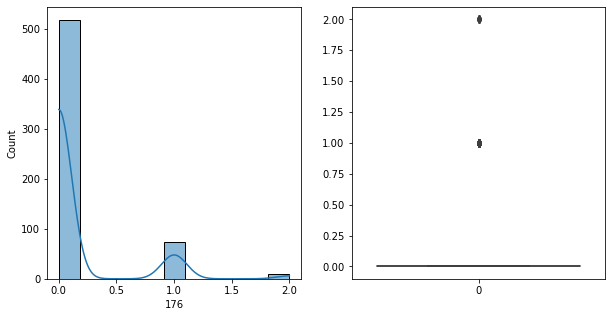

176   Unique :  [0 1 2]
--------------------------------------------------------------------
176   N unique :  3
--------------------------------------------------------------------
176   Value Counts :  0    518
1     73
2      9
Name: 176, dtype: int64
--------------------------------------------------------------------



[ 177 ]
show_df_info :  177


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


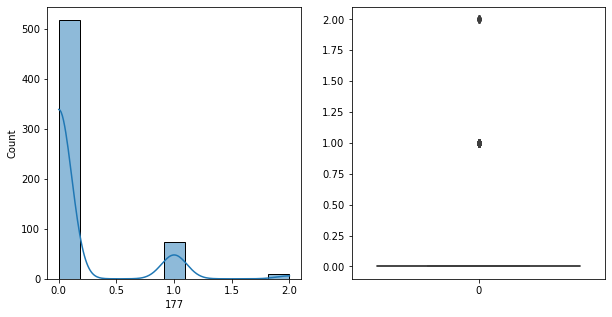

177   Unique :  [0 1 2]
--------------------------------------------------------------------
177   N unique :  3
--------------------------------------------------------------------
177   Value Counts :  0    518
1     73
2      9
Name: 177, dtype: int64
--------------------------------------------------------------------



[ 178 ]
show_df_info :  178


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


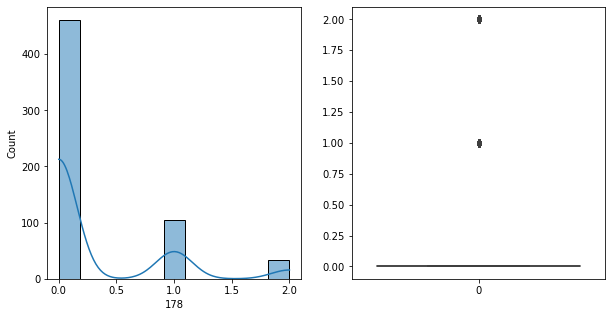

178   Unique :  [0 1 2]
--------------------------------------------------------------------
178   N unique :  3
--------------------------------------------------------------------
178   Value Counts :  0    461
1    105
2     34
Name: 178, dtype: int64
--------------------------------------------------------------------



[ 179 ]
show_df_info :  179


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


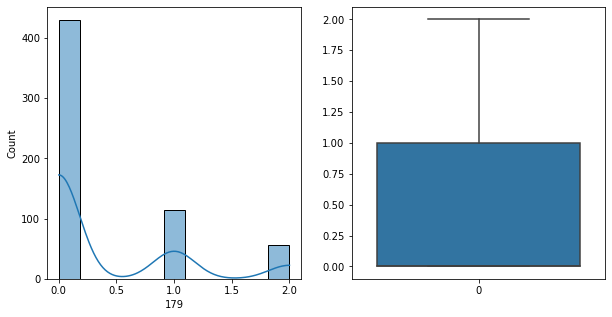

179   Unique :  [1 0 2]
--------------------------------------------------------------------
179   N unique :  3
--------------------------------------------------------------------
179   Value Counts :  0    430
1    114
2     56
Name: 179, dtype: int64
--------------------------------------------------------------------



[ 180 ]
show_df_info :  180


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


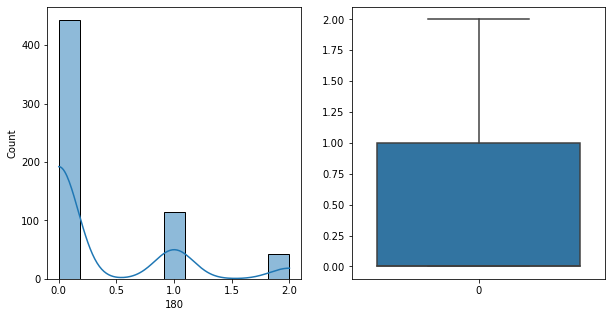

180   Unique :  [1 0 2]
--------------------------------------------------------------------
180   N unique :  3
--------------------------------------------------------------------
180   Value Counts :  0    443
1    115
2     42
Name: 180, dtype: int64
--------------------------------------------------------------------



[ 181 ]
show_df_info :  181


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


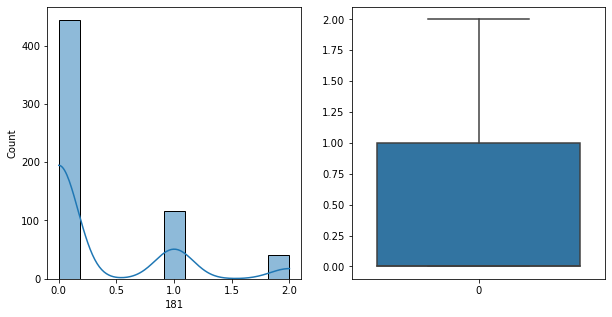

181   Unique :  [0 2 1]
--------------------------------------------------------------------
181   N unique :  3
--------------------------------------------------------------------
181   Value Counts :  0    444
1    116
2     40
Name: 181, dtype: int64
--------------------------------------------------------------------



[ 182 ]
show_df_info :  182


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


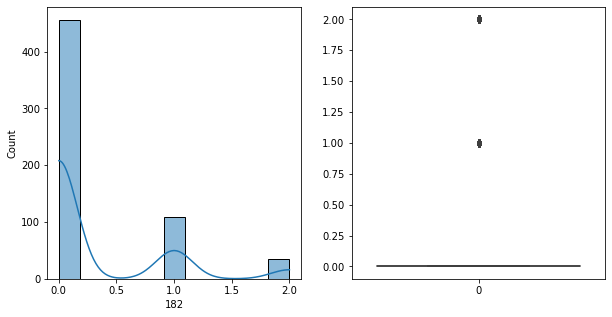

182   Unique :  [0 1 2]
--------------------------------------------------------------------
182   N unique :  3
--------------------------------------------------------------------
182   Value Counts :  0    456
1    109
2     35
Name: 182, dtype: int64
--------------------------------------------------------------------



[ 183 ]
show_df_info :  183


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


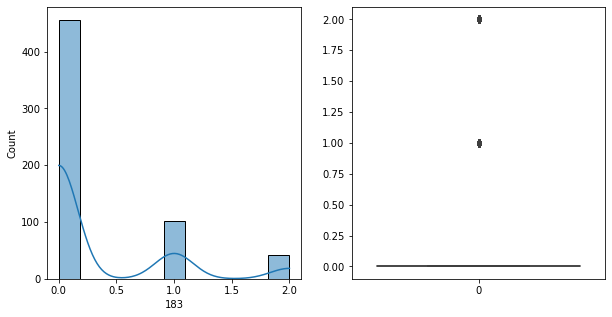

183   Unique :  [1 0 2]
--------------------------------------------------------------------
183   N unique :  3
--------------------------------------------------------------------
183   Value Counts :  0    456
1    102
2     42
Name: 183, dtype: int64
--------------------------------------------------------------------



[ 184 ]
show_df_info :  184


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


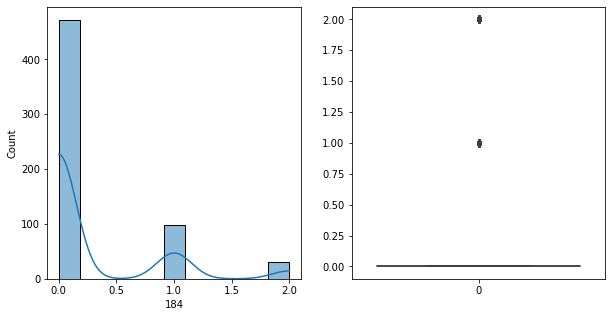

184   Unique :  [1 0 2]
--------------------------------------------------------------------
184   N unique :  3
--------------------------------------------------------------------
184   Value Counts :  0    472
1     98
2     30
Name: 184, dtype: int64
--------------------------------------------------------------------



[ 185 ]
show_df_info :  185


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


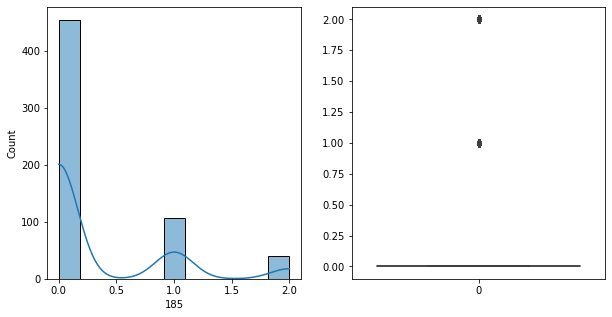

185   Unique :  [1 0 2]
--------------------------------------------------------------------
185   N unique :  3
--------------------------------------------------------------------
185   Value Counts :  0    454
1    106
2     40
Name: 185, dtype: int64
--------------------------------------------------------------------



[ 186 ]
show_df_info :  186


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


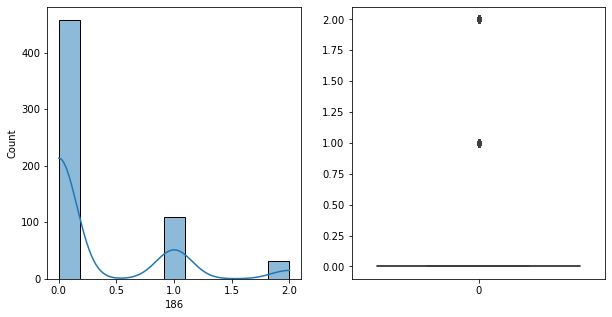

186   Unique :  [0 1 2]
--------------------------------------------------------------------
186   N unique :  3
--------------------------------------------------------------------
186   Value Counts :  0    458
1    110
2     32
Name: 186, dtype: int64
--------------------------------------------------------------------



[ 187 ]
show_df_info :  187


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


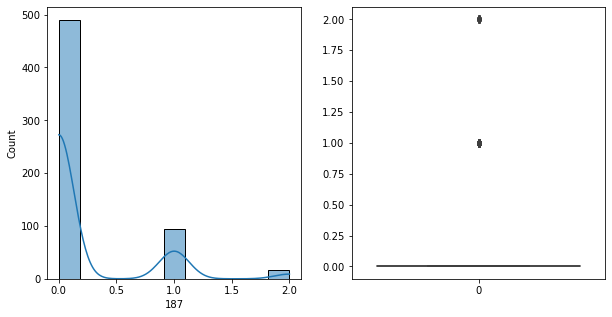

187   Unique :  [0 1 2]
--------------------------------------------------------------------
187   N unique :  3
--------------------------------------------------------------------
187   Value Counts :  0    490
1     94
2     16
Name: 187, dtype: int64
--------------------------------------------------------------------



[ 188 ]
show_df_info :  188


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


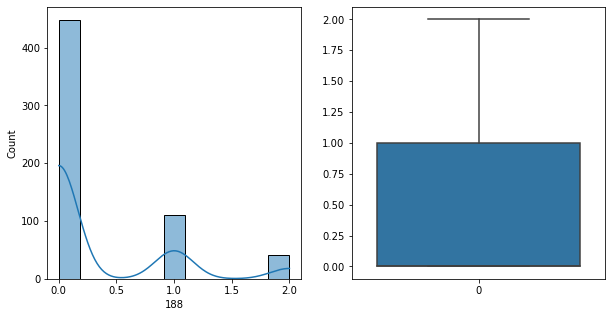

188   Unique :  [1 0 2]
--------------------------------------------------------------------
188   N unique :  3
--------------------------------------------------------------------
188   Value Counts :  0    448
1    111
2     41
Name: 188, dtype: int64
--------------------------------------------------------------------



[ 189 ]
show_df_info :  189


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


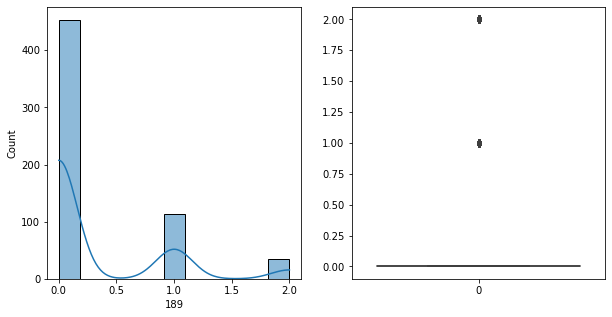

189   Unique :  [0 1 2]
--------------------------------------------------------------------
189   N unique :  3
--------------------------------------------------------------------
189   Value Counts :  0    453
1    113
2     34
Name: 189, dtype: int64
--------------------------------------------------------------------



[ 190 ]
show_df_info :  190


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


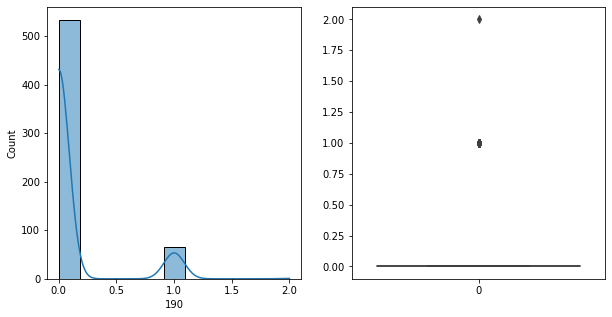

190   Unique :  [1 0 2]
--------------------------------------------------------------------
190   N unique :  3
--------------------------------------------------------------------
190   Value Counts :  0    533
1     66
2      1
Name: 190, dtype: int64
--------------------------------------------------------------------



[ 191 ]
show_df_info :  191


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


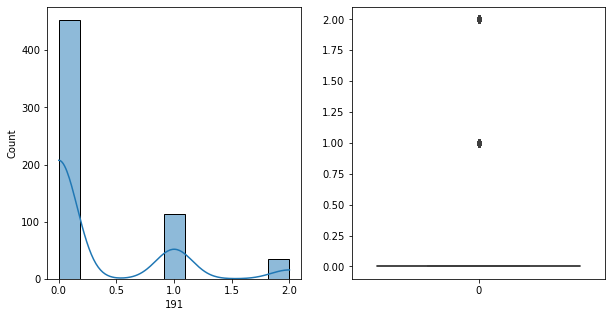

191   Unique :  [0 1 2]
--------------------------------------------------------------------
191   N unique :  3
--------------------------------------------------------------------
191   Value Counts :  0    453
1    113
2     34
Name: 191, dtype: int64
--------------------------------------------------------------------



[ 192 ]
show_df_info :  192


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


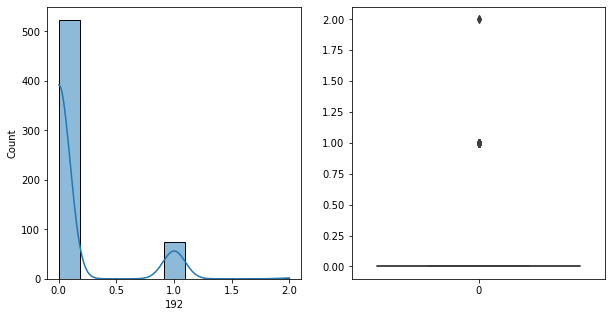

192   Unique :  [1 0 2]
--------------------------------------------------------------------
192   N unique :  3
--------------------------------------------------------------------
192   Value Counts :  0    523
1     75
2      2
Name: 192, dtype: int64
--------------------------------------------------------------------



[ 193 ]
show_df_info :  193


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


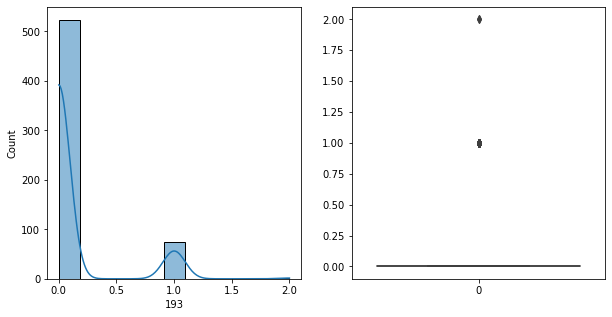

193   Unique :  [1 0 2]
--------------------------------------------------------------------
193   N unique :  3
--------------------------------------------------------------------
193   Value Counts :  0    523
1     75
2      2
Name: 193, dtype: int64
--------------------------------------------------------------------



[ 194 ]
show_df_info :  194


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


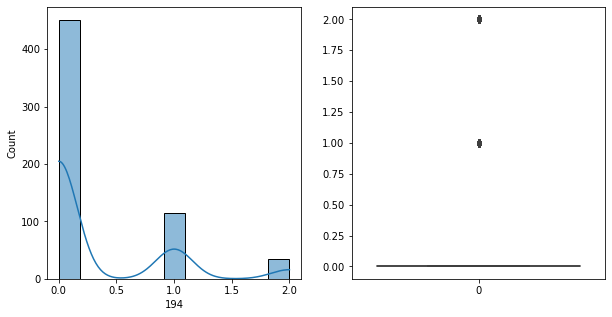

194   Unique :  [0 1 2]
--------------------------------------------------------------------
194   N unique :  3
--------------------------------------------------------------------
194   Value Counts :  0    451
1    114
2     35
Name: 194, dtype: int64
--------------------------------------------------------------------



[ 195 ]
show_df_info :  195


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


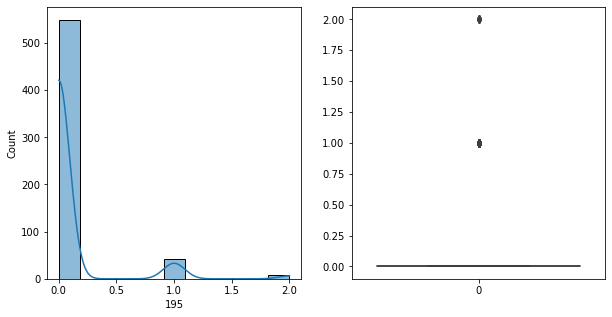

195   Unique :  [0 1 2]
--------------------------------------------------------------------
195   N unique :  3
--------------------------------------------------------------------
195   Value Counts :  0    549
1     43
2      8
Name: 195, dtype: int64
--------------------------------------------------------------------



[ 196 ]
show_df_info :  196


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


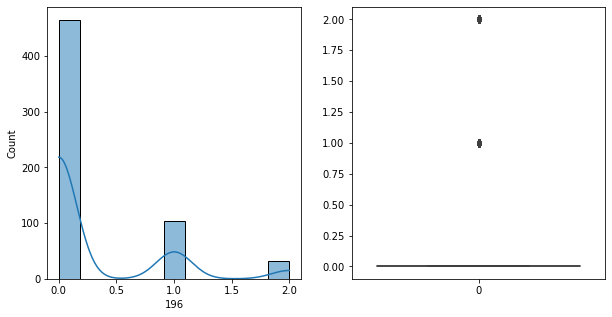

196   Unique :  [0 2 1]
--------------------------------------------------------------------
196   N unique :  3
--------------------------------------------------------------------
196   Value Counts :  0    465
1    103
2     32
Name: 196, dtype: int64
--------------------------------------------------------------------



[ 197 ]
show_df_info :  197


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


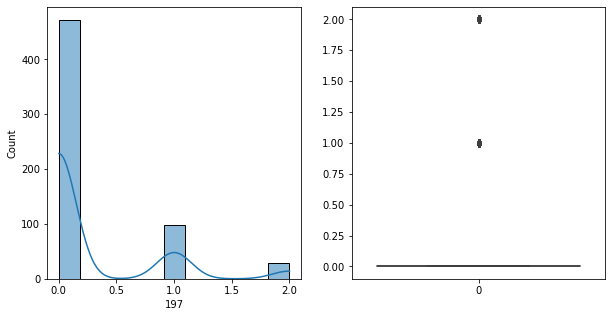

197   Unique :  [2 0 1]
--------------------------------------------------------------------
197   N unique :  3
--------------------------------------------------------------------
197   Value Counts :  0    472
1     99
2     29
Name: 197, dtype: int64
--------------------------------------------------------------------



[ 198 ]
show_df_info :  198


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


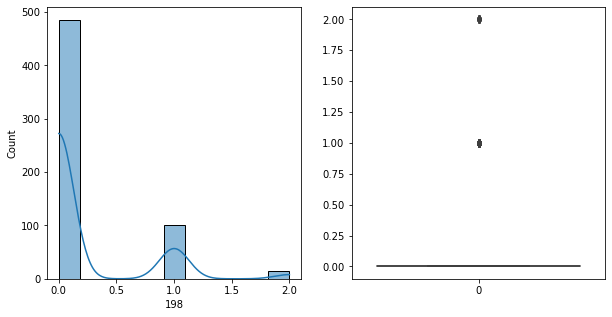

198   Unique :  [0 1 2]
--------------------------------------------------------------------
198   N unique :  3
--------------------------------------------------------------------
198   Value Counts :  0    485
1    101
2     14
Name: 198, dtype: int64
--------------------------------------------------------------------



[ 199 ]
show_df_info :  199


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


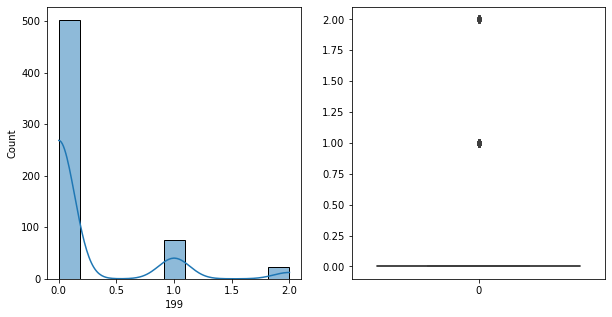

199   Unique :  [2 0 1]
--------------------------------------------------------------------
199   N unique :  3
--------------------------------------------------------------------
199   Value Counts :  0    502
1     75
2     23
Name: 199, dtype: int64
--------------------------------------------------------------------



[ 200 ]
show_df_info :  200


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


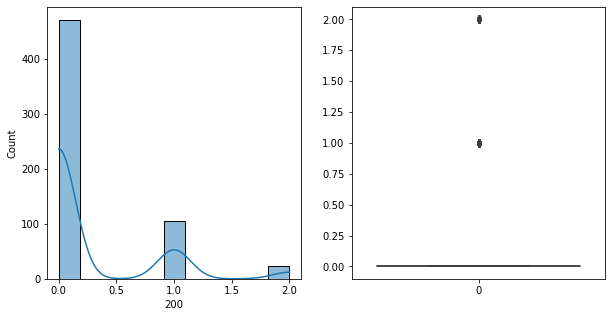

200   Unique :  [1 0 2]
--------------------------------------------------------------------
200   N unique :  3
--------------------------------------------------------------------
200   Value Counts :  0    471
1    105
2     24
Name: 200, dtype: int64
--------------------------------------------------------------------



[ 201 ]
show_df_info :  201


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


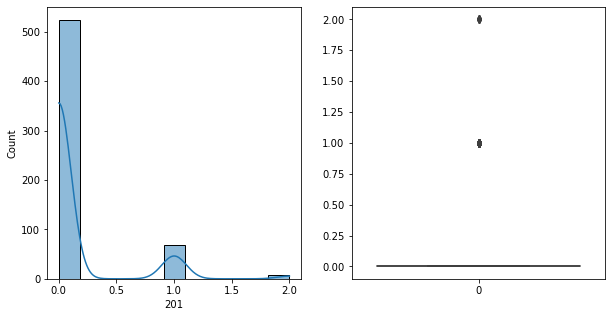

201   Unique :  [0 1 2]
--------------------------------------------------------------------
201   N unique :  3
--------------------------------------------------------------------
201   Value Counts :  0    524
1     68
2      8
Name: 201, dtype: int64
--------------------------------------------------------------------



[ 202 ]
show_df_info :  202


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


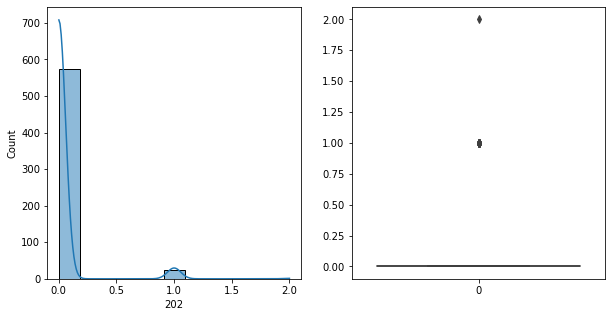

202   Unique :  [0 1 2]
--------------------------------------------------------------------
202   N unique :  3
--------------------------------------------------------------------
202   Value Counts :  0    575
1     24
2      1
Name: 202, dtype: int64
--------------------------------------------------------------------



[ 203 ]
show_df_info :  203


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


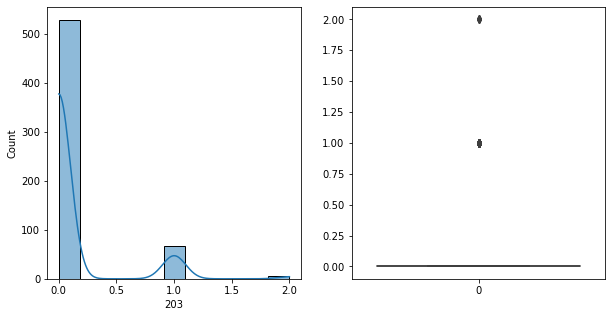

203   Unique :  [0 1 2]
--------------------------------------------------------------------
203   N unique :  3
--------------------------------------------------------------------
203   Value Counts :  0    528
1     66
2      6
Name: 203, dtype: int64
--------------------------------------------------------------------



[ 204 ]
show_df_info :  204


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


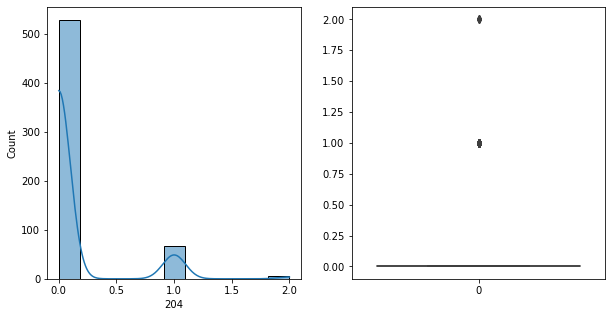

204   Unique :  [0 1 2]
--------------------------------------------------------------------
204   N unique :  3
--------------------------------------------------------------------
204   Value Counts :  0    528
1     67
2      5
Name: 204, dtype: int64
--------------------------------------------------------------------



[ 205 ]
show_df_info :  205


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


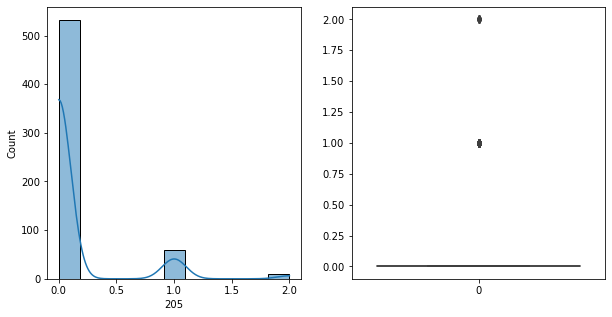

205   Unique :  [1 0 2]
--------------------------------------------------------------------
205   N unique :  3
--------------------------------------------------------------------
205   Value Counts :  0    532
1     59
2      9
Name: 205, dtype: int64
--------------------------------------------------------------------



[ 206 ]
show_df_info :  206


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


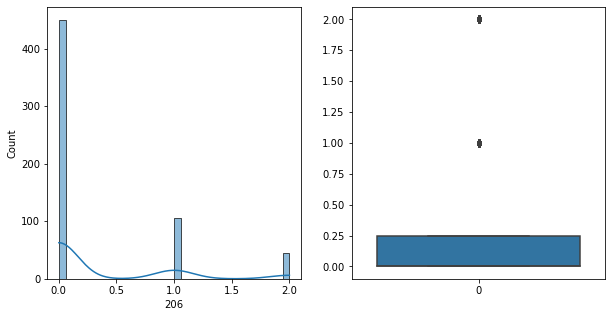

206   Unique :  [0 1 2]
--------------------------------------------------------------------
206   N unique :  3
--------------------------------------------------------------------
206   Value Counts :  0    450
1    106
2     44
Name: 206, dtype: int64
--------------------------------------------------------------------



[ 207 ]
show_df_info :  207


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


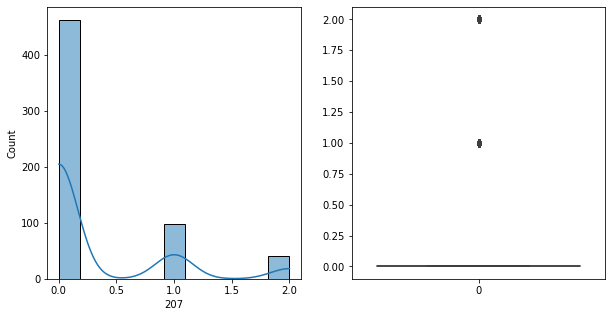

207   Unique :  [1 0 2]
--------------------------------------------------------------------
207   N unique :  3
--------------------------------------------------------------------
207   Value Counts :  0    462
1     97
2     41
Name: 207, dtype: int64
--------------------------------------------------------------------



[ 208 ]
show_df_info :  208


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


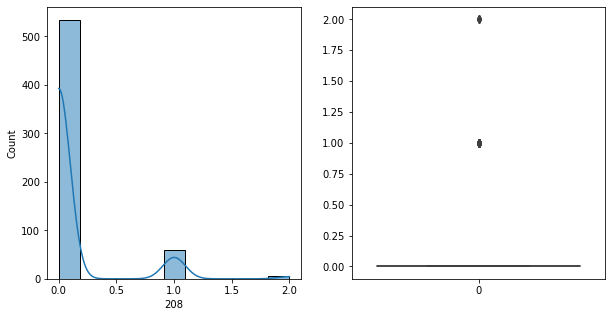

208   Unique :  [0 1 2]
--------------------------------------------------------------------
208   N unique :  3
--------------------------------------------------------------------
208   Value Counts :  0    534
1     60
2      6
Name: 208, dtype: int64
--------------------------------------------------------------------



[ 209 ]
show_df_info :  209


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


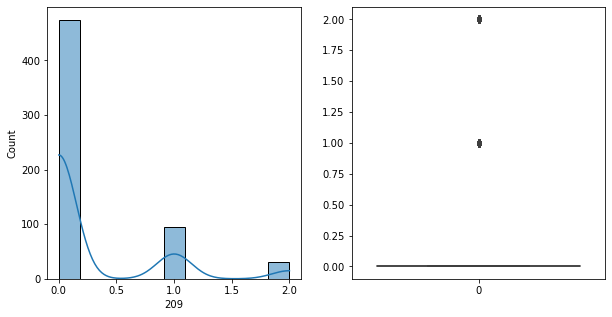

209   Unique :  [1 0 2]
--------------------------------------------------------------------
209   N unique :  3
--------------------------------------------------------------------
209   Value Counts :  0    474
1     95
2     31
Name: 209, dtype: int64
--------------------------------------------------------------------



[ 210 ]
show_df_info :  210


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


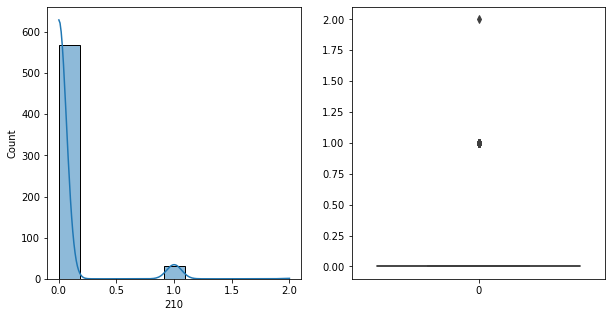

210   Unique :  [0 1 2]
--------------------------------------------------------------------
210   N unique :  3
--------------------------------------------------------------------
210   Value Counts :  0    568
1     31
2      1
Name: 210, dtype: int64
--------------------------------------------------------------------



[ 211 ]
show_df_info :  211


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


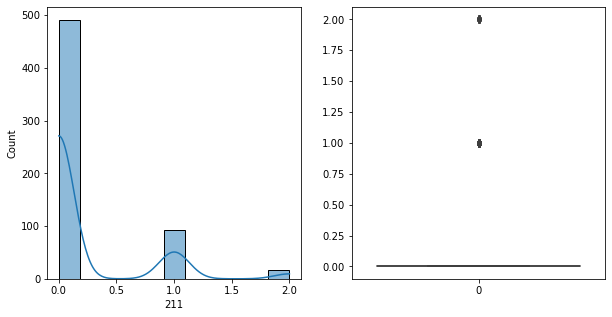

211   Unique :  [1 0 2]
--------------------------------------------------------------------
211   N unique :  3
--------------------------------------------------------------------
211   Value Counts :  0    491
1     92
2     17
Name: 211, dtype: int64
--------------------------------------------------------------------



[ 212 ]
show_df_info :  212


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


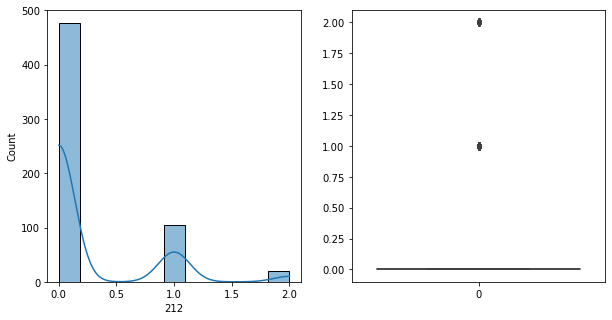

212   Unique :  [1 0 2]
--------------------------------------------------------------------
212   N unique :  3
--------------------------------------------------------------------
212   Value Counts :  0    477
1    104
2     19
Name: 212, dtype: int64
--------------------------------------------------------------------



[ 213 ]
show_df_info :  213


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


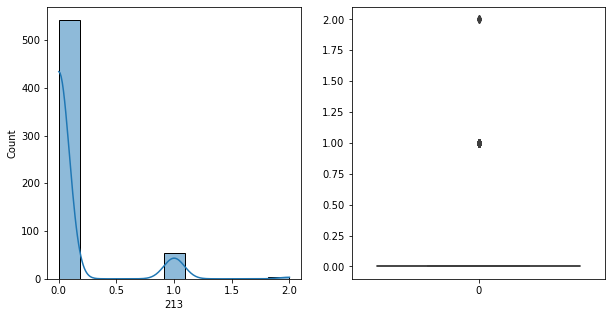

213   Unique :  [1 0 2]
--------------------------------------------------------------------
213   N unique :  3
--------------------------------------------------------------------
213   Value Counts :  0    542
1     54
2      4
Name: 213, dtype: int64
--------------------------------------------------------------------



[ 214 ]
show_df_info :  214


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


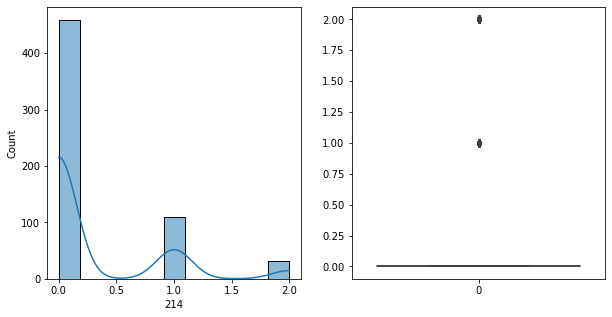

214   Unique :  [1 0 2]
--------------------------------------------------------------------
214   N unique :  3
--------------------------------------------------------------------
214   Value Counts :  0    459
1    110
2     31
Name: 214, dtype: int64
--------------------------------------------------------------------



[ 215 ]
show_df_info :  215


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


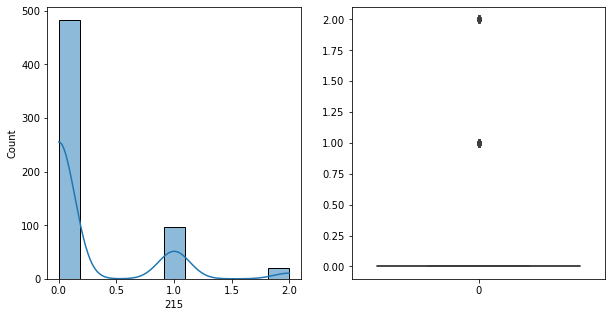

215   Unique :  [1 0 2]
--------------------------------------------------------------------
215   N unique :  3
--------------------------------------------------------------------
215   Value Counts :  0    483
1     97
2     20
Name: 215, dtype: int64
--------------------------------------------------------------------



[ 216 ]
show_df_info :  216


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


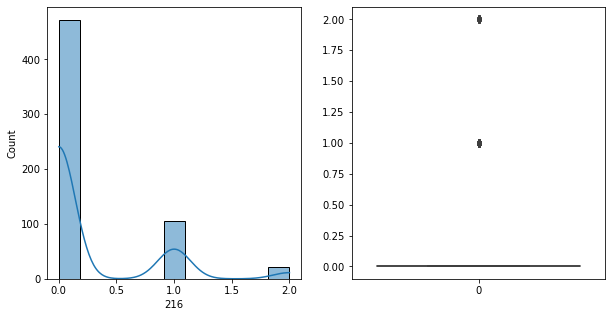

216   Unique :  [1 0 2]
--------------------------------------------------------------------
216   N unique :  3
--------------------------------------------------------------------
216   Value Counts :  0    472
1    106
2     22
Name: 216, dtype: int64
--------------------------------------------------------------------



[ 217 ]
show_df_info :  217


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


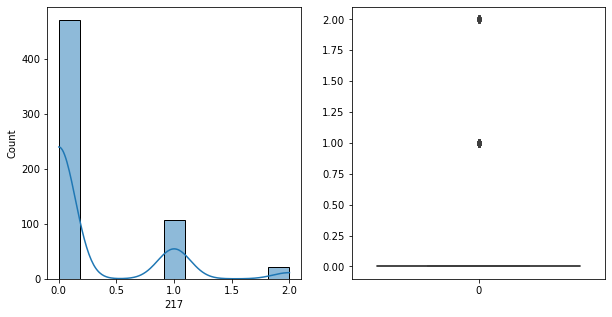

217   Unique :  [1 0 2]
--------------------------------------------------------------------
217   N unique :  3
--------------------------------------------------------------------
217   Value Counts :  0    471
1    107
2     22
Name: 217, dtype: int64
--------------------------------------------------------------------



[ 218 ]
show_df_info :  218


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


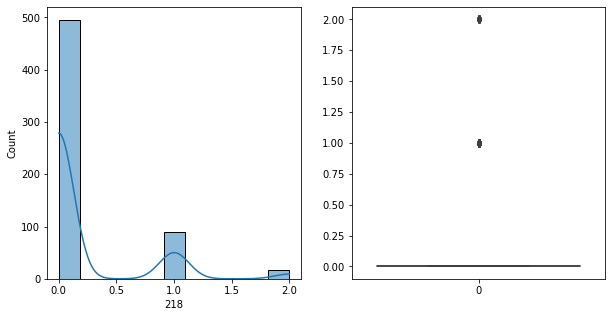

218   Unique :  [0 1 2]
--------------------------------------------------------------------
218   N unique :  3
--------------------------------------------------------------------
218   Value Counts :  0    495
1     89
2     16
Name: 218, dtype: int64
--------------------------------------------------------------------



[ 219 ]
show_df_info :  219


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


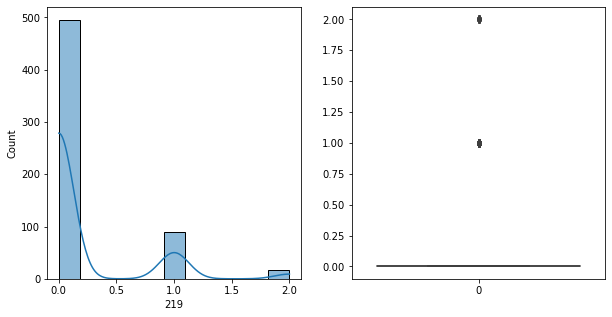

219   Unique :  [0 1 2]
--------------------------------------------------------------------
219   N unique :  3
--------------------------------------------------------------------
219   Value Counts :  0    495
1     89
2     16
Name: 219, dtype: int64
--------------------------------------------------------------------



[ 220 ]
show_df_info :  220


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


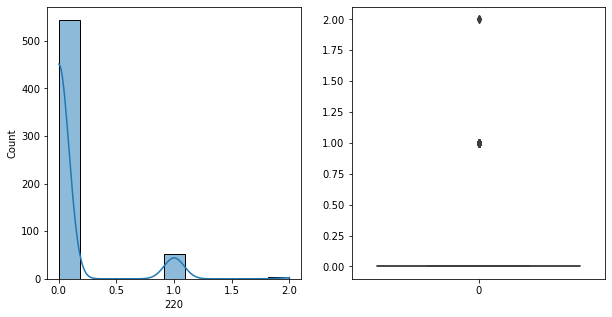

220   Unique :  [0 1 2]
--------------------------------------------------------------------
220   N unique :  3
--------------------------------------------------------------------
220   Value Counts :  0    544
1     53
2      3
Name: 220, dtype: int64
--------------------------------------------------------------------



[ 221 ]
show_df_info :  221


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


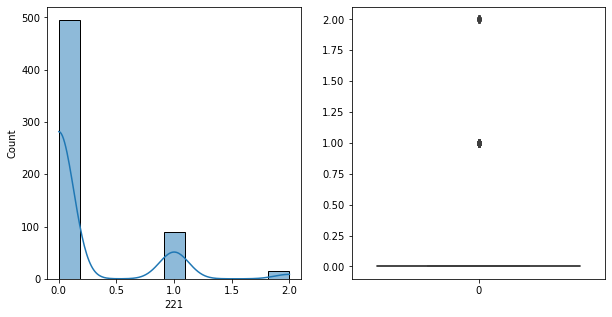

221   Unique :  [0 1 2]
--------------------------------------------------------------------
221   N unique :  3
--------------------------------------------------------------------
221   Value Counts :  0    495
1     90
2     15
Name: 221, dtype: int64
--------------------------------------------------------------------



[ 222 ]
show_df_info :  222


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


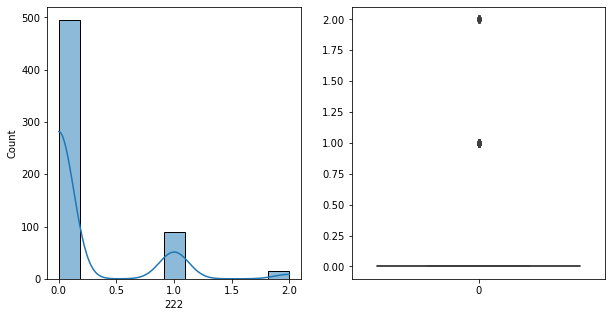

222   Unique :  [0 1 2]
--------------------------------------------------------------------
222   N unique :  3
--------------------------------------------------------------------
222   Value Counts :  0    495
1     90
2     15
Name: 222, dtype: int64
--------------------------------------------------------------------



[ 223 ]
show_df_info :  223


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


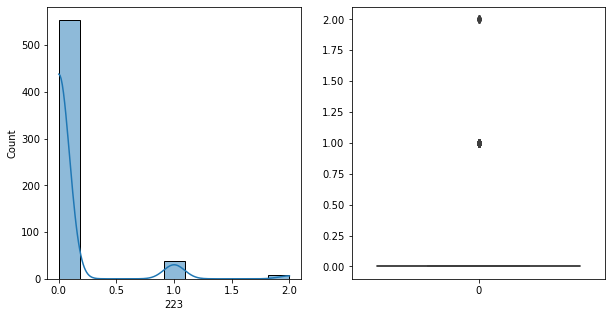

223   Unique :  [0 1 2]
--------------------------------------------------------------------
223   N unique :  3
--------------------------------------------------------------------
223   Value Counts :  0    554
1     38
2      8
Name: 223, dtype: int64
--------------------------------------------------------------------



[ 224 ]
show_df_info :  224


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


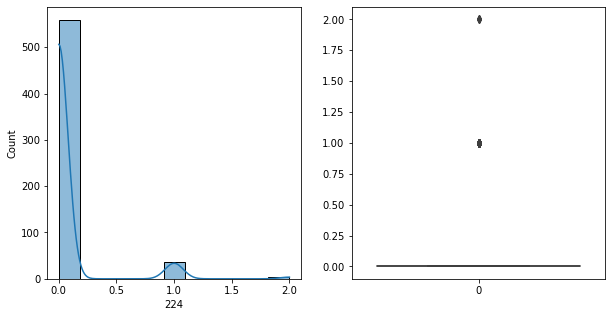

224   Unique :  [0 1 2]
--------------------------------------------------------------------
224   N unique :  3
--------------------------------------------------------------------
224   Value Counts :  0    559
1     37
2      4
Name: 224, dtype: int64
--------------------------------------------------------------------



[ 225 ]
show_df_info :  225


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


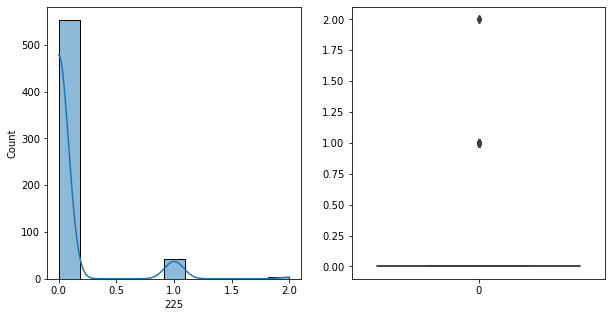

225   Unique :  [0 1 2]
--------------------------------------------------------------------
225   N unique :  3
--------------------------------------------------------------------
225   Value Counts :  0    553
1     43
2      4
Name: 225, dtype: int64
--------------------------------------------------------------------



[ 226 ]
show_df_info :  226


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


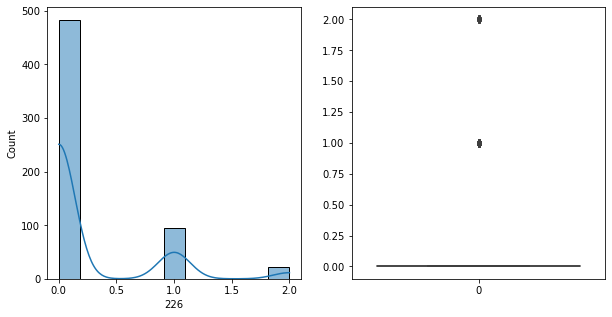

226   Unique :  [1 0 2]
--------------------------------------------------------------------
226   N unique :  3
--------------------------------------------------------------------
226   Value Counts :  0    483
1     95
2     22
Name: 226, dtype: int64
--------------------------------------------------------------------



[ 227 ]
show_df_info :  227


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


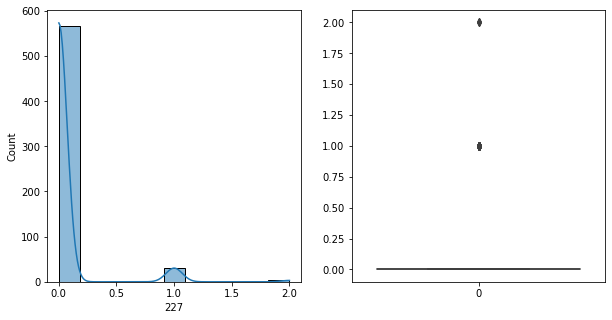

227   Unique :  [0 1 2]
--------------------------------------------------------------------
227   N unique :  3
--------------------------------------------------------------------
227   Value Counts :  0    567
1     30
2      3
Name: 227, dtype: int64
--------------------------------------------------------------------



[ 228 ]
show_df_info :  228


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


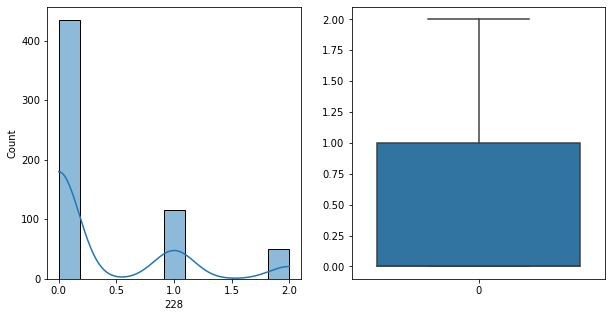

228   Unique :  [1 0 2]
--------------------------------------------------------------------
228   N unique :  3
--------------------------------------------------------------------
228   Value Counts :  0    435
1    115
2     50
Name: 228, dtype: int64
--------------------------------------------------------------------



[ 229 ]
show_df_info :  229


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


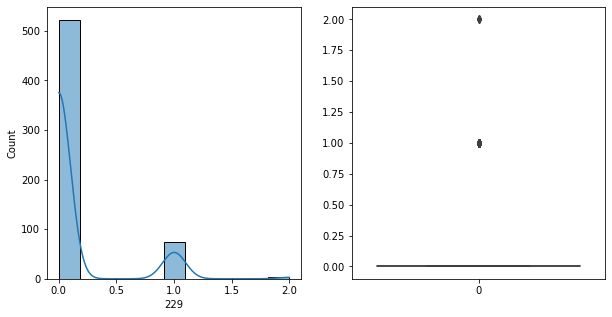

229   Unique :  [0 1 2]
--------------------------------------------------------------------
229   N unique :  3
--------------------------------------------------------------------
229   Value Counts :  0    522
1     74
2      4
Name: 229, dtype: int64
--------------------------------------------------------------------



[ 230 ]
show_df_info :  230


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


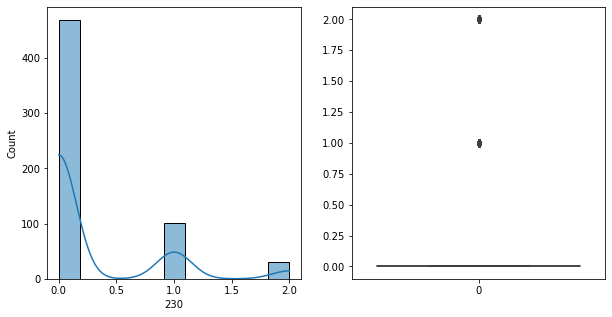

230   Unique :  [1 0 2]
--------------------------------------------------------------------
230   N unique :  3
--------------------------------------------------------------------
230   Value Counts :  0    469
1    101
2     30
Name: 230, dtype: int64
--------------------------------------------------------------------



[ 231 ]
show_df_info :  231


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


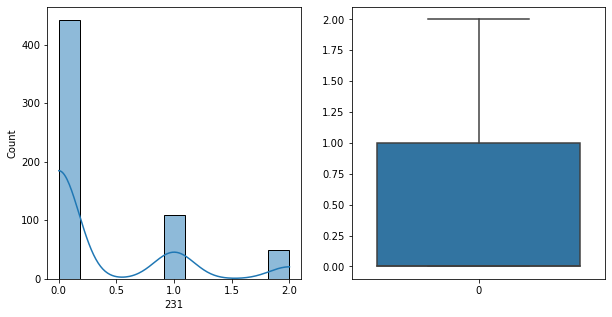

231   Unique :  [1 0 2]
--------------------------------------------------------------------
231   N unique :  3
--------------------------------------------------------------------
231   Value Counts :  0    442
1    109
2     49
Name: 231, dtype: int64
--------------------------------------------------------------------



[ 232 ]
show_df_info :  232


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


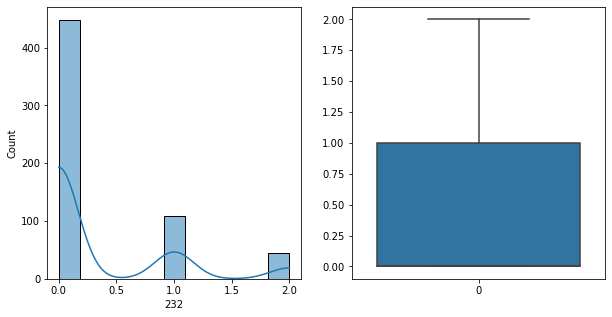

232   Unique :  [1 0 2]
--------------------------------------------------------------------
232   N unique :  3
--------------------------------------------------------------------
232   Value Counts :  0    448
1    108
2     44
Name: 232, dtype: int64
--------------------------------------------------------------------



[ 233 ]
show_df_info :  233


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


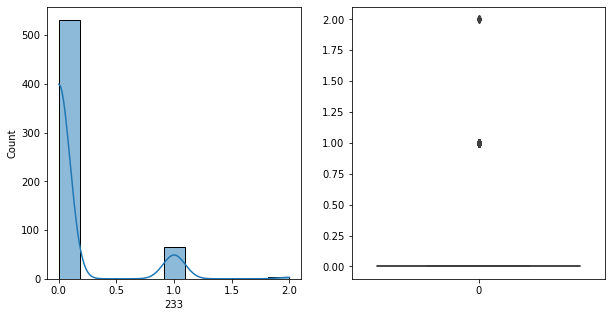

233   Unique :  [1 0 2]
--------------------------------------------------------------------
233   N unique :  3
--------------------------------------------------------------------
233   Value Counts :  0    531
1     65
2      4
Name: 233, dtype: int64
--------------------------------------------------------------------



[ 234 ]
show_df_info :  234


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


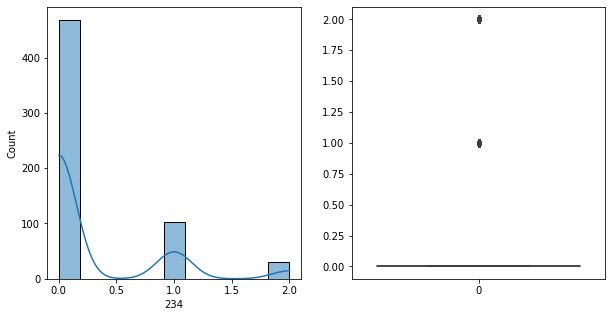

234   Unique :  [1 0 2]
--------------------------------------------------------------------
234   N unique :  3
--------------------------------------------------------------------
234   Value Counts :  0    468
1    102
2     30
Name: 234, dtype: int64
--------------------------------------------------------------------



[ 235 ]
show_df_info :  235


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


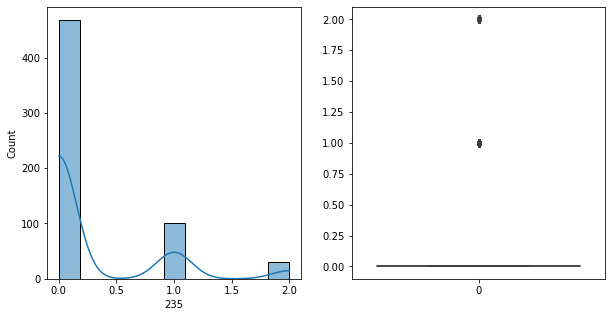

235   Unique :  [1 0 2]
--------------------------------------------------------------------
235   N unique :  3
--------------------------------------------------------------------
235   Value Counts :  0    468
1    101
2     31
Name: 235, dtype: int64
--------------------------------------------------------------------



[ 236 ]
show_df_info :  236


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


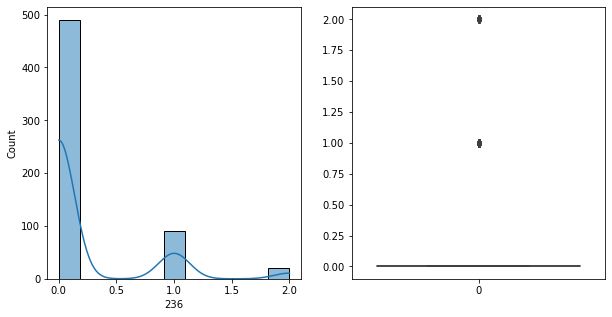

236   Unique :  [1 0 2]
--------------------------------------------------------------------
236   N unique :  3
--------------------------------------------------------------------
236   Value Counts :  0    490
1     90
2     20
Name: 236, dtype: int64
--------------------------------------------------------------------



[ 237 ]
show_df_info :  237


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


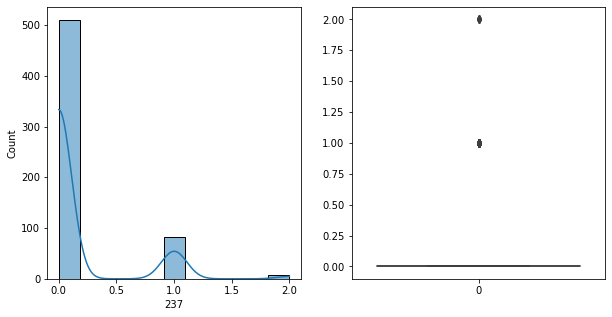

237   Unique :  [0 1 2]
--------------------------------------------------------------------
237   N unique :  3
--------------------------------------------------------------------
237   Value Counts :  0    510
1     83
2      7
Name: 237, dtype: int64
--------------------------------------------------------------------



[ 238 ]
show_df_info :  238


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


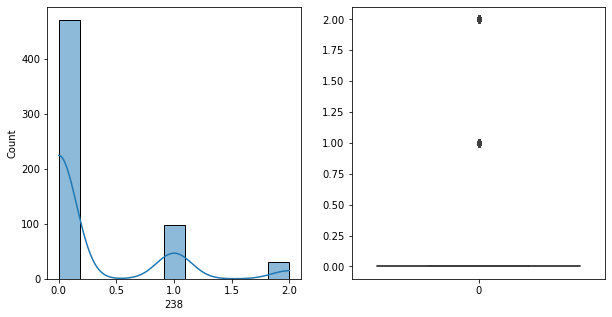

238   Unique :  [1 0 2]
--------------------------------------------------------------------
238   N unique :  3
--------------------------------------------------------------------
238   Value Counts :  0    471
1     98
2     31
Name: 238, dtype: int64
--------------------------------------------------------------------



[ 239 ]
show_df_info :  239


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


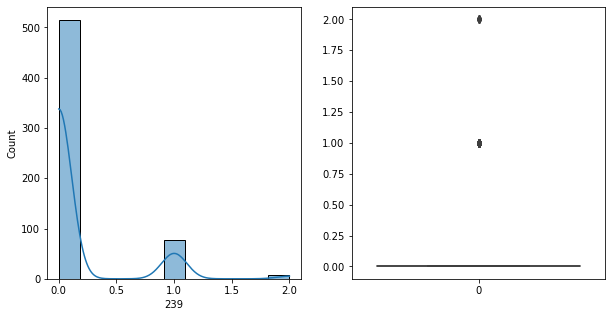

239   Unique :  [0 1 2]
--------------------------------------------------------------------
239   N unique :  3
--------------------------------------------------------------------
239   Value Counts :  0    515
1     77
2      8
Name: 239, dtype: int64
--------------------------------------------------------------------



[ 240 ]
show_df_info :  240


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


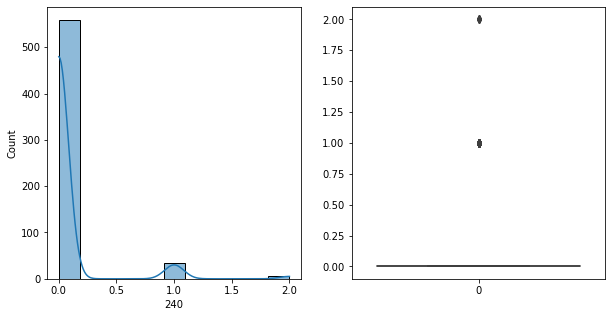

240   Unique :  [0 1 2]
--------------------------------------------------------------------
240   N unique :  3
--------------------------------------------------------------------
240   Value Counts :  0    559
1     35
2      6
Name: 240, dtype: int64
--------------------------------------------------------------------



[ 241 ]
show_df_info :  241


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


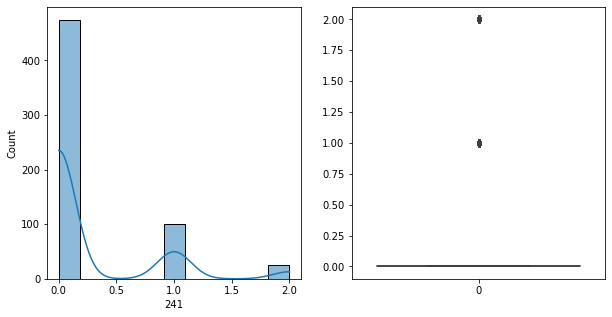

241   Unique :  [0 1 2]
--------------------------------------------------------------------
241   N unique :  3
--------------------------------------------------------------------
241   Value Counts :  0    474
1    100
2     26
Name: 241, dtype: int64
--------------------------------------------------------------------



[ 242 ]
show_df_info :  242


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


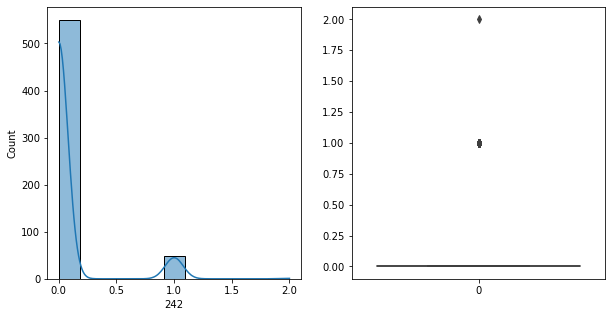

242   Unique :  [0 1 2]
--------------------------------------------------------------------
242   N unique :  3
--------------------------------------------------------------------
242   Value Counts :  0    550
1     49
2      1
Name: 242, dtype: int64
--------------------------------------------------------------------



[ 243 ]
show_df_info :  243


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


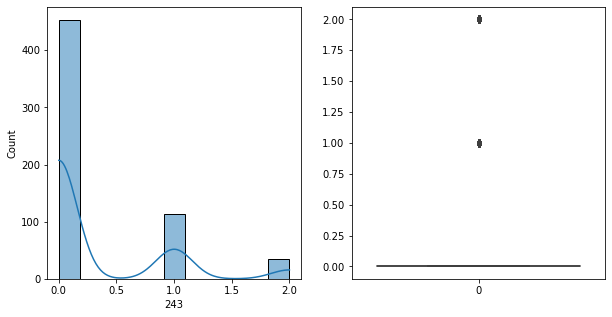

243   Unique :  [1 0 2]
--------------------------------------------------------------------
243   N unique :  3
--------------------------------------------------------------------
243   Value Counts :  0    453
1    113
2     34
Name: 243, dtype: int64
--------------------------------------------------------------------



[ 244 ]
show_df_info :  244


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


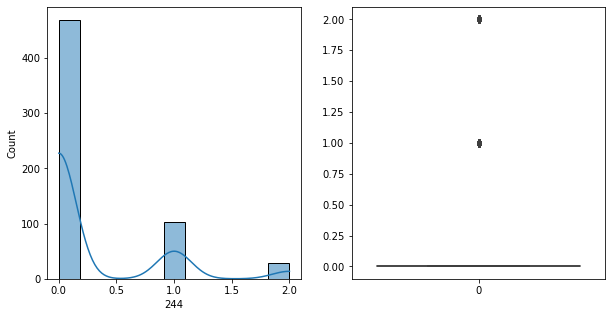

244   Unique :  [0 1 2]
--------------------------------------------------------------------
244   N unique :  3
--------------------------------------------------------------------
244   Value Counts :  0    469
1    103
2     28
Name: 244, dtype: int64
--------------------------------------------------------------------



[ 245 ]
show_df_info :  245


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


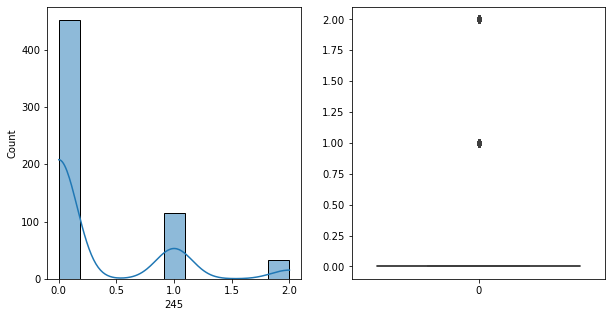

245   Unique :  [1 0 2]
--------------------------------------------------------------------
245   N unique :  3
--------------------------------------------------------------------
245   Value Counts :  0    452
1    115
2     33
Name: 245, dtype: int64
--------------------------------------------------------------------



[ 246 ]
show_df_info :  246


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


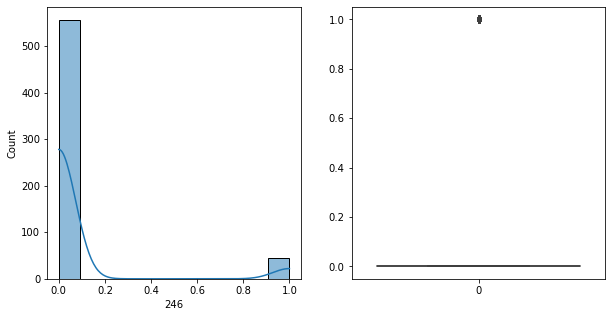

246   Unique :  [0 1]
--------------------------------------------------------------------
246   N unique :  2
--------------------------------------------------------------------
246   Value Counts :  0    556
1     44
Name: 246, dtype: int64
--------------------------------------------------------------------



[ 247 ]
show_df_info :  247


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


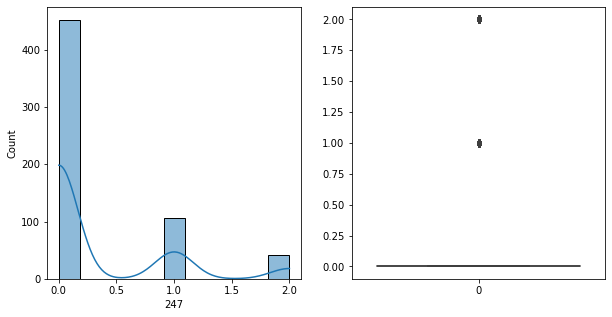

247   Unique :  [1 0 2]
--------------------------------------------------------------------
247   N unique :  3
--------------------------------------------------------------------
247   Value Counts :  0    452
1    107
2     41
Name: 247, dtype: int64
--------------------------------------------------------------------



[ 248 ]
show_df_info :  248


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


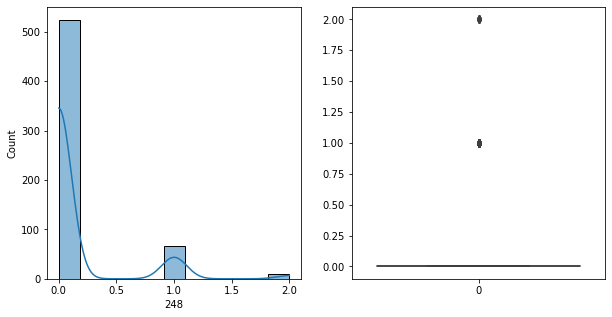

248   Unique :  [0 2 1]
--------------------------------------------------------------------
248   N unique :  3
--------------------------------------------------------------------
248   Value Counts :  0    524
1     66
2     10
Name: 248, dtype: int64
--------------------------------------------------------------------



[ 249 ]
show_df_info :  249


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


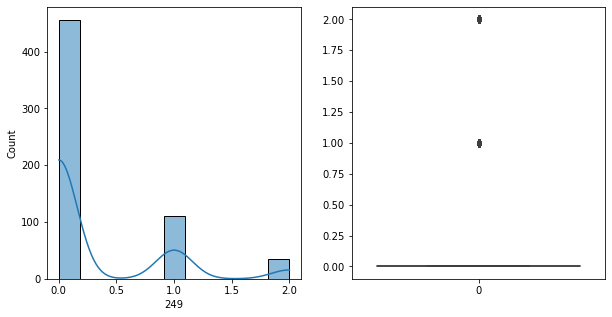

249   Unique :  [1 0 2]
--------------------------------------------------------------------
249   N unique :  3
--------------------------------------------------------------------
249   Value Counts :  0    456
1    110
2     34
Name: 249, dtype: int64
--------------------------------------------------------------------



[ 250 ]
show_df_info :  250


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


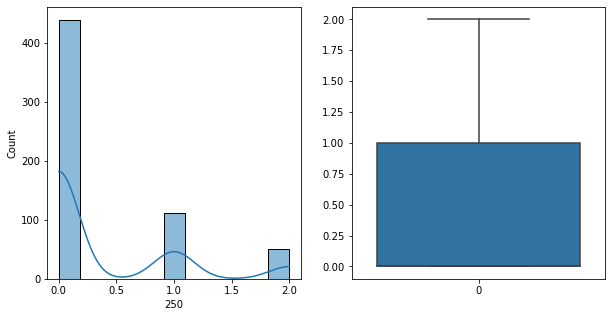

250   Unique :  [1 0 2]
--------------------------------------------------------------------
250   N unique :  3
--------------------------------------------------------------------
250   Value Counts :  0    439
1    111
2     50
Name: 250, dtype: int64
--------------------------------------------------------------------



[ 251 ]
show_df_info :  251


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


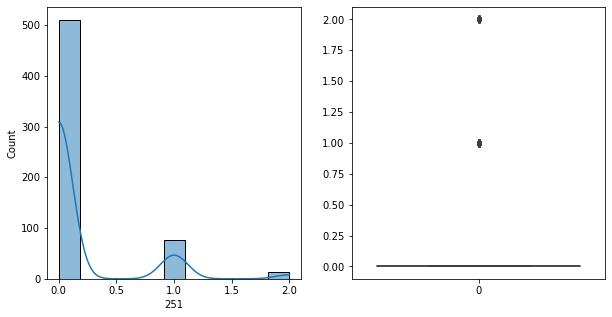

251   Unique :  [1 0 2]
--------------------------------------------------------------------
251   N unique :  3
--------------------------------------------------------------------
251   Value Counts :  0    510
1     77
2     13
Name: 251, dtype: int64
--------------------------------------------------------------------



[ 252 ]
show_df_info :  252


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


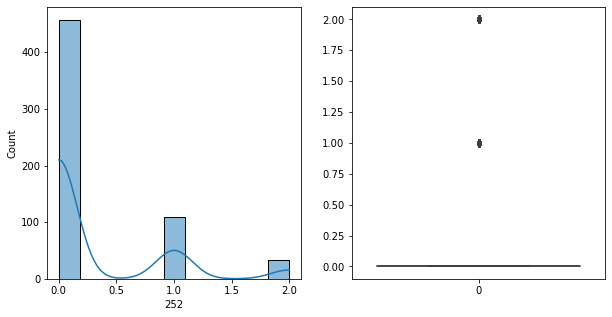

252   Unique :  [1 0 2]
--------------------------------------------------------------------
252   N unique :  3
--------------------------------------------------------------------
252   Value Counts :  0    457
1    109
2     34
Name: 252, dtype: int64
--------------------------------------------------------------------



[ 253 ]
show_df_info :  253


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


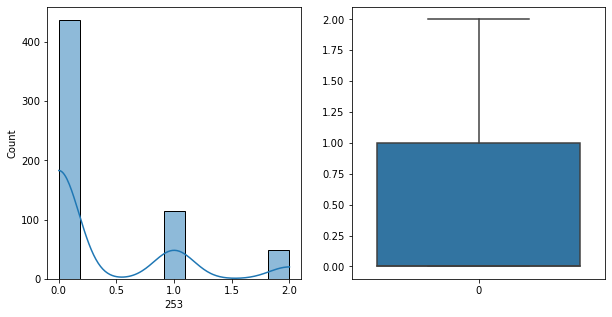

253   Unique :  [1 0 2]
--------------------------------------------------------------------
253   N unique :  3
--------------------------------------------------------------------
253   Value Counts :  0    437
1    115
2     48
Name: 253, dtype: int64
--------------------------------------------------------------------



[ 254 ]
show_df_info :  254


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


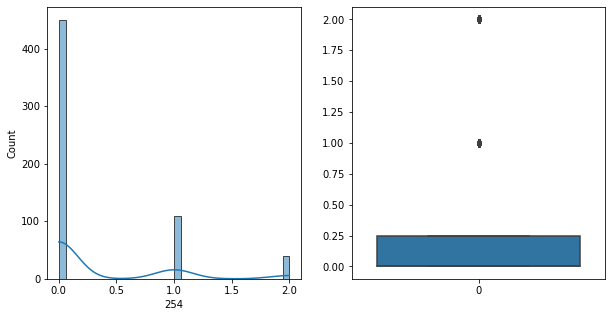

254   Unique :  [1 0 2]
--------------------------------------------------------------------
254   N unique :  3
--------------------------------------------------------------------
254   Value Counts :  0    450
1    110
2     40
Name: 254, dtype: int64
--------------------------------------------------------------------



[ 255 ]
show_df_info :  255


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


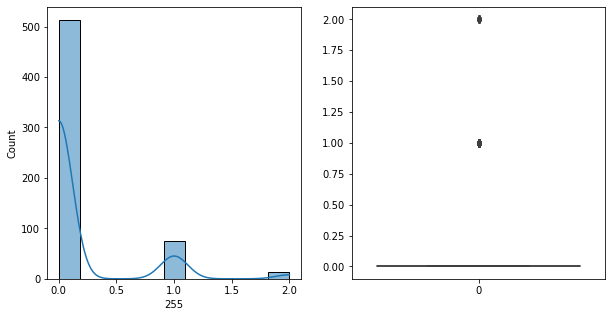

255   Unique :  [1 0 2]
--------------------------------------------------------------------
255   N unique :  3
--------------------------------------------------------------------
255   Value Counts :  0    513
1     74
2     13
Name: 255, dtype: int64
--------------------------------------------------------------------



[ 256 ]
show_df_info :  256


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


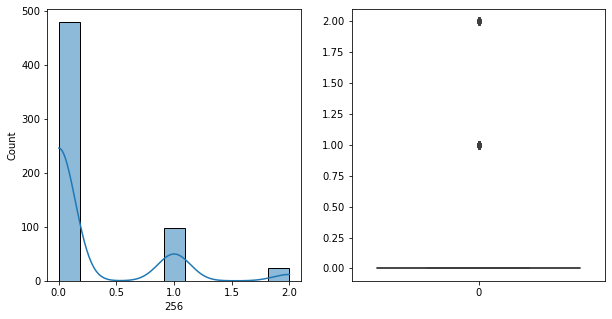

256   Unique :  [1 0 2]
--------------------------------------------------------------------
256   N unique :  3
--------------------------------------------------------------------
256   Value Counts :  0    480
1     97
2     23
Name: 256, dtype: int64
--------------------------------------------------------------------



[ 257 ]
show_df_info :  257


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


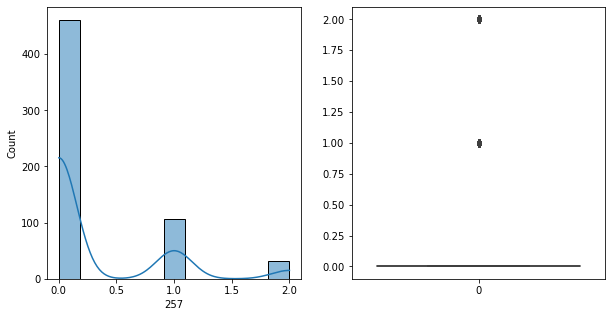

257   Unique :  [1 0 2]
--------------------------------------------------------------------
257   N unique :  3
--------------------------------------------------------------------
257   Value Counts :  0    461
1    107
2     32
Name: 257, dtype: int64
--------------------------------------------------------------------



[ 258 ]
show_df_info :  258


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


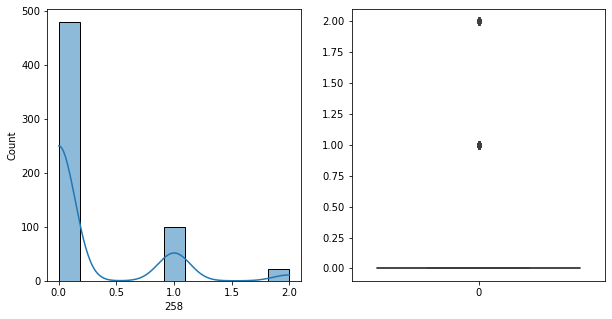

258   Unique :  [1 0 2]
--------------------------------------------------------------------
258   N unique :  3
--------------------------------------------------------------------
258   Value Counts :  0    480
1     99
2     21
Name: 258, dtype: int64
--------------------------------------------------------------------



[ 259 ]
show_df_info :  259


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


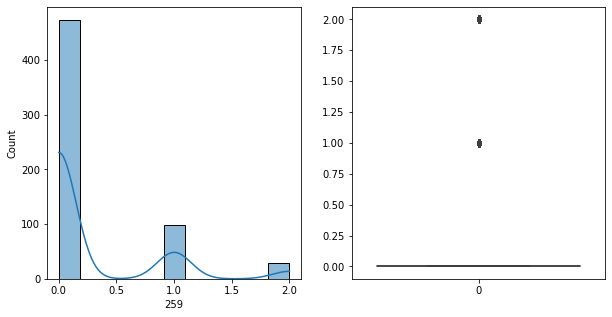

259   Unique :  [0 1 2]
--------------------------------------------------------------------
259   N unique :  3
--------------------------------------------------------------------
259   Value Counts :  0    473
1     99
2     28
Name: 259, dtype: int64
--------------------------------------------------------------------



[ 260 ]
show_df_info :  260


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


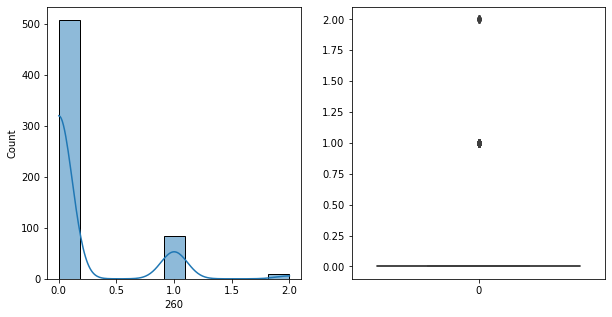

260   Unique :  [0 1 2]
--------------------------------------------------------------------
260   N unique :  3
--------------------------------------------------------------------
260   Value Counts :  0    507
1     84
2      9
Name: 260, dtype: int64
--------------------------------------------------------------------



[ 261 ]
show_df_info :  261


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


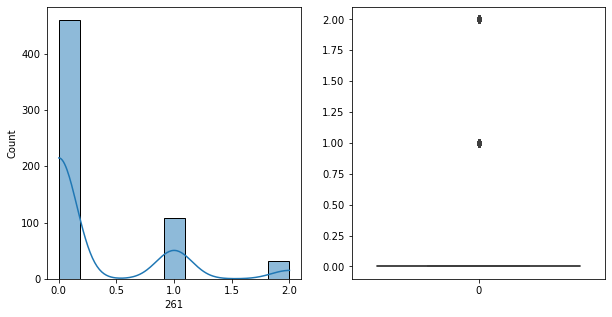

261   Unique :  [1 0 2]
--------------------------------------------------------------------
261   N unique :  3
--------------------------------------------------------------------
261   Value Counts :  0    460
1    108
2     32
Name: 261, dtype: int64
--------------------------------------------------------------------



[ 262 ]
show_df_info :  262


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


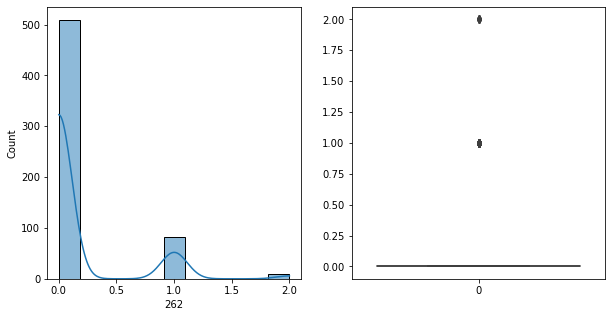

262   Unique :  [0 1 2]
--------------------------------------------------------------------
262   N unique :  3
--------------------------------------------------------------------
262   Value Counts :  0    509
1     82
2      9
Name: 262, dtype: int64
--------------------------------------------------------------------



[ 263 ]
show_df_info :  263


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


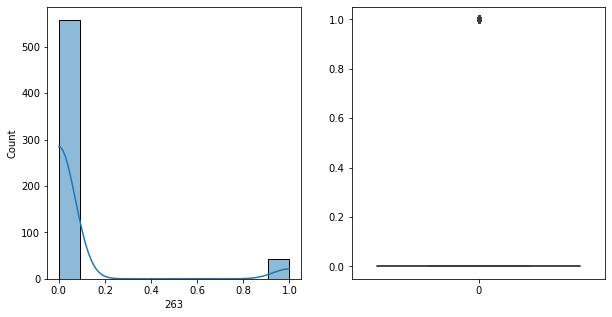

263   Unique :  [0 1]
--------------------------------------------------------------------
263   N unique :  2
--------------------------------------------------------------------
263   Value Counts :  0    558
1     42
Name: 263, dtype: int64
--------------------------------------------------------------------



[ 264 ]
show_df_info :  264


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


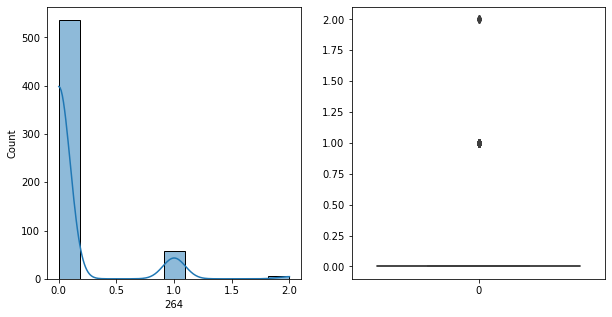

264   Unique :  [0 1 2]
--------------------------------------------------------------------
264   N unique :  3
--------------------------------------------------------------------
264   Value Counts :  0    536
1     58
2      6
Name: 264, dtype: int64
--------------------------------------------------------------------



[ 265 ]
show_df_info :  265


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


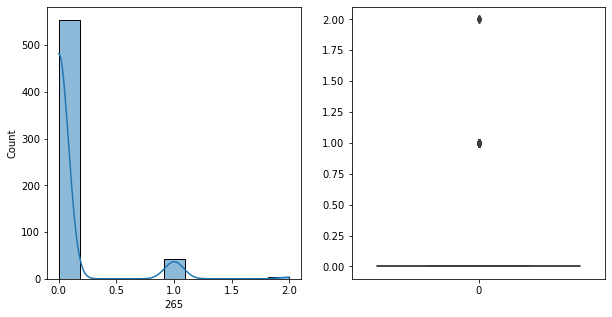

265   Unique :  [0 1 2]
--------------------------------------------------------------------
265   N unique :  3
--------------------------------------------------------------------
265   Value Counts :  0    554
1     42
2      4
Name: 265, dtype: int64
--------------------------------------------------------------------



[ 266 ]
show_df_info :  266


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


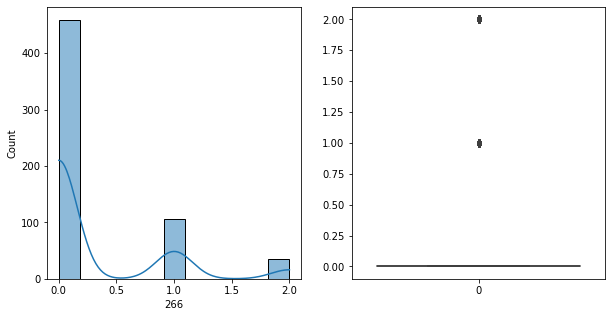

266   Unique :  [1 0 2]
--------------------------------------------------------------------
266   N unique :  3
--------------------------------------------------------------------
266   Value Counts :  0    459
1    106
2     35
Name: 266, dtype: int64
--------------------------------------------------------------------



[ 267 ]
show_df_info :  267


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


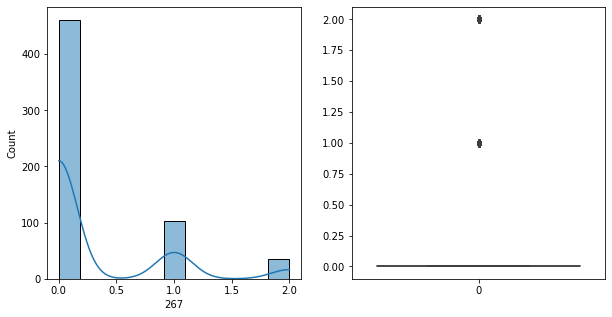

267   Unique :  [2 0 1]
--------------------------------------------------------------------
267   N unique :  3
--------------------------------------------------------------------
267   Value Counts :  0    461
1    103
2     36
Name: 267, dtype: int64
--------------------------------------------------------------------



[ 268 ]
show_df_info :  268


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


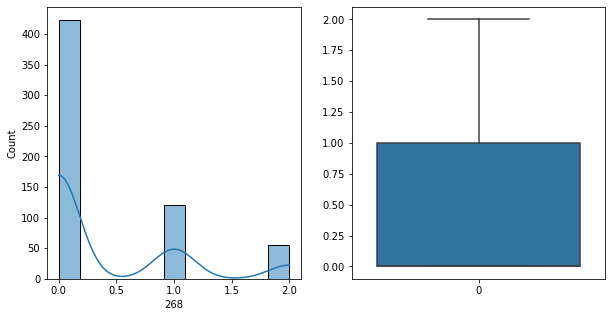

268   Unique :  [0 1 2]
--------------------------------------------------------------------
268   N unique :  3
--------------------------------------------------------------------
268   Value Counts :  0    423
1    121
2     56
Name: 268, dtype: int64
--------------------------------------------------------------------



[ 269 ]
show_df_info :  269


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


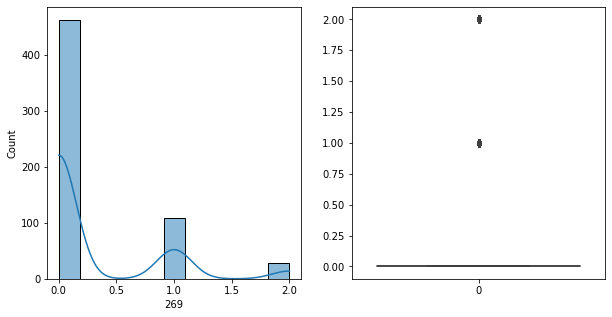

269   Unique :  [1 0 2]
--------------------------------------------------------------------
269   N unique :  3
--------------------------------------------------------------------
269   Value Counts :  0    462
1    109
2     29
Name: 269, dtype: int64
--------------------------------------------------------------------



[ 270 ]
show_df_info :  270


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


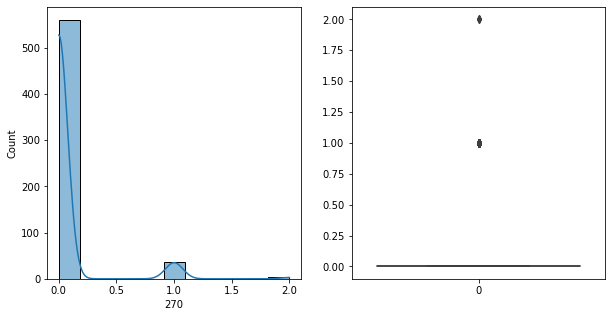

270   Unique :  [0 1 2]
--------------------------------------------------------------------
270   N unique :  3
--------------------------------------------------------------------
270   Value Counts :  0    560
1     37
2      3
Name: 270, dtype: int64
--------------------------------------------------------------------



[ 271 ]
show_df_info :  271


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


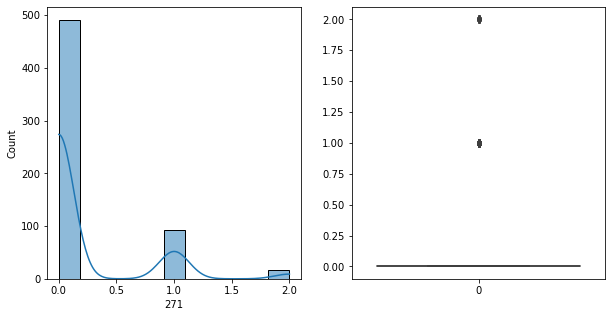

271   Unique :  [1 0 2]
--------------------------------------------------------------------
271   N unique :  3
--------------------------------------------------------------------
271   Value Counts :  0    491
1     93
2     16
Name: 271, dtype: int64
--------------------------------------------------------------------



[ 272 ]
show_df_info :  272


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


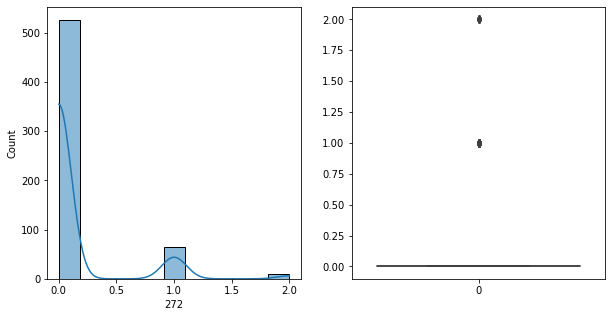

272   Unique :  [0 1 2]
--------------------------------------------------------------------
272   N unique :  3
--------------------------------------------------------------------
272   Value Counts :  0    526
1     65
2      9
Name: 272, dtype: int64
--------------------------------------------------------------------



[ 273 ]
show_df_info :  273


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


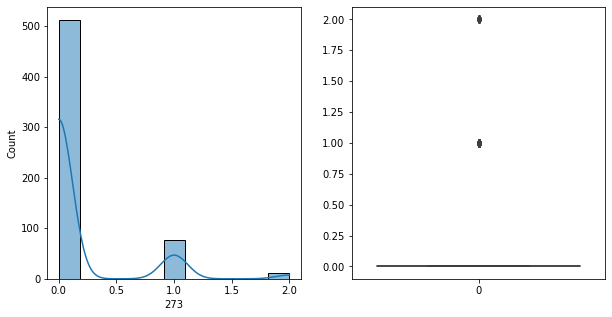

273   Unique :  [1 0 2]
--------------------------------------------------------------------
273   N unique :  3
--------------------------------------------------------------------
273   Value Counts :  0    512
1     76
2     12
Name: 273, dtype: int64
--------------------------------------------------------------------



[ 274 ]
show_df_info :  274


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


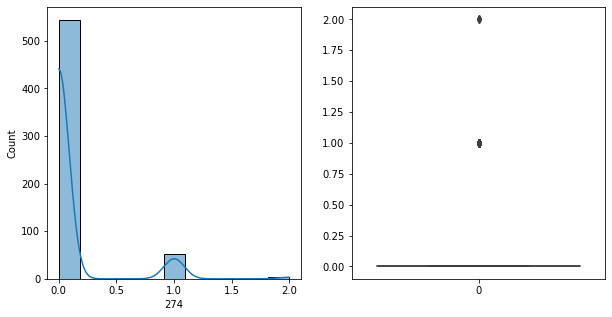

274   Unique :  [0 1 2]
--------------------------------------------------------------------
274   N unique :  3
--------------------------------------------------------------------
274   Value Counts :  0    544
1     52
2      4
Name: 274, dtype: int64
--------------------------------------------------------------------



[ 275 ]
show_df_info :  275


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


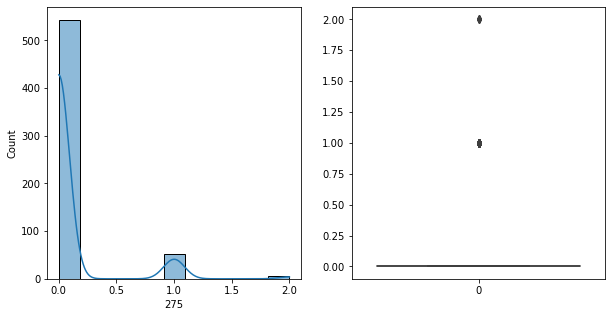

275   Unique :  [0 1 2]
--------------------------------------------------------------------
275   N unique :  3
--------------------------------------------------------------------
275   Value Counts :  0    543
1     52
2      5
Name: 275, dtype: int64
--------------------------------------------------------------------



[ 276 ]
show_df_info :  276


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


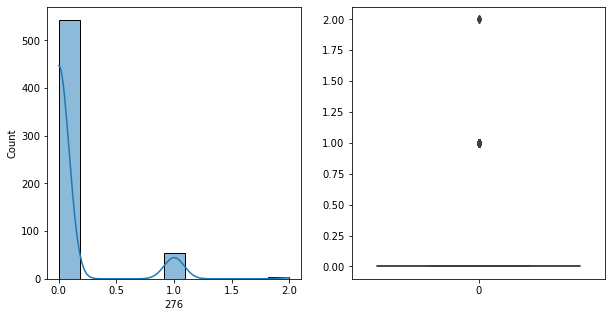

276   Unique :  [0 1 2]
--------------------------------------------------------------------
276   N unique :  3
--------------------------------------------------------------------
276   Value Counts :  0    543
1     54
2      3
Name: 276, dtype: int64
--------------------------------------------------------------------



[ 277 ]
show_df_info :  277


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


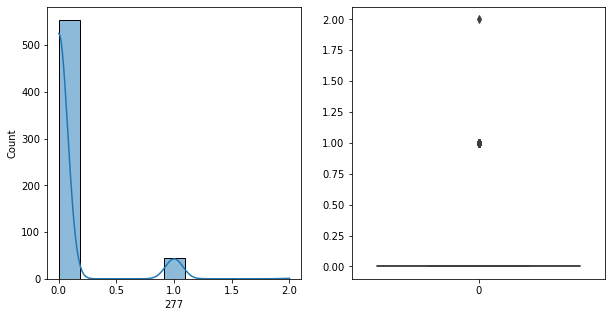

277   Unique :  [0 1 2]
--------------------------------------------------------------------
277   N unique :  3
--------------------------------------------------------------------
277   Value Counts :  0    554
1     45
2      1
Name: 277, dtype: int64
--------------------------------------------------------------------



[ 278 ]
show_df_info :  278


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


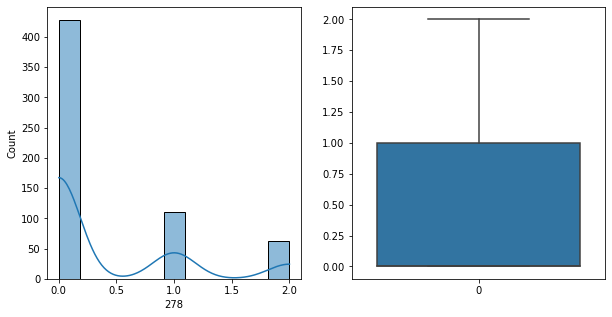

278   Unique :  [1 0 2]
--------------------------------------------------------------------
278   N unique :  3
--------------------------------------------------------------------
278   Value Counts :  0    428
1    110
2     62
Name: 278, dtype: int64
--------------------------------------------------------------------



[ 279 ]
show_df_info :  279


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


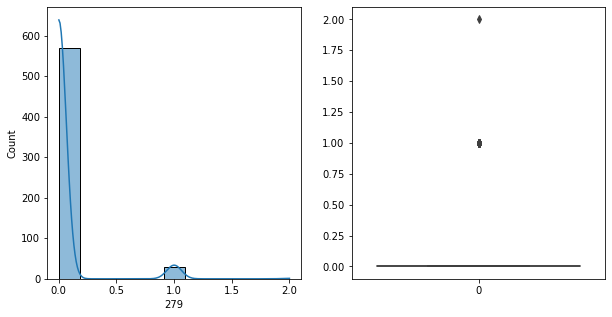

279   Unique :  [0 1 2]
--------------------------------------------------------------------
279   N unique :  3
--------------------------------------------------------------------
279   Value Counts :  0    569
1     30
2      1
Name: 279, dtype: int64
--------------------------------------------------------------------



[ 280 ]
show_df_info :  280


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


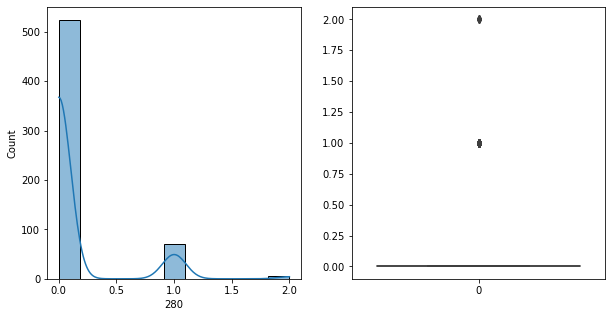

280   Unique :  [0 1 2]
--------------------------------------------------------------------
280   N unique :  3
--------------------------------------------------------------------
280   Value Counts :  0    524
1     70
2      6
Name: 280, dtype: int64
--------------------------------------------------------------------



[ 281 ]
show_df_info :  281


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


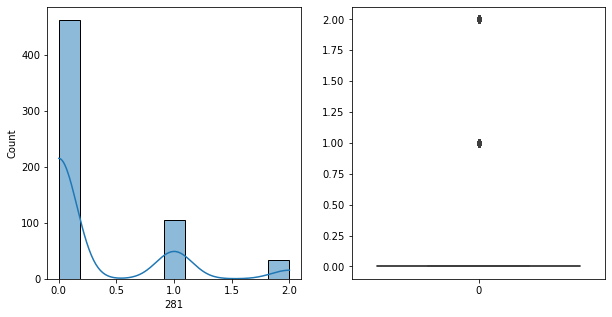

281   Unique :  [0 2 1]
--------------------------------------------------------------------
281   N unique :  3
--------------------------------------------------------------------
281   Value Counts :  0    462
1    105
2     33
Name: 281, dtype: int64
--------------------------------------------------------------------



[ 282 ]
show_df_info :  282


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


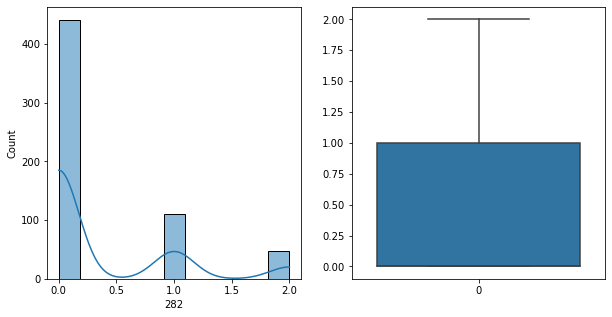

282   Unique :  [0 2 1]
--------------------------------------------------------------------
282   N unique :  3
--------------------------------------------------------------------
282   Value Counts :  0    441
1    111
2     48
Name: 282, dtype: int64
--------------------------------------------------------------------



[ 283 ]
show_df_info :  283


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


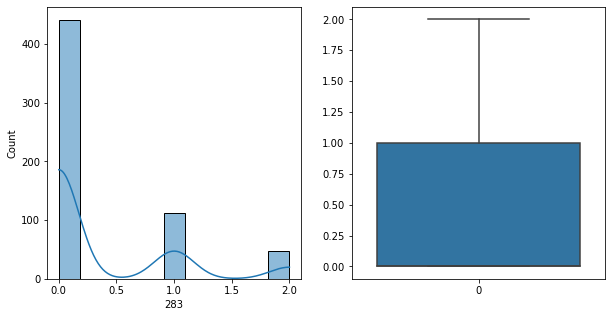

283   Unique :  [0 2 1]
--------------------------------------------------------------------
283   N unique :  3
--------------------------------------------------------------------
283   Value Counts :  0    441
1    112
2     47
Name: 283, dtype: int64
--------------------------------------------------------------------



[ 284 ]
show_df_info :  284


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


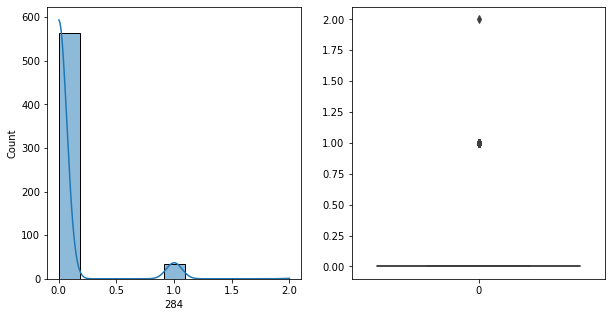

284   Unique :  [0 1 2]
--------------------------------------------------------------------
284   N unique :  3
--------------------------------------------------------------------
284   Value Counts :  0    564
1     35
2      1
Name: 284, dtype: int64
--------------------------------------------------------------------



[ 285 ]
show_df_info :  285


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


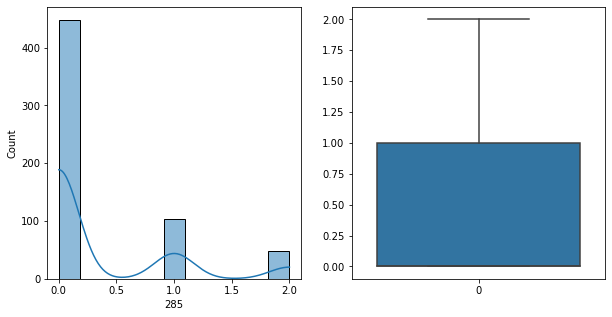

285   Unique :  [0 1 2]
--------------------------------------------------------------------
285   N unique :  3
--------------------------------------------------------------------
285   Value Counts :  0    448
1    104
2     48
Name: 285, dtype: int64
--------------------------------------------------------------------



[ 286 ]
show_df_info :  286


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


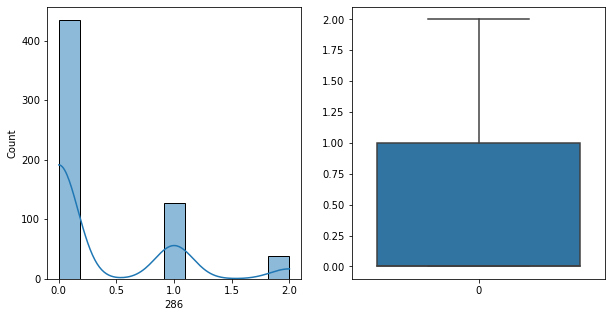

286   Unique :  [2 0 1]
--------------------------------------------------------------------
286   N unique :  3
--------------------------------------------------------------------
286   Value Counts :  0    435
1    127
2     38
Name: 286, dtype: int64
--------------------------------------------------------------------



[ 287 ]
show_df_info :  287


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


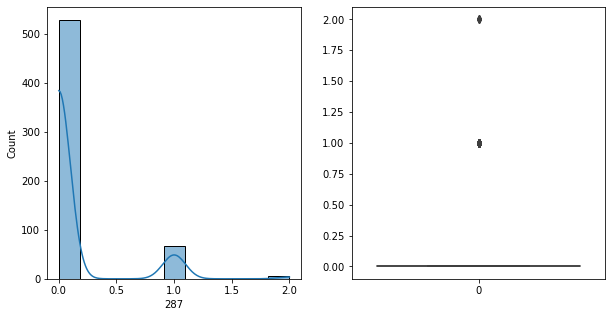

287   Unique :  [0 1 2]
--------------------------------------------------------------------
287   N unique :  3
--------------------------------------------------------------------
287   Value Counts :  0    528
1     67
2      5
Name: 287, dtype: int64
--------------------------------------------------------------------



[ 288 ]
show_df_info :  288


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


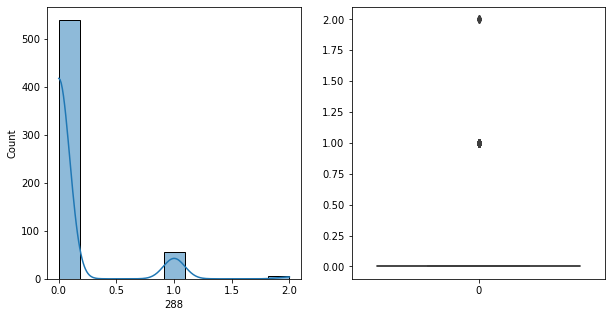

288   Unique :  [0 1 2]
--------------------------------------------------------------------
288   N unique :  3
--------------------------------------------------------------------
288   Value Counts :  0    540
1     55
2      5
Name: 288, dtype: int64
--------------------------------------------------------------------



[ 289 ]
show_df_info :  289


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


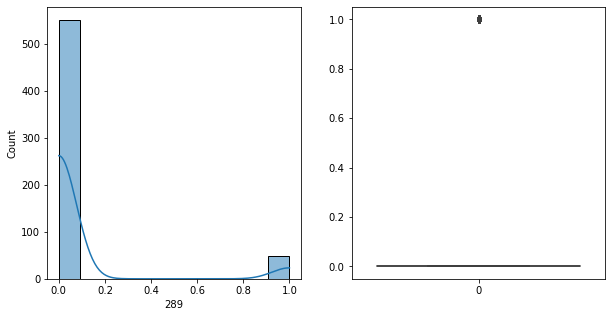

289   Unique :  [0 1]
--------------------------------------------------------------------
289   N unique :  2
--------------------------------------------------------------------
289   Value Counts :  0    551
1     49
Name: 289, dtype: int64
--------------------------------------------------------------------



[ 290 ]
show_df_info :  290


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


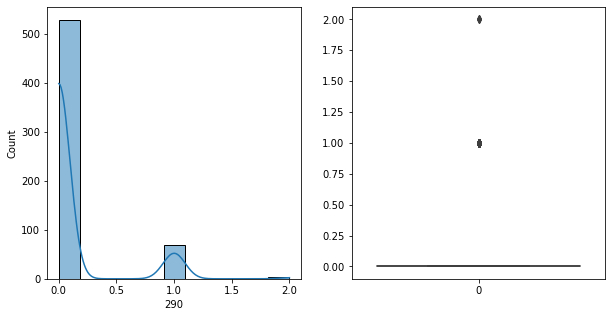

290   Unique :  [0 1 2]
--------------------------------------------------------------------
290   N unique :  3
--------------------------------------------------------------------
290   Value Counts :  0    528
1     69
2      3
Name: 290, dtype: int64
--------------------------------------------------------------------



[ 291 ]
show_df_info :  291


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


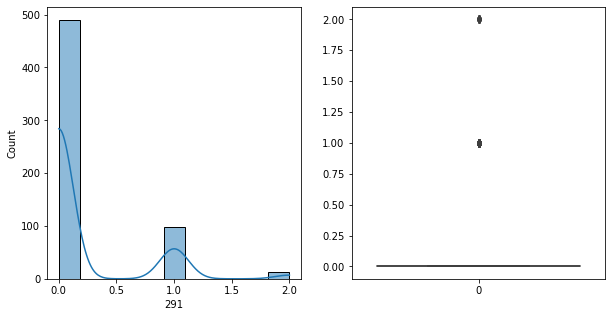

291   Unique :  [0 1 2]
--------------------------------------------------------------------
291   N unique :  3
--------------------------------------------------------------------
291   Value Counts :  0    490
1     98
2     12
Name: 291, dtype: int64
--------------------------------------------------------------------



[ 292 ]
show_df_info :  292


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


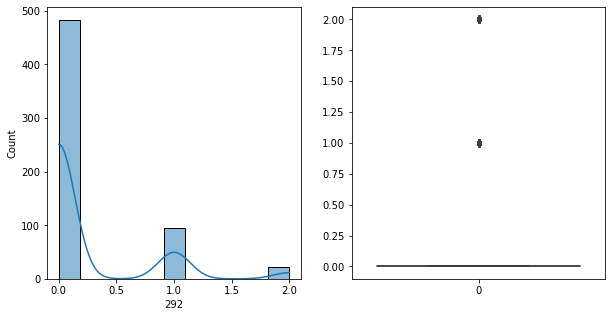

292   Unique :  [0 1 2]
--------------------------------------------------------------------
292   N unique :  3
--------------------------------------------------------------------
292   Value Counts :  0    483
1     95
2     22
Name: 292, dtype: int64
--------------------------------------------------------------------



[ 293 ]
show_df_info :  293


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


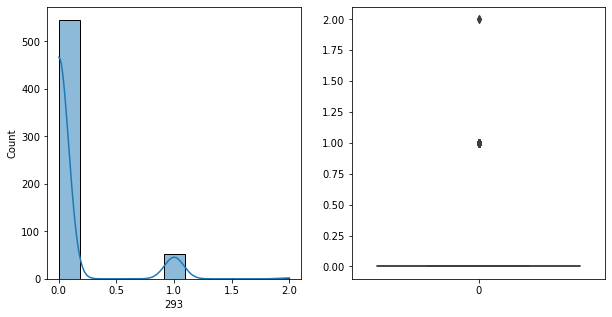

293   Unique :  [0 1 2]
--------------------------------------------------------------------
293   N unique :  3
--------------------------------------------------------------------
293   Value Counts :  0    545
1     53
2      2
Name: 293, dtype: int64
--------------------------------------------------------------------



[ 294 ]
show_df_info :  294


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


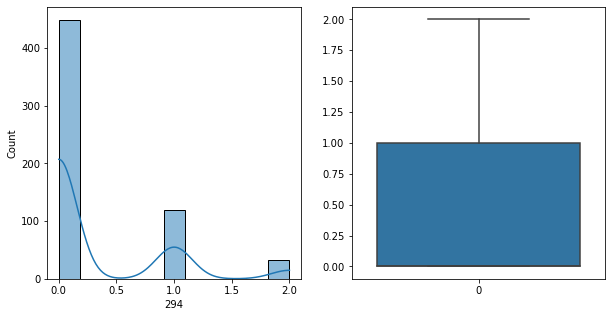

294   Unique :  [1 0 2]
--------------------------------------------------------------------
294   N unique :  3
--------------------------------------------------------------------
294   Value Counts :  0    449
1    119
2     32
Name: 294, dtype: int64
--------------------------------------------------------------------



[ 295 ]
show_df_info :  295


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


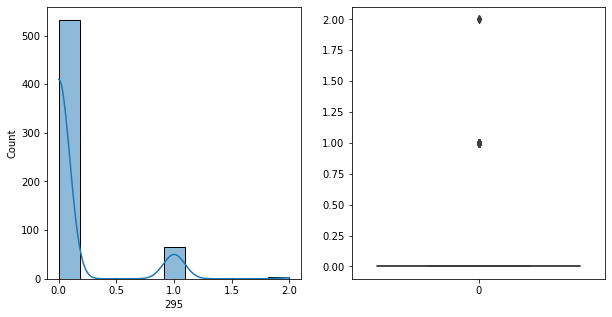

295   Unique :  [0 1 2]
--------------------------------------------------------------------
295   N unique :  3
--------------------------------------------------------------------
295   Value Counts :  0    532
1     65
2      3
Name: 295, dtype: int64
--------------------------------------------------------------------



[ 296 ]
show_df_info :  296


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


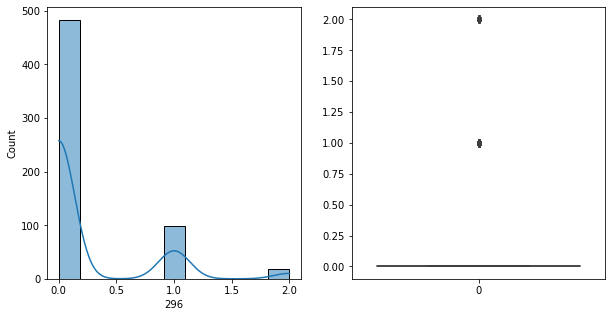

296   Unique :  [1 0 2]
--------------------------------------------------------------------
296   N unique :  3
--------------------------------------------------------------------
296   Value Counts :  0    483
1     98
2     19
Name: 296, dtype: int64
--------------------------------------------------------------------



[ 297 ]
show_df_info :  297


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


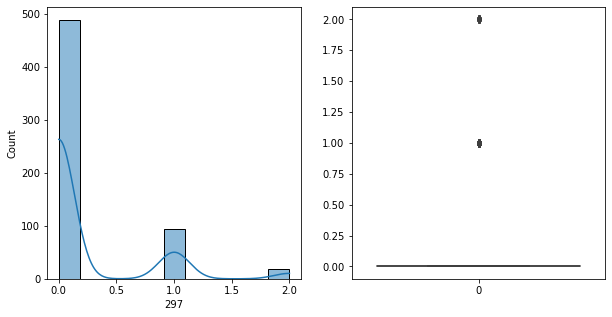

297   Unique :  [1 0 2]
--------------------------------------------------------------------
297   N unique :  3
--------------------------------------------------------------------
297   Value Counts :  0    488
1     93
2     19
Name: 297, dtype: int64
--------------------------------------------------------------------



[ 298 ]
show_df_info :  298


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


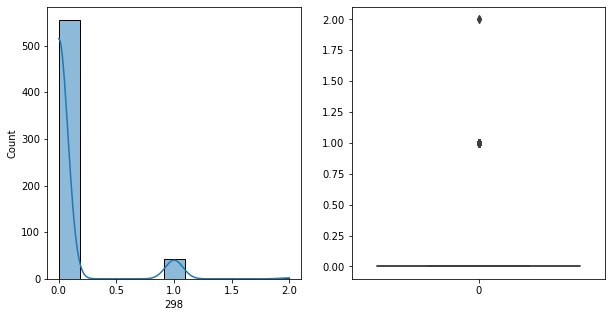

298   Unique :  [0 1 2]
--------------------------------------------------------------------
298   N unique :  3
--------------------------------------------------------------------
298   Value Counts :  0    555
1     43
2      2
Name: 298, dtype: int64
--------------------------------------------------------------------



[ 299 ]
show_df_info :  299


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


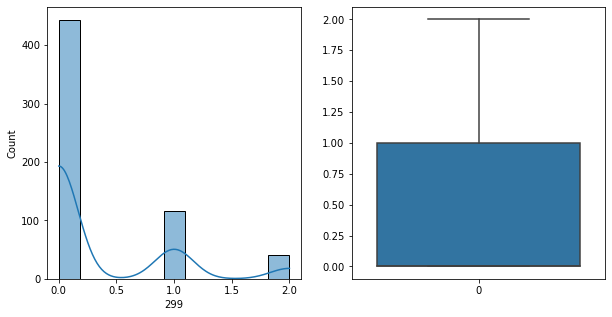

299   Unique :  [2 0 1]
--------------------------------------------------------------------
299   N unique :  3
--------------------------------------------------------------------
299   Value Counts :  0    443
1    116
2     41
Name: 299, dtype: int64
--------------------------------------------------------------------



[ 300 ]
show_df_info :  300


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


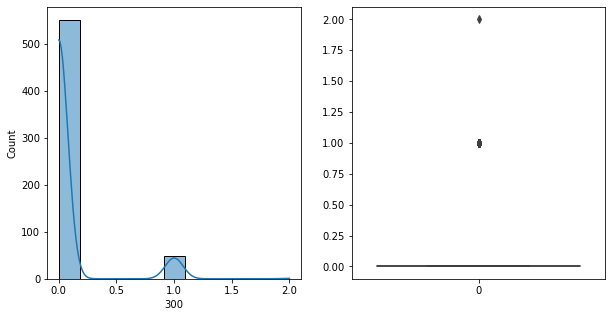

300   Unique :  [0 1 2]
--------------------------------------------------------------------
300   N unique :  3
--------------------------------------------------------------------
300   Value Counts :  0    551
1     48
2      1
Name: 300, dtype: int64
--------------------------------------------------------------------



[ 301 ]
show_df_info :  301


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


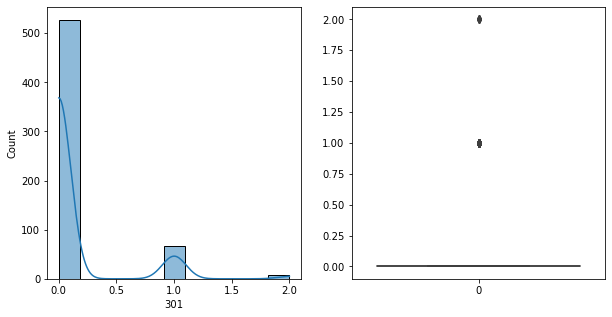

301   Unique :  [0 1 2]
--------------------------------------------------------------------
301   N unique :  3
--------------------------------------------------------------------
301   Value Counts :  0    527
1     66
2      7
Name: 301, dtype: int64
--------------------------------------------------------------------



[ 302 ]
show_df_info :  302


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


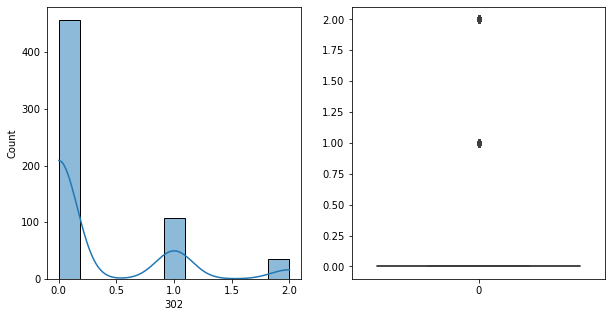

302   Unique :  [0 2 1]
--------------------------------------------------------------------
302   N unique :  3
--------------------------------------------------------------------
302   Value Counts :  0    457
1    108
2     35
Name: 302, dtype: int64
--------------------------------------------------------------------



[ 303 ]
show_df_info :  303


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


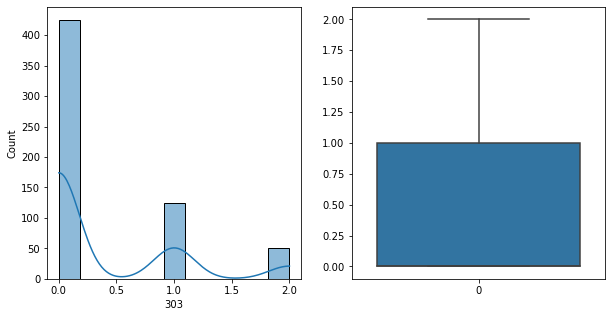

303   Unique :  [1 0 2]
--------------------------------------------------------------------
303   N unique :  3
--------------------------------------------------------------------
303   Value Counts :  0    425
1    124
2     51
Name: 303, dtype: int64
--------------------------------------------------------------------



[ 304 ]
show_df_info :  304


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


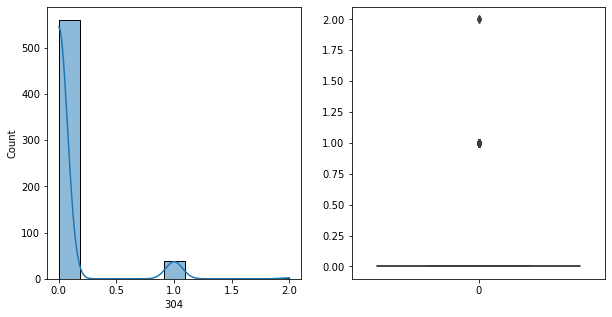

304   Unique :  [0 1 2]
--------------------------------------------------------------------
304   N unique :  3
--------------------------------------------------------------------
304   Value Counts :  0    560
1     38
2      2
Name: 304, dtype: int64
--------------------------------------------------------------------



[ 305 ]
show_df_info :  305


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


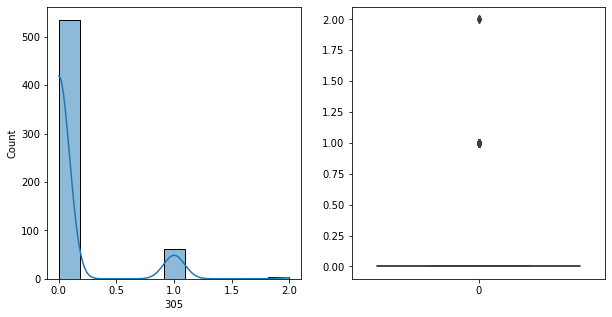

305   Unique :  [0 1 2]
--------------------------------------------------------------------
305   N unique :  3
--------------------------------------------------------------------
305   Value Counts :  0    535
1     62
2      3
Name: 305, dtype: int64
--------------------------------------------------------------------



[ 306 ]
show_df_info :  306


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


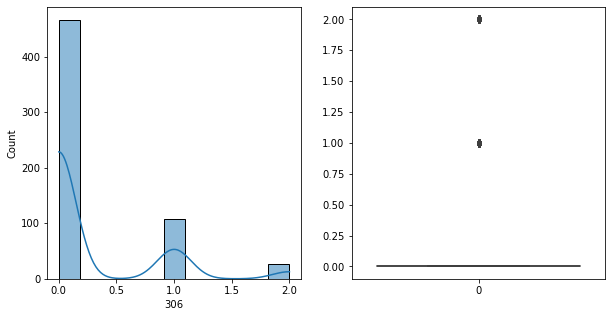

306   Unique :  [1 0 2]
--------------------------------------------------------------------
306   N unique :  3
--------------------------------------------------------------------
306   Value Counts :  0    466
1    108
2     26
Name: 306, dtype: int64
--------------------------------------------------------------------



[ 307 ]
show_df_info :  307


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


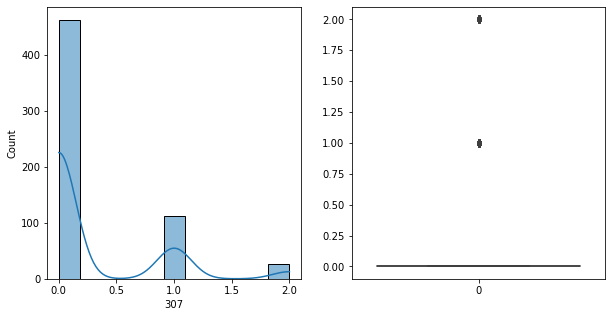

307   Unique :  [1 0 2]
--------------------------------------------------------------------
307   N unique :  3
--------------------------------------------------------------------
307   Value Counts :  0    462
1    112
2     26
Name: 307, dtype: int64
--------------------------------------------------------------------



[ 308 ]
show_df_info :  308


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


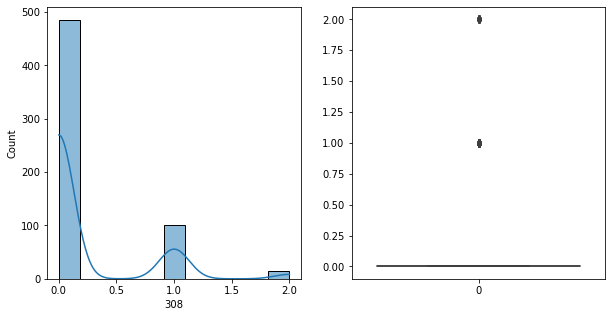

308   Unique :  [1 0 2]
--------------------------------------------------------------------
308   N unique :  3
--------------------------------------------------------------------
308   Value Counts :  0    485
1    100
2     15
Name: 308, dtype: int64
--------------------------------------------------------------------



[ 309 ]
show_df_info :  309


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


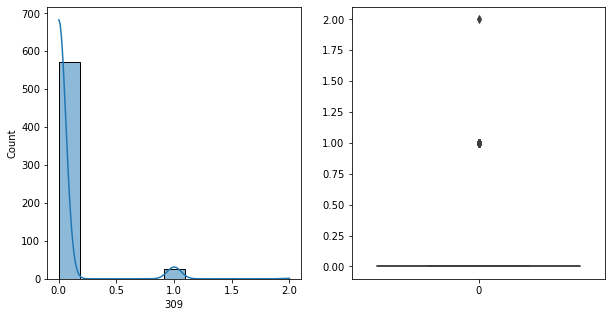

309   Unique :  [0 1 2]
--------------------------------------------------------------------
309   N unique :  3
--------------------------------------------------------------------
309   Value Counts :  0    573
1     26
2      1
Name: 309, dtype: int64
--------------------------------------------------------------------



[ 310 ]
show_df_info :  310


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


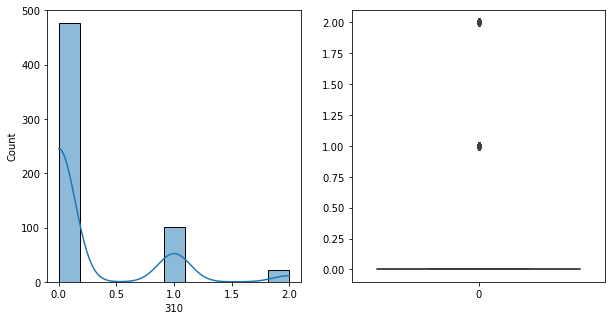

310   Unique :  [0 1 2]
--------------------------------------------------------------------
310   N unique :  3
--------------------------------------------------------------------
310   Value Counts :  0    477
1    101
2     22
Name: 310, dtype: int64
--------------------------------------------------------------------



[ 311 ]
show_df_info :  311


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


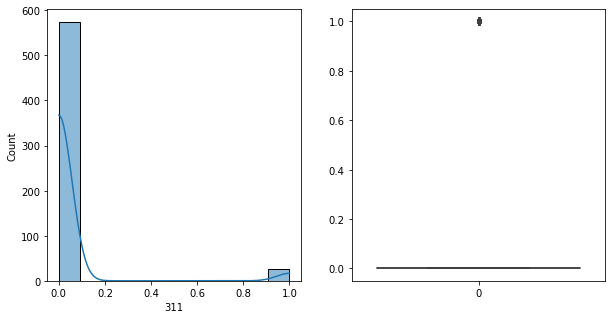

311   Unique :  [0 1]
--------------------------------------------------------------------
311   N unique :  2
--------------------------------------------------------------------
311   Value Counts :  0    574
1     26
Name: 311, dtype: int64
--------------------------------------------------------------------



[ 312 ]
show_df_info :  312


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


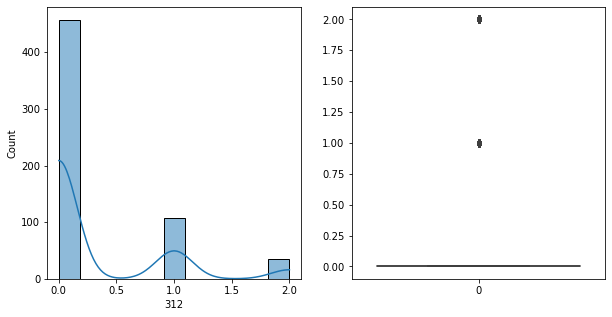

312   Unique :  [0 1 2]
--------------------------------------------------------------------
312   N unique :  3
--------------------------------------------------------------------
312   Value Counts :  0    457
1    108
2     35
Name: 312, dtype: int64
--------------------------------------------------------------------



[ 313 ]
show_df_info :  313


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


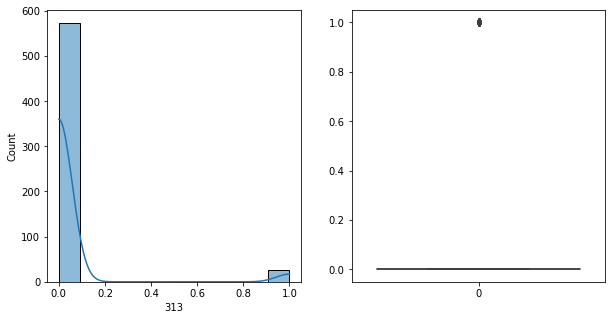

313   Unique :  [0 1]
--------------------------------------------------------------------
313   N unique :  2
--------------------------------------------------------------------
313   Value Counts :  0    573
1     27
Name: 313, dtype: int64
--------------------------------------------------------------------



[ 314 ]
show_df_info :  314


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


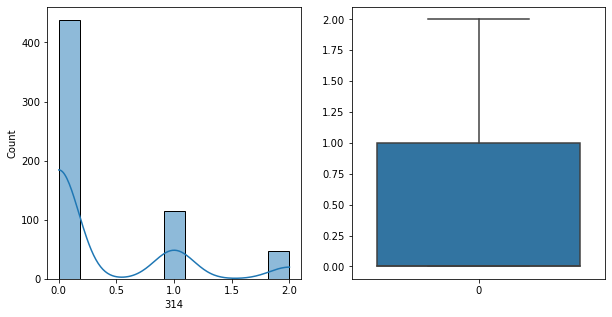

314   Unique :  [0 1 2]
--------------------------------------------------------------------
314   N unique :  3
--------------------------------------------------------------------
314   Value Counts :  0    438
1    115
2     47
Name: 314, dtype: int64
--------------------------------------------------------------------



[ 315 ]
show_df_info :  315


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


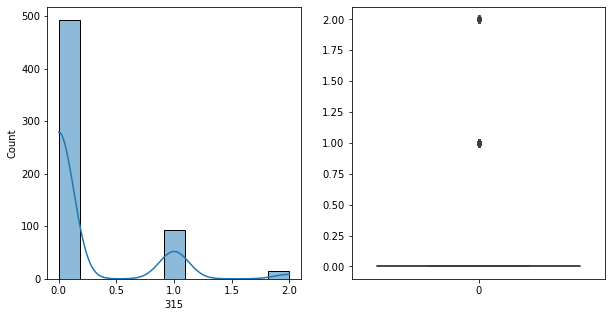

315   Unique :  [0 1 2]
--------------------------------------------------------------------
315   N unique :  3
--------------------------------------------------------------------
315   Value Counts :  0    493
1     92
2     15
Name: 315, dtype: int64
--------------------------------------------------------------------



[ 316 ]
show_df_info :  316


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


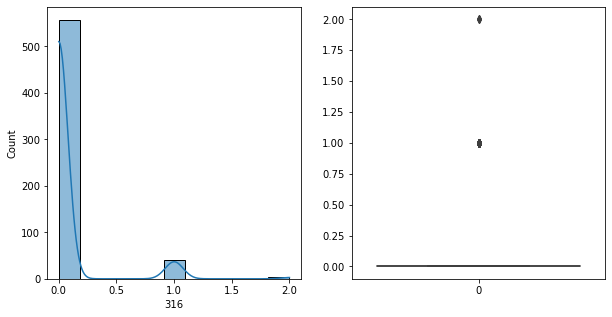

316   Unique :  [0 1 2]
--------------------------------------------------------------------
316   N unique :  3
--------------------------------------------------------------------
316   Value Counts :  0    557
1     40
2      3
Name: 316, dtype: int64
--------------------------------------------------------------------



[ 317 ]
show_df_info :  317


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


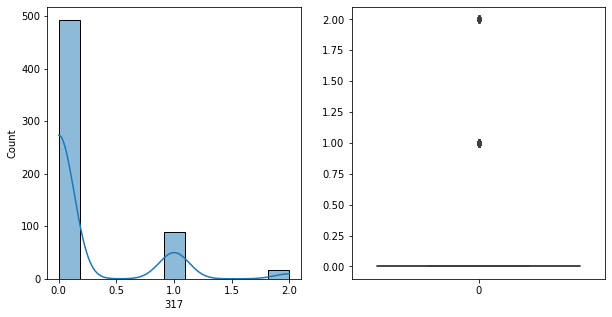

317   Unique :  [0 1 2]
--------------------------------------------------------------------
317   N unique :  3
--------------------------------------------------------------------
317   Value Counts :  0    493
1     90
2     17
Name: 317, dtype: int64
--------------------------------------------------------------------



[ 318 ]
show_df_info :  318


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


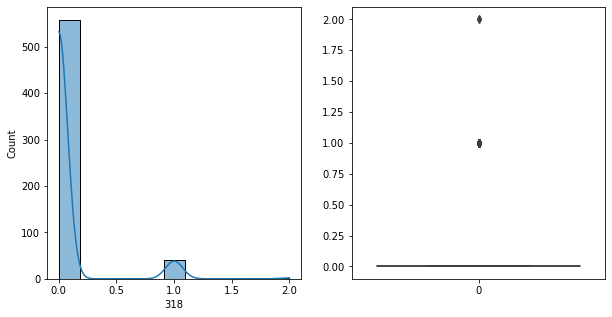

318   Unique :  [0 1 2]
--------------------------------------------------------------------
318   N unique :  3
--------------------------------------------------------------------
318   Value Counts :  0    558
1     40
2      2
Name: 318, dtype: int64
--------------------------------------------------------------------



[ 319 ]
show_df_info :  319


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


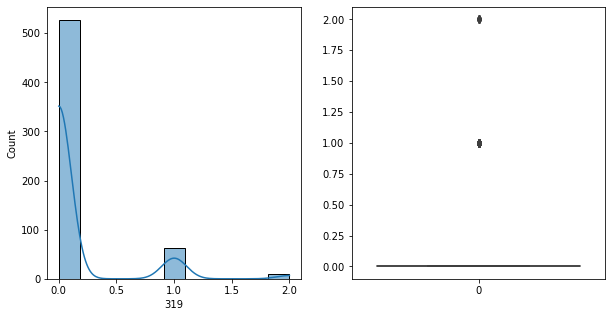

319   Unique :  [0 1 2]
--------------------------------------------------------------------
319   N unique :  3
--------------------------------------------------------------------
319   Value Counts :  0    527
1     63
2     10
Name: 319, dtype: int64
--------------------------------------------------------------------



[ 320 ]
show_df_info :  320


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


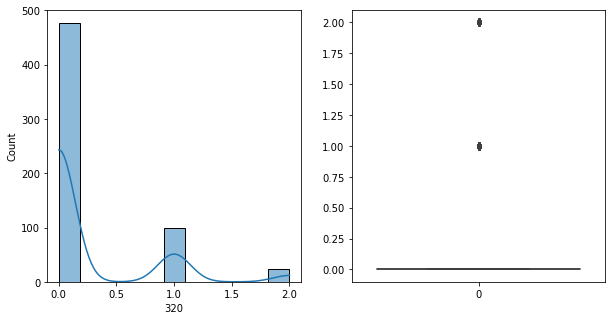

320   Unique :  [0 1 2]
--------------------------------------------------------------------
320   N unique :  3
--------------------------------------------------------------------
320   Value Counts :  0    477
1    100
2     23
Name: 320, dtype: int64
--------------------------------------------------------------------



[ 321 ]
show_df_info :  321


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


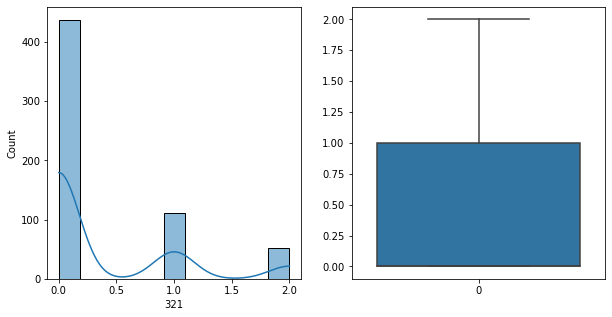

321   Unique :  [0 1 2]
--------------------------------------------------------------------
321   N unique :  3
--------------------------------------------------------------------
321   Value Counts :  0    437
1    111
2     52
Name: 321, dtype: int64
--------------------------------------------------------------------



[ 322 ]
show_df_info :  322


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


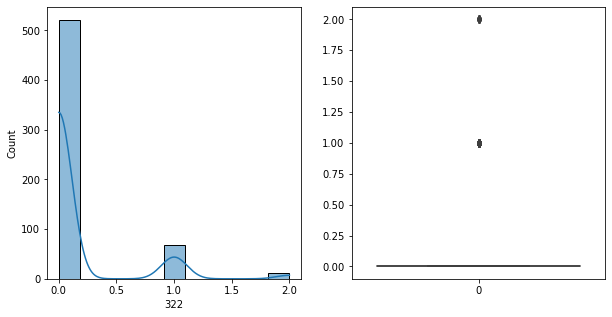

322   Unique :  [2 0 1]
--------------------------------------------------------------------
322   N unique :  3
--------------------------------------------------------------------
322   Value Counts :  0    521
1     68
2     11
Name: 322, dtype: int64
--------------------------------------------------------------------



[ 323 ]
show_df_info :  323


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


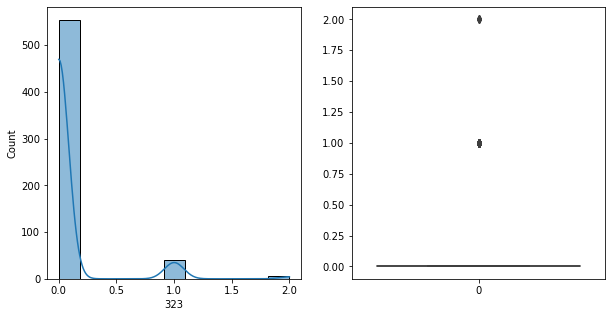

323   Unique :  [0 1 2]
--------------------------------------------------------------------
323   N unique :  3
--------------------------------------------------------------------
323   Value Counts :  0    554
1     41
2      5
Name: 323, dtype: int64
--------------------------------------------------------------------



[ 324 ]
show_df_info :  324


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


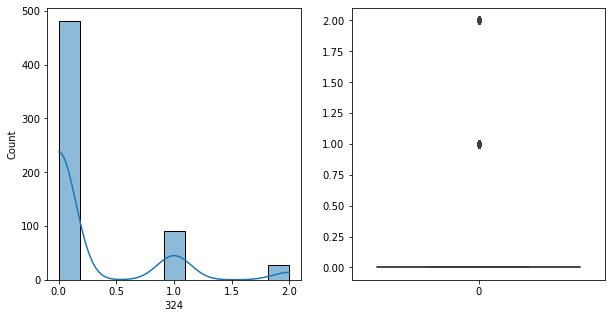

324   Unique :  [2 0 1]
--------------------------------------------------------------------
324   N unique :  3
--------------------------------------------------------------------
324   Value Counts :  0    481
1     91
2     28
Name: 324, dtype: int64
--------------------------------------------------------------------



[ 325 ]
show_df_info :  325


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


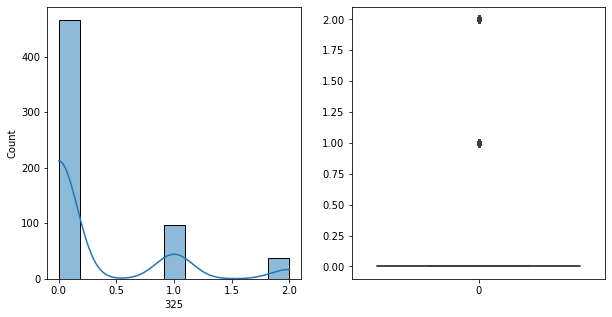

325   Unique :  [2 0 1]
--------------------------------------------------------------------
325   N unique :  3
--------------------------------------------------------------------
325   Value Counts :  0    466
1     97
2     37
Name: 325, dtype: int64
--------------------------------------------------------------------



[ 326 ]
show_df_info :  326


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


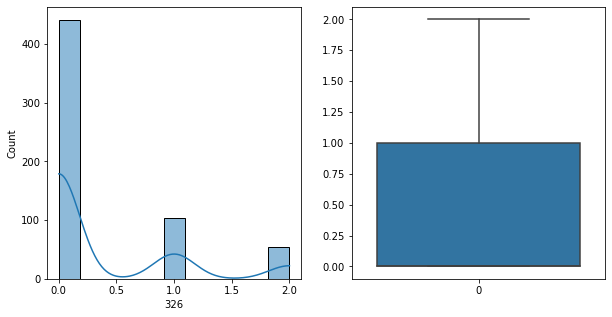

326   Unique :  [0 2 1]
--------------------------------------------------------------------
326   N unique :  3
--------------------------------------------------------------------
326   Value Counts :  0    441
1    104
2     55
Name: 326, dtype: int64
--------------------------------------------------------------------



[ 327 ]
show_df_info :  327


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


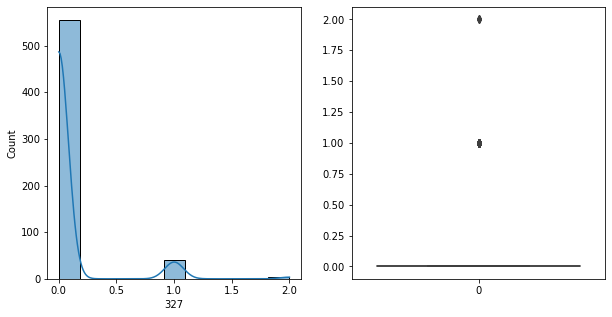

327   Unique :  [0 1 2]
--------------------------------------------------------------------
327   N unique :  3
--------------------------------------------------------------------
327   Value Counts :  0    555
1     41
2      4
Name: 327, dtype: int64
--------------------------------------------------------------------



[ 328 ]
show_df_info :  328


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


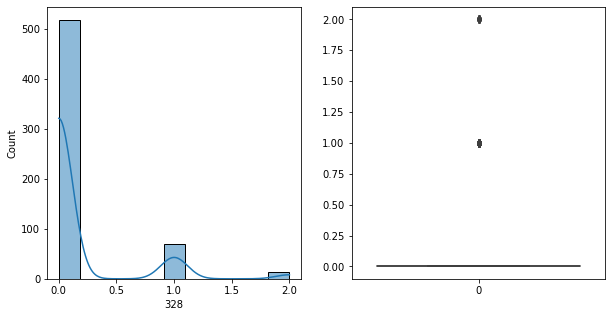

328   Unique :  [0 1 2]
--------------------------------------------------------------------
328   N unique :  3
--------------------------------------------------------------------
328   Value Counts :  0    518
1     69
2     13
Name: 328, dtype: int64
--------------------------------------------------------------------



[ 329 ]
show_df_info :  329


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


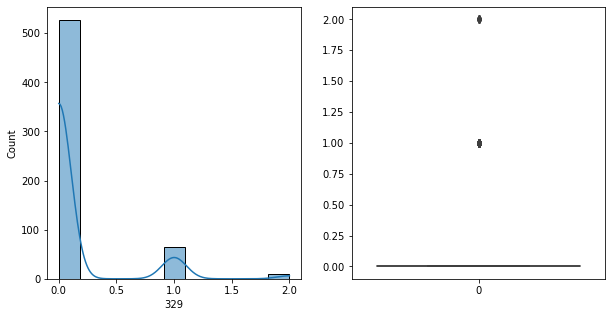

329   Unique :  [0 1 2]
--------------------------------------------------------------------
329   N unique :  3
--------------------------------------------------------------------
329   Value Counts :  0    527
1     64
2      9
Name: 329, dtype: int64
--------------------------------------------------------------------



[ 330 ]
show_df_info :  330


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


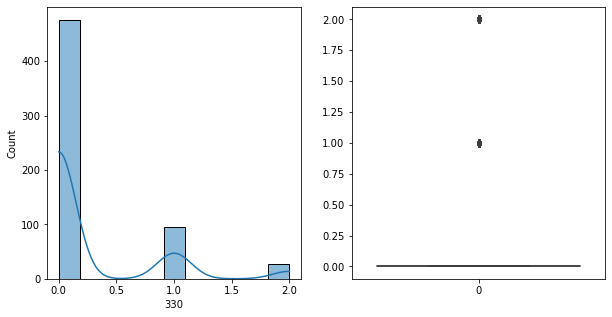

330   Unique :  [2 0 1]
--------------------------------------------------------------------
330   N unique :  3
--------------------------------------------------------------------
330   Value Counts :  0    476
1     96
2     28
Name: 330, dtype: int64
--------------------------------------------------------------------



[ 331 ]
show_df_info :  331


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


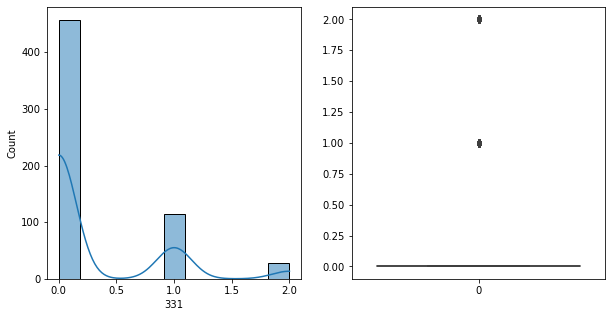

331   Unique :  [0 1 2]
--------------------------------------------------------------------
331   N unique :  3
--------------------------------------------------------------------
331   Value Counts :  0    457
1    115
2     28
Name: 331, dtype: int64
--------------------------------------------------------------------



[ 332 ]
show_df_info :  332


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


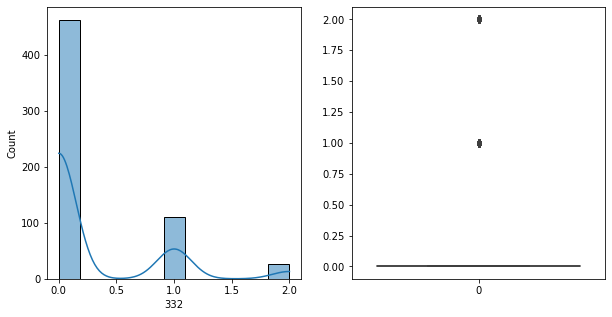

332   Unique :  [0 1 2]
--------------------------------------------------------------------
332   N unique :  3
--------------------------------------------------------------------
332   Value Counts :  0    463
1    110
2     27
Name: 332, dtype: int64
--------------------------------------------------------------------



[ 333 ]
show_df_info :  333


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


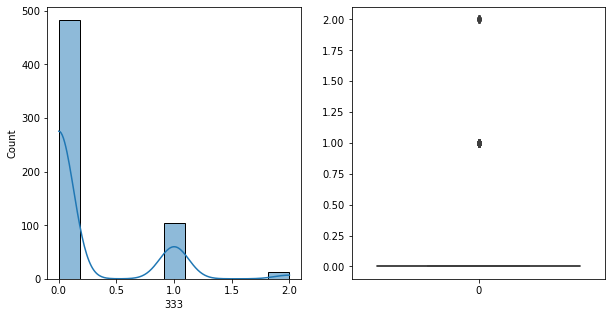

333   Unique :  [1 0 2]
--------------------------------------------------------------------
333   N unique :  3
--------------------------------------------------------------------
333   Value Counts :  0    483
1    105
2     12
Name: 333, dtype: int64
--------------------------------------------------------------------



[ 334 ]
show_df_info :  334


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


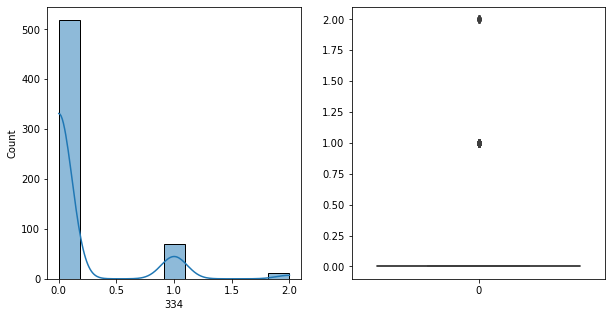

334   Unique :  [0 1 2]
--------------------------------------------------------------------
334   N unique :  3
--------------------------------------------------------------------
334   Value Counts :  0    519
1     70
2     11
Name: 334, dtype: int64
--------------------------------------------------------------------



[ 335 ]
show_df_info :  335


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


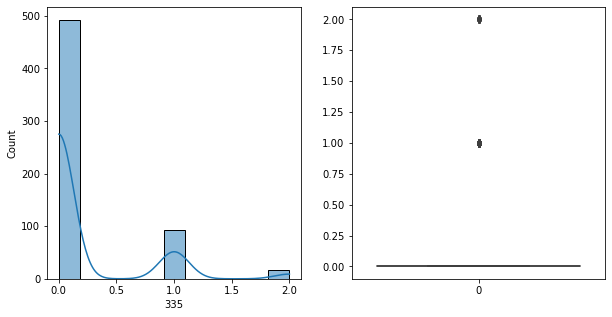

335   Unique :  [1 0 2]
--------------------------------------------------------------------
335   N unique :  3
--------------------------------------------------------------------
335   Value Counts :  0    492
1     92
2     16
Name: 335, dtype: int64
--------------------------------------------------------------------



[ 336 ]
show_df_info :  336


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


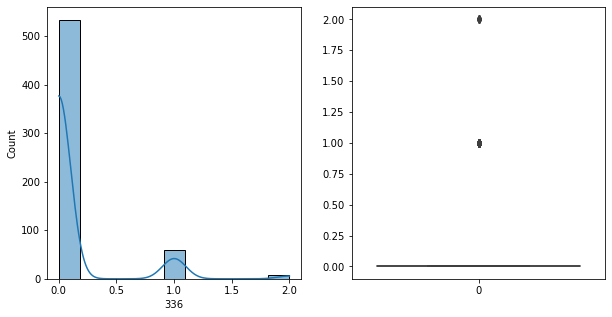

336   Unique :  [0 1 2]
--------------------------------------------------------------------
336   N unique :  3
--------------------------------------------------------------------
336   Value Counts :  0    533
1     59
2      8
Name: 336, dtype: int64
--------------------------------------------------------------------



[ 337 ]
show_df_info :  337


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


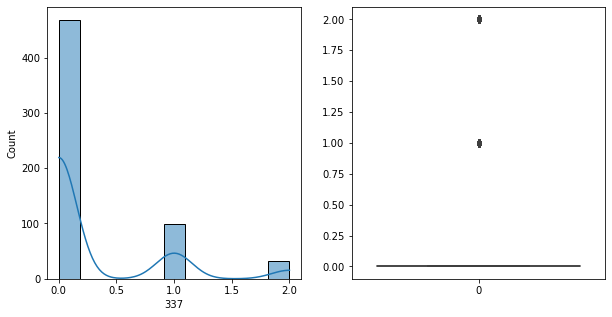

337   Unique :  [1 0 2]
--------------------------------------------------------------------
337   N unique :  3
--------------------------------------------------------------------
337   Value Counts :  0    468
1     99
2     33
Name: 337, dtype: int64
--------------------------------------------------------------------



[ 338 ]
show_df_info :  338


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


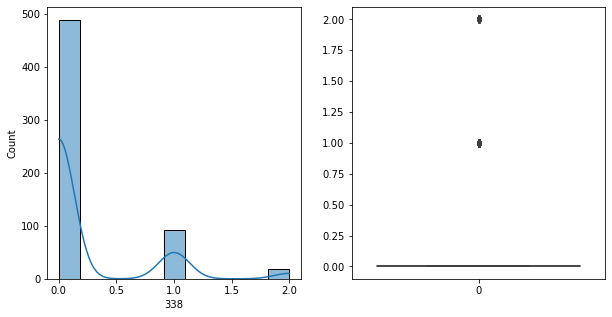

338   Unique :  [0 1 2]
--------------------------------------------------------------------
338   N unique :  3
--------------------------------------------------------------------
338   Value Counts :  0    489
1     92
2     19
Name: 338, dtype: int64
--------------------------------------------------------------------



[ 339 ]
show_df_info :  339


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


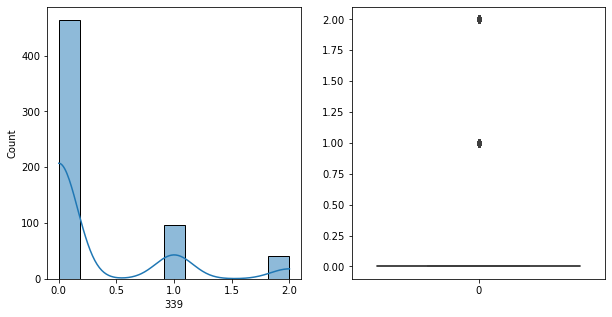

339   Unique :  [1 0 2]
--------------------------------------------------------------------
339   N unique :  3
--------------------------------------------------------------------
339   Value Counts :  0    464
1     96
2     40
Name: 339, dtype: int64
--------------------------------------------------------------------



[ 340 ]
show_df_info :  340


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


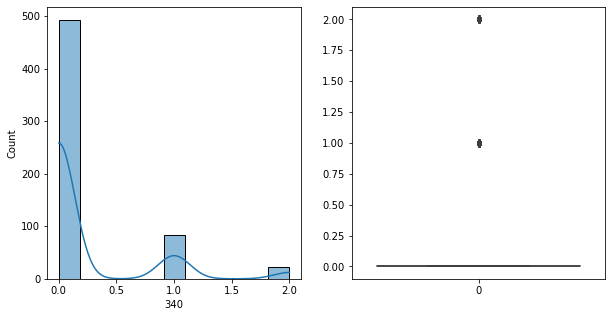

340   Unique :  [1 0 2]
--------------------------------------------------------------------
340   N unique :  3
--------------------------------------------------------------------
340   Value Counts :  0    493
1     84
2     23
Name: 340, dtype: int64
--------------------------------------------------------------------



[ 341 ]
show_df_info :  341


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


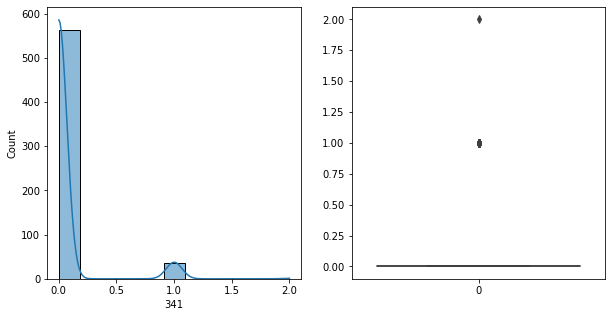

341   Unique :  [0 2 1]
--------------------------------------------------------------------
341   N unique :  3
--------------------------------------------------------------------
341   Value Counts :  0    563
1     36
2      1
Name: 341, dtype: int64
--------------------------------------------------------------------



[ 342 ]
show_df_info :  342


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


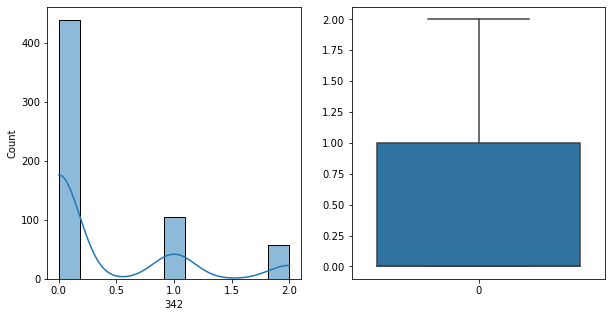

342   Unique :  [1 0 2]
--------------------------------------------------------------------
342   N unique :  3
--------------------------------------------------------------------
342   Value Counts :  0    439
1    104
2     57
Name: 342, dtype: int64
--------------------------------------------------------------------



[ 343 ]
show_df_info :  343


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


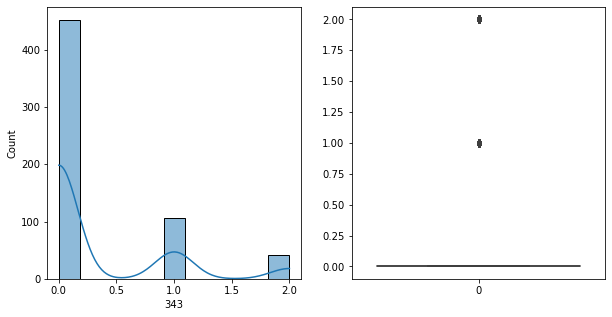

343   Unique :  [1 0 2]
--------------------------------------------------------------------
343   N unique :  3
--------------------------------------------------------------------
343   Value Counts :  0    452
1    107
2     41
Name: 343, dtype: int64
--------------------------------------------------------------------



[ 344 ]
show_df_info :  344


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


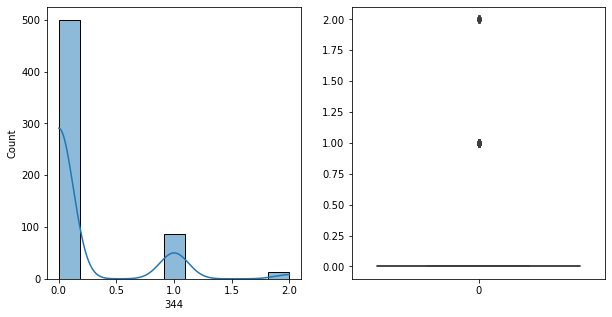

344   Unique :  [1 0 2]
--------------------------------------------------------------------
344   N unique :  3
--------------------------------------------------------------------
344   Value Counts :  0    500
1     86
2     14
Name: 344, dtype: int64
--------------------------------------------------------------------



[ 345 ]
show_df_info :  345


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


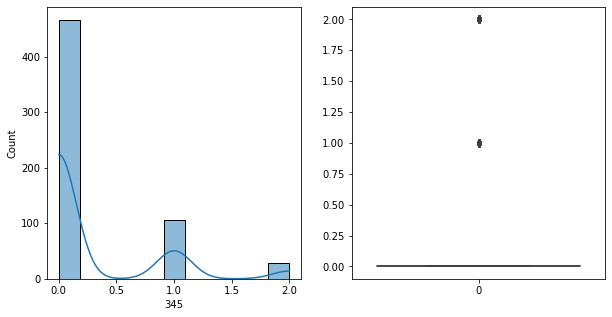

345   Unique :  [1 0 2]
--------------------------------------------------------------------
345   N unique :  3
--------------------------------------------------------------------
345   Value Counts :  0    466
1    105
2     29
Name: 345, dtype: int64
--------------------------------------------------------------------



[ 346 ]
show_df_info :  346


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


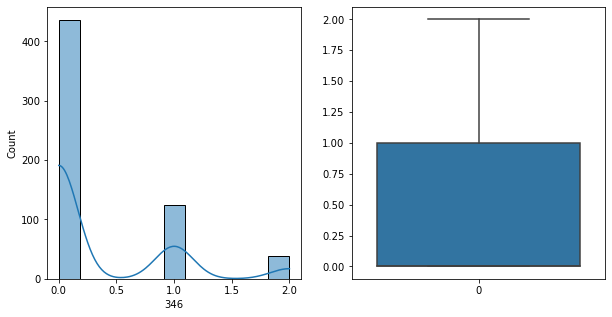

346   Unique :  [1 0 2]
--------------------------------------------------------------------
346   N unique :  3
--------------------------------------------------------------------
346   Value Counts :  0    436
1    125
2     39
Name: 346, dtype: int64
--------------------------------------------------------------------



[ 347 ]
show_df_info :  347


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


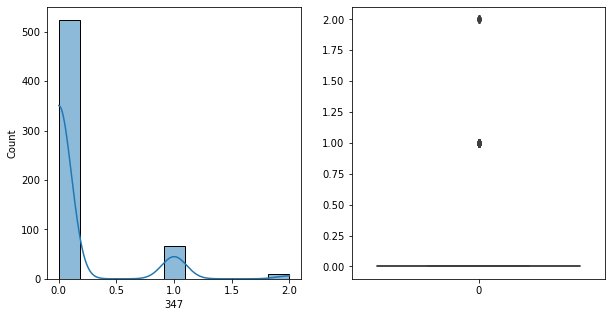

347   Unique :  [0 1 2]
--------------------------------------------------------------------
347   N unique :  3
--------------------------------------------------------------------
347   Value Counts :  0    524
1     67
2      9
Name: 347, dtype: int64
--------------------------------------------------------------------



[ 348 ]
show_df_info :  348


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


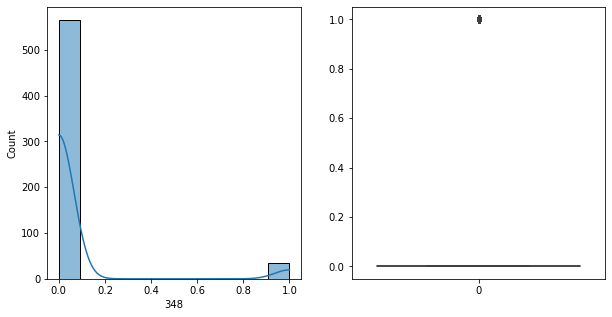

348   Unique :  [0 1]
--------------------------------------------------------------------
348   N unique :  2
--------------------------------------------------------------------
348   Value Counts :  0    565
1     35
Name: 348, dtype: int64
--------------------------------------------------------------------



[ 349 ]
show_df_info :  349


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


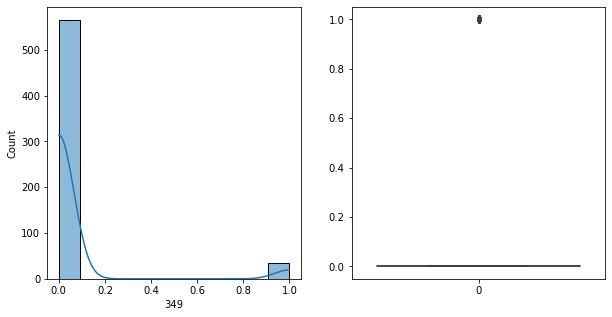

349   Unique :  [0 1]
--------------------------------------------------------------------
349   N unique :  2
--------------------------------------------------------------------
349   Value Counts :  0    565
1     35
Name: 349, dtype: int64
--------------------------------------------------------------------



[ 350 ]
show_df_info :  350


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


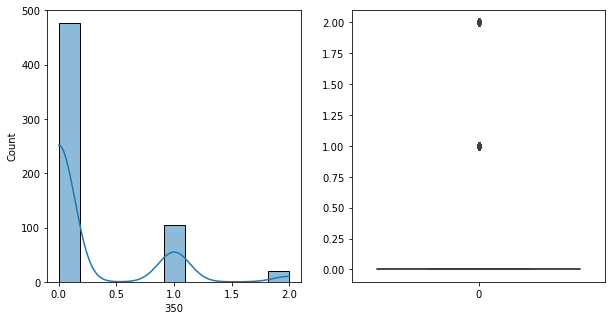

350   Unique :  [1 0 2]
--------------------------------------------------------------------
350   N unique :  3
--------------------------------------------------------------------
350   Value Counts :  0    477
1    104
2     19
Name: 350, dtype: int64
--------------------------------------------------------------------



[ 351 ]
show_df_info :  351


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


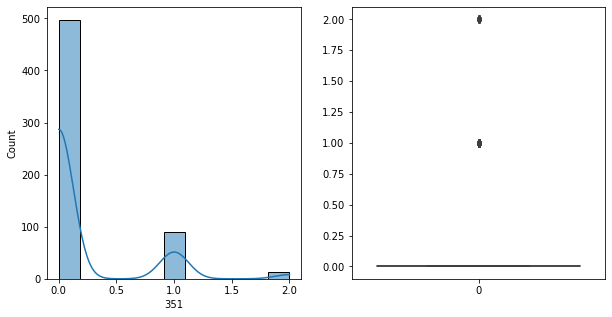

351   Unique :  [0 2 1]
--------------------------------------------------------------------
351   N unique :  3
--------------------------------------------------------------------
351   Value Counts :  0    497
1     89
2     14
Name: 351, dtype: int64
--------------------------------------------------------------------



[ 352 ]
show_df_info :  352


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


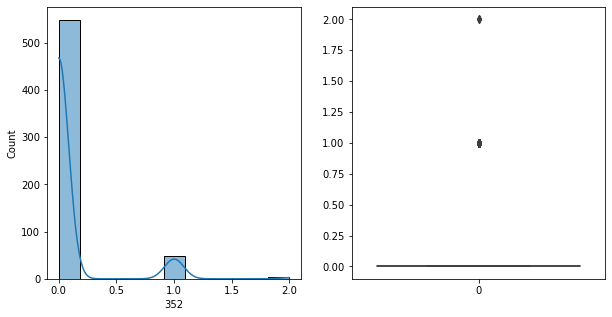

352   Unique :  [0 1 2]
--------------------------------------------------------------------
352   N unique :  3
--------------------------------------------------------------------
352   Value Counts :  0    548
1     49
2      3
Name: 352, dtype: int64
--------------------------------------------------------------------



[ 353 ]
show_df_info :  353


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


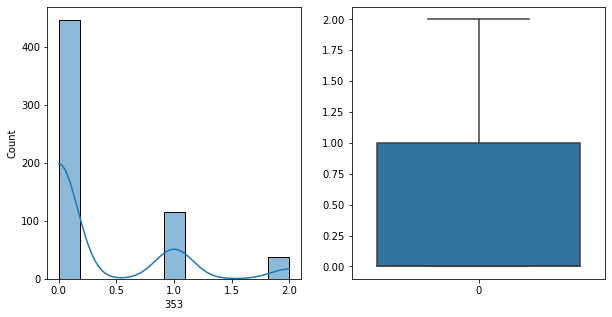

353   Unique :  [1 0 2]
--------------------------------------------------------------------
353   N unique :  3
--------------------------------------------------------------------
353   Value Counts :  0    447
1    115
2     38
Name: 353, dtype: int64
--------------------------------------------------------------------



[ 354 ]
show_df_info :  354


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


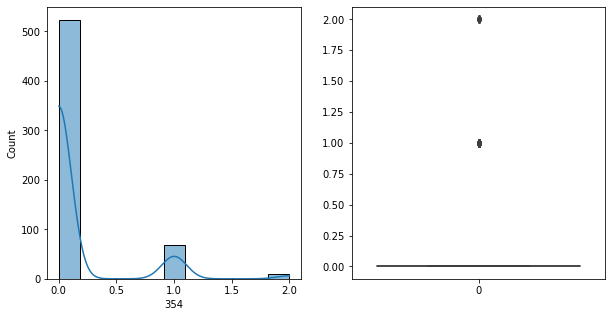

354   Unique :  [0 1 2]
--------------------------------------------------------------------
354   N unique :  3
--------------------------------------------------------------------
354   Value Counts :  0    523
1     68
2      9
Name: 354, dtype: int64
--------------------------------------------------------------------



[ 355 ]
show_df_info :  355


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


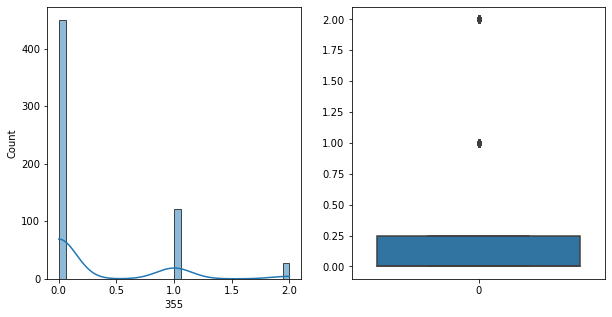

355   Unique :  [1 0 2]
--------------------------------------------------------------------
355   N unique :  3
--------------------------------------------------------------------
355   Value Counts :  0    450
1    122
2     28
Name: 355, dtype: int64
--------------------------------------------------------------------



[ 356 ]
show_df_info :  356


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


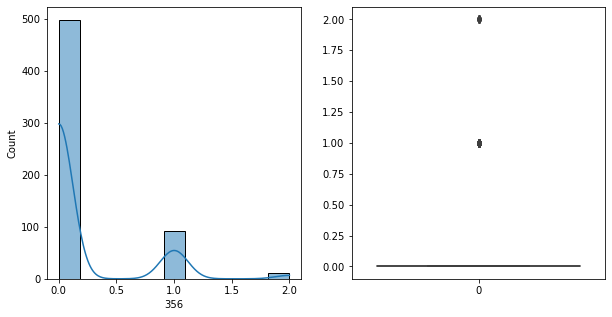

356   Unique :  [0 1 2]
--------------------------------------------------------------------
356   N unique :  3
--------------------------------------------------------------------
356   Value Counts :  0    498
1     91
2     11
Name: 356, dtype: int64
--------------------------------------------------------------------



[ 357 ]
show_df_info :  357


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


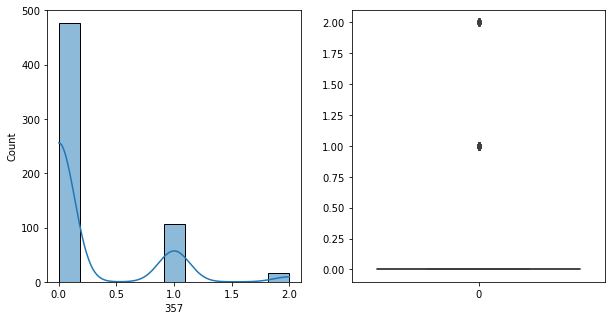

357   Unique :  [1 0 2]
--------------------------------------------------------------------
357   N unique :  3
--------------------------------------------------------------------
357   Value Counts :  0    477
1    106
2     17
Name: 357, dtype: int64
--------------------------------------------------------------------



[ 358 ]
show_df_info :  358


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


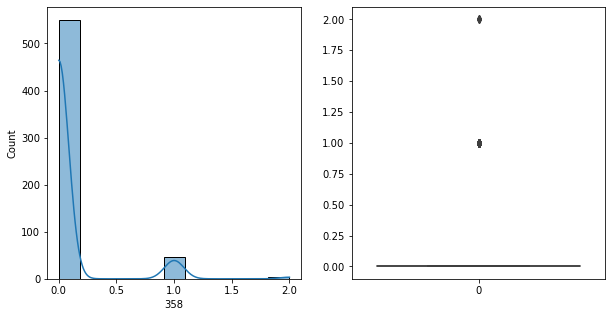

358   Unique :  [0 1 2]
--------------------------------------------------------------------
358   N unique :  3
--------------------------------------------------------------------
358   Value Counts :  0    550
1     46
2      4
Name: 358, dtype: int64
--------------------------------------------------------------------



[ 359 ]
show_df_info :  359


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


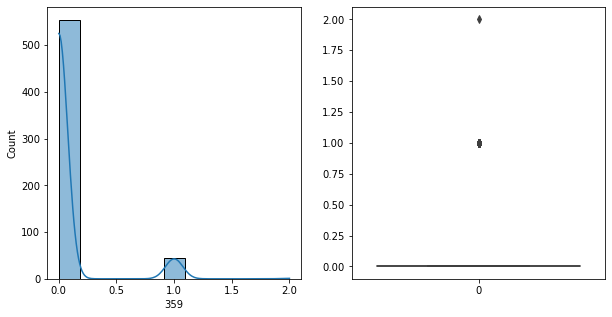

359   Unique :  [0 1 2]
--------------------------------------------------------------------
359   N unique :  3
--------------------------------------------------------------------
359   Value Counts :  0    554
1     45
2      1
Name: 359, dtype: int64
--------------------------------------------------------------------



[ 360 ]
show_df_info :  360


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


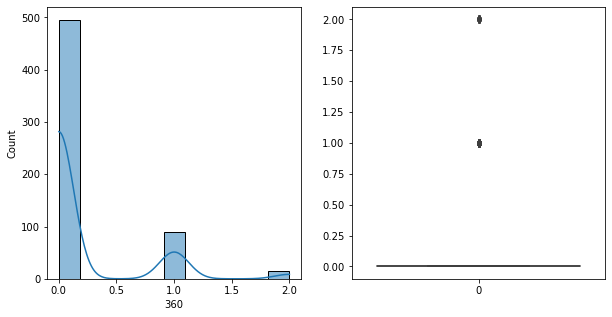

360   Unique :  [1 0 2]
--------------------------------------------------------------------
360   N unique :  3
--------------------------------------------------------------------
360   Value Counts :  0    495
1     90
2     15
Name: 360, dtype: int64
--------------------------------------------------------------------



[ 361 ]
show_df_info :  361


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


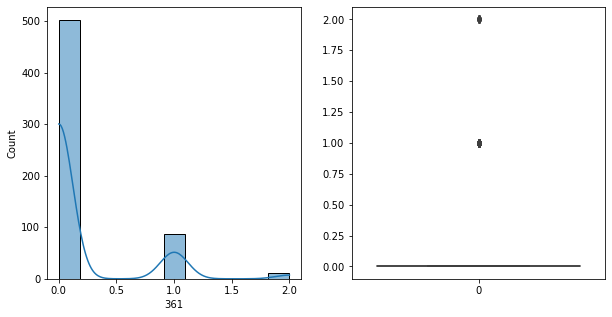

361   Unique :  [1 0 2]
--------------------------------------------------------------------
361   N unique :  3
--------------------------------------------------------------------
361   Value Counts :  0    502
1     86
2     12
Name: 361, dtype: int64
--------------------------------------------------------------------



[ 362 ]
show_df_info :  362


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


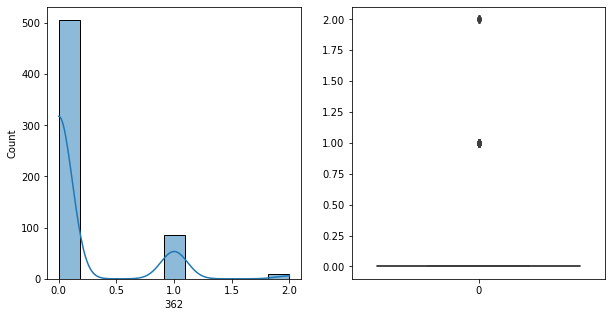

362   Unique :  [0 1 2]
--------------------------------------------------------------------
362   N unique :  3
--------------------------------------------------------------------
362   Value Counts :  0    506
1     85
2      9
Name: 362, dtype: int64
--------------------------------------------------------------------



[ 363 ]
show_df_info :  363


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


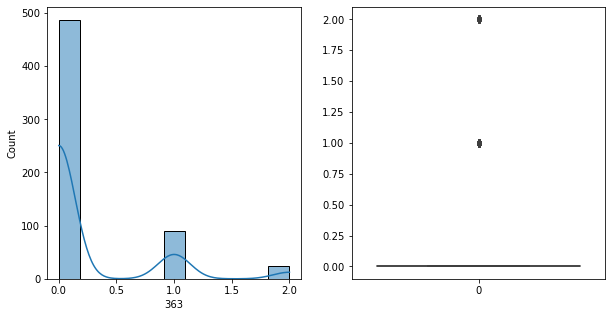

363   Unique :  [1 0 2]
--------------------------------------------------------------------
363   N unique :  3
--------------------------------------------------------------------
363   Value Counts :  0    487
1     89
2     24
Name: 363, dtype: int64
--------------------------------------------------------------------



[ 364 ]
show_df_info :  364


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


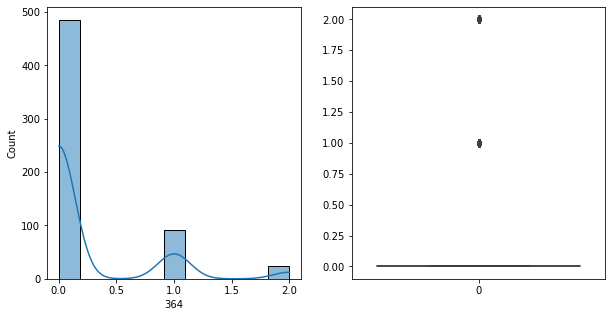

364   Unique :  [1 0 2]
--------------------------------------------------------------------
364   N unique :  3
--------------------------------------------------------------------
364   Value Counts :  0    485
1     91
2     24
Name: 364, dtype: int64
--------------------------------------------------------------------



[ 365 ]
show_df_info :  365


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


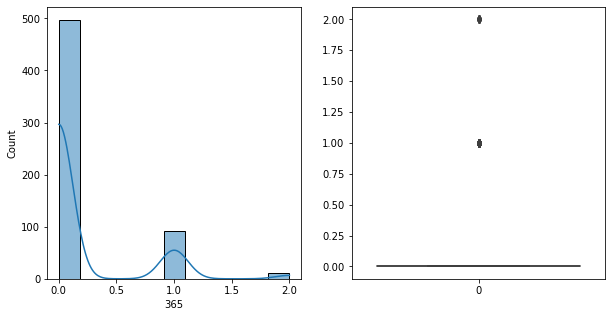

365   Unique :  [1 0 2]
--------------------------------------------------------------------
365   N unique :  3
--------------------------------------------------------------------
365   Value Counts :  0    497
1     92
2     11
Name: 365, dtype: int64
--------------------------------------------------------------------



[ 366 ]
show_df_info :  366


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


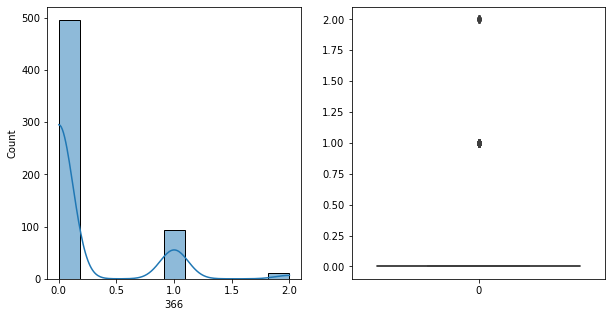

366   Unique :  [0 1 2]
--------------------------------------------------------------------
366   N unique :  3
--------------------------------------------------------------------
366   Value Counts :  0    496
1     93
2     11
Name: 366, dtype: int64
--------------------------------------------------------------------



[ 367 ]
show_df_info :  367


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


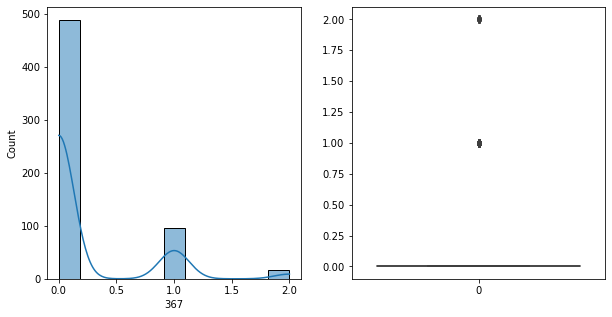

367   Unique :  [0 1 2]
--------------------------------------------------------------------
367   N unique :  3
--------------------------------------------------------------------
367   Value Counts :  0    488
1     96
2     16
Name: 367, dtype: int64
--------------------------------------------------------------------



[ 368 ]
show_df_info :  368


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


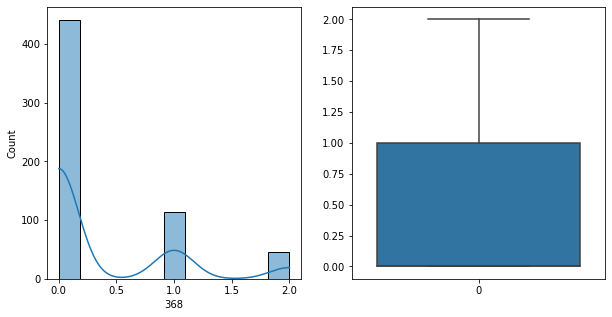

368   Unique :  [2 0 1]
--------------------------------------------------------------------
368   N unique :  3
--------------------------------------------------------------------
368   Value Counts :  0    441
1    114
2     45
Name: 368, dtype: int64
--------------------------------------------------------------------



[ 369 ]
show_df_info :  369


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


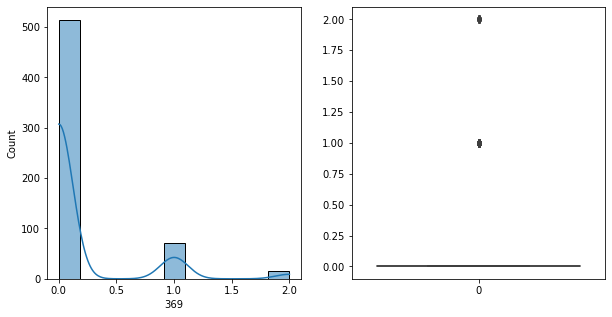

369   Unique :  [1 0 2]
--------------------------------------------------------------------
369   N unique :  3
--------------------------------------------------------------------
369   Value Counts :  0    514
1     71
2     15
Name: 369, dtype: int64
--------------------------------------------------------------------



[ 370 ]
show_df_info :  370


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


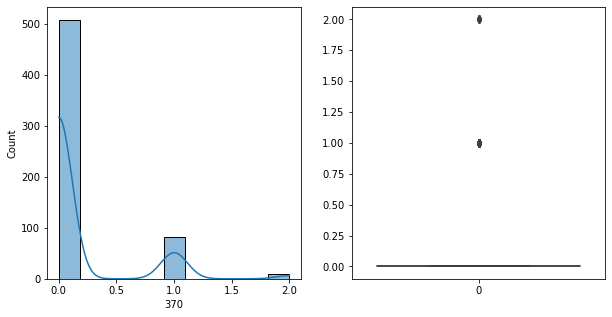

370   Unique :  [1 0 2]
--------------------------------------------------------------------
370   N unique :  3
--------------------------------------------------------------------
370   Value Counts :  0    508
1     82
2     10
Name: 370, dtype: int64
--------------------------------------------------------------------



[ 371 ]
show_df_info :  371


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


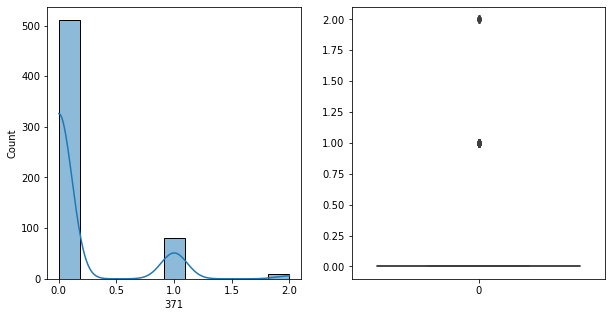

371   Unique :  [0 1 2]
--------------------------------------------------------------------
371   N unique :  3
--------------------------------------------------------------------
371   Value Counts :  0    511
1     80
2      9
Name: 371, dtype: int64
--------------------------------------------------------------------



[ 372 ]
show_df_info :  372


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


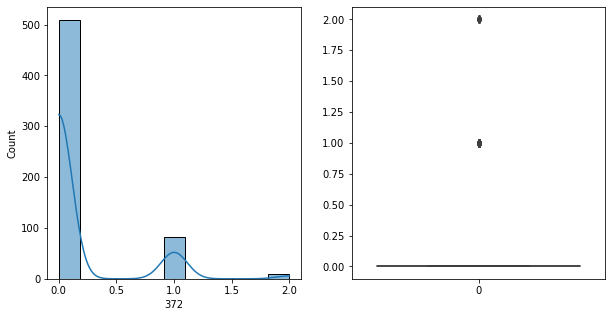

372   Unique :  [0 1 2]
--------------------------------------------------------------------
372   N unique :  3
--------------------------------------------------------------------
372   Value Counts :  0    509
1     82
2      9
Name: 372, dtype: int64
--------------------------------------------------------------------



[ 373 ]
show_df_info :  373


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


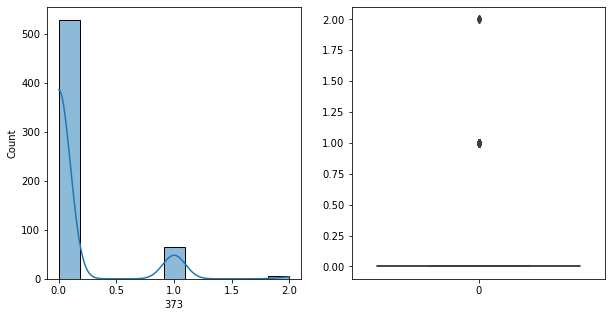

373   Unique :  [0 1 2]
--------------------------------------------------------------------
373   N unique :  3
--------------------------------------------------------------------
373   Value Counts :  0    529
1     66
2      5
Name: 373, dtype: int64
--------------------------------------------------------------------



[ 374 ]
show_df_info :  374


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


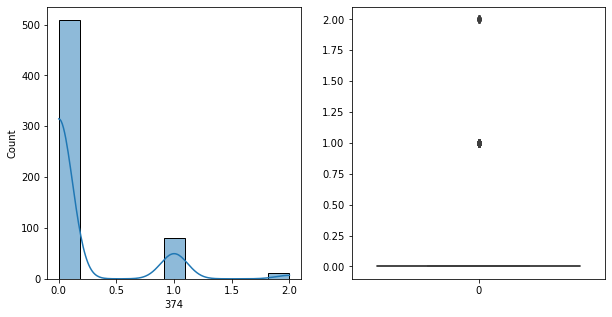

374   Unique :  [1 0 2]
--------------------------------------------------------------------
374   N unique :  3
--------------------------------------------------------------------
374   Value Counts :  0    509
1     80
2     11
Name: 374, dtype: int64
--------------------------------------------------------------------



[ 375 ]
show_df_info :  375


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


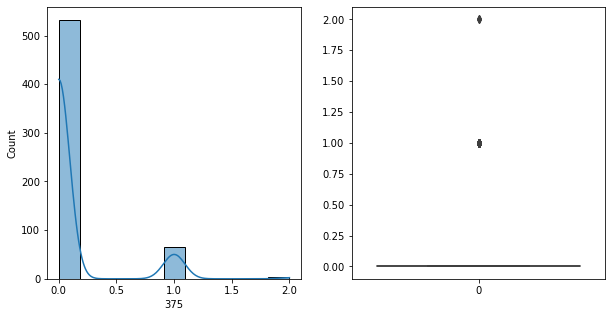

375   Unique :  [0 1 2]
--------------------------------------------------------------------
375   N unique :  3
--------------------------------------------------------------------
375   Value Counts :  0    532
1     65
2      3
Name: 375, dtype: int64
--------------------------------------------------------------------



[ 376 ]
show_df_info :  376


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


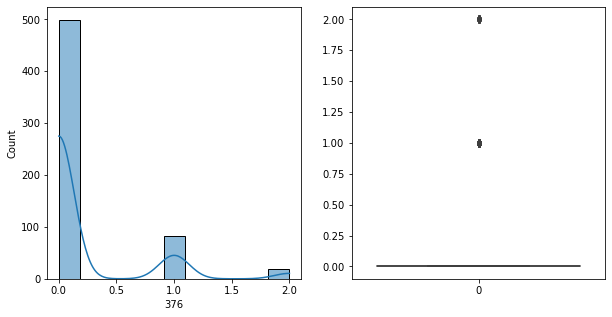

376   Unique :  [1 0 2]
--------------------------------------------------------------------
376   N unique :  3
--------------------------------------------------------------------
376   Value Counts :  0    499
1     82
2     19
Name: 376, dtype: int64
--------------------------------------------------------------------



[ 377 ]
show_df_info :  377


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


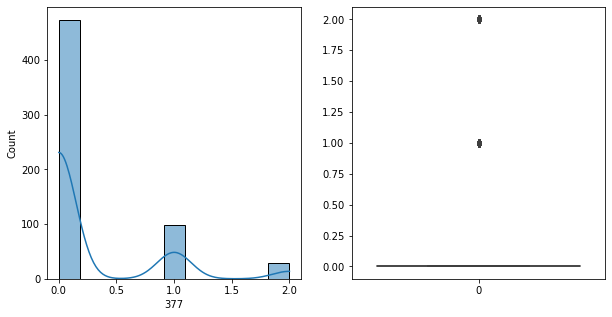

377   Unique :  [0 1 2]
--------------------------------------------------------------------
377   N unique :  3
--------------------------------------------------------------------
377   Value Counts :  0    473
1     99
2     28
Name: 377, dtype: int64
--------------------------------------------------------------------



[ 378 ]
show_df_info :  378


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


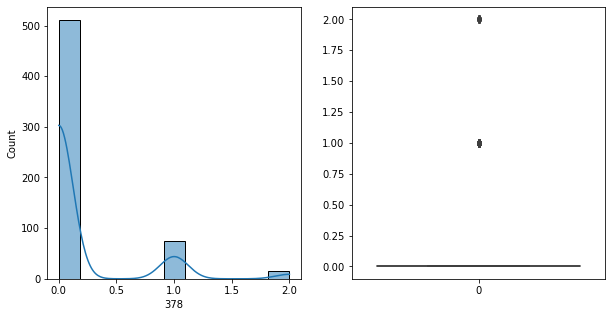

378   Unique :  [1 0 2]
--------------------------------------------------------------------
378   N unique :  3
--------------------------------------------------------------------
378   Value Counts :  0    511
1     74
2     15
Name: 378, dtype: int64
--------------------------------------------------------------------



[ 379 ]
show_df_info :  379


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


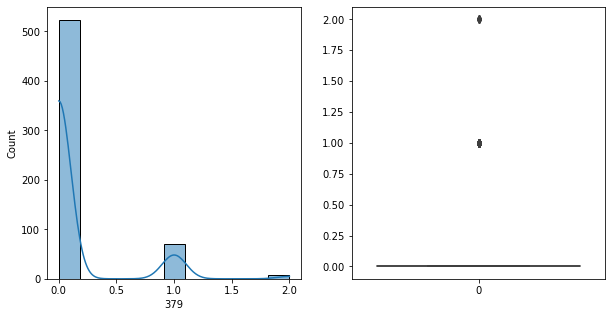

379   Unique :  [0 1 2]
--------------------------------------------------------------------
379   N unique :  3
--------------------------------------------------------------------
379   Value Counts :  0    523
1     70
2      7
Name: 379, dtype: int64
--------------------------------------------------------------------



[ 380 ]
show_df_info :  380


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


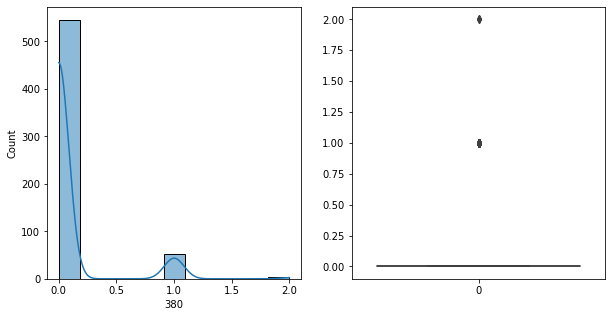

380   Unique :  [0 1 2]
--------------------------------------------------------------------
380   N unique :  3
--------------------------------------------------------------------
380   Value Counts :  0    545
1     52
2      3
Name: 380, dtype: int64
--------------------------------------------------------------------



[ 381 ]
show_df_info :  381


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


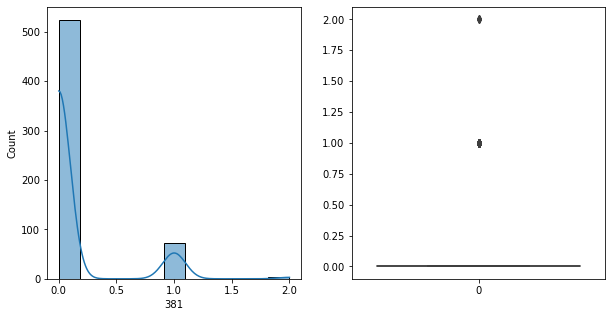

381   Unique :  [0 1 2]
--------------------------------------------------------------------
381   N unique :  3
--------------------------------------------------------------------
381   Value Counts :  0    524
1     72
2      4
Name: 381, dtype: int64
--------------------------------------------------------------------



[ 382 ]
show_df_info :  382


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


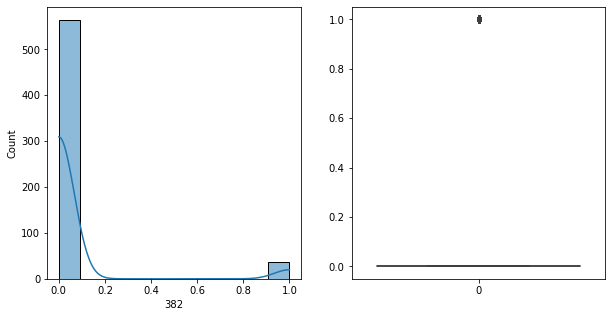

382   Unique :  [0 1]
--------------------------------------------------------------------
382   N unique :  2
--------------------------------------------------------------------
382   Value Counts :  0    564
1     36
Name: 382, dtype: int64
--------------------------------------------------------------------



[ 383 ]
show_df_info :  383


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


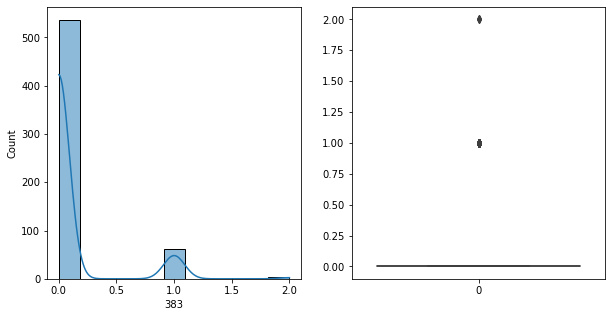

383   Unique :  [0 1 2]
--------------------------------------------------------------------
383   N unique :  3
--------------------------------------------------------------------
383   Value Counts :  0    536
1     61
2      3
Name: 383, dtype: int64
--------------------------------------------------------------------



[ 384 ]
show_df_info :  384


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


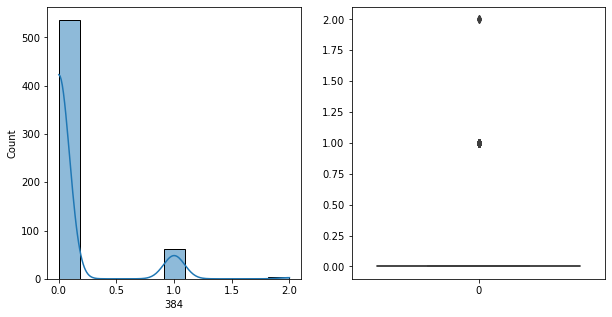

384   Unique :  [0 1 2]
--------------------------------------------------------------------
384   N unique :  3
--------------------------------------------------------------------
384   Value Counts :  0    536
1     61
2      3
Name: 384, dtype: int64
--------------------------------------------------------------------



[ 385 ]
show_df_info :  385


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


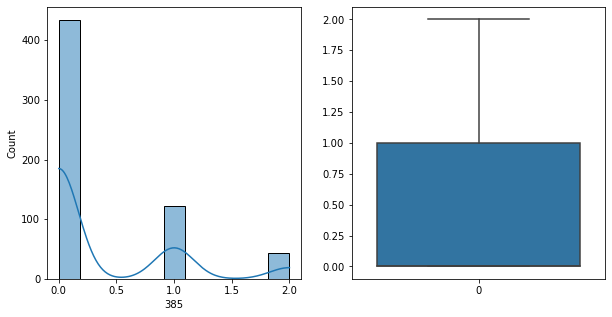

385   Unique :  [2 0 1]
--------------------------------------------------------------------
385   N unique :  3
--------------------------------------------------------------------
385   Value Counts :  0    434
1    122
2     44
Name: 385, dtype: int64
--------------------------------------------------------------------



[ 386 ]
show_df_info :  386


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


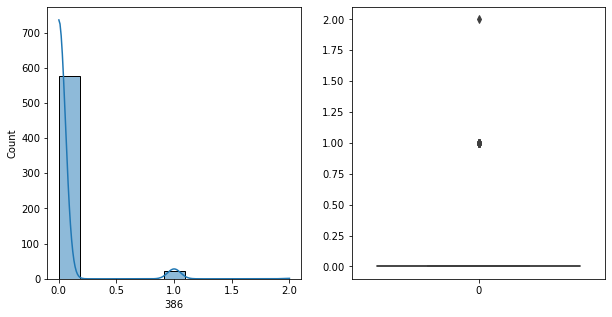

386   Unique :  [0 1 2]
--------------------------------------------------------------------
386   N unique :  3
--------------------------------------------------------------------
386   Value Counts :  0    577
1     22
2      1
Name: 386, dtype: int64
--------------------------------------------------------------------



[ 387 ]
show_df_info :  387


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


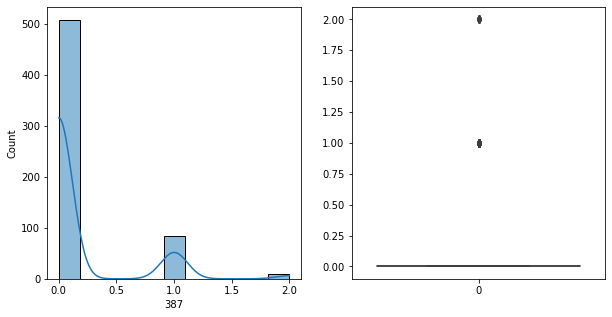

387   Unique :  [0 1 2]
--------------------------------------------------------------------
387   N unique :  3
--------------------------------------------------------------------
387   Value Counts :  0    507
1     83
2     10
Name: 387, dtype: int64
--------------------------------------------------------------------



[ 388 ]
show_df_info :  388


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


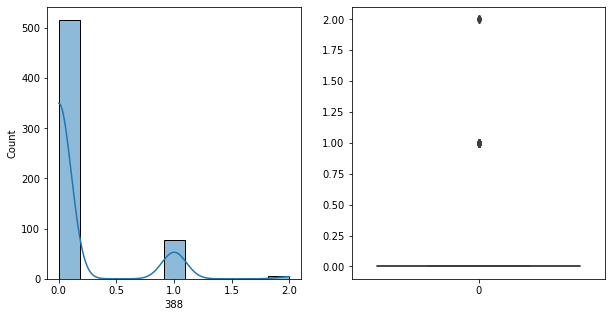

388   Unique :  [0 1 2]
--------------------------------------------------------------------
388   N unique :  3
--------------------------------------------------------------------
388   Value Counts :  0    516
1     78
2      6
Name: 388, dtype: int64
--------------------------------------------------------------------



[ 389 ]
show_df_info :  389


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


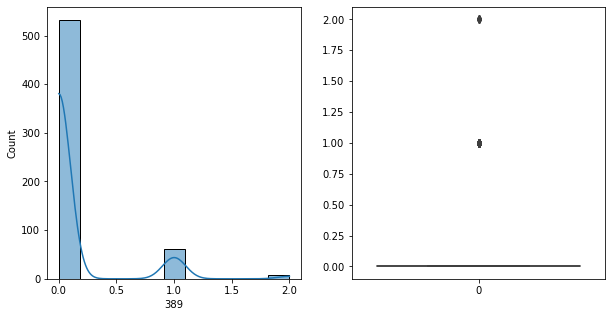

389   Unique :  [2 0 1]
--------------------------------------------------------------------
389   N unique :  3
--------------------------------------------------------------------
389   Value Counts :  0    532
1     61
2      7
Name: 389, dtype: int64
--------------------------------------------------------------------



[ 390 ]
show_df_info :  390


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


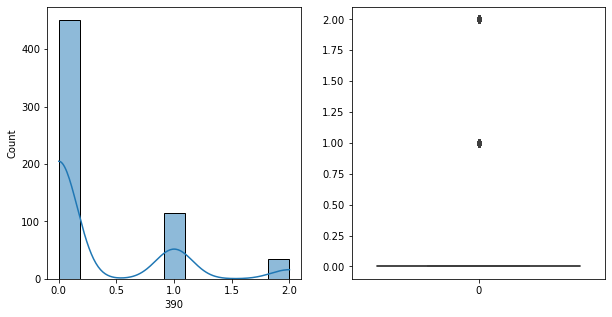

390   Unique :  [2 0 1]
--------------------------------------------------------------------
390   N unique :  3
--------------------------------------------------------------------
390   Value Counts :  0    451
1    114
2     35
Name: 390, dtype: int64
--------------------------------------------------------------------



[ 391 ]
show_df_info :  391


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


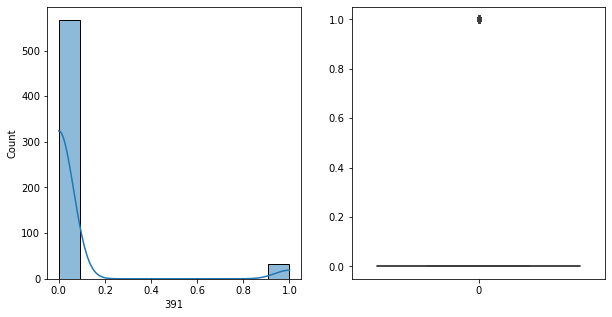

391   Unique :  [0 1]
--------------------------------------------------------------------
391   N unique :  2
--------------------------------------------------------------------
391   Value Counts :  0    567
1     33
Name: 391, dtype: int64
--------------------------------------------------------------------



[ 392 ]
show_df_info :  392


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


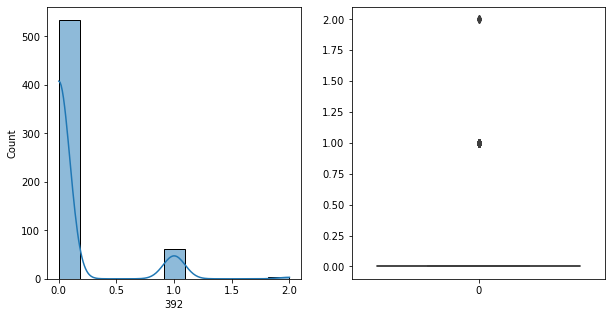

392   Unique :  [0 1 2]
--------------------------------------------------------------------
392   N unique :  3
--------------------------------------------------------------------
392   Value Counts :  0    534
1     62
2      4
Name: 392, dtype: int64
--------------------------------------------------------------------



[ 393 ]
show_df_info :  393


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


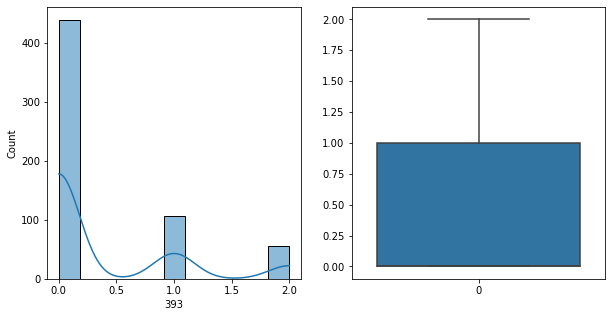

393   Unique :  [2 0 1]
--------------------------------------------------------------------
393   N unique :  3
--------------------------------------------------------------------
393   Value Counts :  0    439
1    106
2     55
Name: 393, dtype: int64
--------------------------------------------------------------------



[ 394 ]
show_df_info :  394


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


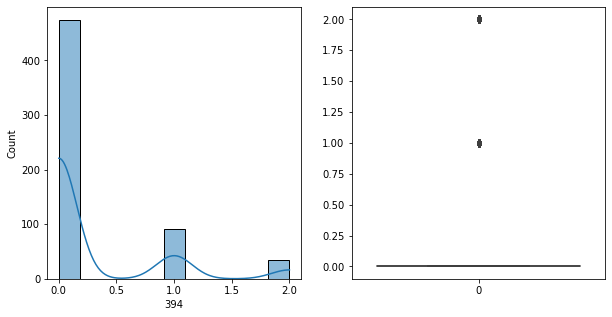

394   Unique :  [1 0 2]
--------------------------------------------------------------------
394   N unique :  3
--------------------------------------------------------------------
394   Value Counts :  0    474
1     91
2     35
Name: 394, dtype: int64
--------------------------------------------------------------------



[ 395 ]
show_df_info :  395


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


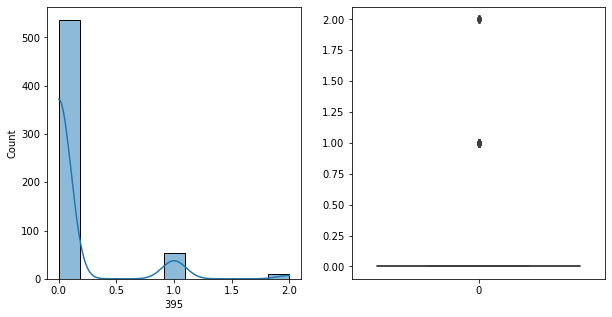

395   Unique :  [0 1 2]
--------------------------------------------------------------------
395   N unique :  3
--------------------------------------------------------------------
395   Value Counts :  0    536
1     54
2     10
Name: 395, dtype: int64
--------------------------------------------------------------------



[ 396 ]
show_df_info :  396


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


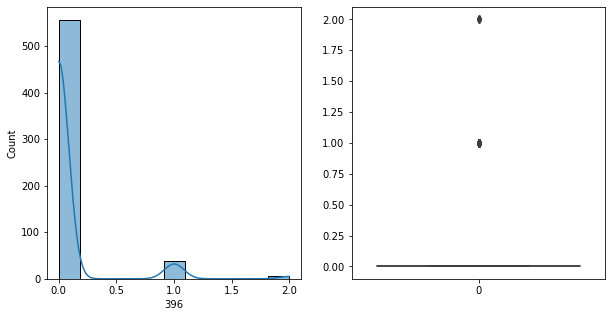

396   Unique :  [0 1 2]
--------------------------------------------------------------------
396   N unique :  3
--------------------------------------------------------------------
396   Value Counts :  0    556
1     38
2      6
Name: 396, dtype: int64
--------------------------------------------------------------------



[ 397 ]
show_df_info :  397


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


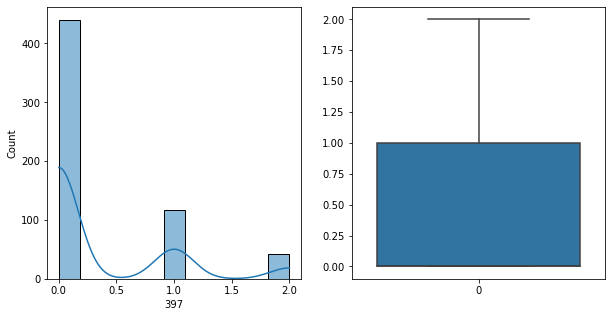

397   Unique :  [1 0 2]
--------------------------------------------------------------------
397   N unique :  3
--------------------------------------------------------------------
397   Value Counts :  0    440
1    117
2     43
Name: 397, dtype: int64
--------------------------------------------------------------------



[ 398 ]
show_df_info :  398


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


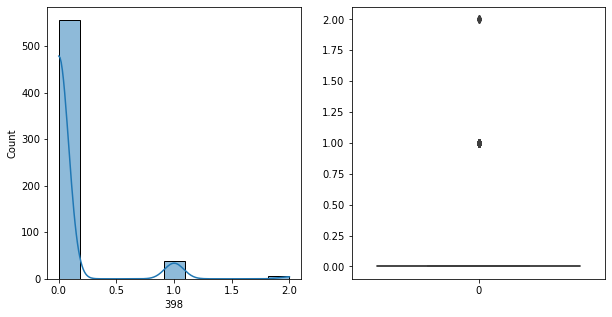

398   Unique :  [0 1 2]
--------------------------------------------------------------------
398   N unique :  3
--------------------------------------------------------------------
398   Value Counts :  0    556
1     39
2      5
Name: 398, dtype: int64
--------------------------------------------------------------------



[ 399 ]
show_df_info :  399


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


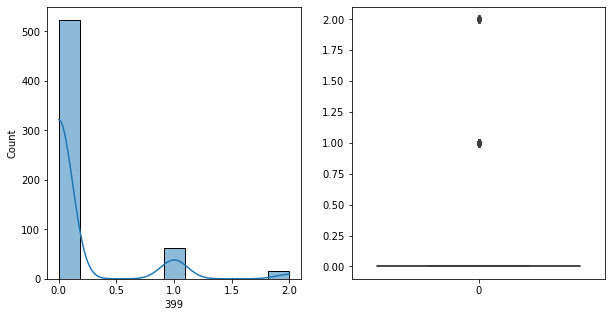

399   Unique :  [0 1 2]
--------------------------------------------------------------------
399   N unique :  3
--------------------------------------------------------------------
399   Value Counts :  0    523
1     62
2     15
Name: 399, dtype: int64
--------------------------------------------------------------------



[ 400 ]
show_df_info :  400


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


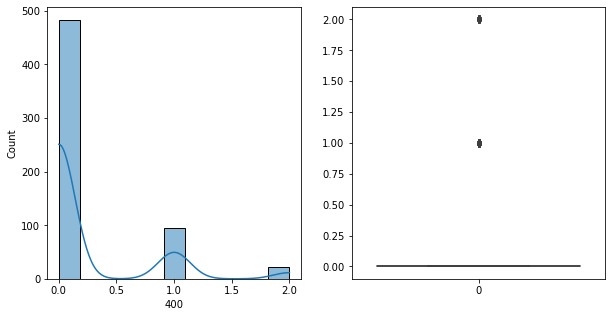

400   Unique :  [0 1 2]
--------------------------------------------------------------------
400   N unique :  3
--------------------------------------------------------------------
400   Value Counts :  0    483
1     95
2     22
Name: 400, dtype: int64
--------------------------------------------------------------------



[ 401 ]
show_df_info :  401


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


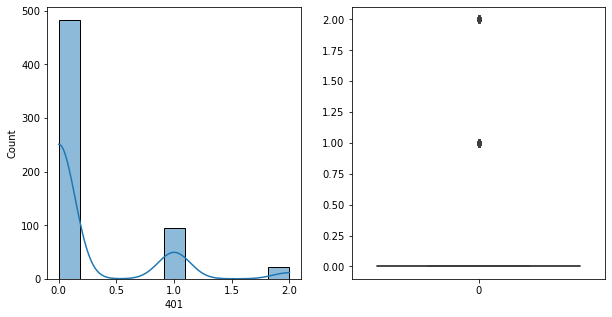

401   Unique :  [0 1 2]
--------------------------------------------------------------------
401   N unique :  3
--------------------------------------------------------------------
401   Value Counts :  0    483
1     95
2     22
Name: 401, dtype: int64
--------------------------------------------------------------------



[ 402 ]
show_df_info :  402


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


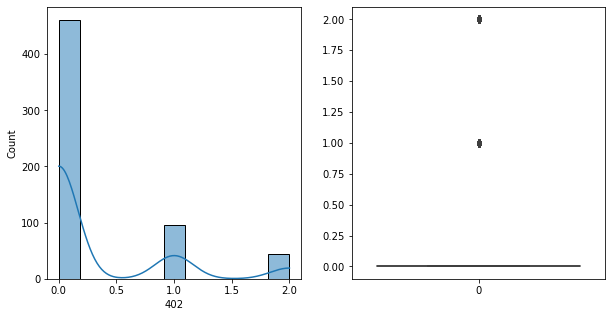

402   Unique :  [1 0 2]
--------------------------------------------------------------------
402   N unique :  3
--------------------------------------------------------------------
402   Value Counts :  0    461
1     95
2     44
Name: 402, dtype: int64
--------------------------------------------------------------------



[ 403 ]
show_df_info :  403


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


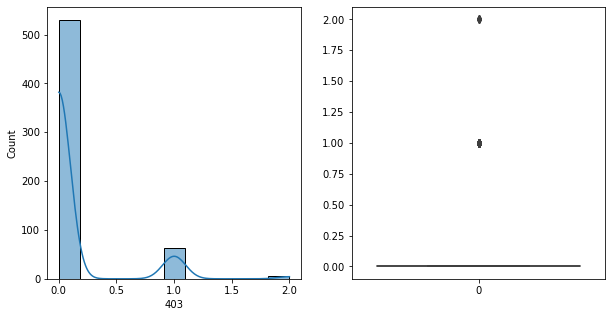

403   Unique :  [1 0 2]
--------------------------------------------------------------------
403   N unique :  3
--------------------------------------------------------------------
403   Value Counts :  0    530
1     64
2      6
Name: 403, dtype: int64
--------------------------------------------------------------------



[ 404 ]
show_df_info :  404


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


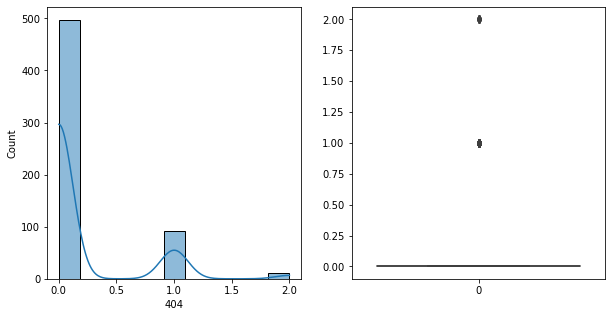

404   Unique :  [0 1 2]
--------------------------------------------------------------------
404   N unique :  3
--------------------------------------------------------------------
404   Value Counts :  0    497
1     92
2     11
Name: 404, dtype: int64
--------------------------------------------------------------------



[ 405 ]
show_df_info :  405


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


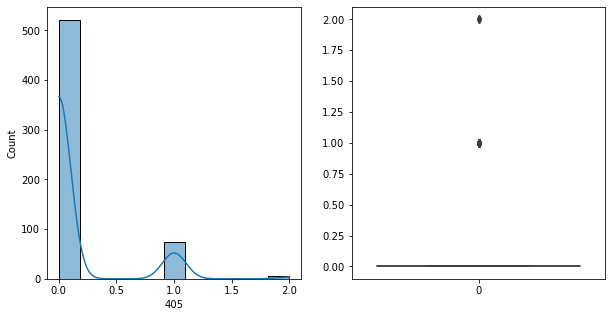

405   Unique :  [1 0 2]
--------------------------------------------------------------------
405   N unique :  3
--------------------------------------------------------------------
405   Value Counts :  0    521
1     74
2      5
Name: 405, dtype: int64
--------------------------------------------------------------------



[ 406 ]
show_df_info :  406


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


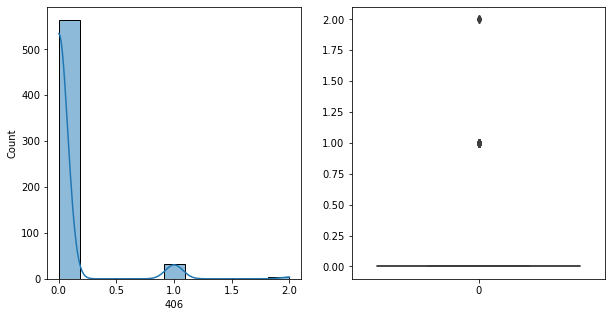

406   Unique :  [0 1 2]
--------------------------------------------------------------------
406   N unique :  3
--------------------------------------------------------------------
406   Value Counts :  0    564
1     32
2      4
Name: 406, dtype: int64
--------------------------------------------------------------------



[ 407 ]
show_df_info :  407


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


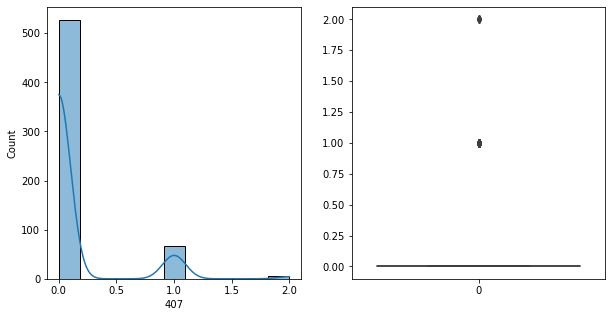

407   Unique :  [1 0 2]
--------------------------------------------------------------------
407   N unique :  3
--------------------------------------------------------------------
407   Value Counts :  0    527
1     67
2      6
Name: 407, dtype: int64
--------------------------------------------------------------------



[ 408 ]
show_df_info :  408


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


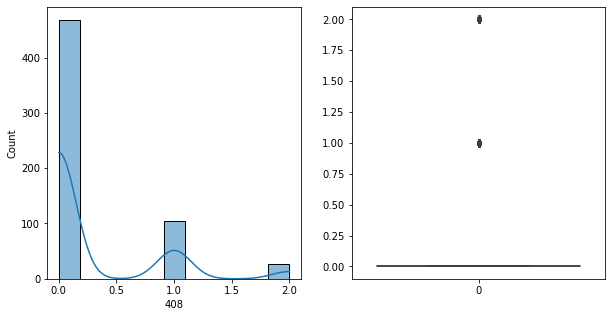

408   Unique :  [0 1 2]
--------------------------------------------------------------------
408   N unique :  3
--------------------------------------------------------------------
408   Value Counts :  0    468
1    105
2     27
Name: 408, dtype: int64
--------------------------------------------------------------------



[ 409 ]
show_df_info :  409


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


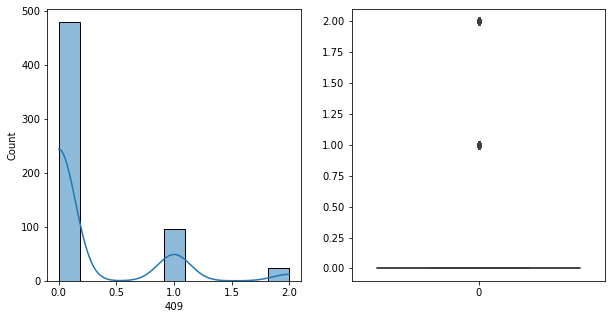

409   Unique :  [0 1 2]
--------------------------------------------------------------------
409   N unique :  3
--------------------------------------------------------------------
409   Value Counts :  0    480
1     96
2     24
Name: 409, dtype: int64
--------------------------------------------------------------------



[ 410 ]
show_df_info :  410


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


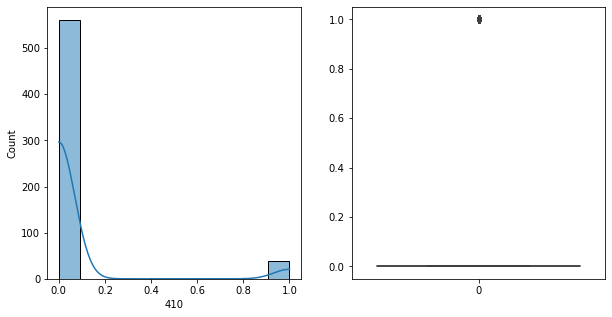

410   Unique :  [0 1]
--------------------------------------------------------------------
410   N unique :  2
--------------------------------------------------------------------
410   Value Counts :  0    561
1     39
Name: 410, dtype: int64
--------------------------------------------------------------------



[ 411 ]
show_df_info :  411


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


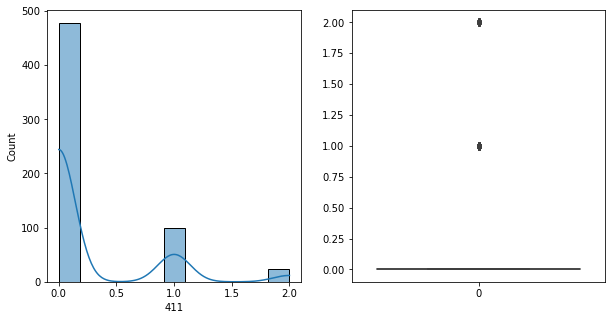

411   Unique :  [0 1 2]
--------------------------------------------------------------------
411   N unique :  3
--------------------------------------------------------------------
411   Value Counts :  0    478
1     99
2     23
Name: 411, dtype: int64
--------------------------------------------------------------------



[ 412 ]
show_df_info :  412


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


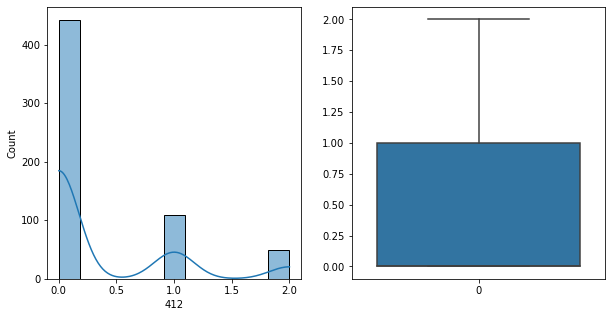

412   Unique :  [0 1 2]
--------------------------------------------------------------------
412   N unique :  3
--------------------------------------------------------------------
412   Value Counts :  0    442
1    109
2     49
Name: 412, dtype: int64
--------------------------------------------------------------------



[ 413 ]
show_df_info :  413


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


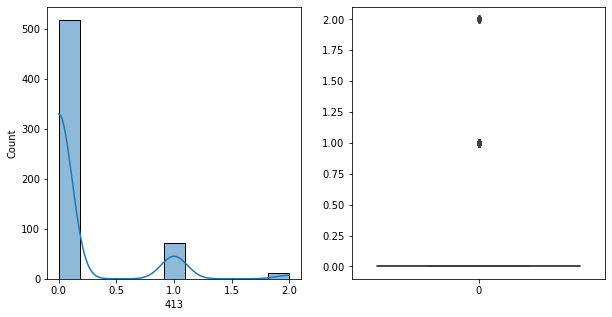

413   Unique :  [1 0 2]
--------------------------------------------------------------------
413   N unique :  3
--------------------------------------------------------------------
413   Value Counts :  0    518
1     71
2     11
Name: 413, dtype: int64
--------------------------------------------------------------------



[ 414 ]
show_df_info :  414


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


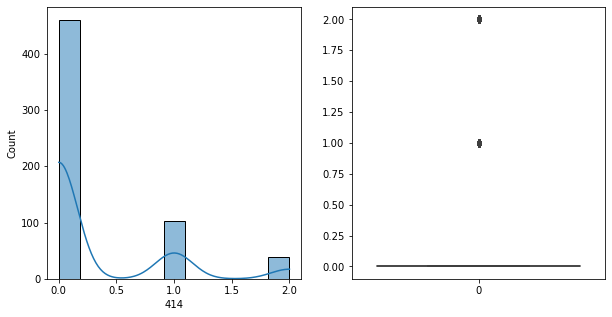

414   Unique :  [2 0 1]
--------------------------------------------------------------------
414   N unique :  3
--------------------------------------------------------------------
414   Value Counts :  0    460
1    102
2     38
Name: 414, dtype: int64
--------------------------------------------------------------------



[ 415 ]
show_df_info :  415


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


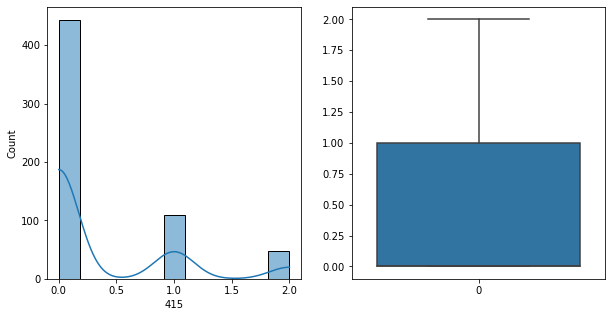

415   Unique :  [2 0 1]
--------------------------------------------------------------------
415   N unique :  3
--------------------------------------------------------------------
415   Value Counts :  0    443
1    110
2     47
Name: 415, dtype: int64
--------------------------------------------------------------------



[ 416 ]
show_df_info :  416


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


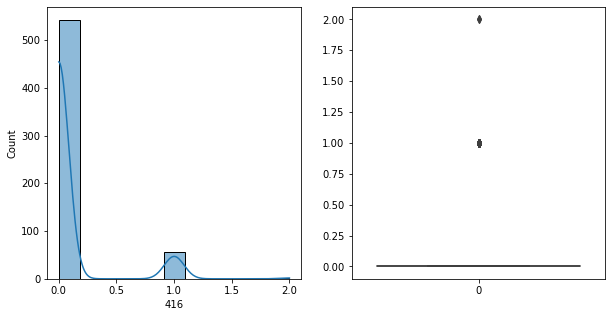

416   Unique :  [1 0 2]
--------------------------------------------------------------------
416   N unique :  3
--------------------------------------------------------------------
416   Value Counts :  0    542
1     56
2      2
Name: 416, dtype: int64
--------------------------------------------------------------------



[ 417 ]
show_df_info :  417


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


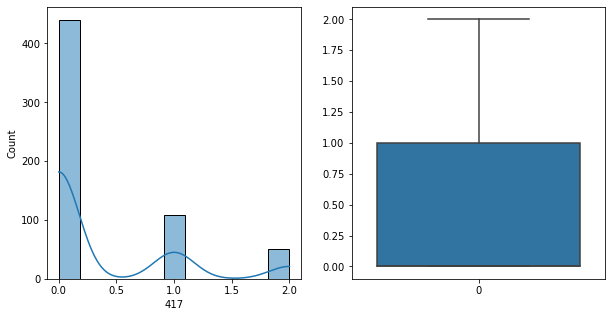

417   Unique :  [2 0 1]
--------------------------------------------------------------------
417   N unique :  3
--------------------------------------------------------------------
417   Value Counts :  0    440
1    109
2     51
Name: 417, dtype: int64
--------------------------------------------------------------------



[ 418 ]
show_df_info :  418


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


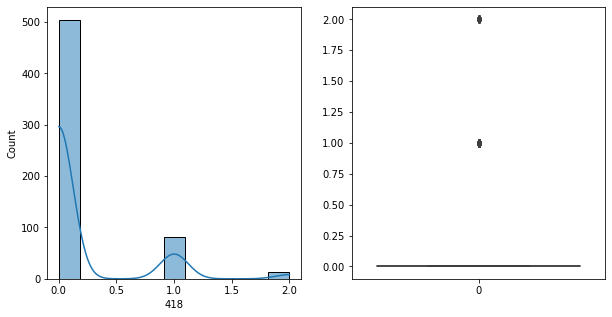

418   Unique :  [1 0 2]
--------------------------------------------------------------------
418   N unique :  3
--------------------------------------------------------------------
418   Value Counts :  0    504
1     82
2     14
Name: 418, dtype: int64
--------------------------------------------------------------------



[ 419 ]
show_df_info :  419


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


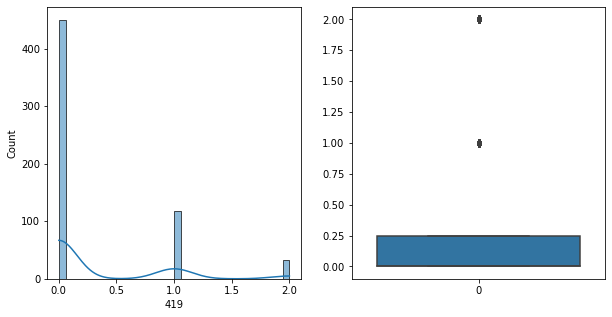

419   Unique :  [1 0 2]
--------------------------------------------------------------------
419   N unique :  3
--------------------------------------------------------------------
419   Value Counts :  0    450
1    117
2     33
Name: 419, dtype: int64
--------------------------------------------------------------------



[ 420 ]
show_df_info :  420


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


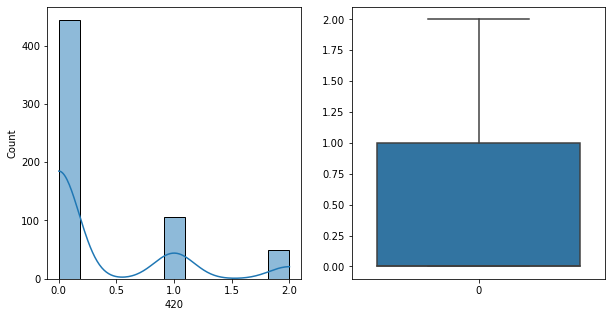

420   Unique :  [0 1 2]
--------------------------------------------------------------------
420   N unique :  3
--------------------------------------------------------------------
420   Value Counts :  0    444
1    106
2     50
Name: 420, dtype: int64
--------------------------------------------------------------------



[ 421 ]
show_df_info :  421


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


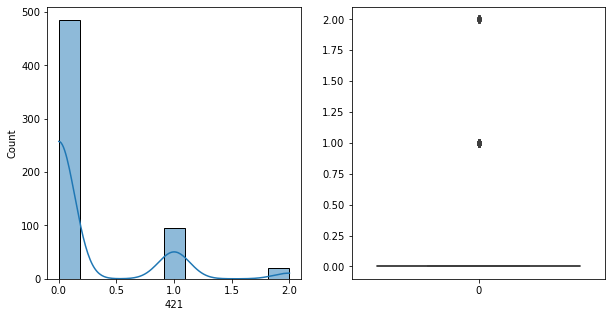

421   Unique :  [0 1 2]
--------------------------------------------------------------------
421   N unique :  3
--------------------------------------------------------------------
421   Value Counts :  0    485
1     95
2     20
Name: 421, dtype: int64
--------------------------------------------------------------------



[ 422 ]
show_df_info :  422


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


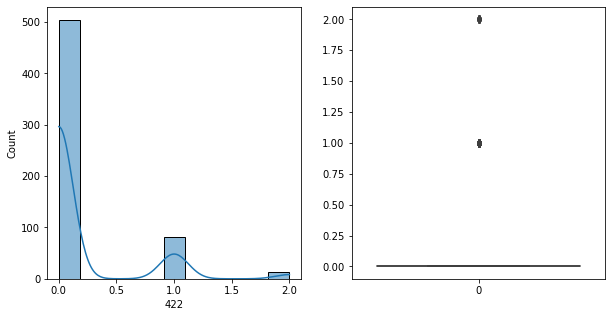

422   Unique :  [1 0 2]
--------------------------------------------------------------------
422   N unique :  3
--------------------------------------------------------------------
422   Value Counts :  0    504
1     82
2     14
Name: 422, dtype: int64
--------------------------------------------------------------------



[ 423 ]
show_df_info :  423


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


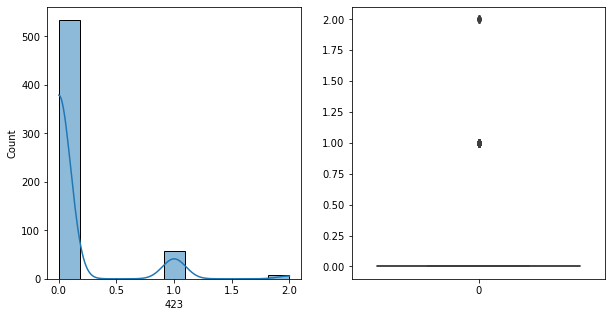

423   Unique :  [0 1 2]
--------------------------------------------------------------------
423   N unique :  3
--------------------------------------------------------------------
423   Value Counts :  0    534
1     58
2      8
Name: 423, dtype: int64
--------------------------------------------------------------------



[ 424 ]
show_df_info :  424


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


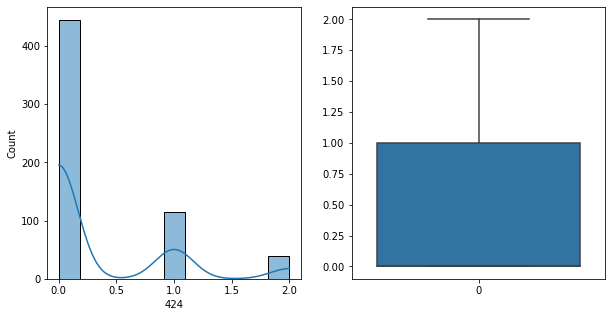

424   Unique :  [1 0 2]
--------------------------------------------------------------------
424   N unique :  3
--------------------------------------------------------------------
424   Value Counts :  0    445
1    115
2     40
Name: 424, dtype: int64
--------------------------------------------------------------------



[ 425 ]
show_df_info :  425


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


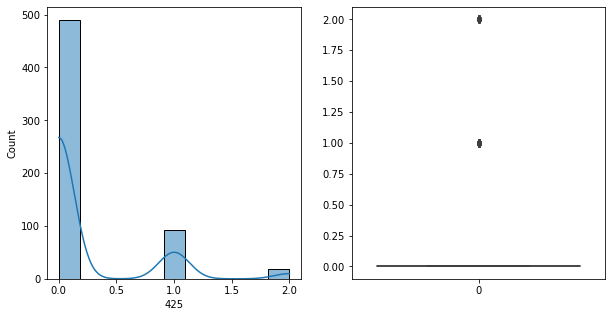

425   Unique :  [0 1 2]
--------------------------------------------------------------------
425   N unique :  3
--------------------------------------------------------------------
425   Value Counts :  0    490
1     92
2     18
Name: 425, dtype: int64
--------------------------------------------------------------------



[ 426 ]
show_df_info :  426


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


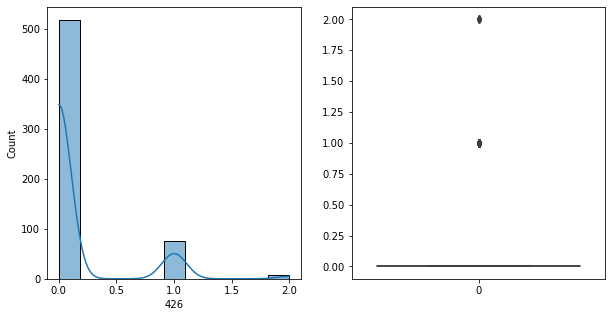

426   Unique :  [0 1 2]
--------------------------------------------------------------------
426   N unique :  3
--------------------------------------------------------------------
426   Value Counts :  0    518
1     75
2      7
Name: 426, dtype: int64
--------------------------------------------------------------------



[ 427 ]
show_df_info :  427


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


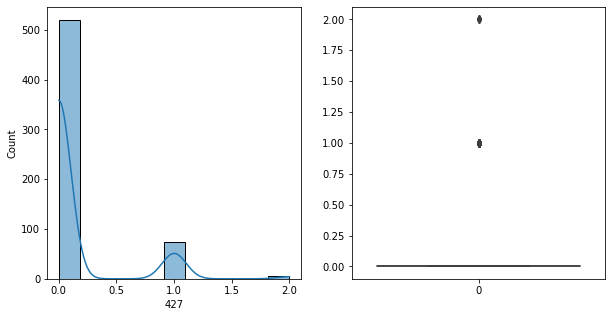

427   Unique :  [0 1 2]
--------------------------------------------------------------------
427   N unique :  3
--------------------------------------------------------------------
427   Value Counts :  0    520
1     74
2      6
Name: 427, dtype: int64
--------------------------------------------------------------------



[ 428 ]
show_df_info :  428


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


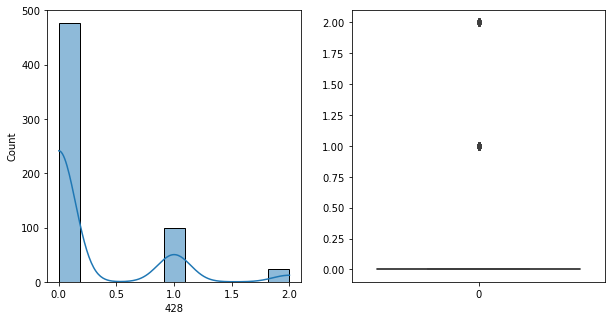

428   Unique :  [0 1 2]
--------------------------------------------------------------------
428   N unique :  3
--------------------------------------------------------------------
428   Value Counts :  0    477
1     99
2     24
Name: 428, dtype: int64
--------------------------------------------------------------------



[ 429 ]
show_df_info :  429


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


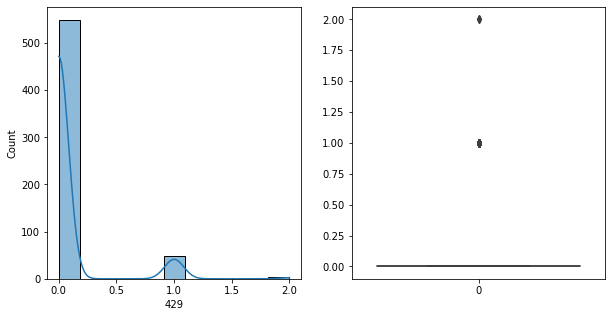

429   Unique :  [1 0 2]
--------------------------------------------------------------------
429   N unique :  3
--------------------------------------------------------------------
429   Value Counts :  0    549
1     48
2      3
Name: 429, dtype: int64
--------------------------------------------------------------------



[ 430 ]
show_df_info :  430


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


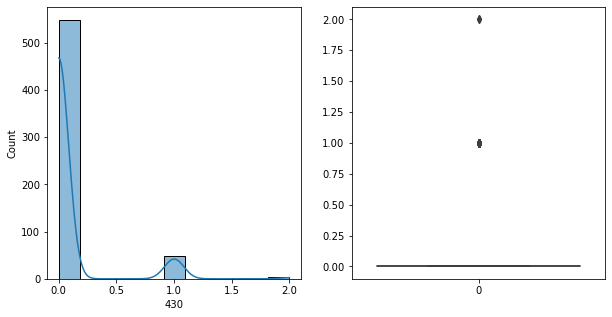

430   Unique :  [1 0 2]
--------------------------------------------------------------------
430   N unique :  3
--------------------------------------------------------------------
430   Value Counts :  0    548
1     49
2      3
Name: 430, dtype: int64
--------------------------------------------------------------------



[ 431 ]
show_df_info :  431


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


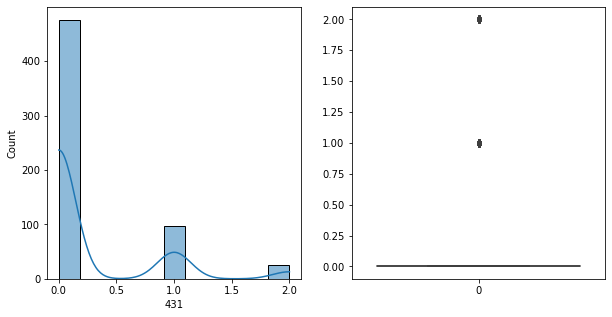

431   Unique :  [1 0 2]
--------------------------------------------------------------------
431   N unique :  3
--------------------------------------------------------------------
431   Value Counts :  0    476
1     98
2     26
Name: 431, dtype: int64
--------------------------------------------------------------------



[ 432 ]
show_df_info :  432


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


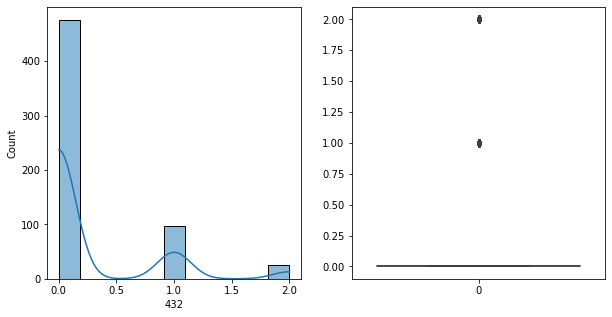

432   Unique :  [1 0 2]
--------------------------------------------------------------------
432   N unique :  3
--------------------------------------------------------------------
432   Value Counts :  0    476
1     98
2     26
Name: 432, dtype: int64
--------------------------------------------------------------------



[ 433 ]
show_df_info :  433


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


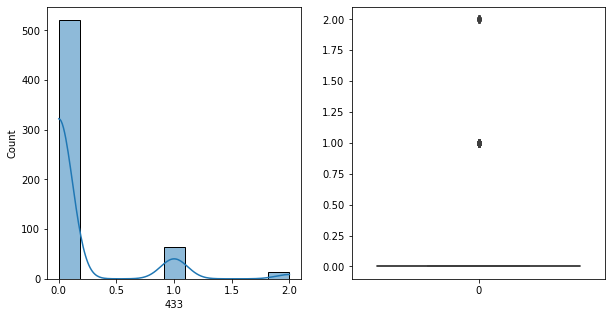

433   Unique :  [0 1 2]
--------------------------------------------------------------------
433   N unique :  3
--------------------------------------------------------------------
433   Value Counts :  0    521
1     65
2     14
Name: 433, dtype: int64
--------------------------------------------------------------------



[ 434 ]
show_df_info :  434


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


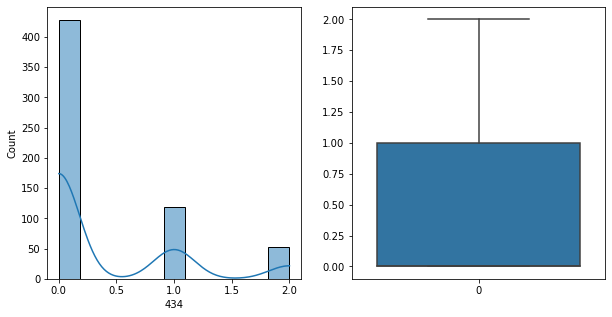

434   Unique :  [2 0 1]
--------------------------------------------------------------------
434   N unique :  3
--------------------------------------------------------------------
434   Value Counts :  0    428
1    119
2     53
Name: 434, dtype: int64
--------------------------------------------------------------------



[ 435 ]
show_df_info :  435


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


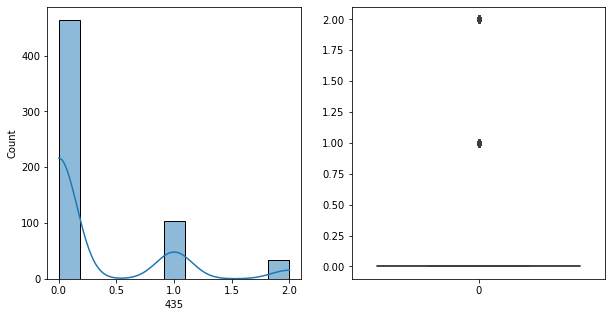

435   Unique :  [1 0 2]
--------------------------------------------------------------------
435   N unique :  3
--------------------------------------------------------------------
435   Value Counts :  0    464
1    103
2     33
Name: 435, dtype: int64
--------------------------------------------------------------------



[ 436 ]
show_df_info :  436


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


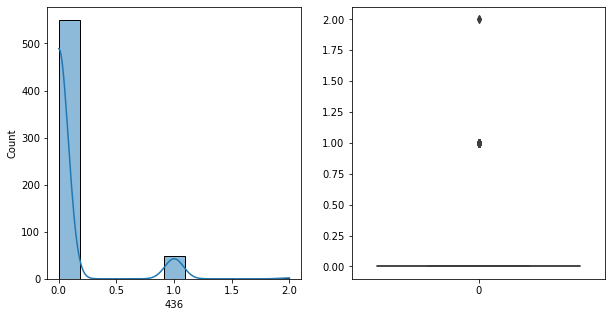

436   Unique :  [1 0 2]
--------------------------------------------------------------------
436   N unique :  3
--------------------------------------------------------------------
436   Value Counts :  0    550
1     48
2      2
Name: 436, dtype: int64
--------------------------------------------------------------------



[ 437 ]
show_df_info :  437


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


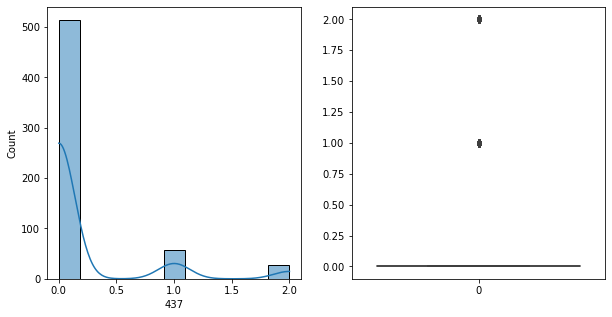

437   Unique :  [1 0 2]
--------------------------------------------------------------------
437   N unique :  3
--------------------------------------------------------------------
437   Value Counts :  0    514
1     58
2     28
Name: 437, dtype: int64
--------------------------------------------------------------------



[ 438 ]
show_df_info :  438


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


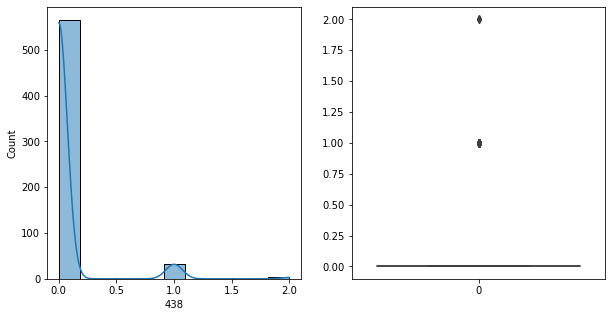

438   Unique :  [0 1 2]
--------------------------------------------------------------------
438   N unique :  3
--------------------------------------------------------------------
438   Value Counts :  0    565
1     32
2      3
Name: 438, dtype: int64
--------------------------------------------------------------------



[ 439 ]
show_df_info :  439


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


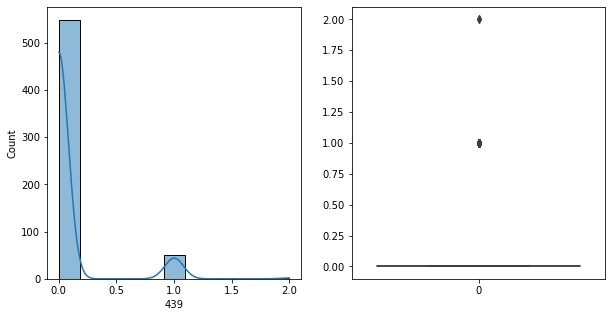

439   Unique :  [1 0 2]
--------------------------------------------------------------------
439   N unique :  3
--------------------------------------------------------------------
439   Value Counts :  0    548
1     50
2      2
Name: 439, dtype: int64
--------------------------------------------------------------------



[ 440 ]
show_df_info :  440


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


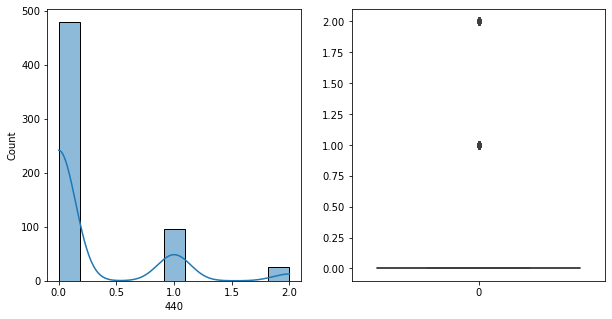

440   Unique :  [1 0 2]
--------------------------------------------------------------------
440   N unique :  3
--------------------------------------------------------------------
440   Value Counts :  0    479
1     96
2     25
Name: 440, dtype: int64
--------------------------------------------------------------------



[ 441 ]
show_df_info :  441


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


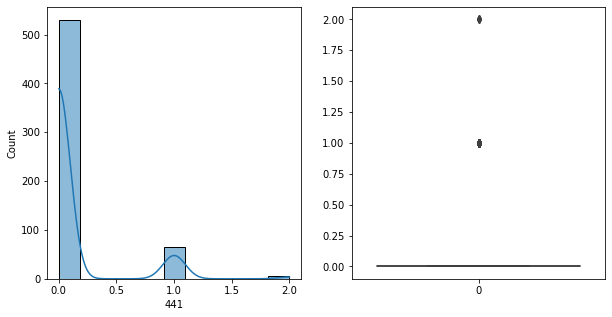

441   Unique :  [0 1 2]
--------------------------------------------------------------------
441   N unique :  3
--------------------------------------------------------------------
441   Value Counts :  0    530
1     65
2      5
Name: 441, dtype: int64
--------------------------------------------------------------------



[ 442 ]
show_df_info :  442


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


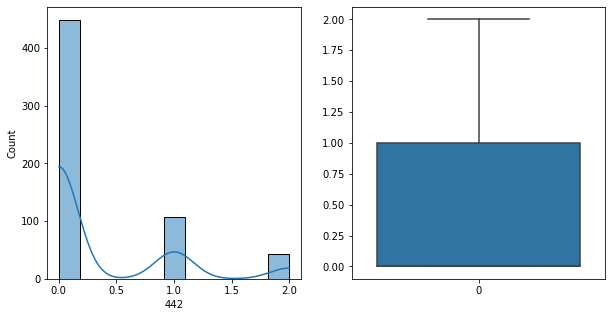

442   Unique :  [1 0 2]
--------------------------------------------------------------------
442   N unique :  3
--------------------------------------------------------------------
442   Value Counts :  0    449
1    108
2     43
Name: 442, dtype: int64
--------------------------------------------------------------------



[ 443 ]
show_df_info :  443


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


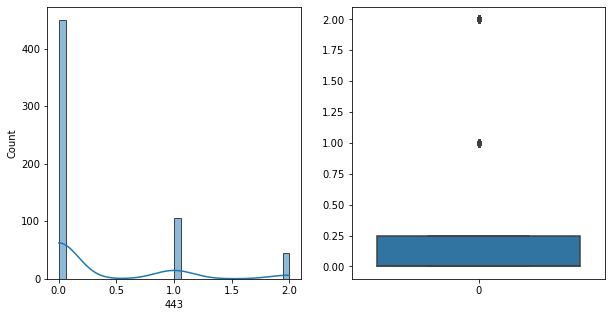

443   Unique :  [1 0 2]
--------------------------------------------------------------------
443   N unique :  3
--------------------------------------------------------------------
443   Value Counts :  0    450
1    105
2     45
Name: 443, dtype: int64
--------------------------------------------------------------------



[ 444 ]
show_df_info :  444


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


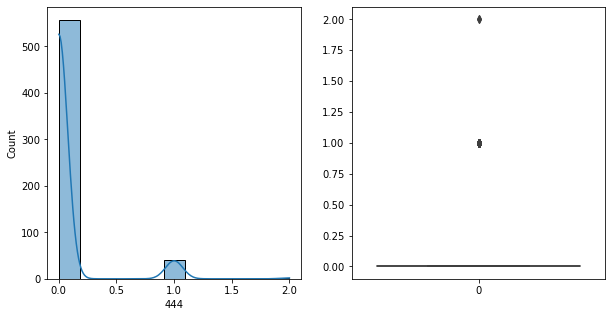

444   Unique :  [0 1 2]
--------------------------------------------------------------------
444   N unique :  3
--------------------------------------------------------------------
444   Value Counts :  0    557
1     41
2      2
Name: 444, dtype: int64
--------------------------------------------------------------------



[ 445 ]
show_df_info :  445


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


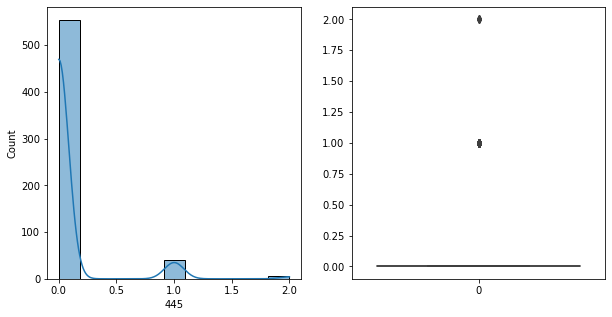

445   Unique :  [0 1 2]
--------------------------------------------------------------------
445   N unique :  3
--------------------------------------------------------------------
445   Value Counts :  0    554
1     41
2      5
Name: 445, dtype: int64
--------------------------------------------------------------------



[ 446 ]
show_df_info :  446


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


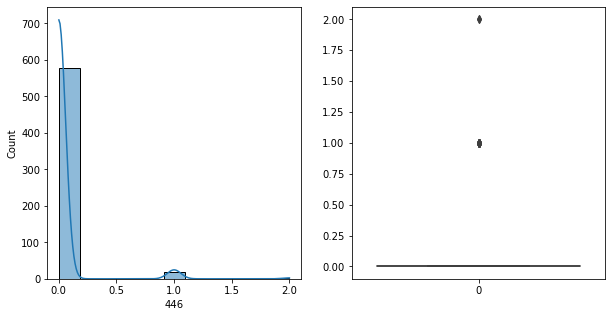

446   Unique :  [0 1 2]
--------------------------------------------------------------------
446   N unique :  3
--------------------------------------------------------------------
446   Value Counts :  0    578
1     20
2      2
Name: 446, dtype: int64
--------------------------------------------------------------------



[ 447 ]
show_df_info :  447


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


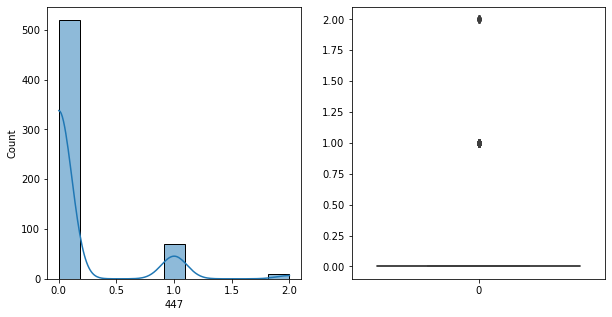

447   Unique :  [1 0 2]
--------------------------------------------------------------------
447   N unique :  3
--------------------------------------------------------------------
447   Value Counts :  0    520
1     70
2     10
Name: 447, dtype: int64
--------------------------------------------------------------------



[ 448 ]
show_df_info :  448


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


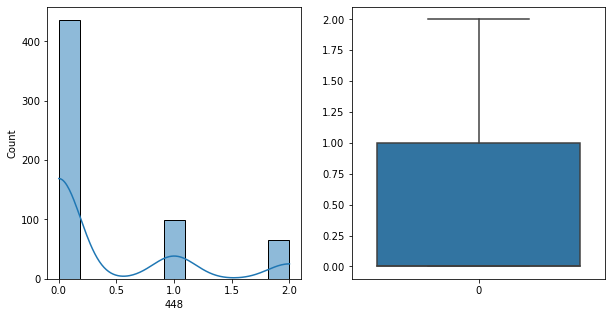

448   Unique :  [0 2 1]
--------------------------------------------------------------------
448   N unique :  3
--------------------------------------------------------------------
448   Value Counts :  0    436
1     99
2     65
Name: 448, dtype: int64
--------------------------------------------------------------------



[ 449 ]
show_df_info :  449


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


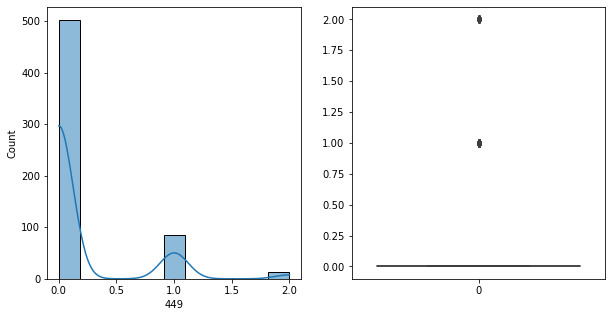

449   Unique :  [0 1 2]
--------------------------------------------------------------------
449   N unique :  3
--------------------------------------------------------------------
449   Value Counts :  0    502
1     85
2     13
Name: 449, dtype: int64
--------------------------------------------------------------------



[ 450 ]
show_df_info :  450


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


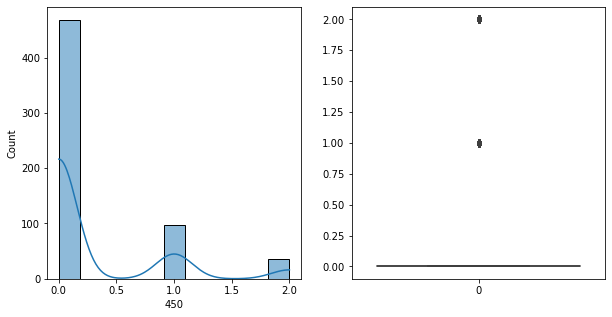

450   Unique :  [2 0 1]
--------------------------------------------------------------------
450   N unique :  3
--------------------------------------------------------------------
450   Value Counts :  0    468
1     97
2     35
Name: 450, dtype: int64
--------------------------------------------------------------------



[ 451 ]
show_df_info :  451


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


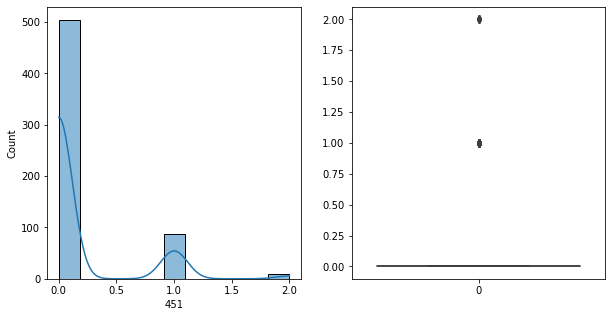

451   Unique :  [0 1 2]
--------------------------------------------------------------------
451   N unique :  3
--------------------------------------------------------------------
451   Value Counts :  0    504
1     87
2      9
Name: 451, dtype: int64
--------------------------------------------------------------------



[ 452 ]
show_df_info :  452


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


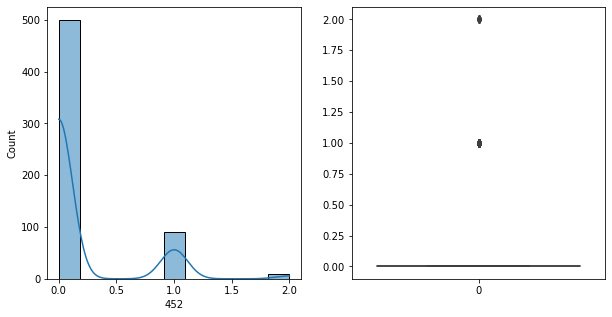

452   Unique :  [0 1 2]
--------------------------------------------------------------------
452   N unique :  3
--------------------------------------------------------------------
452   Value Counts :  0    500
1     91
2      9
Name: 452, dtype: int64
--------------------------------------------------------------------



[ 453 ]
show_df_info :  453


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


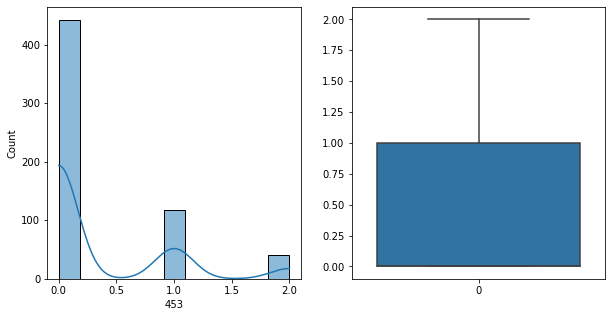

453   Unique :  [1 0 2]
--------------------------------------------------------------------
453   N unique :  3
--------------------------------------------------------------------
453   Value Counts :  0    442
1    118
2     40
Name: 453, dtype: int64
--------------------------------------------------------------------



[ 454 ]
show_df_info :  454


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


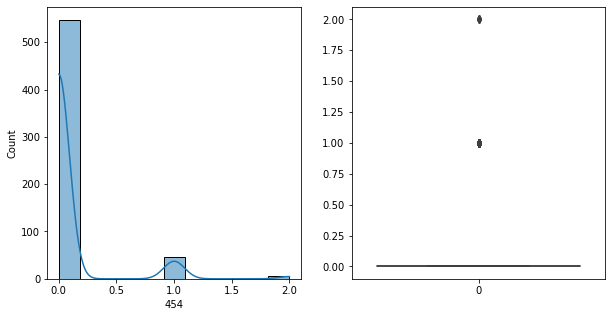

454   Unique :  [0 1 2]
--------------------------------------------------------------------
454   N unique :  3
--------------------------------------------------------------------
454   Value Counts :  0    547
1     47
2      6
Name: 454, dtype: int64
--------------------------------------------------------------------



[ 455 ]
show_df_info :  455


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


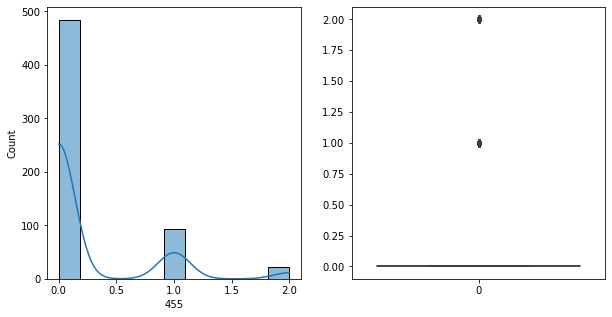

455   Unique :  [0 1 2]
--------------------------------------------------------------------
455   N unique :  3
--------------------------------------------------------------------
455   Value Counts :  0    484
1     94
2     22
Name: 455, dtype: int64
--------------------------------------------------------------------



[ 456 ]
show_df_info :  456


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


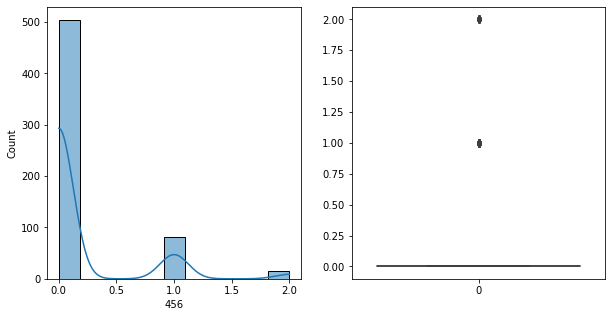

456   Unique :  [0 1 2]
--------------------------------------------------------------------
456   N unique :  3
--------------------------------------------------------------------
456   Value Counts :  0    504
1     81
2     15
Name: 456, dtype: int64
--------------------------------------------------------------------



[ 457 ]
show_df_info :  457


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


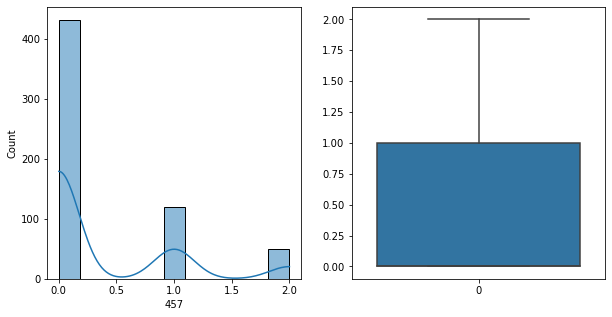

457   Unique :  [1 0 2]
--------------------------------------------------------------------
457   N unique :  3
--------------------------------------------------------------------
457   Value Counts :  0    432
1    119
2     49
Name: 457, dtype: int64
--------------------------------------------------------------------



[ 458 ]
show_df_info :  458


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


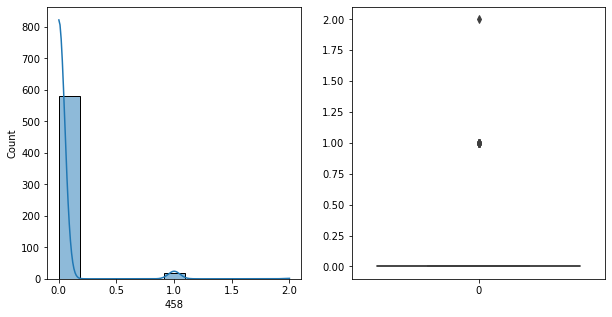

458   Unique :  [0 1 2]
--------------------------------------------------------------------
458   N unique :  3
--------------------------------------------------------------------
458   Value Counts :  0    582
1     17
2      1
Name: 458, dtype: int64
--------------------------------------------------------------------



[ 459 ]
show_df_info :  459


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


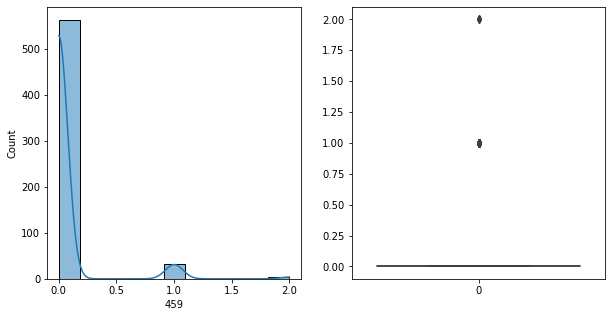

459   Unique :  [0 1 2]
--------------------------------------------------------------------
459   N unique :  3
--------------------------------------------------------------------
459   Value Counts :  0    563
1     33
2      4
Name: 459, dtype: int64
--------------------------------------------------------------------



[ 460 ]
show_df_info :  460


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


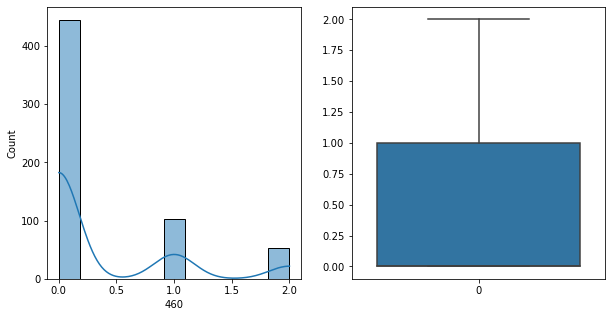

460   Unique :  [1 0 2]
--------------------------------------------------------------------
460   N unique :  3
--------------------------------------------------------------------
460   Value Counts :  0    445
1    102
2     53
Name: 460, dtype: int64
--------------------------------------------------------------------



[ 461 ]
show_df_info :  461


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


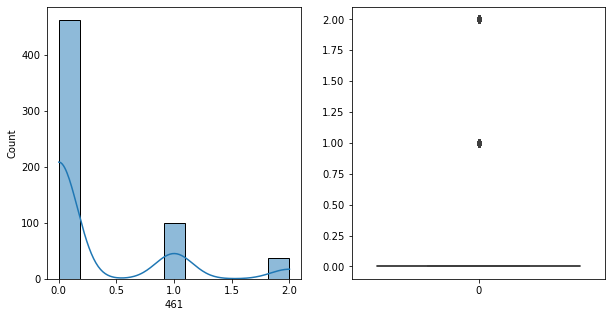

461   Unique :  [1 0 2]
--------------------------------------------------------------------
461   N unique :  3
--------------------------------------------------------------------
461   Value Counts :  0    462
1    100
2     38
Name: 461, dtype: int64
--------------------------------------------------------------------



[ 462 ]
show_df_info :  462


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


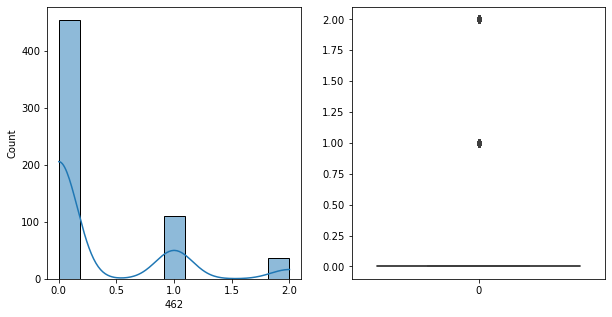

462   Unique :  [1 0 2]
--------------------------------------------------------------------
462   N unique :  3
--------------------------------------------------------------------
462   Value Counts :  0    454
1    110
2     36
Name: 462, dtype: int64
--------------------------------------------------------------------



[ 463 ]
show_df_info :  463


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


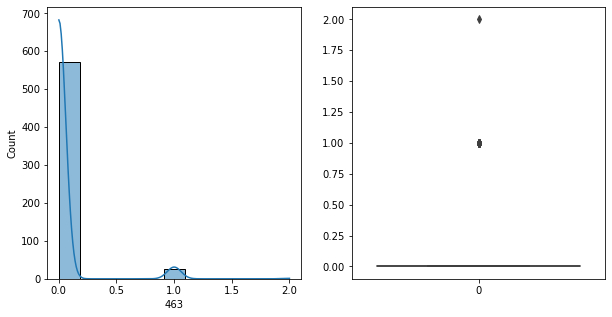

463   Unique :  [0 1 2]
--------------------------------------------------------------------
463   N unique :  3
--------------------------------------------------------------------
463   Value Counts :  0    573
1     26
2      1
Name: 463, dtype: int64
--------------------------------------------------------------------



[ 464 ]
show_df_info :  464


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


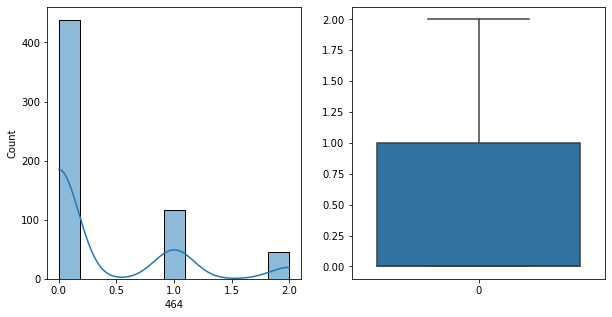

464   Unique :  [0 2 1]
--------------------------------------------------------------------
464   N unique :  3
--------------------------------------------------------------------
464   Value Counts :  0    438
1    116
2     46
Name: 464, dtype: int64
--------------------------------------------------------------------



[ 465 ]
show_df_info :  465


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


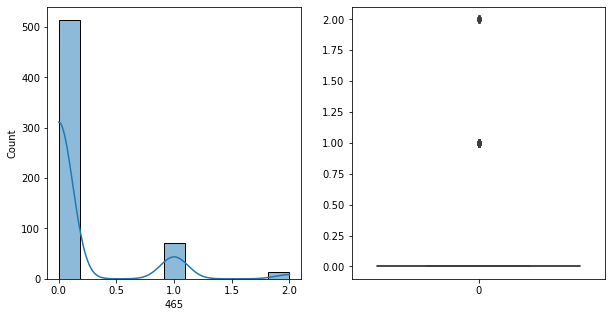

465   Unique :  [1 0 2]
--------------------------------------------------------------------
465   N unique :  3
--------------------------------------------------------------------
465   Value Counts :  0    514
1     72
2     14
Name: 465, dtype: int64
--------------------------------------------------------------------



[ 466 ]
show_df_info :  466


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


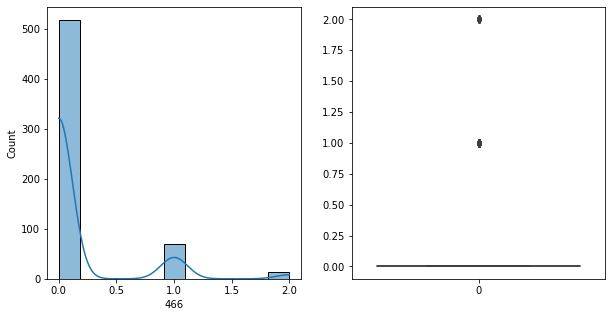

466   Unique :  [1 0 2]
--------------------------------------------------------------------
466   N unique :  3
--------------------------------------------------------------------
466   Value Counts :  0    518
1     69
2     13
Name: 466, dtype: int64
--------------------------------------------------------------------



[ 467 ]
show_df_info :  467


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


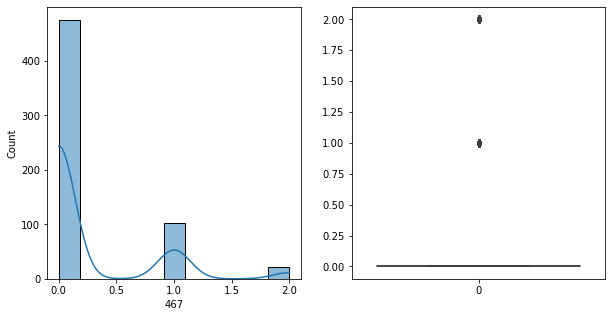

467   Unique :  [1 0 2]
--------------------------------------------------------------------
467   N unique :  3
--------------------------------------------------------------------
467   Value Counts :  0    475
1    103
2     22
Name: 467, dtype: int64
--------------------------------------------------------------------



[ 468 ]
show_df_info :  468


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


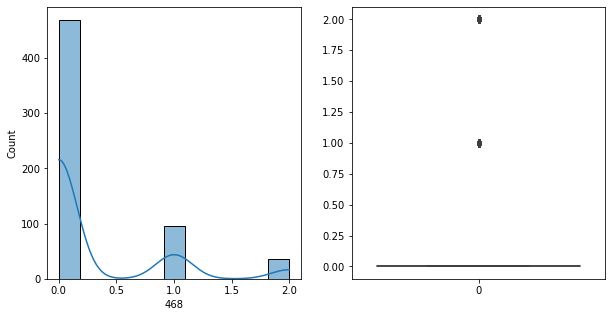

468   Unique :  [1 0 2]
--------------------------------------------------------------------
468   N unique :  3
--------------------------------------------------------------------
468   Value Counts :  0    469
1     95
2     36
Name: 468, dtype: int64
--------------------------------------------------------------------



[ 469 ]
show_df_info :  469


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


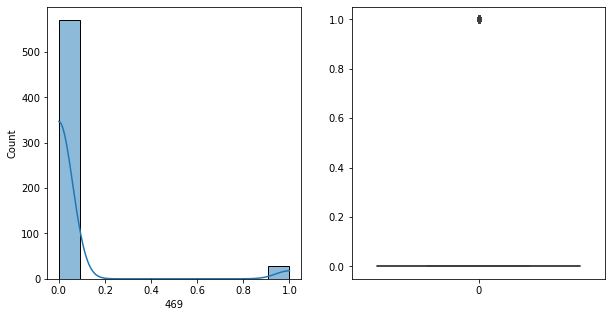

469   Unique :  [1 0]
--------------------------------------------------------------------
469   N unique :  2
--------------------------------------------------------------------
469   Value Counts :  0    571
1     29
Name: 469, dtype: int64
--------------------------------------------------------------------



[ 470 ]
show_df_info :  470


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


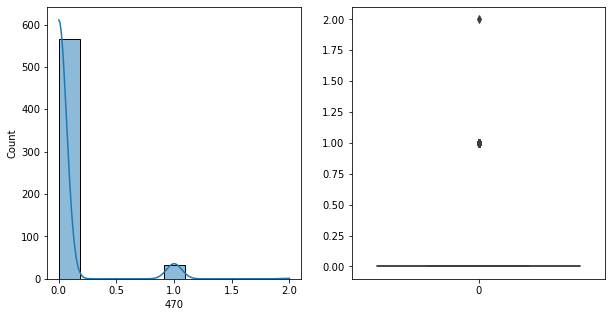

470   Unique :  [1 0 2]
--------------------------------------------------------------------
470   N unique :  3
--------------------------------------------------------------------
470   Value Counts :  0    566
1     33
2      1
Name: 470, dtype: int64
--------------------------------------------------------------------



[ 471 ]
show_df_info :  471


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


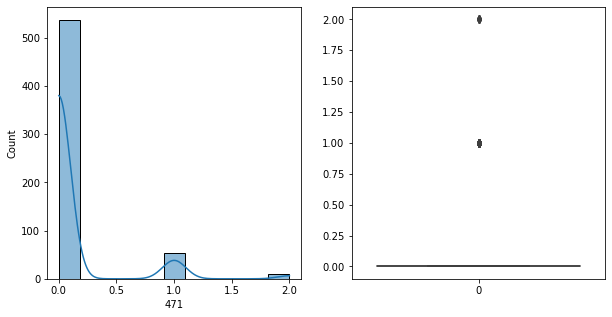

471   Unique :  [0 1 2]
--------------------------------------------------------------------
471   N unique :  3
--------------------------------------------------------------------
471   Value Counts :  0    537
1     54
2      9
Name: 471, dtype: int64
--------------------------------------------------------------------



[ 472 ]
show_df_info :  472


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


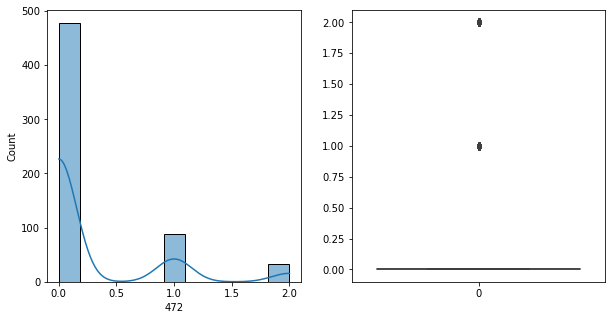

472   Unique :  [1 0 2]
--------------------------------------------------------------------
472   N unique :  3
--------------------------------------------------------------------
472   Value Counts :  0    478
1     89
2     33
Name: 472, dtype: int64
--------------------------------------------------------------------



[ 473 ]
show_df_info :  473


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


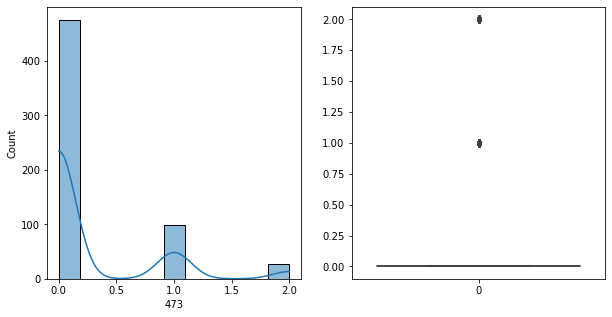

473   Unique :  [1 0 2]
--------------------------------------------------------------------
473   N unique :  3
--------------------------------------------------------------------
473   Value Counts :  0    475
1     98
2     27
Name: 473, dtype: int64
--------------------------------------------------------------------



[ 474 ]
show_df_info :  474


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


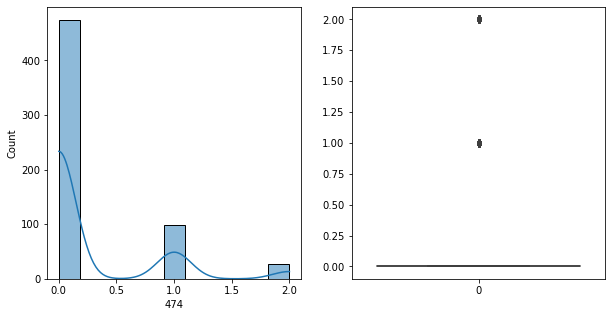

474   Unique :  [1 0 2]
--------------------------------------------------------------------
474   N unique :  3
--------------------------------------------------------------------
474   Value Counts :  0    474
1     99
2     27
Name: 474, dtype: int64
--------------------------------------------------------------------



[ 475 ]
show_df_info :  475


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


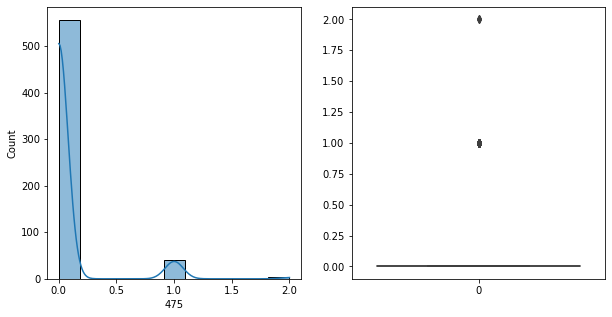

475   Unique :  [0 1 2]
--------------------------------------------------------------------
475   N unique :  3
--------------------------------------------------------------------
475   Value Counts :  0    556
1     41
2      3
Name: 475, dtype: int64
--------------------------------------------------------------------



[ 476 ]
show_df_info :  476


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


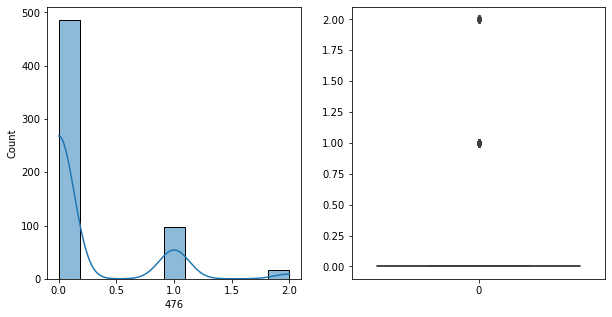

476   Unique :  [0 1 2]
--------------------------------------------------------------------
476   N unique :  3
--------------------------------------------------------------------
476   Value Counts :  0    486
1     98
2     16
Name: 476, dtype: int64
--------------------------------------------------------------------



[ 477 ]
show_df_info :  477


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


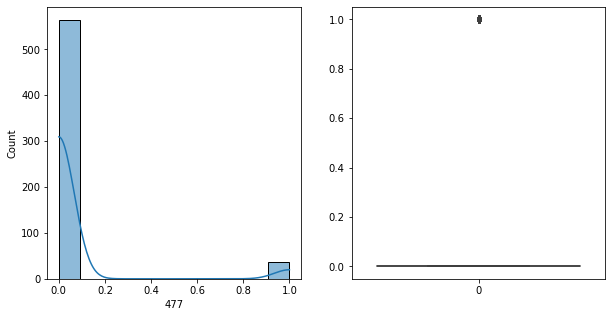

477   Unique :  [0 1]
--------------------------------------------------------------------
477   N unique :  2
--------------------------------------------------------------------
477   Value Counts :  0    564
1     36
Name: 477, dtype: int64
--------------------------------------------------------------------



[ 478 ]
show_df_info :  478


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


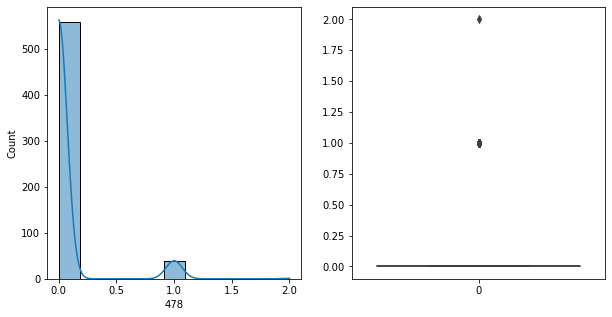

478   Unique :  [0 1 2]
--------------------------------------------------------------------
478   N unique :  3
--------------------------------------------------------------------
478   Value Counts :  0    560
1     39
2      1
Name: 478, dtype: int64
--------------------------------------------------------------------



[ 479 ]
show_df_info :  479


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


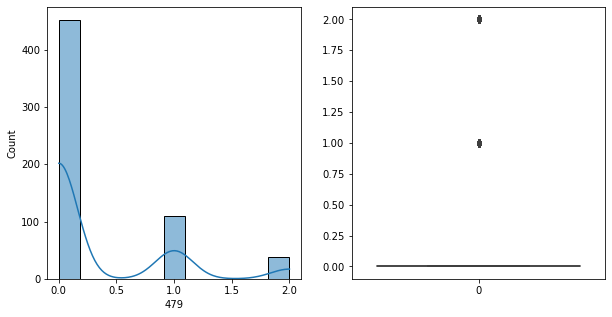

479   Unique :  [1 0 2]
--------------------------------------------------------------------
479   N unique :  3
--------------------------------------------------------------------
479   Value Counts :  0    452
1    110
2     38
Name: 479, dtype: int64
--------------------------------------------------------------------



[ 480 ]
show_df_info :  480


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


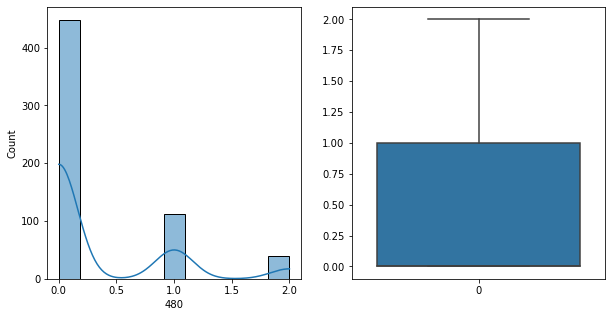

480   Unique :  [1 0 2]
--------------------------------------------------------------------
480   N unique :  3
--------------------------------------------------------------------
480   Value Counts :  0    448
1    113
2     39
Name: 480, dtype: int64
--------------------------------------------------------------------



[ 481 ]
show_df_info :  481


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


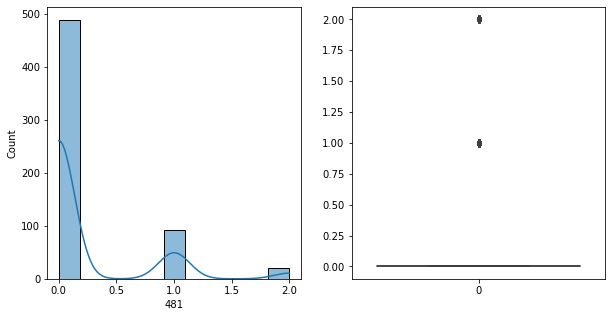

481   Unique :  [1 0 2]
--------------------------------------------------------------------
481   N unique :  3
--------------------------------------------------------------------
481   Value Counts :  0    488
1     92
2     20
Name: 481, dtype: int64
--------------------------------------------------------------------



[ 482 ]
show_df_info :  482


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


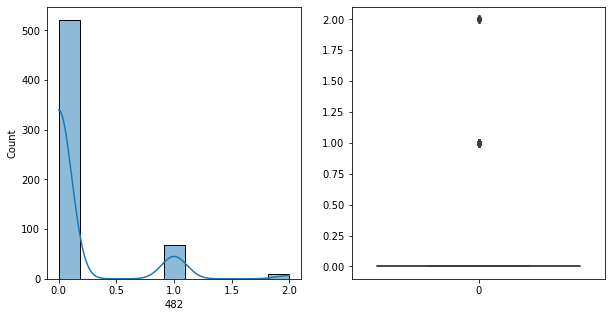

482   Unique :  [1 0 2]
--------------------------------------------------------------------
482   N unique :  3
--------------------------------------------------------------------
482   Value Counts :  0    521
1     69
2     10
Name: 482, dtype: int64
--------------------------------------------------------------------



[ 483 ]
show_df_info :  483


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


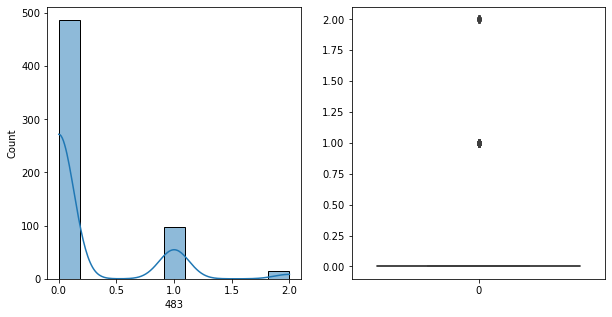

483   Unique :  [0 1 2]
--------------------------------------------------------------------
483   N unique :  3
--------------------------------------------------------------------
483   Value Counts :  0    487
1     98
2     15
Name: 483, dtype: int64
--------------------------------------------------------------------



[ 484 ]
show_df_info :  484


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


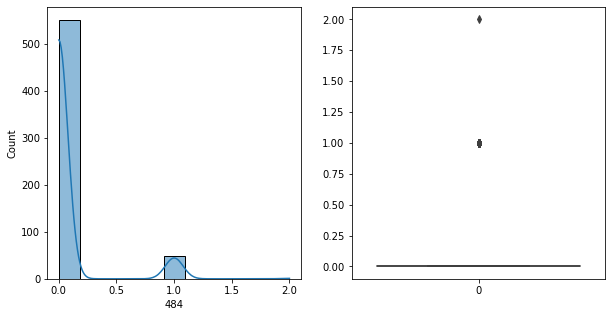

484   Unique :  [0 1 2]
--------------------------------------------------------------------
484   N unique :  3
--------------------------------------------------------------------
484   Value Counts :  0    551
1     48
2      1
Name: 484, dtype: int64
--------------------------------------------------------------------



[ 485 ]
show_df_info :  485


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


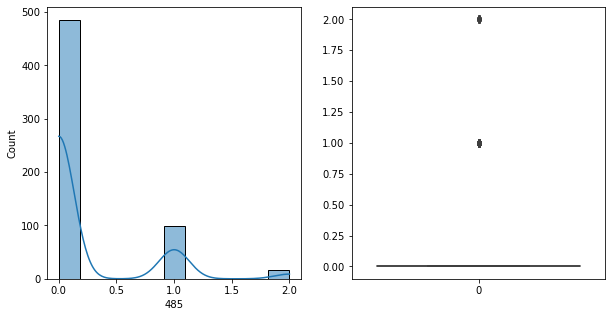

485   Unique :  [0 1 2]
--------------------------------------------------------------------
485   N unique :  3
--------------------------------------------------------------------
485   Value Counts :  0    485
1     99
2     16
Name: 485, dtype: int64
--------------------------------------------------------------------



[ 486 ]
show_df_info :  486


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


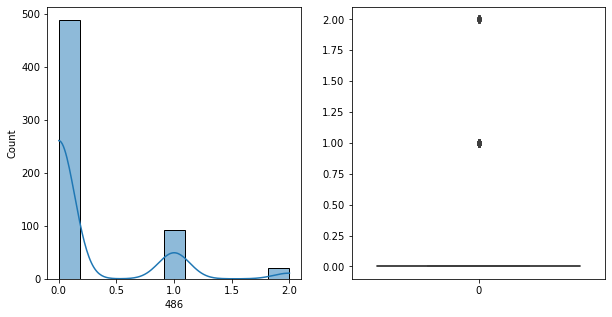

486   Unique :  [1 0 2]
--------------------------------------------------------------------
486   N unique :  3
--------------------------------------------------------------------
486   Value Counts :  0    488
1     92
2     20
Name: 486, dtype: int64
--------------------------------------------------------------------



[ 487 ]
show_df_info :  487


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


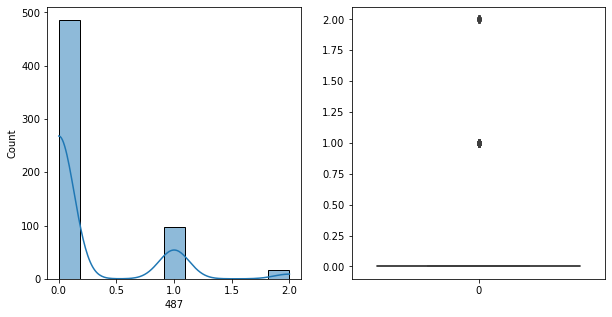

487   Unique :  [0 1 2]
--------------------------------------------------------------------
487   N unique :  3
--------------------------------------------------------------------
487   Value Counts :  0    486
1     98
2     16
Name: 487, dtype: int64
--------------------------------------------------------------------



[ 488 ]
show_df_info :  488


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


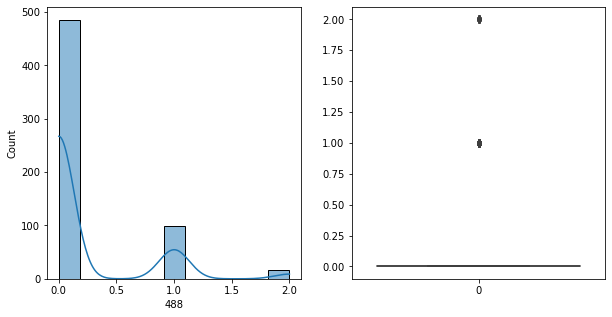

488   Unique :  [0 1 2]
--------------------------------------------------------------------
488   N unique :  3
--------------------------------------------------------------------
488   Value Counts :  0    485
1     99
2     16
Name: 488, dtype: int64
--------------------------------------------------------------------



[ 489 ]
show_df_info :  489


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


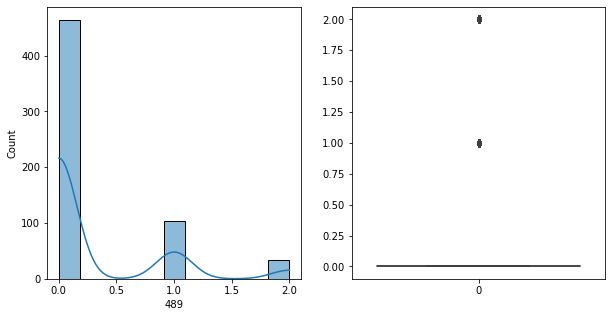

489   Unique :  [1 0 2]
--------------------------------------------------------------------
489   N unique :  3
--------------------------------------------------------------------
489   Value Counts :  0    464
1    103
2     33
Name: 489, dtype: int64
--------------------------------------------------------------------



[ 490 ]
show_df_info :  490


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


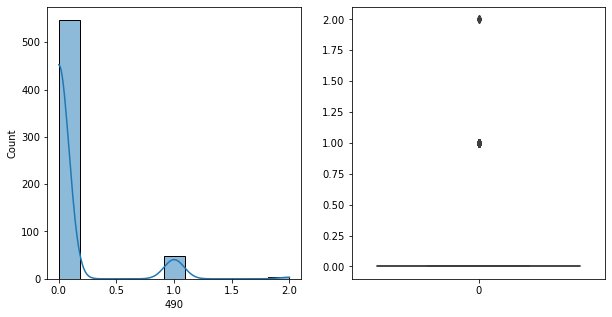

490   Unique :  [0 1 2]
--------------------------------------------------------------------
490   N unique :  3
--------------------------------------------------------------------
490   Value Counts :  0    547
1     49
2      4
Name: 490, dtype: int64
--------------------------------------------------------------------



[ 491 ]
show_df_info :  491


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


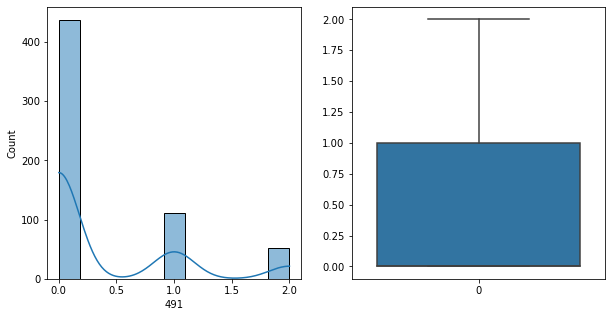

491   Unique :  [1 0 2]
--------------------------------------------------------------------
491   N unique :  3
--------------------------------------------------------------------
491   Value Counts :  0    437
1    111
2     52
Name: 491, dtype: int64
--------------------------------------------------------------------



[ 492 ]
show_df_info :  492


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


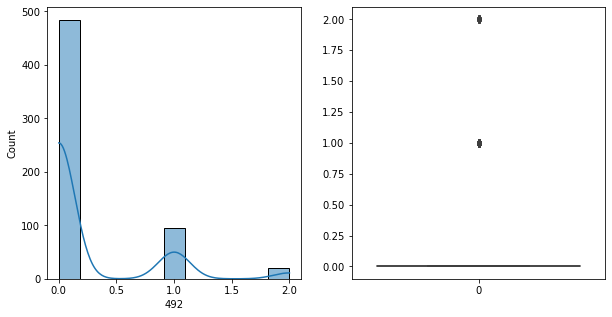

492   Unique :  [1 0 2]
--------------------------------------------------------------------
492   N unique :  3
--------------------------------------------------------------------
492   Value Counts :  0    484
1     95
2     21
Name: 492, dtype: int64
--------------------------------------------------------------------



[ 493 ]
show_df_info :  493


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


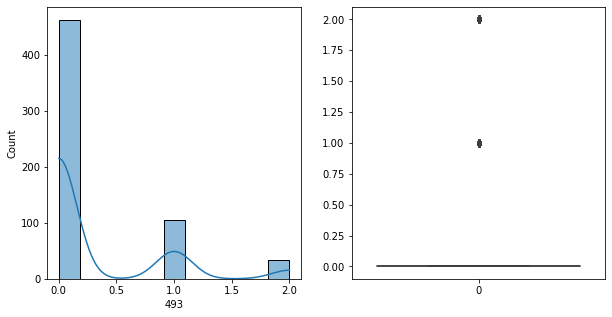

493   Unique :  [1 0 2]
--------------------------------------------------------------------
493   N unique :  3
--------------------------------------------------------------------
493   Value Counts :  0    462
1    105
2     33
Name: 493, dtype: int64
--------------------------------------------------------------------



[ 494 ]
show_df_info :  494


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


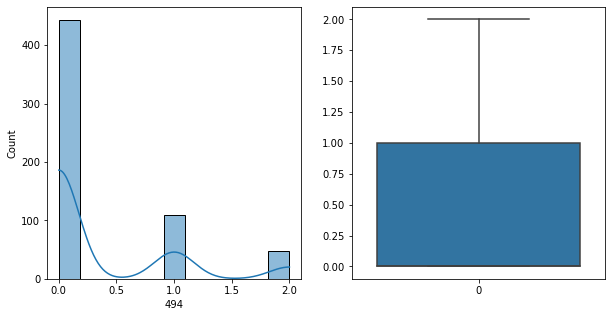

494   Unique :  [1 0 2]
--------------------------------------------------------------------
494   N unique :  3
--------------------------------------------------------------------
494   Value Counts :  0    443
1    109
2     48
Name: 494, dtype: int64
--------------------------------------------------------------------



[ 495 ]
show_df_info :  495


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


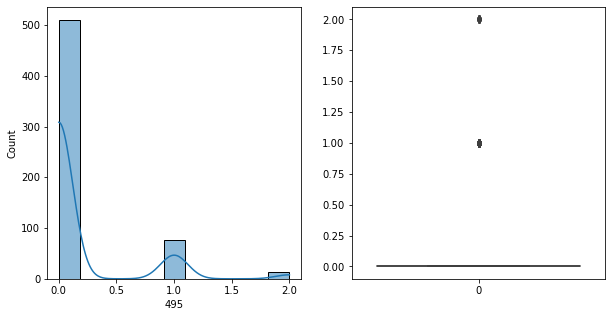

495   Unique :  [0 1 2]
--------------------------------------------------------------------
495   N unique :  3
--------------------------------------------------------------------
495   Value Counts :  0    510
1     77
2     13
Name: 495, dtype: int64
--------------------------------------------------------------------



[ 496 ]
show_df_info :  496


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


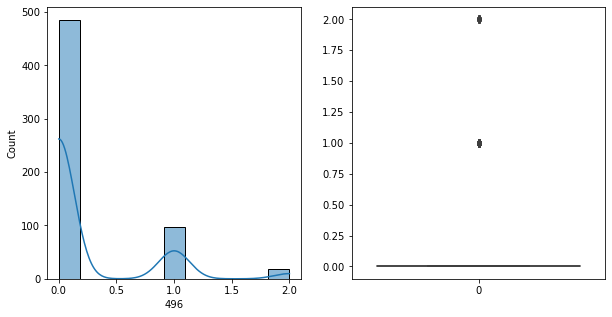

496   Unique :  [1 0 2]
--------------------------------------------------------------------
496   N unique :  3
--------------------------------------------------------------------
496   Value Counts :  0    485
1     97
2     18
Name: 496, dtype: int64
--------------------------------------------------------------------



[ 497 ]
show_df_info :  497


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


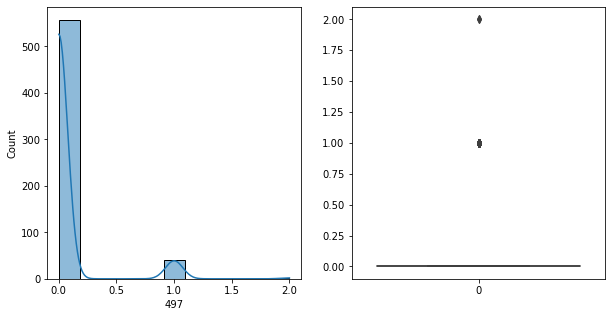

497   Unique :  [1 0 2]
--------------------------------------------------------------------
497   N unique :  3
--------------------------------------------------------------------
497   Value Counts :  0    557
1     41
2      2
Name: 497, dtype: int64
--------------------------------------------------------------------



[ 498 ]
show_df_info :  498


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


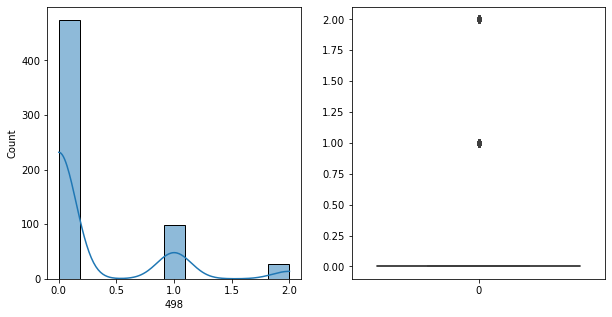

498   Unique :  [1 0 2]
--------------------------------------------------------------------
498   N unique :  3
--------------------------------------------------------------------
498   Value Counts :  0    474
1     98
2     28
Name: 498, dtype: int64
--------------------------------------------------------------------



[ 499 ]
show_df_info :  499


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


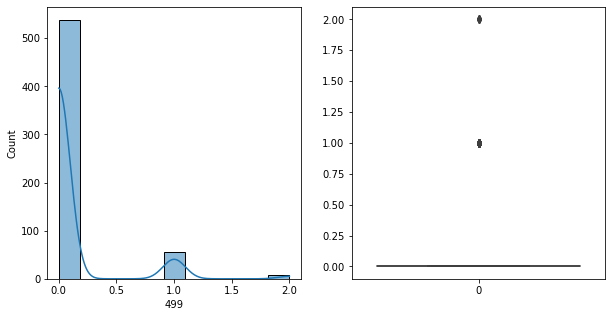

499   Unique :  [0 1 2]
--------------------------------------------------------------------
499   N unique :  3
--------------------------------------------------------------------
499   Value Counts :  0    538
1     55
2      7
Name: 499, dtype: int64
--------------------------------------------------------------------



[ 500 ]
show_df_info :  500


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


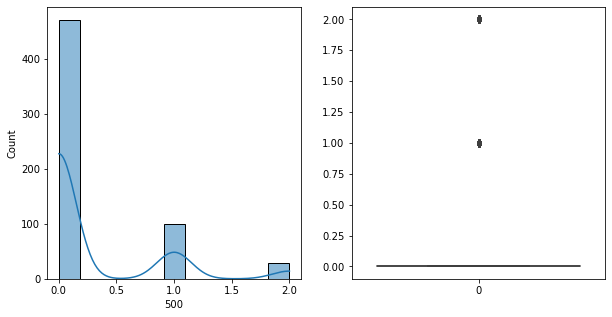

500   Unique :  [1 0 2]
--------------------------------------------------------------------
500   N unique :  3
--------------------------------------------------------------------
500   Value Counts :  0    471
1    100
2     29
Name: 500, dtype: int64
--------------------------------------------------------------------



[ 501 ]
show_df_info :  501


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


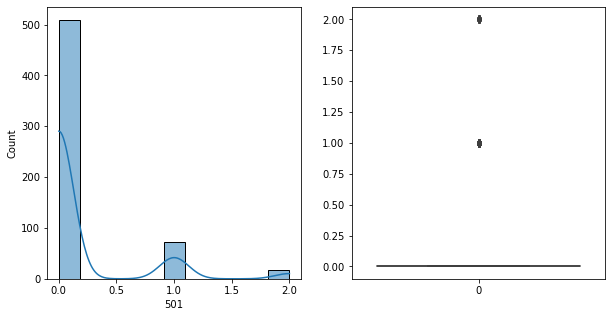

501   Unique :  [0 1 2]
--------------------------------------------------------------------
501   N unique :  3
--------------------------------------------------------------------
501   Value Counts :  0    509
1     73
2     18
Name: 501, dtype: int64
--------------------------------------------------------------------



[ 502 ]
show_df_info :  502


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


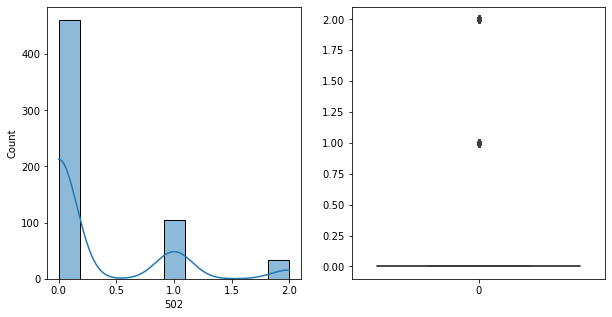

502   Unique :  [1 0 2]
--------------------------------------------------------------------
502   N unique :  3
--------------------------------------------------------------------
502   Value Counts :  0    461
1    105
2     34
Name: 502, dtype: int64
--------------------------------------------------------------------



[ 503 ]
show_df_info :  503


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


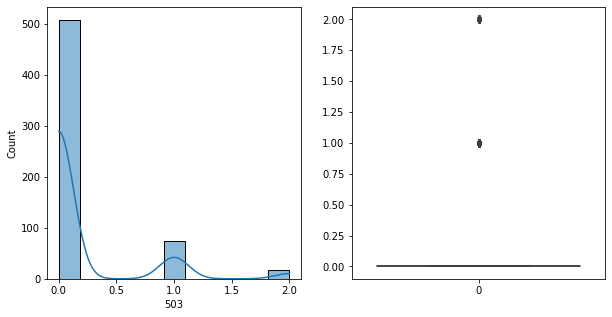

503   Unique :  [0 1 2]
--------------------------------------------------------------------
503   N unique :  3
--------------------------------------------------------------------
503   Value Counts :  0    508
1     74
2     18
Name: 503, dtype: int64
--------------------------------------------------------------------



[ 504 ]
show_df_info :  504


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


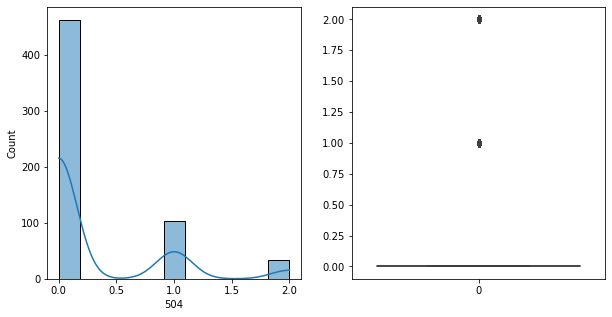

504   Unique :  [1 0 2]
--------------------------------------------------------------------
504   N unique :  3
--------------------------------------------------------------------
504   Value Counts :  0    463
1    104
2     33
Name: 504, dtype: int64
--------------------------------------------------------------------



[ 505 ]
show_df_info :  505


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


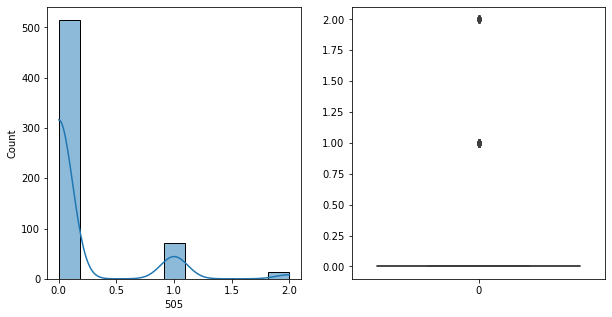

505   Unique :  [0 1 2]
--------------------------------------------------------------------
505   N unique :  3
--------------------------------------------------------------------
505   Value Counts :  0    515
1     72
2     13
Name: 505, dtype: int64
--------------------------------------------------------------------



[ 506 ]
show_df_info :  506


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


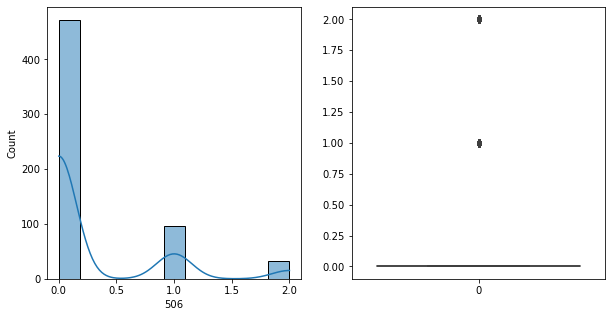

506   Unique :  [1 0 2]
--------------------------------------------------------------------
506   N unique :  3
--------------------------------------------------------------------
506   Value Counts :  0    472
1     96
2     32
Name: 506, dtype: int64
--------------------------------------------------------------------



[ 507 ]
show_df_info :  507


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


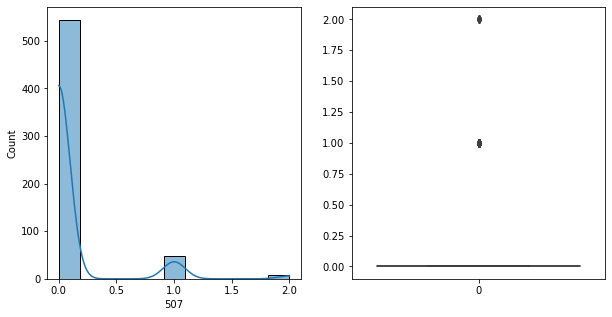

507   Unique :  [1 0 2]
--------------------------------------------------------------------
507   N unique :  3
--------------------------------------------------------------------
507   Value Counts :  0    544
1     48
2      8
Name: 507, dtype: int64
--------------------------------------------------------------------



[ 508 ]
show_df_info :  508


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


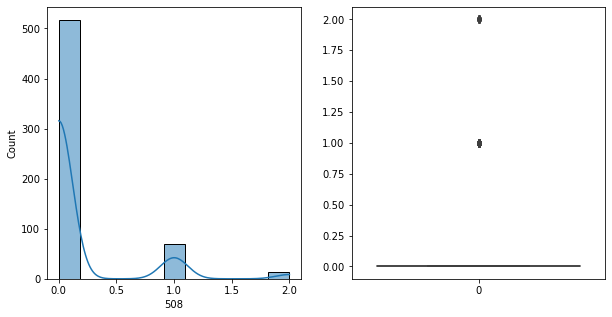

508   Unique :  [0 1 2]
--------------------------------------------------------------------
508   N unique :  3
--------------------------------------------------------------------
508   Value Counts :  0    517
1     69
2     14
Name: 508, dtype: int64
--------------------------------------------------------------------



[ 509 ]
show_df_info :  509


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


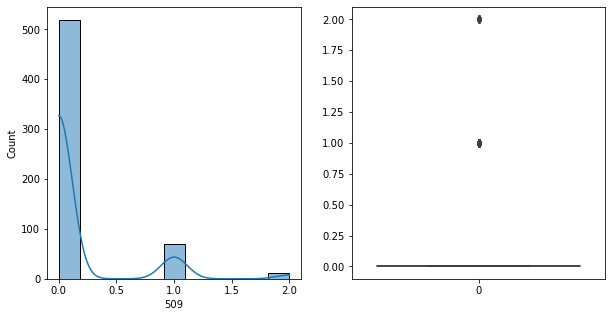

509   Unique :  [1 0 2]
--------------------------------------------------------------------
509   N unique :  3
--------------------------------------------------------------------
509   Value Counts :  0    519
1     69
2     12
Name: 509, dtype: int64
--------------------------------------------------------------------



[ 510 ]
show_df_info :  510


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


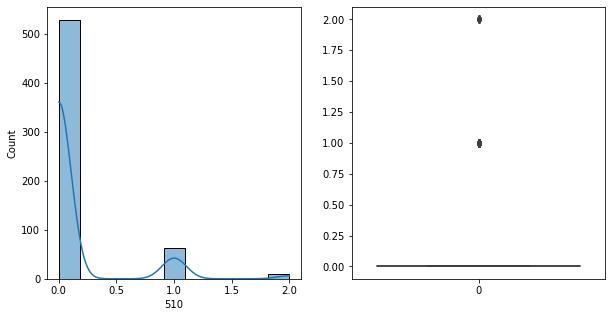

510   Unique :  [0 1 2]
--------------------------------------------------------------------
510   N unique :  3
--------------------------------------------------------------------
510   Value Counts :  0    529
1     62
2      9
Name: 510, dtype: int64
--------------------------------------------------------------------



[ 511 ]
show_df_info :  511


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


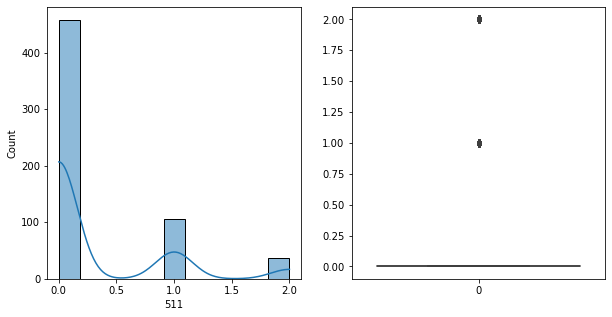

511   Unique :  [1 0 2]
--------------------------------------------------------------------
511   N unique :  3
--------------------------------------------------------------------
511   Value Counts :  0    458
1    105
2     37
Name: 511, dtype: int64
--------------------------------------------------------------------



[ 512 ]
show_df_info :  512


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


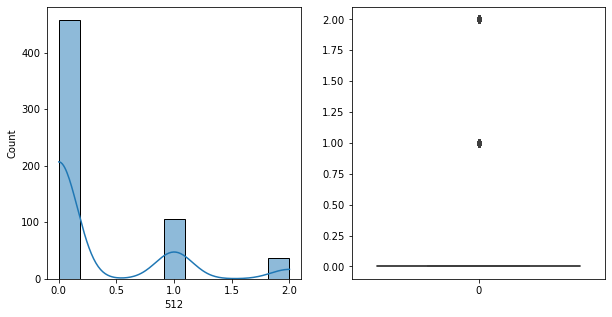

512   Unique :  [1 0 2]
--------------------------------------------------------------------
512   N unique :  3
--------------------------------------------------------------------
512   Value Counts :  0    458
1    105
2     37
Name: 512, dtype: int64
--------------------------------------------------------------------



[ 513 ]
show_df_info :  513


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


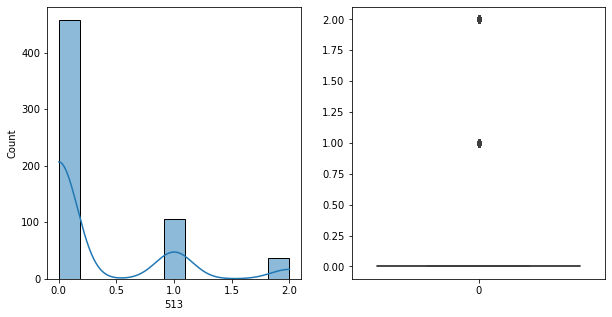

513   Unique :  [1 0 2]
--------------------------------------------------------------------
513   N unique :  3
--------------------------------------------------------------------
513   Value Counts :  0    458
1    105
2     37
Name: 513, dtype: int64
--------------------------------------------------------------------



[ 514 ]
show_df_info :  514


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


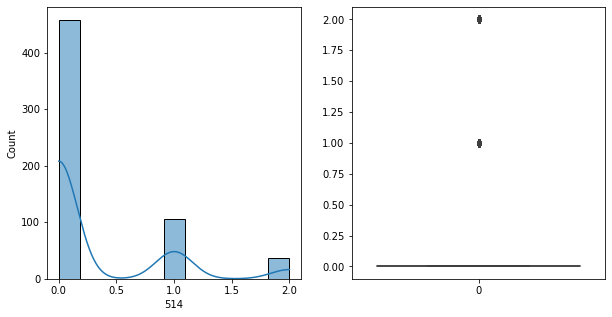

514   Unique :  [1 0 2]
--------------------------------------------------------------------
514   N unique :  3
--------------------------------------------------------------------
514   Value Counts :  0    458
1    106
2     36
Name: 514, dtype: int64
--------------------------------------------------------------------



[ 515 ]
show_df_info :  515


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


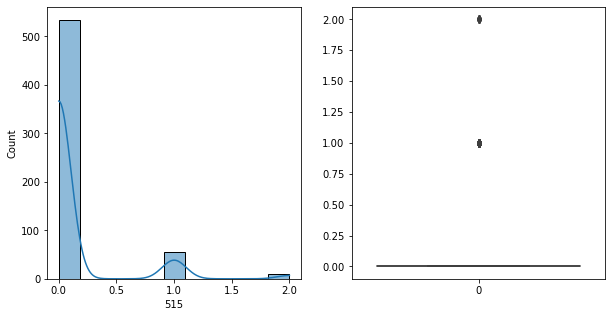

515   Unique :  [1 0 2]
--------------------------------------------------------------------
515   N unique :  3
--------------------------------------------------------------------
515   Value Counts :  0    534
1     56
2     10
Name: 515, dtype: int64
--------------------------------------------------------------------



[ 516 ]
show_df_info :  516


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


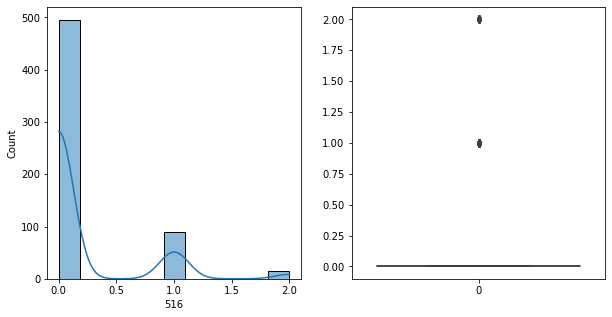

516   Unique :  [1 0 2]
--------------------------------------------------------------------
516   N unique :  3
--------------------------------------------------------------------
516   Value Counts :  0    495
1     90
2     15
Name: 516, dtype: int64
--------------------------------------------------------------------



[ 517 ]
show_df_info :  517


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


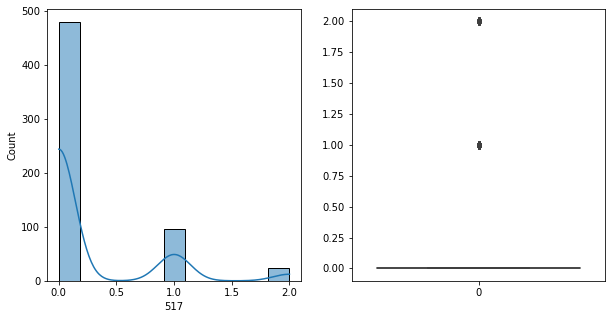

517   Unique :  [1 0 2]
--------------------------------------------------------------------
517   N unique :  3
--------------------------------------------------------------------
517   Value Counts :  0    480
1     96
2     24
Name: 517, dtype: int64
--------------------------------------------------------------------



[ 518 ]
show_df_info :  518


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


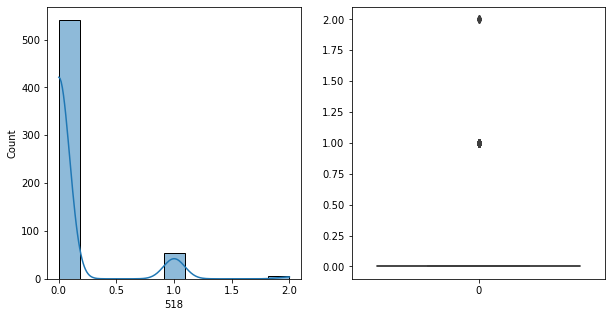

518   Unique :  [0 1 2]
--------------------------------------------------------------------
518   N unique :  3
--------------------------------------------------------------------
518   Value Counts :  0    541
1     54
2      5
Name: 518, dtype: int64
--------------------------------------------------------------------



[ 519 ]
show_df_info :  519


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


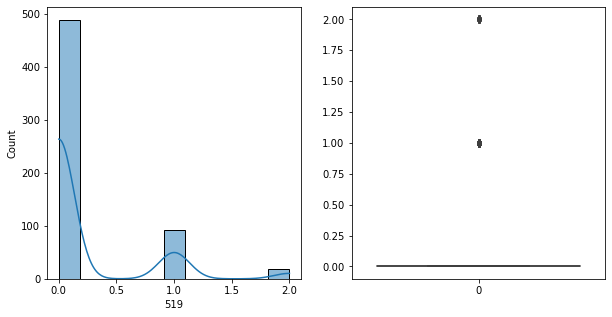

519   Unique :  [1 0 2]
--------------------------------------------------------------------
519   N unique :  3
--------------------------------------------------------------------
519   Value Counts :  0    489
1     92
2     19
Name: 519, dtype: int64
--------------------------------------------------------------------



[ 520 ]
show_df_info :  520


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


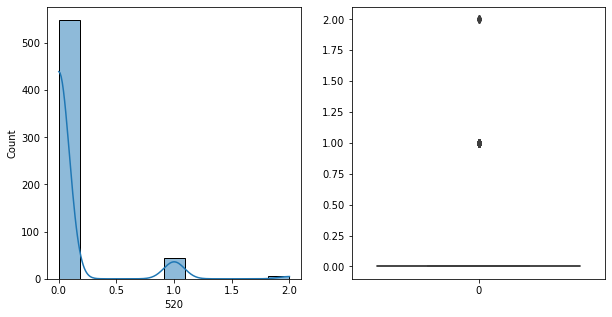

520   Unique :  [1 0 2]
--------------------------------------------------------------------
520   N unique :  3
--------------------------------------------------------------------
520   Value Counts :  0    549
1     45
2      6
Name: 520, dtype: int64
--------------------------------------------------------------------



[ 521 ]
show_df_info :  521


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


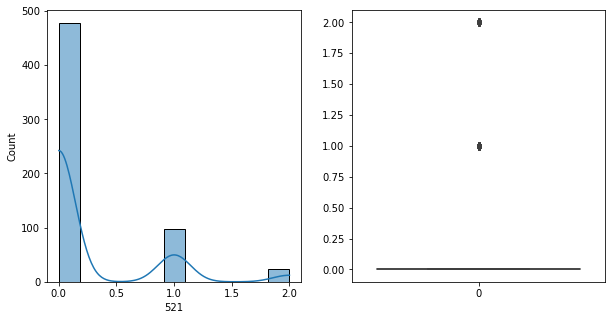

521   Unique :  [2 0 1]
--------------------------------------------------------------------
521   N unique :  3
--------------------------------------------------------------------
521   Value Counts :  0    478
1     98
2     24
Name: 521, dtype: int64
--------------------------------------------------------------------



[ 522 ]
show_df_info :  522


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


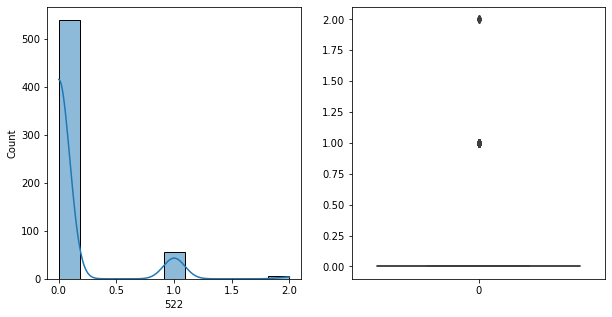

522   Unique :  [1 0 2]
--------------------------------------------------------------------
522   N unique :  3
--------------------------------------------------------------------
522   Value Counts :  0    539
1     56
2      5
Name: 522, dtype: int64
--------------------------------------------------------------------



[ 523 ]
show_df_info :  523


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


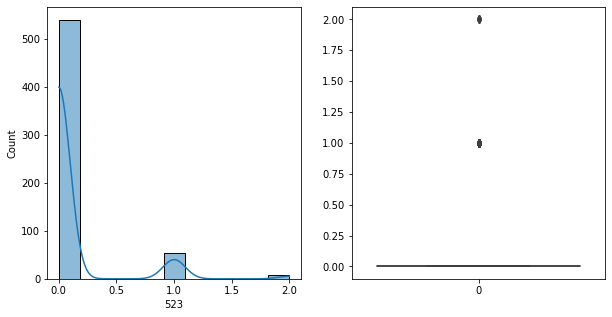

523   Unique :  [1 0 2]
--------------------------------------------------------------------
523   N unique :  3
--------------------------------------------------------------------
523   Value Counts :  0    539
1     54
2      7
Name: 523, dtype: int64
--------------------------------------------------------------------



[ 524 ]
show_df_info :  524


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


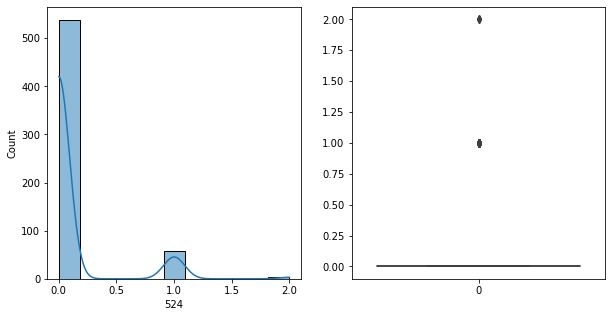

524   Unique :  [1 0 2]
--------------------------------------------------------------------
524   N unique :  3
--------------------------------------------------------------------
524   Value Counts :  0    538
1     58
2      4
Name: 524, dtype: int64
--------------------------------------------------------------------



[ 525 ]
show_df_info :  525


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


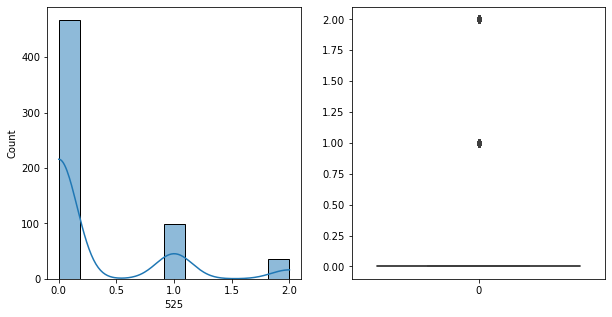

525   Unique :  [2 0 1]
--------------------------------------------------------------------
525   N unique :  3
--------------------------------------------------------------------
525   Value Counts :  0    467
1     98
2     35
Name: 525, dtype: int64
--------------------------------------------------------------------



[ 526 ]
show_df_info :  526


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


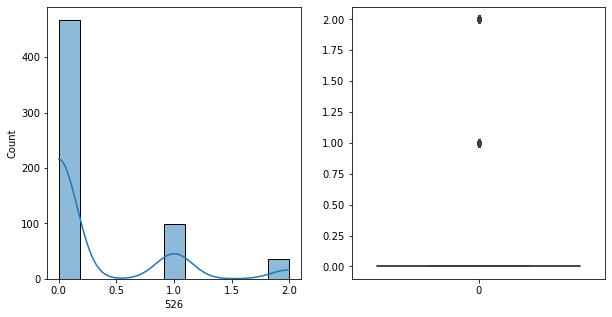

526   Unique :  [2 0 1]
--------------------------------------------------------------------
526   N unique :  3
--------------------------------------------------------------------
526   Value Counts :  0    467
1     98
2     35
Name: 526, dtype: int64
--------------------------------------------------------------------



[ 527 ]
show_df_info :  527


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


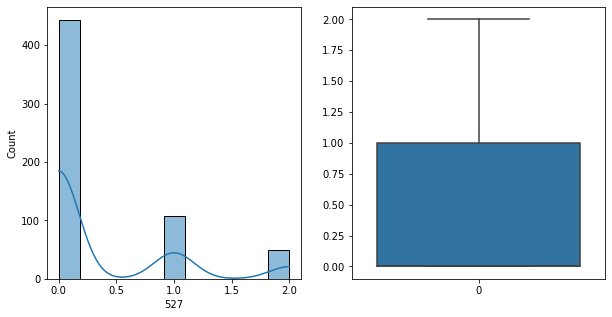

527   Unique :  [2 0 1]
--------------------------------------------------------------------
527   N unique :  3
--------------------------------------------------------------------
527   Value Counts :  0    443
1    107
2     50
Name: 527, dtype: int64
--------------------------------------------------------------------



[ 528 ]
show_df_info :  528


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


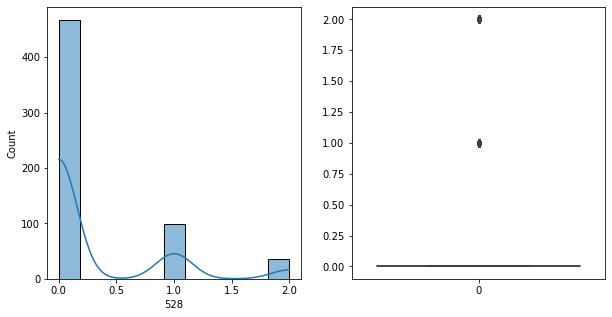

528   Unique :  [2 0 1]
--------------------------------------------------------------------
528   N unique :  3
--------------------------------------------------------------------
528   Value Counts :  0    467
1     98
2     35
Name: 528, dtype: int64
--------------------------------------------------------------------



[ 529 ]
show_df_info :  529


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


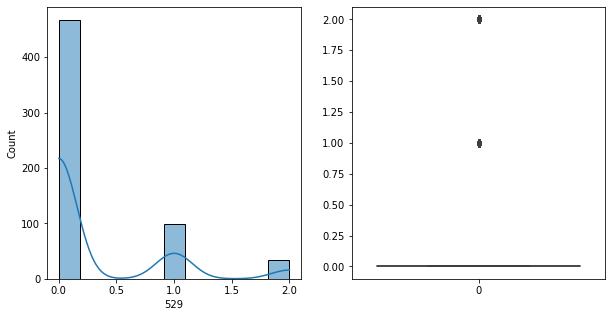

529   Unique :  [2 0 1]
--------------------------------------------------------------------
529   N unique :  3
--------------------------------------------------------------------
529   Value Counts :  0    467
1     99
2     34
Name: 529, dtype: int64
--------------------------------------------------------------------



[ 530 ]
show_df_info :  530


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


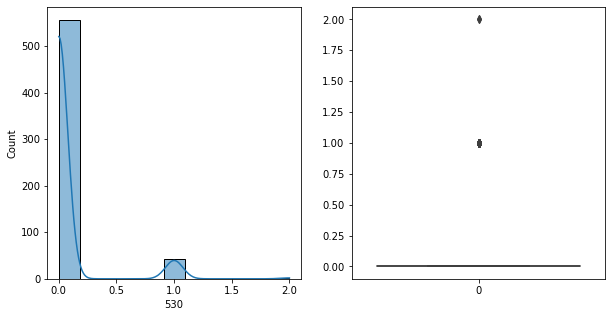

530   Unique :  [1 0 2]
--------------------------------------------------------------------
530   N unique :  3
--------------------------------------------------------------------
530   Value Counts :  0    556
1     42
2      2
Name: 530, dtype: int64
--------------------------------------------------------------------



[ 531 ]
show_df_info :  531


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


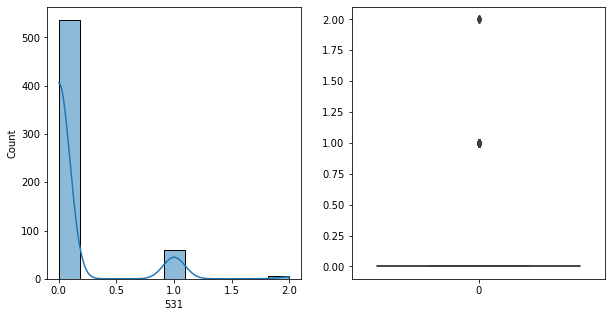

531   Unique :  [1 0 2]
--------------------------------------------------------------------
531   N unique :  3
--------------------------------------------------------------------
531   Value Counts :  0    536
1     59
2      5
Name: 531, dtype: int64
--------------------------------------------------------------------



[ 532 ]
show_df_info :  532


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


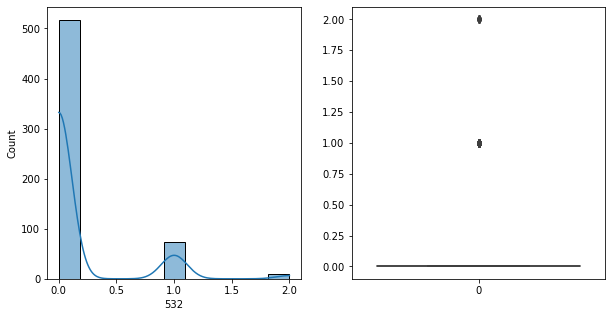

532   Unique :  [1 0 2]
--------------------------------------------------------------------
532   N unique :  3
--------------------------------------------------------------------
532   Value Counts :  0    517
1     73
2     10
Name: 532, dtype: int64
--------------------------------------------------------------------



[ 533 ]
show_df_info :  533


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


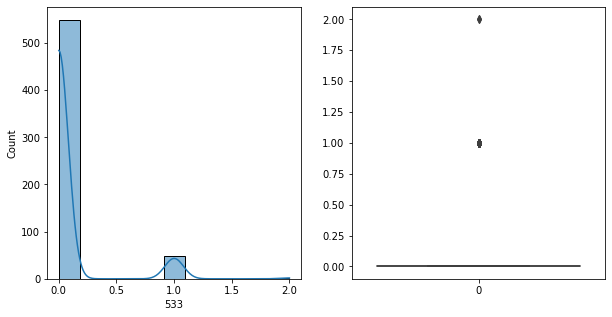

533   Unique :  [1 0 2]
--------------------------------------------------------------------
533   N unique :  3
--------------------------------------------------------------------
533   Value Counts :  0    549
1     49
2      2
Name: 533, dtype: int64
--------------------------------------------------------------------



[ 534 ]
show_df_info :  534


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


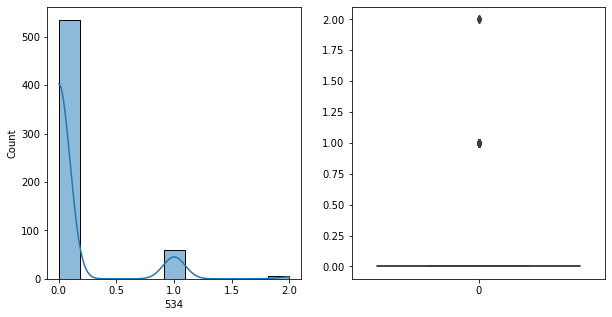

534   Unique :  [1 0 2]
--------------------------------------------------------------------
534   N unique :  3
--------------------------------------------------------------------
534   Value Counts :  0    535
1     60
2      5
Name: 534, dtype: int64
--------------------------------------------------------------------



[ 535 ]
show_df_info :  535


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


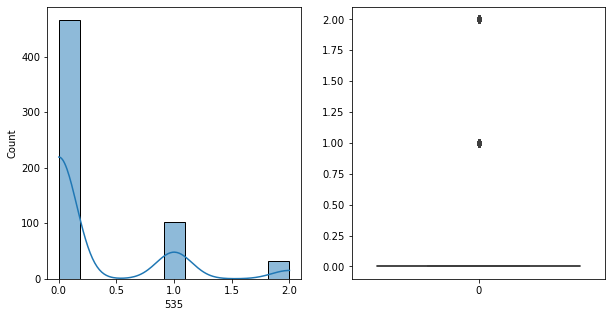

535   Unique :  [2 0 1]
--------------------------------------------------------------------
535   N unique :  3
--------------------------------------------------------------------
535   Value Counts :  0    466
1    102
2     32
Name: 535, dtype: int64
--------------------------------------------------------------------



[ 536 ]
show_df_info :  536


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


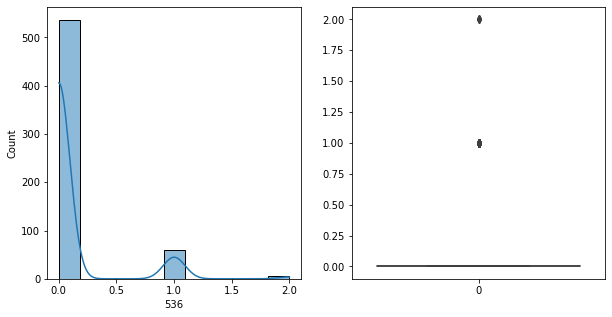

536   Unique :  [1 0 2]
--------------------------------------------------------------------
536   N unique :  3
--------------------------------------------------------------------
536   Value Counts :  0    536
1     59
2      5
Name: 536, dtype: int64
--------------------------------------------------------------------



[ 537 ]
show_df_info :  537


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


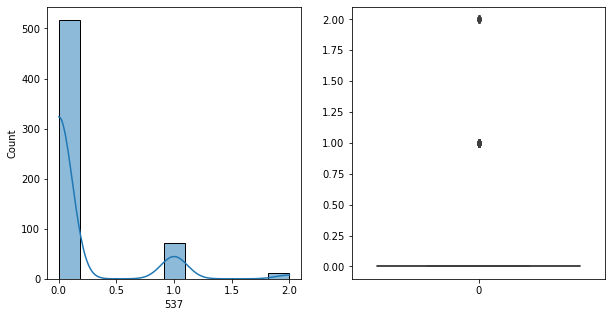

537   Unique :  [0 1 2]
--------------------------------------------------------------------
537   N unique :  3
--------------------------------------------------------------------
537   Value Counts :  0    517
1     71
2     12
Name: 537, dtype: int64
--------------------------------------------------------------------



[ 538 ]
show_df_info :  538


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


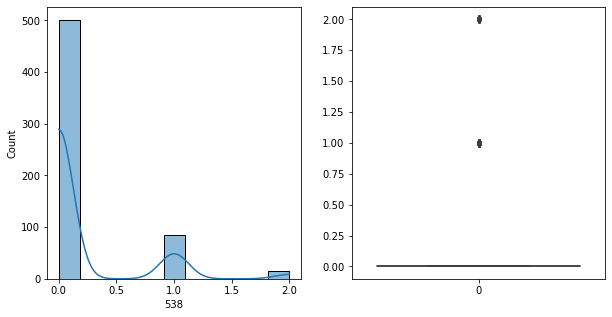

538   Unique :  [1 0 2]
--------------------------------------------------------------------
538   N unique :  3
--------------------------------------------------------------------
538   Value Counts :  0    501
1     84
2     15
Name: 538, dtype: int64
--------------------------------------------------------------------



[ 539 ]
show_df_info :  539


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


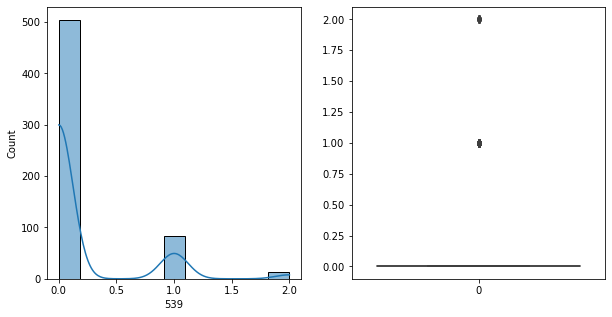

539   Unique :  [0 1 2]
--------------------------------------------------------------------
539   N unique :  3
--------------------------------------------------------------------
539   Value Counts :  0    504
1     83
2     13
Name: 539, dtype: int64
--------------------------------------------------------------------



[ 540 ]
show_df_info :  540


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


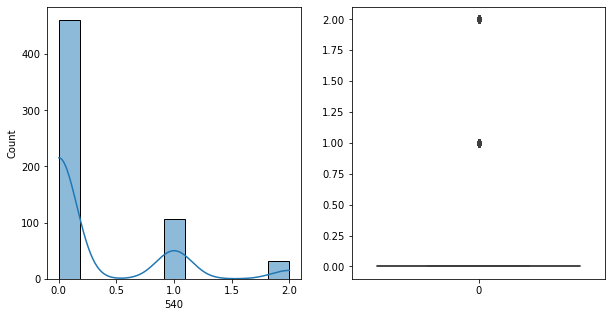

540   Unique :  [0 1 2]
--------------------------------------------------------------------
540   N unique :  3
--------------------------------------------------------------------
540   Value Counts :  0    461
1    107
2     32
Name: 540, dtype: int64
--------------------------------------------------------------------



[ 541 ]
show_df_info :  541


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


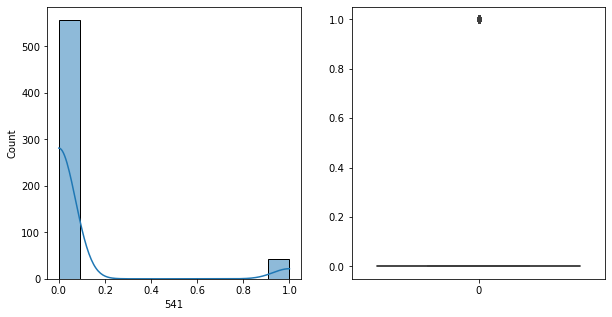

541   Unique :  [0 1]
--------------------------------------------------------------------
541   N unique :  2
--------------------------------------------------------------------
541   Value Counts :  0    557
1     43
Name: 541, dtype: int64
--------------------------------------------------------------------



[ 542 ]
show_df_info :  542


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


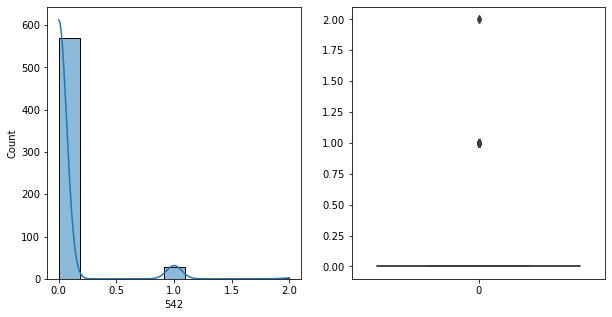

542   Unique :  [0 1 2]
--------------------------------------------------------------------
542   N unique :  3
--------------------------------------------------------------------
542   Value Counts :  0    569
1     29
2      2
Name: 542, dtype: int64
--------------------------------------------------------------------



[ 543 ]
show_df_info :  543


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


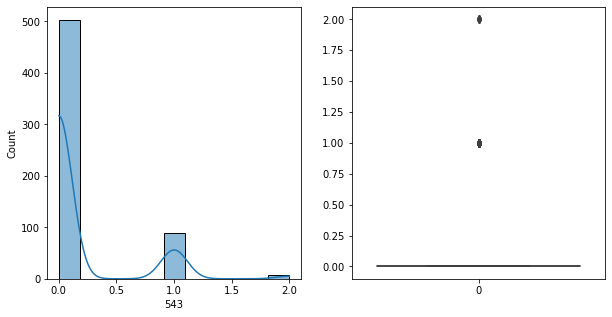

543   Unique :  [0 1 2]
--------------------------------------------------------------------
543   N unique :  3
--------------------------------------------------------------------
543   Value Counts :  0    503
1     89
2      8
Name: 543, dtype: int64
--------------------------------------------------------------------



[ 544 ]
show_df_info :  544


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


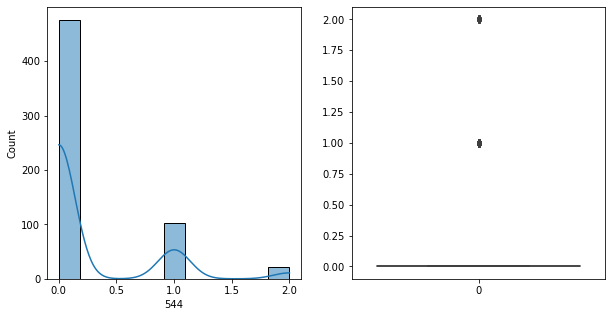

544   Unique :  [0 1 2]
--------------------------------------------------------------------
544   N unique :  3
--------------------------------------------------------------------
544   Value Counts :  0    476
1    103
2     21
Name: 544, dtype: int64
--------------------------------------------------------------------



[ 545 ]
show_df_info :  545


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


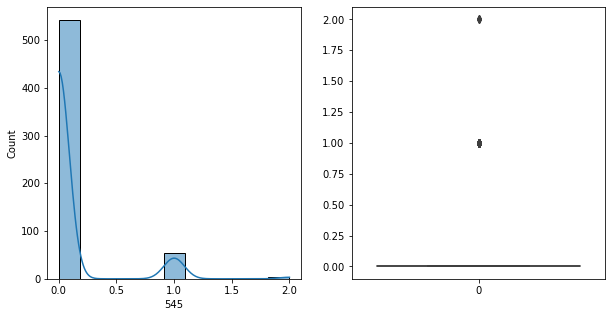

545   Unique :  [0 1 2]
--------------------------------------------------------------------
545   N unique :  3
--------------------------------------------------------------------
545   Value Counts :  0    542
1     54
2      4
Name: 545, dtype: int64
--------------------------------------------------------------------



[ 546 ]
show_df_info :  546


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


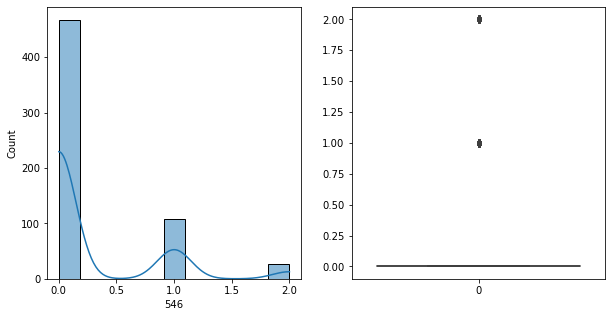

546   Unique :  [0 1 2]
--------------------------------------------------------------------
546   N unique :  3
--------------------------------------------------------------------
546   Value Counts :  0    467
1    107
2     26
Name: 546, dtype: int64
--------------------------------------------------------------------



[ 547 ]
show_df_info :  547


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


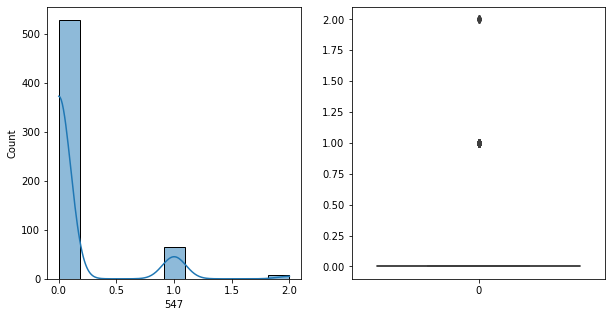

547   Unique :  [0 1 2]
--------------------------------------------------------------------
547   N unique :  3
--------------------------------------------------------------------
547   Value Counts :  0    529
1     64
2      7
Name: 547, dtype: int64
--------------------------------------------------------------------



[ 548 ]
show_df_info :  548


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


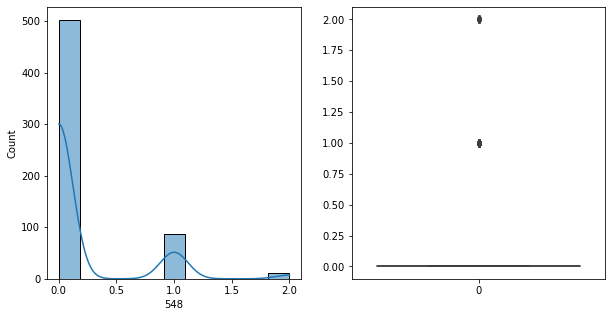

548   Unique :  [0 2 1]
--------------------------------------------------------------------
548   N unique :  3
--------------------------------------------------------------------
548   Value Counts :  0    502
1     86
2     12
Name: 548, dtype: int64
--------------------------------------------------------------------



[ 549 ]
show_df_info :  549


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


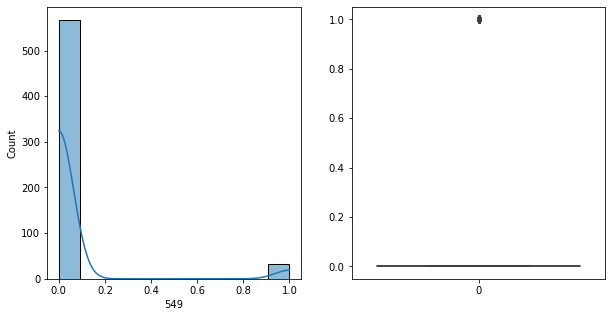

549   Unique :  [1 0]
--------------------------------------------------------------------
549   N unique :  2
--------------------------------------------------------------------
549   Value Counts :  0    567
1     33
Name: 549, dtype: int64
--------------------------------------------------------------------



[ 550 ]
show_df_info :  550


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


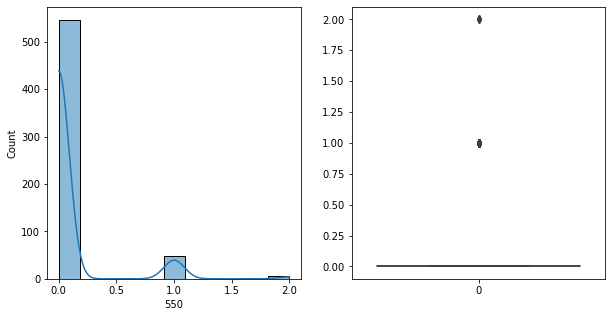

550   Unique :  [0 1 2]
--------------------------------------------------------------------
550   N unique :  3
--------------------------------------------------------------------
550   Value Counts :  0    546
1     49
2      5
Name: 550, dtype: int64
--------------------------------------------------------------------



[ 551 ]
show_df_info :  551


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


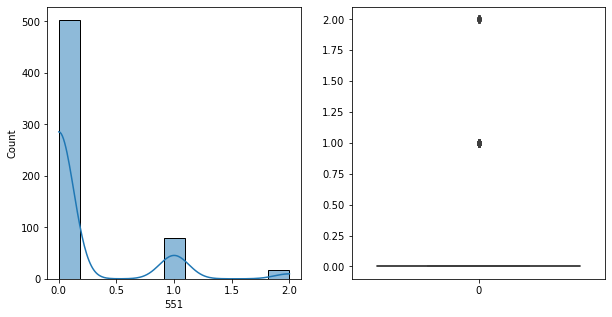

551   Unique :  [0 1 2]
--------------------------------------------------------------------
551   N unique :  3
--------------------------------------------------------------------
551   Value Counts :  0    503
1     80
2     17
Name: 551, dtype: int64
--------------------------------------------------------------------



[ 552 ]
show_df_info :  552


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


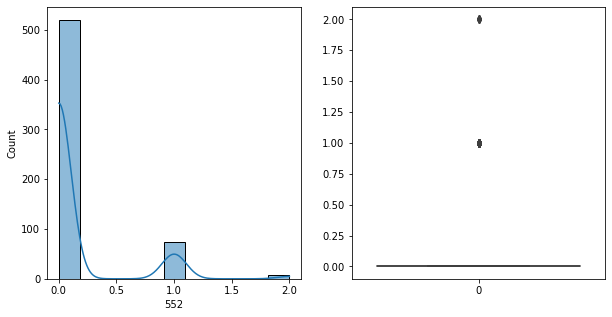

552   Unique :  [1 0 2]
--------------------------------------------------------------------
552   N unique :  3
--------------------------------------------------------------------
552   Value Counts :  0    520
1     73
2      7
Name: 552, dtype: int64
--------------------------------------------------------------------



[ 553 ]
show_df_info :  553


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


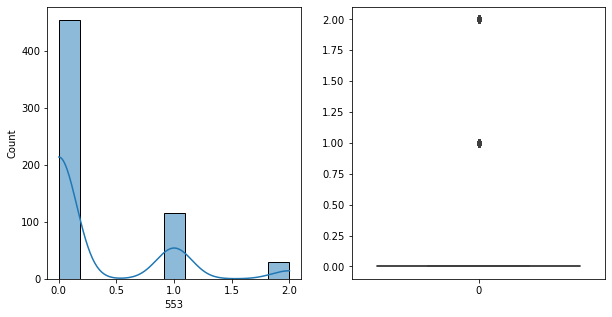

553   Unique :  [1 0 2]
--------------------------------------------------------------------
553   N unique :  3
--------------------------------------------------------------------
553   Value Counts :  0    455
1    115
2     30
Name: 553, dtype: int64
--------------------------------------------------------------------



[ 554 ]
show_df_info :  554


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


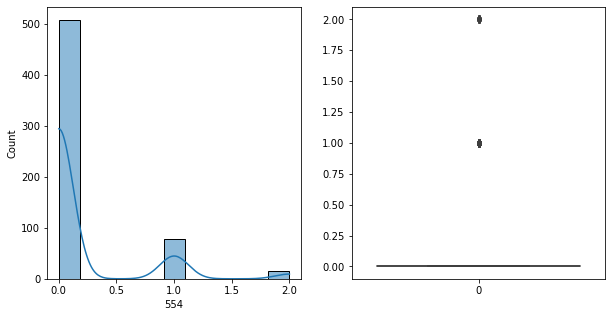

554   Unique :  [0 1 2]
--------------------------------------------------------------------
554   N unique :  3
--------------------------------------------------------------------
554   Value Counts :  0    507
1     77
2     16
Name: 554, dtype: int64
--------------------------------------------------------------------



[ 555 ]
show_df_info :  555


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


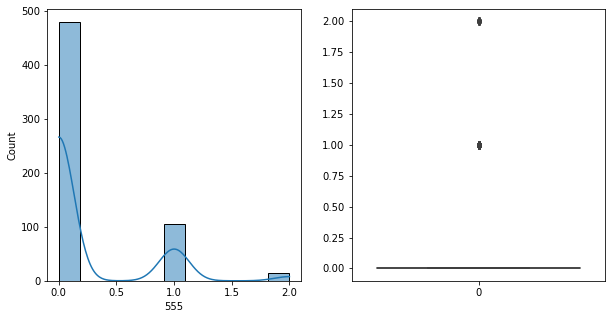

555   Unique :  [1 0 2]
--------------------------------------------------------------------
555   N unique :  3
--------------------------------------------------------------------
555   Value Counts :  0    480
1    106
2     14
Name: 555, dtype: int64
--------------------------------------------------------------------



[ 556 ]
show_df_info :  556


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


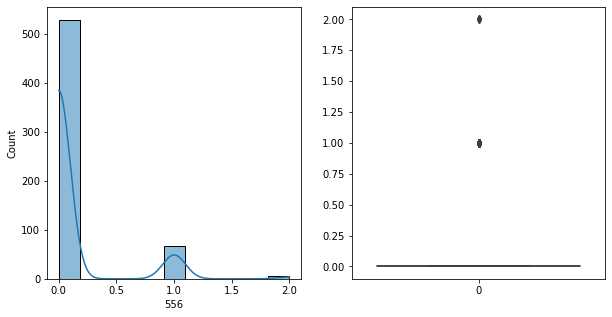

556   Unique :  [1 0 2]
--------------------------------------------------------------------
556   N unique :  3
--------------------------------------------------------------------
556   Value Counts :  0    528
1     67
2      5
Name: 556, dtype: int64
--------------------------------------------------------------------



[ 557 ]
show_df_info :  557


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


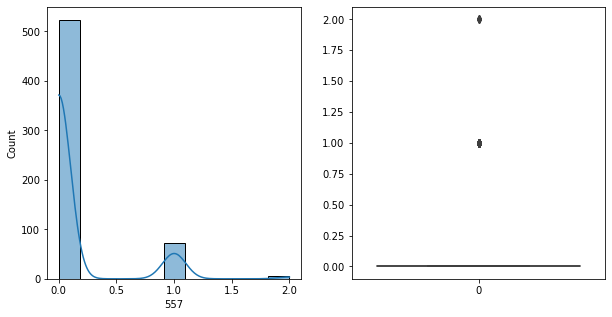

557   Unique :  [1 0 2]
--------------------------------------------------------------------
557   N unique :  3
--------------------------------------------------------------------
557   Value Counts :  0    523
1     72
2      5
Name: 557, dtype: int64
--------------------------------------------------------------------



[ 558 ]
show_df_info :  558


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


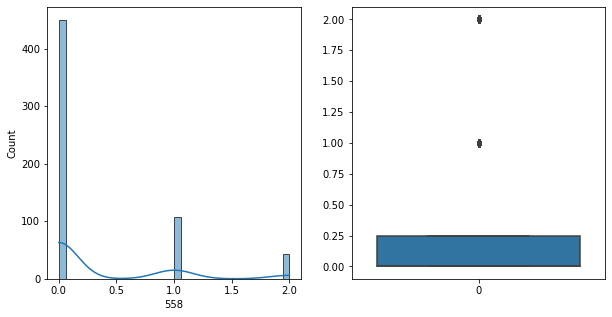

558   Unique :  [1 0 2]
--------------------------------------------------------------------
558   N unique :  3
--------------------------------------------------------------------
558   Value Counts :  0    450
1    107
2     43
Name: 558, dtype: int64
--------------------------------------------------------------------



[ 559 ]
show_df_info :  559


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


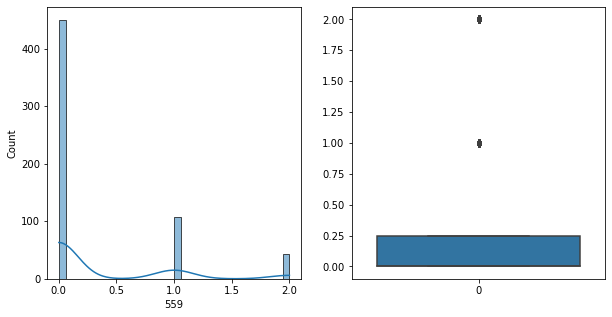

559   Unique :  [1 0 2]
--------------------------------------------------------------------
559   N unique :  3
--------------------------------------------------------------------
559   Value Counts :  0    450
1    107
2     43
Name: 559, dtype: int64
--------------------------------------------------------------------



[ 560 ]
show_df_info :  560


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


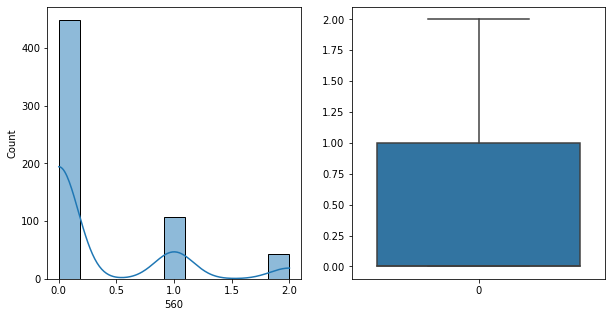

560   Unique :  [1 0 2]
--------------------------------------------------------------------
560   N unique :  3
--------------------------------------------------------------------
560   Value Counts :  0    449
1    108
2     43
Name: 560, dtype: int64
--------------------------------------------------------------------



[ 561 ]
show_df_info :  561


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


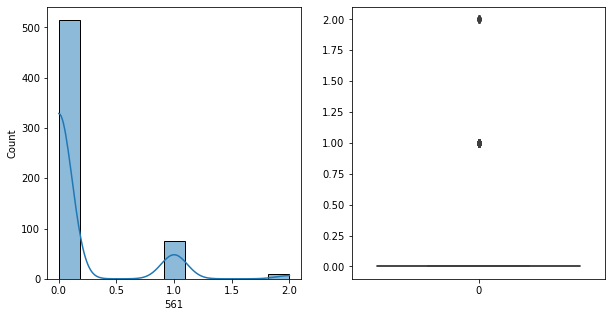

561   Unique :  [0 1 2]
--------------------------------------------------------------------
561   N unique :  3
--------------------------------------------------------------------
561   Value Counts :  0    515
1     75
2     10
Name: 561, dtype: int64
--------------------------------------------------------------------



[ 562 ]
show_df_info :  562


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


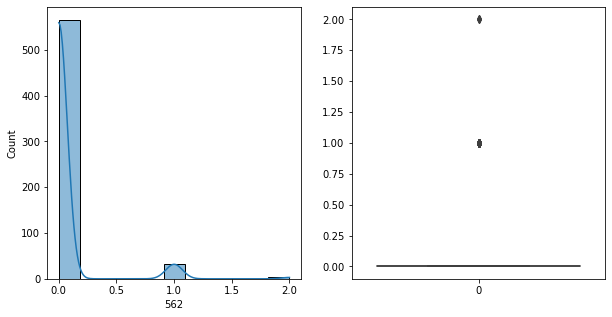

562   Unique :  [0 1 2]
--------------------------------------------------------------------
562   N unique :  3
--------------------------------------------------------------------
562   Value Counts :  0    565
1     32
2      3
Name: 562, dtype: int64
--------------------------------------------------------------------



[ 563 ]
show_df_info :  563


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


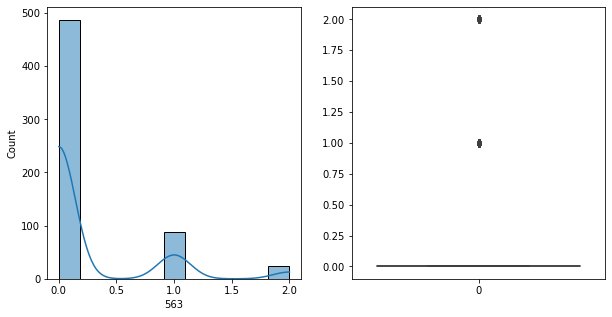

563   Unique :  [1 0 2]
--------------------------------------------------------------------
563   N unique :  3
--------------------------------------------------------------------
563   Value Counts :  0    487
1     88
2     25
Name: 563, dtype: int64
--------------------------------------------------------------------



[ 564 ]
show_df_info :  564


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


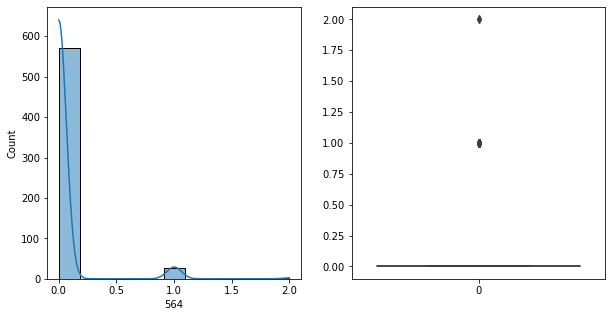

564   Unique :  [0 2 1]
--------------------------------------------------------------------
564   N unique :  3
--------------------------------------------------------------------
564   Value Counts :  0    572
1     26
2      2
Name: 564, dtype: int64
--------------------------------------------------------------------



[ 565 ]
show_df_info :  565


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


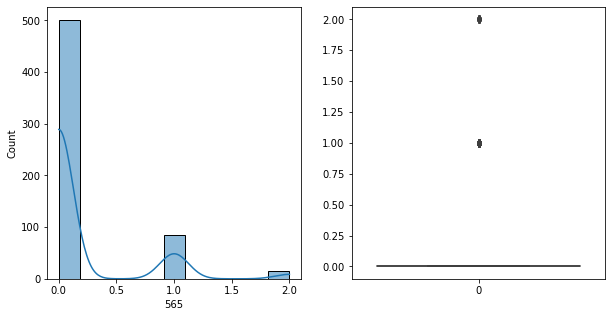

565   Unique :  [0 2 1]
--------------------------------------------------------------------
565   N unique :  3
--------------------------------------------------------------------
565   Value Counts :  0    501
1     84
2     15
Name: 565, dtype: int64
--------------------------------------------------------------------



[ 566 ]
show_df_info :  566


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


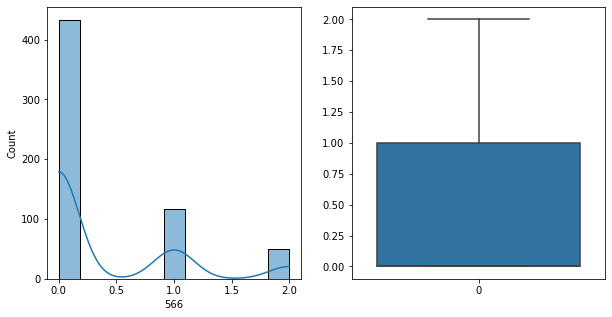

566   Unique :  [0 1 2]
--------------------------------------------------------------------
566   N unique :  3
--------------------------------------------------------------------
566   Value Counts :  0    433
1    117
2     50
Name: 566, dtype: int64
--------------------------------------------------------------------



[ 567 ]
show_df_info :  567


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


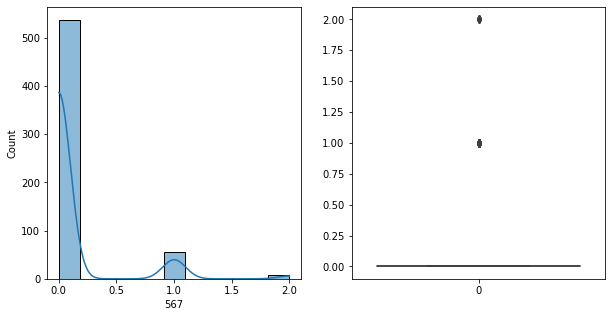

567   Unique :  [0 1 2]
--------------------------------------------------------------------
567   N unique :  3
--------------------------------------------------------------------
567   Value Counts :  0    537
1     55
2      8
Name: 567, dtype: int64
--------------------------------------------------------------------



[ 568 ]
show_df_info :  568


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


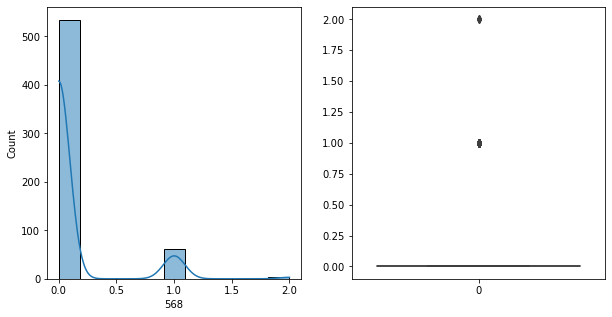

568   Unique :  [0 1 2]
--------------------------------------------------------------------
568   N unique :  3
--------------------------------------------------------------------
568   Value Counts :  0    534
1     62
2      4
Name: 568, dtype: int64
--------------------------------------------------------------------



[ 569 ]
show_df_info :  569


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


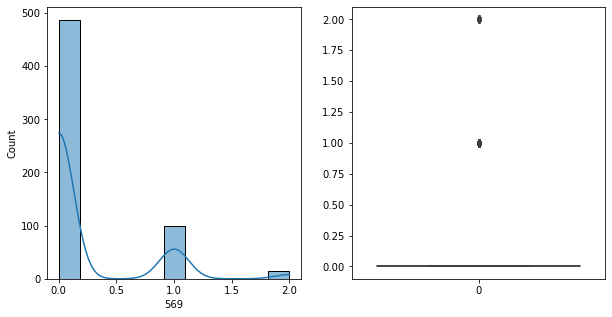

569   Unique :  [0 1 2]
--------------------------------------------------------------------
569   N unique :  3
--------------------------------------------------------------------
569   Value Counts :  0    487
1     99
2     14
Name: 569, dtype: int64
--------------------------------------------------------------------



[ 570 ]
show_df_info :  570


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


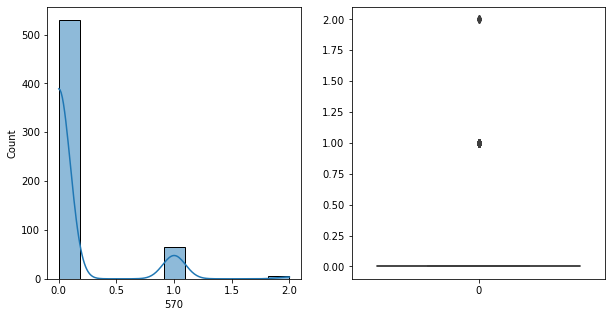

570   Unique :  [0 1 2]
--------------------------------------------------------------------
570   N unique :  3
--------------------------------------------------------------------
570   Value Counts :  0    530
1     65
2      5
Name: 570, dtype: int64
--------------------------------------------------------------------



[ 571 ]
show_df_info :  571


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


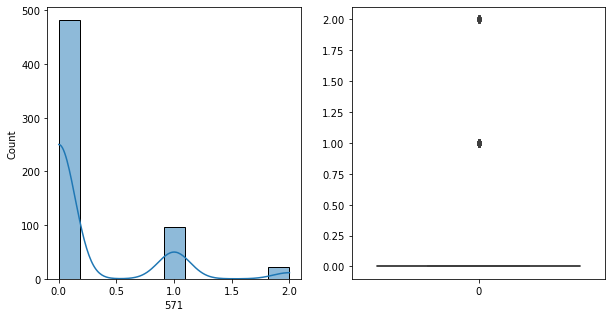

571   Unique :  [0 1 2]
--------------------------------------------------------------------
571   N unique :  3
--------------------------------------------------------------------
571   Value Counts :  0    482
1     96
2     22
Name: 571, dtype: int64
--------------------------------------------------------------------



[ 572 ]
show_df_info :  572


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


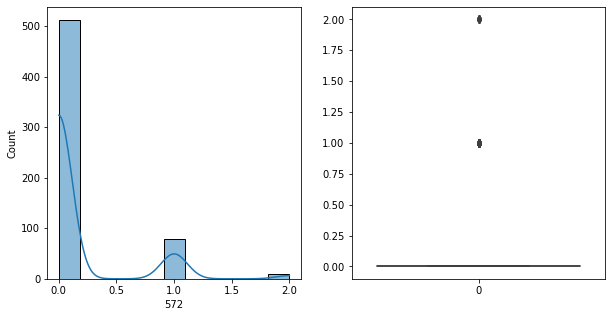

572   Unique :  [1 0 2]
--------------------------------------------------------------------
572   N unique :  3
--------------------------------------------------------------------
572   Value Counts :  0    512
1     78
2     10
Name: 572, dtype: int64
--------------------------------------------------------------------



[ 573 ]
show_df_info :  573


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


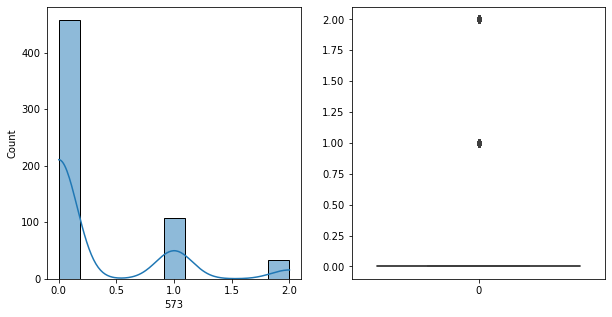

573   Unique :  [1 0 2]
--------------------------------------------------------------------
573   N unique :  3
--------------------------------------------------------------------
573   Value Counts :  0    458
1    108
2     34
Name: 573, dtype: int64
--------------------------------------------------------------------



[ 574 ]
show_df_info :  574


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


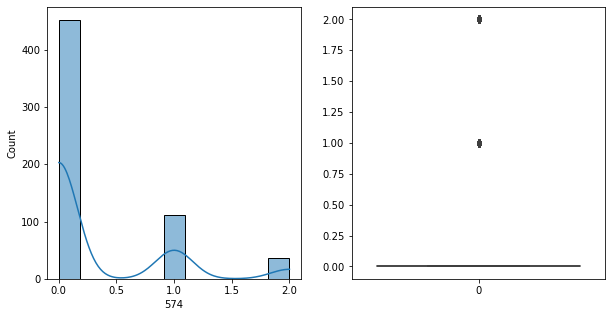

574   Unique :  [2 0 1]
--------------------------------------------------------------------
574   N unique :  3
--------------------------------------------------------------------
574   Value Counts :  0    452
1    111
2     37
Name: 574, dtype: int64
--------------------------------------------------------------------



[ 575 ]
show_df_info :  575


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


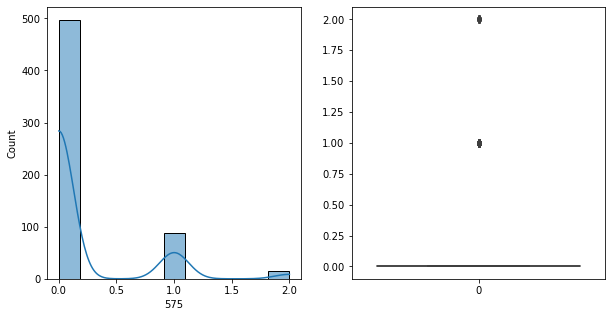

575   Unique :  [0 2 1]
--------------------------------------------------------------------
575   N unique :  3
--------------------------------------------------------------------
575   Value Counts :  0    497
1     88
2     15
Name: 575, dtype: int64
--------------------------------------------------------------------



[ 576 ]
show_df_info :  576


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


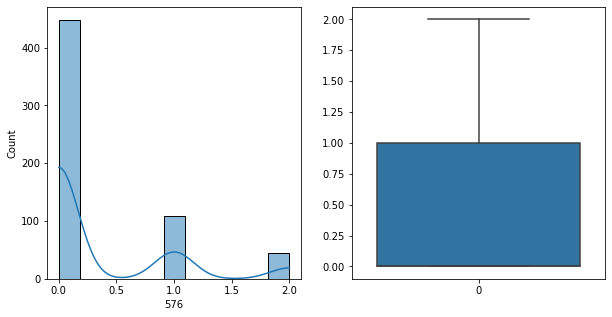

576   Unique :  [1 0 2]
--------------------------------------------------------------------
576   N unique :  3
--------------------------------------------------------------------
576   Value Counts :  0    448
1    108
2     44
Name: 576, dtype: int64
--------------------------------------------------------------------



[ 577 ]
show_df_info :  577


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


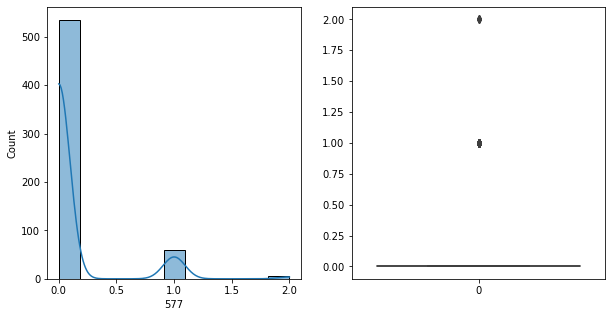

577   Unique :  [0 1 2]
--------------------------------------------------------------------
577   N unique :  3
--------------------------------------------------------------------
577   Value Counts :  0    535
1     60
2      5
Name: 577, dtype: int64
--------------------------------------------------------------------



[ 578 ]
show_df_info :  578


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


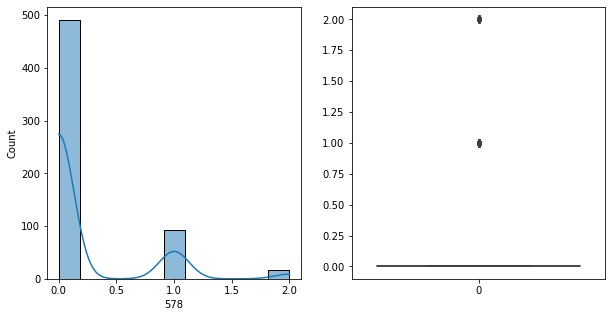

578   Unique :  [1 0 2]
--------------------------------------------------------------------
578   N unique :  3
--------------------------------------------------------------------
578   Value Counts :  0    491
1     93
2     16
Name: 578, dtype: int64
--------------------------------------------------------------------



[ 579 ]
show_df_info :  579


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


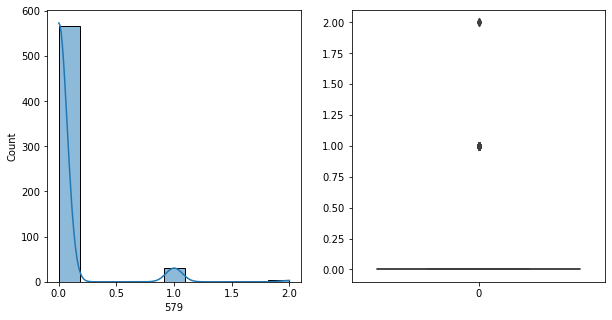

579   Unique :  [0 1 2]
--------------------------------------------------------------------
579   N unique :  3
--------------------------------------------------------------------
579   Value Counts :  0    567
1     30
2      3
Name: 579, dtype: int64
--------------------------------------------------------------------



[ 580 ]
show_df_info :  580


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


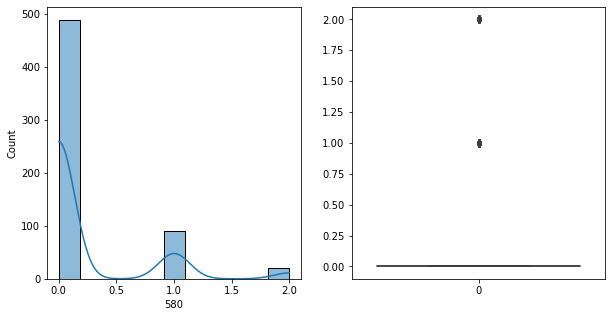

580   Unique :  [1 0 2]
--------------------------------------------------------------------
580   N unique :  3
--------------------------------------------------------------------
580   Value Counts :  0    489
1     90
2     21
Name: 580, dtype: int64
--------------------------------------------------------------------



[ 581 ]
show_df_info :  581


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


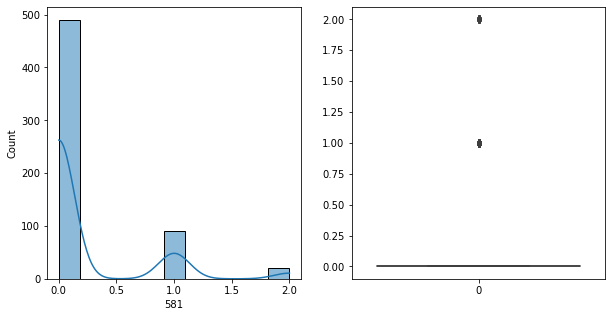

581   Unique :  [1 0 2]
--------------------------------------------------------------------
581   N unique :  3
--------------------------------------------------------------------
581   Value Counts :  0    490
1     90
2     20
Name: 581, dtype: int64
--------------------------------------------------------------------



[ 582 ]
show_df_info :  582


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


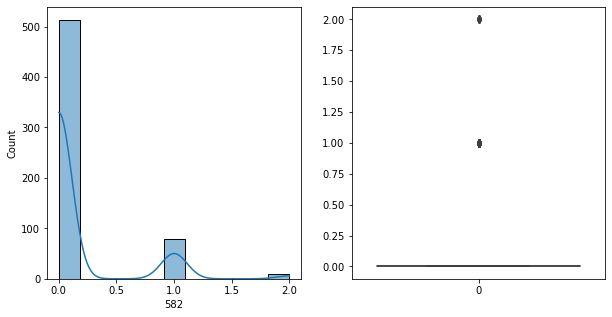

582   Unique :  [1 0 2]
--------------------------------------------------------------------
582   N unique :  3
--------------------------------------------------------------------
582   Value Counts :  0    513
1     78
2      9
Name: 582, dtype: int64
--------------------------------------------------------------------



[ 583 ]
show_df_info :  583


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


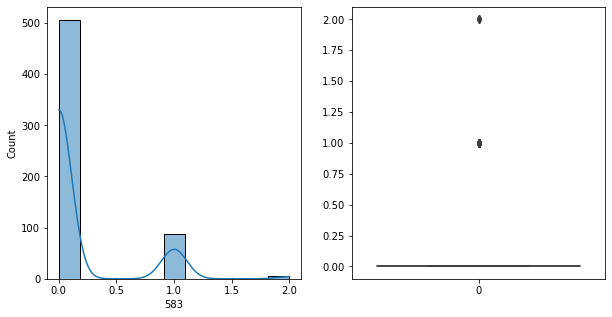

583   Unique :  [1 0 2]
--------------------------------------------------------------------
583   N unique :  3
--------------------------------------------------------------------
583   Value Counts :  0    506
1     88
2      6
Name: 583, dtype: int64
--------------------------------------------------------------------



[ 584 ]
show_df_info :  584


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


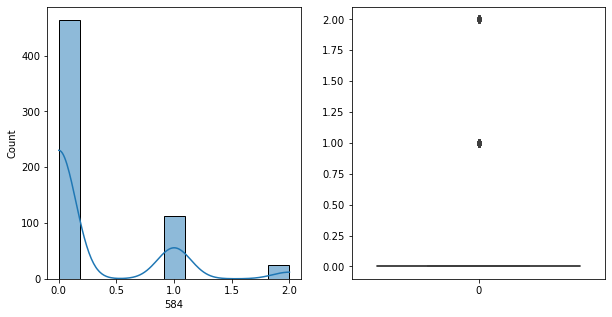

584   Unique :  [1 0 2]
--------------------------------------------------------------------
584   N unique :  3
--------------------------------------------------------------------
584   Value Counts :  0    464
1    112
2     24
Name: 584, dtype: int64
--------------------------------------------------------------------



[ 585 ]
show_df_info :  585


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


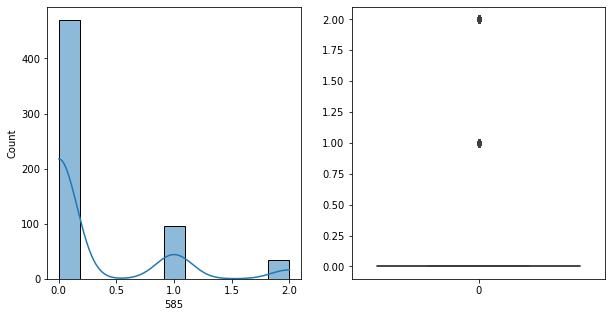

585   Unique :  [0 2 1]
--------------------------------------------------------------------
585   N unique :  3
--------------------------------------------------------------------
585   Value Counts :  0    470
1     95
2     35
Name: 585, dtype: int64
--------------------------------------------------------------------



[ 586 ]
show_df_info :  586


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


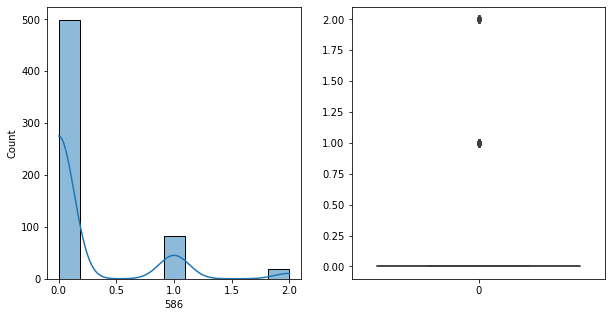

586   Unique :  [1 0 2]
--------------------------------------------------------------------
586   N unique :  3
--------------------------------------------------------------------
586   Value Counts :  0    499
1     82
2     19
Name: 586, dtype: int64
--------------------------------------------------------------------



[ 587 ]
show_df_info :  587


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


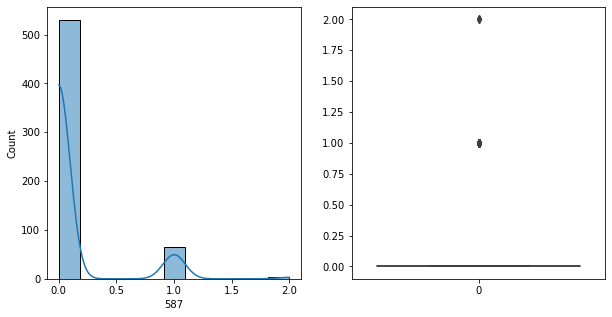

587   Unique :  [1 0 2]
--------------------------------------------------------------------
587   N unique :  3
--------------------------------------------------------------------
587   Value Counts :  0    530
1     66
2      4
Name: 587, dtype: int64
--------------------------------------------------------------------



[ 588 ]
show_df_info :  588


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


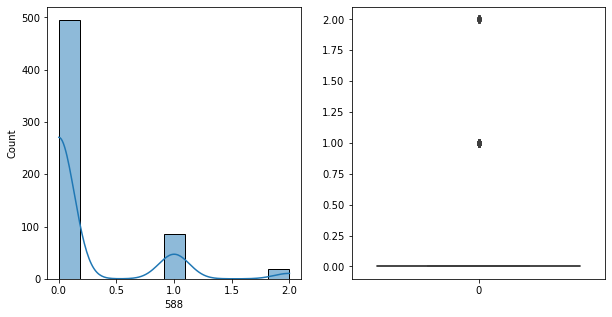

588   Unique :  [1 0 2]
--------------------------------------------------------------------
588   N unique :  3
--------------------------------------------------------------------
588   Value Counts :  0    495
1     86
2     19
Name: 588, dtype: int64
--------------------------------------------------------------------



[ 589 ]
show_df_info :  589


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


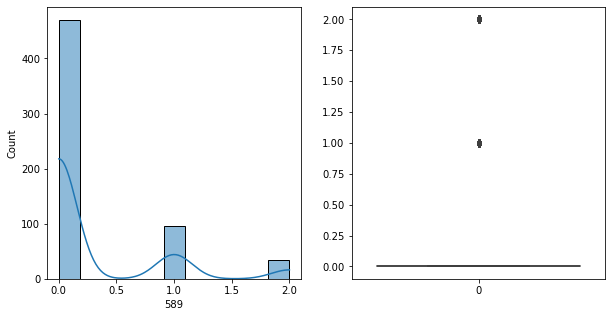

589   Unique :  [0 2 1]
--------------------------------------------------------------------
589   N unique :  3
--------------------------------------------------------------------
589   Value Counts :  0    470
1     95
2     35
Name: 589, dtype: int64
--------------------------------------------------------------------



[ 590 ]
show_df_info :  590


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


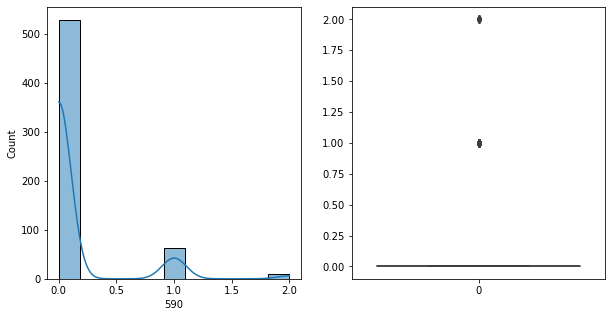

590   Unique :  [1 0 2]
--------------------------------------------------------------------
590   N unique :  3
--------------------------------------------------------------------
590   Value Counts :  0    529
1     62
2      9
Name: 590, dtype: int64
--------------------------------------------------------------------



[ 591 ]
show_df_info :  591


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


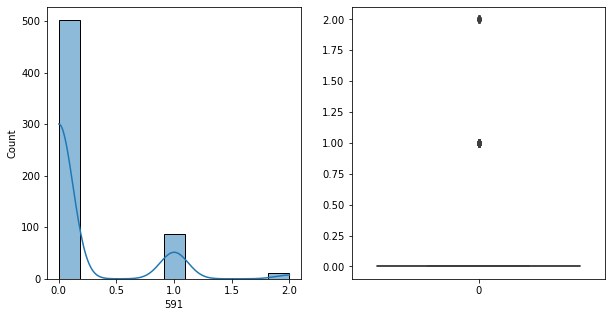

591   Unique :  [0 1 2]
--------------------------------------------------------------------
591   N unique :  3
--------------------------------------------------------------------
591   Value Counts :  0    502
1     86
2     12
Name: 591, dtype: int64
--------------------------------------------------------------------



[ 592 ]
show_df_info :  592


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


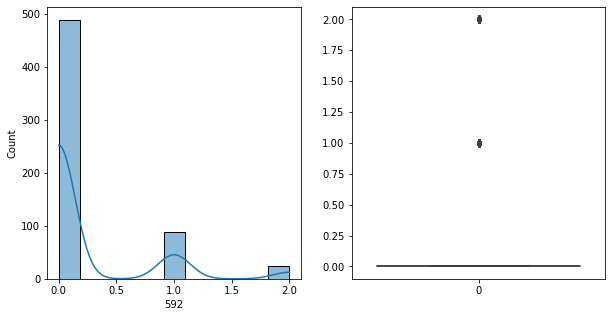

592   Unique :  [0 2 1]
--------------------------------------------------------------------
592   N unique :  3
--------------------------------------------------------------------
592   Value Counts :  0    488
1     88
2     24
Name: 592, dtype: int64
--------------------------------------------------------------------



[ 593 ]
show_df_info :  593


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


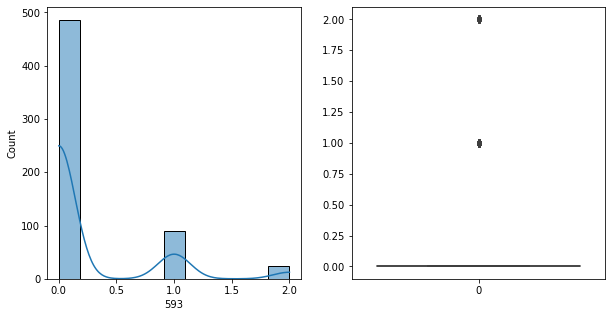

593   Unique :  [0 2 1]
--------------------------------------------------------------------
593   N unique :  3
--------------------------------------------------------------------
593   Value Counts :  0    486
1     90
2     24
Name: 593, dtype: int64
--------------------------------------------------------------------



[ 594 ]
show_df_info :  594


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


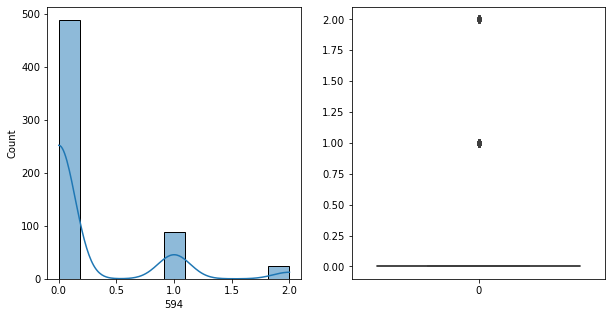

594   Unique :  [0 2 1]
--------------------------------------------------------------------
594   N unique :  3
--------------------------------------------------------------------
594   Value Counts :  0    488
1     88
2     24
Name: 594, dtype: int64
--------------------------------------------------------------------



[ 595 ]
show_df_info :  595


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


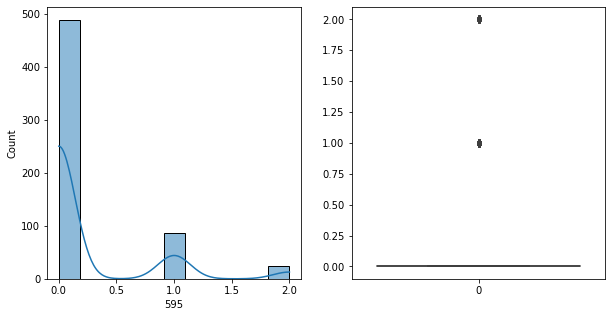

595   Unique :  [0 2 1]
--------------------------------------------------------------------
595   N unique :  3
--------------------------------------------------------------------
595   Value Counts :  0    489
1     86
2     25
Name: 595, dtype: int64
--------------------------------------------------------------------



[ 596 ]
show_df_info :  596


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


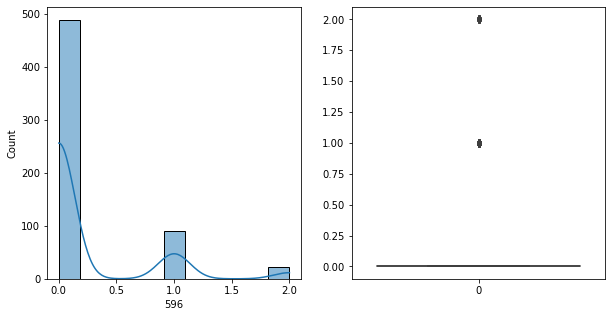

596   Unique :  [0 2 1]
--------------------------------------------------------------------
596   N unique :  3
--------------------------------------------------------------------
596   Value Counts :  0    488
1     90
2     22
Name: 596, dtype: int64
--------------------------------------------------------------------



[ 597 ]
show_df_info :  597


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


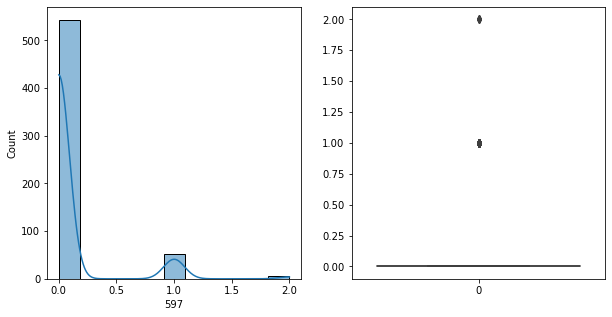

597   Unique :  [0 2 1]
--------------------------------------------------------------------
597   N unique :  3
--------------------------------------------------------------------
597   Value Counts :  0    543
1     52
2      5
Name: 597, dtype: int64
--------------------------------------------------------------------



[ 598 ]
show_df_info :  598


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


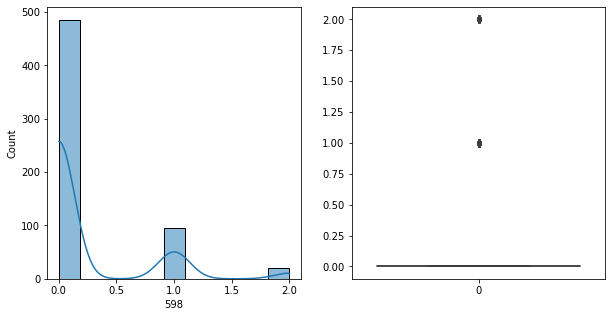

598   Unique :  [0 2 1]
--------------------------------------------------------------------
598   N unique :  3
--------------------------------------------------------------------
598   Value Counts :  0    485
1     95
2     20
Name: 598, dtype: int64
--------------------------------------------------------------------



[ 599 ]
show_df_info :  599


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


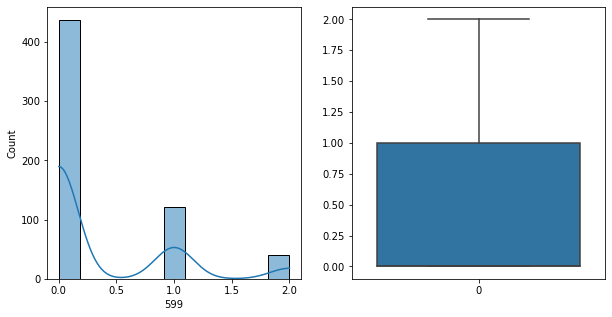

599   Unique :  [1 0 2]
--------------------------------------------------------------------
599   N unique :  3
--------------------------------------------------------------------
599   Value Counts :  0    437
1    122
2     41
Name: 599, dtype: int64
--------------------------------------------------------------------



[ 600 ]
show_df_info :  600


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


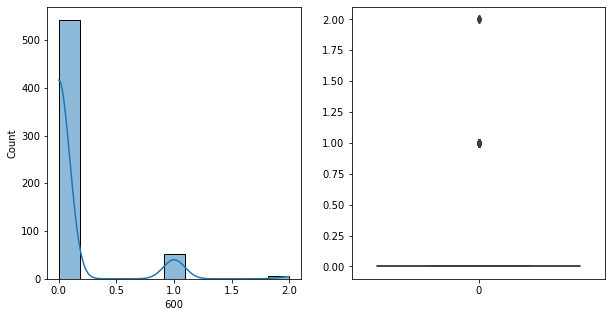

600   Unique :  [0 1 2]
--------------------------------------------------------------------
600   N unique :  3
--------------------------------------------------------------------
600   Value Counts :  0    542
1     52
2      6
Name: 600, dtype: int64
--------------------------------------------------------------------



[ 601 ]
show_df_info :  601


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


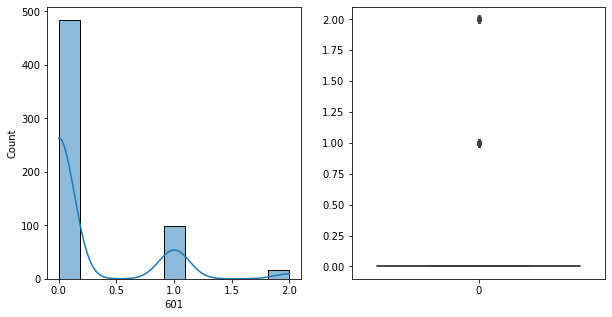

601   Unique :  [1 0 2]
--------------------------------------------------------------------
601   N unique :  3
--------------------------------------------------------------------
601   Value Counts :  0    484
1     99
2     17
Name: 601, dtype: int64
--------------------------------------------------------------------



[ 602 ]
show_df_info :  602


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


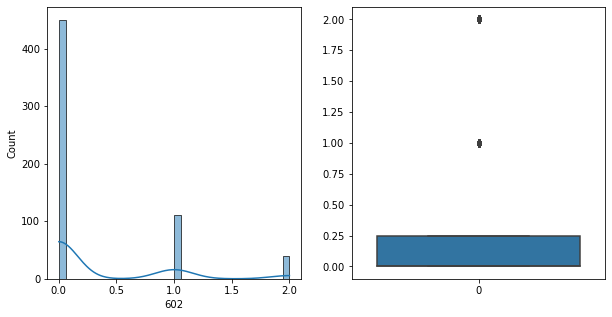

602   Unique :  [1 0 2]
--------------------------------------------------------------------
602   N unique :  3
--------------------------------------------------------------------
602   Value Counts :  0    450
1    111
2     39
Name: 602, dtype: int64
--------------------------------------------------------------------



[ 603 ]
show_df_info :  603


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


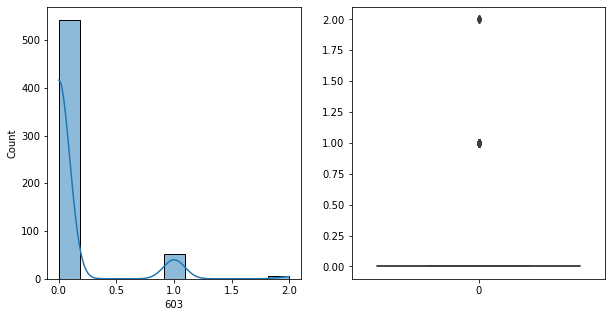

603   Unique :  [0 1 2]
--------------------------------------------------------------------
603   N unique :  3
--------------------------------------------------------------------
603   Value Counts :  0    542
1     52
2      6
Name: 603, dtype: int64
--------------------------------------------------------------------



[ 604 ]
show_df_info :  604


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


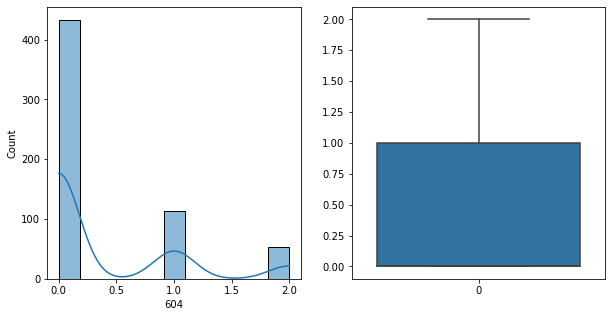

604   Unique :  [0 1 2]
--------------------------------------------------------------------
604   N unique :  3
--------------------------------------------------------------------
604   Value Counts :  0    433
1    114
2     53
Name: 604, dtype: int64
--------------------------------------------------------------------



[ 605 ]
show_df_info :  605


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


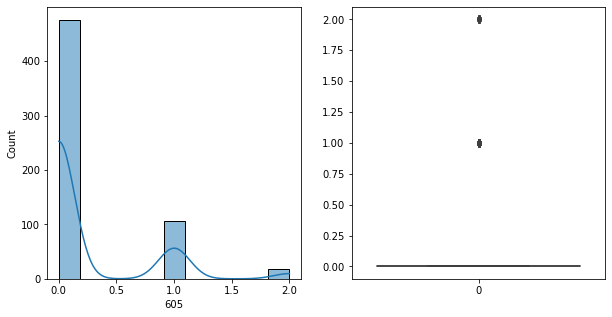

605   Unique :  [1 0 2]
--------------------------------------------------------------------
605   N unique :  3
--------------------------------------------------------------------
605   Value Counts :  0    476
1    106
2     18
Name: 605, dtype: int64
--------------------------------------------------------------------



[ 606 ]
show_df_info :  606


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


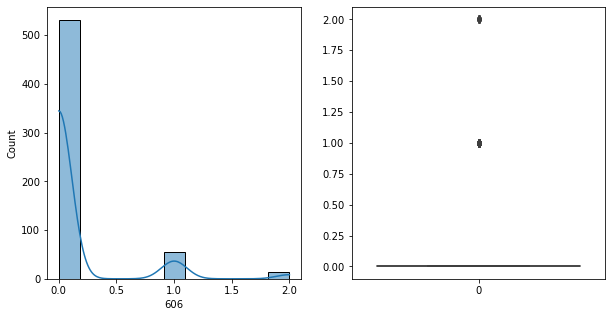

606   Unique :  [1 0 2]
--------------------------------------------------------------------
606   N unique :  3
--------------------------------------------------------------------
606   Value Counts :  0    531
1     56
2     13
Name: 606, dtype: int64
--------------------------------------------------------------------



[ 607 ]
show_df_info :  607


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


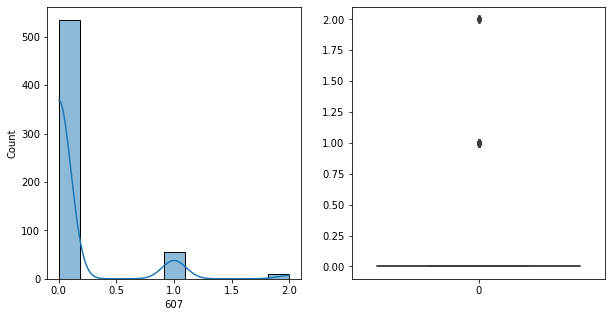

607   Unique :  [1 0 2]
--------------------------------------------------------------------
607   N unique :  3
--------------------------------------------------------------------
607   Value Counts :  0    535
1     55
2     10
Name: 607, dtype: int64
--------------------------------------------------------------------



[ 608 ]
show_df_info :  608


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


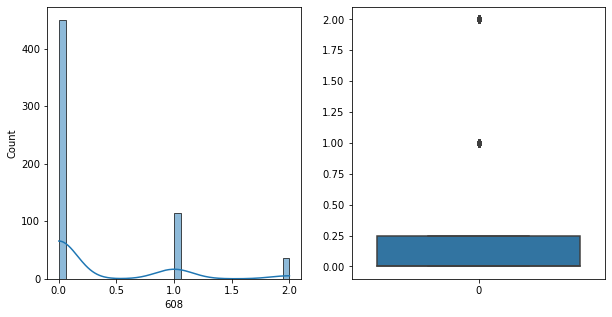

608   Unique :  [1 0 2]
--------------------------------------------------------------------
608   N unique :  3
--------------------------------------------------------------------
608   Value Counts :  0    450
1    114
2     36
Name: 608, dtype: int64
--------------------------------------------------------------------



[ 609 ]
show_df_info :  609


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


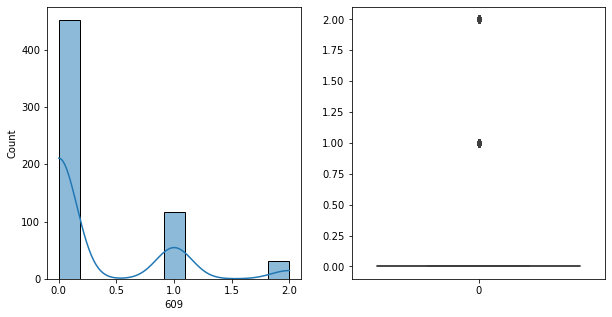

609   Unique :  [1 0 2]
--------------------------------------------------------------------
609   N unique :  3
--------------------------------------------------------------------
609   Value Counts :  0    452
1    117
2     31
Name: 609, dtype: int64
--------------------------------------------------------------------



[ 610 ]
show_df_info :  610


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


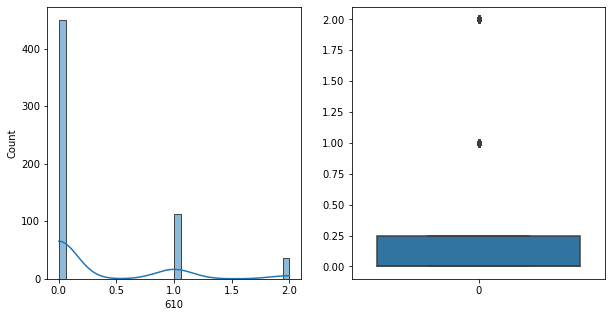

610   Unique :  [1 0 2]
--------------------------------------------------------------------
610   N unique :  3
--------------------------------------------------------------------
610   Value Counts :  0    450
1    113
2     37
Name: 610, dtype: int64
--------------------------------------------------------------------



[ 611 ]
show_df_info :  611


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


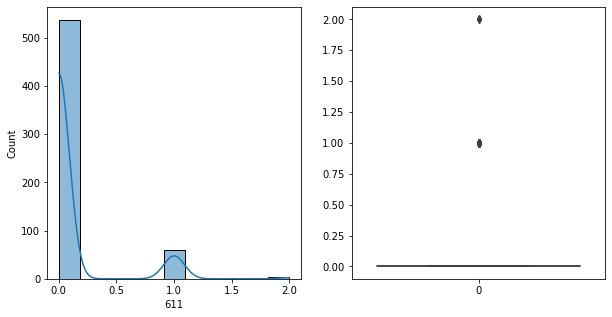

611   Unique :  [1 0 2]
--------------------------------------------------------------------
611   N unique :  3
--------------------------------------------------------------------
611   Value Counts :  0    537
1     60
2      3
Name: 611, dtype: int64
--------------------------------------------------------------------



[ 612 ]
show_df_info :  612


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


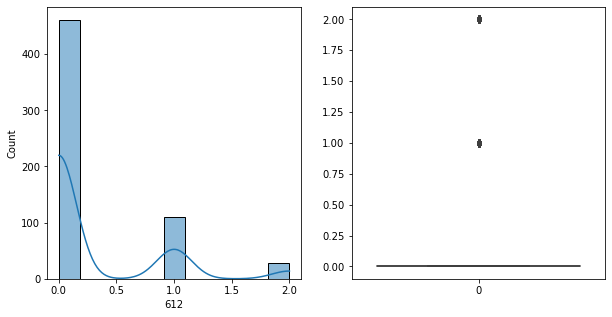

612   Unique :  [2 0 1]
--------------------------------------------------------------------
612   N unique :  3
--------------------------------------------------------------------
612   Value Counts :  0    461
1    110
2     29
Name: 612, dtype: int64
--------------------------------------------------------------------



[ 613 ]
show_df_info :  613


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


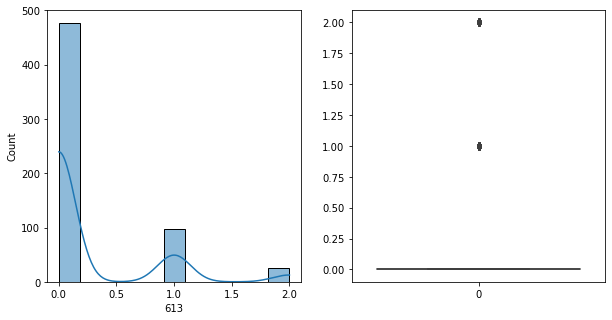

613   Unique :  [0 2 1]
--------------------------------------------------------------------
613   N unique :  3
--------------------------------------------------------------------
613   Value Counts :  0    477
1     98
2     25
Name: 613, dtype: int64
--------------------------------------------------------------------



[ 614 ]
show_df_info :  614


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


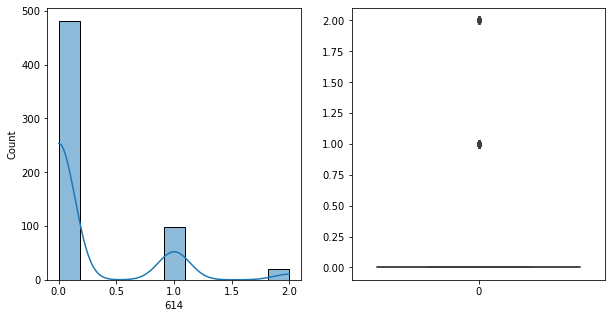

614   Unique :  [2 0 1]
--------------------------------------------------------------------
614   N unique :  3
--------------------------------------------------------------------
614   Value Counts :  0    481
1     99
2     20
Name: 614, dtype: int64
--------------------------------------------------------------------



[ 615 ]
show_df_info :  615


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


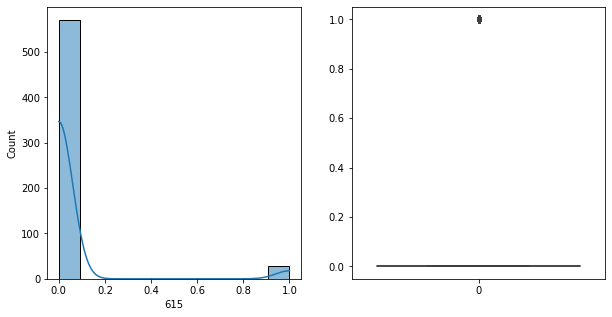

615   Unique :  [0 1]
--------------------------------------------------------------------
615   N unique :  2
--------------------------------------------------------------------
615   Value Counts :  0    571
1     29
Name: 615, dtype: int64
--------------------------------------------------------------------



[ 616 ]
show_df_info :  616


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


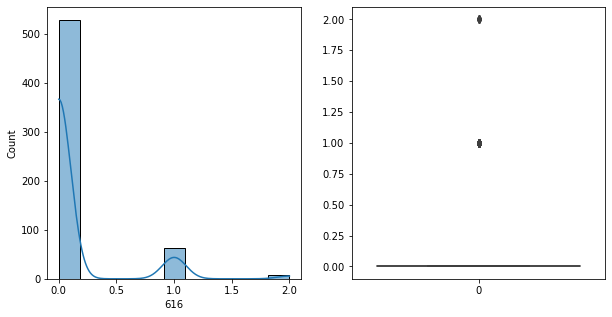

616   Unique :  [1 0 2]
--------------------------------------------------------------------
616   N unique :  3
--------------------------------------------------------------------
616   Value Counts :  0    529
1     63
2      8
Name: 616, dtype: int64
--------------------------------------------------------------------



[ 617 ]
show_df_info :  617


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


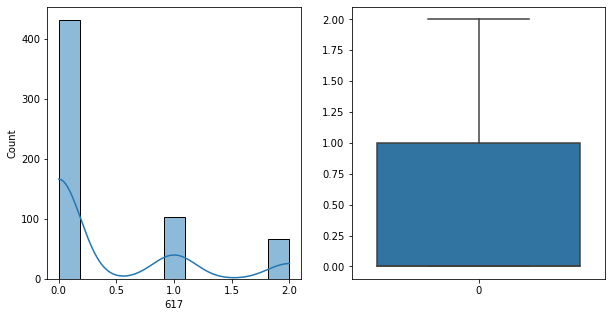

617   Unique :  [1 0 2]
--------------------------------------------------------------------
617   N unique :  3
--------------------------------------------------------------------
617   Value Counts :  0    431
1    103
2     66
Name: 617, dtype: int64
--------------------------------------------------------------------



[ 618 ]
show_df_info :  618


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


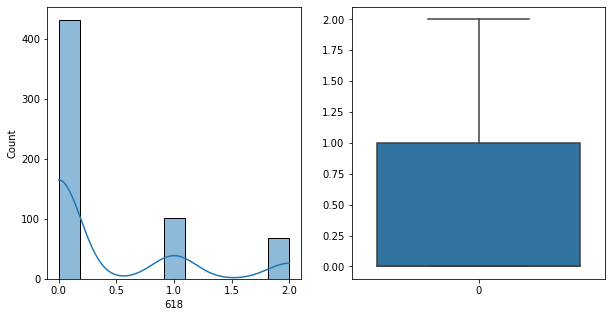

618   Unique :  [1 0 2]
--------------------------------------------------------------------
618   N unique :  3
--------------------------------------------------------------------
618   Value Counts :  0    431
1    101
2     68
Name: 618, dtype: int64
--------------------------------------------------------------------



[ 619 ]
show_df_info :  619


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


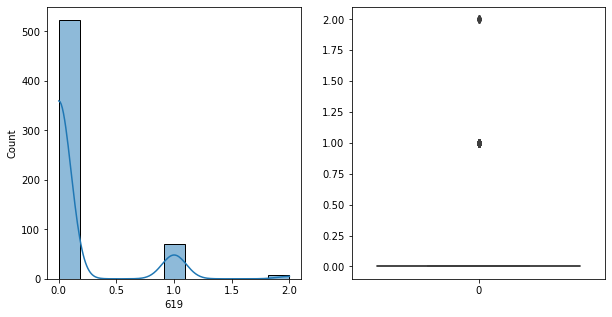

619   Unique :  [1 0 2]
--------------------------------------------------------------------
619   N unique :  3
--------------------------------------------------------------------
619   Value Counts :  0    523
1     70
2      7
Name: 619, dtype: int64
--------------------------------------------------------------------



[ 620 ]
show_df_info :  620


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


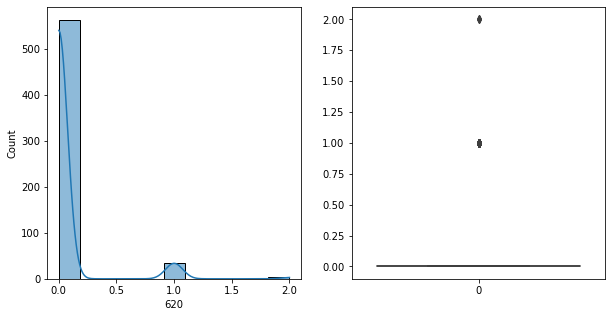

620   Unique :  [0 2 1]
--------------------------------------------------------------------
620   N unique :  3
--------------------------------------------------------------------
620   Value Counts :  0    562
1     35
2      3
Name: 620, dtype: int64
--------------------------------------------------------------------



[ 621 ]
show_df_info :  621


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


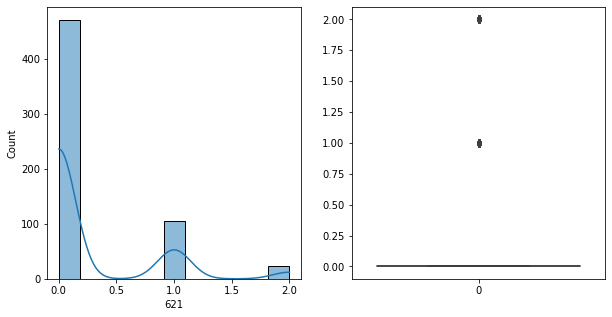

621   Unique :  [0 2 1]
--------------------------------------------------------------------
621   N unique :  3
--------------------------------------------------------------------
621   Value Counts :  0    471
1    105
2     24
Name: 621, dtype: int64
--------------------------------------------------------------------



[ 622 ]
show_df_info :  622


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


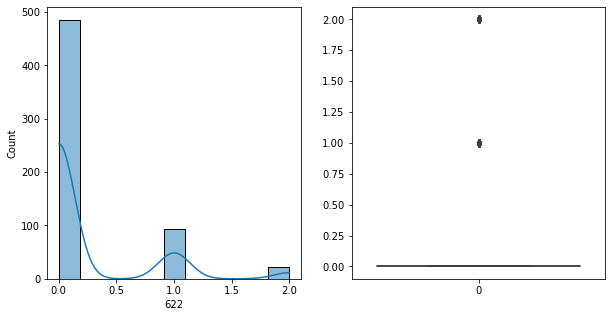

622   Unique :  [0 1 2]
--------------------------------------------------------------------
622   N unique :  3
--------------------------------------------------------------------
622   Value Counts :  0    485
1     93
2     22
Name: 622, dtype: int64
--------------------------------------------------------------------



[ 623 ]
show_df_info :  623


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


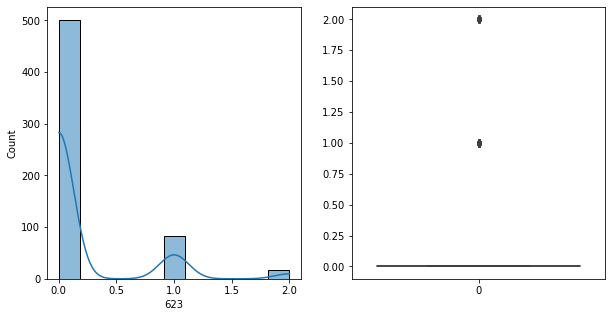

623   Unique :  [0 1 2]
--------------------------------------------------------------------
623   N unique :  3
--------------------------------------------------------------------
623   Value Counts :  0    501
1     82
2     17
Name: 623, dtype: int64
--------------------------------------------------------------------



[ 624 ]
show_df_info :  624


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


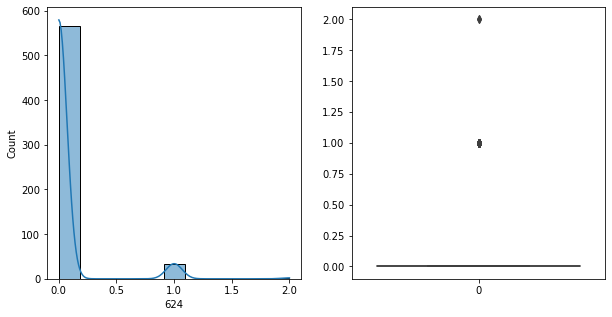

624   Unique :  [0 1 2]
--------------------------------------------------------------------
624   N unique :  3
--------------------------------------------------------------------
624   Value Counts :  0    565
1     33
2      2
Name: 624, dtype: int64
--------------------------------------------------------------------



[ 625 ]
show_df_info :  625


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


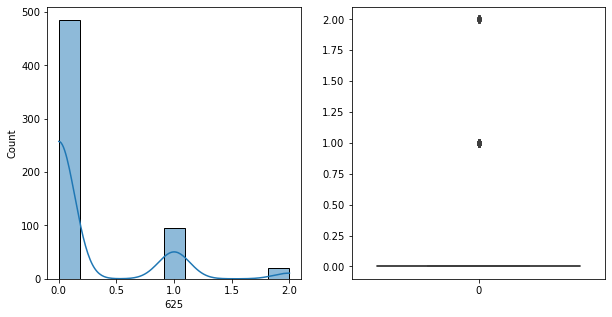

625   Unique :  [2 0 1]
--------------------------------------------------------------------
625   N unique :  3
--------------------------------------------------------------------
625   Value Counts :  0    485
1     95
2     20
Name: 625, dtype: int64
--------------------------------------------------------------------



[ 626 ]
show_df_info :  626


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


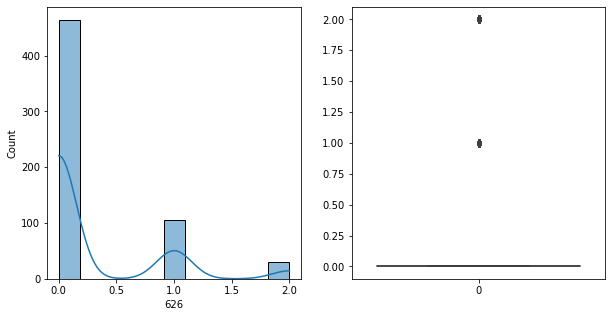

626   Unique :  [0 1 2]
--------------------------------------------------------------------
626   N unique :  3
--------------------------------------------------------------------
626   Value Counts :  0    464
1    106
2     30
Name: 626, dtype: int64
--------------------------------------------------------------------



[ 627 ]
show_df_info :  627


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


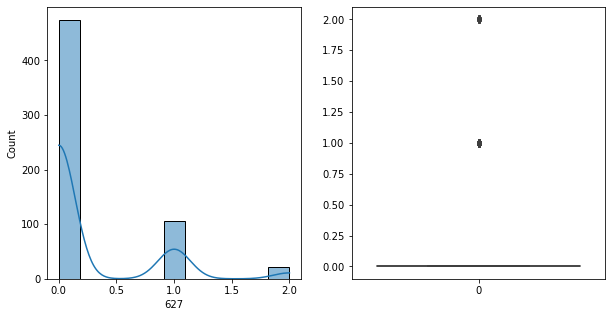

627   Unique :  [0 1 2]
--------------------------------------------------------------------
627   N unique :  3
--------------------------------------------------------------------
627   Value Counts :  0    474
1    105
2     21
Name: 627, dtype: int64
--------------------------------------------------------------------



[ 628 ]
show_df_info :  628


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


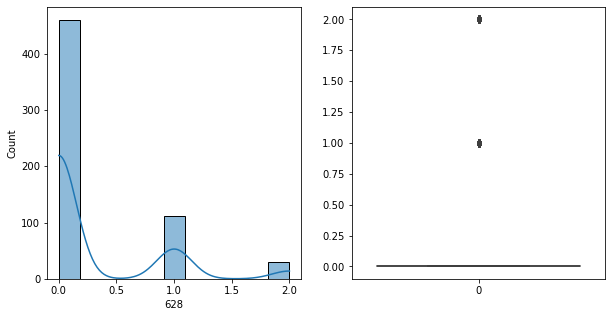

628   Unique :  [2 0 1]
--------------------------------------------------------------------
628   N unique :  3
--------------------------------------------------------------------
628   Value Counts :  0    460
1    111
2     29
Name: 628, dtype: int64
--------------------------------------------------------------------



[ 629 ]
show_df_info :  629


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


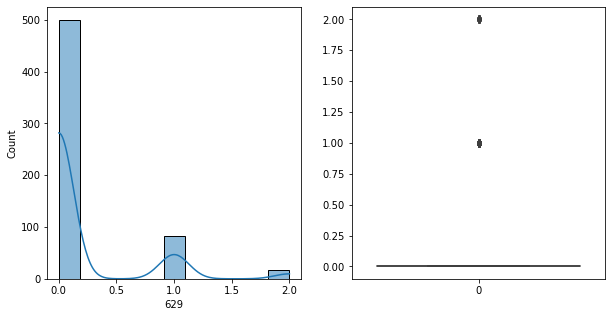

629   Unique :  [0 1 2]
--------------------------------------------------------------------
629   N unique :  3
--------------------------------------------------------------------
629   Value Counts :  0    500
1     83
2     17
Name: 629, dtype: int64
--------------------------------------------------------------------



[ 630 ]
show_df_info :  630


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


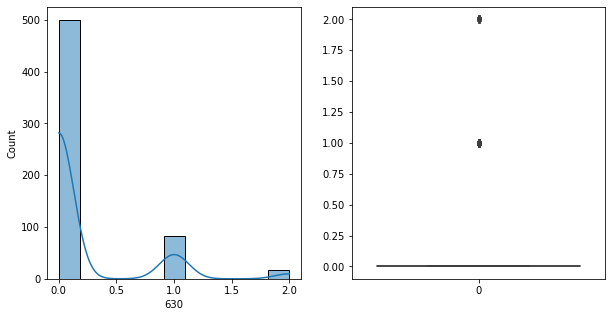

630   Unique :  [0 1 2]
--------------------------------------------------------------------
630   N unique :  3
--------------------------------------------------------------------
630   Value Counts :  0    500
1     83
2     17
Name: 630, dtype: int64
--------------------------------------------------------------------



[ 631 ]
show_df_info :  631


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


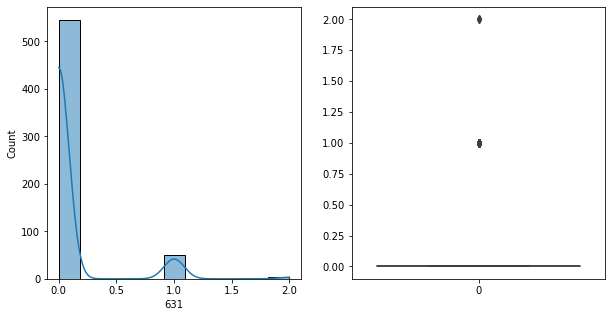

631   Unique :  [1 0 2]
--------------------------------------------------------------------
631   N unique :  3
--------------------------------------------------------------------
631   Value Counts :  0    545
1     51
2      4
Name: 631, dtype: int64
--------------------------------------------------------------------



[ 632 ]
show_df_info :  632


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


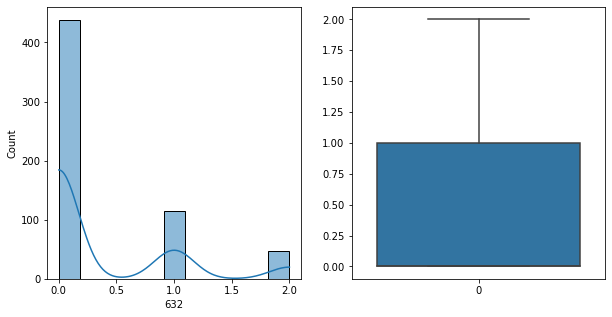

632   Unique :  [1 0 2]
--------------------------------------------------------------------
632   N unique :  3
--------------------------------------------------------------------
632   Value Counts :  0    438
1    115
2     47
Name: 632, dtype: int64
--------------------------------------------------------------------



[ 633 ]
show_df_info :  633


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


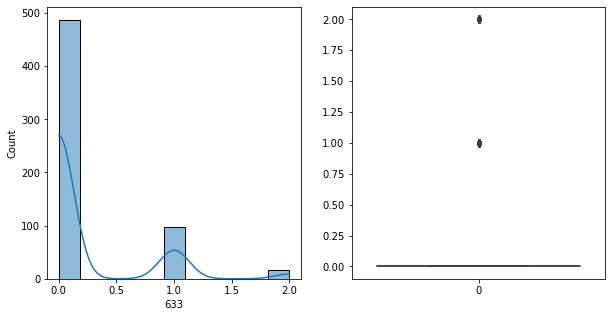

633   Unique :  [1 0 2]
--------------------------------------------------------------------
633   N unique :  3
--------------------------------------------------------------------
633   Value Counts :  0    487
1     97
2     16
Name: 633, dtype: int64
--------------------------------------------------------------------



[ 634 ]
show_df_info :  634


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


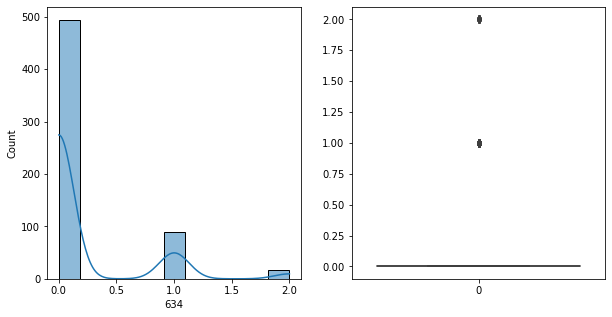

634   Unique :  [0 1 2]
--------------------------------------------------------------------
634   N unique :  3
--------------------------------------------------------------------
634   Value Counts :  0    494
1     89
2     17
Name: 634, dtype: int64
--------------------------------------------------------------------



[ 635 ]
show_df_info :  635


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


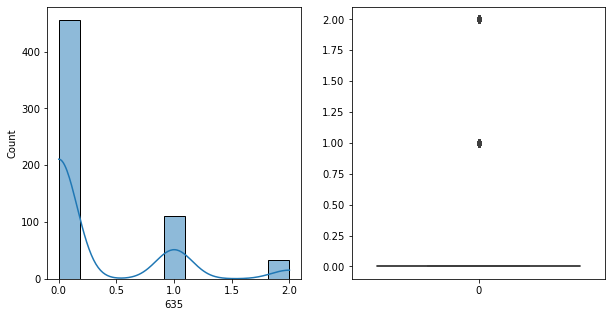

635   Unique :  [0 1 2]
--------------------------------------------------------------------
635   N unique :  3
--------------------------------------------------------------------
635   Value Counts :  0    456
1    111
2     33
Name: 635, dtype: int64
--------------------------------------------------------------------



[ 636 ]
show_df_info :  636


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


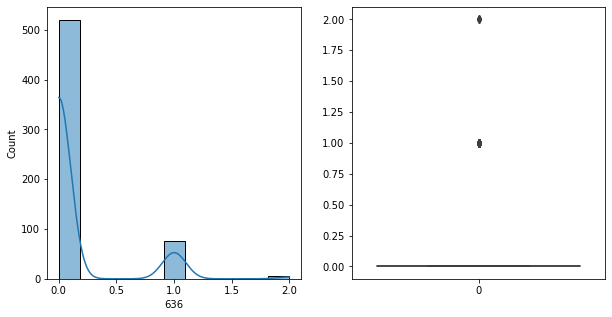

636   Unique :  [1 0 2]
--------------------------------------------------------------------
636   N unique :  3
--------------------------------------------------------------------
636   Value Counts :  0    520
1     75
2      5
Name: 636, dtype: int64
--------------------------------------------------------------------



[ 637 ]
show_df_info :  637


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


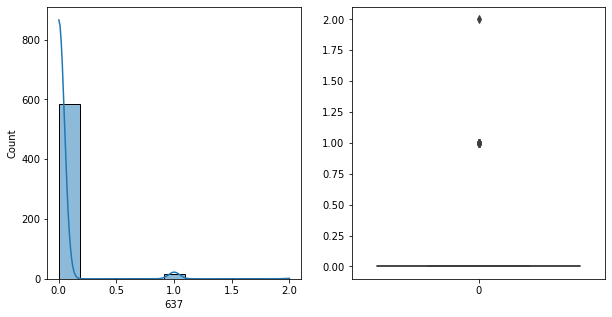

637   Unique :  [0 1 2]
--------------------------------------------------------------------
637   N unique :  3
--------------------------------------------------------------------
637   Value Counts :  0    584
1     15
2      1
Name: 637, dtype: int64
--------------------------------------------------------------------



[ 638 ]
show_df_info :  638


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


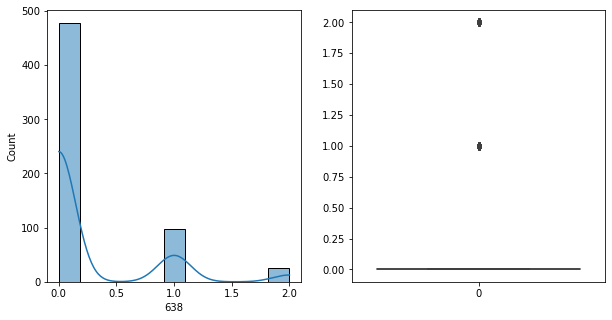

638   Unique :  [1 0 2]
--------------------------------------------------------------------
638   N unique :  3
--------------------------------------------------------------------
638   Value Counts :  0    478
1     97
2     25
Name: 638, dtype: int64
--------------------------------------------------------------------



[ 639 ]
show_df_info :  639


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


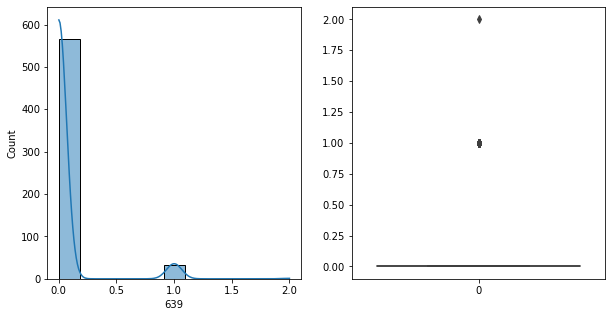

639   Unique :  [0 1 2]
--------------------------------------------------------------------
639   N unique :  3
--------------------------------------------------------------------
639   Value Counts :  0    566
1     33
2      1
Name: 639, dtype: int64
--------------------------------------------------------------------



[ 640 ]
show_df_info :  640


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


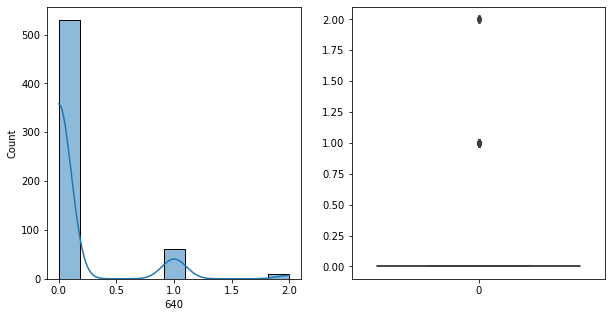

640   Unique :  [0 2 1]
--------------------------------------------------------------------
640   N unique :  3
--------------------------------------------------------------------
640   Value Counts :  0    530
1     60
2     10
Name: 640, dtype: int64
--------------------------------------------------------------------



[ 641 ]
show_df_info :  641


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


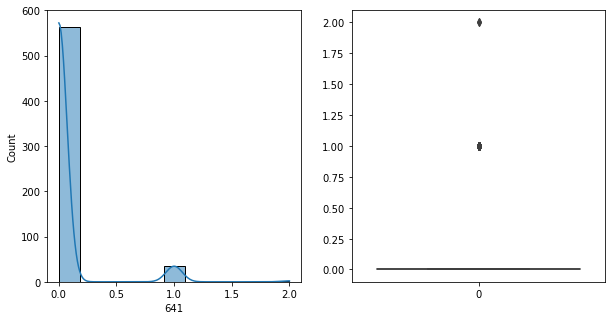

641   Unique :  [0 1 2]
--------------------------------------------------------------------
641   N unique :  3
--------------------------------------------------------------------
641   Value Counts :  0    564
1     34
2      2
Name: 641, dtype: int64
--------------------------------------------------------------------



[ 642 ]
show_df_info :  642


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


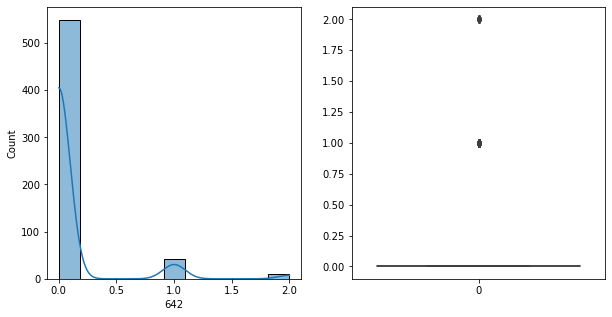

642   Unique :  [0 1 2]
--------------------------------------------------------------------
642   N unique :  3
--------------------------------------------------------------------
642   Value Counts :  0    549
1     41
2     10
Name: 642, dtype: int64
--------------------------------------------------------------------



[ 643 ]
show_df_info :  643


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


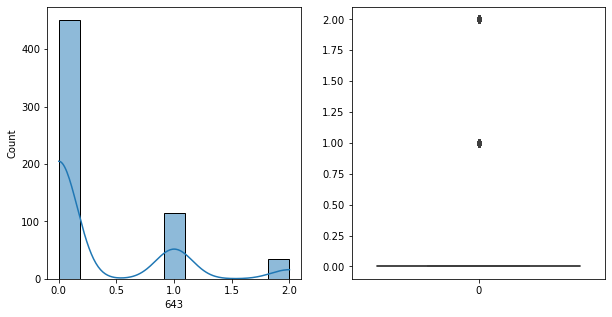

643   Unique :  [0 1 2]
--------------------------------------------------------------------
643   N unique :  3
--------------------------------------------------------------------
643   Value Counts :  0    451
1    114
2     35
Name: 643, dtype: int64
--------------------------------------------------------------------



[ 644 ]
show_df_info :  644


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


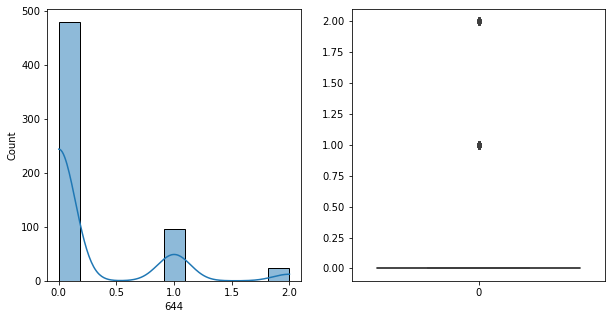

644   Unique :  [0 1 2]
--------------------------------------------------------------------
644   N unique :  3
--------------------------------------------------------------------
644   Value Counts :  0    480
1     96
2     24
Name: 644, dtype: int64
--------------------------------------------------------------------



[ 645 ]
show_df_info :  645


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


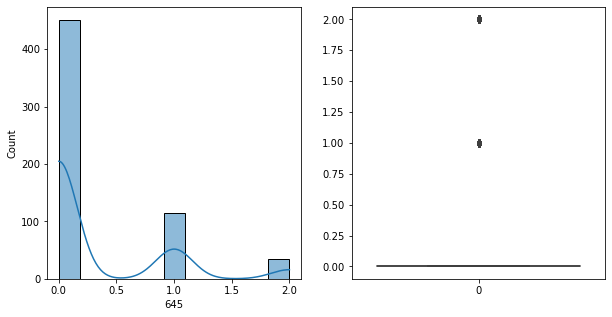

645   Unique :  [0 1 2]
--------------------------------------------------------------------
645   N unique :  3
--------------------------------------------------------------------
645   Value Counts :  0    451
1    114
2     35
Name: 645, dtype: int64
--------------------------------------------------------------------



[ 646 ]
show_df_info :  646


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


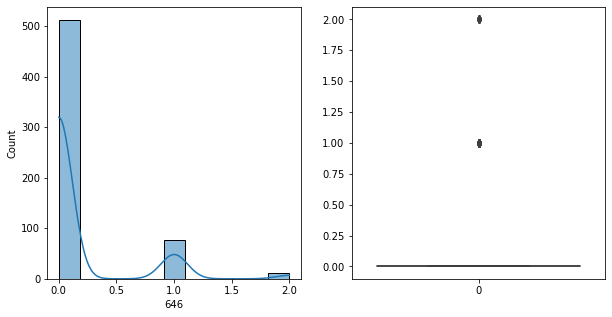

646   Unique :  [0 1 2]
--------------------------------------------------------------------
646   N unique :  3
--------------------------------------------------------------------
646   Value Counts :  0    512
1     77
2     11
Name: 646, dtype: int64
--------------------------------------------------------------------



[ 647 ]
show_df_info :  647


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


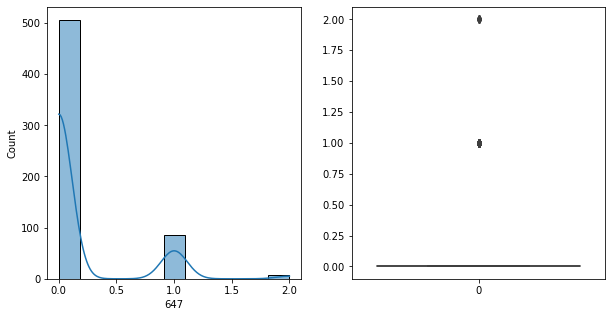

647   Unique :  [0 1 2]
--------------------------------------------------------------------
647   N unique :  3
--------------------------------------------------------------------
647   Value Counts :  0    506
1     86
2      8
Name: 647, dtype: int64
--------------------------------------------------------------------



[ 648 ]
show_df_info :  648


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


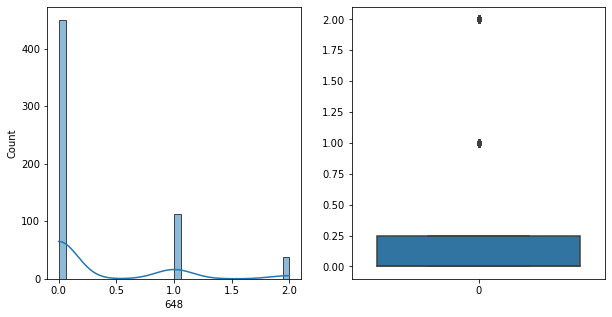

648   Unique :  [0 1 2]
--------------------------------------------------------------------
648   N unique :  3
--------------------------------------------------------------------
648   Value Counts :  0    450
1    112
2     38
Name: 648, dtype: int64
--------------------------------------------------------------------



[ 649 ]
show_df_info :  649


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


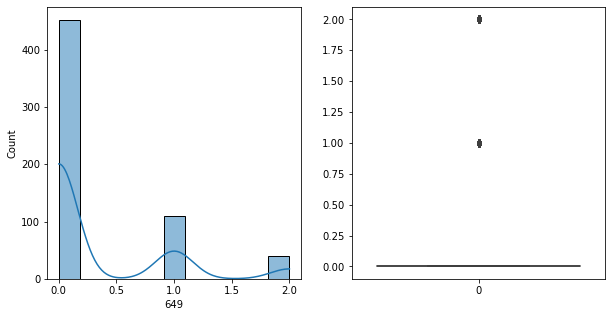

649   Unique :  [0 1 2]
--------------------------------------------------------------------
649   N unique :  3
--------------------------------------------------------------------
649   Value Counts :  0    452
1    109
2     39
Name: 649, dtype: int64
--------------------------------------------------------------------



[ 650 ]
show_df_info :  650


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


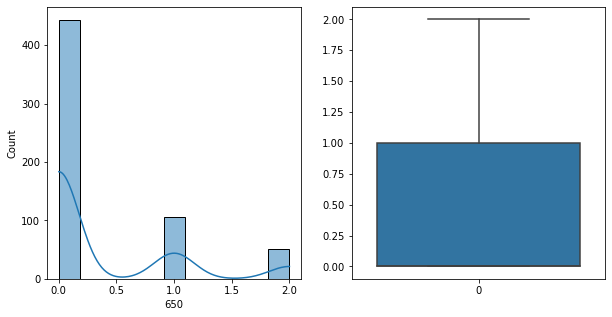

650   Unique :  [1 0 2]
--------------------------------------------------------------------
650   N unique :  3
--------------------------------------------------------------------
650   Value Counts :  0    443
1    106
2     51
Name: 650, dtype: int64
--------------------------------------------------------------------



[ 651 ]
show_df_info :  651


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


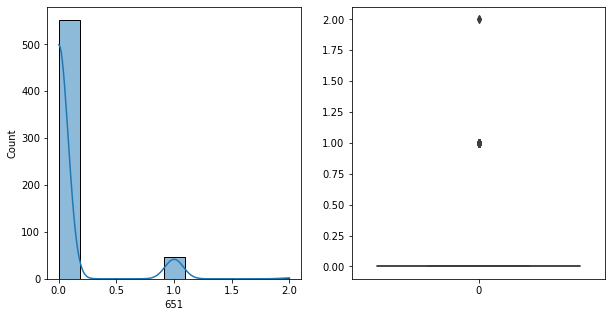

651   Unique :  [1 0 2]
--------------------------------------------------------------------
651   N unique :  3
--------------------------------------------------------------------
651   Value Counts :  0    552
1     46
2      2
Name: 651, dtype: int64
--------------------------------------------------------------------



[ 652 ]
show_df_info :  652


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


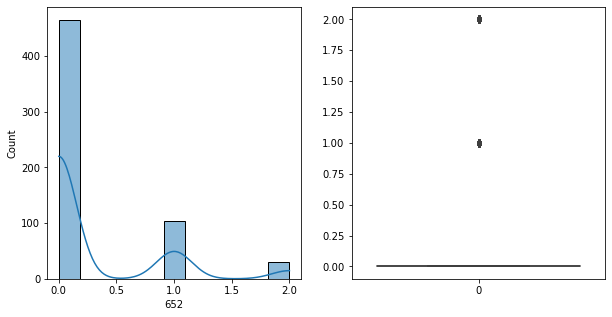

652   Unique :  [1 0 2]
--------------------------------------------------------------------
652   N unique :  3
--------------------------------------------------------------------
652   Value Counts :  0    465
1    104
2     31
Name: 652, dtype: int64
--------------------------------------------------------------------



[ 653 ]
show_df_info :  653


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


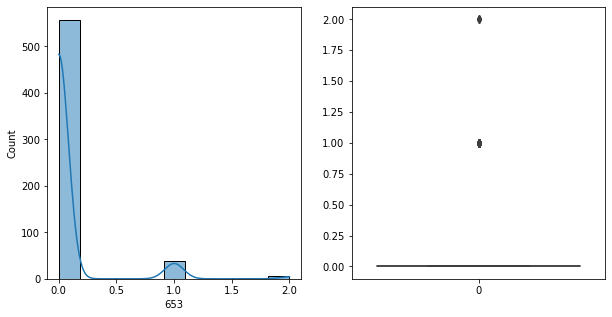

653   Unique :  [0 1 2]
--------------------------------------------------------------------
653   N unique :  3
--------------------------------------------------------------------
653   Value Counts :  0    557
1     38
2      5
Name: 653, dtype: int64
--------------------------------------------------------------------



[ 654 ]
show_df_info :  654


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


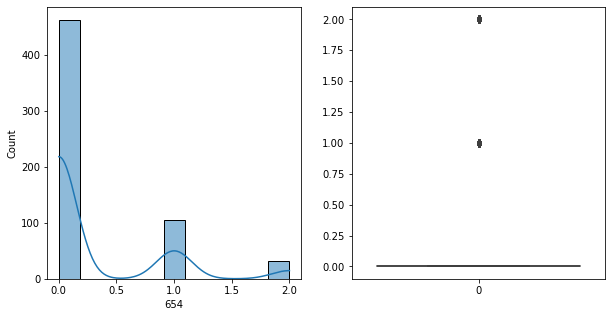

654   Unique :  [1 0 2]
--------------------------------------------------------------------
654   N unique :  3
--------------------------------------------------------------------
654   Value Counts :  0    463
1    106
2     31
Name: 654, dtype: int64
--------------------------------------------------------------------



[ 655 ]
show_df_info :  655


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


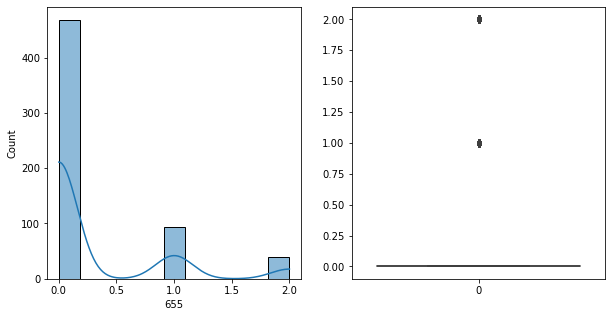

655   Unique :  [0 1 2]
--------------------------------------------------------------------
655   N unique :  3
--------------------------------------------------------------------
655   Value Counts :  0    468
1     93
2     39
Name: 655, dtype: int64
--------------------------------------------------------------------



[ 656 ]
show_df_info :  656


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


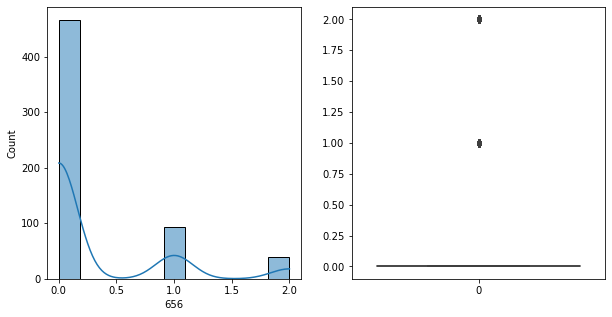

656   Unique :  [0 1 2]
--------------------------------------------------------------------
656   N unique :  3
--------------------------------------------------------------------
656   Value Counts :  0    466
1     94
2     40
Name: 656, dtype: int64
--------------------------------------------------------------------



[ 657 ]
show_df_info :  657


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


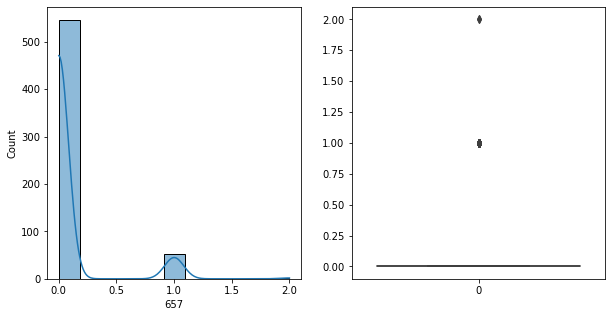

657   Unique :  [0 1 2]
--------------------------------------------------------------------
657   N unique :  3
--------------------------------------------------------------------
657   Value Counts :  0    546
1     52
2      2
Name: 657, dtype: int64
--------------------------------------------------------------------



[ 658 ]
show_df_info :  658


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


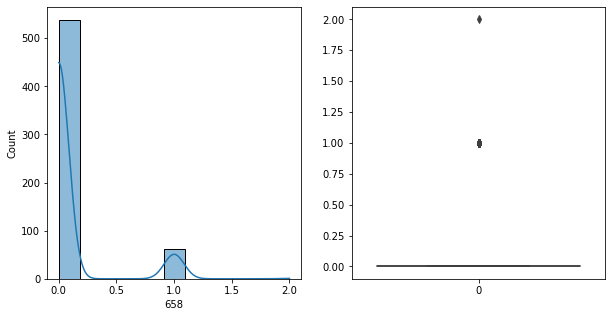

658   Unique :  [0 1 2]
--------------------------------------------------------------------
658   N unique :  3
--------------------------------------------------------------------
658   Value Counts :  0    538
1     61
2      1
Name: 658, dtype: int64
--------------------------------------------------------------------



[ 659 ]
show_df_info :  659


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


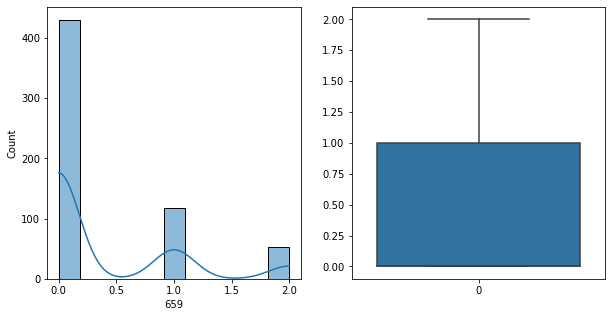

659   Unique :  [2 0 1]
--------------------------------------------------------------------
659   N unique :  3
--------------------------------------------------------------------
659   Value Counts :  0    430
1    118
2     52
Name: 659, dtype: int64
--------------------------------------------------------------------



[ 660 ]
show_df_info :  660


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


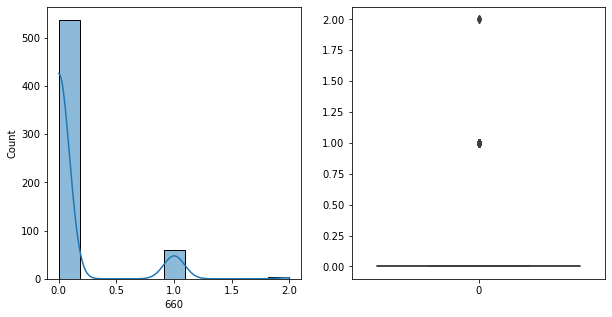

660   Unique :  [0 1 2]
--------------------------------------------------------------------
660   N unique :  3
--------------------------------------------------------------------
660   Value Counts :  0    537
1     60
2      3
Name: 660, dtype: int64
--------------------------------------------------------------------



[ 661 ]
show_df_info :  661


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


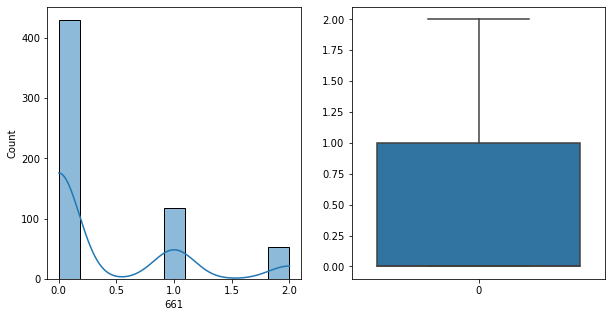

661   Unique :  [2 0 1]
--------------------------------------------------------------------
661   N unique :  3
--------------------------------------------------------------------
661   Value Counts :  0    430
1    118
2     52
Name: 661, dtype: int64
--------------------------------------------------------------------



[ 662 ]
show_df_info :  662


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


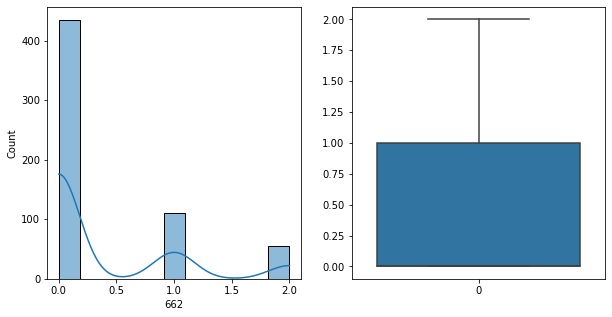

662   Unique :  [0 1 2]
--------------------------------------------------------------------
662   N unique :  3
--------------------------------------------------------------------
662   Value Counts :  0    435
1    110
2     55
Name: 662, dtype: int64
--------------------------------------------------------------------



[ 663 ]
show_df_info :  663


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


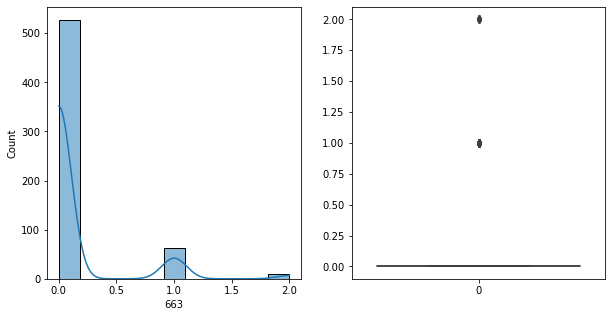

663   Unique :  [0 1 2]
--------------------------------------------------------------------
663   N unique :  3
--------------------------------------------------------------------
663   Value Counts :  0    527
1     63
2     10
Name: 663, dtype: int64
--------------------------------------------------------------------



[ 664 ]
show_df_info :  664


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


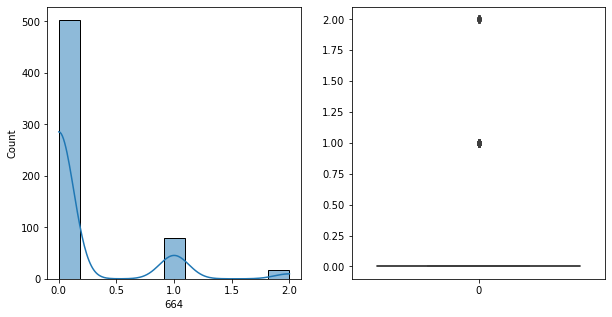

664   Unique :  [0 1 2]
--------------------------------------------------------------------
664   N unique :  3
--------------------------------------------------------------------
664   Value Counts :  0    503
1     80
2     17
Name: 664, dtype: int64
--------------------------------------------------------------------



[ 665 ]
show_df_info :  665


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


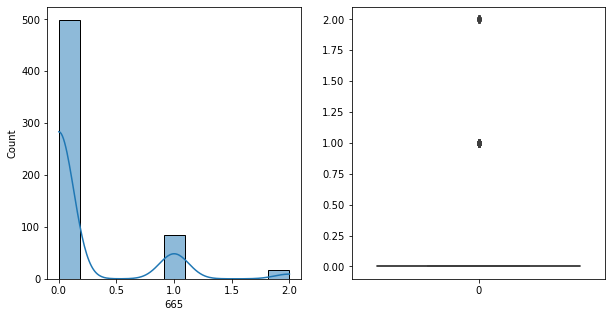

665   Unique :  [0 1 2]
--------------------------------------------------------------------
665   N unique :  3
--------------------------------------------------------------------
665   Value Counts :  0    499
1     85
2     16
Name: 665, dtype: int64
--------------------------------------------------------------------



[ 666 ]
show_df_info :  666


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


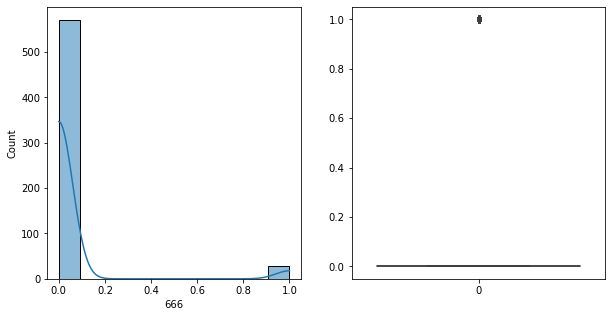

666   Unique :  [0 1]
--------------------------------------------------------------------
666   N unique :  2
--------------------------------------------------------------------
666   Value Counts :  0    571
1     29
Name: 666, dtype: int64
--------------------------------------------------------------------



[ 667 ]
show_df_info :  667


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


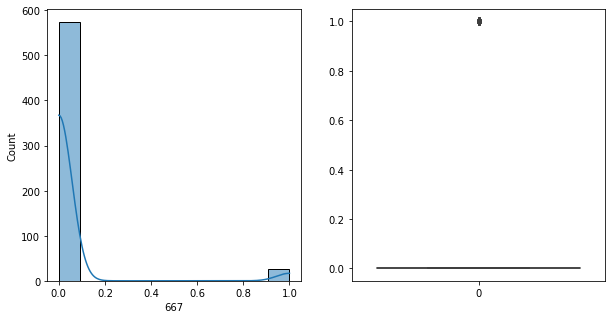

667   Unique :  [0 1]
--------------------------------------------------------------------
667   N unique :  2
--------------------------------------------------------------------
667   Value Counts :  0    574
1     26
Name: 667, dtype: int64
--------------------------------------------------------------------



[ 668 ]
show_df_info :  668


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


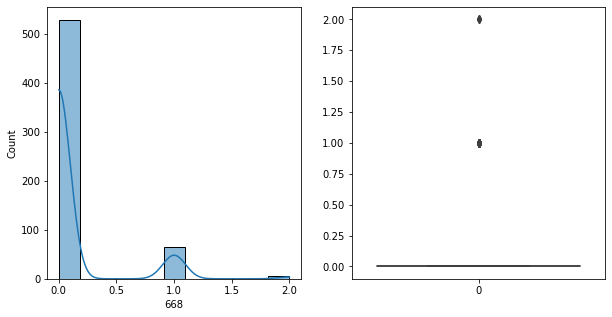

668   Unique :  [0 1 2]
--------------------------------------------------------------------
668   N unique :  3
--------------------------------------------------------------------
668   Value Counts :  0    529
1     66
2      5
Name: 668, dtype: int64
--------------------------------------------------------------------



[ 669 ]
show_df_info :  669


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


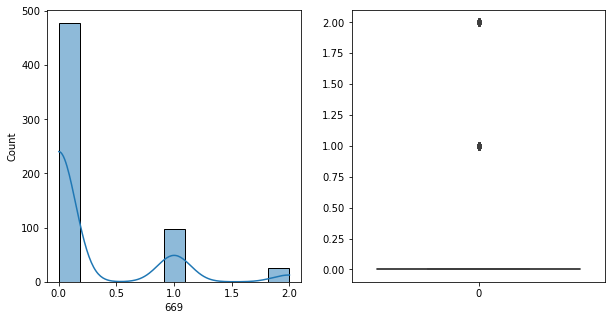

669   Unique :  [1 0 2]
--------------------------------------------------------------------
669   N unique :  3
--------------------------------------------------------------------
669   Value Counts :  0    478
1     97
2     25
Name: 669, dtype: int64
--------------------------------------------------------------------



[ 670 ]
show_df_info :  670


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


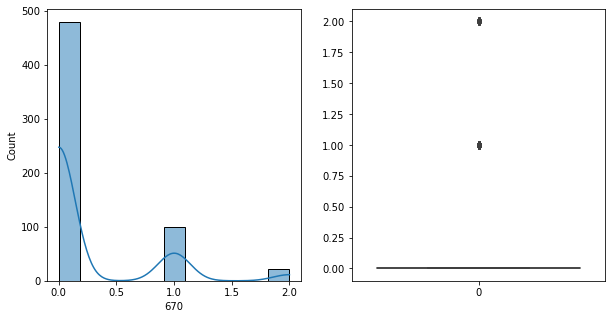

670   Unique :  [1 0 2]
--------------------------------------------------------------------
670   N unique :  3
--------------------------------------------------------------------
670   Value Counts :  0    479
1     99
2     22
Name: 670, dtype: int64
--------------------------------------------------------------------



[ 671 ]
show_df_info :  671


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


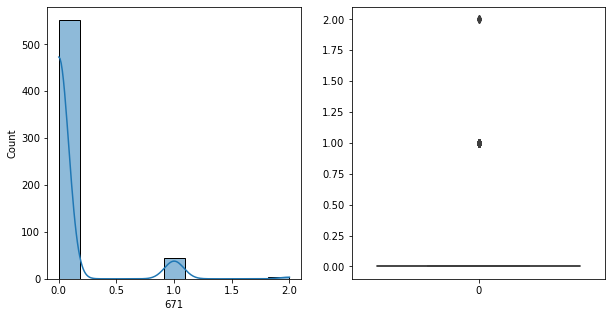

671   Unique :  [0 1 2]
--------------------------------------------------------------------
671   N unique :  3
--------------------------------------------------------------------
671   Value Counts :  0    552
1     44
2      4
Name: 671, dtype: int64
--------------------------------------------------------------------



[ 672 ]
show_df_info :  672


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


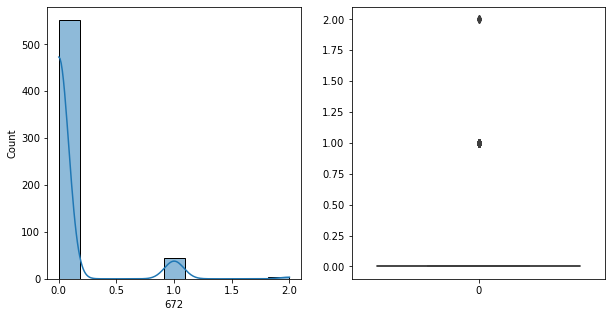

672   Unique :  [0 1 2]
--------------------------------------------------------------------
672   N unique :  3
--------------------------------------------------------------------
672   Value Counts :  0    552
1     44
2      4
Name: 672, dtype: int64
--------------------------------------------------------------------



[ 673 ]
show_df_info :  673


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


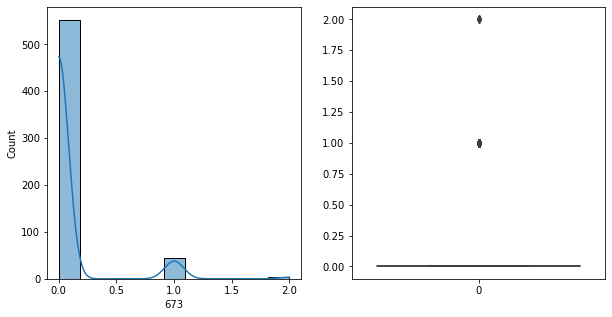

673   Unique :  [0 1 2]
--------------------------------------------------------------------
673   N unique :  3
--------------------------------------------------------------------
673   Value Counts :  0    552
1     44
2      4
Name: 673, dtype: int64
--------------------------------------------------------------------



[ 674 ]
show_df_info :  674


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


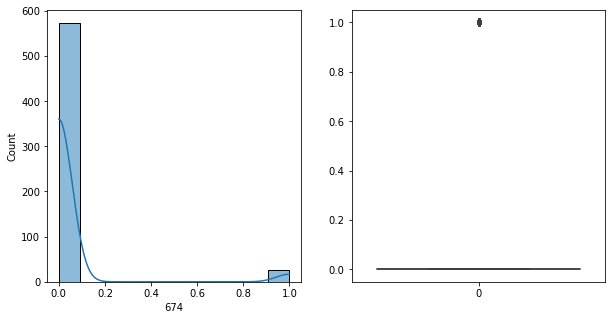

674   Unique :  [0 1]
--------------------------------------------------------------------
674   N unique :  2
--------------------------------------------------------------------
674   Value Counts :  0    573
1     27
Name: 674, dtype: int64
--------------------------------------------------------------------



[ 675 ]
show_df_info :  675


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


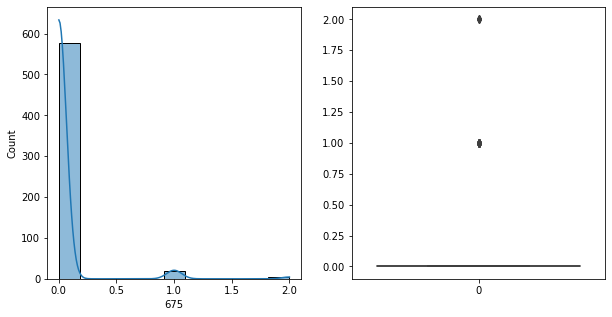

675   Unique :  [0 1 2]
--------------------------------------------------------------------
675   N unique :  3
--------------------------------------------------------------------
675   Value Counts :  0    577
1     19
2      4
Name: 675, dtype: int64
--------------------------------------------------------------------



[ 676 ]
show_df_info :  676


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


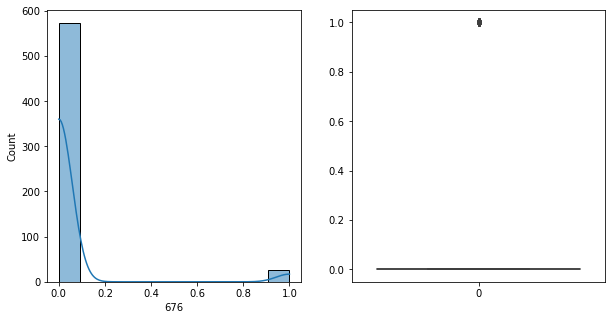

676   Unique :  [0 1]
--------------------------------------------------------------------
676   N unique :  2
--------------------------------------------------------------------
676   Value Counts :  0    573
1     27
Name: 676, dtype: int64
--------------------------------------------------------------------



[ 677 ]
show_df_info :  677


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


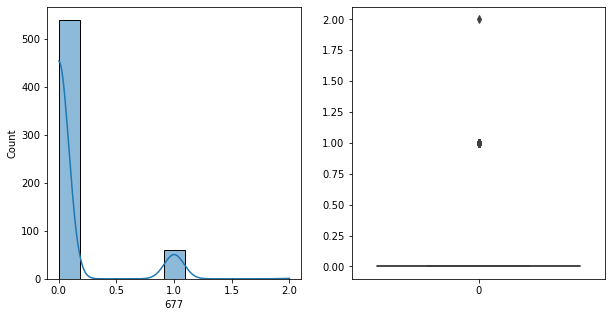

677   Unique :  [0 1 2]
--------------------------------------------------------------------
677   N unique :  3
--------------------------------------------------------------------
677   Value Counts :  0    539
1     60
2      1
Name: 677, dtype: int64
--------------------------------------------------------------------



[ 678 ]
show_df_info :  678


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


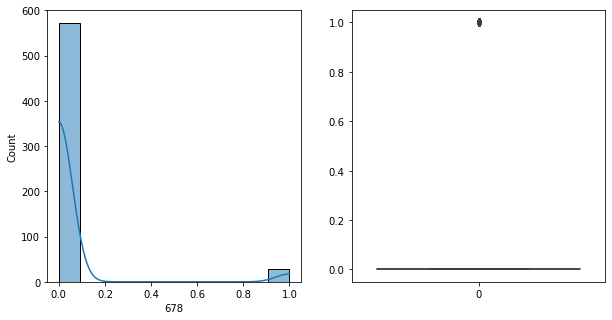

678   Unique :  [0 1]
--------------------------------------------------------------------
678   N unique :  2
--------------------------------------------------------------------
678   Value Counts :  0    572
1     28
Name: 678, dtype: int64
--------------------------------------------------------------------



[ 679 ]
show_df_info :  679


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


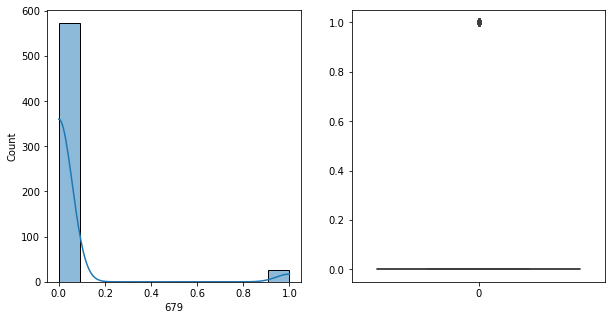

679   Unique :  [0 1]
--------------------------------------------------------------------
679   N unique :  2
--------------------------------------------------------------------
679   Value Counts :  0    573
1     27
Name: 679, dtype: int64
--------------------------------------------------------------------



[ 680 ]
show_df_info :  680


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


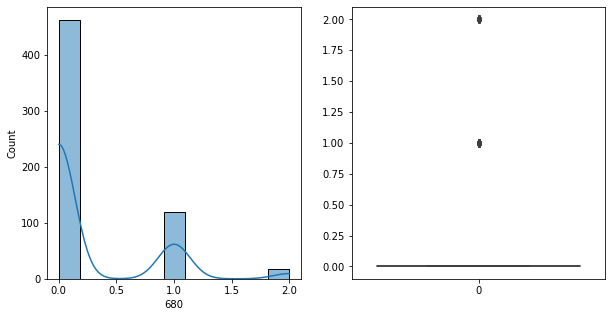

680   Unique :  [0 1 2]
--------------------------------------------------------------------
680   N unique :  3
--------------------------------------------------------------------
680   Value Counts :  0    463
1    119
2     18
Name: 680, dtype: int64
--------------------------------------------------------------------



[ 681 ]
show_df_info :  681


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


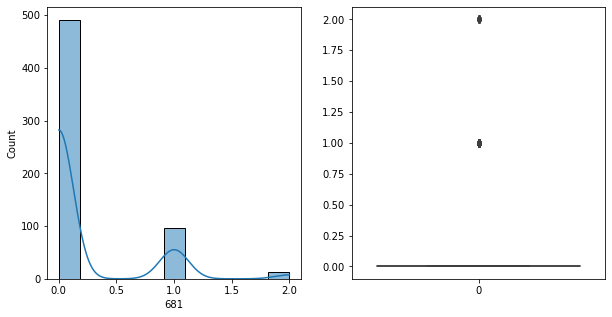

681   Unique :  [0 1 2]
--------------------------------------------------------------------
681   N unique :  3
--------------------------------------------------------------------
681   Value Counts :  0    491
1     96
2     13
Name: 681, dtype: int64
--------------------------------------------------------------------



[ 682 ]
show_df_info :  682


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


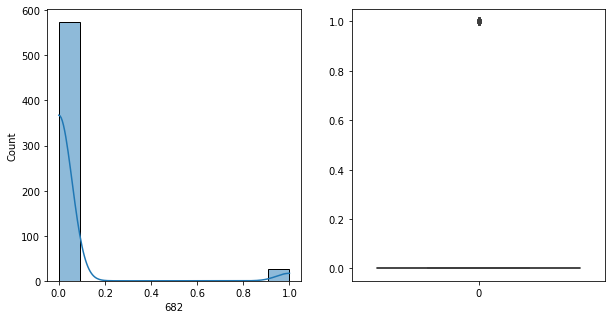

682   Unique :  [0 1]
--------------------------------------------------------------------
682   N unique :  2
--------------------------------------------------------------------
682   Value Counts :  0    574
1     26
Name: 682, dtype: int64
--------------------------------------------------------------------



[ 683 ]
show_df_info :  683


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


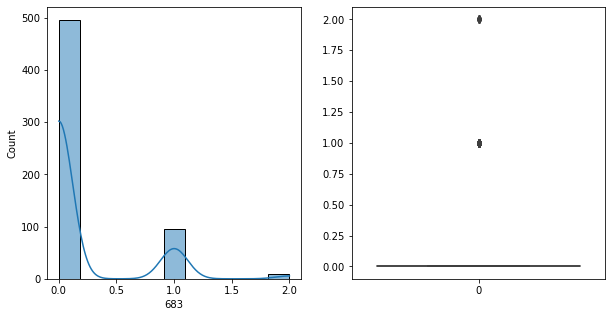

683   Unique :  [0 1 2]
--------------------------------------------------------------------
683   N unique :  3
--------------------------------------------------------------------
683   Value Counts :  0    496
1     95
2      9
Name: 683, dtype: int64
--------------------------------------------------------------------



[ 684 ]
show_df_info :  684


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


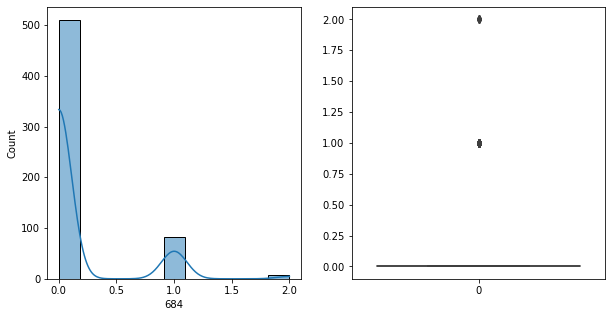

684   Unique :  [0 1 2]
--------------------------------------------------------------------
684   N unique :  3
--------------------------------------------------------------------
684   Value Counts :  0    510
1     83
2      7
Name: 684, dtype: int64
--------------------------------------------------------------------



[ 685 ]
show_df_info :  685


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


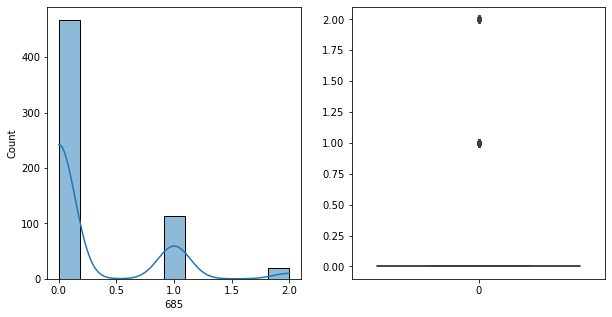

685   Unique :  [0 1 2]
--------------------------------------------------------------------
685   N unique :  3
--------------------------------------------------------------------
685   Value Counts :  0    467
1    114
2     19
Name: 685, dtype: int64
--------------------------------------------------------------------



[ 686 ]
show_df_info :  686


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


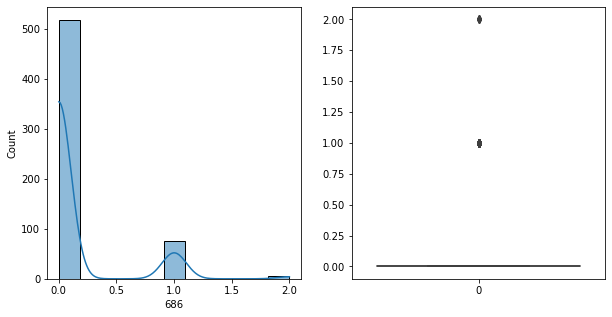

686   Unique :  [0 1 2]
--------------------------------------------------------------------
686   N unique :  3
--------------------------------------------------------------------
686   Value Counts :  0    518
1     76
2      6
Name: 686, dtype: int64
--------------------------------------------------------------------



[ 687 ]
show_df_info :  687


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


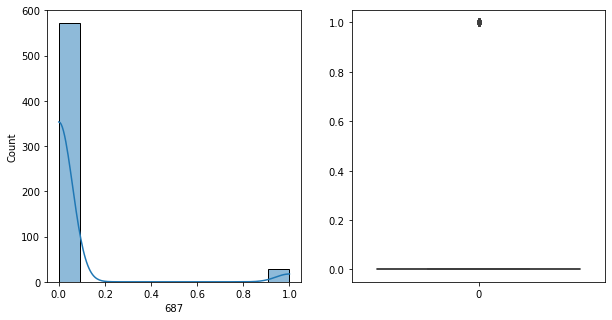

687   Unique :  [0 1]
--------------------------------------------------------------------
687   N unique :  2
--------------------------------------------------------------------
687   Value Counts :  0    572
1     28
Name: 687, dtype: int64
--------------------------------------------------------------------



[ 688 ]
show_df_info :  688


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


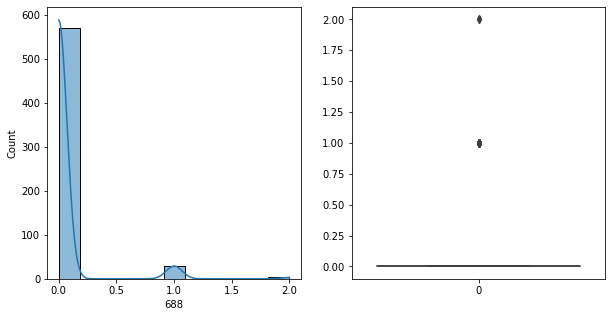

688   Unique :  [0 1 2]
--------------------------------------------------------------------
688   N unique :  3
--------------------------------------------------------------------
688   Value Counts :  0    569
1     28
2      3
Name: 688, dtype: int64
--------------------------------------------------------------------



[ 689 ]
show_df_info :  689


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


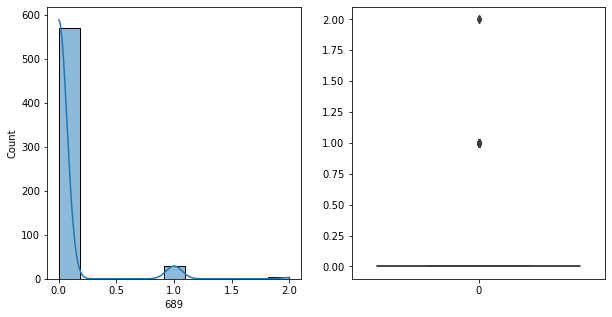

689   Unique :  [0 1 2]
--------------------------------------------------------------------
689   N unique :  3
--------------------------------------------------------------------
689   Value Counts :  0    569
1     28
2      3
Name: 689, dtype: int64
--------------------------------------------------------------------



[ 690 ]
show_df_info :  690


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


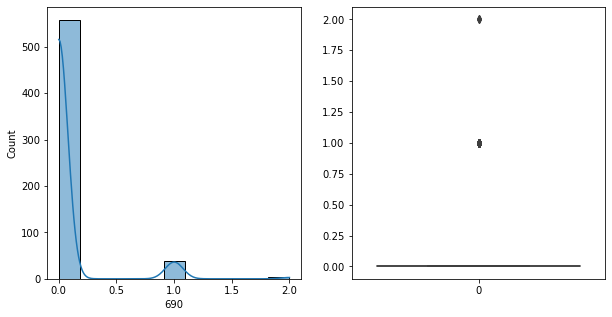

690   Unique :  [0 1 2]
--------------------------------------------------------------------
690   N unique :  3
--------------------------------------------------------------------
690   Value Counts :  0    558
1     39
2      3
Name: 690, dtype: int64
--------------------------------------------------------------------



[ 691 ]
show_df_info :  691


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


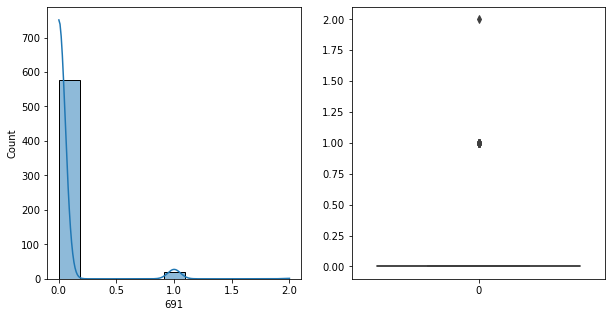

691   Unique :  [0 1 2]
--------------------------------------------------------------------
691   N unique :  3
--------------------------------------------------------------------
691   Value Counts :  0    578
1     21
2      1
Name: 691, dtype: int64
--------------------------------------------------------------------



[ 692 ]
show_df_info :  692


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


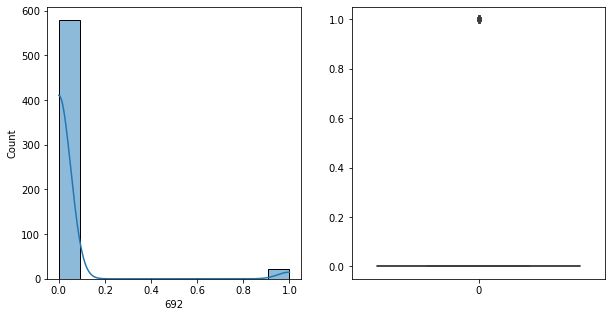

692   Unique :  [0 1]
--------------------------------------------------------------------
692   N unique :  2
--------------------------------------------------------------------
692   Value Counts :  0    579
1     21
Name: 692, dtype: int64
--------------------------------------------------------------------



[ 693 ]
show_df_info :  693


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


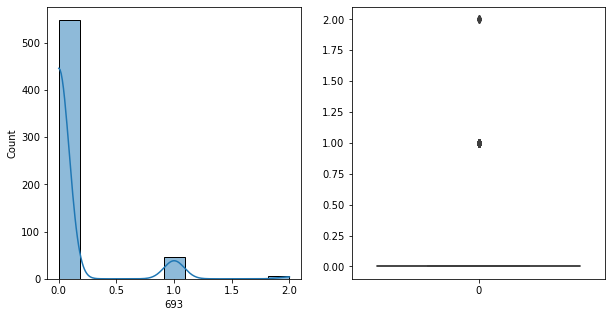

693   Unique :  [0 1 2]
--------------------------------------------------------------------
693   N unique :  3
--------------------------------------------------------------------
693   Value Counts :  0    548
1     47
2      5
Name: 693, dtype: int64
--------------------------------------------------------------------



[ 694 ]
show_df_info :  694


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


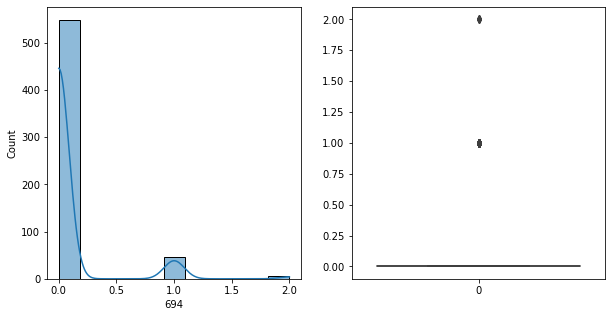

694   Unique :  [0 1 2]
--------------------------------------------------------------------
694   N unique :  3
--------------------------------------------------------------------
694   Value Counts :  0    548
1     47
2      5
Name: 694, dtype: int64
--------------------------------------------------------------------



[ 695 ]
show_df_info :  695


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


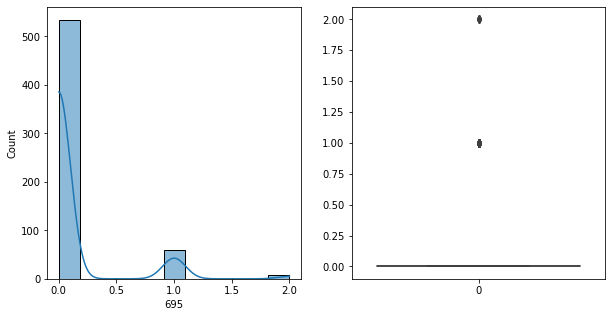

695   Unique :  [1 0 2]
--------------------------------------------------------------------
695   N unique :  3
--------------------------------------------------------------------
695   Value Counts :  0    534
1     59
2      7
Name: 695, dtype: int64
--------------------------------------------------------------------



[ 696 ]
show_df_info :  696


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


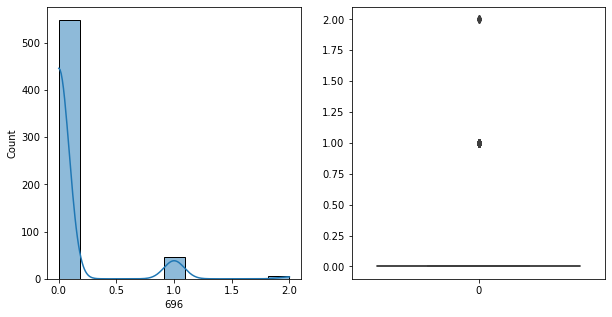

696   Unique :  [0 1 2]
--------------------------------------------------------------------
696   N unique :  3
--------------------------------------------------------------------
696   Value Counts :  0    548
1     47
2      5
Name: 696, dtype: int64
--------------------------------------------------------------------



[ 697 ]
show_df_info :  697


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


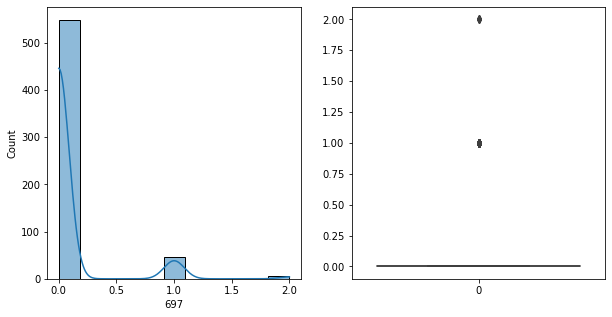

697   Unique :  [0 1 2]
--------------------------------------------------------------------
697   N unique :  3
--------------------------------------------------------------------
697   Value Counts :  0    548
1     47
2      5
Name: 697, dtype: int64
--------------------------------------------------------------------



[ 698 ]
show_df_info :  698


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


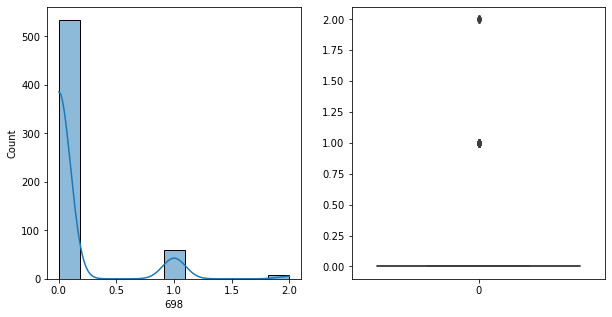

698   Unique :  [1 0 2]
--------------------------------------------------------------------
698   N unique :  3
--------------------------------------------------------------------
698   Value Counts :  0    534
1     59
2      7
Name: 698, dtype: int64
--------------------------------------------------------------------



[ 699 ]
show_df_info :  699


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


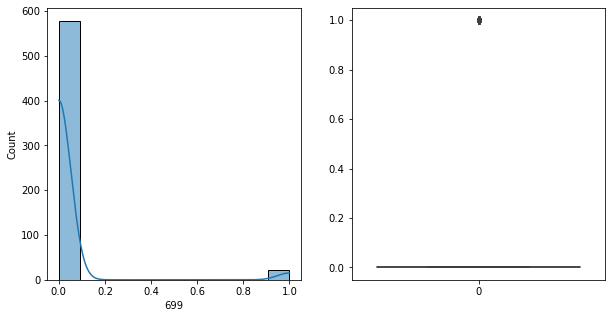

699   Unique :  [0 1]
--------------------------------------------------------------------
699   N unique :  2
--------------------------------------------------------------------
699   Value Counts :  0    578
1     22
Name: 699, dtype: int64
--------------------------------------------------------------------



[ 700 ]
show_df_info :  700


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


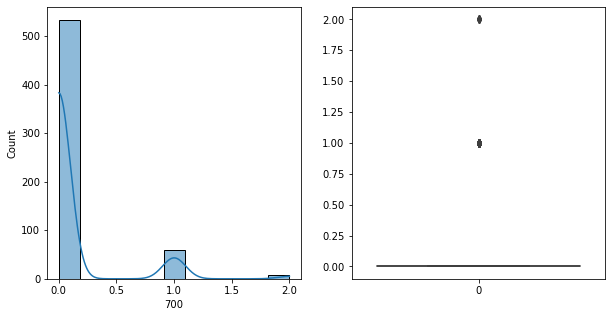

700   Unique :  [0 1 2]
--------------------------------------------------------------------
700   N unique :  3
--------------------------------------------------------------------
700   Value Counts :  0    533
1     60
2      7
Name: 700, dtype: int64
--------------------------------------------------------------------



[ 701 ]
show_df_info :  701


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


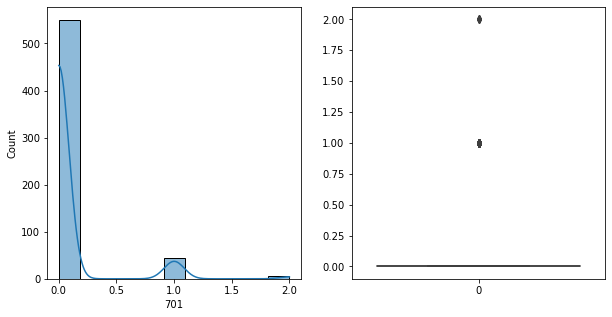

701   Unique :  [0 1 2]
--------------------------------------------------------------------
701   N unique :  3
--------------------------------------------------------------------
701   Value Counts :  0    550
1     45
2      5
Name: 701, dtype: int64
--------------------------------------------------------------------



[ 702 ]
show_df_info :  702


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


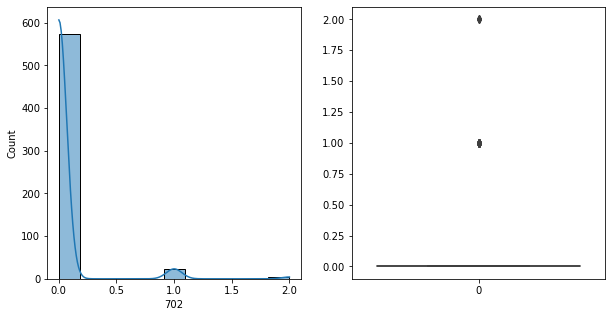

702   Unique :  [0 1 2]
--------------------------------------------------------------------
702   N unique :  3
--------------------------------------------------------------------
702   Value Counts :  0    574
1     22
2      4
Name: 702, dtype: int64
--------------------------------------------------------------------



[ 703 ]
show_df_info :  703


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


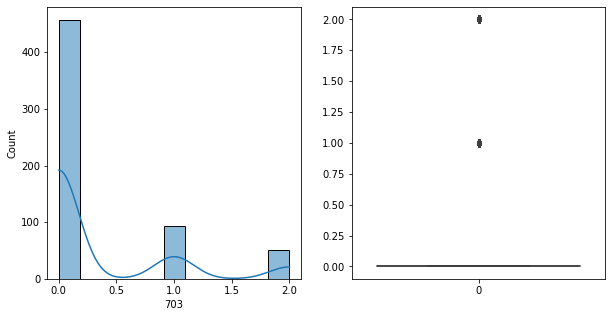

703   Unique :  [0 1 2]
--------------------------------------------------------------------
703   N unique :  3
--------------------------------------------------------------------
703   Value Counts :  0    457
1     93
2     50
Name: 703, dtype: int64
--------------------------------------------------------------------



[ 704 ]
show_df_info :  704


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


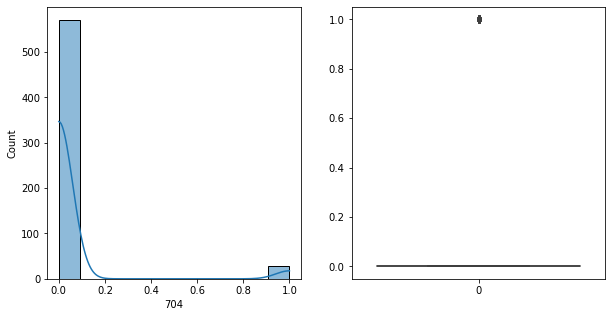

704   Unique :  [0 1]
--------------------------------------------------------------------
704   N unique :  2
--------------------------------------------------------------------
704   Value Counts :  0    571
1     29
Name: 704, dtype: int64
--------------------------------------------------------------------



[ 705 ]
show_df_info :  705


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


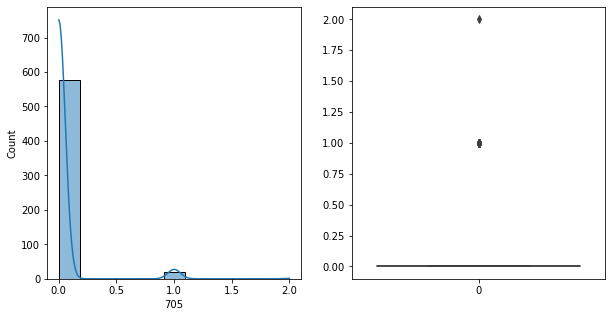

705   Unique :  [0 1 2]
--------------------------------------------------------------------
705   N unique :  3
--------------------------------------------------------------------
705   Value Counts :  0    578
1     21
2      1
Name: 705, dtype: int64
--------------------------------------------------------------------



[ 706 ]
show_df_info :  706


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


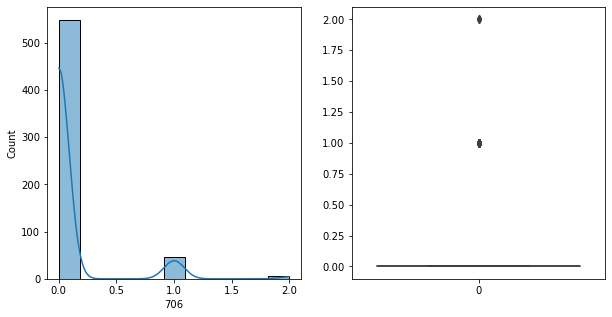

706   Unique :  [0 1 2]
--------------------------------------------------------------------
706   N unique :  3
--------------------------------------------------------------------
706   Value Counts :  0    548
1     47
2      5
Name: 706, dtype: int64
--------------------------------------------------------------------



[ 707 ]
show_df_info :  707


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


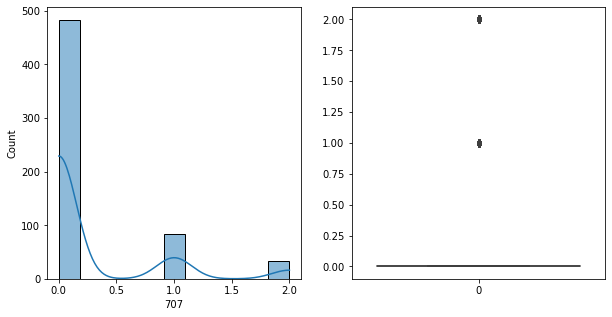

707   Unique :  [1 0 2]
--------------------------------------------------------------------
707   N unique :  3
--------------------------------------------------------------------
707   Value Counts :  0    483
1     83
2     34
Name: 707, dtype: int64
--------------------------------------------------------------------



[ 708 ]
show_df_info :  708


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


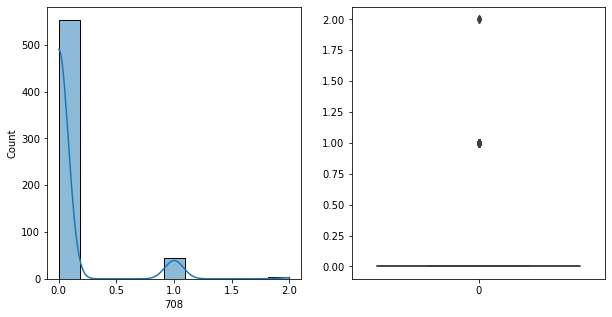

708   Unique :  [1 0 2]
--------------------------------------------------------------------
708   N unique :  3
--------------------------------------------------------------------
708   Value Counts :  0    553
1     44
2      3
Name: 708, dtype: int64
--------------------------------------------------------------------



[ 709 ]
show_df_info :  709


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


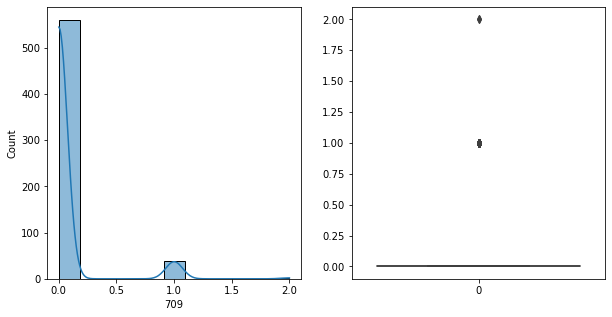

709   Unique :  [0 1 2]
--------------------------------------------------------------------
709   N unique :  3
--------------------------------------------------------------------
709   Value Counts :  0    560
1     38
2      2
Name: 709, dtype: int64
--------------------------------------------------------------------



[ 710 ]
show_df_info :  710


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


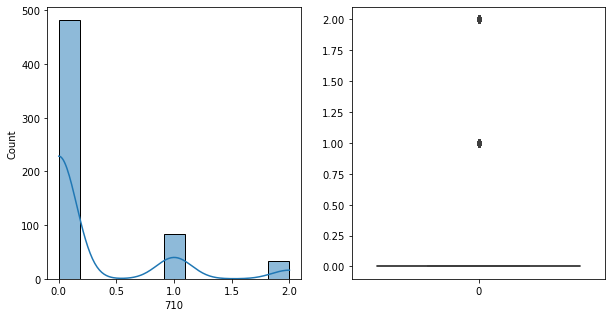

710   Unique :  [1 0 2]
--------------------------------------------------------------------
710   N unique :  3
--------------------------------------------------------------------
710   Value Counts :  0    482
1     84
2     34
Name: 710, dtype: int64
--------------------------------------------------------------------



[ 711 ]
show_df_info :  711


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


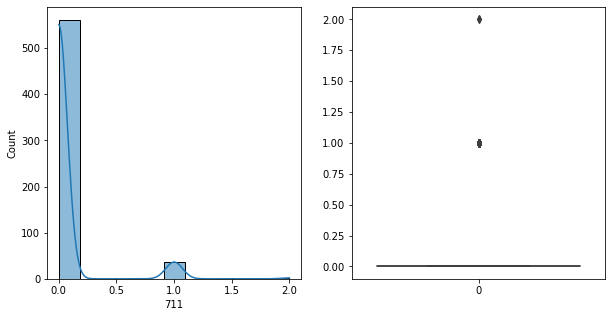

711   Unique :  [0 1 2]
--------------------------------------------------------------------
711   N unique :  3
--------------------------------------------------------------------
711   Value Counts :  0    561
1     37
2      2
Name: 711, dtype: int64
--------------------------------------------------------------------



[ 712 ]
show_df_info :  712


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


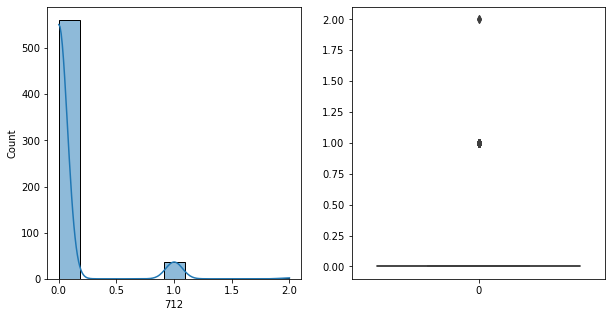

712   Unique :  [0 1 2]
--------------------------------------------------------------------
712   N unique :  3
--------------------------------------------------------------------
712   Value Counts :  0    561
1     37
2      2
Name: 712, dtype: int64
--------------------------------------------------------------------



[ 713 ]
show_df_info :  713


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


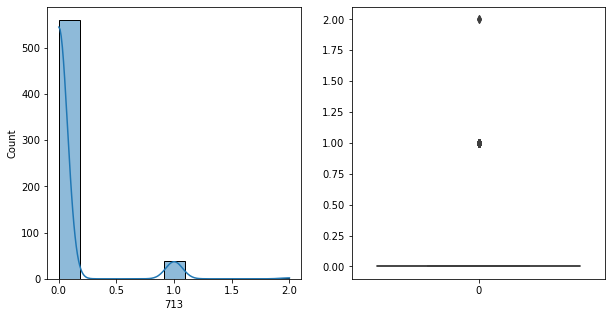

713   Unique :  [0 1 2]
--------------------------------------------------------------------
713   N unique :  3
--------------------------------------------------------------------
713   Value Counts :  0    560
1     38
2      2
Name: 713, dtype: int64
--------------------------------------------------------------------



[ 714 ]
show_df_info :  714


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


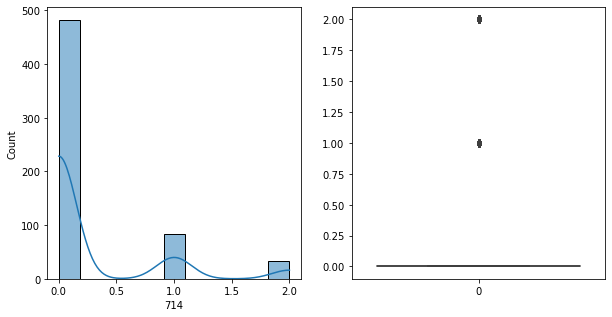

714   Unique :  [1 0 2]
--------------------------------------------------------------------
714   N unique :  3
--------------------------------------------------------------------
714   Value Counts :  0    482
1     84
2     34
Name: 714, dtype: int64
--------------------------------------------------------------------



[ 715 ]
show_df_info :  715


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


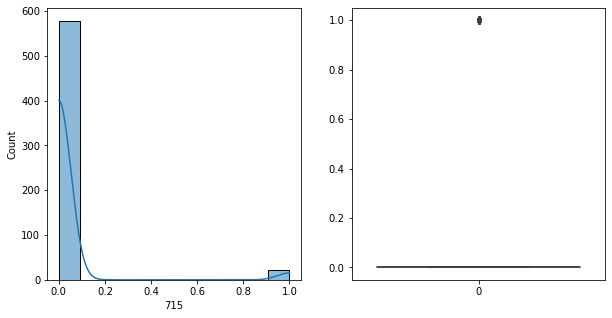

715   Unique :  [0 1]
--------------------------------------------------------------------
715   N unique :  2
--------------------------------------------------------------------
715   Value Counts :  0    578
1     22
Name: 715, dtype: int64
--------------------------------------------------------------------



[ 716 ]
show_df_info :  716


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


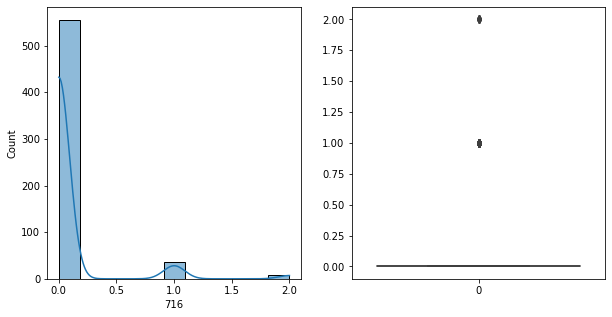

716   Unique :  [0 1 2]
--------------------------------------------------------------------
716   N unique :  3
--------------------------------------------------------------------
716   Value Counts :  0    555
1     36
2      9
Name: 716, dtype: int64
--------------------------------------------------------------------



[ 717 ]
show_df_info :  717


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


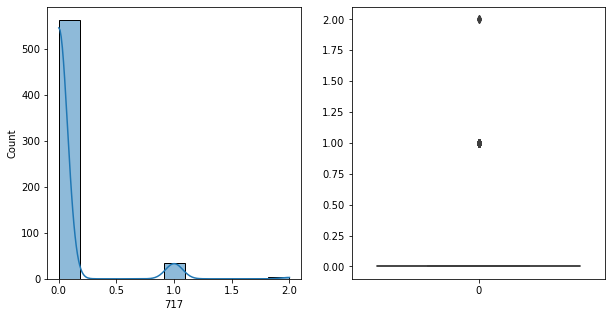

717   Unique :  [0 1 2]
--------------------------------------------------------------------
717   N unique :  3
--------------------------------------------------------------------
717   Value Counts :  0    563
1     34
2      3
Name: 717, dtype: int64
--------------------------------------------------------------------



[ 718 ]
show_df_info :  718


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


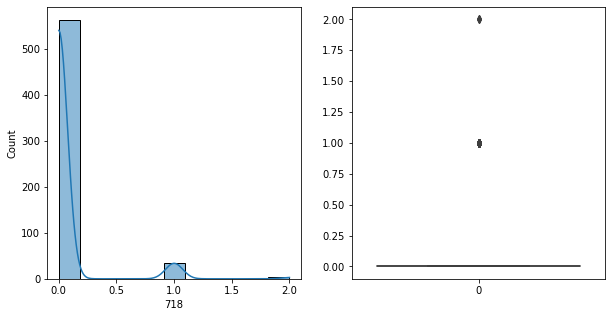

718   Unique :  [0 1 2]
--------------------------------------------------------------------
718   N unique :  3
--------------------------------------------------------------------
718   Value Counts :  0    562
1     35
2      3
Name: 718, dtype: int64
--------------------------------------------------------------------



[ 719 ]
show_df_info :  719


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


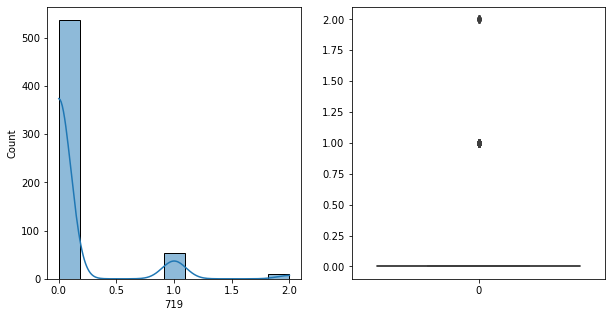

719   Unique :  [1 0 2]
--------------------------------------------------------------------
719   N unique :  3
--------------------------------------------------------------------
719   Value Counts :  0    537
1     53
2     10
Name: 719, dtype: int64
--------------------------------------------------------------------



[ 720 ]
show_df_info :  720


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


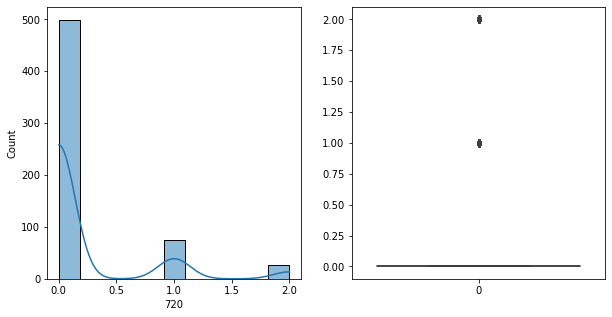

720   Unique :  [1 0 2]
--------------------------------------------------------------------
720   N unique :  3
--------------------------------------------------------------------
720   Value Counts :  0    499
1     75
2     26
Name: 720, dtype: int64
--------------------------------------------------------------------



[ 721 ]
show_df_info :  721


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


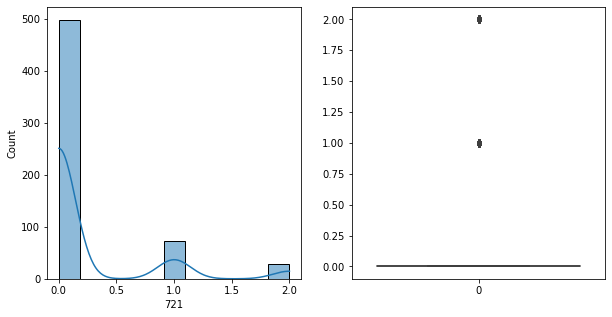

721   Unique :  [1 0 2]
--------------------------------------------------------------------
721   N unique :  3
--------------------------------------------------------------------
721   Value Counts :  0    498
1     73
2     29
Name: 721, dtype: int64
--------------------------------------------------------------------



[ 722 ]
show_df_info :  722


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


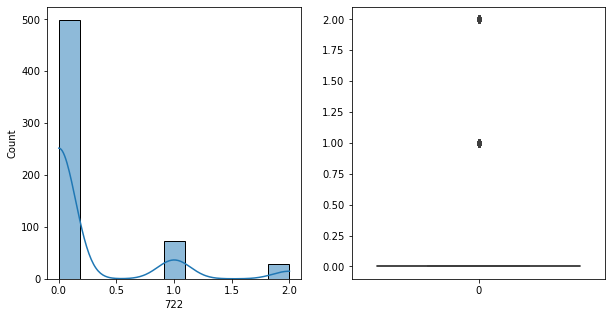

722   Unique :  [1 0 2]
--------------------------------------------------------------------
722   N unique :  3
--------------------------------------------------------------------
722   Value Counts :  0    499
1     72
2     29
Name: 722, dtype: int64
--------------------------------------------------------------------



[ 723 ]
show_df_info :  723


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


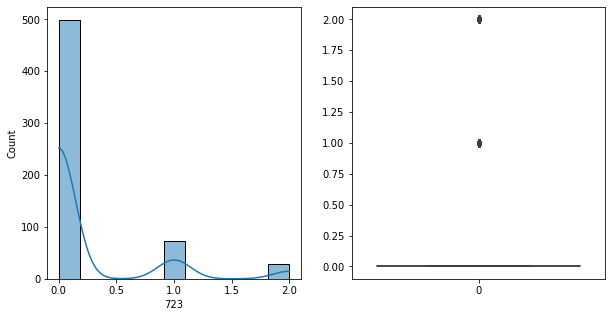

723   Unique :  [1 0 2]
--------------------------------------------------------------------
723   N unique :  3
--------------------------------------------------------------------
723   Value Counts :  0    499
1     72
2     29
Name: 723, dtype: int64
--------------------------------------------------------------------



[ 724 ]
show_df_info :  724


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


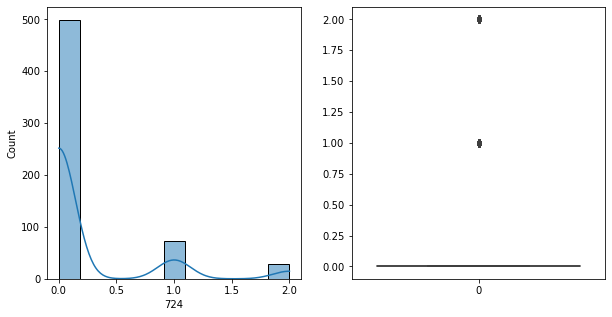

724   Unique :  [1 0 2]
--------------------------------------------------------------------
724   N unique :  3
--------------------------------------------------------------------
724   Value Counts :  0    499
1     72
2     29
Name: 724, dtype: int64
--------------------------------------------------------------------



[ 725 ]
show_df_info :  725


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


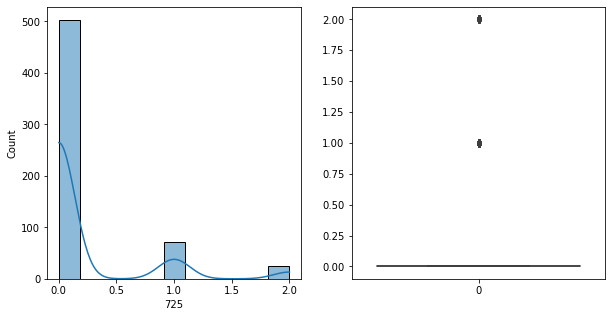

725   Unique :  [1 0 2]
--------------------------------------------------------------------
725   N unique :  3
--------------------------------------------------------------------
725   Value Counts :  0    503
1     72
2     25
Name: 725, dtype: int64
--------------------------------------------------------------------



[ 726 ]
show_df_info :  726


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


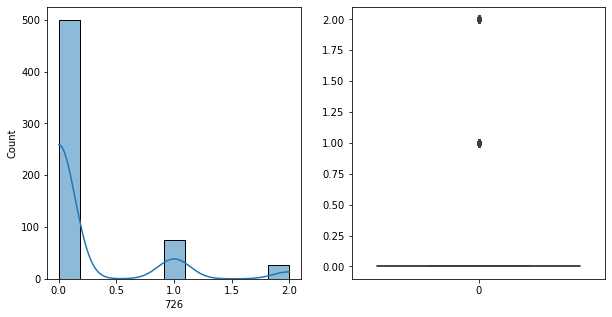

726   Unique :  [1 0 2]
--------------------------------------------------------------------
726   N unique :  3
--------------------------------------------------------------------
726   Value Counts :  0    500
1     74
2     26
Name: 726, dtype: int64
--------------------------------------------------------------------



[ 727 ]
show_df_info :  727


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


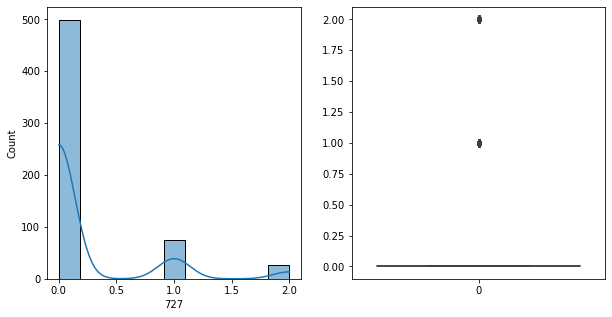

727   Unique :  [1 0 2]
--------------------------------------------------------------------
727   N unique :  3
--------------------------------------------------------------------
727   Value Counts :  0    499
1     75
2     26
Name: 727, dtype: int64
--------------------------------------------------------------------



[ 728 ]
show_df_info :  728


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


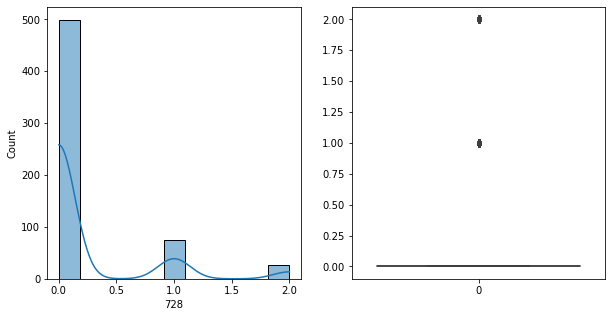

728   Unique :  [1 0 2]
--------------------------------------------------------------------
728   N unique :  3
--------------------------------------------------------------------
728   Value Counts :  0    499
1     75
2     26
Name: 728, dtype: int64
--------------------------------------------------------------------



[ 729 ]
show_df_info :  729


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


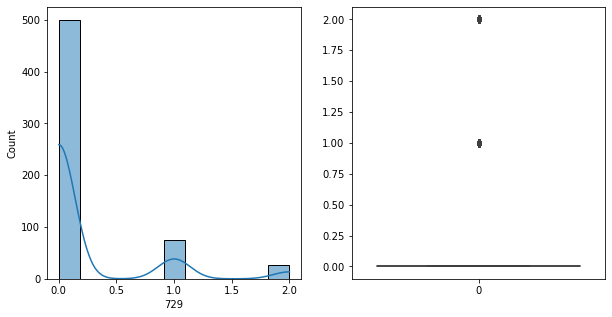

729   Unique :  [1 0 2]
--------------------------------------------------------------------
729   N unique :  3
--------------------------------------------------------------------
729   Value Counts :  0    500
1     74
2     26
Name: 729, dtype: int64
--------------------------------------------------------------------



[ 730 ]
show_df_info :  730


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


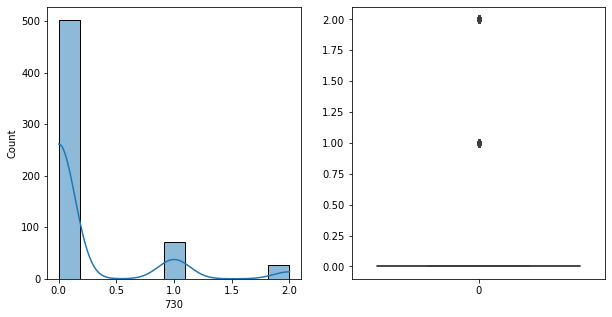

730   Unique :  [1 0 2]
--------------------------------------------------------------------
730   N unique :  3
--------------------------------------------------------------------
730   Value Counts :  0    502
1     72
2     26
Name: 730, dtype: int64
--------------------------------------------------------------------



[ 731 ]
show_df_info :  731


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


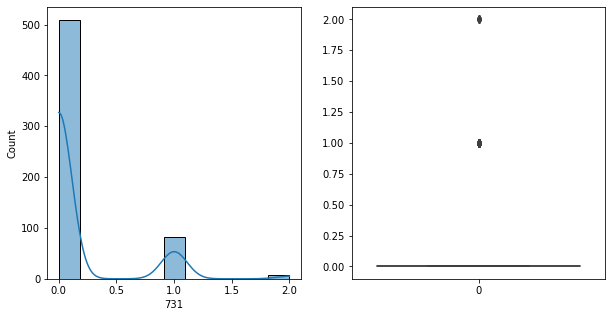

731   Unique :  [1 0 2]
--------------------------------------------------------------------
731   N unique :  3
--------------------------------------------------------------------
731   Value Counts :  0    509
1     83
2      8
Name: 731, dtype: int64
--------------------------------------------------------------------



[ 732 ]
show_df_info :  732


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


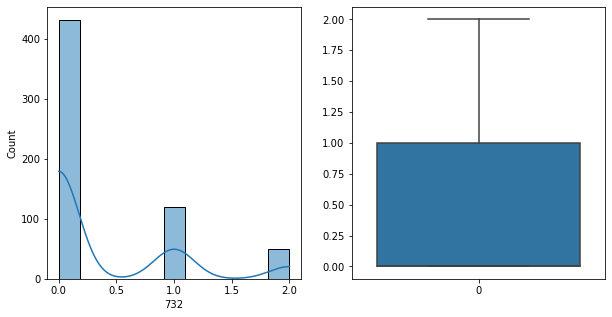

732   Unique :  [2 0 1]
--------------------------------------------------------------------
732   N unique :  3
--------------------------------------------------------------------
732   Value Counts :  0    432
1    119
2     49
Name: 732, dtype: int64
--------------------------------------------------------------------



[ 733 ]
show_df_info :  733


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


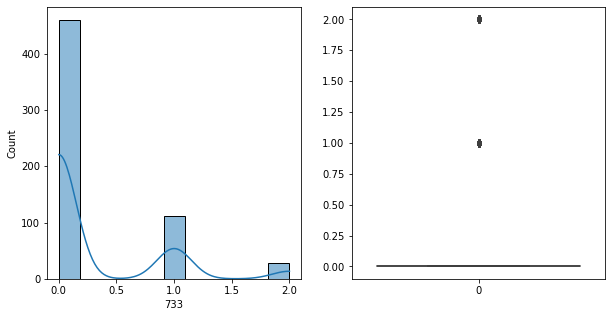

733   Unique :  [1 0 2]
--------------------------------------------------------------------
733   N unique :  3
--------------------------------------------------------------------
733   Value Counts :  0    460
1    112
2     28
Name: 733, dtype: int64
--------------------------------------------------------------------



[ 734 ]
show_df_info :  734


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


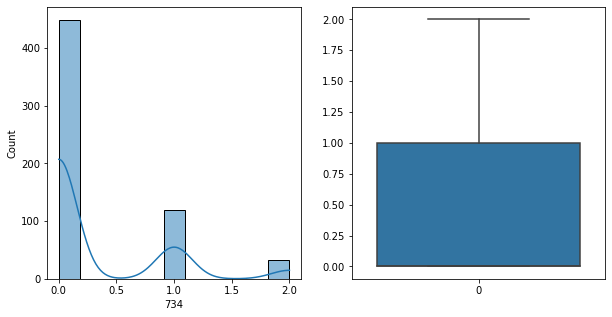

734   Unique :  [1 0 2]
--------------------------------------------------------------------
734   N unique :  3
--------------------------------------------------------------------
734   Value Counts :  0    449
1    119
2     32
Name: 734, dtype: int64
--------------------------------------------------------------------



[ 735 ]
show_df_info :  735


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


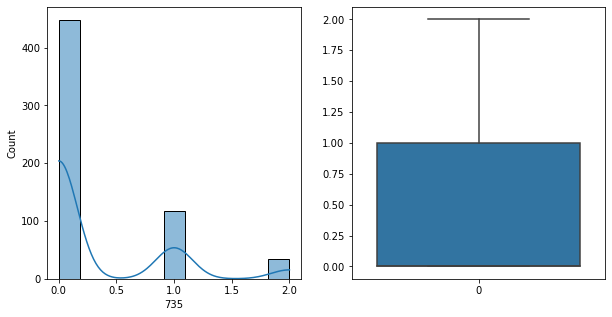

735   Unique :  [1 0 2]
--------------------------------------------------------------------
735   N unique :  3
--------------------------------------------------------------------
735   Value Counts :  0    448
1    118
2     34
Name: 735, dtype: int64
--------------------------------------------------------------------



[ 736 ]
show_df_info :  736


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


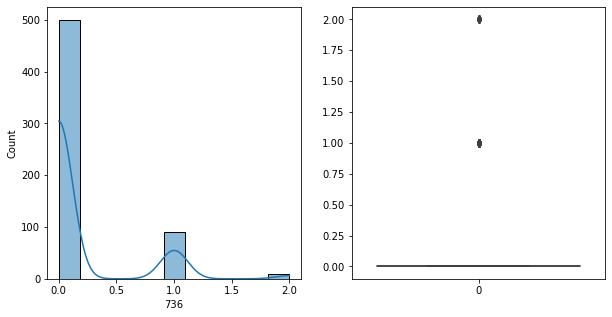

736   Unique :  [1 0 2]
--------------------------------------------------------------------
736   N unique :  3
--------------------------------------------------------------------
736   Value Counts :  0    500
1     90
2     10
Name: 736, dtype: int64
--------------------------------------------------------------------



[ 737 ]
show_df_info :  737


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


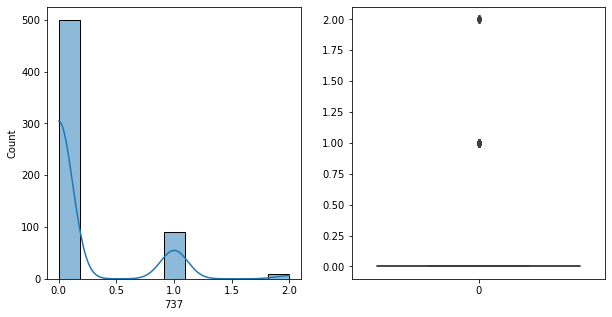

737   Unique :  [1 0 2]
--------------------------------------------------------------------
737   N unique :  3
--------------------------------------------------------------------
737   Value Counts :  0    500
1     90
2     10
Name: 737, dtype: int64
--------------------------------------------------------------------



[ 738 ]
show_df_info :  738


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


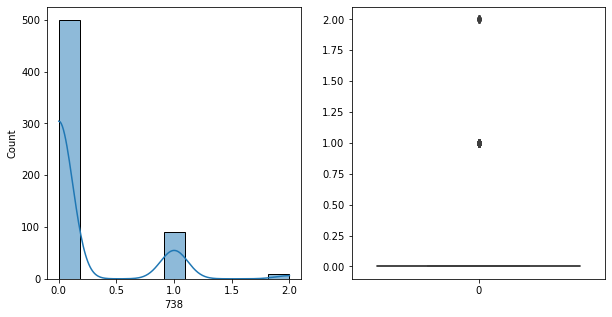

738   Unique :  [1 0 2]
--------------------------------------------------------------------
738   N unique :  3
--------------------------------------------------------------------
738   Value Counts :  0    500
1     90
2     10
Name: 738, dtype: int64
--------------------------------------------------------------------



[ 739 ]
show_df_info :  739


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


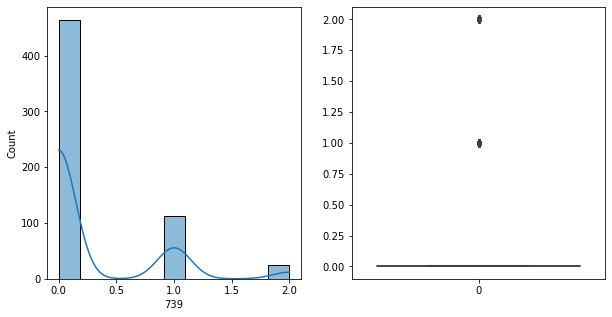

739   Unique :  [1 0 2]
--------------------------------------------------------------------
739   N unique :  3
--------------------------------------------------------------------
739   Value Counts :  0    464
1    112
2     24
Name: 739, dtype: int64
--------------------------------------------------------------------



[ 740 ]
show_df_info :  740


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


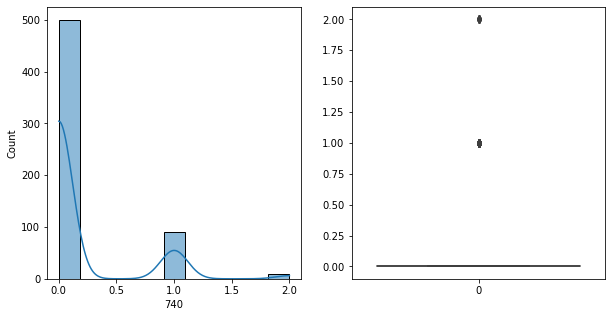

740   Unique :  [1 0 2]
--------------------------------------------------------------------
740   N unique :  3
--------------------------------------------------------------------
740   Value Counts :  0    500
1     90
2     10
Name: 740, dtype: int64
--------------------------------------------------------------------



[ 741 ]
show_df_info :  741


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


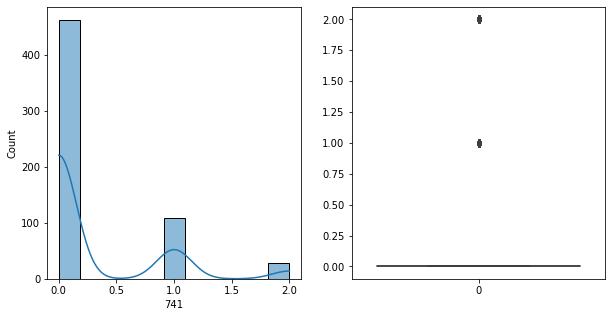

741   Unique :  [1 0 2]
--------------------------------------------------------------------
741   N unique :  3
--------------------------------------------------------------------
741   Value Counts :  0    462
1    109
2     29
Name: 741, dtype: int64
--------------------------------------------------------------------



[ 742 ]
show_df_info :  742


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


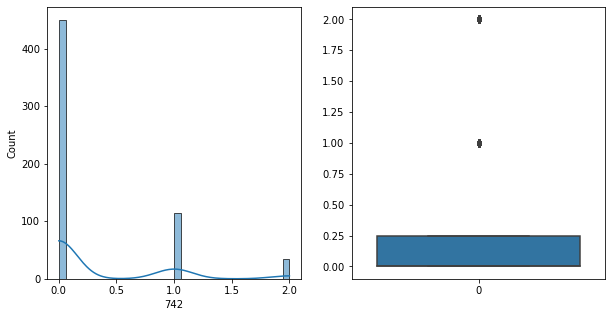

742   Unique :  [1 0 2]
--------------------------------------------------------------------
742   N unique :  3
--------------------------------------------------------------------
742   Value Counts :  0    450
1    115
2     35
Name: 742, dtype: int64
--------------------------------------------------------------------



[ 743 ]
show_df_info :  743


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


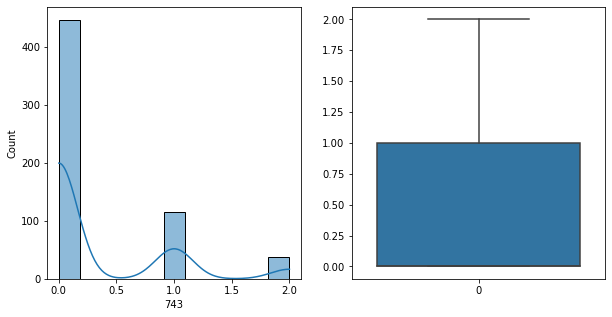

743   Unique :  [1 0 2]
--------------------------------------------------------------------
743   N unique :  3
--------------------------------------------------------------------
743   Value Counts :  0    447
1    116
2     37
Name: 743, dtype: int64
--------------------------------------------------------------------



[ 744 ]
show_df_info :  744


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


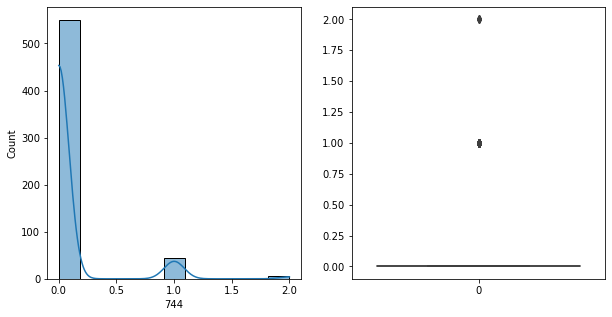

744   Unique :  [0 1 2]
--------------------------------------------------------------------
744   N unique :  3
--------------------------------------------------------------------
744   Value Counts :  0    550
1     45
2      5
Name: 744, dtype: int64
--------------------------------------------------------------------



[ 745 ]
show_df_info :  745


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


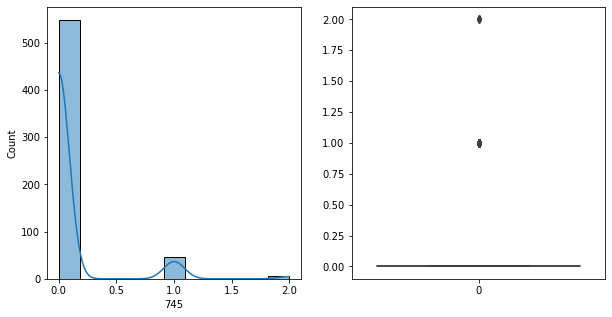

745   Unique :  [0 1 2]
--------------------------------------------------------------------
745   N unique :  3
--------------------------------------------------------------------
745   Value Counts :  0    548
1     46
2      6
Name: 745, dtype: int64
--------------------------------------------------------------------



[ 746 ]
show_df_info :  746


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


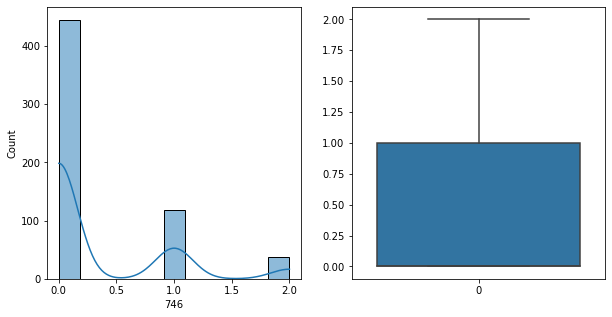

746   Unique :  [1 0 2]
--------------------------------------------------------------------
746   N unique :  3
--------------------------------------------------------------------
746   Value Counts :  0    445
1    118
2     37
Name: 746, dtype: int64
--------------------------------------------------------------------



[ 747 ]
show_df_info :  747


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


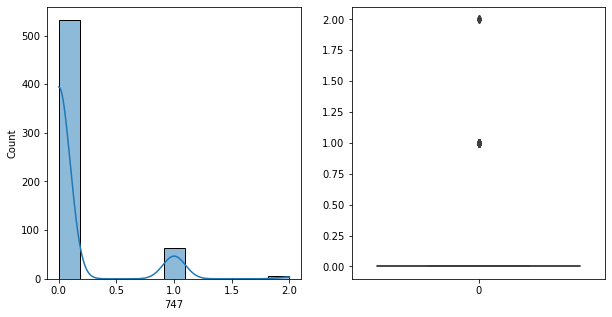

747   Unique :  [0 1 2]
--------------------------------------------------------------------
747   N unique :  3
--------------------------------------------------------------------
747   Value Counts :  0    532
1     63
2      5
Name: 747, dtype: int64
--------------------------------------------------------------------



[ 748 ]
show_df_info :  748


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


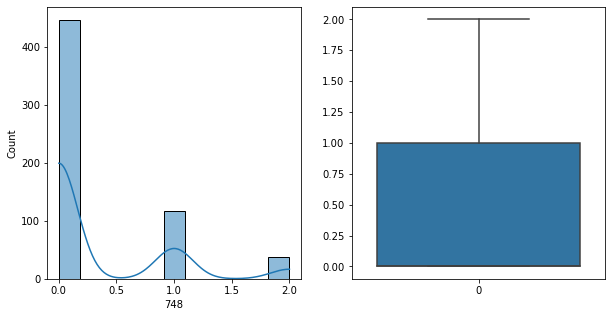

748   Unique :  [1 0 2]
--------------------------------------------------------------------
748   N unique :  3
--------------------------------------------------------------------
748   Value Counts :  0    446
1    117
2     37
Name: 748, dtype: int64
--------------------------------------------------------------------



[ 749 ]
show_df_info :  749


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


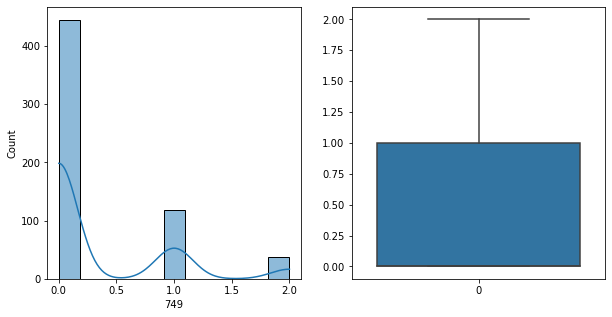

749   Unique :  [1 0 2]
--------------------------------------------------------------------
749   N unique :  3
--------------------------------------------------------------------
749   Value Counts :  0    445
1    118
2     37
Name: 749, dtype: int64
--------------------------------------------------------------------



[ 750 ]
show_df_info :  750


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


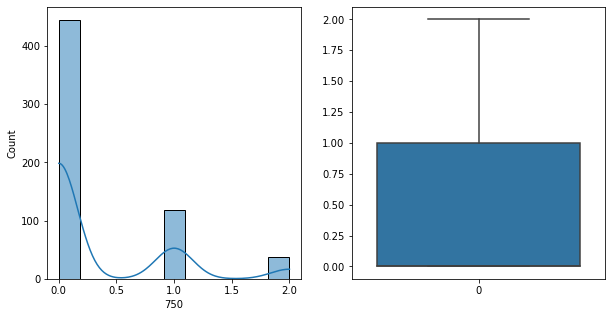

750   Unique :  [1 0 2]
--------------------------------------------------------------------
750   N unique :  3
--------------------------------------------------------------------
750   Value Counts :  0    445
1    118
2     37
Name: 750, dtype: int64
--------------------------------------------------------------------



[ 751 ]
show_df_info :  751


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


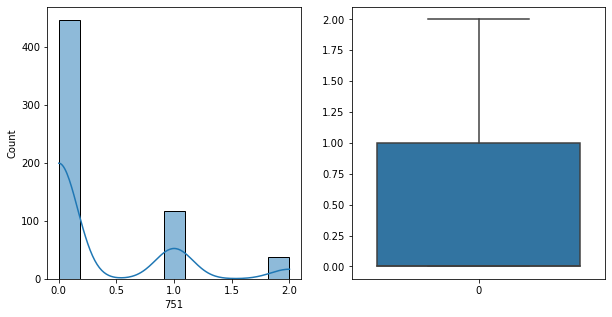

751   Unique :  [1 0 2]
--------------------------------------------------------------------
751   N unique :  3
--------------------------------------------------------------------
751   Value Counts :  0    446
1    117
2     37
Name: 751, dtype: int64
--------------------------------------------------------------------



[ 752 ]
show_df_info :  752


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


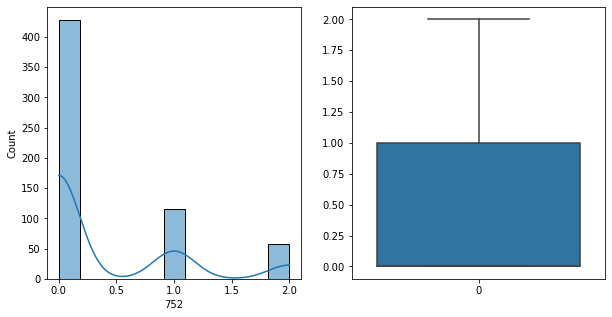

752   Unique :  [0 1 2]
--------------------------------------------------------------------
752   N unique :  3
--------------------------------------------------------------------
752   Value Counts :  0    428
1    115
2     57
Name: 752, dtype: int64
--------------------------------------------------------------------



[ 753 ]
show_df_info :  753


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


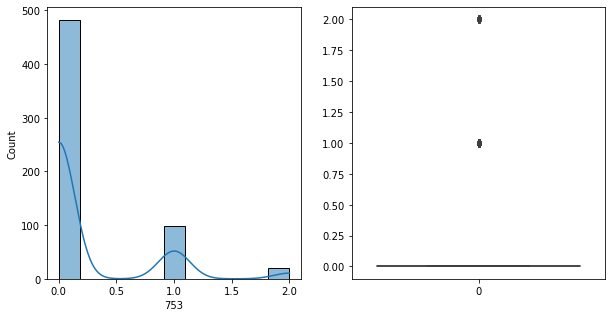

753   Unique :  [0 2 1]
--------------------------------------------------------------------
753   N unique :  3
--------------------------------------------------------------------
753   Value Counts :  0    482
1     98
2     20
Name: 753, dtype: int64
--------------------------------------------------------------------



[ 754 ]
show_df_info :  754


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


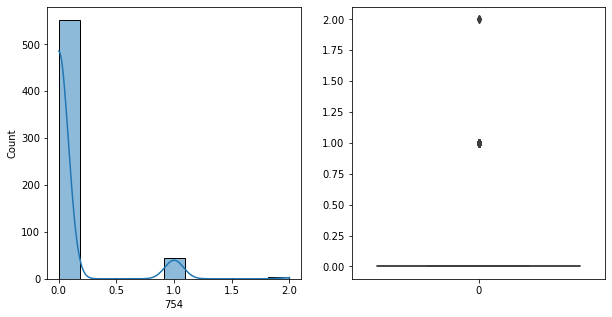

754   Unique :  [1 0 2]
--------------------------------------------------------------------
754   N unique :  3
--------------------------------------------------------------------
754   Value Counts :  0    552
1     45
2      3
Name: 754, dtype: int64
--------------------------------------------------------------------



[ 755 ]
show_df_info :  755


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


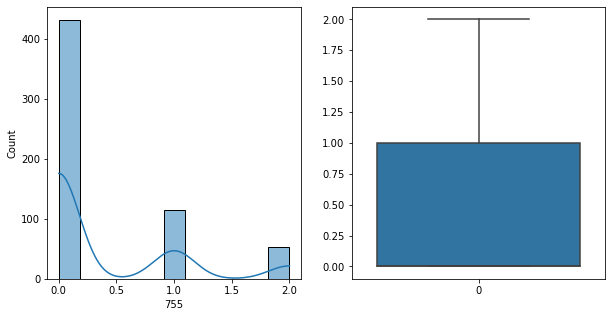

755   Unique :  [2 0 1]
--------------------------------------------------------------------
755   N unique :  3
--------------------------------------------------------------------
755   Value Counts :  0    432
1    115
2     53
Name: 755, dtype: int64
--------------------------------------------------------------------



[ 756 ]
show_df_info :  756


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


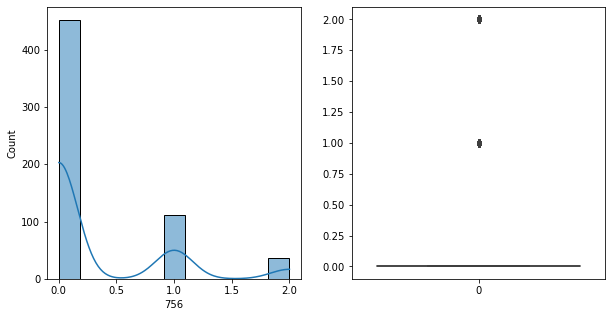

756   Unique :  [1 0 2]
--------------------------------------------------------------------
756   N unique :  3
--------------------------------------------------------------------
756   Value Counts :  0    452
1    111
2     37
Name: 756, dtype: int64
--------------------------------------------------------------------



[ 757 ]
show_df_info :  757


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


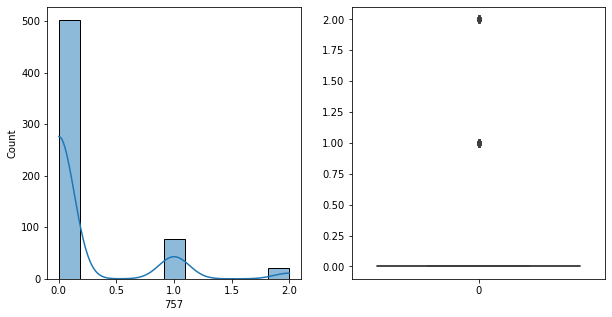

757   Unique :  [1 0 2]
--------------------------------------------------------------------
757   N unique :  3
--------------------------------------------------------------------
757   Value Counts :  0    502
1     78
2     20
Name: 757, dtype: int64
--------------------------------------------------------------------



[ 758 ]
show_df_info :  758


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


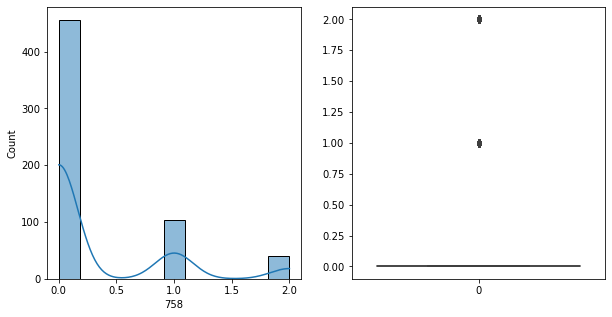

758   Unique :  [1 0 2]
--------------------------------------------------------------------
758   N unique :  3
--------------------------------------------------------------------
758   Value Counts :  0    456
1    103
2     41
Name: 758, dtype: int64
--------------------------------------------------------------------



[ 759 ]
show_df_info :  759


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


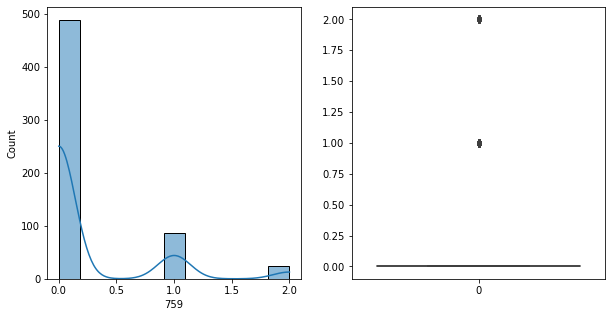

759   Unique :  [0 1 2]
--------------------------------------------------------------------
759   N unique :  3
--------------------------------------------------------------------
759   Value Counts :  0    489
1     86
2     25
Name: 759, dtype: int64
--------------------------------------------------------------------



[ 760 ]
show_df_info :  760


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


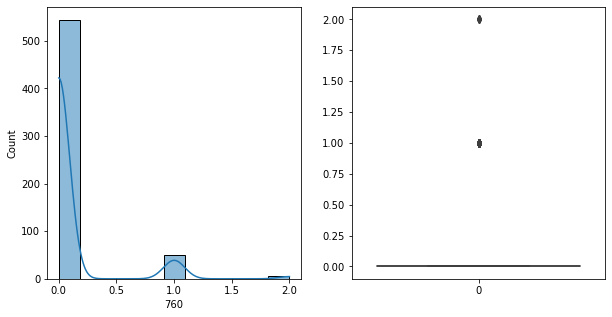

760   Unique :  [0 1 2]
--------------------------------------------------------------------
760   N unique :  3
--------------------------------------------------------------------
760   Value Counts :  0    544
1     50
2      6
Name: 760, dtype: int64
--------------------------------------------------------------------



[ 761 ]
show_df_info :  761


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


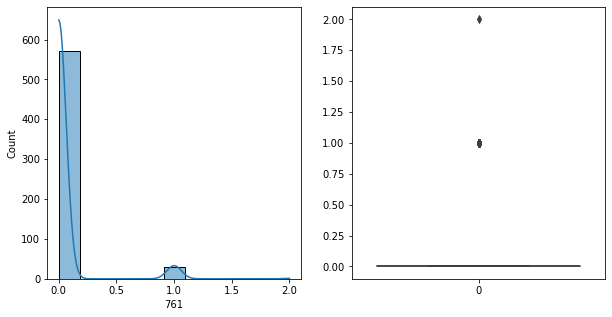

761   Unique :  [0 1 2]
--------------------------------------------------------------------
761   N unique :  3
--------------------------------------------------------------------
761   Value Counts :  0    570
1     29
2      1
Name: 761, dtype: int64
--------------------------------------------------------------------



[ 762 ]
show_df_info :  762


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


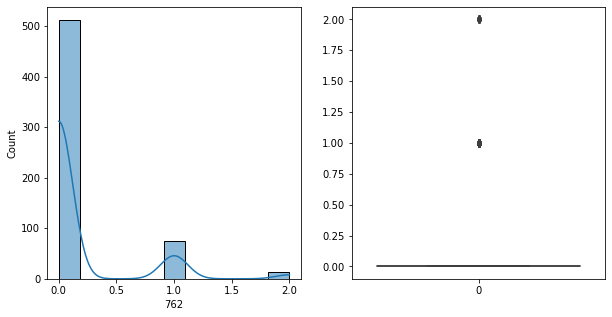

762   Unique :  [0 2 1]
--------------------------------------------------------------------
762   N unique :  3
--------------------------------------------------------------------
762   Value Counts :  0    512
1     75
2     13
Name: 762, dtype: int64
--------------------------------------------------------------------



[ 763 ]
show_df_info :  763


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


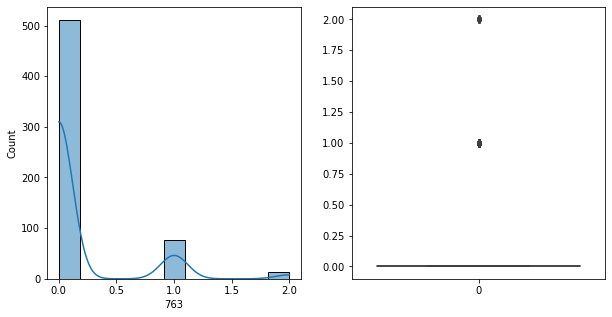

763   Unique :  [0 2 1]
--------------------------------------------------------------------
763   N unique :  3
--------------------------------------------------------------------
763   Value Counts :  0    511
1     76
2     13
Name: 763, dtype: int64
--------------------------------------------------------------------



[ 764 ]
show_df_info :  764


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


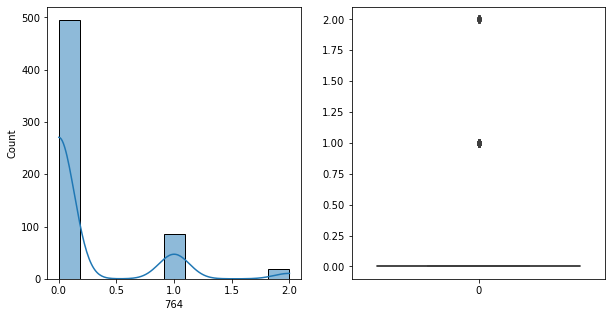

764   Unique :  [1 0 2]
--------------------------------------------------------------------
764   N unique :  3
--------------------------------------------------------------------
764   Value Counts :  0    495
1     86
2     19
Name: 764, dtype: int64
--------------------------------------------------------------------



[ 765 ]
show_df_info :  765


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


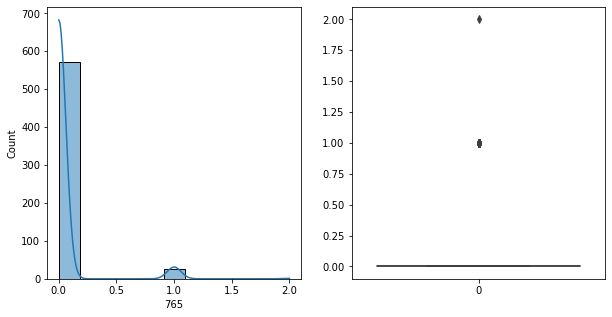

765   Unique :  [0 1 2]
--------------------------------------------------------------------
765   N unique :  3
--------------------------------------------------------------------
765   Value Counts :  0    573
1     26
2      1
Name: 765, dtype: int64
--------------------------------------------------------------------



[ 766 ]
show_df_info :  766


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


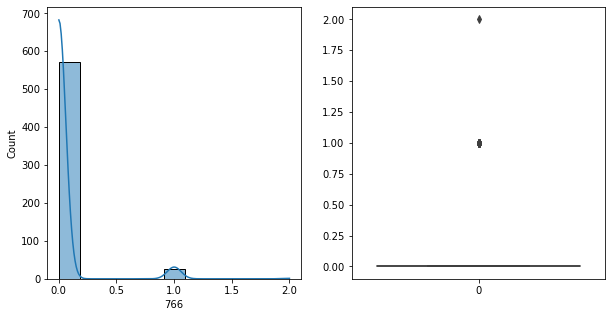

766   Unique :  [0 1 2]
--------------------------------------------------------------------
766   N unique :  3
--------------------------------------------------------------------
766   Value Counts :  0    573
1     26
2      1
Name: 766, dtype: int64
--------------------------------------------------------------------



[ 767 ]
show_df_info :  767


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


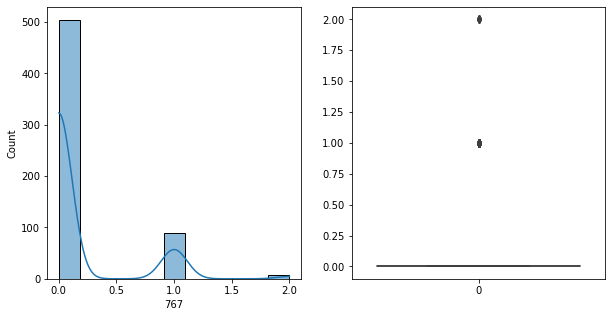

767   Unique :  [1 0 2]
--------------------------------------------------------------------
767   N unique :  3
--------------------------------------------------------------------
767   Value Counts :  0    504
1     89
2      7
Name: 767, dtype: int64
--------------------------------------------------------------------



[ 768 ]
show_df_info :  768


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


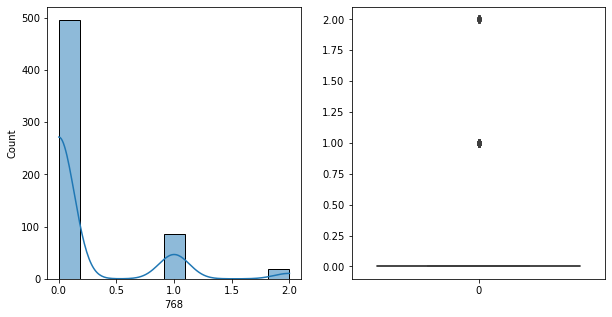

768   Unique :  [1 0 2]
--------------------------------------------------------------------
768   N unique :  3
--------------------------------------------------------------------
768   Value Counts :  0    496
1     85
2     19
Name: 768, dtype: int64
--------------------------------------------------------------------



[ 769 ]
show_df_info :  769


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


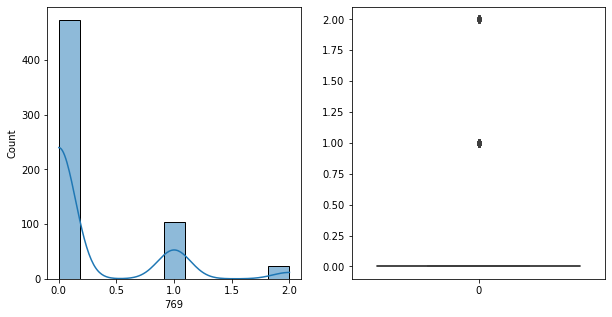

769   Unique :  [1 0 2]
--------------------------------------------------------------------
769   N unique :  3
--------------------------------------------------------------------
769   Value Counts :  0    473
1    104
2     23
Name: 769, dtype: int64
--------------------------------------------------------------------



[ 770 ]
show_df_info :  770


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


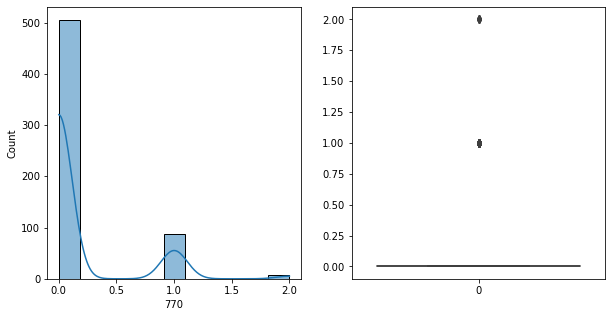

770   Unique :  [1 0 2]
--------------------------------------------------------------------
770   N unique :  3
--------------------------------------------------------------------
770   Value Counts :  0    505
1     87
2      8
Name: 770, dtype: int64
--------------------------------------------------------------------



[ 771 ]
show_df_info :  771


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


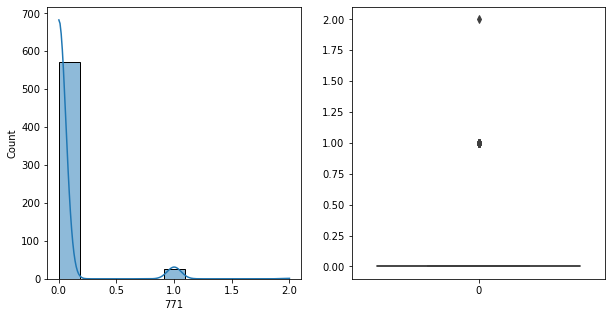

771   Unique :  [0 1 2]
--------------------------------------------------------------------
771   N unique :  3
--------------------------------------------------------------------
771   Value Counts :  0    573
1     26
2      1
Name: 771, dtype: int64
--------------------------------------------------------------------



[ 772 ]
show_df_info :  772


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


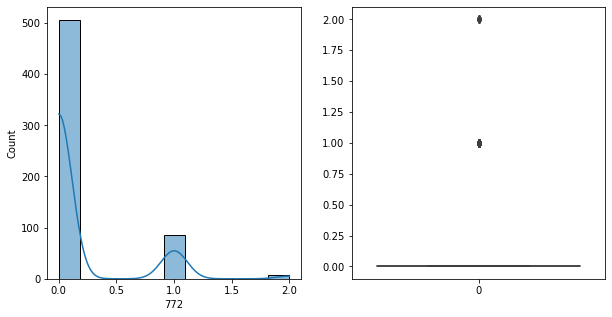

772   Unique :  [1 0 2]
--------------------------------------------------------------------
772   N unique :  3
--------------------------------------------------------------------
772   Value Counts :  0    506
1     86
2      8
Name: 772, dtype: int64
--------------------------------------------------------------------



[ 773 ]
show_df_info :  773


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


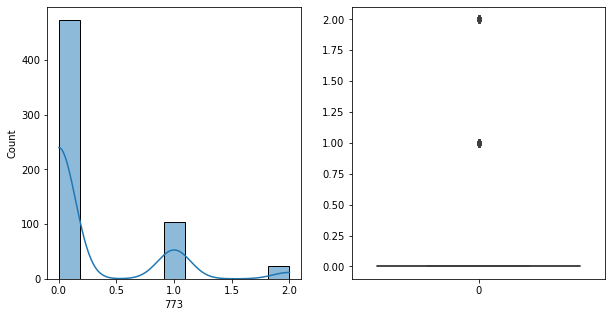

773   Unique :  [1 0 2]
--------------------------------------------------------------------
773   N unique :  3
--------------------------------------------------------------------
773   Value Counts :  0    473
1    104
2     23
Name: 773, dtype: int64
--------------------------------------------------------------------



[ 774 ]
show_df_info :  774


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


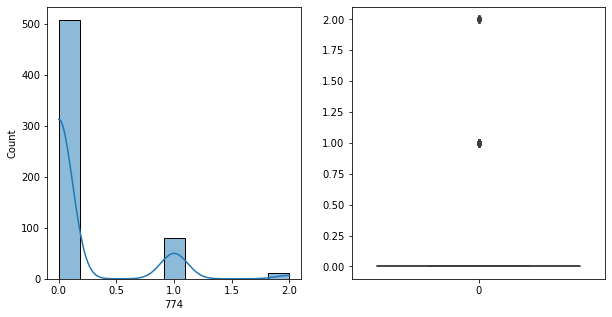

774   Unique :  [0 1 2]
--------------------------------------------------------------------
774   N unique :  3
--------------------------------------------------------------------
774   Value Counts :  0    508
1     81
2     11
Name: 774, dtype: int64
--------------------------------------------------------------------



[ 775 ]
show_df_info :  775


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


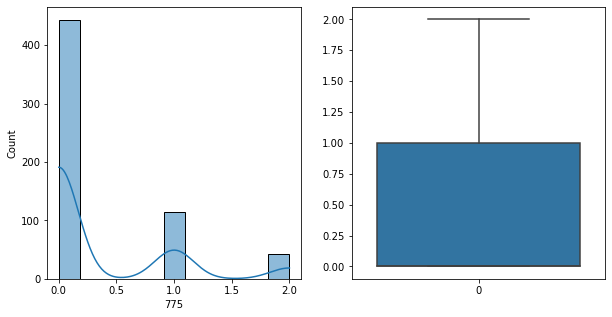

775   Unique :  [0 1 2]
--------------------------------------------------------------------
775   N unique :  3
--------------------------------------------------------------------
775   Value Counts :  0    443
1    114
2     43
Name: 775, dtype: int64
--------------------------------------------------------------------



[ 776 ]
show_df_info :  776


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


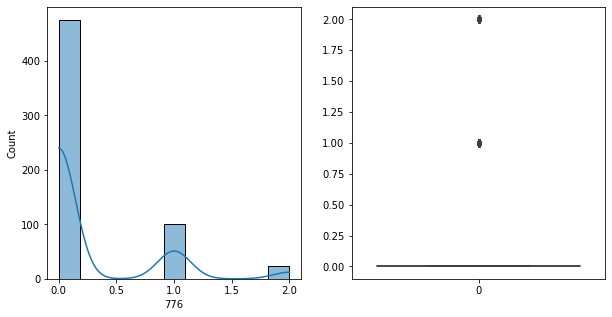

776   Unique :  [0 1 2]
--------------------------------------------------------------------
776   N unique :  3
--------------------------------------------------------------------
776   Value Counts :  0    475
1    101
2     24
Name: 776, dtype: int64
--------------------------------------------------------------------



[ 777 ]
show_df_info :  777


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


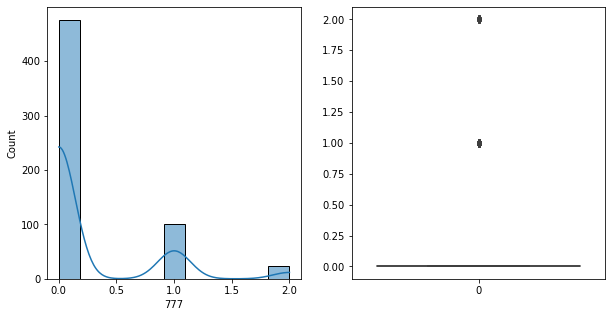

777   Unique :  [0 1 2]
--------------------------------------------------------------------
777   N unique :  3
--------------------------------------------------------------------
777   Value Counts :  0    476
1    101
2     23
Name: 777, dtype: int64
--------------------------------------------------------------------



[ 778 ]
show_df_info :  778


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


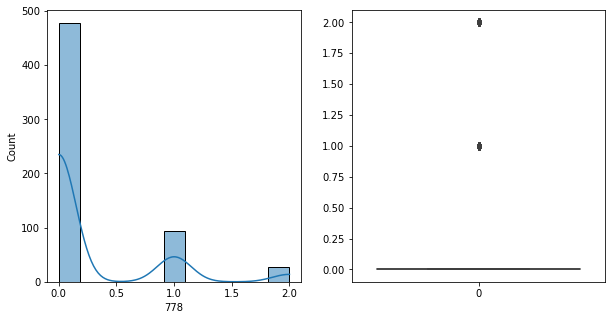

778   Unique :  [2 0 1]
--------------------------------------------------------------------
778   N unique :  3
--------------------------------------------------------------------
778   Value Counts :  0    478
1     94
2     28
Name: 778, dtype: int64
--------------------------------------------------------------------



[ 779 ]
show_df_info :  779


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


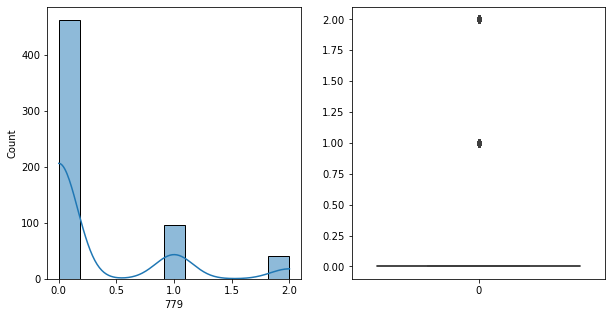

779   Unique :  [1 0 2]
--------------------------------------------------------------------
779   N unique :  3
--------------------------------------------------------------------
779   Value Counts :  0    463
1     97
2     40
Name: 779, dtype: int64
--------------------------------------------------------------------



[ 780 ]
show_df_info :  780


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


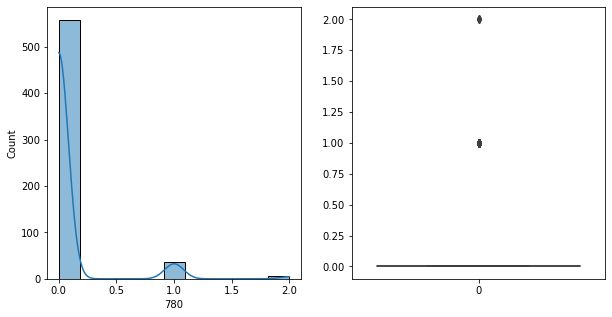

780   Unique :  [0 1 2]
--------------------------------------------------------------------
780   N unique :  3
--------------------------------------------------------------------
780   Value Counts :  0    558
1     37
2      5
Name: 780, dtype: int64
--------------------------------------------------------------------



[ 781 ]
show_df_info :  781


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


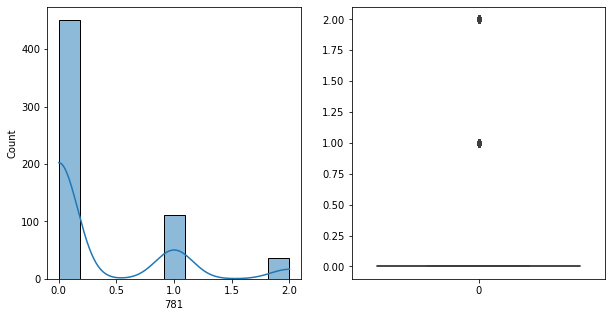

781   Unique :  [2 0 1]
--------------------------------------------------------------------
781   N unique :  3
--------------------------------------------------------------------
781   Value Counts :  0    451
1    112
2     37
Name: 781, dtype: int64
--------------------------------------------------------------------



[ 782 ]
show_df_info :  782


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


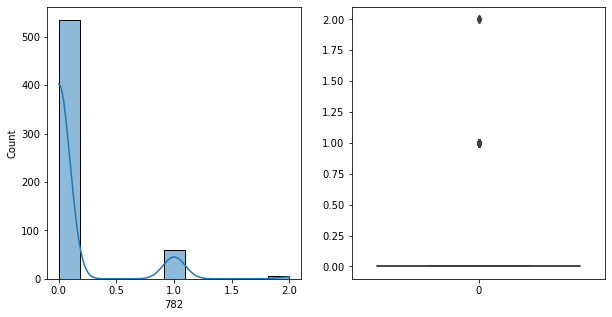

782   Unique :  [0 1 2]
--------------------------------------------------------------------
782   N unique :  3
--------------------------------------------------------------------
782   Value Counts :  0    535
1     60
2      5
Name: 782, dtype: int64
--------------------------------------------------------------------



[ 783 ]
show_df_info :  783


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


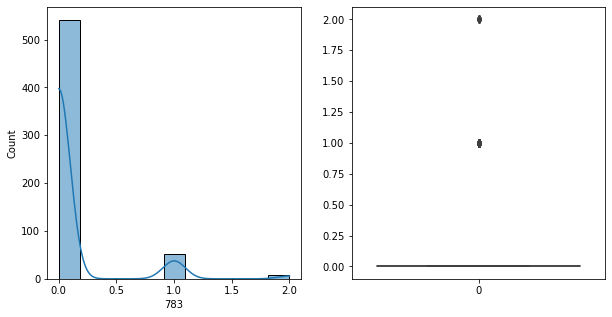

783   Unique :  [0 1 2]
--------------------------------------------------------------------
783   N unique :  3
--------------------------------------------------------------------
783   Value Counts :  0    541
1     51
2      8
Name: 783, dtype: int64
--------------------------------------------------------------------



[ 784 ]
show_df_info :  784


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


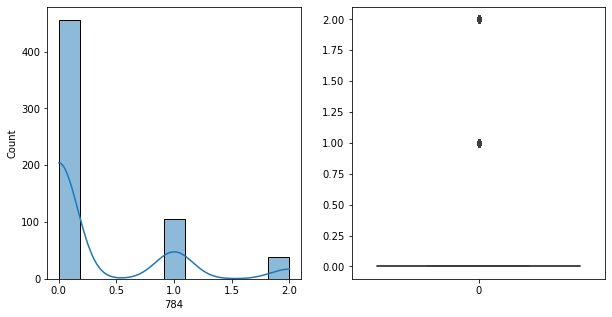

784   Unique :  [1 0 2]
--------------------------------------------------------------------
784   N unique :  3
--------------------------------------------------------------------
784   Value Counts :  0    456
1    106
2     38
Name: 784, dtype: int64
--------------------------------------------------------------------



[ 785 ]
show_df_info :  785


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


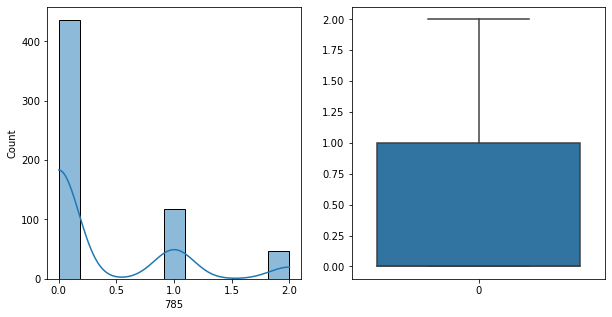

785   Unique :  [1 0 2]
--------------------------------------------------------------------
785   N unique :  3
--------------------------------------------------------------------
785   Value Counts :  0    436
1    117
2     47
Name: 785, dtype: int64
--------------------------------------------------------------------



[ 786 ]
show_df_info :  786


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


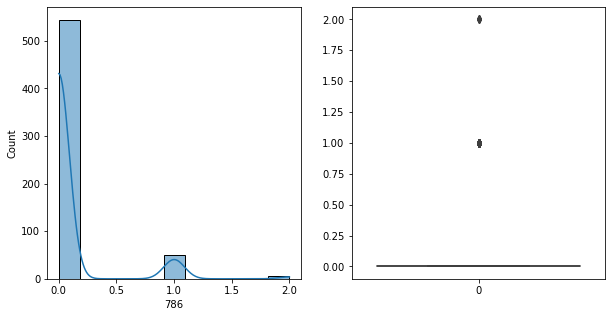

786   Unique :  [0 1 2]
--------------------------------------------------------------------
786   N unique :  3
--------------------------------------------------------------------
786   Value Counts :  0    544
1     51
2      5
Name: 786, dtype: int64
--------------------------------------------------------------------



[ 787 ]
show_df_info :  787


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


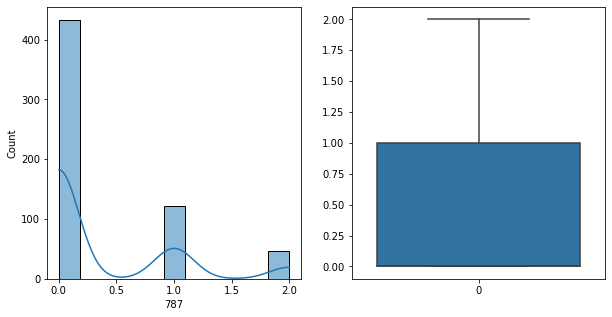

787   Unique :  [1 0 2]
--------------------------------------------------------------------
787   N unique :  3
--------------------------------------------------------------------
787   Value Counts :  0    433
1    121
2     46
Name: 787, dtype: int64
--------------------------------------------------------------------



[ 788 ]
show_df_info :  788


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


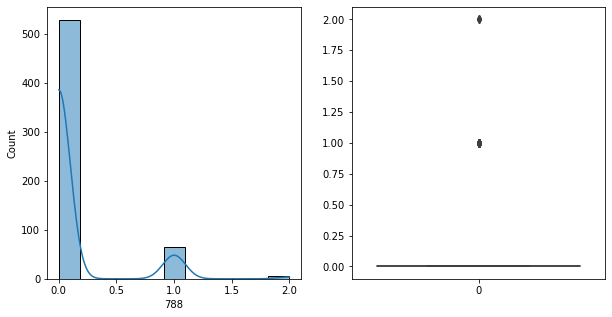

788   Unique :  [0 1 2]
--------------------------------------------------------------------
788   N unique :  3
--------------------------------------------------------------------
788   Value Counts :  0    529
1     66
2      5
Name: 788, dtype: int64
--------------------------------------------------------------------



[ 789 ]
show_df_info :  789


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


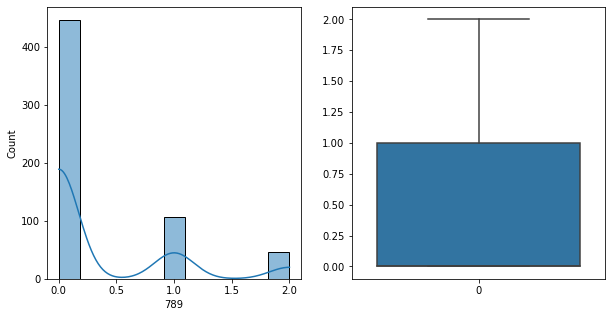

789   Unique :  [1 0 2]
--------------------------------------------------------------------
789   N unique :  3
--------------------------------------------------------------------
789   Value Counts :  0    447
1    106
2     47
Name: 789, dtype: int64
--------------------------------------------------------------------



[ 790 ]
show_df_info :  790


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


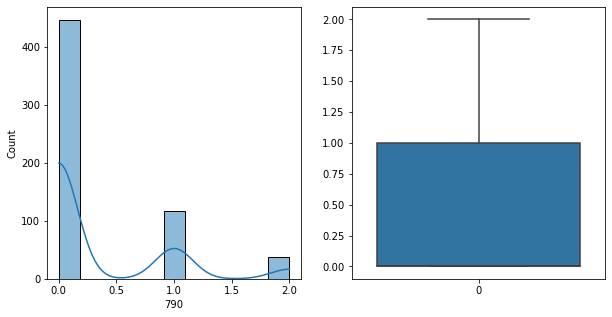

790   Unique :  [1 0 2]
--------------------------------------------------------------------
790   N unique :  3
--------------------------------------------------------------------
790   Value Counts :  0    446
1    117
2     37
Name: 790, dtype: int64
--------------------------------------------------------------------



[ 791 ]
show_df_info :  791


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


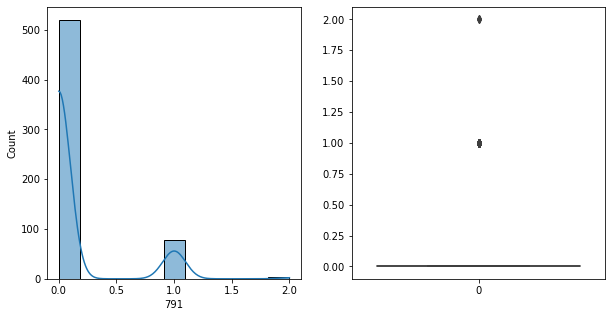

791   Unique :  [0 1 2]
--------------------------------------------------------------------
791   N unique :  3
--------------------------------------------------------------------
791   Value Counts :  0    520
1     77
2      3
Name: 791, dtype: int64
--------------------------------------------------------------------



[ 792 ]
show_df_info :  792


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


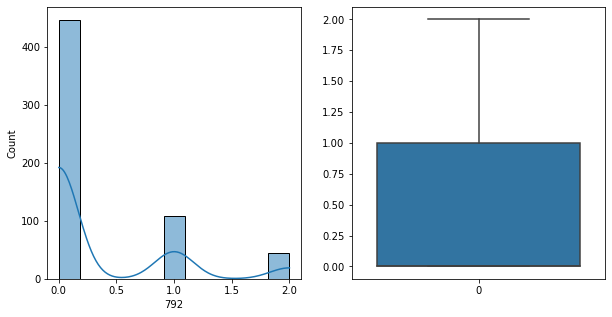

792   Unique :  [0 2 1]
--------------------------------------------------------------------
792   N unique :  3
--------------------------------------------------------------------
792   Value Counts :  0    447
1    109
2     44
Name: 792, dtype: int64
--------------------------------------------------------------------



[ 793 ]
show_df_info :  793


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


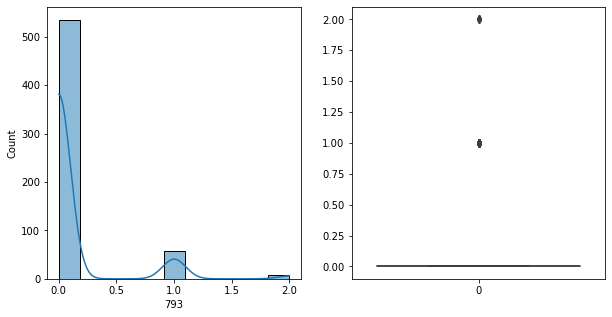

793   Unique :  [0 2 1]
--------------------------------------------------------------------
793   N unique :  3
--------------------------------------------------------------------
793   Value Counts :  0    535
1     57
2      8
Name: 793, dtype: int64
--------------------------------------------------------------------



[ 794 ]
show_df_info :  794


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


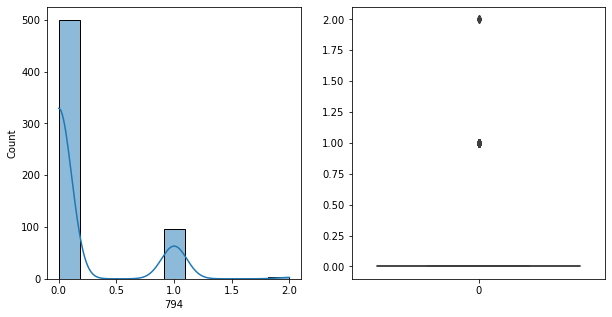

794   Unique :  [0 1 2]
--------------------------------------------------------------------
794   N unique :  3
--------------------------------------------------------------------
794   Value Counts :  0    500
1     96
2      4
Name: 794, dtype: int64
--------------------------------------------------------------------



[ 795 ]
show_df_info :  795


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


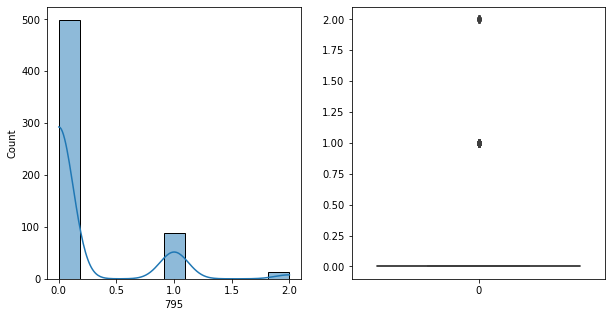

795   Unique :  [2 0 1]
--------------------------------------------------------------------
795   N unique :  3
--------------------------------------------------------------------
795   Value Counts :  0    499
1     88
2     13
Name: 795, dtype: int64
--------------------------------------------------------------------



[ 796 ]
show_df_info :  796


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


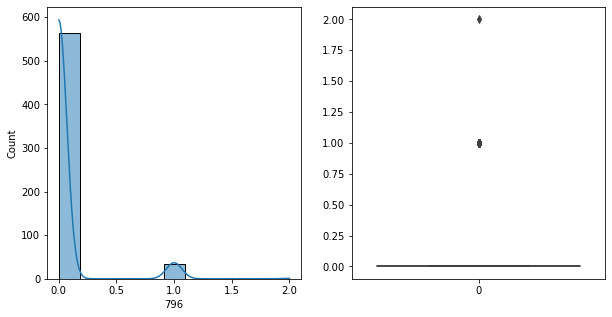

796   Unique :  [0 1 2]
--------------------------------------------------------------------
796   N unique :  3
--------------------------------------------------------------------
796   Value Counts :  0    564
1     35
2      1
Name: 796, dtype: int64
--------------------------------------------------------------------



[ 797 ]
show_df_info :  797


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


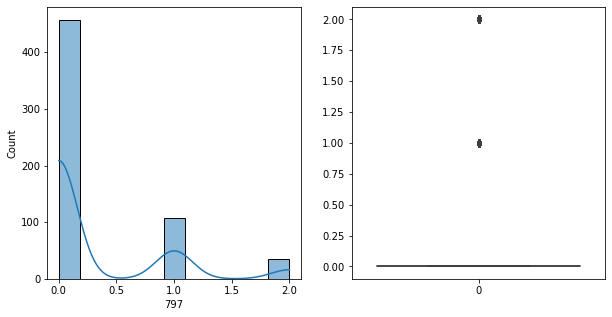

797   Unique :  [2 0 1]
--------------------------------------------------------------------
797   N unique :  3
--------------------------------------------------------------------
797   Value Counts :  0    457
1    108
2     35
Name: 797, dtype: int64
--------------------------------------------------------------------



[ 798 ]
show_df_info :  798


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


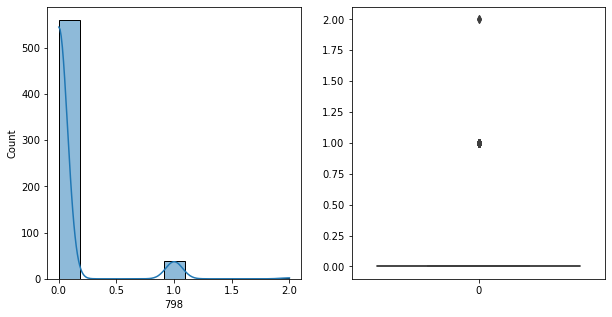

798   Unique :  [0 1 2]
--------------------------------------------------------------------
798   N unique :  3
--------------------------------------------------------------------
798   Value Counts :  0    560
1     38
2      2
Name: 798, dtype: int64
--------------------------------------------------------------------



[ 799 ]
show_df_info :  799


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


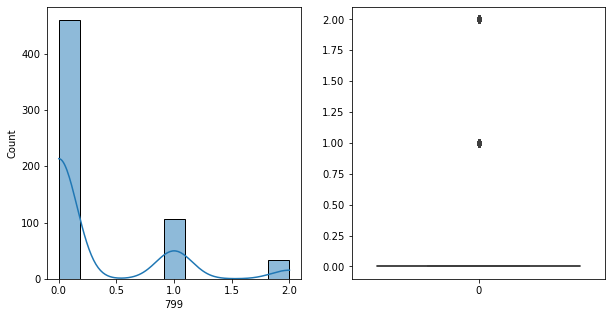

799   Unique :  [2 0 1]
--------------------------------------------------------------------
799   N unique :  3
--------------------------------------------------------------------
799   Value Counts :  0    460
1    107
2     33
Name: 799, dtype: int64
--------------------------------------------------------------------



[ 800 ]
show_df_info :  800


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


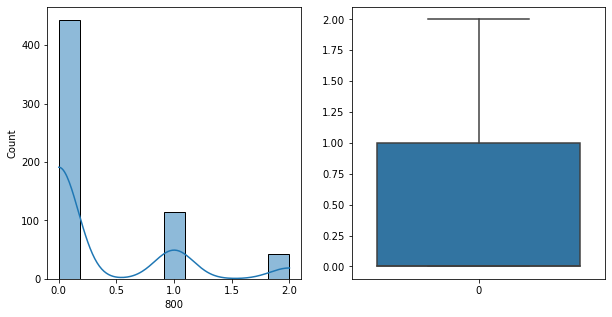

800   Unique :  [1 0 2]
--------------------------------------------------------------------
800   N unique :  3
--------------------------------------------------------------------
800   Value Counts :  0    443
1    114
2     43
Name: 800, dtype: int64
--------------------------------------------------------------------



[ 801 ]
show_df_info :  801


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


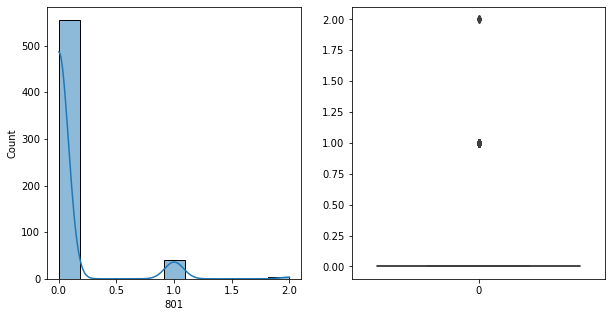

801   Unique :  [1 0 2]
--------------------------------------------------------------------
801   N unique :  3
--------------------------------------------------------------------
801   Value Counts :  0    555
1     41
2      4
Name: 801, dtype: int64
--------------------------------------------------------------------



[ 802 ]
show_df_info :  802


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


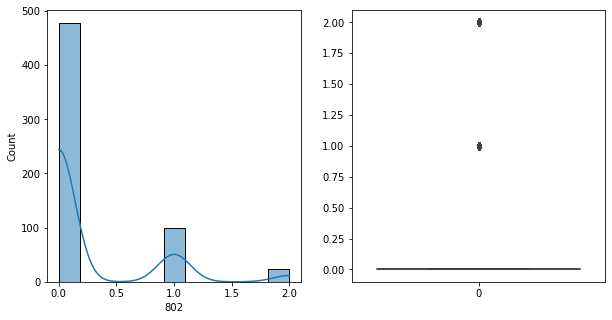

802   Unique :  [1 0 2]
--------------------------------------------------------------------
802   N unique :  3
--------------------------------------------------------------------
802   Value Counts :  0    478
1     99
2     23
Name: 802, dtype: int64
--------------------------------------------------------------------



[ 803 ]
show_df_info :  803


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


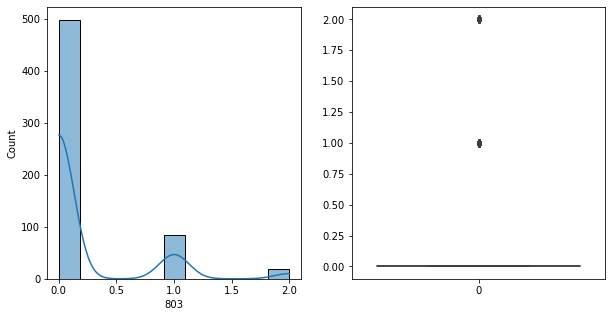

803   Unique :  [1 0 2]
--------------------------------------------------------------------
803   N unique :  3
--------------------------------------------------------------------
803   Value Counts :  0    498
1     84
2     18
Name: 803, dtype: int64
--------------------------------------------------------------------



[ 804 ]
show_df_info :  804


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


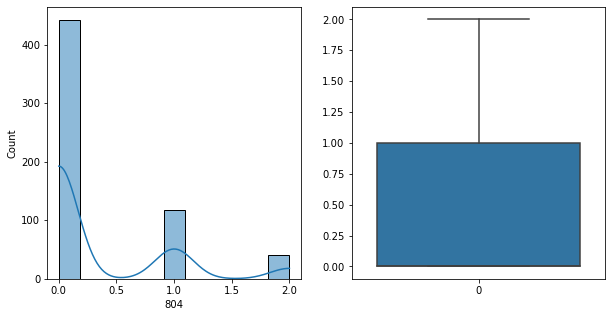

804   Unique :  [1 0 2]
--------------------------------------------------------------------
804   N unique :  3
--------------------------------------------------------------------
804   Value Counts :  0    442
1    117
2     41
Name: 804, dtype: int64
--------------------------------------------------------------------



[ 805 ]
show_df_info :  805


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


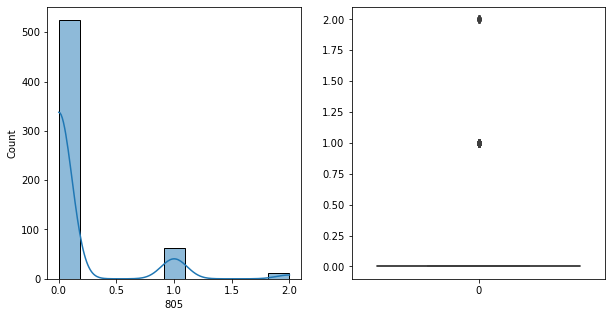

805   Unique :  [0 1 2]
--------------------------------------------------------------------
805   N unique :  3
--------------------------------------------------------------------
805   Value Counts :  0    525
1     63
2     12
Name: 805, dtype: int64
--------------------------------------------------------------------



[ 806 ]
show_df_info :  806


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


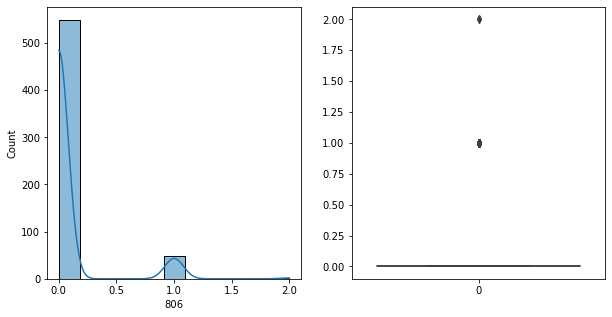

806   Unique :  [0 1 2]
--------------------------------------------------------------------
806   N unique :  3
--------------------------------------------------------------------
806   Value Counts :  0    549
1     49
2      2
Name: 806, dtype: int64
--------------------------------------------------------------------



[ 807 ]
show_df_info :  807


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


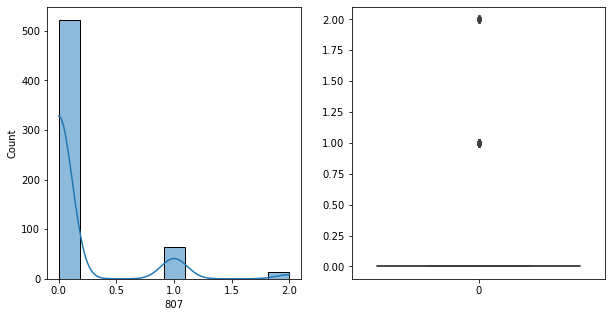

807   Unique :  [0 1 2]
--------------------------------------------------------------------
807   N unique :  3
--------------------------------------------------------------------
807   Value Counts :  0    522
1     65
2     13
Name: 807, dtype: int64
--------------------------------------------------------------------



[ 808 ]
show_df_info :  808


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


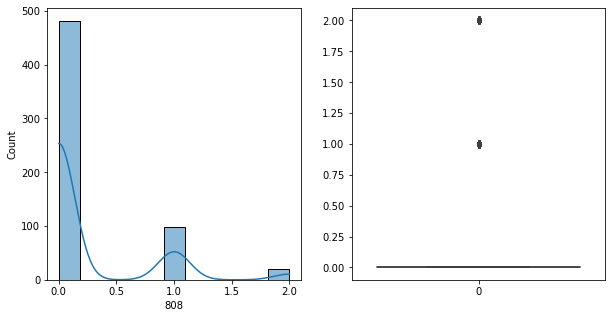

808   Unique :  [0 1 2]
--------------------------------------------------------------------
808   N unique :  3
--------------------------------------------------------------------
808   Value Counts :  0    481
1     99
2     20
Name: 808, dtype: int64
--------------------------------------------------------------------



[ 809 ]
show_df_info :  809


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


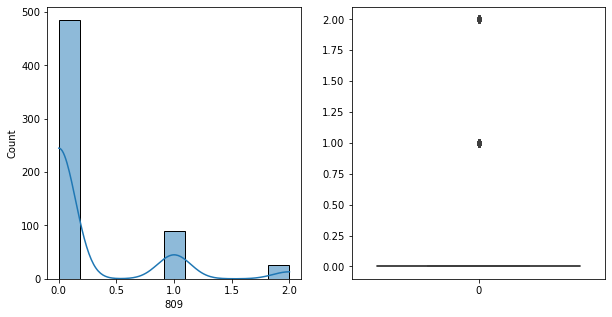

809   Unique :  [1 0 2]
--------------------------------------------------------------------
809   N unique :  3
--------------------------------------------------------------------
809   Value Counts :  0    485
1     89
2     26
Name: 809, dtype: int64
--------------------------------------------------------------------



[ 810 ]
show_df_info :  810


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


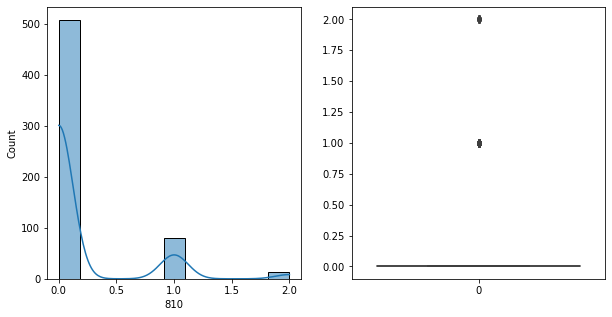

810   Unique :  [0 1 2]
--------------------------------------------------------------------
810   N unique :  3
--------------------------------------------------------------------
810   Value Counts :  0    507
1     79
2     14
Name: 810, dtype: int64
--------------------------------------------------------------------



[ 811 ]
show_df_info :  811


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


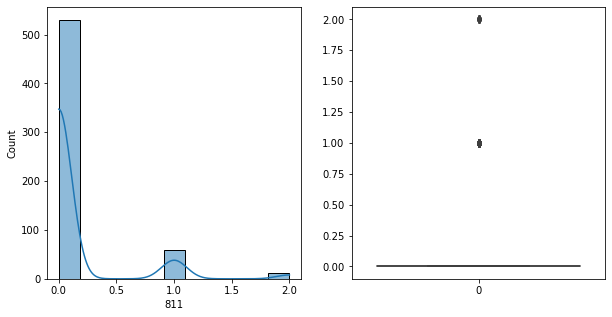

811   Unique :  [1 0 2]
--------------------------------------------------------------------
811   N unique :  3
--------------------------------------------------------------------
811   Value Counts :  0    530
1     58
2     12
Name: 811, dtype: int64
--------------------------------------------------------------------



[ 812 ]
show_df_info :  812


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


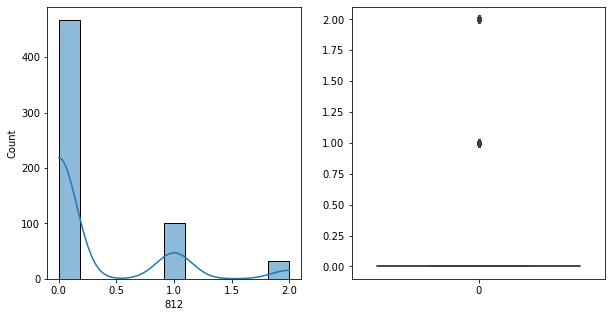

812   Unique :  [1 0 2]
--------------------------------------------------------------------
812   N unique :  3
--------------------------------------------------------------------
812   Value Counts :  0    467
1    100
2     33
Name: 812, dtype: int64
--------------------------------------------------------------------



[ 813 ]
show_df_info :  813


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


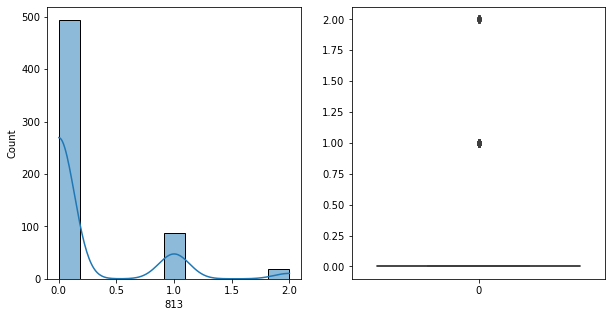

813   Unique :  [0 1 2]
--------------------------------------------------------------------
813   N unique :  3
--------------------------------------------------------------------
813   Value Counts :  0    494
1     87
2     19
Name: 813, dtype: int64
--------------------------------------------------------------------



[ 814 ]
show_df_info :  814


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


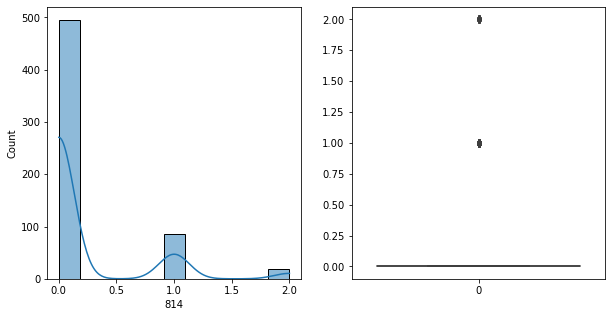

814   Unique :  [0 1 2]
--------------------------------------------------------------------
814   N unique :  3
--------------------------------------------------------------------
814   Value Counts :  0    495
1     86
2     19
Name: 814, dtype: int64
--------------------------------------------------------------------



[ 815 ]
show_df_info :  815


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


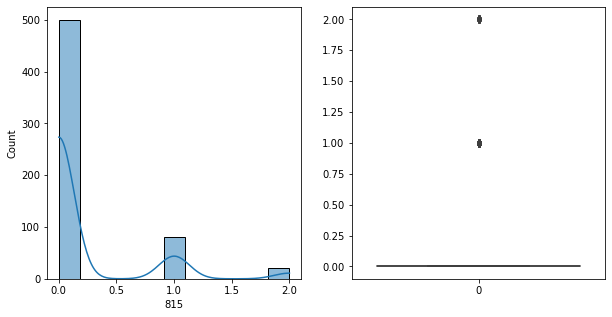

815   Unique :  [2 0 1]
--------------------------------------------------------------------
815   N unique :  3
--------------------------------------------------------------------
815   Value Counts :  0    500
1     80
2     20
Name: 815, dtype: int64
--------------------------------------------------------------------



[ 816 ]
show_df_info :  816


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


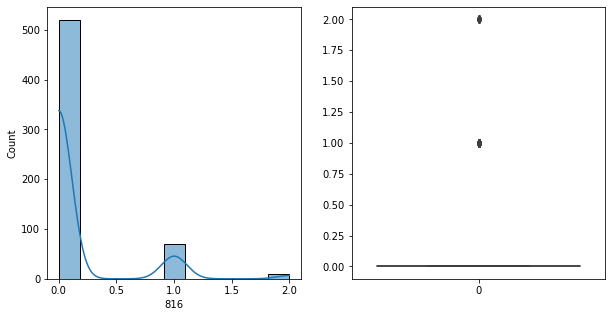

816   Unique :  [1 0 2]
--------------------------------------------------------------------
816   N unique :  3
--------------------------------------------------------------------
816   Value Counts :  0    520
1     70
2     10
Name: 816, dtype: int64
--------------------------------------------------------------------



[ 817 ]
show_df_info :  817


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


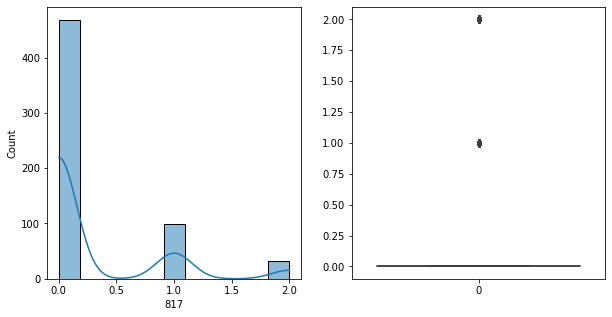

817   Unique :  [0 1 2]
--------------------------------------------------------------------
817   N unique :  3
--------------------------------------------------------------------
817   Value Counts :  0    468
1     99
2     33
Name: 817, dtype: int64
--------------------------------------------------------------------



[ 818 ]
show_df_info :  818


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


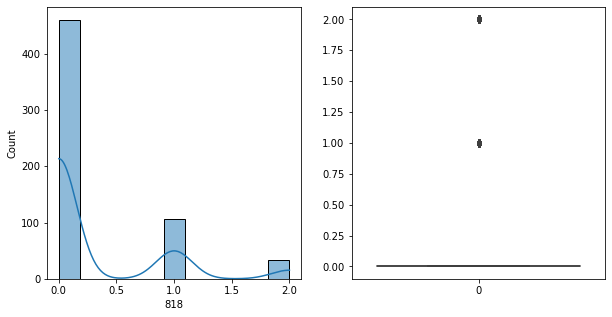

818   Unique :  [1 0 2]
--------------------------------------------------------------------
818   N unique :  3
--------------------------------------------------------------------
818   Value Counts :  0    460
1    107
2     33
Name: 818, dtype: int64
--------------------------------------------------------------------



[ 819 ]
show_df_info :  819


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


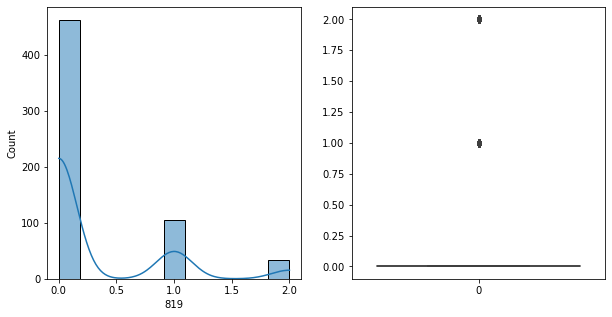

819   Unique :  [1 0 2]
--------------------------------------------------------------------
819   N unique :  3
--------------------------------------------------------------------
819   Value Counts :  0    462
1    105
2     33
Name: 819, dtype: int64
--------------------------------------------------------------------



[ 820 ]
show_df_info :  820


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


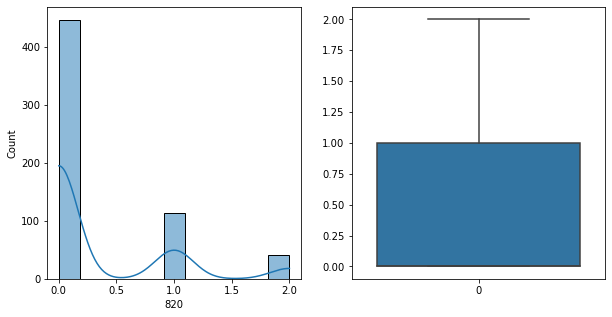

820   Unique :  [0 2 1]
--------------------------------------------------------------------
820   N unique :  3
--------------------------------------------------------------------
820   Value Counts :  0    446
1    113
2     41
Name: 820, dtype: int64
--------------------------------------------------------------------



[ 821 ]
show_df_info :  821


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


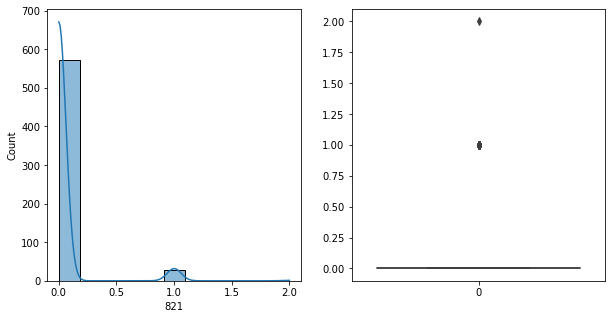

821   Unique :  [0 1 2]
--------------------------------------------------------------------
821   N unique :  3
--------------------------------------------------------------------
821   Value Counts :  0    572
1     27
2      1
Name: 821, dtype: int64
--------------------------------------------------------------------



[ 822 ]
show_df_info :  822


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


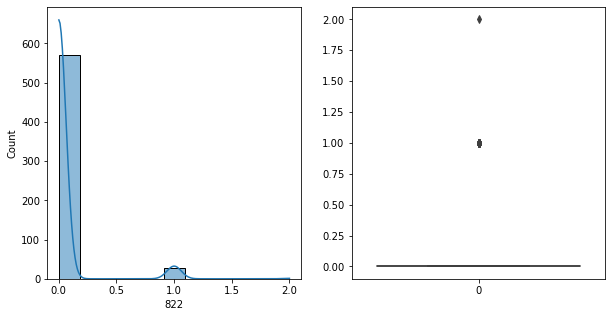

822   Unique :  [0 1 2]
--------------------------------------------------------------------
822   N unique :  3
--------------------------------------------------------------------
822   Value Counts :  0    571
1     28
2      1
Name: 822, dtype: int64
--------------------------------------------------------------------



[ 823 ]
show_df_info :  823


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


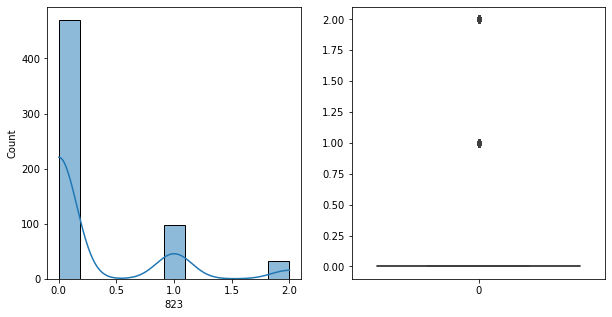

823   Unique :  [0 1 2]
--------------------------------------------------------------------
823   N unique :  3
--------------------------------------------------------------------
823   Value Counts :  0    470
1     97
2     33
Name: 823, dtype: int64
--------------------------------------------------------------------



[ 824 ]
show_df_info :  824


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


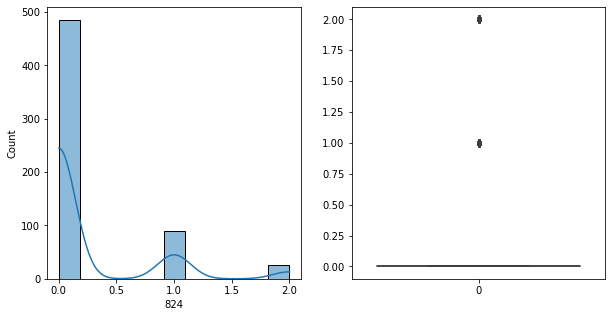

824   Unique :  [0 1 2]
--------------------------------------------------------------------
824   N unique :  3
--------------------------------------------------------------------
824   Value Counts :  0    485
1     89
2     26
Name: 824, dtype: int64
--------------------------------------------------------------------



[ 825 ]
show_df_info :  825


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


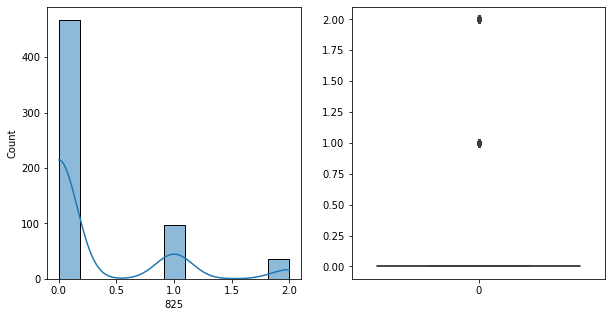

825   Unique :  [0 1 2]
--------------------------------------------------------------------
825   N unique :  3
--------------------------------------------------------------------
825   Value Counts :  0    467
1     97
2     36
Name: 825, dtype: int64
--------------------------------------------------------------------



[ 826 ]
show_df_info :  826


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


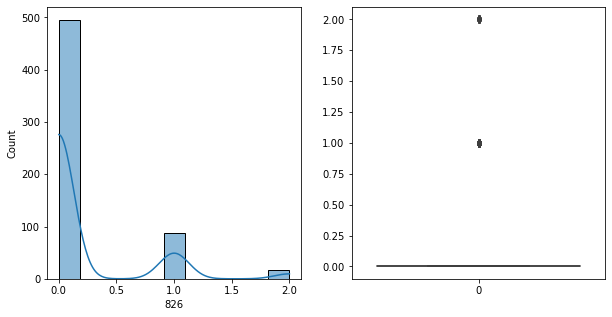

826   Unique :  [0 1 2]
--------------------------------------------------------------------
826   N unique :  3
--------------------------------------------------------------------
826   Value Counts :  0    495
1     88
2     17
Name: 826, dtype: int64
--------------------------------------------------------------------



[ 827 ]
show_df_info :  827


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


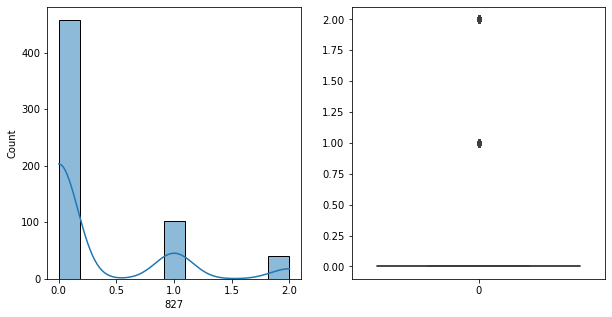

827   Unique :  [1 0 2]
--------------------------------------------------------------------
827   N unique :  3
--------------------------------------------------------------------
827   Value Counts :  0    458
1    102
2     40
Name: 827, dtype: int64
--------------------------------------------------------------------



[ 828 ]
show_df_info :  828


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


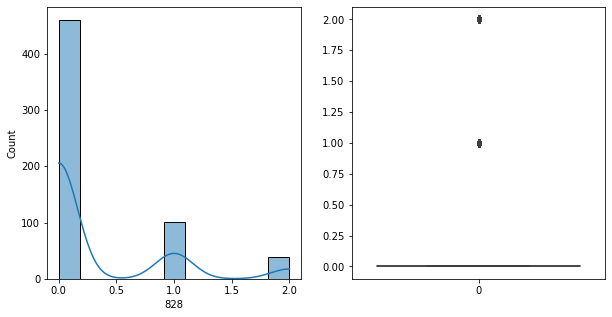

828   Unique :  [1 0 2]
--------------------------------------------------------------------
828   N unique :  3
--------------------------------------------------------------------
828   Value Counts :  0    460
1    101
2     39
Name: 828, dtype: int64
--------------------------------------------------------------------



[ 829 ]
show_df_info :  829


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


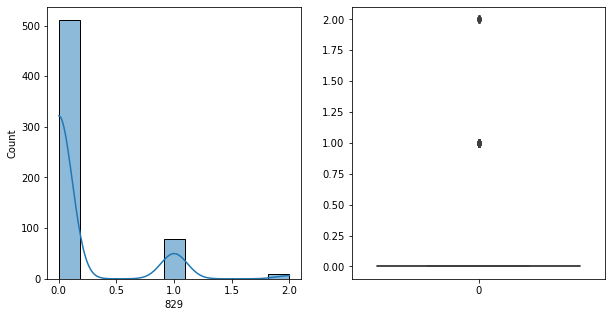

829   Unique :  [1 0 2]
--------------------------------------------------------------------
829   N unique :  3
--------------------------------------------------------------------
829   Value Counts :  0    511
1     79
2     10
Name: 829, dtype: int64
--------------------------------------------------------------------



[ 830 ]
show_df_info :  830


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


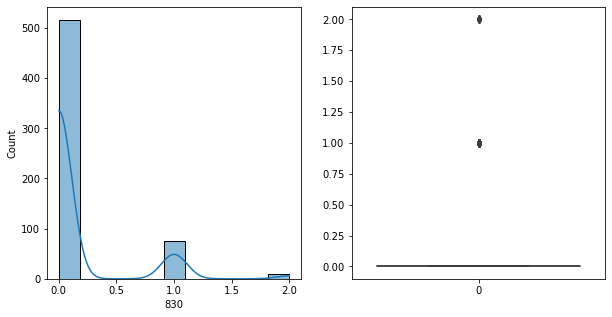

830   Unique :  [1 0 2]
--------------------------------------------------------------------
830   N unique :  3
--------------------------------------------------------------------
830   Value Counts :  0    516
1     75
2      9
Name: 830, dtype: int64
--------------------------------------------------------------------



[ 831 ]
show_df_info :  831


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


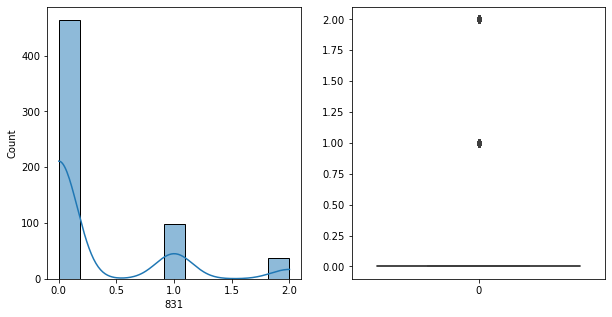

831   Unique :  [0 1 2]
--------------------------------------------------------------------
831   N unique :  3
--------------------------------------------------------------------
831   Value Counts :  0    464
1     99
2     37
Name: 831, dtype: int64
--------------------------------------------------------------------



[ 832 ]
show_df_info :  832


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


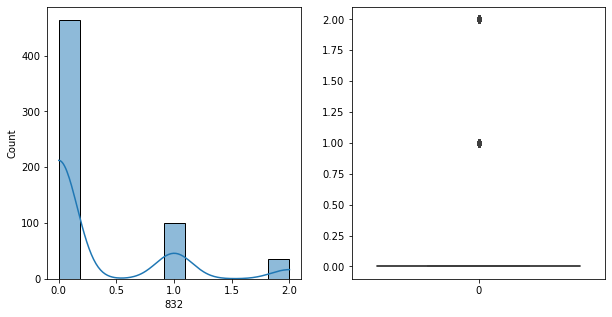

832   Unique :  [0 1 2]
--------------------------------------------------------------------
832   N unique :  3
--------------------------------------------------------------------
832   Value Counts :  0    464
1    100
2     36
Name: 832, dtype: int64
--------------------------------------------------------------------



[ 833 ]
show_df_info :  833


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


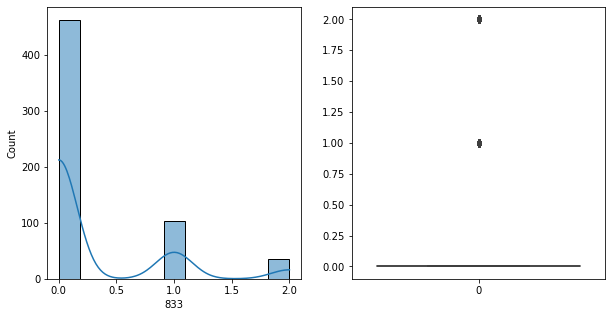

833   Unique :  [1 0 2]
--------------------------------------------------------------------
833   N unique :  3
--------------------------------------------------------------------
833   Value Counts :  0    462
1    103
2     35
Name: 833, dtype: int64
--------------------------------------------------------------------



[ 834 ]
show_df_info :  834


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


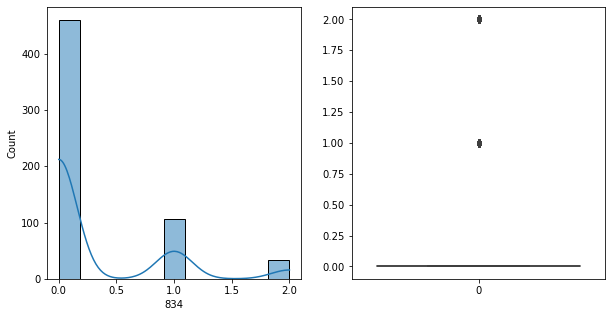

834   Unique :  [1 0 2]
--------------------------------------------------------------------
834   N unique :  3
--------------------------------------------------------------------
834   Value Counts :  0    460
1    106
2     34
Name: 834, dtype: int64
--------------------------------------------------------------------



[ 835 ]
show_df_info :  835


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


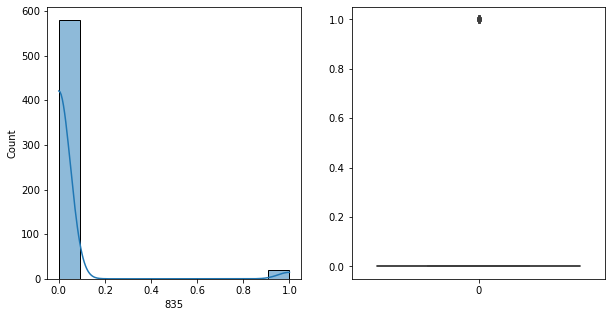

835   Unique :  [0 1]
--------------------------------------------------------------------
835   N unique :  2
--------------------------------------------------------------------
835   Value Counts :  0    580
1     20
Name: 835, dtype: int64
--------------------------------------------------------------------



[ 836 ]
show_df_info :  836


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


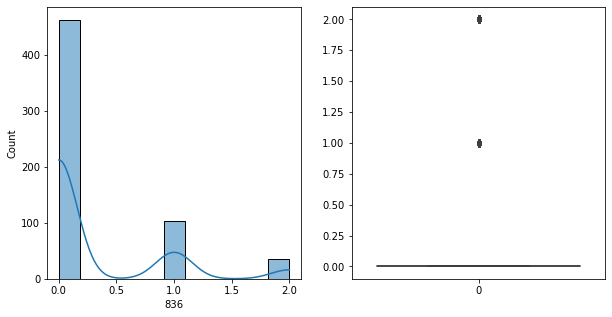

836   Unique :  [1 0 2]
--------------------------------------------------------------------
836   N unique :  3
--------------------------------------------------------------------
836   Value Counts :  0    462
1    103
2     35
Name: 836, dtype: int64
--------------------------------------------------------------------



[ 837 ]
show_df_info :  837


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


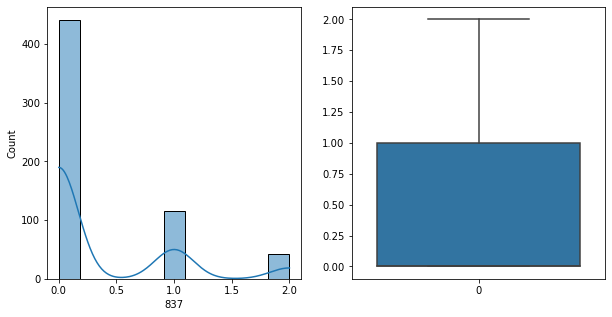

837   Unique :  [1 0 2]
--------------------------------------------------------------------
837   N unique :  3
--------------------------------------------------------------------
837   Value Counts :  0    441
1    116
2     43
Name: 837, dtype: int64
--------------------------------------------------------------------



[ 838 ]
show_df_info :  838


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


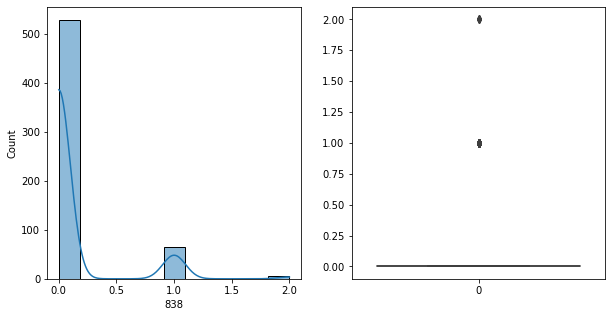

838   Unique :  [0 1 2]
--------------------------------------------------------------------
838   N unique :  3
--------------------------------------------------------------------
838   Value Counts :  0    529
1     66
2      5
Name: 838, dtype: int64
--------------------------------------------------------------------



[ 839 ]
show_df_info :  839


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


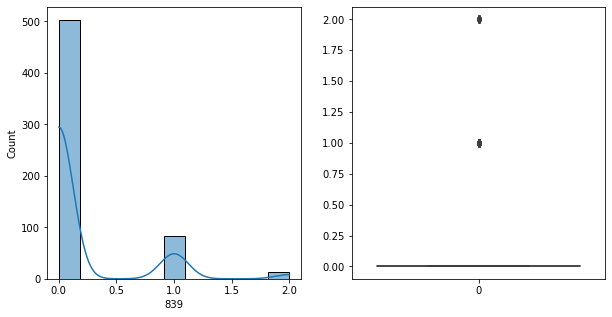

839   Unique :  [0 1 2]
--------------------------------------------------------------------
839   N unique :  3
--------------------------------------------------------------------
839   Value Counts :  0    503
1     83
2     14
Name: 839, dtype: int64
--------------------------------------------------------------------



[ 840 ]
show_df_info :  840


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


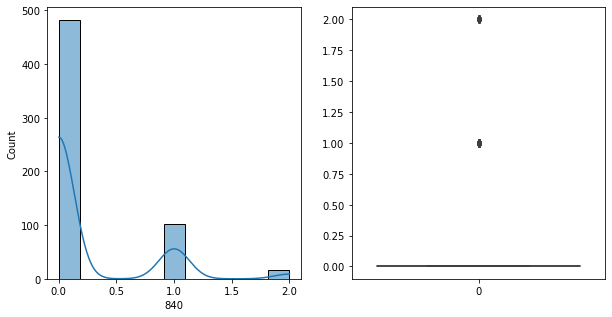

840   Unique :  [1 0 2]
--------------------------------------------------------------------
840   N unique :  3
--------------------------------------------------------------------
840   Value Counts :  0    482
1    102
2     16
Name: 840, dtype: int64
--------------------------------------------------------------------



[ 841 ]
show_df_info :  841


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


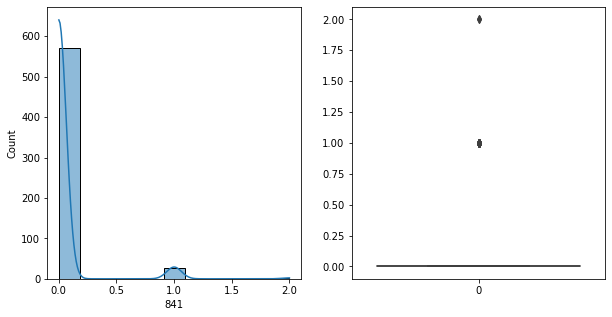

841   Unique :  [0 1 2]
--------------------------------------------------------------------
841   N unique :  3
--------------------------------------------------------------------
841   Value Counts :  0    572
1     26
2      2
Name: 841, dtype: int64
--------------------------------------------------------------------



[ 842 ]
show_df_info :  842


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


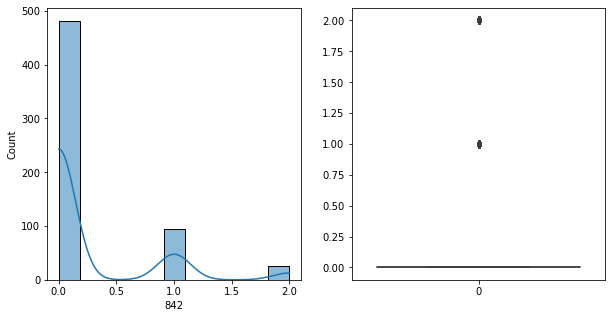

842   Unique :  [2 0 1]
--------------------------------------------------------------------
842   N unique :  3
--------------------------------------------------------------------
842   Value Counts :  0    481
1     94
2     25
Name: 842, dtype: int64
--------------------------------------------------------------------



[ 843 ]
show_df_info :  843


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


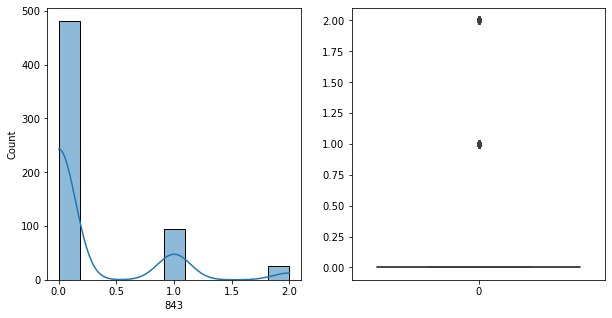

843   Unique :  [2 0 1]
--------------------------------------------------------------------
843   N unique :  3
--------------------------------------------------------------------
843   Value Counts :  0    481
1     94
2     25
Name: 843, dtype: int64
--------------------------------------------------------------------



[ 844 ]
show_df_info :  844


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


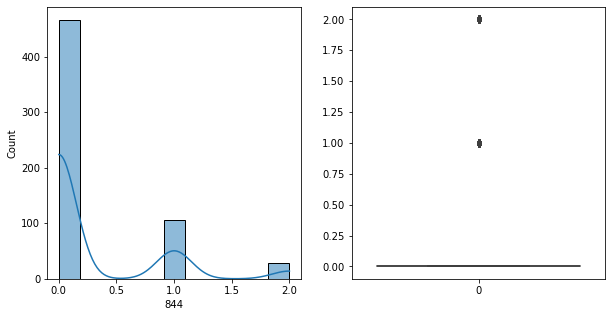

844   Unique :  [2 0 1]
--------------------------------------------------------------------
844   N unique :  3
--------------------------------------------------------------------
844   Value Counts :  0    466
1    105
2     29
Name: 844, dtype: int64
--------------------------------------------------------------------



[ 845 ]
show_df_info :  845


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


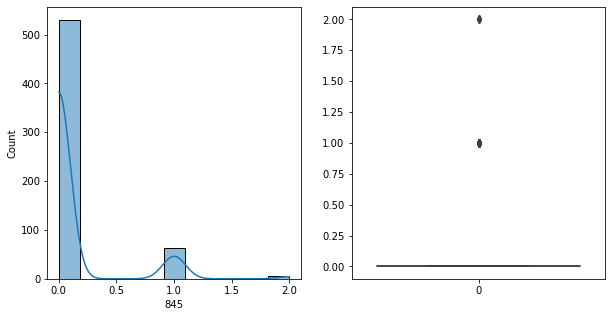

845   Unique :  [0 1 2]
--------------------------------------------------------------------
845   N unique :  3
--------------------------------------------------------------------
845   Value Counts :  0    530
1     64
2      6
Name: 845, dtype: int64
--------------------------------------------------------------------



[ 846 ]
show_df_info :  846


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


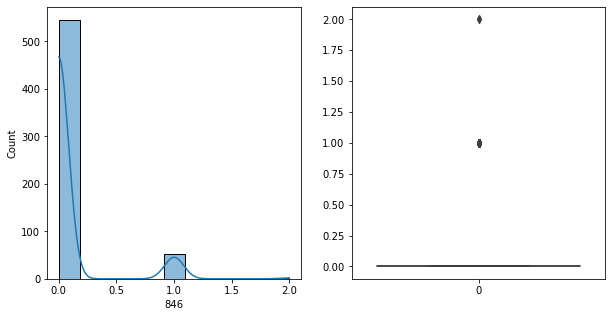

846   Unique :  [1 0 2]
--------------------------------------------------------------------
846   N unique :  3
--------------------------------------------------------------------
846   Value Counts :  0    545
1     53
2      2
Name: 846, dtype: int64
--------------------------------------------------------------------



[ 847 ]
show_df_info :  847


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


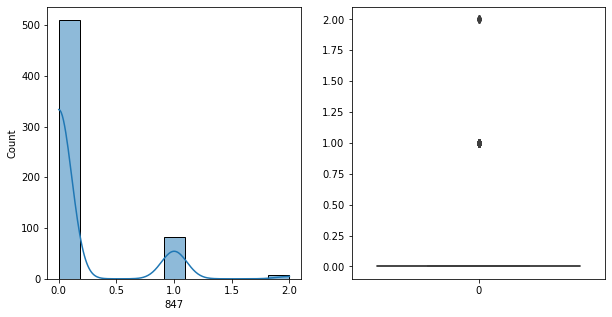

847   Unique :  [0 1 2]
--------------------------------------------------------------------
847   N unique :  3
--------------------------------------------------------------------
847   Value Counts :  0    510
1     83
2      7
Name: 847, dtype: int64
--------------------------------------------------------------------



[ 848 ]
show_df_info :  848


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


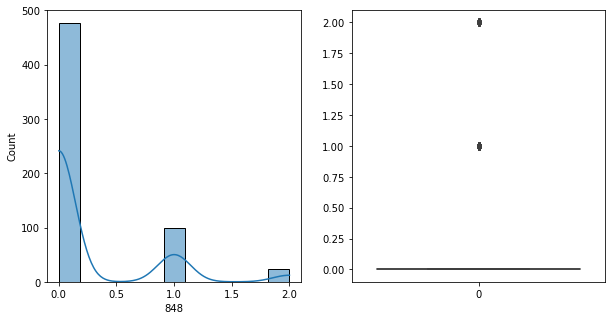

848   Unique :  [0 1 2]
--------------------------------------------------------------------
848   N unique :  3
--------------------------------------------------------------------
848   Value Counts :  0    477
1     99
2     24
Name: 848, dtype: int64
--------------------------------------------------------------------



[ 849 ]
show_df_info :  849


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


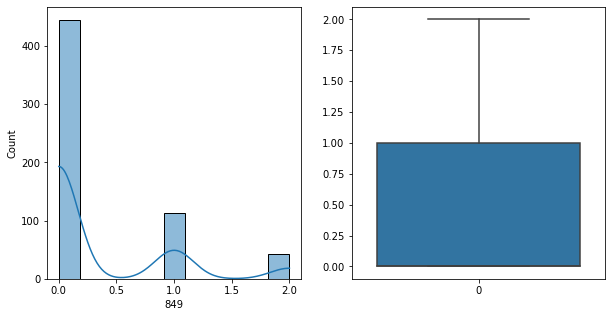

849   Unique :  [1 0 2]
--------------------------------------------------------------------
849   N unique :  3
--------------------------------------------------------------------
849   Value Counts :  0    445
1    113
2     42
Name: 849, dtype: int64
--------------------------------------------------------------------



[ 850 ]
show_df_info :  850


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


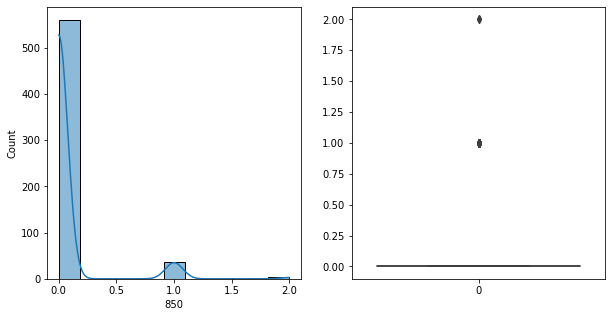

850   Unique :  [0 1 2]
--------------------------------------------------------------------
850   N unique :  3
--------------------------------------------------------------------
850   Value Counts :  0    560
1     37
2      3
Name: 850, dtype: int64
--------------------------------------------------------------------



[ 851 ]
show_df_info :  851


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


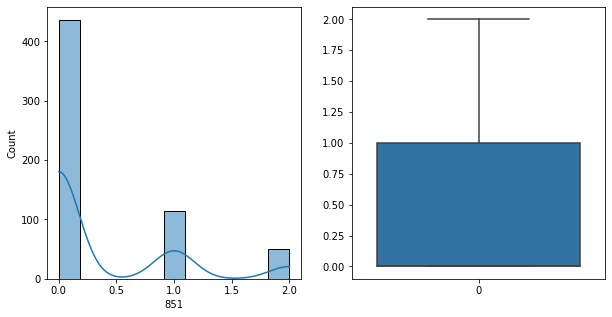

851   Unique :  [1 0 2]
--------------------------------------------------------------------
851   N unique :  3
--------------------------------------------------------------------
851   Value Counts :  0    436
1    114
2     50
Name: 851, dtype: int64
--------------------------------------------------------------------



[ 852 ]
show_df_info :  852


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


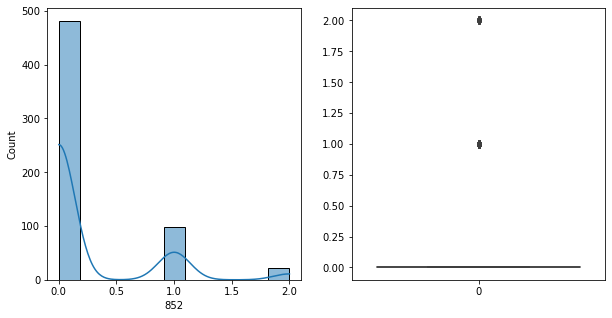

852   Unique :  [0 2 1]
--------------------------------------------------------------------
852   N unique :  3
--------------------------------------------------------------------
852   Value Counts :  0    481
1     98
2     21
Name: 852, dtype: int64
--------------------------------------------------------------------



[ 853 ]
show_df_info :  853


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


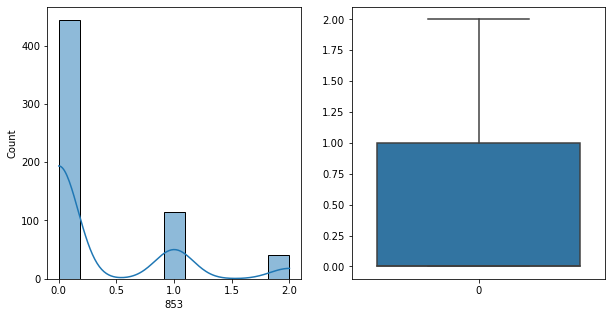

853   Unique :  [1 0 2]
--------------------------------------------------------------------
853   N unique :  3
--------------------------------------------------------------------
853   Value Counts :  0    444
1    115
2     41
Name: 853, dtype: int64
--------------------------------------------------------------------



[ 854 ]
show_df_info :  854


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


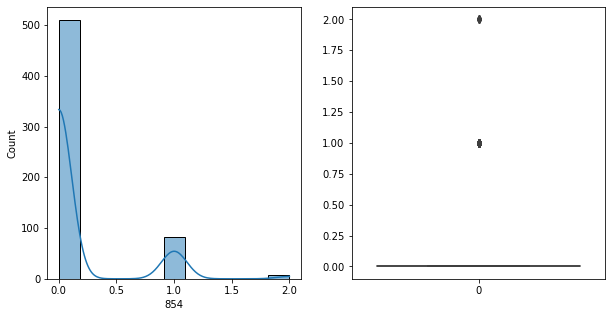

854   Unique :  [0 1 2]
--------------------------------------------------------------------
854   N unique :  3
--------------------------------------------------------------------
854   Value Counts :  0    510
1     83
2      7
Name: 854, dtype: int64
--------------------------------------------------------------------



[ 855 ]
show_df_info :  855


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


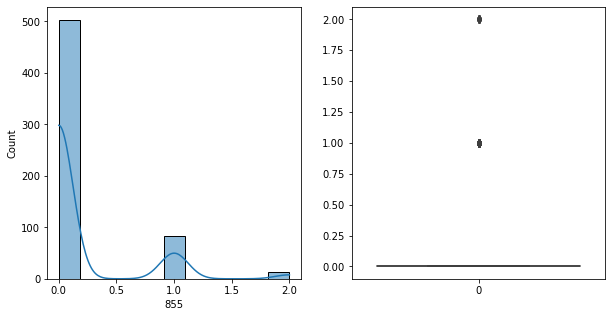

855   Unique :  [1 0 2]
--------------------------------------------------------------------
855   N unique :  3
--------------------------------------------------------------------
855   Value Counts :  0    503
1     84
2     13
Name: 855, dtype: int64
--------------------------------------------------------------------



[ 856 ]
show_df_info :  856


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


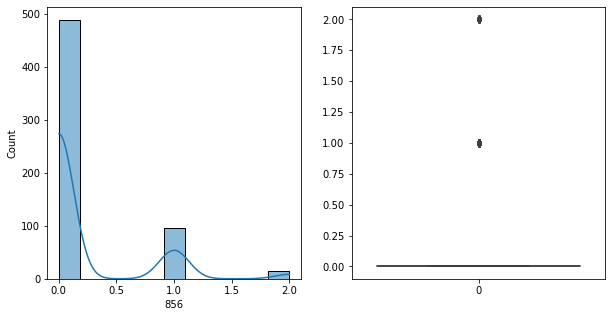

856   Unique :  [1 0 2]
--------------------------------------------------------------------
856   N unique :  3
--------------------------------------------------------------------
856   Value Counts :  0    489
1     96
2     15
Name: 856, dtype: int64
--------------------------------------------------------------------



[ 857 ]
show_df_info :  857


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


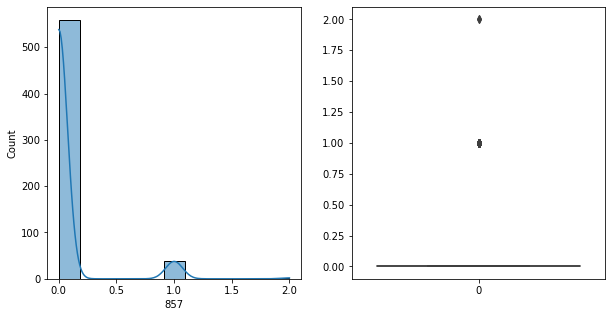

857   Unique :  [0 1 2]
--------------------------------------------------------------------
857   N unique :  3
--------------------------------------------------------------------
857   Value Counts :  0    559
1     39
2      2
Name: 857, dtype: int64
--------------------------------------------------------------------



[ 858 ]
show_df_info :  858


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


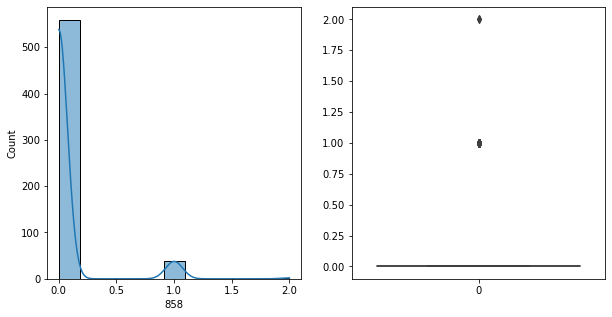

858   Unique :  [0 1 2]
--------------------------------------------------------------------
858   N unique :  3
--------------------------------------------------------------------
858   Value Counts :  0    559
1     39
2      2
Name: 858, dtype: int64
--------------------------------------------------------------------



[ 859 ]
show_df_info :  859


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


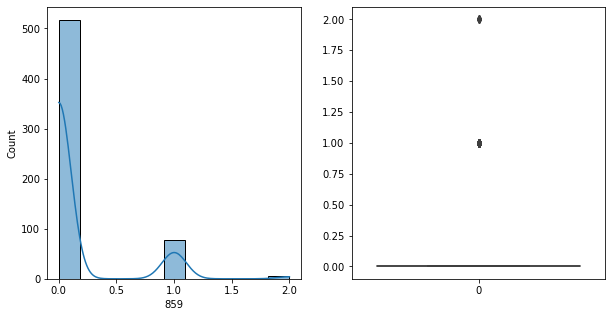

859   Unique :  [1 0 2]
--------------------------------------------------------------------
859   N unique :  3
--------------------------------------------------------------------
859   Value Counts :  0    517
1     77
2      6
Name: 859, dtype: int64
--------------------------------------------------------------------



[ 860 ]
show_df_info :  860


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


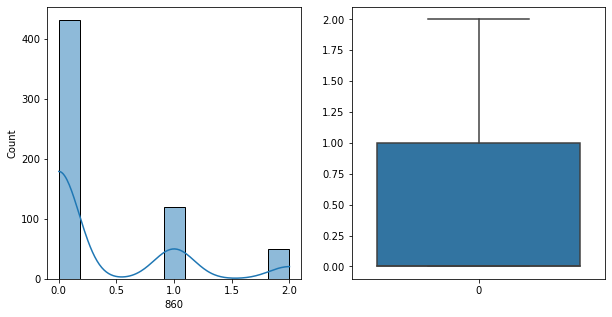

860   Unique :  [2 0 1]
--------------------------------------------------------------------
860   N unique :  3
--------------------------------------------------------------------
860   Value Counts :  0    431
1    120
2     49
Name: 860, dtype: int64
--------------------------------------------------------------------



[ 861 ]
show_df_info :  861


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


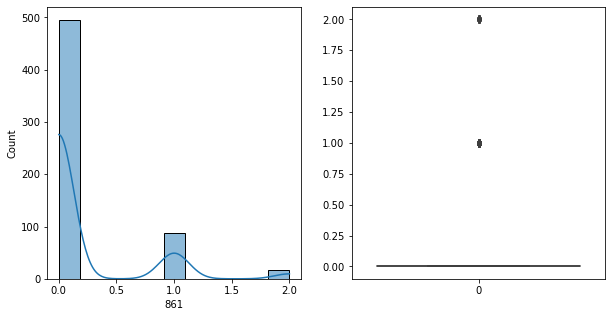

861   Unique :  [1 0 2]
--------------------------------------------------------------------
861   N unique :  3
--------------------------------------------------------------------
861   Value Counts :  0    495
1     88
2     17
Name: 861, dtype: int64
--------------------------------------------------------------------



[ 862 ]
show_df_info :  862


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


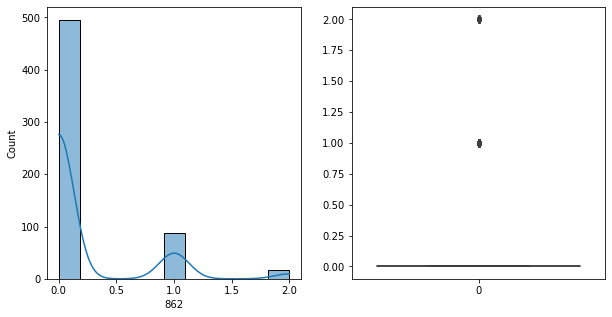

862   Unique :  [1 0 2]
--------------------------------------------------------------------
862   N unique :  3
--------------------------------------------------------------------
862   Value Counts :  0    495
1     88
2     17
Name: 862, dtype: int64
--------------------------------------------------------------------



[ 863 ]
show_df_info :  863


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


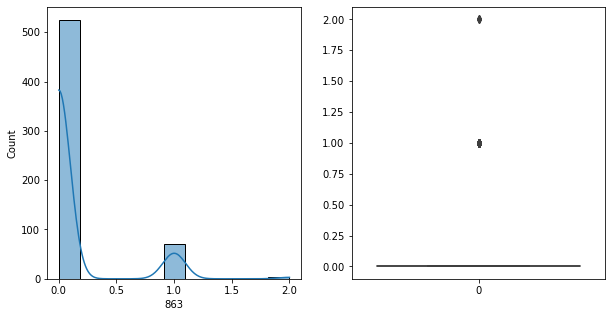

863   Unique :  [1 0 2]
--------------------------------------------------------------------
863   N unique :  3
--------------------------------------------------------------------
863   Value Counts :  0    525
1     71
2      4
Name: 863, dtype: int64
--------------------------------------------------------------------



[ 864 ]
show_df_info :  864


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


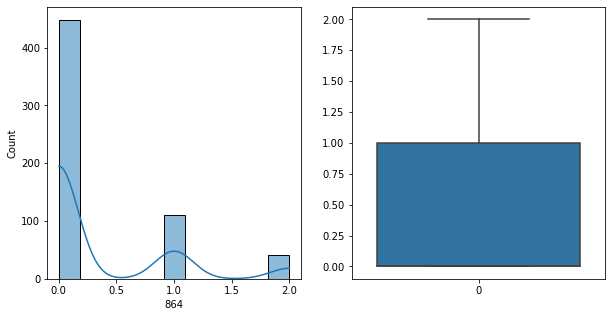

864   Unique :  [0 2 1]
--------------------------------------------------------------------
864   N unique :  3
--------------------------------------------------------------------
864   Value Counts :  0    448
1    110
2     42
Name: 864, dtype: int64
--------------------------------------------------------------------



[ 865 ]
show_df_info :  865


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


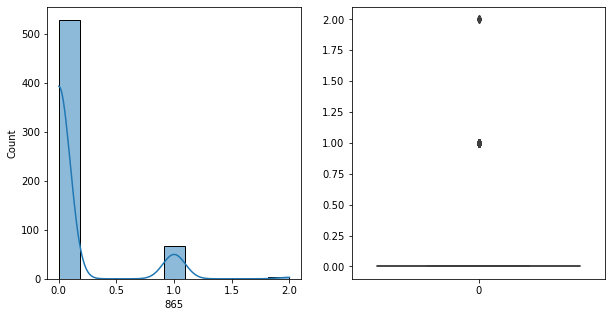

865   Unique :  [1 0 2]
--------------------------------------------------------------------
865   N unique :  3
--------------------------------------------------------------------
865   Value Counts :  0    529
1     67
2      4
Name: 865, dtype: int64
--------------------------------------------------------------------



[ 866 ]
show_df_info :  866


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


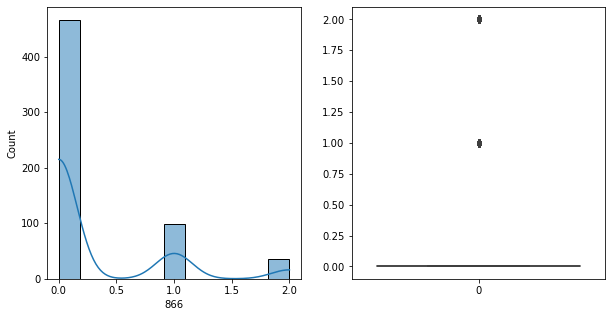

866   Unique :  [2 0 1]
--------------------------------------------------------------------
866   N unique :  3
--------------------------------------------------------------------
866   Value Counts :  0    466
1     99
2     35
Name: 866, dtype: int64
--------------------------------------------------------------------



[ 867 ]
show_df_info :  867


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


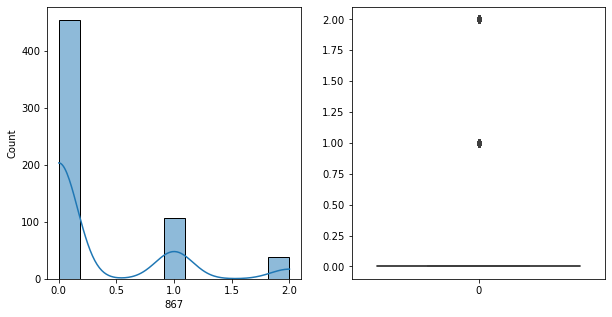

867   Unique :  [2 0 1]
--------------------------------------------------------------------
867   N unique :  3
--------------------------------------------------------------------
867   Value Counts :  0    455
1    107
2     38
Name: 867, dtype: int64
--------------------------------------------------------------------



[ 868 ]
show_df_info :  868


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


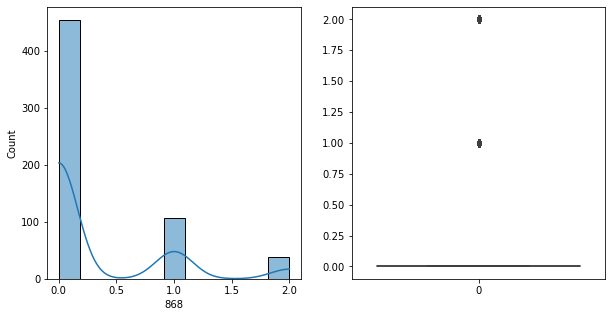

868   Unique :  [2 0 1]
--------------------------------------------------------------------
868   N unique :  3
--------------------------------------------------------------------
868   Value Counts :  0    455
1    107
2     38
Name: 868, dtype: int64
--------------------------------------------------------------------



[ 869 ]
show_df_info :  869


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


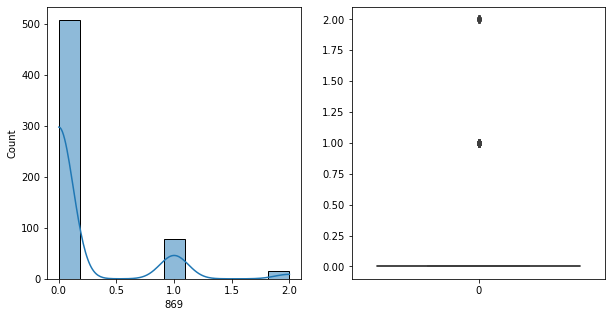

869   Unique :  [1 0 2]
--------------------------------------------------------------------
869   N unique :  3
--------------------------------------------------------------------
869   Value Counts :  0    507
1     78
2     15
Name: 869, dtype: int64
--------------------------------------------------------------------



[ 870 ]
show_df_info :  870


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


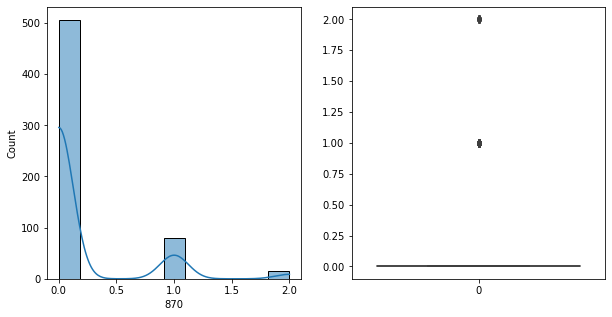

870   Unique :  [1 0 2]
--------------------------------------------------------------------
870   N unique :  3
--------------------------------------------------------------------
870   Value Counts :  0    506
1     79
2     15
Name: 870, dtype: int64
--------------------------------------------------------------------



[ 871 ]
show_df_info :  871


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


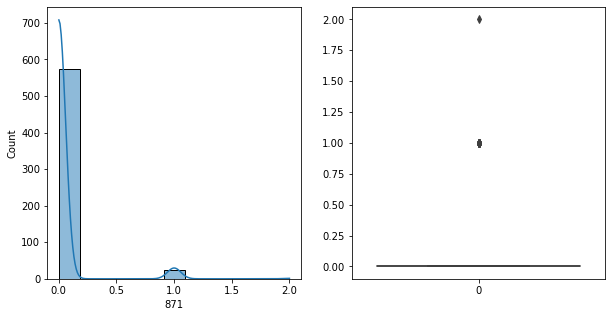

871   Unique :  [0 1 2]
--------------------------------------------------------------------
871   N unique :  3
--------------------------------------------------------------------
871   Value Counts :  0    575
1     24
2      1
Name: 871, dtype: int64
--------------------------------------------------------------------



[ 872 ]
show_df_info :  872


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


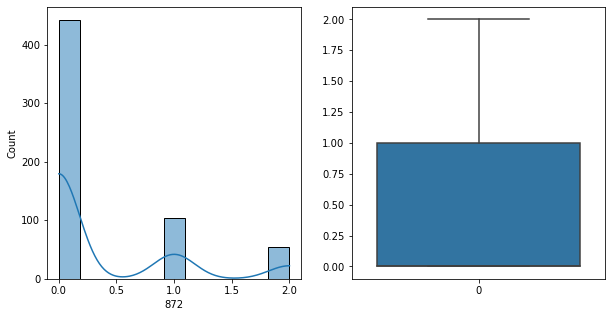

872   Unique :  [1 0 2]
--------------------------------------------------------------------
872   N unique :  3
--------------------------------------------------------------------
872   Value Counts :  0    442
1    103
2     55
Name: 872, dtype: int64
--------------------------------------------------------------------



[ 873 ]
show_df_info :  873


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


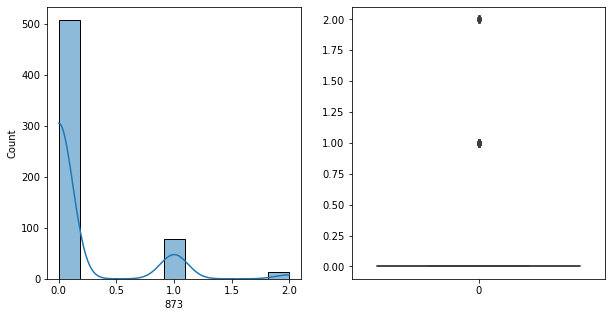

873   Unique :  [1 0 2]
--------------------------------------------------------------------
873   N unique :  3
--------------------------------------------------------------------
873   Value Counts :  0    508
1     79
2     13
Name: 873, dtype: int64
--------------------------------------------------------------------



[ 874 ]
show_df_info :  874


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


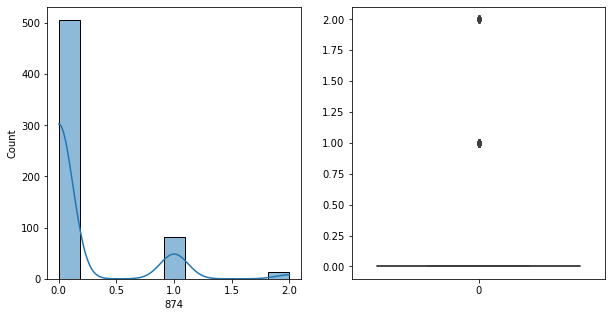

874   Unique :  [1 0 2]
--------------------------------------------------------------------
874   N unique :  3
--------------------------------------------------------------------
874   Value Counts :  0    506
1     81
2     13
Name: 874, dtype: int64
--------------------------------------------------------------------



[ 875 ]
show_df_info :  875


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


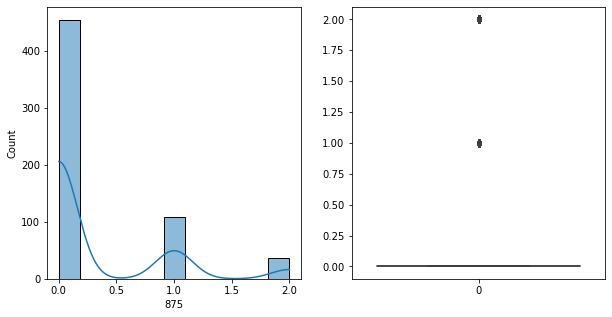

875   Unique :  [1 0 2]
--------------------------------------------------------------------
875   N unique :  3
--------------------------------------------------------------------
875   Value Counts :  0    455
1    109
2     36
Name: 875, dtype: int64
--------------------------------------------------------------------



[ 876 ]
show_df_info :  876


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


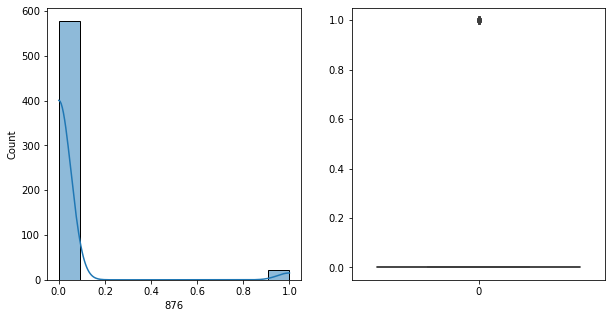

876   Unique :  [0 1]
--------------------------------------------------------------------
876   N unique :  2
--------------------------------------------------------------------
876   Value Counts :  0    578
1     22
Name: 876, dtype: int64
--------------------------------------------------------------------



[ 877 ]
show_df_info :  877


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


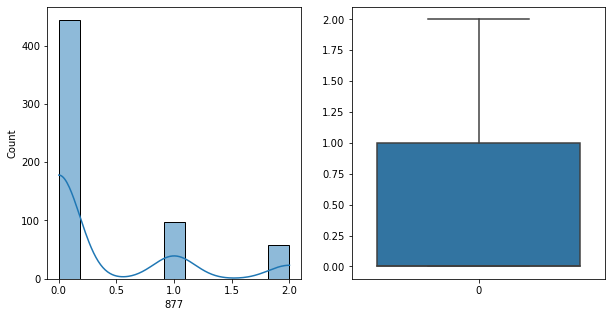

877   Unique :  [1 0 2]
--------------------------------------------------------------------
877   N unique :  3
--------------------------------------------------------------------
877   Value Counts :  0    444
1     98
2     58
Name: 877, dtype: int64
--------------------------------------------------------------------



[ 878 ]
show_df_info :  878


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


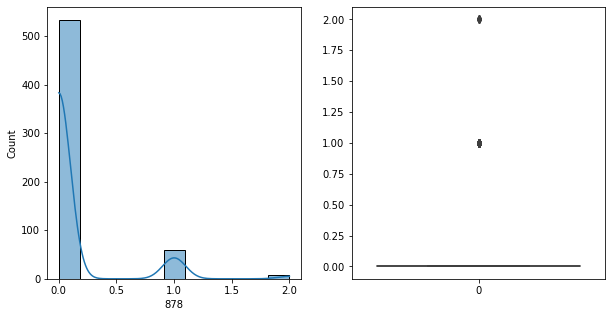

878   Unique :  [0 1 2]
--------------------------------------------------------------------
878   N unique :  3
--------------------------------------------------------------------
878   Value Counts :  0    533
1     60
2      7
Name: 878, dtype: int64
--------------------------------------------------------------------



[ 879 ]
show_df_info :  879


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


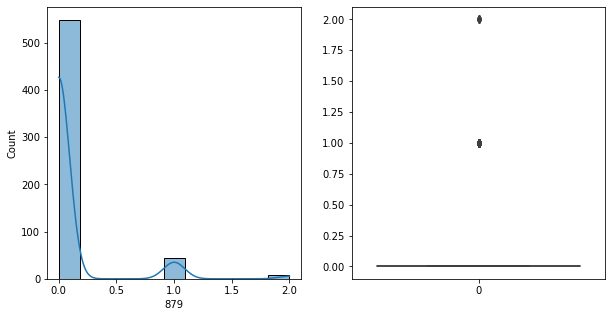

879   Unique :  [0 1 2]
--------------------------------------------------------------------
879   N unique :  3
--------------------------------------------------------------------
879   Value Counts :  0    548
1     45
2      7
Name: 879, dtype: int64
--------------------------------------------------------------------



[ 880 ]
show_df_info :  880


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


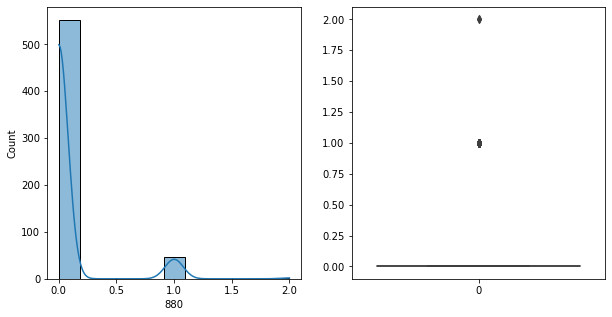

880   Unique :  [0 1 2]
--------------------------------------------------------------------
880   N unique :  3
--------------------------------------------------------------------
880   Value Counts :  0    552
1     46
2      2
Name: 880, dtype: int64
--------------------------------------------------------------------



[ 881 ]
show_df_info :  881


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


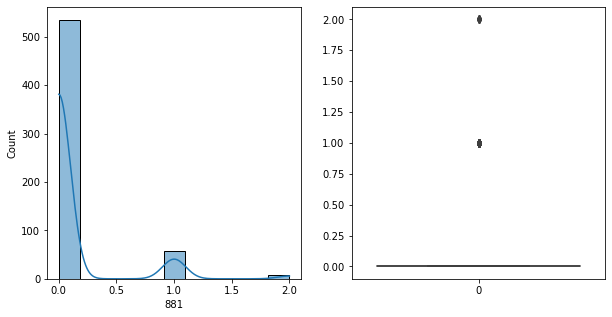

881   Unique :  [0 1 2]
--------------------------------------------------------------------
881   N unique :  3
--------------------------------------------------------------------
881   Value Counts :  0    535
1     57
2      8
Name: 881, dtype: int64
--------------------------------------------------------------------



[ 882 ]
show_df_info :  882


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


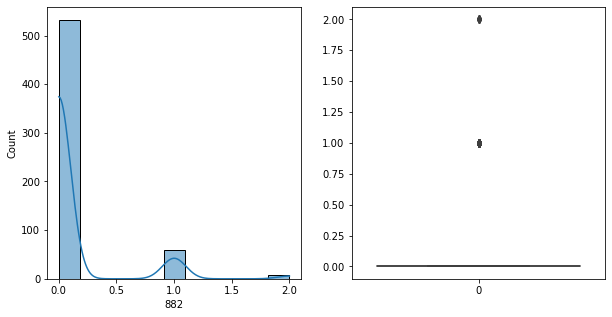

882   Unique :  [0 1 2]
--------------------------------------------------------------------
882   N unique :  3
--------------------------------------------------------------------
882   Value Counts :  0    532
1     60
2      8
Name: 882, dtype: int64
--------------------------------------------------------------------



[ 883 ]
show_df_info :  883


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


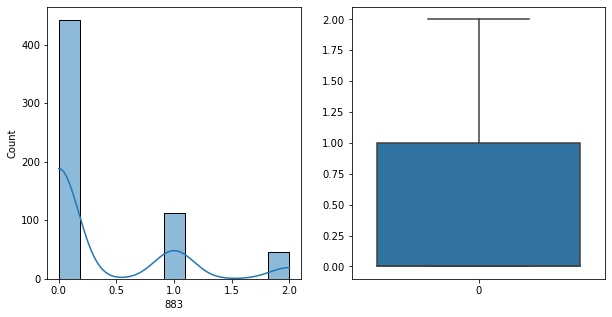

883   Unique :  [1 0 2]
--------------------------------------------------------------------
883   N unique :  3
--------------------------------------------------------------------
883   Value Counts :  0    442
1    113
2     45
Name: 883, dtype: int64
--------------------------------------------------------------------



[ 884 ]
show_df_info :  884


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


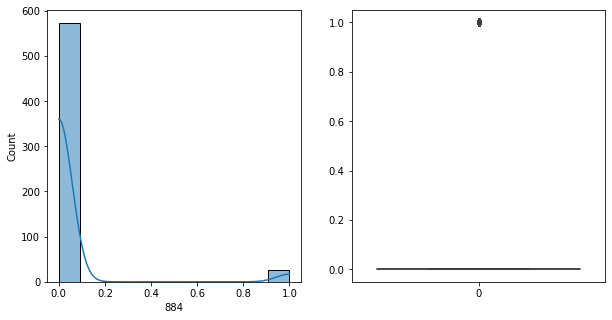

884   Unique :  [0 1]
--------------------------------------------------------------------
884   N unique :  2
--------------------------------------------------------------------
884   Value Counts :  0    573
1     27
Name: 884, dtype: int64
--------------------------------------------------------------------



[ 885 ]
show_df_info :  885


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


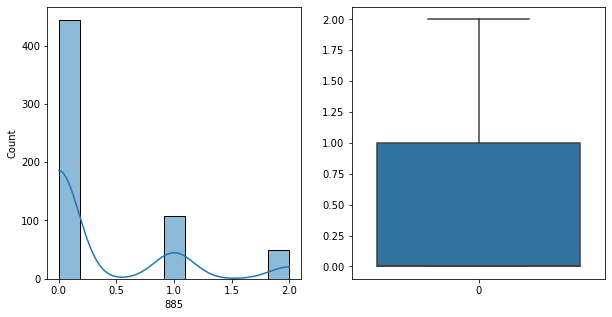

885   Unique :  [1 0 2]
--------------------------------------------------------------------
885   N unique :  3
--------------------------------------------------------------------
885   Value Counts :  0    444
1    107
2     49
Name: 885, dtype: int64
--------------------------------------------------------------------



[ 886 ]
show_df_info :  886


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


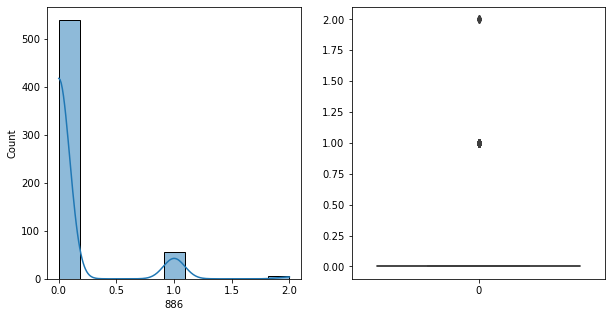

886   Unique :  [0 1 2]
--------------------------------------------------------------------
886   N unique :  3
--------------------------------------------------------------------
886   Value Counts :  0    540
1     55
2      5
Name: 886, dtype: int64
--------------------------------------------------------------------



[ 887 ]
show_df_info :  887


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


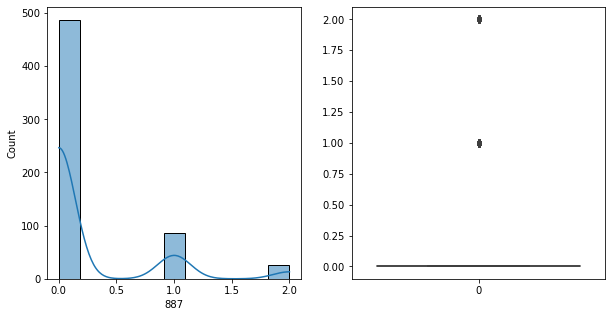

887   Unique :  [1 0 2]
--------------------------------------------------------------------
887   N unique :  3
--------------------------------------------------------------------
887   Value Counts :  0    487
1     87
2     26
Name: 887, dtype: int64
--------------------------------------------------------------------



[ 888 ]
show_df_info :  888


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


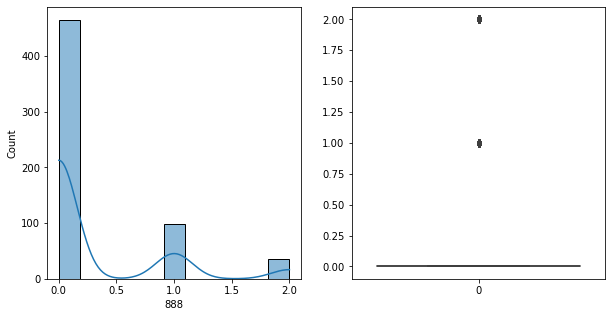

888   Unique :  [1 0 2]
--------------------------------------------------------------------
888   N unique :  3
--------------------------------------------------------------------
888   Value Counts :  0    465
1     99
2     36
Name: 888, dtype: int64
--------------------------------------------------------------------



[ 889 ]
show_df_info :  889


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


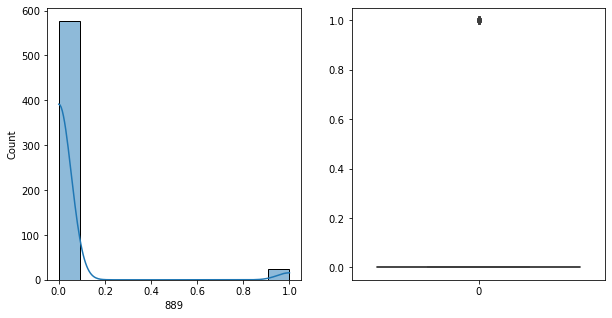

889   Unique :  [0 1]
--------------------------------------------------------------------
889   N unique :  2
--------------------------------------------------------------------
889   Value Counts :  0    577
1     23
Name: 889, dtype: int64
--------------------------------------------------------------------



[ 890 ]
show_df_info :  890


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


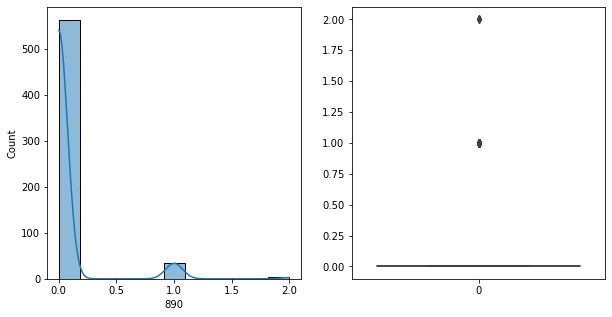

890   Unique :  [0 1 2]
--------------------------------------------------------------------
890   N unique :  3
--------------------------------------------------------------------
890   Value Counts :  0    562
1     35
2      3
Name: 890, dtype: int64
--------------------------------------------------------------------



[ 891 ]
show_df_info :  891


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


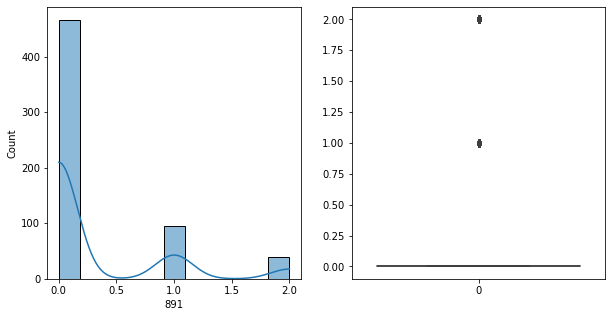

891   Unique :  [1 0 2]
--------------------------------------------------------------------
891   N unique :  3
--------------------------------------------------------------------
891   Value Counts :  0    466
1     95
2     39
Name: 891, dtype: int64
--------------------------------------------------------------------



[ 892 ]
show_df_info :  892


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


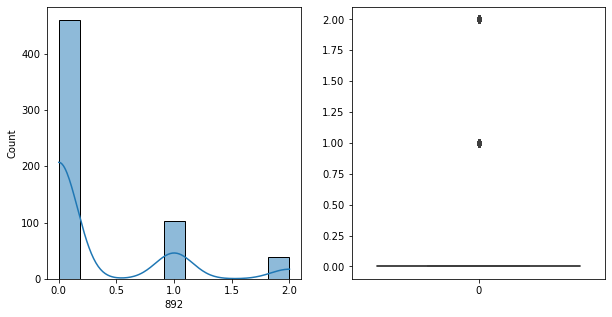

892   Unique :  [1 0 2]
--------------------------------------------------------------------
892   N unique :  3
--------------------------------------------------------------------
892   Value Counts :  0    460
1    102
2     38
Name: 892, dtype: int64
--------------------------------------------------------------------



[ 893 ]
show_df_info :  893


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


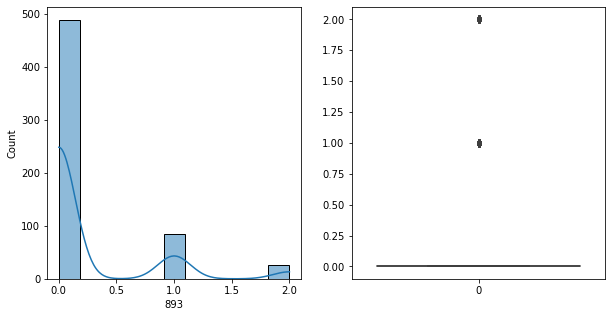

893   Unique :  [1 0 2]
--------------------------------------------------------------------
893   N unique :  3
--------------------------------------------------------------------
893   Value Counts :  0    489
1     85
2     26
Name: 893, dtype: int64
--------------------------------------------------------------------



[ 894 ]
show_df_info :  894


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


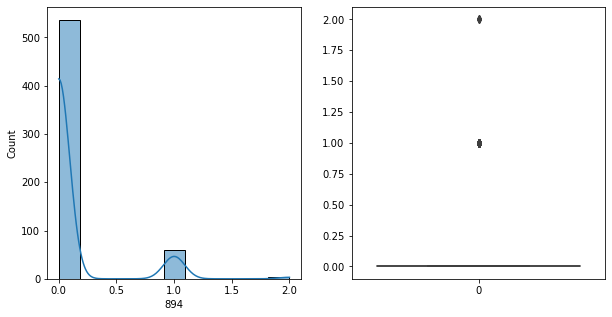

894   Unique :  [0 1 2]
--------------------------------------------------------------------
894   N unique :  3
--------------------------------------------------------------------
894   Value Counts :  0    536
1     60
2      4
Name: 894, dtype: int64
--------------------------------------------------------------------



[ 895 ]
show_df_info :  895


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


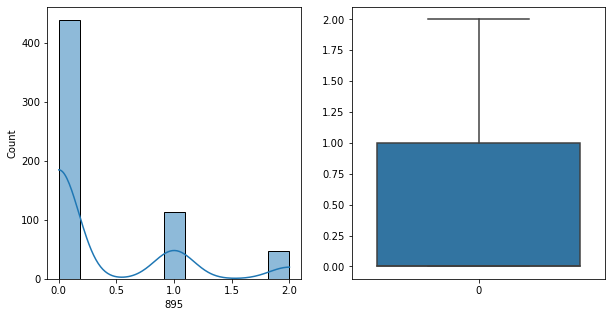

895   Unique :  [1 0 2]
--------------------------------------------------------------------
895   N unique :  3
--------------------------------------------------------------------
895   Value Counts :  0    439
1    114
2     47
Name: 895, dtype: int64
--------------------------------------------------------------------



[ 896 ]
show_df_info :  896


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


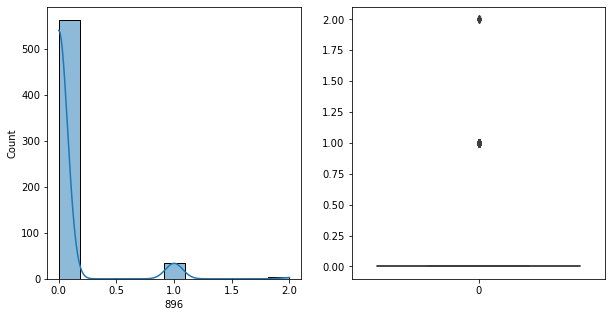

896   Unique :  [0 1 2]
--------------------------------------------------------------------
896   N unique :  3
--------------------------------------------------------------------
896   Value Counts :  0    562
1     35
2      3
Name: 896, dtype: int64
--------------------------------------------------------------------



[ 897 ]
show_df_info :  897


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


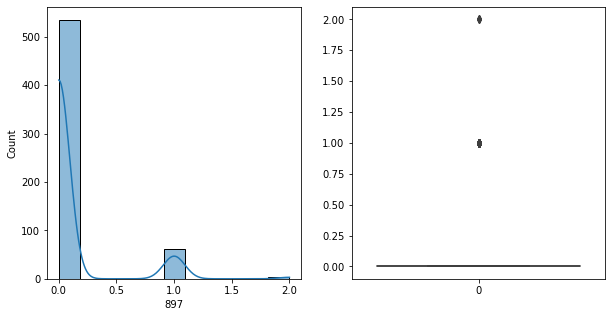

897   Unique :  [0 1 2]
--------------------------------------------------------------------
897   N unique :  3
--------------------------------------------------------------------
897   Value Counts :  0    535
1     61
2      4
Name: 897, dtype: int64
--------------------------------------------------------------------



[ 898 ]
show_df_info :  898


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


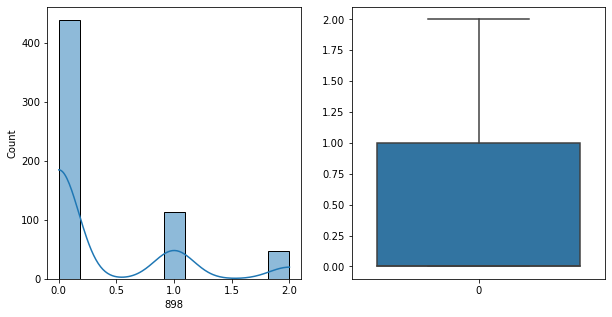

898   Unique :  [1 0 2]
--------------------------------------------------------------------
898   N unique :  3
--------------------------------------------------------------------
898   Value Counts :  0    439
1    114
2     47
Name: 898, dtype: int64
--------------------------------------------------------------------



[ 899 ]
show_df_info :  899


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


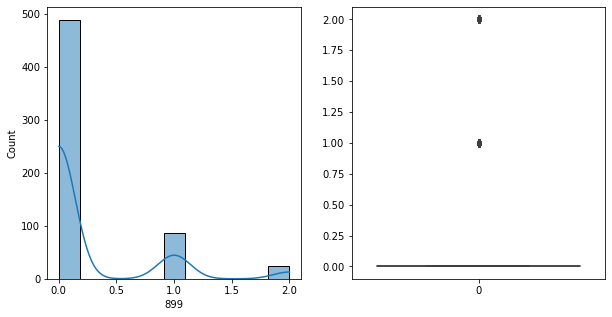

899   Unique :  [1 0 2]
--------------------------------------------------------------------
899   N unique :  3
--------------------------------------------------------------------
899   Value Counts :  0    488
1     87
2     25
Name: 899, dtype: int64
--------------------------------------------------------------------



[ 900 ]
show_df_info :  900


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


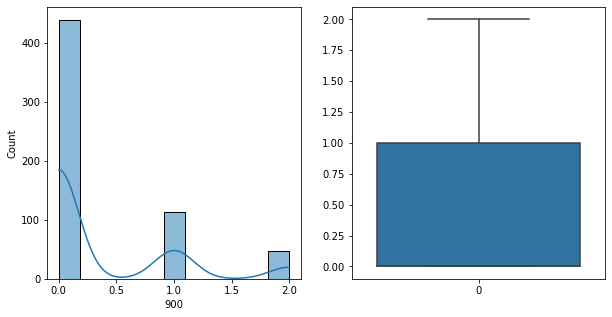

900   Unique :  [1 0 2]
--------------------------------------------------------------------
900   N unique :  3
--------------------------------------------------------------------
900   Value Counts :  0    439
1    114
2     47
Name: 900, dtype: int64
--------------------------------------------------------------------



[ 901 ]
show_df_info :  901


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


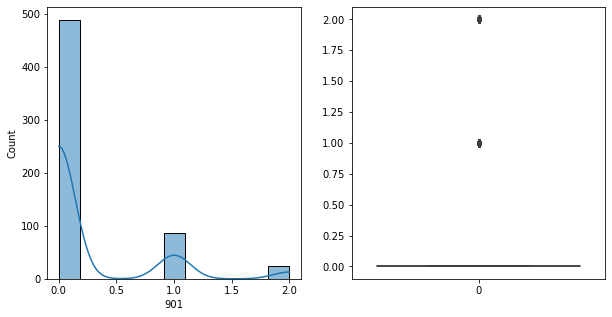

901   Unique :  [1 0 2]
--------------------------------------------------------------------
901   N unique :  3
--------------------------------------------------------------------
901   Value Counts :  0    488
1     87
2     25
Name: 901, dtype: int64
--------------------------------------------------------------------



[ 902 ]
show_df_info :  902


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


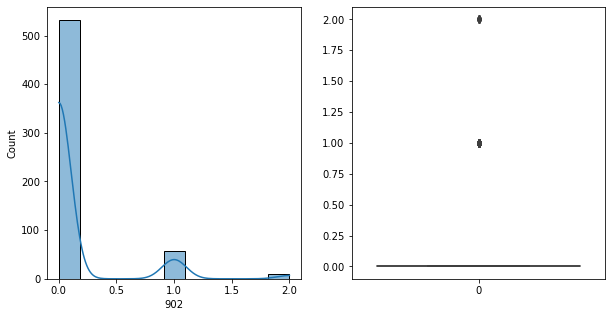

902   Unique :  [1 0 2]
--------------------------------------------------------------------
902   N unique :  3
--------------------------------------------------------------------
902   Value Counts :  0    532
1     58
2     10
Name: 902, dtype: int64
--------------------------------------------------------------------



[ 903 ]
show_df_info :  903


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


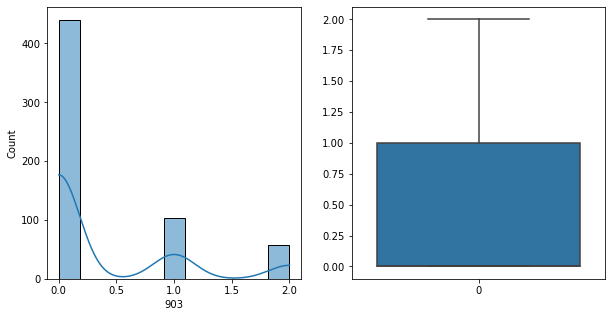

903   Unique :  [2 0 1]
--------------------------------------------------------------------
903   N unique :  3
--------------------------------------------------------------------
903   Value Counts :  0    440
1    103
2     57
Name: 903, dtype: int64
--------------------------------------------------------------------



[ 904 ]
show_df_info :  904


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


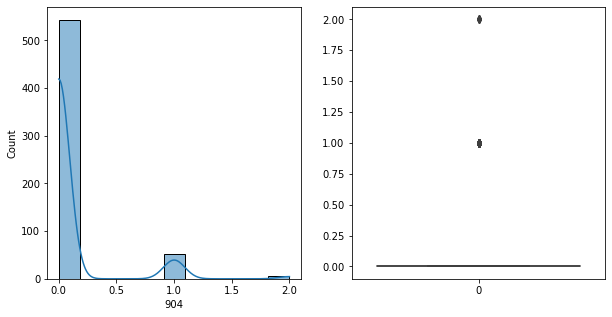

904   Unique :  [0 1 2]
--------------------------------------------------------------------
904   N unique :  3
--------------------------------------------------------------------
904   Value Counts :  0    543
1     51
2      6
Name: 904, dtype: int64
--------------------------------------------------------------------



[ 905 ]
show_df_info :  905


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


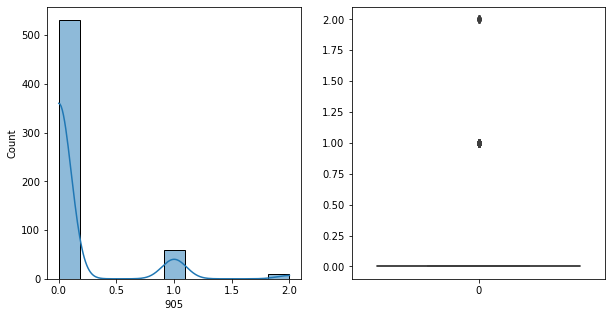

905   Unique :  [1 0 2]
--------------------------------------------------------------------
905   N unique :  3
--------------------------------------------------------------------
905   Value Counts :  0    531
1     59
2     10
Name: 905, dtype: int64
--------------------------------------------------------------------



[ 906 ]
show_df_info :  906


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


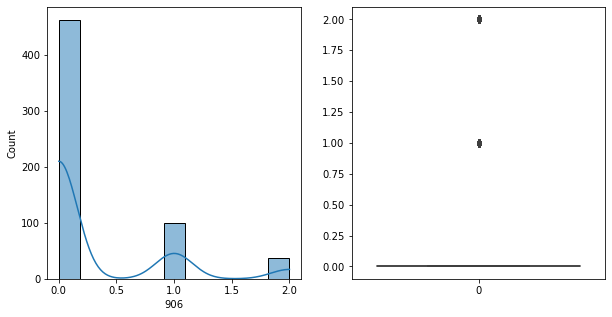

906   Unique :  [0 2 1]
--------------------------------------------------------------------
906   N unique :  3
--------------------------------------------------------------------
906   Value Counts :  0    463
1    100
2     37
Name: 906, dtype: int64
--------------------------------------------------------------------



[ 907 ]
show_df_info :  907


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


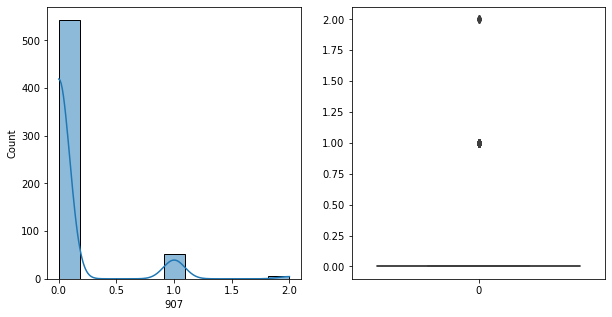

907   Unique :  [0 1 2]
--------------------------------------------------------------------
907   N unique :  3
--------------------------------------------------------------------
907   Value Counts :  0    543
1     51
2      6
Name: 907, dtype: int64
--------------------------------------------------------------------



[ 908 ]
show_df_info :  908


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


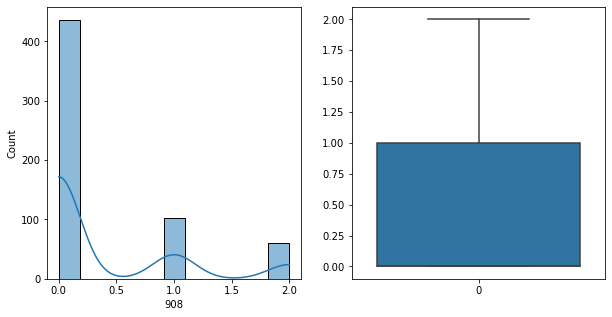

908   Unique :  [2 0 1]
--------------------------------------------------------------------
908   N unique :  3
--------------------------------------------------------------------
908   Value Counts :  0    436
1    103
2     61
Name: 908, dtype: int64
--------------------------------------------------------------------



[ 909 ]
show_df_info :  909


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


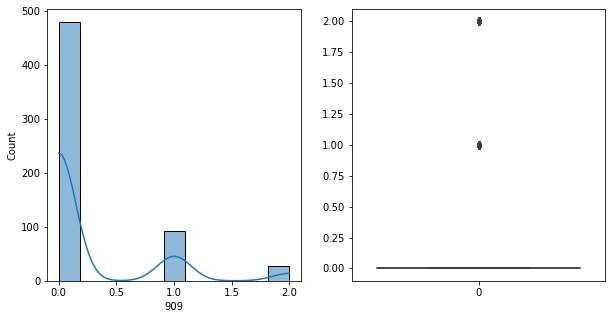

909   Unique :  [1 0 2]
--------------------------------------------------------------------
909   N unique :  3
--------------------------------------------------------------------
909   Value Counts :  0    480
1     92
2     28
Name: 909, dtype: int64
--------------------------------------------------------------------



[ 910 ]
show_df_info :  910


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


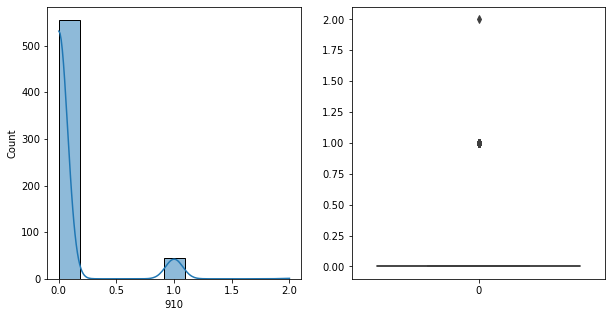

910   Unique :  [0 1 2]
--------------------------------------------------------------------
910   N unique :  3
--------------------------------------------------------------------
910   Value Counts :  0    555
1     44
2      1
Name: 910, dtype: int64
--------------------------------------------------------------------



[ 911 ]
show_df_info :  911


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


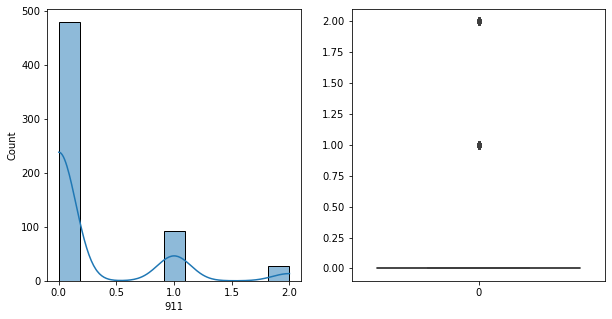

911   Unique :  [1 0 2]
--------------------------------------------------------------------
911   N unique :  3
--------------------------------------------------------------------
911   Value Counts :  0    480
1     93
2     27
Name: 911, dtype: int64
--------------------------------------------------------------------



[ 912 ]
show_df_info :  912


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


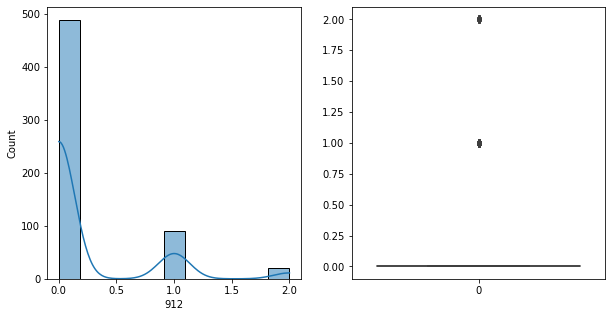

912   Unique :  [1 0 2]
--------------------------------------------------------------------
912   N unique :  3
--------------------------------------------------------------------
912   Value Counts :  0    489
1     90
2     21
Name: 912, dtype: int64
--------------------------------------------------------------------



[ 913 ]
show_df_info :  913


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


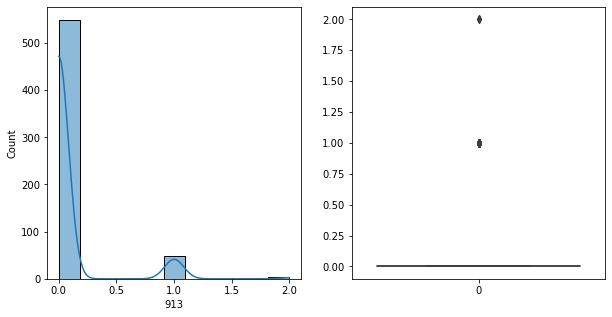

913   Unique :  [0 1 2]
--------------------------------------------------------------------
913   N unique :  3
--------------------------------------------------------------------
913   Value Counts :  0    549
1     48
2      3
Name: 913, dtype: int64
--------------------------------------------------------------------



[ 914 ]
show_df_info :  914


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


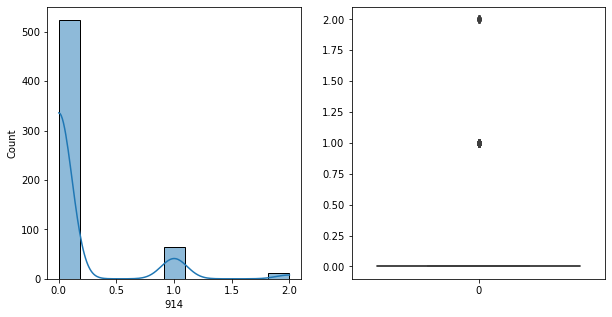

914   Unique :  [0 1 2]
--------------------------------------------------------------------
914   N unique :  3
--------------------------------------------------------------------
914   Value Counts :  0    524
1     64
2     12
Name: 914, dtype: int64
--------------------------------------------------------------------



[ 915 ]
show_df_info :  915


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


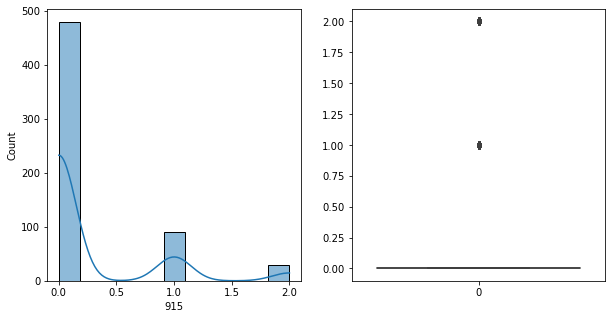

915   Unique :  [1 0 2]
--------------------------------------------------------------------
915   N unique :  3
--------------------------------------------------------------------
915   Value Counts :  0    479
1     91
2     30
Name: 915, dtype: int64
--------------------------------------------------------------------



[ 916 ]
show_df_info :  916


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


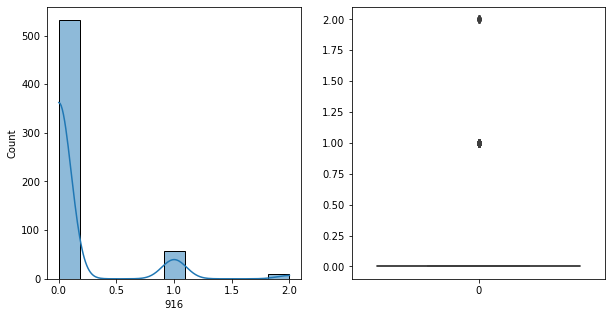

916   Unique :  [1 0 2]
--------------------------------------------------------------------
916   N unique :  3
--------------------------------------------------------------------
916   Value Counts :  0    532
1     58
2     10
Name: 916, dtype: int64
--------------------------------------------------------------------



[ 917 ]
show_df_info :  917


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


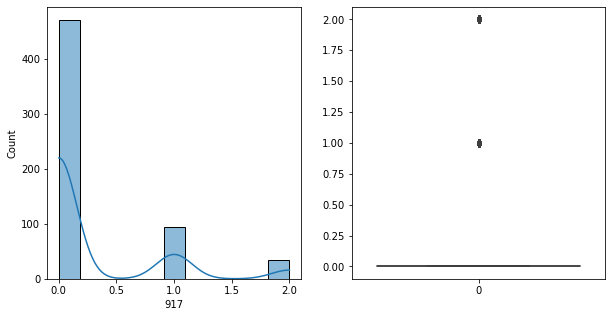

917   Unique :  [0 1 2]
--------------------------------------------------------------------
917   N unique :  3
--------------------------------------------------------------------
917   Value Counts :  0    471
1     95
2     34
Name: 917, dtype: int64
--------------------------------------------------------------------



[ 918 ]
show_df_info :  918


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


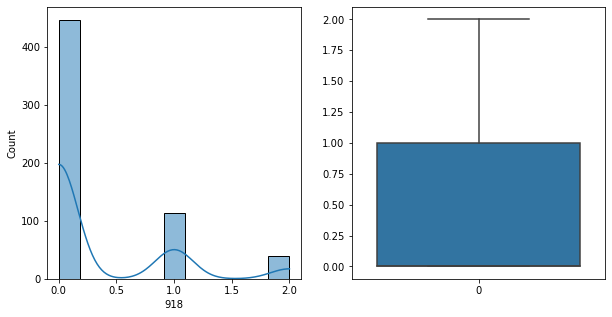

918   Unique :  [2 0 1]
--------------------------------------------------------------------
918   N unique :  3
--------------------------------------------------------------------
918   Value Counts :  0    447
1    114
2     39
Name: 918, dtype: int64
--------------------------------------------------------------------



[ 919 ]
show_df_info :  919


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


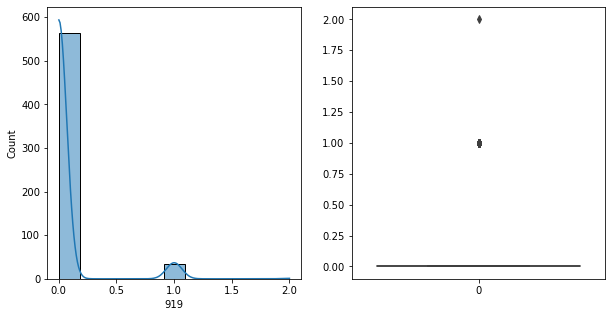

919   Unique :  [0 1 2]
--------------------------------------------------------------------
919   N unique :  3
--------------------------------------------------------------------
919   Value Counts :  0    564
1     35
2      1
Name: 919, dtype: int64
--------------------------------------------------------------------



[ 920 ]
show_df_info :  920


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


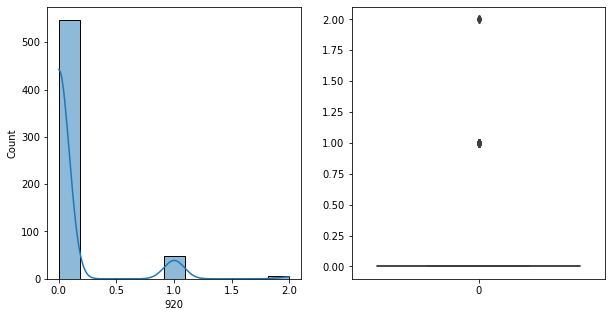

920   Unique :  [0 1 2]
--------------------------------------------------------------------
920   N unique :  3
--------------------------------------------------------------------
920   Value Counts :  0    547
1     48
2      5
Name: 920, dtype: int64
--------------------------------------------------------------------



[ 921 ]
show_df_info :  921


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


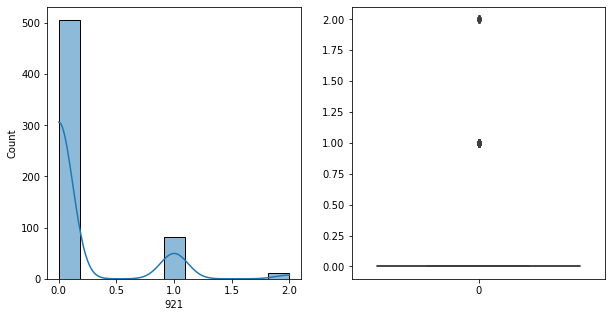

921   Unique :  [0 1 2]
--------------------------------------------------------------------
921   N unique :  3
--------------------------------------------------------------------
921   Value Counts :  0    506
1     82
2     12
Name: 921, dtype: int64
--------------------------------------------------------------------



[ 922 ]
show_df_info :  922


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


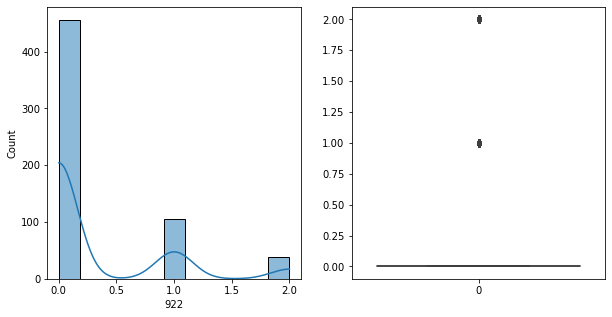

922   Unique :  [0 1 2]
--------------------------------------------------------------------
922   N unique :  3
--------------------------------------------------------------------
922   Value Counts :  0    456
1    106
2     38
Name: 922, dtype: int64
--------------------------------------------------------------------



[ 923 ]
show_df_info :  923


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


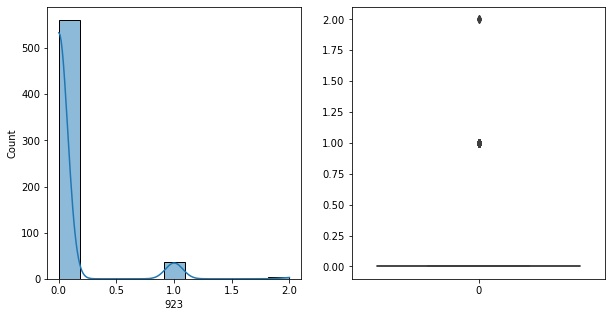

923   Unique :  [0 1 2]
--------------------------------------------------------------------
923   N unique :  3
--------------------------------------------------------------------
923   Value Counts :  0    561
1     36
2      3
Name: 923, dtype: int64
--------------------------------------------------------------------



[ 924 ]
show_df_info :  924


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


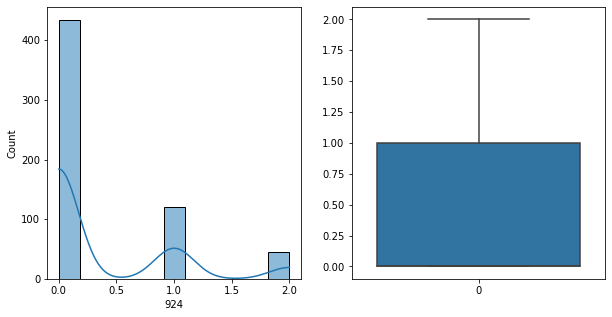

924   Unique :  [2 0 1]
--------------------------------------------------------------------
924   N unique :  3
--------------------------------------------------------------------
924   Value Counts :  0    434
1    121
2     45
Name: 924, dtype: int64
--------------------------------------------------------------------



[ 925 ]
show_df_info :  925


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


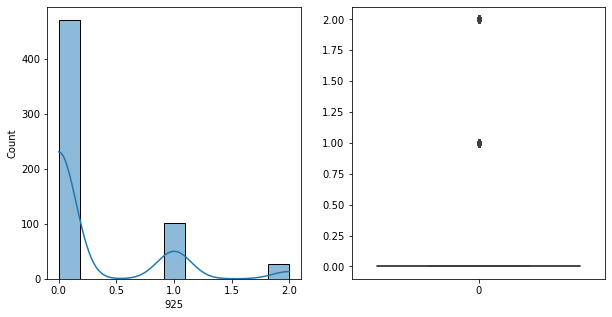

925   Unique :  [0 1 2]
--------------------------------------------------------------------
925   N unique :  3
--------------------------------------------------------------------
925   Value Counts :  0    471
1    102
2     27
Name: 925, dtype: int64
--------------------------------------------------------------------



[ 926 ]
show_df_info :  926


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


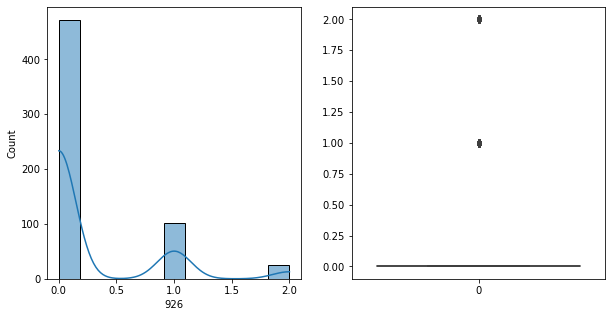

926   Unique :  [0 1 2]
--------------------------------------------------------------------
926   N unique :  3
--------------------------------------------------------------------
926   Value Counts :  0    472
1    102
2     26
Name: 926, dtype: int64
--------------------------------------------------------------------



[ 927 ]
show_df_info :  927


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


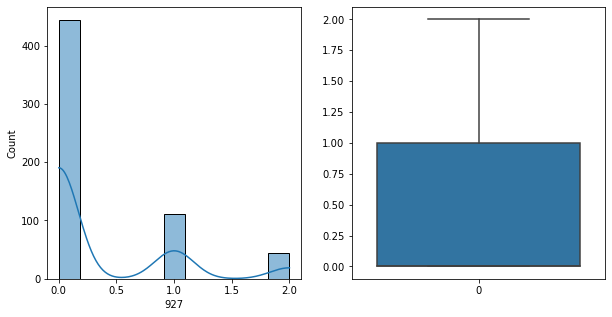

927   Unique :  [0 2 1]
--------------------------------------------------------------------
927   N unique :  3
--------------------------------------------------------------------
927   Value Counts :  0    444
1    112
2     44
Name: 927, dtype: int64
--------------------------------------------------------------------



[ 928 ]
show_df_info :  928


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


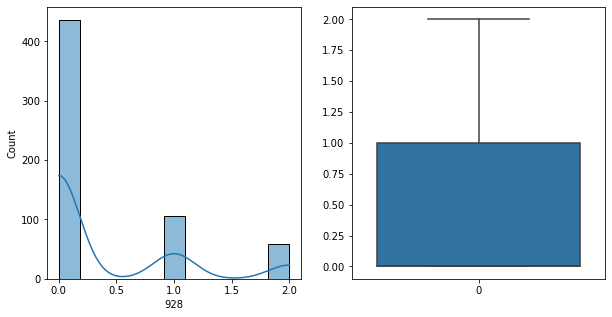

928   Unique :  [0 1 2]
--------------------------------------------------------------------
928   N unique :  3
--------------------------------------------------------------------
928   Value Counts :  0    436
1    106
2     58
Name: 928, dtype: int64
--------------------------------------------------------------------



[ 929 ]
show_df_info :  929


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


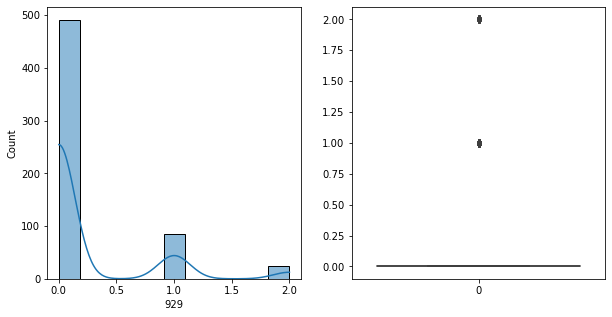

929   Unique :  [1 0 2]
--------------------------------------------------------------------
929   N unique :  3
--------------------------------------------------------------------
929   Value Counts :  0    491
1     85
2     24
Name: 929, dtype: int64
--------------------------------------------------------------------



[ 930 ]
show_df_info :  930


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


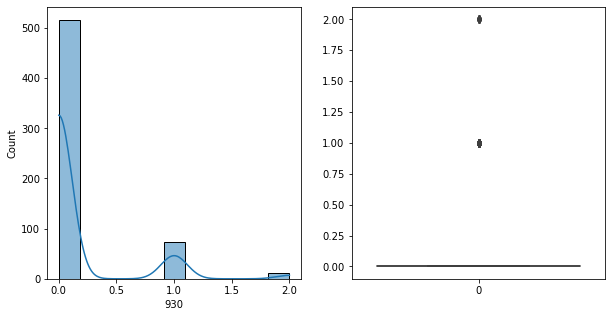

930   Unique :  [1 0 2]
--------------------------------------------------------------------
930   N unique :  3
--------------------------------------------------------------------
930   Value Counts :  0    516
1     73
2     11
Name: 930, dtype: int64
--------------------------------------------------------------------



[ 931 ]
show_df_info :  931


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


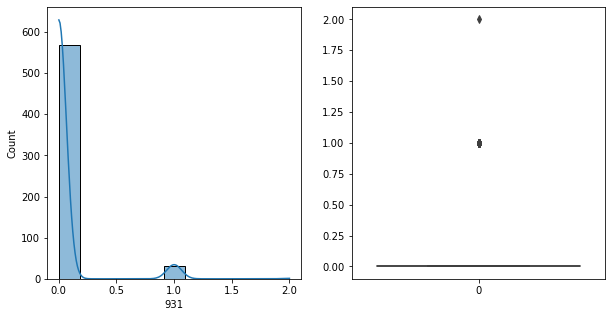

931   Unique :  [0 1 2]
--------------------------------------------------------------------
931   N unique :  3
--------------------------------------------------------------------
931   Value Counts :  0    568
1     31
2      1
Name: 931, dtype: int64
--------------------------------------------------------------------



[ 932 ]
show_df_info :  932


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


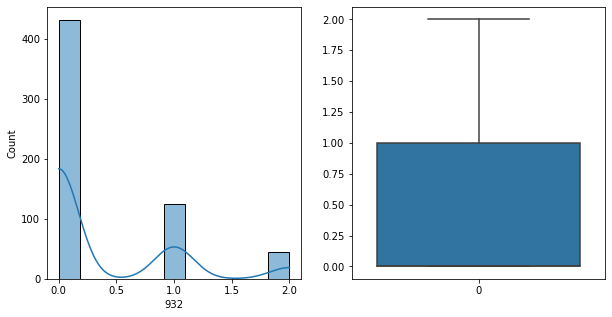

932   Unique :  [1 0 2]
--------------------------------------------------------------------
932   N unique :  3
--------------------------------------------------------------------
932   Value Counts :  0    431
1    125
2     44
Name: 932, dtype: int64
--------------------------------------------------------------------



[ 933 ]
show_df_info :  933


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


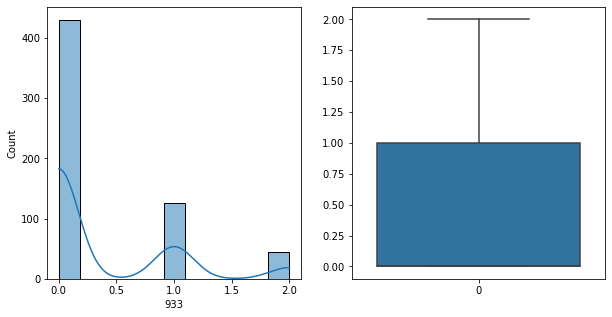

933   Unique :  [1 0 2]
--------------------------------------------------------------------
933   N unique :  3
--------------------------------------------------------------------
933   Value Counts :  0    430
1    126
2     44
Name: 933, dtype: int64
--------------------------------------------------------------------



[ 934 ]
show_df_info :  934


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


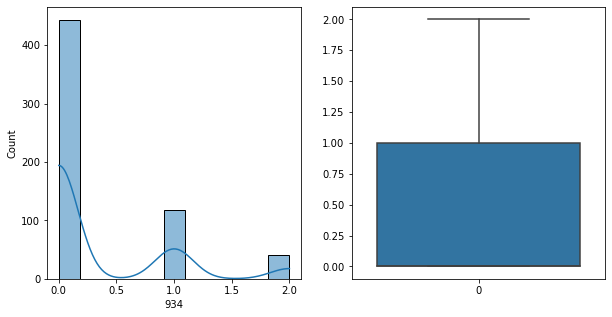

934   Unique :  [1 0 2]
--------------------------------------------------------------------
934   N unique :  3
--------------------------------------------------------------------
934   Value Counts :  0    443
1    117
2     40
Name: 934, dtype: int64
--------------------------------------------------------------------



[ 935 ]
show_df_info :  935


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


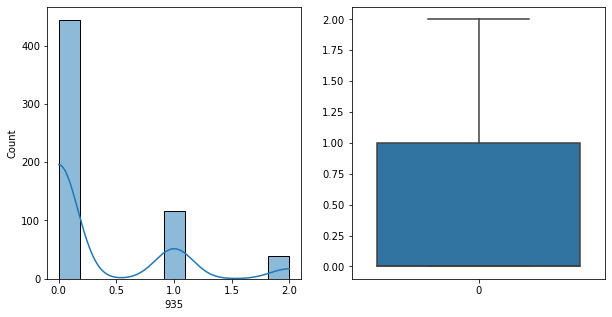

935   Unique :  [1 0 2]
--------------------------------------------------------------------
935   N unique :  3
--------------------------------------------------------------------
935   Value Counts :  0    444
1    117
2     39
Name: 935, dtype: int64
--------------------------------------------------------------------



[ 936 ]
show_df_info :  936


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


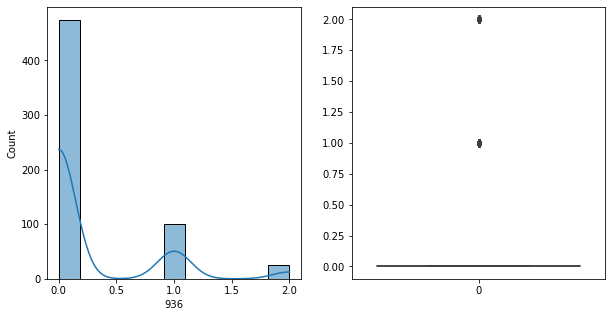

936   Unique :  [1 0 2]
--------------------------------------------------------------------
936   N unique :  3
--------------------------------------------------------------------
936   Value Counts :  0    474
1    101
2     25
Name: 936, dtype: int64
--------------------------------------------------------------------



[ 937 ]
show_df_info :  937


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


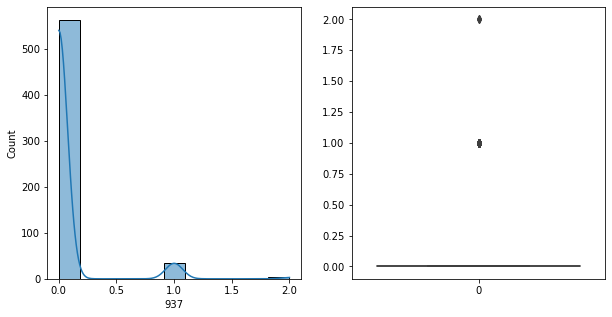

937   Unique :  [1 0 2]
--------------------------------------------------------------------
937   N unique :  3
--------------------------------------------------------------------
937   Value Counts :  0    562
1     35
2      3
Name: 937, dtype: int64
--------------------------------------------------------------------



[ 938 ]
show_df_info :  938


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


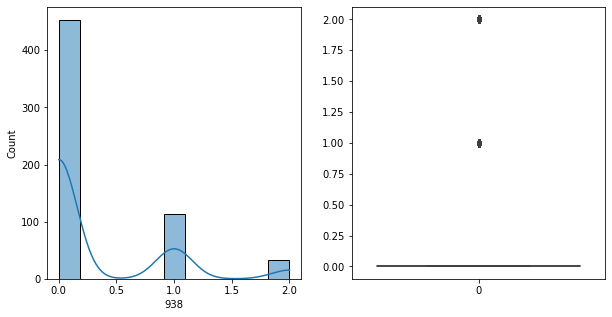

938   Unique :  [1 0 2]
--------------------------------------------------------------------
938   N unique :  3
--------------------------------------------------------------------
938   Value Counts :  0    453
1    114
2     33
Name: 938, dtype: int64
--------------------------------------------------------------------



[ 939 ]
show_df_info :  939


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


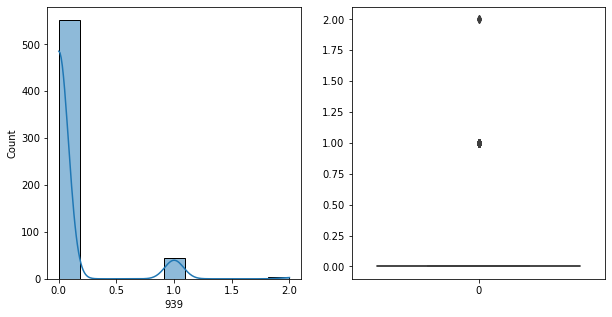

939   Unique :  [0 1 2]
--------------------------------------------------------------------
939   N unique :  3
--------------------------------------------------------------------
939   Value Counts :  0    552
1     45
2      3
Name: 939, dtype: int64
--------------------------------------------------------------------



[ 940 ]
show_df_info :  940


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


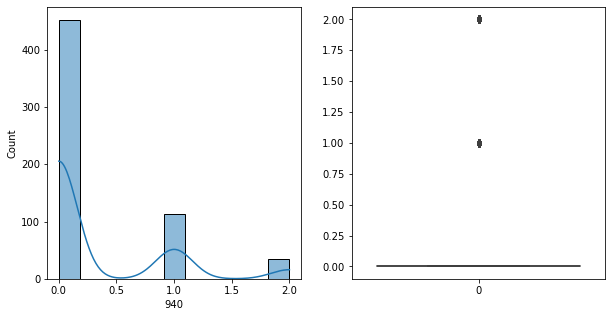

940   Unique :  [1 0 2]
--------------------------------------------------------------------
940   N unique :  3
--------------------------------------------------------------------
940   Value Counts :  0    452
1    113
2     35
Name: 940, dtype: int64
--------------------------------------------------------------------



[ 941 ]
show_df_info :  941


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


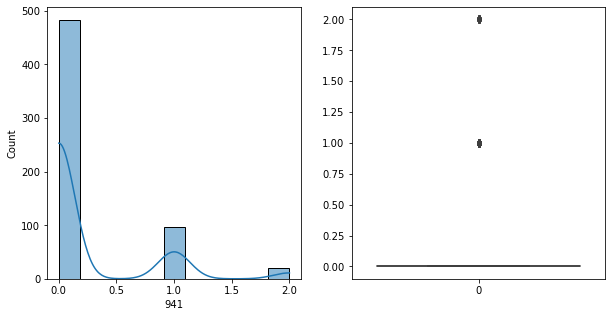

941   Unique :  [1 0 2]
--------------------------------------------------------------------
941   N unique :  3
--------------------------------------------------------------------
941   Value Counts :  0    483
1     96
2     21
Name: 941, dtype: int64
--------------------------------------------------------------------



[ 942 ]
show_df_info :  942


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


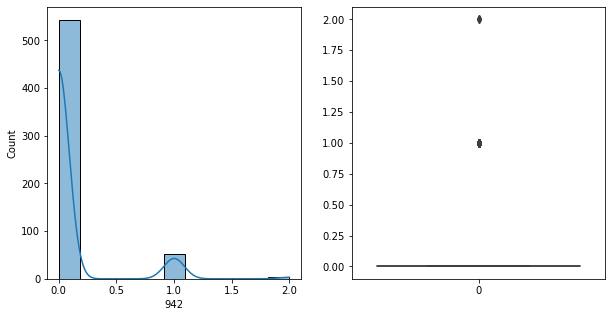

942   Unique :  [0 1 2]
--------------------------------------------------------------------
942   N unique :  3
--------------------------------------------------------------------
942   Value Counts :  0    543
1     53
2      4
Name: 942, dtype: int64
--------------------------------------------------------------------



[ 943 ]
show_df_info :  943


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


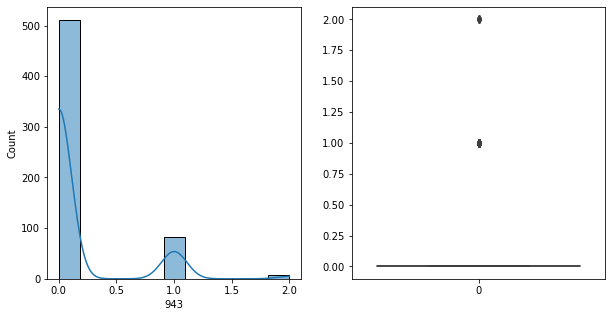

943   Unique :  [0 1 2]
--------------------------------------------------------------------
943   N unique :  3
--------------------------------------------------------------------
943   Value Counts :  0    511
1     82
2      7
Name: 943, dtype: int64
--------------------------------------------------------------------



[ 944 ]
show_df_info :  944


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


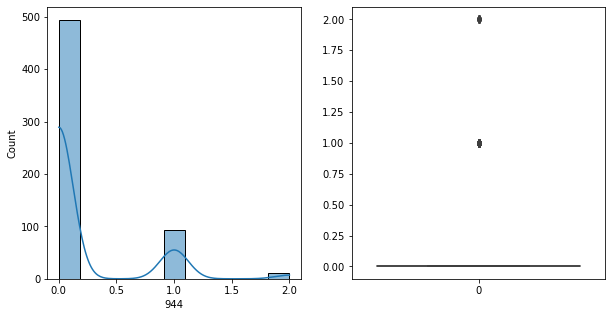

944   Unique :  [0 1 2]
--------------------------------------------------------------------
944   N unique :  3
--------------------------------------------------------------------
944   Value Counts :  0    494
1     94
2     12
Name: 944, dtype: int64
--------------------------------------------------------------------



[ 945 ]
show_df_info :  945


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


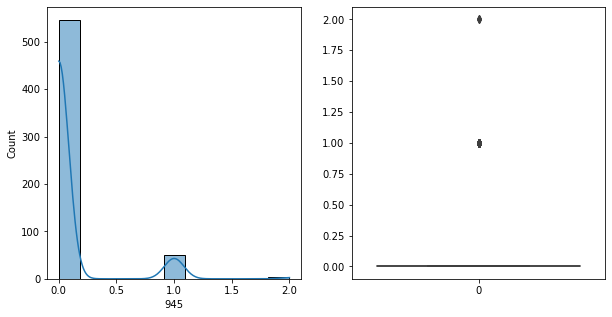

945   Unique :  [0 1 2]
--------------------------------------------------------------------
945   N unique :  3
--------------------------------------------------------------------
945   Value Counts :  0    546
1     51
2      3
Name: 945, dtype: int64
--------------------------------------------------------------------



[ 946 ]
show_df_info :  946


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


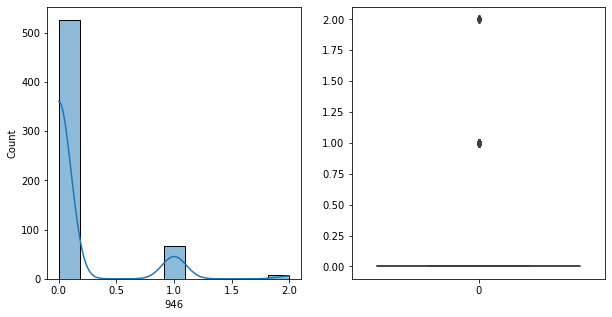

946   Unique :  [0 1 2]
--------------------------------------------------------------------
946   N unique :  3
--------------------------------------------------------------------
946   Value Counts :  0    526
1     66
2      8
Name: 946, dtype: int64
--------------------------------------------------------------------



[ 947 ]
show_df_info :  947


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


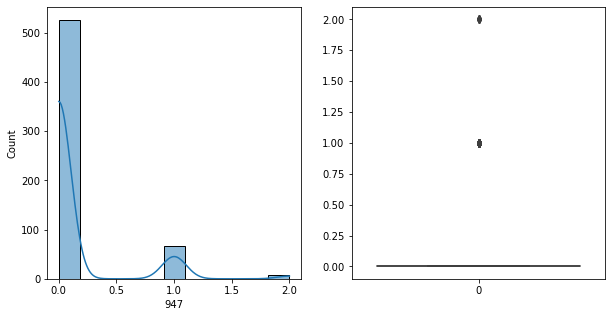

947   Unique :  [0 1 2]
--------------------------------------------------------------------
947   N unique :  3
--------------------------------------------------------------------
947   Value Counts :  0    526
1     66
2      8
Name: 947, dtype: int64
--------------------------------------------------------------------



[ 948 ]
show_df_info :  948


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


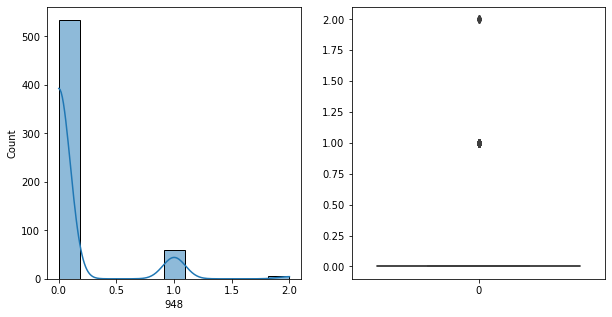

948   Unique :  [1 0 2]
--------------------------------------------------------------------
948   N unique :  3
--------------------------------------------------------------------
948   Value Counts :  0    534
1     60
2      6
Name: 948, dtype: int64
--------------------------------------------------------------------



[ 949 ]
show_df_info :  949


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


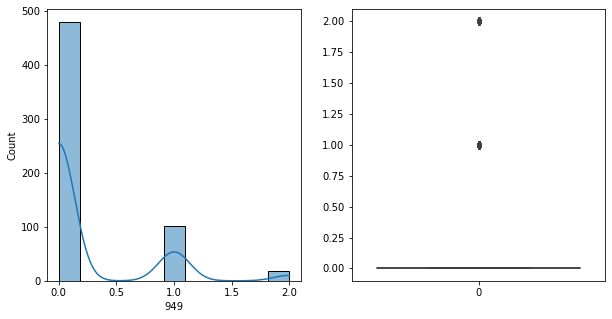

949   Unique :  [1 0 2]
--------------------------------------------------------------------
949   N unique :  3
--------------------------------------------------------------------
949   Value Counts :  0    480
1    101
2     19
Name: 949, dtype: int64
--------------------------------------------------------------------



[ 950 ]
show_df_info :  950


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


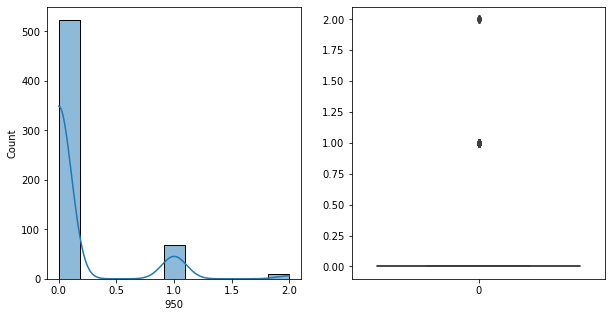

950   Unique :  [0 1 2]
--------------------------------------------------------------------
950   N unique :  3
--------------------------------------------------------------------
950   Value Counts :  0    523
1     68
2      9
Name: 950, dtype: int64
--------------------------------------------------------------------



[ 951 ]
show_df_info :  951


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


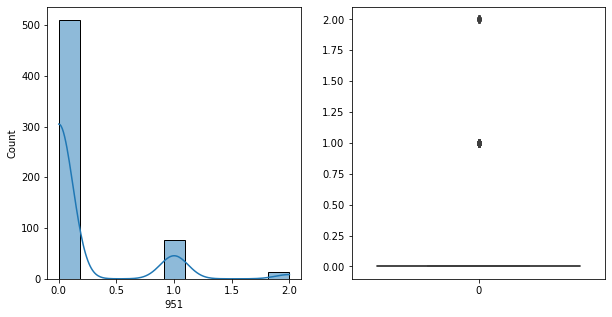

951   Unique :  [0 1 2]
--------------------------------------------------------------------
951   N unique :  3
--------------------------------------------------------------------
951   Value Counts :  0    510
1     76
2     14
Name: 951, dtype: int64
--------------------------------------------------------------------



[ 952 ]
show_df_info :  952


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


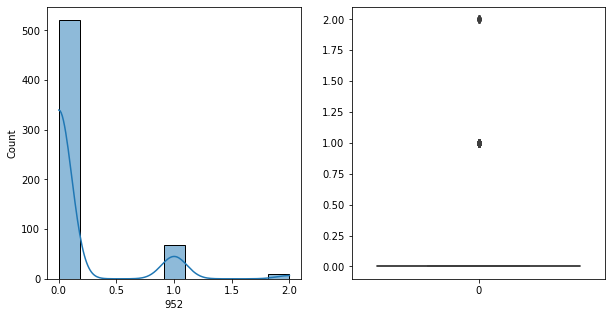

952   Unique :  [0 1 2]
--------------------------------------------------------------------
952   N unique :  3
--------------------------------------------------------------------
952   Value Counts :  0    521
1     69
2     10
Name: 952, dtype: int64
--------------------------------------------------------------------



[ 953 ]
show_df_info :  953


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


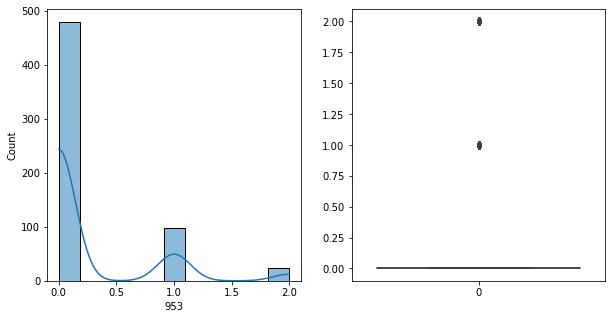

953   Unique :  [1 0 2]
--------------------------------------------------------------------
953   N unique :  3
--------------------------------------------------------------------
953   Value Counts :  0    479
1     97
2     24
Name: 953, dtype: int64
--------------------------------------------------------------------



[ 954 ]
show_df_info :  954


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


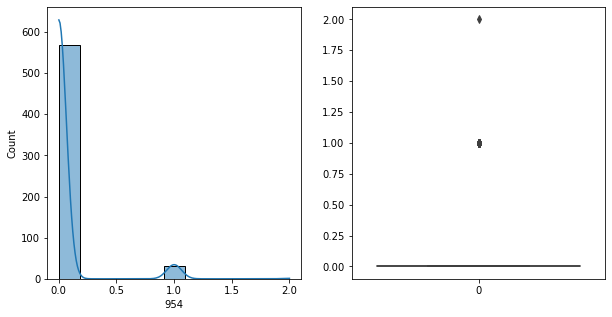

954   Unique :  [0 1 2]
--------------------------------------------------------------------
954   N unique :  3
--------------------------------------------------------------------
954   Value Counts :  0    568
1     31
2      1
Name: 954, dtype: int64
--------------------------------------------------------------------



[ 955 ]
show_df_info :  955


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


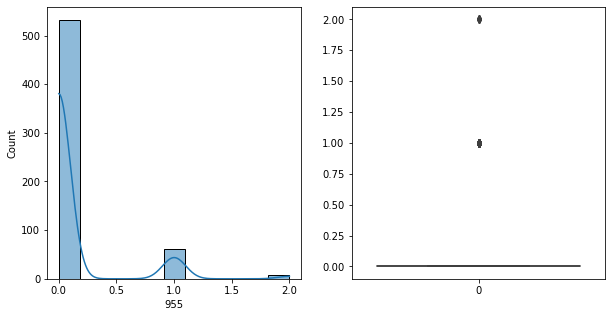

955   Unique :  [0 1 2]
--------------------------------------------------------------------
955   N unique :  3
--------------------------------------------------------------------
955   Value Counts :  0    532
1     61
2      7
Name: 955, dtype: int64
--------------------------------------------------------------------



[ 956 ]
show_df_info :  956


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


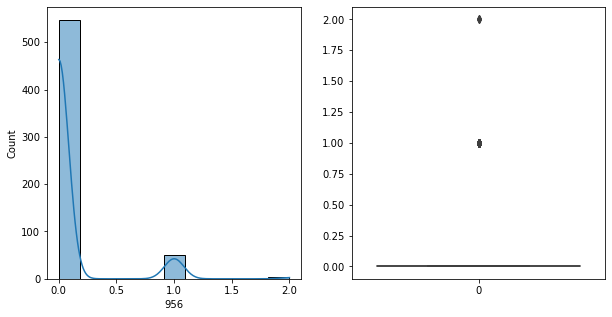

956   Unique :  [1 0 2]
--------------------------------------------------------------------
956   N unique :  3
--------------------------------------------------------------------
956   Value Counts :  0    547
1     50
2      3
Name: 956, dtype: int64
--------------------------------------------------------------------



[ 957 ]
show_df_info :  957


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


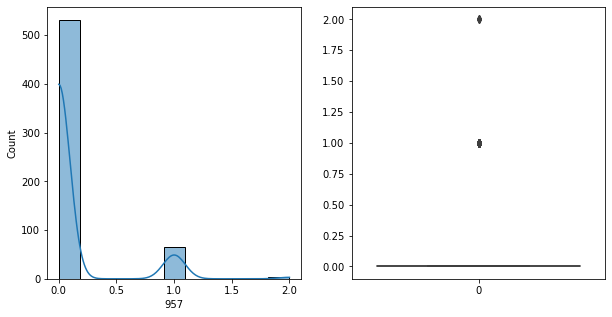

957   Unique :  [1 0 2]
--------------------------------------------------------------------
957   N unique :  3
--------------------------------------------------------------------
957   Value Counts :  0    531
1     65
2      4
Name: 957, dtype: int64
--------------------------------------------------------------------



[ 958 ]
show_df_info :  958


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


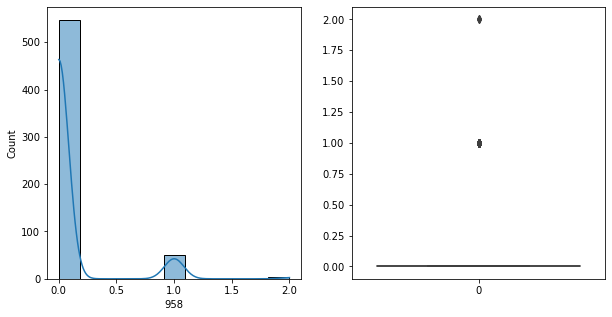

958   Unique :  [1 0 2]
--------------------------------------------------------------------
958   N unique :  3
--------------------------------------------------------------------
958   Value Counts :  0    547
1     50
2      3
Name: 958, dtype: int64
--------------------------------------------------------------------



[ 959 ]
show_df_info :  959


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


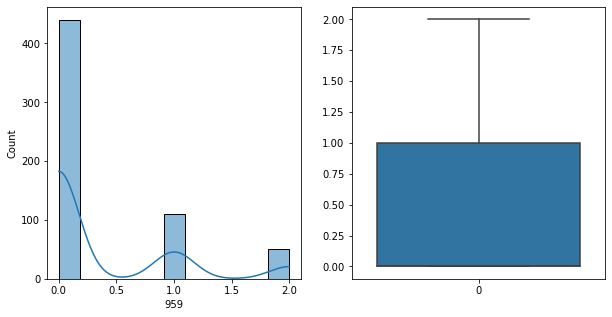

959   Unique :  [1 0 2]
--------------------------------------------------------------------
959   N unique :  3
--------------------------------------------------------------------
959   Value Counts :  0    440
1    110
2     50
Name: 959, dtype: int64
--------------------------------------------------------------------



[ 960 ]
show_df_info :  960


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


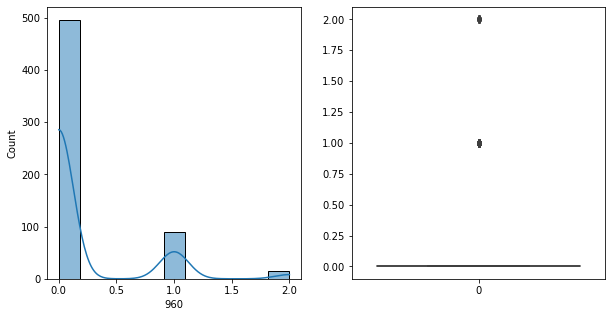

960   Unique :  [0 1 2]
--------------------------------------------------------------------
960   N unique :  3
--------------------------------------------------------------------
960   Value Counts :  0    496
1     90
2     14
Name: 960, dtype: int64
--------------------------------------------------------------------



[ 961 ]
show_df_info :  961


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


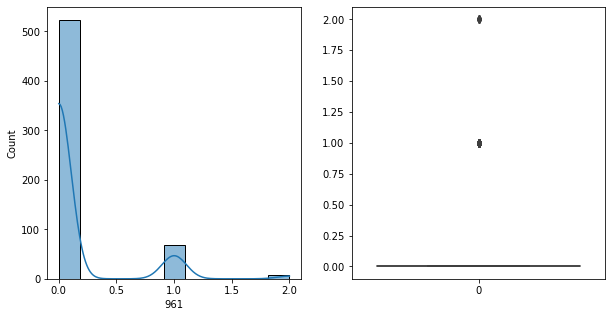

961   Unique :  [0 1 2]
--------------------------------------------------------------------
961   N unique :  3
--------------------------------------------------------------------
961   Value Counts :  0    523
1     69
2      8
Name: 961, dtype: int64
--------------------------------------------------------------------



[ 962 ]
show_df_info :  962


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


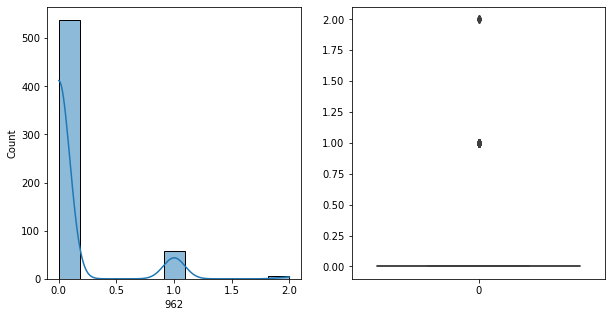

962   Unique :  [1 0 2]
--------------------------------------------------------------------
962   N unique :  3
--------------------------------------------------------------------
962   Value Counts :  0    538
1     57
2      5
Name: 962, dtype: int64
--------------------------------------------------------------------



[ 963 ]
show_df_info :  963


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


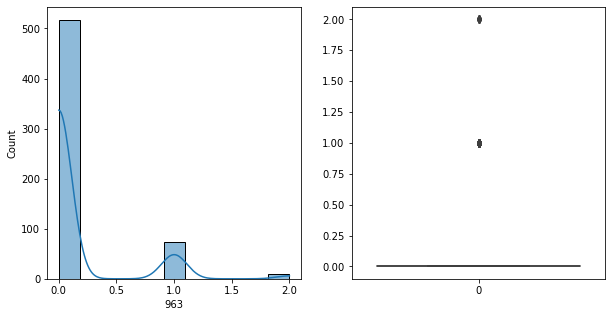

963   Unique :  [0 1 2]
--------------------------------------------------------------------
963   N unique :  3
--------------------------------------------------------------------
963   Value Counts :  0    517
1     74
2      9
Name: 963, dtype: int64
--------------------------------------------------------------------



[ 964 ]
show_df_info :  964


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


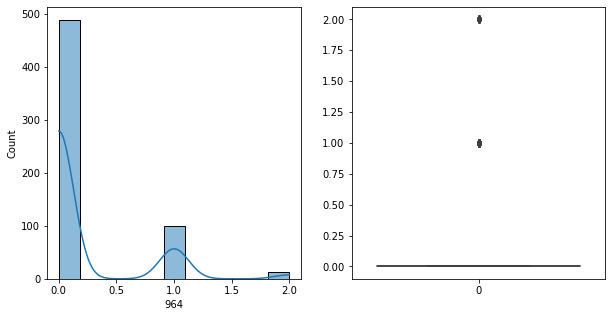

964   Unique :  [1 0 2]
--------------------------------------------------------------------
964   N unique :  3
--------------------------------------------------------------------
964   Value Counts :  0    488
1     99
2     13
Name: 964, dtype: int64
--------------------------------------------------------------------



[ 965 ]
show_df_info :  965


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


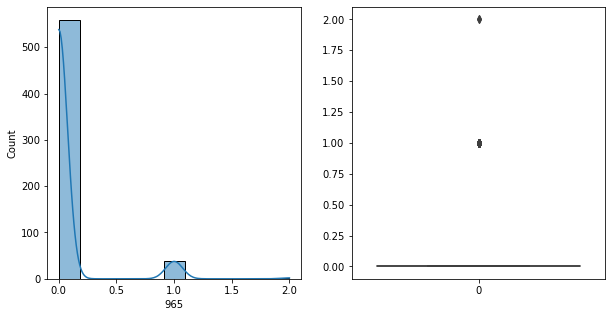

965   Unique :  [1 0 2]
--------------------------------------------------------------------
965   N unique :  3
--------------------------------------------------------------------
965   Value Counts :  0    559
1     39
2      2
Name: 965, dtype: int64
--------------------------------------------------------------------



[ 966 ]
show_df_info :  966


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


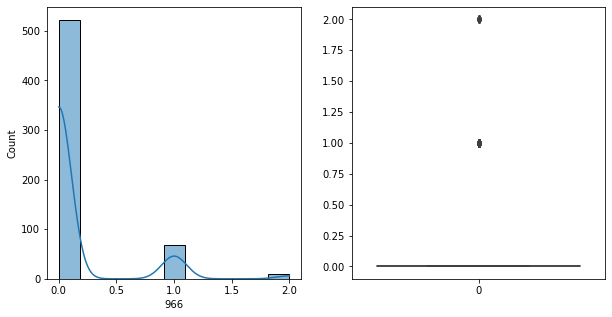

966   Unique :  [0 1 2]
--------------------------------------------------------------------
966   N unique :  3
--------------------------------------------------------------------
966   Value Counts :  0    522
1     69
2      9
Name: 966, dtype: int64
--------------------------------------------------------------------



[ 967 ]
show_df_info :  967


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


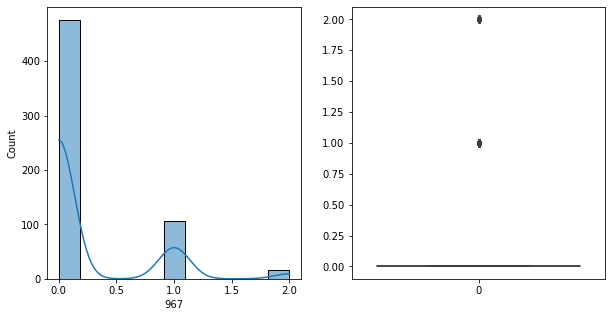

967   Unique :  [1 0 2]
--------------------------------------------------------------------
967   N unique :  3
--------------------------------------------------------------------
967   Value Counts :  0    476
1    107
2     17
Name: 967, dtype: int64
--------------------------------------------------------------------



[ 968 ]
show_df_info :  968


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


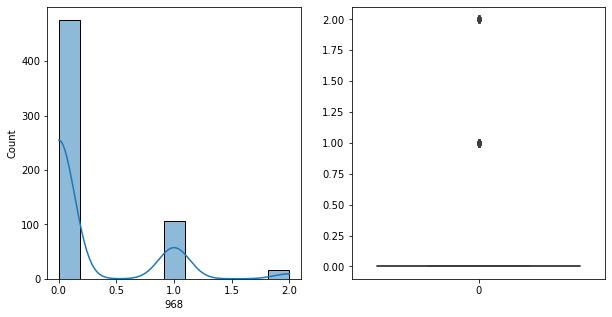

968   Unique :  [1 0 2]
--------------------------------------------------------------------
968   N unique :  3
--------------------------------------------------------------------
968   Value Counts :  0    476
1    107
2     17
Name: 968, dtype: int64
--------------------------------------------------------------------



[ 969 ]
show_df_info :  969


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


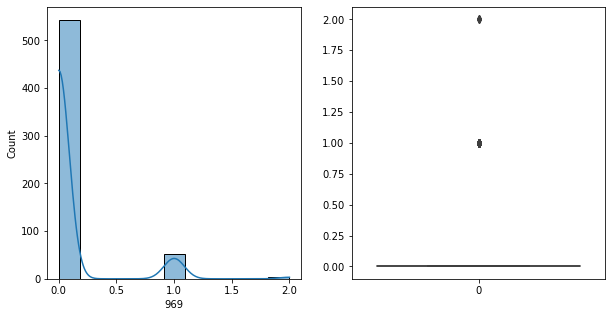

969   Unique :  [0 1 2]
--------------------------------------------------------------------
969   N unique :  3
--------------------------------------------------------------------
969   Value Counts :  0    543
1     53
2      4
Name: 969, dtype: int64
--------------------------------------------------------------------



[ 970 ]
show_df_info :  970


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


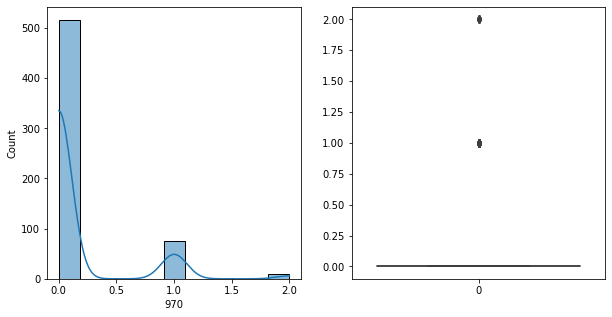

970   Unique :  [0 1 2]
--------------------------------------------------------------------
970   N unique :  3
--------------------------------------------------------------------
970   Value Counts :  0    516
1     75
2      9
Name: 970, dtype: int64
--------------------------------------------------------------------



[ 971 ]
show_df_info :  971


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


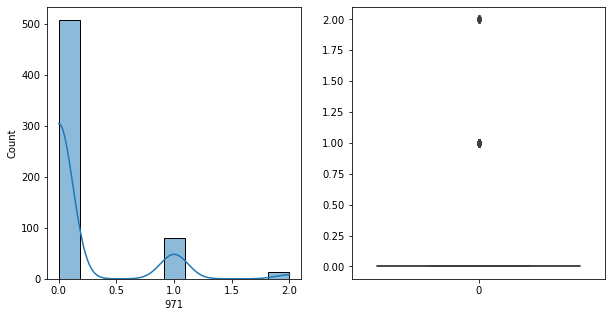

971   Unique :  [0 2 1]
--------------------------------------------------------------------
971   N unique :  3
--------------------------------------------------------------------
971   Value Counts :  0    507
1     80
2     13
Name: 971, dtype: int64
--------------------------------------------------------------------



[ 972 ]
show_df_info :  972


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


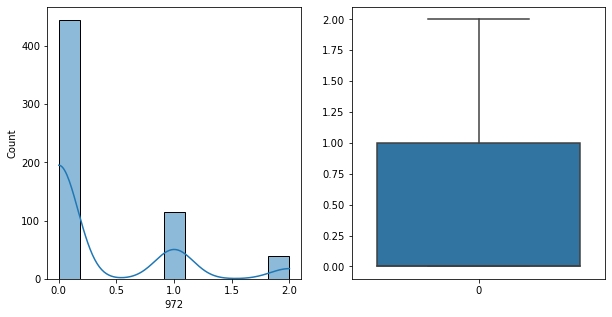

972   Unique :  [2 0 1]
--------------------------------------------------------------------
972   N unique :  3
--------------------------------------------------------------------
972   Value Counts :  0    445
1    115
2     40
Name: 972, dtype: int64
--------------------------------------------------------------------



[ 973 ]
show_df_info :  973


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


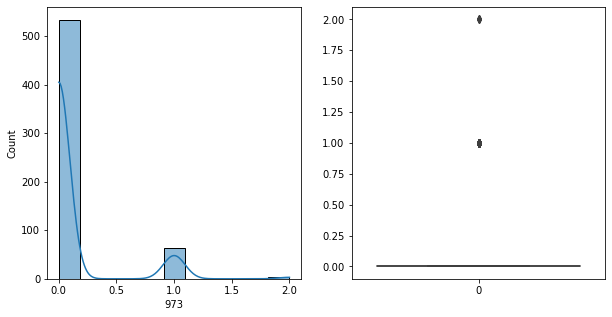

973   Unique :  [1 0 2]
--------------------------------------------------------------------
973   N unique :  3
--------------------------------------------------------------------
973   Value Counts :  0    533
1     63
2      4
Name: 973, dtype: int64
--------------------------------------------------------------------



[ 974 ]
show_df_info :  974


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


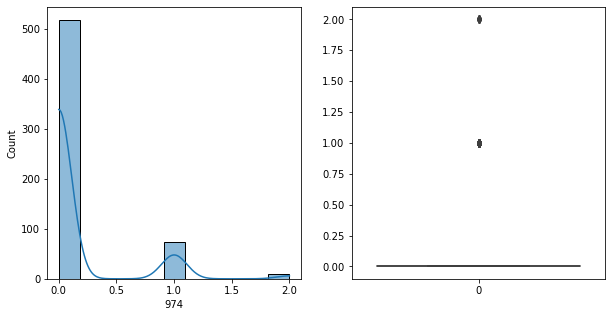

974   Unique :  [1 0 2]
--------------------------------------------------------------------
974   N unique :  3
--------------------------------------------------------------------
974   Value Counts :  0    518
1     73
2      9
Name: 974, dtype: int64
--------------------------------------------------------------------



[ 975 ]
show_df_info :  975


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


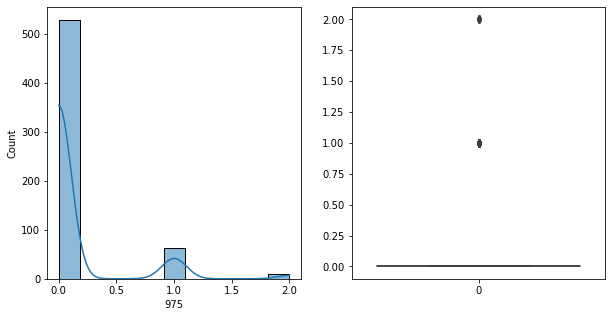

975   Unique :  [1 0 2]
--------------------------------------------------------------------
975   N unique :  3
--------------------------------------------------------------------
975   Value Counts :  0    528
1     62
2     10
Name: 975, dtype: int64
--------------------------------------------------------------------



[ 976 ]
show_df_info :  976


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


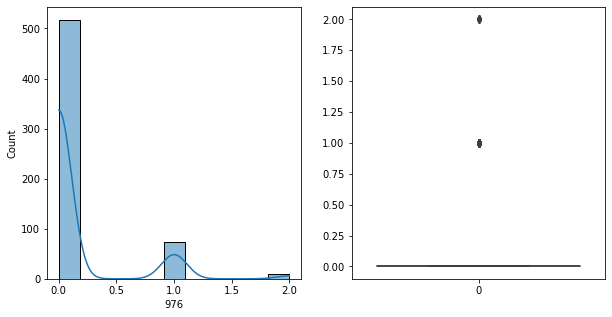

976   Unique :  [0 1 2]
--------------------------------------------------------------------
976   N unique :  3
--------------------------------------------------------------------
976   Value Counts :  0    517
1     74
2      9
Name: 976, dtype: int64
--------------------------------------------------------------------



[ 977 ]
show_df_info :  977


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


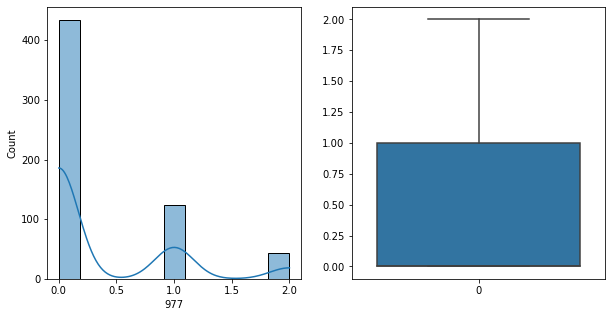

977   Unique :  [1 0 2]
--------------------------------------------------------------------
977   N unique :  3
--------------------------------------------------------------------
977   Value Counts :  0    434
1    123
2     43
Name: 977, dtype: int64
--------------------------------------------------------------------



[ 978 ]
show_df_info :  978


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


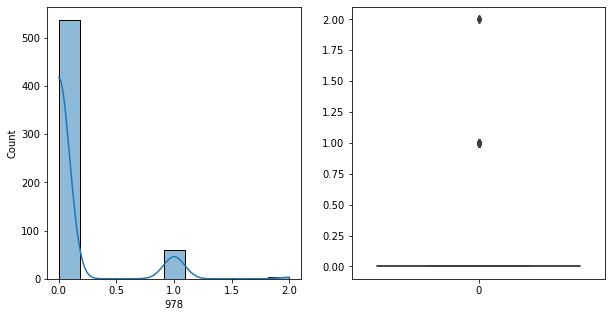

978   Unique :  [0 1 2]
--------------------------------------------------------------------
978   N unique :  3
--------------------------------------------------------------------
978   Value Counts :  0    537
1     59
2      4
Name: 978, dtype: int64
--------------------------------------------------------------------



[ 979 ]
show_df_info :  979


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


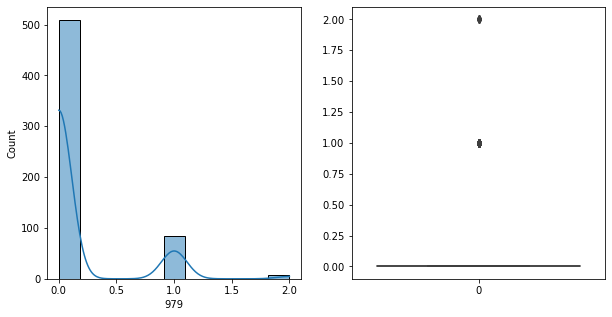

979   Unique :  [1 0 2]
--------------------------------------------------------------------
979   N unique :  3
--------------------------------------------------------------------
979   Value Counts :  0    509
1     84
2      7
Name: 979, dtype: int64
--------------------------------------------------------------------



[ 980 ]
show_df_info :  980


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


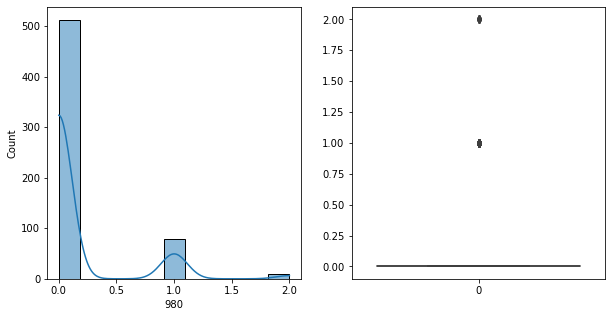

980   Unique :  [0 1 2]
--------------------------------------------------------------------
980   N unique :  3
--------------------------------------------------------------------
980   Value Counts :  0    512
1     78
2     10
Name: 980, dtype: int64
--------------------------------------------------------------------



[ 981 ]
show_df_info :  981


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


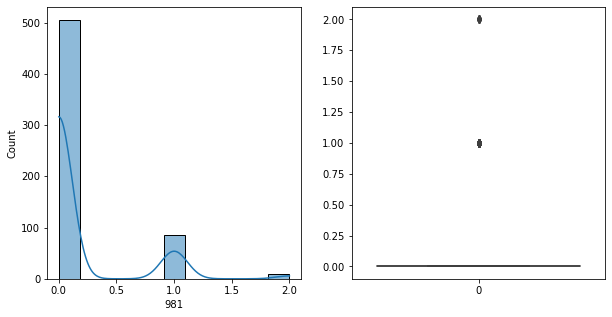

981   Unique :  [1 0 2]
--------------------------------------------------------------------
981   N unique :  3
--------------------------------------------------------------------
981   Value Counts :  0    505
1     86
2      9
Name: 981, dtype: int64
--------------------------------------------------------------------



[ 982 ]
show_df_info :  982


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


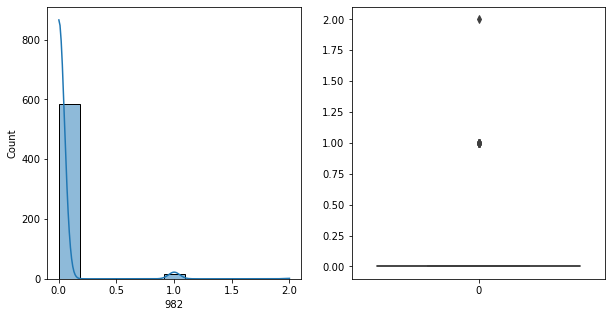

982   Unique :  [0 1 2]
--------------------------------------------------------------------
982   N unique :  3
--------------------------------------------------------------------
982   Value Counts :  0    584
1     15
2      1
Name: 982, dtype: int64
--------------------------------------------------------------------



[ 983 ]
show_df_info :  983


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


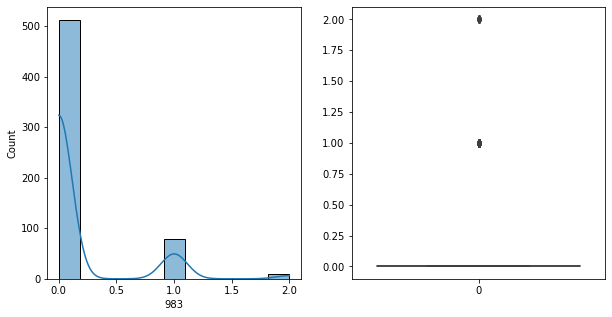

983   Unique :  [0 1 2]
--------------------------------------------------------------------
983   N unique :  3
--------------------------------------------------------------------
983   Value Counts :  0    512
1     78
2     10
Name: 983, dtype: int64
--------------------------------------------------------------------



[ 984 ]
show_df_info :  984


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


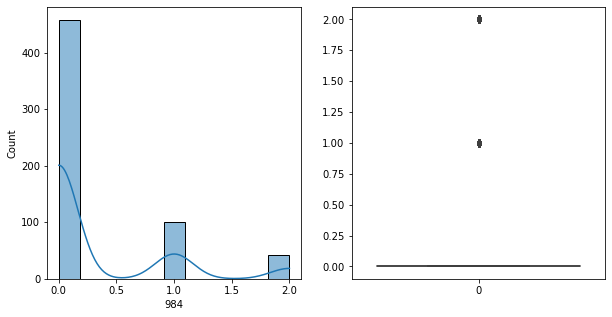

984   Unique :  [1 0 2]
--------------------------------------------------------------------
984   N unique :  3
--------------------------------------------------------------------
984   Value Counts :  0    458
1    100
2     42
Name: 984, dtype: int64
--------------------------------------------------------------------



[ 985 ]
show_df_info :  985


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


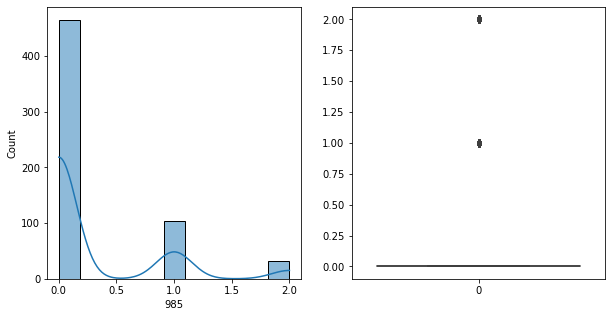

985   Unique :  [1 0 2]
--------------------------------------------------------------------
985   N unique :  3
--------------------------------------------------------------------
985   Value Counts :  0    465
1    103
2     32
Name: 985, dtype: int64
--------------------------------------------------------------------



[ 986 ]
show_df_info :  986


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


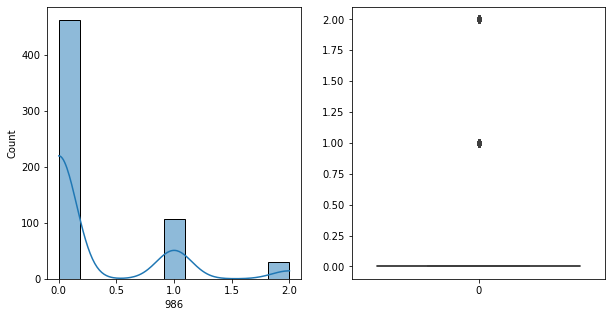

986   Unique :  [0 1 2]
--------------------------------------------------------------------
986   N unique :  3
--------------------------------------------------------------------
986   Value Counts :  0    463
1    107
2     30
Name: 986, dtype: int64
--------------------------------------------------------------------



[ 987 ]
show_df_info :  987


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


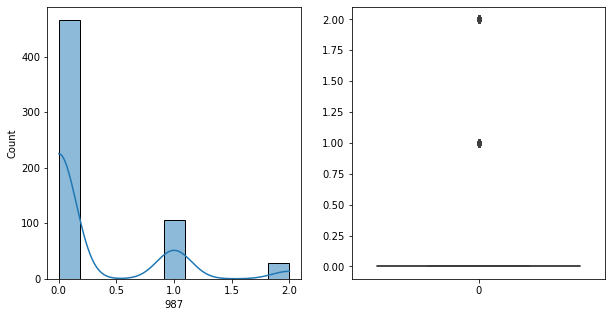

987   Unique :  [0 1 2]
--------------------------------------------------------------------
987   N unique :  3
--------------------------------------------------------------------
987   Value Counts :  0    466
1    106
2     28
Name: 987, dtype: int64
--------------------------------------------------------------------



[ 988 ]
show_df_info :  988


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


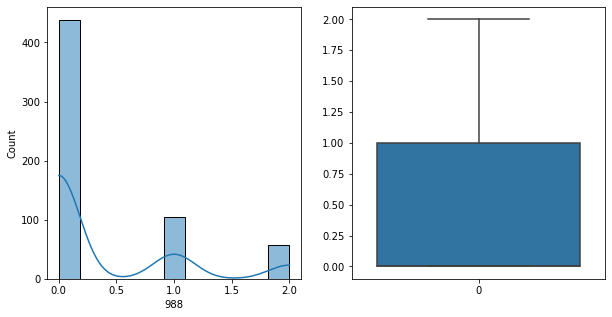

988   Unique :  [1 0 2]
--------------------------------------------------------------------
988   N unique :  3
--------------------------------------------------------------------
988   Value Counts :  0    438
1    104
2     58
Name: 988, dtype: int64
--------------------------------------------------------------------



[ 989 ]
show_df_info :  989


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


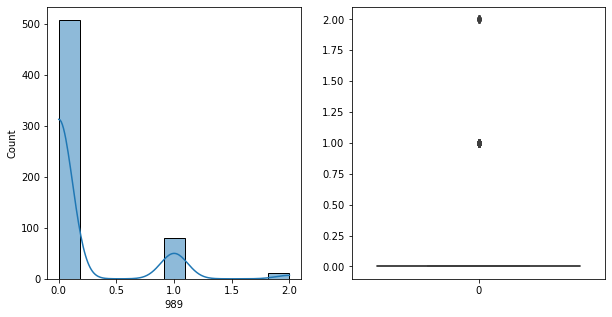

989   Unique :  [0 1 2]
--------------------------------------------------------------------
989   N unique :  3
--------------------------------------------------------------------
989   Value Counts :  0    508
1     81
2     11
Name: 989, dtype: int64
--------------------------------------------------------------------



[ 990 ]
show_df_info :  990


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


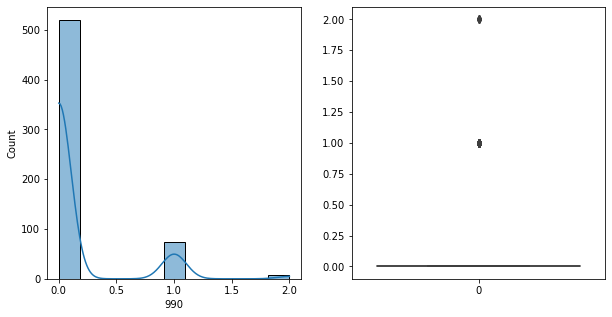

990   Unique :  [0 1 2]
--------------------------------------------------------------------
990   N unique :  3
--------------------------------------------------------------------
990   Value Counts :  0    520
1     73
2      7
Name: 990, dtype: int64
--------------------------------------------------------------------



[ 991 ]
show_df_info :  991


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


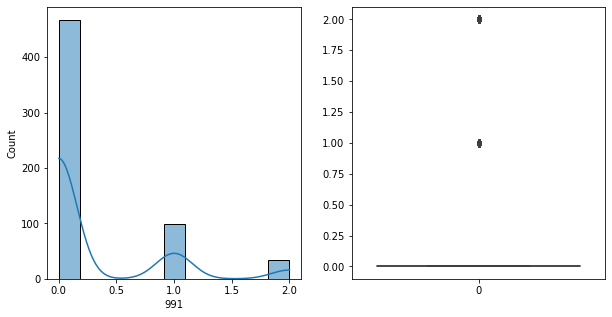

991   Unique :  [0 2 1]
--------------------------------------------------------------------
991   N unique :  3
--------------------------------------------------------------------
991   Value Counts :  0    467
1     99
2     34
Name: 991, dtype: int64
--------------------------------------------------------------------



[ 992 ]
show_df_info :  992


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


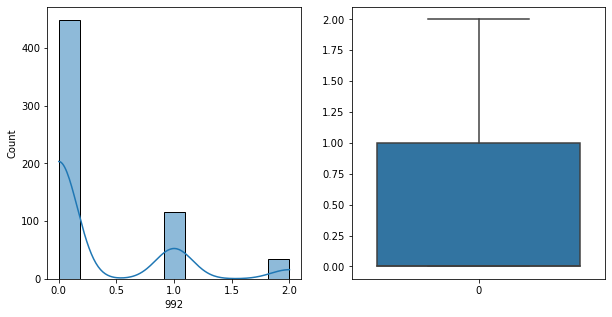

992   Unique :  [2 0 1]
--------------------------------------------------------------------
992   N unique :  3
--------------------------------------------------------------------
992   Value Counts :  0    449
1    116
2     35
Name: 992, dtype: int64
--------------------------------------------------------------------



[ 993 ]
show_df_info :  993


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


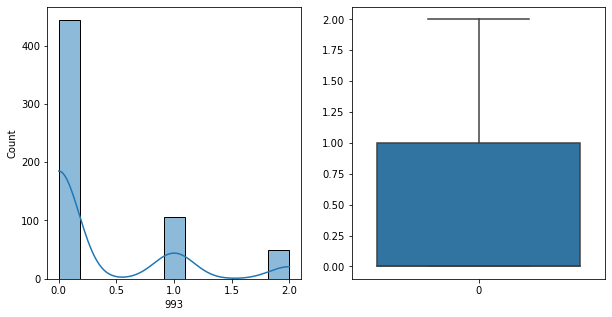

993   Unique :  [2 0 1]
--------------------------------------------------------------------
993   N unique :  3
--------------------------------------------------------------------
993   Value Counts :  0    444
1    106
2     50
Name: 993, dtype: int64
--------------------------------------------------------------------



[ 994 ]
show_df_info :  994


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


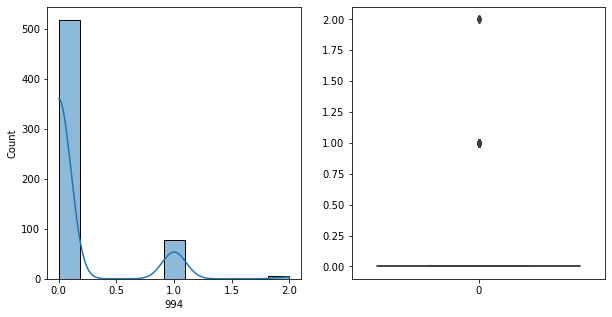

994   Unique :  [2 0 1]
--------------------------------------------------------------------
994   N unique :  3
--------------------------------------------------------------------
994   Value Counts :  0    518
1     77
2      5
Name: 994, dtype: int64
--------------------------------------------------------------------



[ 995 ]
show_df_info :  995


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


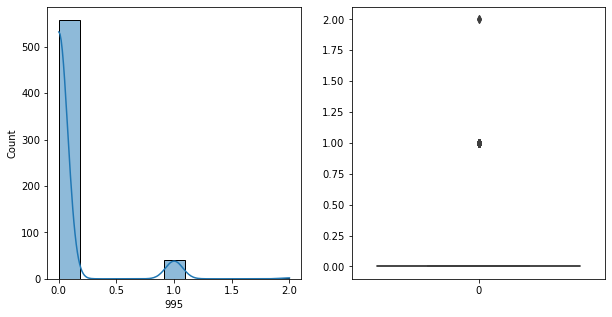

995   Unique :  [0 1 2]
--------------------------------------------------------------------
995   N unique :  3
--------------------------------------------------------------------
995   Value Counts :  0    558
1     40
2      2
Name: 995, dtype: int64
--------------------------------------------------------------------



[ 996 ]
show_df_info :  996


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


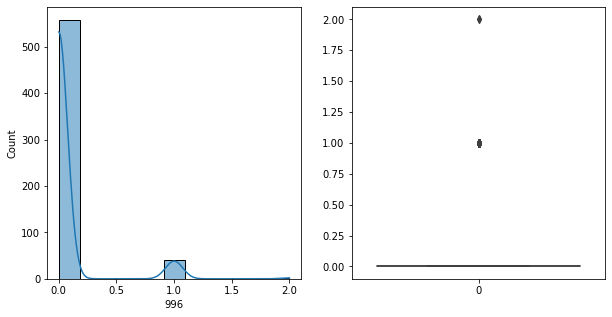

996   Unique :  [0 1 2]
--------------------------------------------------------------------
996   N unique :  3
--------------------------------------------------------------------
996   Value Counts :  0    558
1     40
2      2
Name: 996, dtype: int64
--------------------------------------------------------------------



[ 997 ]
show_df_info :  997


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


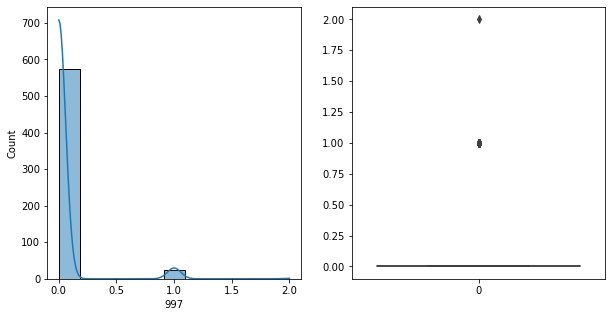

997   Unique :  [0 1 2]
--------------------------------------------------------------------
997   N unique :  3
--------------------------------------------------------------------
997   Value Counts :  0    575
1     24
2      1
Name: 997, dtype: int64
--------------------------------------------------------------------



[ 998 ]
show_df_info :  998


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


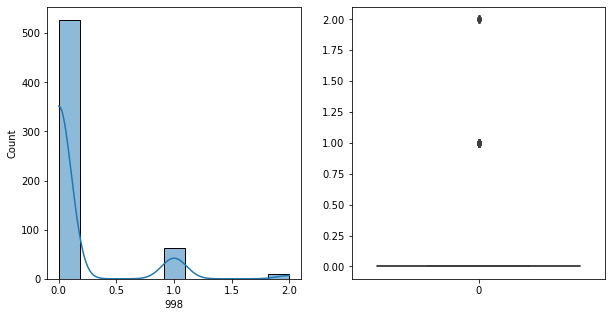

998   Unique :  [0 1 2]
--------------------------------------------------------------------
998   N unique :  3
--------------------------------------------------------------------
998   Value Counts :  0    527
1     63
2     10
Name: 998, dtype: int64
--------------------------------------------------------------------



[ 999 ]
show_df_info :  999


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


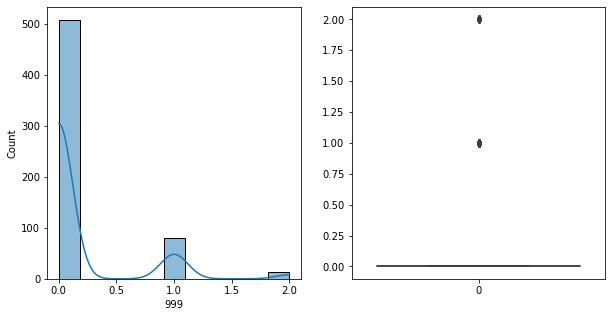

999   Unique :  [0 1 2]
--------------------------------------------------------------------
999   N unique :  3
--------------------------------------------------------------------
999   Value Counts :  0    507
1     80
2     13
Name: 999, dtype: int64
--------------------------------------------------------------------



[ 1000 ]
show_df_info :  1000


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


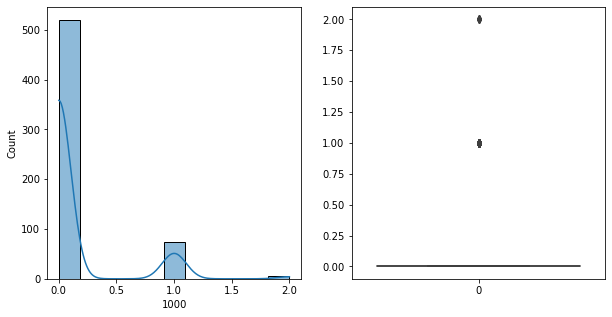

1000   Unique :  [0 1 2]
--------------------------------------------------------------------
1000   N unique :  3
--------------------------------------------------------------------
1000   Value Counts :  0    520
1     74
2      6
Name: 1000, dtype: int64
--------------------------------------------------------------------



[ 1001 ]
show_df_info :  1001


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


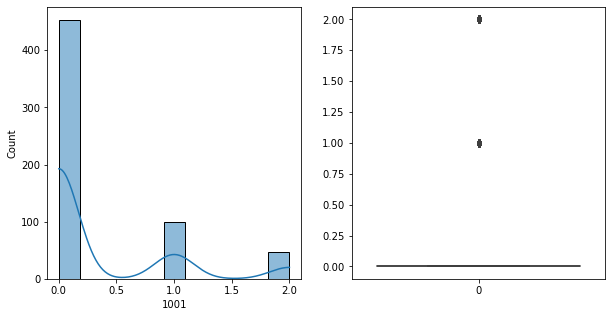

1001   Unique :  [2 0 1]
--------------------------------------------------------------------
1001   N unique :  3
--------------------------------------------------------------------
1001   Value Counts :  0    453
1    100
2     47
Name: 1001, dtype: int64
--------------------------------------------------------------------



[ 1002 ]
show_df_info :  1002


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


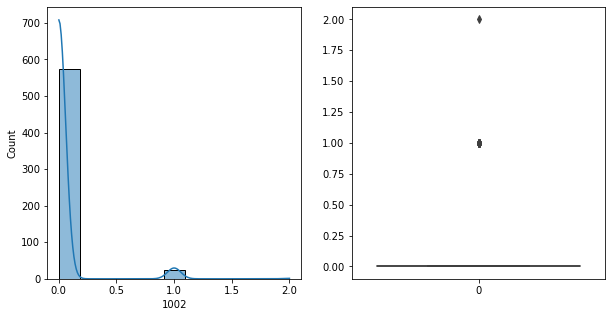

1002   Unique :  [0 1 2]
--------------------------------------------------------------------
1002   N unique :  3
--------------------------------------------------------------------
1002   Value Counts :  0    575
1     24
2      1
Name: 1002, dtype: int64
--------------------------------------------------------------------



[ 1003 ]
show_df_info :  1003


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


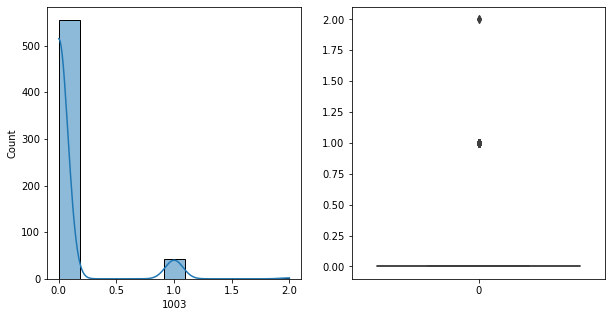

1003   Unique :  [0 1 2]
--------------------------------------------------------------------
1003   N unique :  3
--------------------------------------------------------------------
1003   Value Counts :  0    555
1     43
2      2
Name: 1003, dtype: int64
--------------------------------------------------------------------



[ 1004 ]
show_df_info :  1004


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


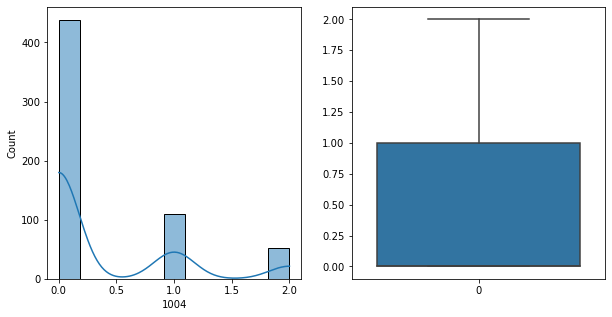

1004   Unique :  [0 1 2]
--------------------------------------------------------------------
1004   N unique :  3
--------------------------------------------------------------------
1004   Value Counts :  0    438
1    110
2     52
Name: 1004, dtype: int64
--------------------------------------------------------------------



[ 1005 ]
show_df_info :  1005


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


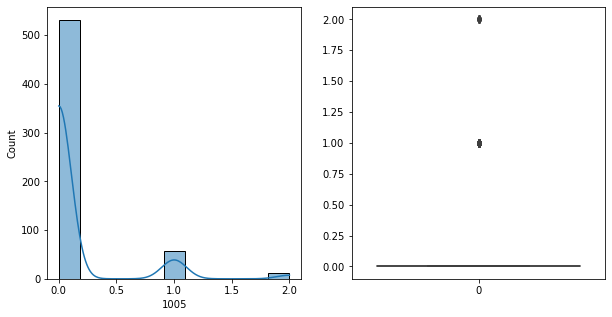

1005   Unique :  [0 1 2]
--------------------------------------------------------------------
1005   N unique :  3
--------------------------------------------------------------------
1005   Value Counts :  0    531
1     58
2     11
Name: 1005, dtype: int64
--------------------------------------------------------------------



[ 1006 ]
show_df_info :  1006


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


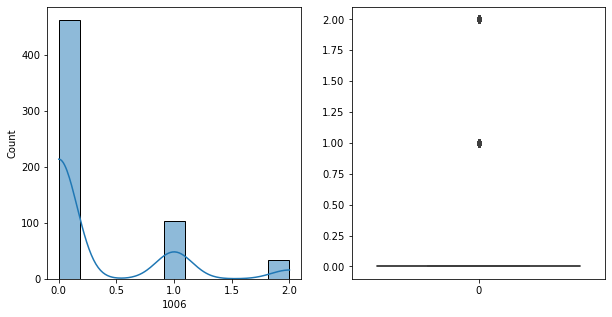

1006   Unique :  [2 0 1]
--------------------------------------------------------------------
1006   N unique :  3
--------------------------------------------------------------------
1006   Value Counts :  0    462
1    104
2     34
Name: 1006, dtype: int64
--------------------------------------------------------------------



[ 1007 ]
show_df_info :  1007


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


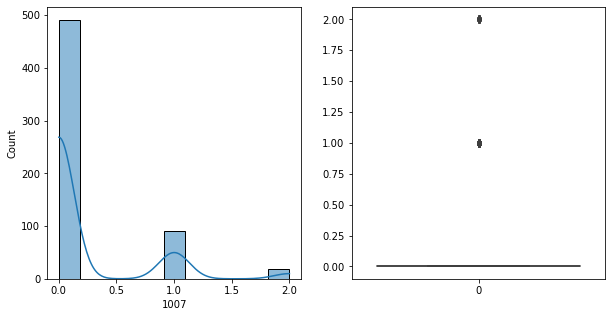

1007   Unique :  [2 0 1]
--------------------------------------------------------------------
1007   N unique :  3
--------------------------------------------------------------------
1007   Value Counts :  0    491
1     91
2     18
Name: 1007, dtype: int64
--------------------------------------------------------------------



[ 1008 ]
show_df_info :  1008


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


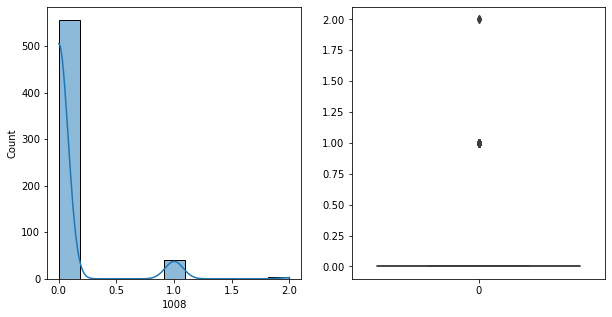

1008   Unique :  [0 1 2]
--------------------------------------------------------------------
1008   N unique :  3
--------------------------------------------------------------------
1008   Value Counts :  0    556
1     41
2      3
Name: 1008, dtype: int64
--------------------------------------------------------------------



[ 1009 ]
show_df_info :  1009


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


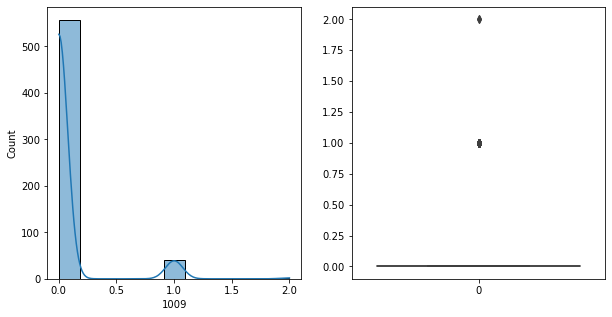

1009   Unique :  [0 1 2]
--------------------------------------------------------------------
1009   N unique :  3
--------------------------------------------------------------------
1009   Value Counts :  0    557
1     41
2      2
Name: 1009, dtype: int64
--------------------------------------------------------------------



[ 1010 ]
show_df_info :  1010


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


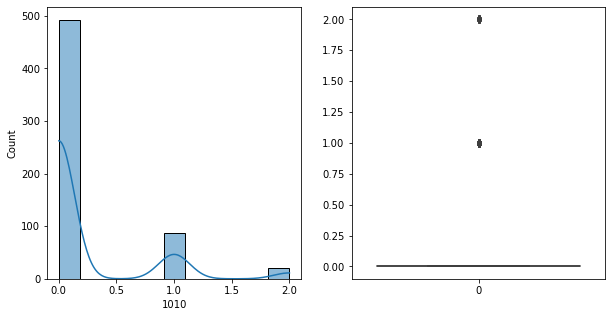

1010   Unique :  [0 1 2]
--------------------------------------------------------------------
1010   N unique :  3
--------------------------------------------------------------------
1010   Value Counts :  0    492
1     87
2     21
Name: 1010, dtype: int64
--------------------------------------------------------------------



[ 1011 ]
show_df_info :  1011


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


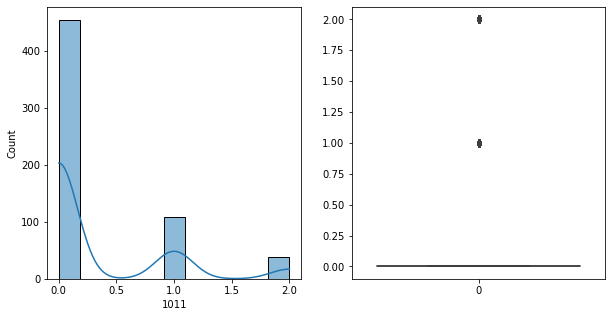

1011   Unique :  [2 0 1]
--------------------------------------------------------------------
1011   N unique :  3
--------------------------------------------------------------------
1011   Value Counts :  0    454
1    108
2     38
Name: 1011, dtype: int64
--------------------------------------------------------------------



[ 1012 ]
show_df_info :  1012


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


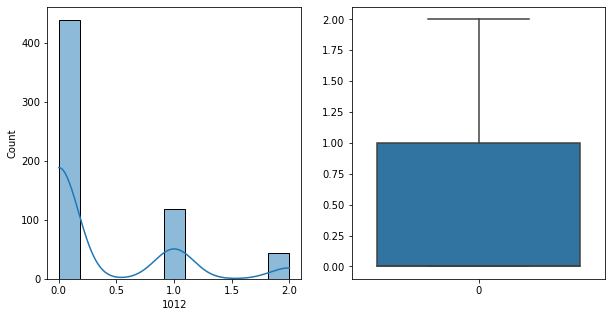

1012   Unique :  [0 1 2]
--------------------------------------------------------------------
1012   N unique :  3
--------------------------------------------------------------------
1012   Value Counts :  0    439
1    118
2     43
Name: 1012, dtype: int64
--------------------------------------------------------------------



[ 1013 ]
show_df_info :  1013


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


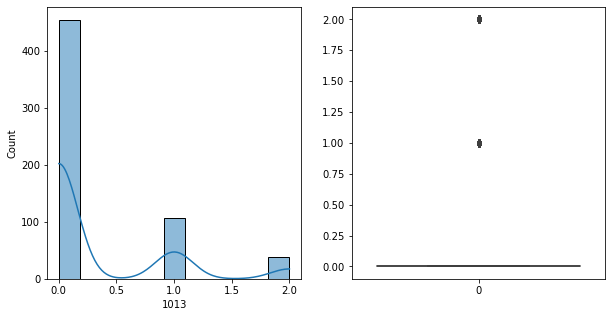

1013   Unique :  [2 0 1]
--------------------------------------------------------------------
1013   N unique :  3
--------------------------------------------------------------------
1013   Value Counts :  0    455
1    106
2     39
Name: 1013, dtype: int64
--------------------------------------------------------------------



[ 1014 ]
show_df_info :  1014


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


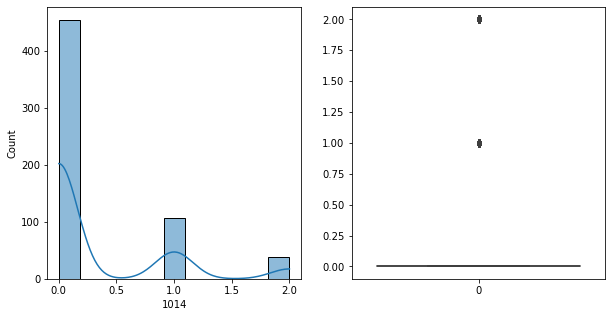

1014   Unique :  [2 0 1]
--------------------------------------------------------------------
1014   N unique :  3
--------------------------------------------------------------------
1014   Value Counts :  0    455
1    106
2     39
Name: 1014, dtype: int64
--------------------------------------------------------------------



[ 1015 ]
show_df_info :  1015


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


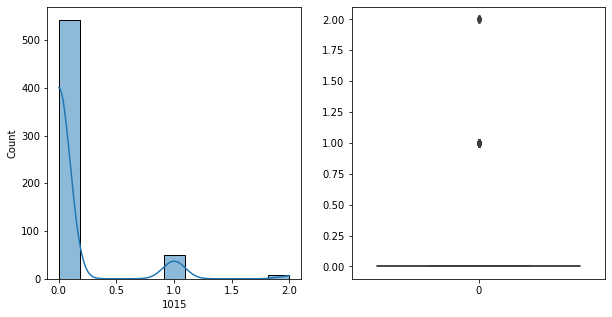

1015   Unique :  [0 1 2]
--------------------------------------------------------------------
1015   N unique :  3
--------------------------------------------------------------------
1015   Value Counts :  0    542
1     50
2      8
Name: 1015, dtype: int64
--------------------------------------------------------------------



[ 1016 ]
show_df_info :  1016


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


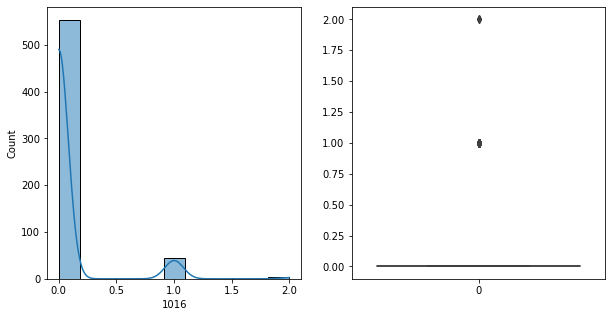

1016   Unique :  [0 1 2]
--------------------------------------------------------------------
1016   N unique :  3
--------------------------------------------------------------------
1016   Value Counts :  0    553
1     44
2      3
Name: 1016, dtype: int64
--------------------------------------------------------------------



[ 1017 ]
show_df_info :  1017


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


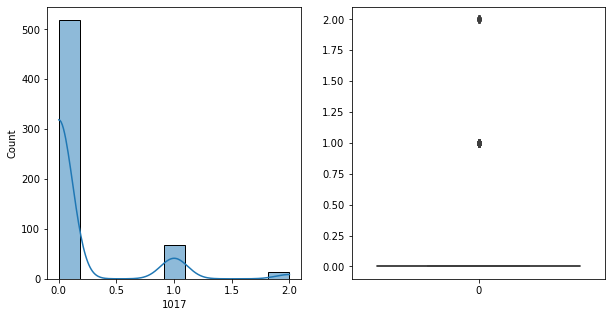

1017   Unique :  [0 1 2]
--------------------------------------------------------------------
1017   N unique :  3
--------------------------------------------------------------------
1017   Value Counts :  0    519
1     67
2     14
Name: 1017, dtype: int64
--------------------------------------------------------------------



[ 1018 ]
show_df_info :  1018


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


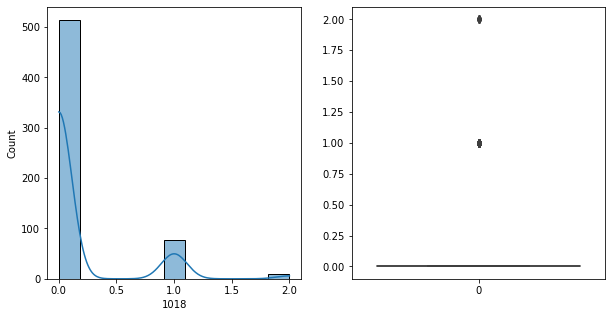

1018   Unique :  [0 1 2]
--------------------------------------------------------------------
1018   N unique :  3
--------------------------------------------------------------------
1018   Value Counts :  0    514
1     77
2      9
Name: 1018, dtype: int64
--------------------------------------------------------------------



[ 1019 ]
show_df_info :  1019


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


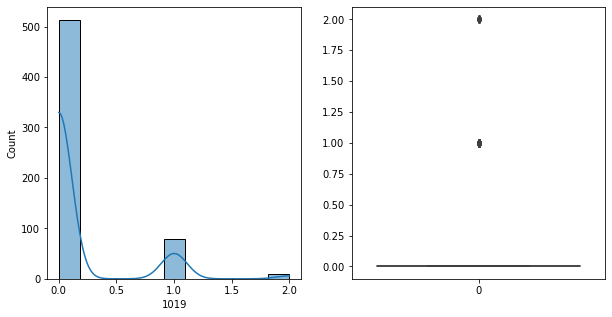

1019   Unique :  [0 1 2]
--------------------------------------------------------------------
1019   N unique :  3
--------------------------------------------------------------------
1019   Value Counts :  0    513
1     78
2      9
Name: 1019, dtype: int64
--------------------------------------------------------------------



[ 1020 ]
show_df_info :  1020


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


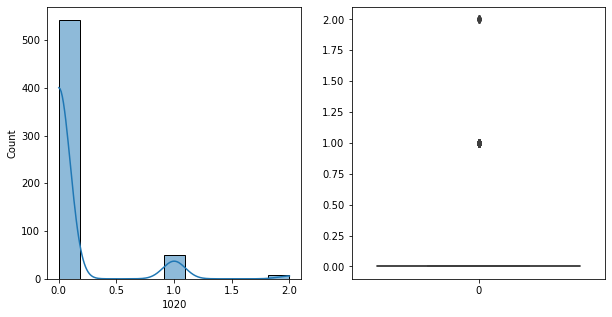

1020   Unique :  [0 1 2]
--------------------------------------------------------------------
1020   N unique :  3
--------------------------------------------------------------------
1020   Value Counts :  0    542
1     50
2      8
Name: 1020, dtype: int64
--------------------------------------------------------------------



[ 1021 ]
show_df_info :  1021


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


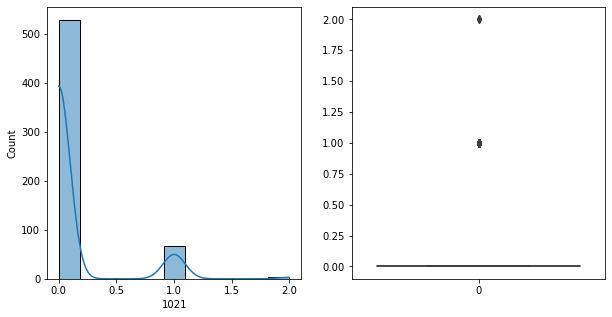

1021   Unique :  [0 1 2]
--------------------------------------------------------------------
1021   N unique :  3
--------------------------------------------------------------------
1021   Value Counts :  0    529
1     67
2      4
Name: 1021, dtype: int64
--------------------------------------------------------------------



[ 1022 ]
show_df_info :  1022


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


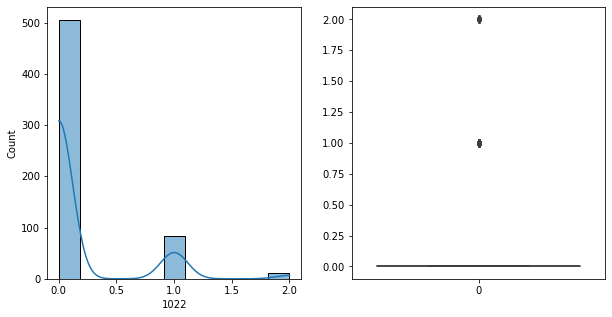

1022   Unique :  [0 1 2]
--------------------------------------------------------------------
1022   N unique :  3
--------------------------------------------------------------------
1022   Value Counts :  0    505
1     84
2     11
Name: 1022, dtype: int64
--------------------------------------------------------------------



[ 1023 ]
show_df_info :  1023


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


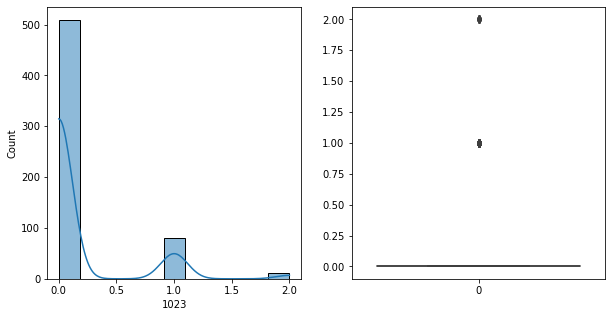

1023   Unique :  [0 1 2]
--------------------------------------------------------------------
1023   N unique :  3
--------------------------------------------------------------------
1023   Value Counts :  0    509
1     80
2     11
Name: 1023, dtype: int64
--------------------------------------------------------------------



[ 1024 ]
show_df_info :  1024


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


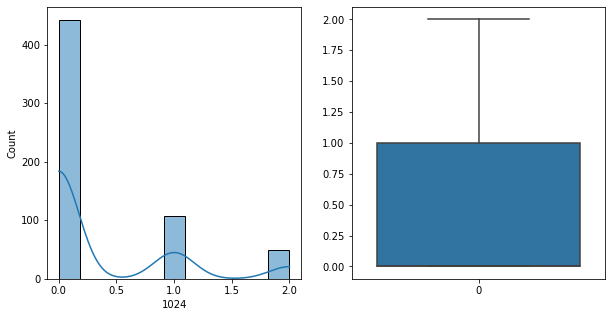

1024   Unique :  [0 1 2]
--------------------------------------------------------------------
1024   N unique :  3
--------------------------------------------------------------------
1024   Value Counts :  0    442
1    108
2     50
Name: 1024, dtype: int64
--------------------------------------------------------------------



[ 1025 ]
show_df_info :  1025


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


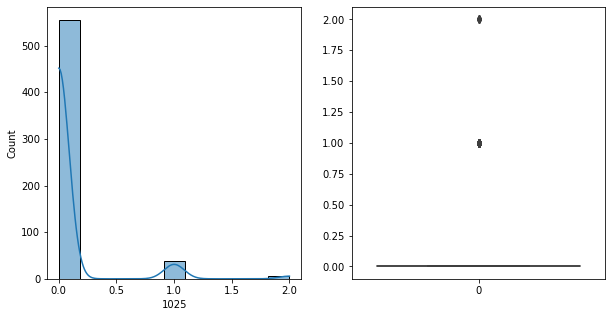

1025   Unique :  [0 1 2]
--------------------------------------------------------------------
1025   N unique :  3
--------------------------------------------------------------------
1025   Value Counts :  0    555
1     38
2      7
Name: 1025, dtype: int64
--------------------------------------------------------------------



[ 1026 ]
show_df_info :  1026


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


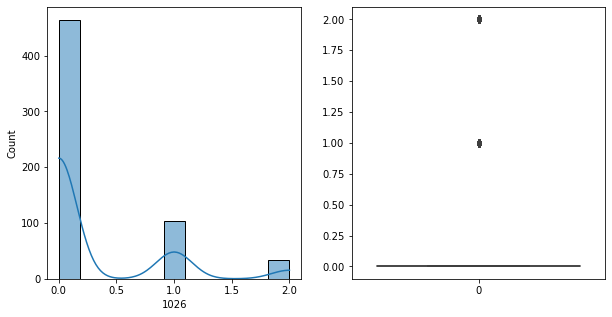

1026   Unique :  [0 1 2]
--------------------------------------------------------------------
1026   N unique :  3
--------------------------------------------------------------------
1026   Value Counts :  0    464
1    103
2     33
Name: 1026, dtype: int64
--------------------------------------------------------------------



[ 1027 ]
show_df_info :  1027


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


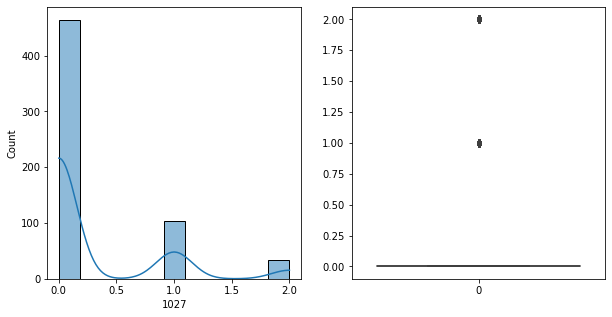

1027   Unique :  [0 1 2]
--------------------------------------------------------------------
1027   N unique :  3
--------------------------------------------------------------------
1027   Value Counts :  0    464
1    103
2     33
Name: 1027, dtype: int64
--------------------------------------------------------------------



[ 1028 ]
show_df_info :  1028


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


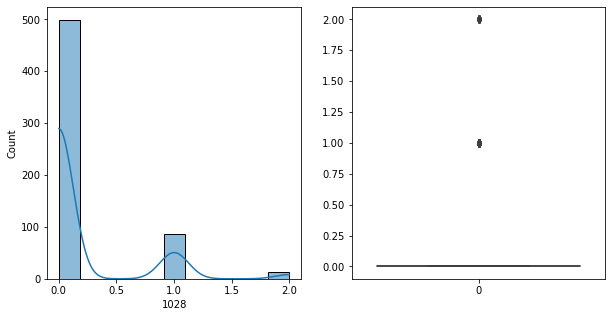

1028   Unique :  [0 1 2]
--------------------------------------------------------------------
1028   N unique :  3
--------------------------------------------------------------------
1028   Value Counts :  0    499
1     87
2     14
Name: 1028, dtype: int64
--------------------------------------------------------------------



[ 1029 ]
show_df_info :  1029


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


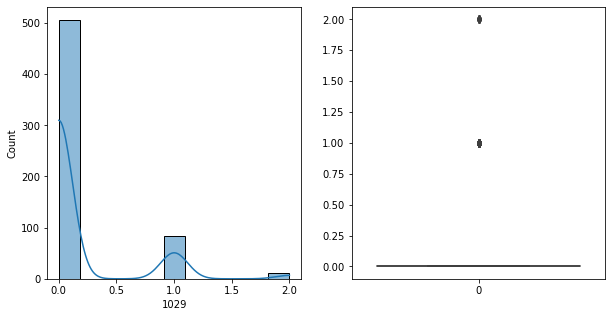

1029   Unique :  [0 1 2]
--------------------------------------------------------------------
1029   N unique :  3
--------------------------------------------------------------------
1029   Value Counts :  0    506
1     83
2     11
Name: 1029, dtype: int64
--------------------------------------------------------------------



[ 1030 ]
show_df_info :  1030


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


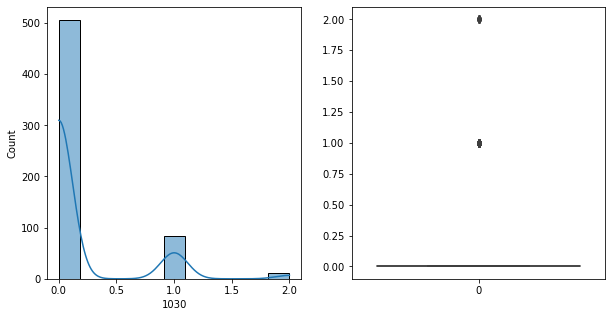

1030   Unique :  [0 1 2]
--------------------------------------------------------------------
1030   N unique :  3
--------------------------------------------------------------------
1030   Value Counts :  0    506
1     83
2     11
Name: 1030, dtype: int64
--------------------------------------------------------------------



[ 1031 ]
show_df_info :  1031


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


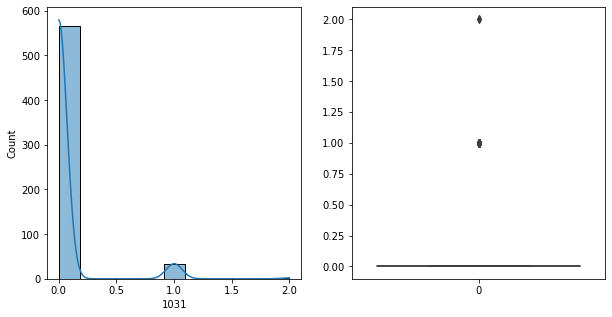

1031   Unique :  [0 1 2]
--------------------------------------------------------------------
1031   N unique :  3
--------------------------------------------------------------------
1031   Value Counts :  0    565
1     33
2      2
Name: 1031, dtype: int64
--------------------------------------------------------------------



[ 1032 ]
show_df_info :  1032


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


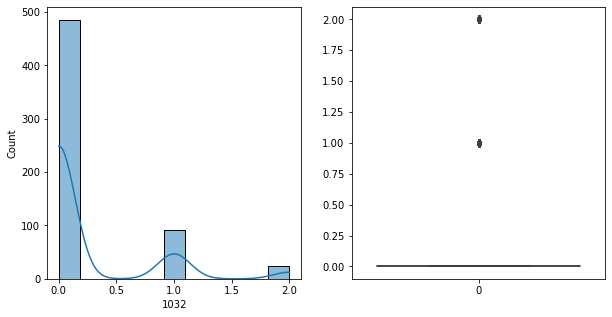

1032   Unique :  [0 1 2]
--------------------------------------------------------------------
1032   N unique :  3
--------------------------------------------------------------------
1032   Value Counts :  0    485
1     91
2     24
Name: 1032, dtype: int64
--------------------------------------------------------------------



[ 1033 ]
show_df_info :  1033


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


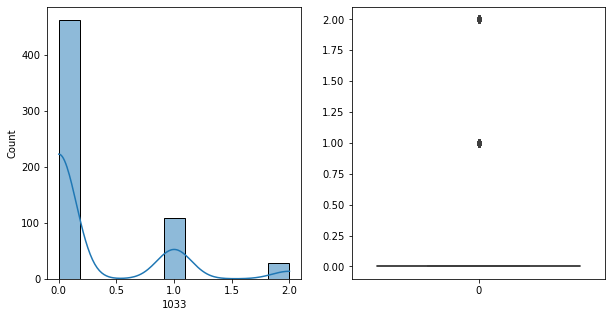

1033   Unique :  [1 0 2]
--------------------------------------------------------------------
1033   N unique :  3
--------------------------------------------------------------------
1033   Value Counts :  0    463
1    109
2     28
Name: 1033, dtype: int64
--------------------------------------------------------------------



[ 1034 ]
show_df_info :  1034


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


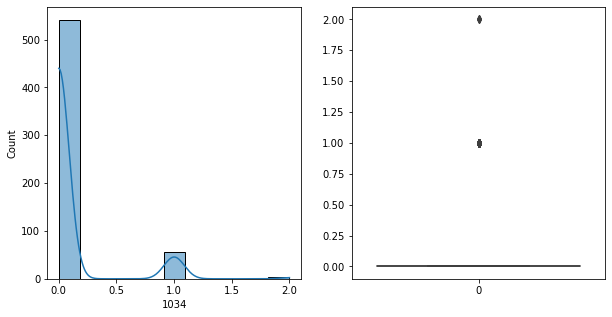

1034   Unique :  [0 1 2]
--------------------------------------------------------------------
1034   N unique :  3
--------------------------------------------------------------------
1034   Value Counts :  0    541
1     56
2      3
Name: 1034, dtype: int64
--------------------------------------------------------------------



[ 1035 ]
show_df_info :  1035


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


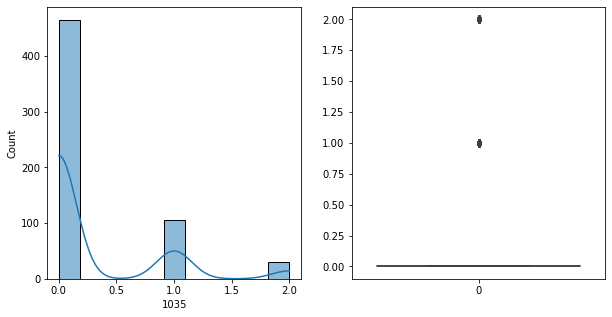

1035   Unique :  [0 1 2]
--------------------------------------------------------------------
1035   N unique :  3
--------------------------------------------------------------------
1035   Value Counts :  0    465
1    105
2     30
Name: 1035, dtype: int64
--------------------------------------------------------------------



[ 1036 ]
show_df_info :  1036


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


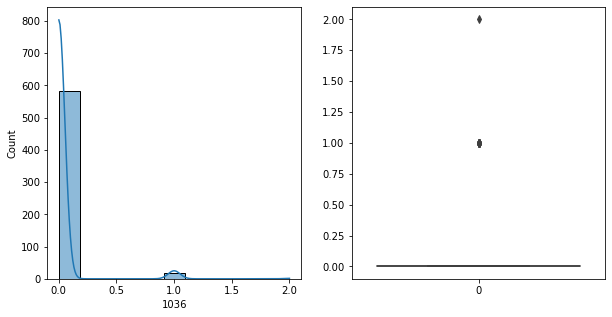

1036   Unique :  [0 1 2]
--------------------------------------------------------------------
1036   N unique :  3
--------------------------------------------------------------------
1036   Value Counts :  0    581
1     18
2      1
Name: 1036, dtype: int64
--------------------------------------------------------------------



[ 1037 ]
show_df_info :  1037


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


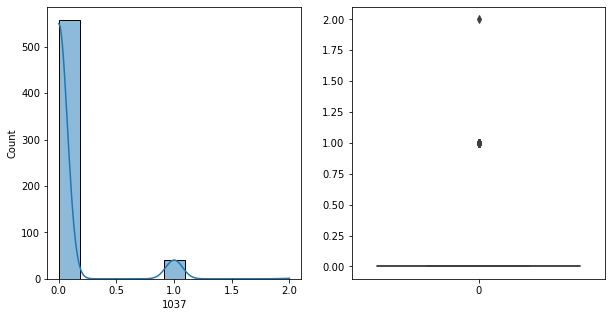

1037   Unique :  [0 1 2]
--------------------------------------------------------------------
1037   N unique :  3
--------------------------------------------------------------------
1037   Value Counts :  0    558
1     41
2      1
Name: 1037, dtype: int64
--------------------------------------------------------------------



[ 1038 ]
show_df_info :  1038


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


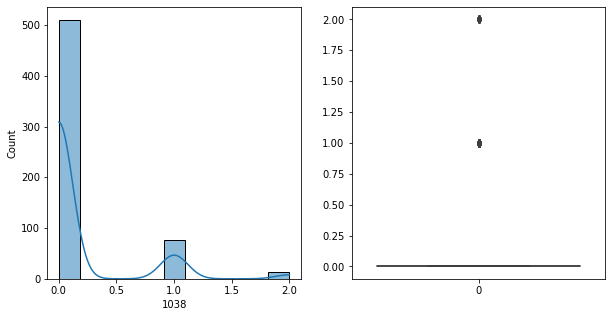

1038   Unique :  [1 0 2]
--------------------------------------------------------------------
1038   N unique :  3
--------------------------------------------------------------------
1038   Value Counts :  0    510
1     77
2     13
Name: 1038, dtype: int64
--------------------------------------------------------------------



[ 1039 ]
show_df_info :  1039


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


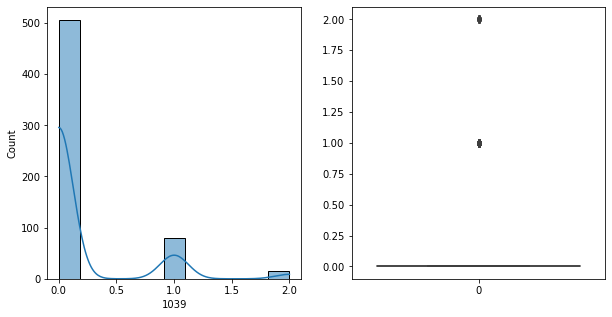

1039   Unique :  [1 0 2]
--------------------------------------------------------------------
1039   N unique :  3
--------------------------------------------------------------------
1039   Value Counts :  0    506
1     79
2     15
Name: 1039, dtype: int64
--------------------------------------------------------------------



[ 1040 ]
show_df_info :  1040


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


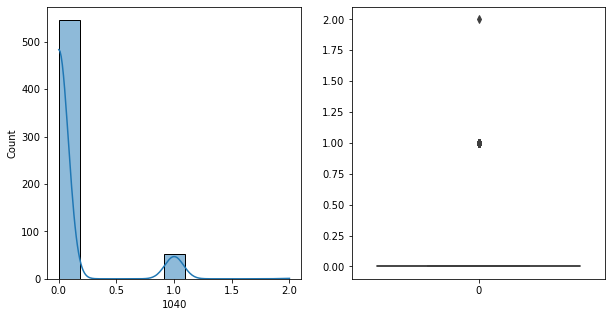

1040   Unique :  [1 0 2]
--------------------------------------------------------------------
1040   N unique :  3
--------------------------------------------------------------------
1040   Value Counts :  0    546
1     53
2      1
Name: 1040, dtype: int64
--------------------------------------------------------------------



[ 1041 ]
show_df_info :  1041


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


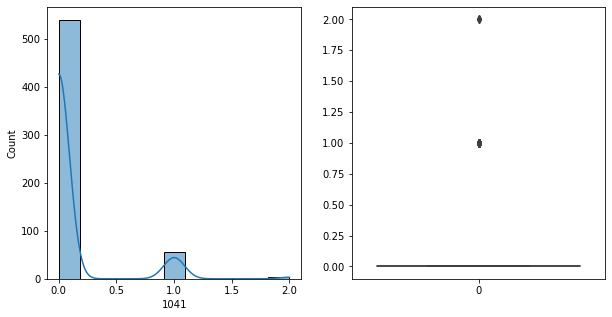

1041   Unique :  [1 0 2]
--------------------------------------------------------------------
1041   N unique :  3
--------------------------------------------------------------------
1041   Value Counts :  0    540
1     56
2      4
Name: 1041, dtype: int64
--------------------------------------------------------------------



[ 1042 ]
show_df_info :  1042


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


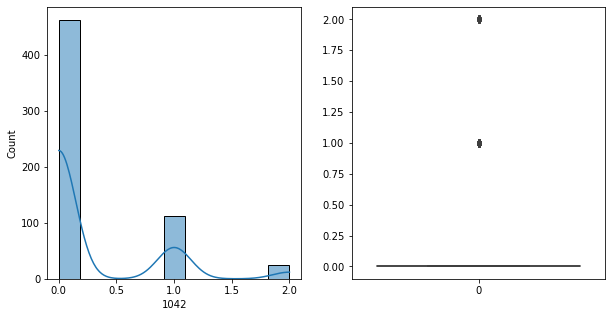

1042   Unique :  [2 0 1]
--------------------------------------------------------------------
1042   N unique :  3
--------------------------------------------------------------------
1042   Value Counts :  0    463
1    113
2     24
Name: 1042, dtype: int64
--------------------------------------------------------------------



[ 1043 ]
show_df_info :  1043


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


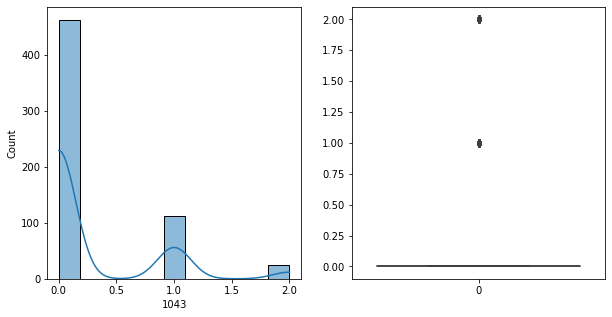

1043   Unique :  [2 0 1]
--------------------------------------------------------------------
1043   N unique :  3
--------------------------------------------------------------------
1043   Value Counts :  0    463
1    113
2     24
Name: 1043, dtype: int64
--------------------------------------------------------------------



[ 1044 ]
show_df_info :  1044


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


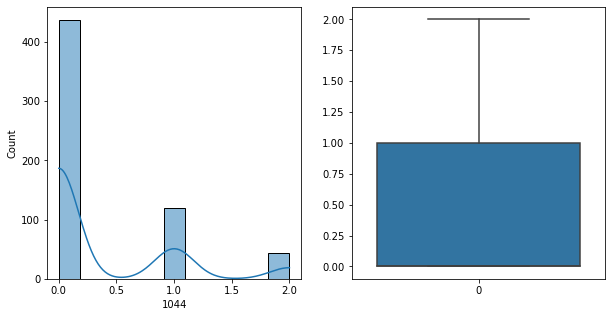

1044   Unique :  [0 1 2]
--------------------------------------------------------------------
1044   N unique :  3
--------------------------------------------------------------------
1044   Value Counts :  0    437
1    119
2     44
Name: 1044, dtype: int64
--------------------------------------------------------------------



[ 1045 ]
show_df_info :  1045


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


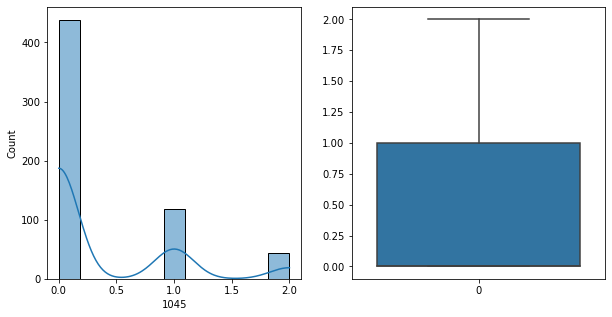

1045   Unique :  [0 1 2]
--------------------------------------------------------------------
1045   N unique :  3
--------------------------------------------------------------------
1045   Value Counts :  0    438
1    118
2     44
Name: 1045, dtype: int64
--------------------------------------------------------------------



[ 1046 ]
show_df_info :  1046


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


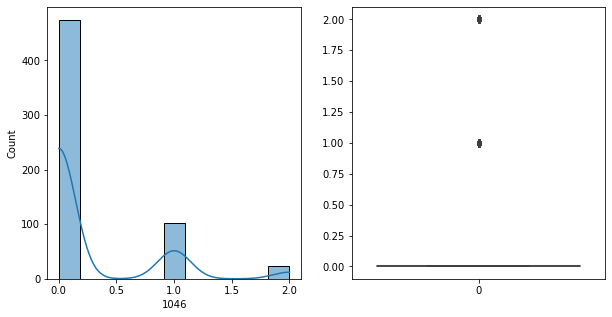

1046   Unique :  [1 0 2]
--------------------------------------------------------------------
1046   N unique :  3
--------------------------------------------------------------------
1046   Value Counts :  0    474
1    102
2     24
Name: 1046, dtype: int64
--------------------------------------------------------------------



[ 1047 ]
show_df_info :  1047


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


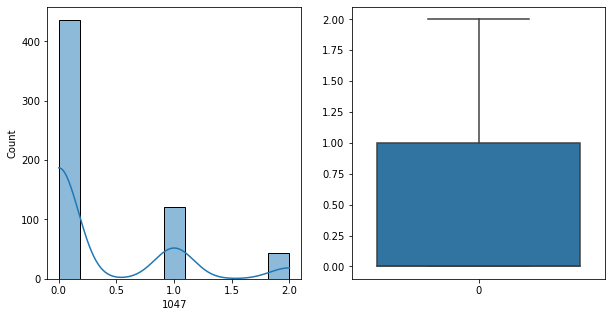

1047   Unique :  [0 1 2]
--------------------------------------------------------------------
1047   N unique :  3
--------------------------------------------------------------------
1047   Value Counts :  0    436
1    121
2     43
Name: 1047, dtype: int64
--------------------------------------------------------------------



[ 1048 ]
show_df_info :  1048


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


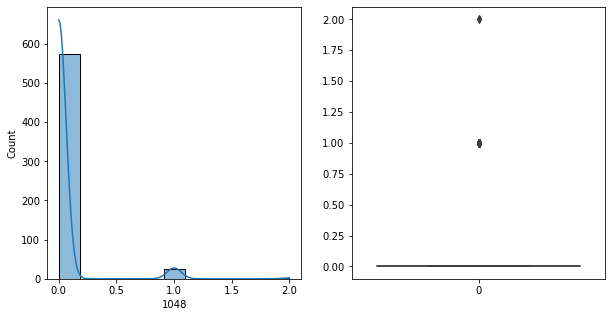

1048   Unique :  [0 1 2]
--------------------------------------------------------------------
1048   N unique :  3
--------------------------------------------------------------------
1048   Value Counts :  0    574
1     24
2      2
Name: 1048, dtype: int64
--------------------------------------------------------------------



[ 1049 ]
show_df_info :  1049


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


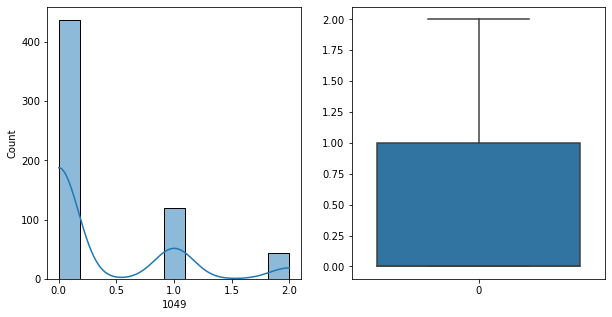

1049   Unique :  [2 0 1]
--------------------------------------------------------------------
1049   N unique :  3
--------------------------------------------------------------------
1049   Value Counts :  0    437
1    120
2     43
Name: 1049, dtype: int64
--------------------------------------------------------------------



[ 1050 ]
show_df_info :  1050


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


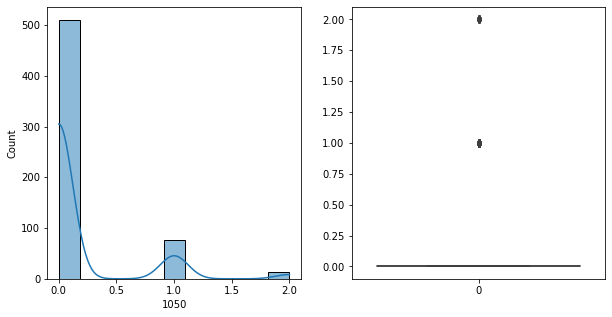

1050   Unique :  [0 1 2]
--------------------------------------------------------------------
1050   N unique :  3
--------------------------------------------------------------------
1050   Value Counts :  0    510
1     76
2     14
Name: 1050, dtype: int64
--------------------------------------------------------------------



[ 1051 ]
show_df_info :  1051


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


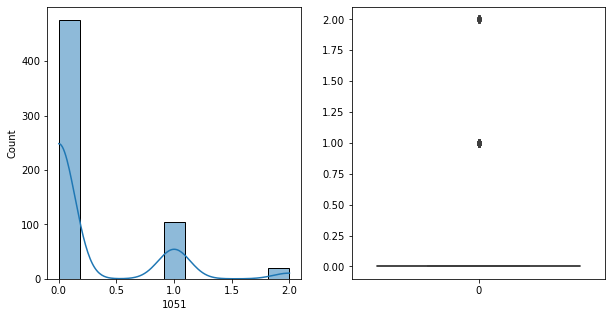

1051   Unique :  [2 0 1]
--------------------------------------------------------------------
1051   N unique :  3
--------------------------------------------------------------------
1051   Value Counts :  0    476
1    104
2     20
Name: 1051, dtype: int64
--------------------------------------------------------------------



[ 1052 ]
show_df_info :  1052


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


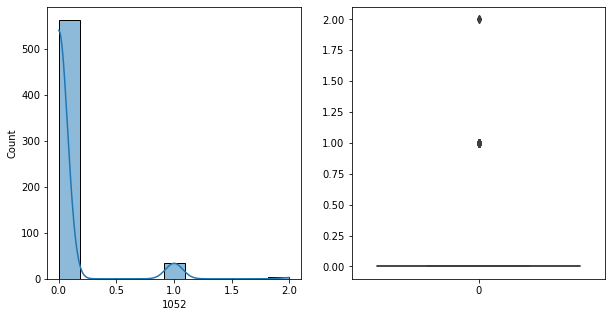

1052   Unique :  [0 1 2]
--------------------------------------------------------------------
1052   N unique :  3
--------------------------------------------------------------------
1052   Value Counts :  0    562
1     35
2      3
Name: 1052, dtype: int64
--------------------------------------------------------------------



[ 1053 ]
show_df_info :  1053


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


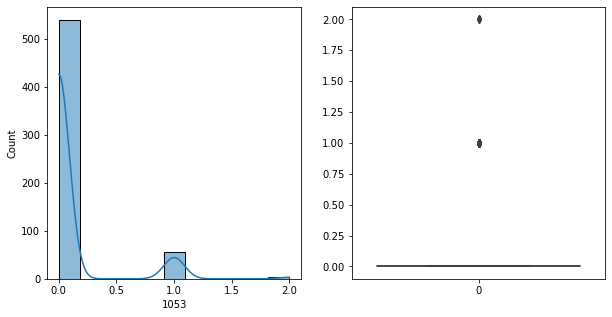

1053   Unique :  [0 1 2]
--------------------------------------------------------------------
1053   N unique :  3
--------------------------------------------------------------------
1053   Value Counts :  0    540
1     56
2      4
Name: 1053, dtype: int64
--------------------------------------------------------------------



[ 1054 ]
show_df_info :  1054


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


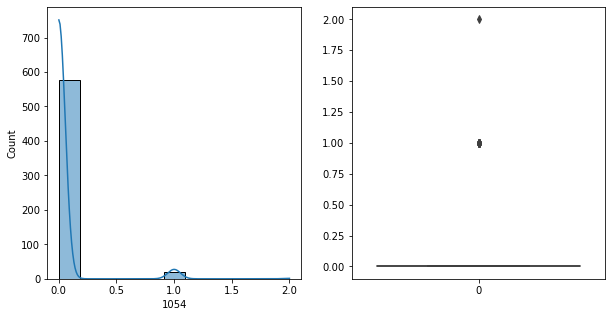

1054   Unique :  [0 1 2]
--------------------------------------------------------------------
1054   N unique :  3
--------------------------------------------------------------------
1054   Value Counts :  0    578
1     21
2      1
Name: 1054, dtype: int64
--------------------------------------------------------------------



[ 1055 ]
show_df_info :  1055


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


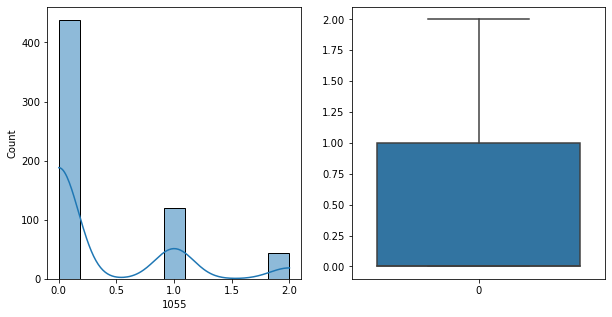

1055   Unique :  [0 1 2]
--------------------------------------------------------------------
1055   N unique :  3
--------------------------------------------------------------------
1055   Value Counts :  0    438
1    119
2     43
Name: 1055, dtype: int64
--------------------------------------------------------------------



[ 1056 ]
show_df_info :  1056


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


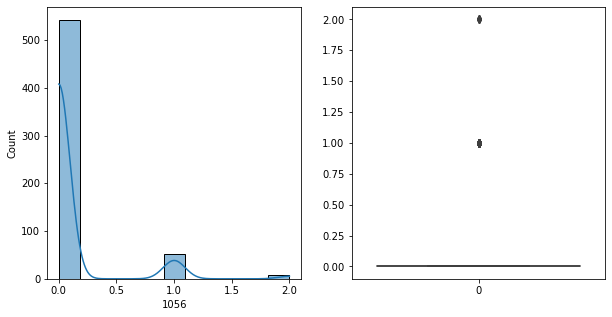

1056   Unique :  [0 1 2]
--------------------------------------------------------------------
1056   N unique :  3
--------------------------------------------------------------------
1056   Value Counts :  0    542
1     51
2      7
Name: 1056, dtype: int64
--------------------------------------------------------------------



[ 1057 ]
show_df_info :  1057


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


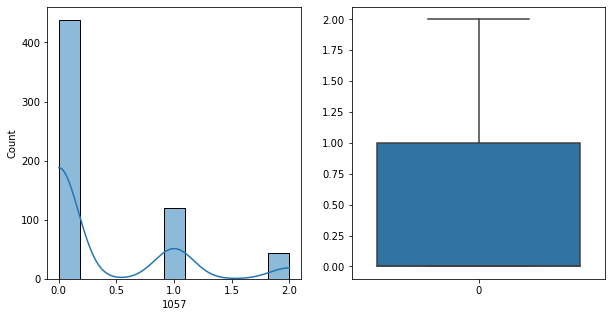

1057   Unique :  [0 1 2]
--------------------------------------------------------------------
1057   N unique :  3
--------------------------------------------------------------------
1057   Value Counts :  0    438
1    119
2     43
Name: 1057, dtype: int64
--------------------------------------------------------------------



[ 1058 ]
show_df_info :  1058


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


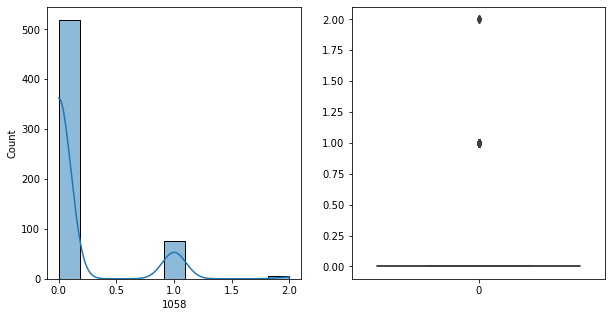

1058   Unique :  [1 0 2]
--------------------------------------------------------------------
1058   N unique :  3
--------------------------------------------------------------------
1058   Value Counts :  0    519
1     76
2      5
Name: 1058, dtype: int64
--------------------------------------------------------------------



[ 1059 ]
show_df_info :  1059


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


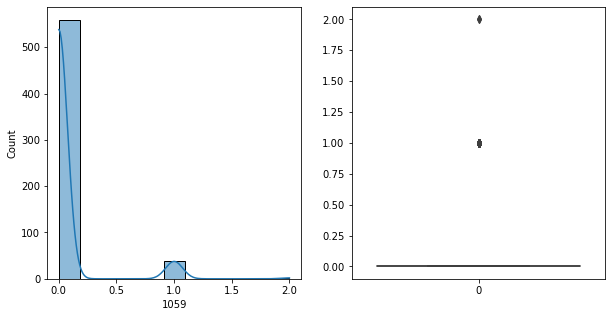

1059   Unique :  [0 1 2]
--------------------------------------------------------------------
1059   N unique :  3
--------------------------------------------------------------------
1059   Value Counts :  0    559
1     39
2      2
Name: 1059, dtype: int64
--------------------------------------------------------------------



[ 1060 ]
show_df_info :  1060


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


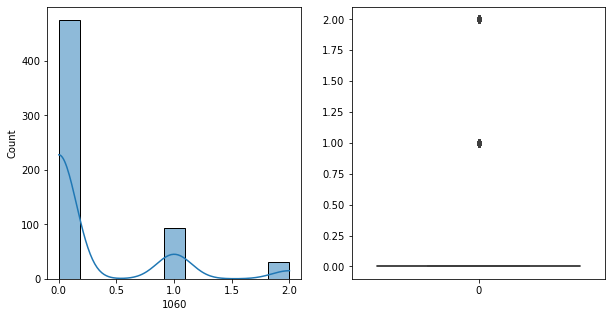

1060   Unique :  [0 2 1]
--------------------------------------------------------------------
1060   N unique :  3
--------------------------------------------------------------------
1060   Value Counts :  0    475
1     94
2     31
Name: 1060, dtype: int64
--------------------------------------------------------------------



[ 1061 ]
show_df_info :  1061


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


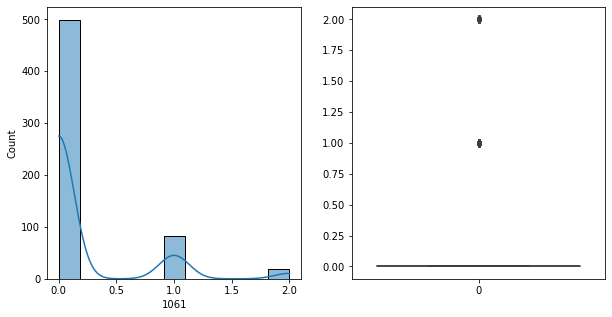

1061   Unique :  [0 2 1]
--------------------------------------------------------------------
1061   N unique :  3
--------------------------------------------------------------------
1061   Value Counts :  0    499
1     82
2     19
Name: 1061, dtype: int64
--------------------------------------------------------------------



[ 1062 ]
show_df_info :  1062


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


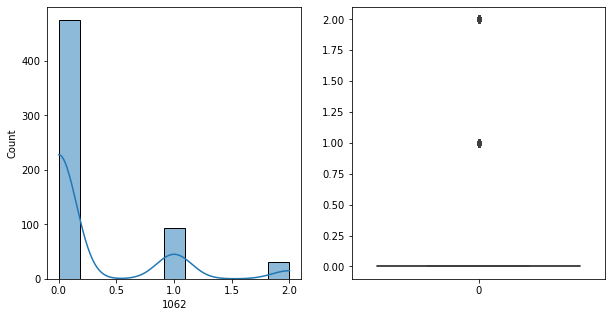

1062   Unique :  [0 2 1]
--------------------------------------------------------------------
1062   N unique :  3
--------------------------------------------------------------------
1062   Value Counts :  0    475
1     94
2     31
Name: 1062, dtype: int64
--------------------------------------------------------------------



[ 1063 ]
show_df_info :  1063


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


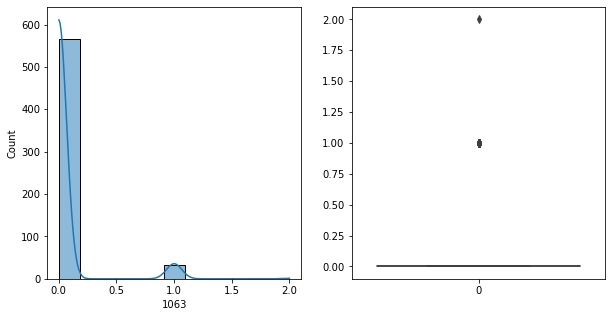

1063   Unique :  [0 1 2]
--------------------------------------------------------------------
1063   N unique :  3
--------------------------------------------------------------------
1063   Value Counts :  0    566
1     33
2      1
Name: 1063, dtype: int64
--------------------------------------------------------------------



[ 1064 ]
show_df_info :  1064


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


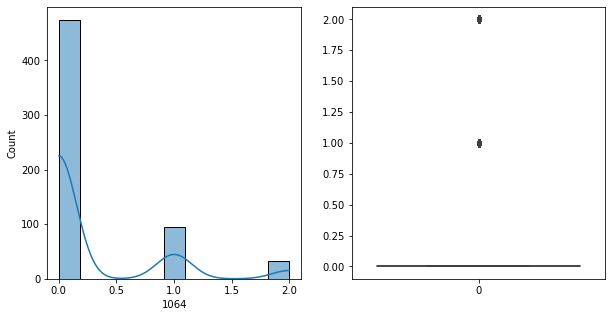

1064   Unique :  [0 2 1]
--------------------------------------------------------------------
1064   N unique :  3
--------------------------------------------------------------------
1064   Value Counts :  0    474
1     94
2     32
Name: 1064, dtype: int64
--------------------------------------------------------------------



[ 1065 ]
show_df_info :  1065


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


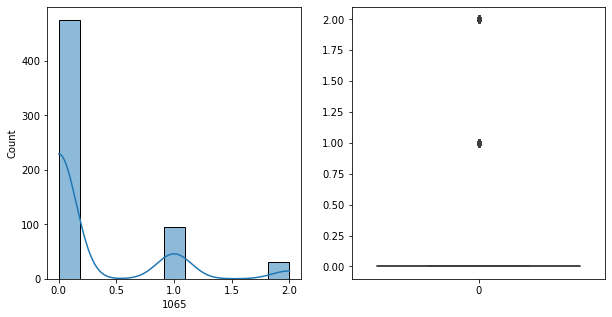

1065   Unique :  [0 2 1]
--------------------------------------------------------------------
1065   N unique :  3
--------------------------------------------------------------------
1065   Value Counts :  0    475
1     95
2     30
Name: 1065, dtype: int64
--------------------------------------------------------------------



[ 1066 ]
show_df_info :  1066


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


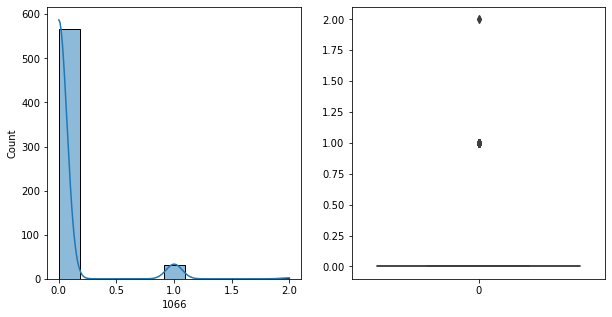

1066   Unique :  [0 1 2]
--------------------------------------------------------------------
1066   N unique :  3
--------------------------------------------------------------------
1066   Value Counts :  0    566
1     32
2      2
Name: 1066, dtype: int64
--------------------------------------------------------------------



[ 1067 ]
show_df_info :  1067


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


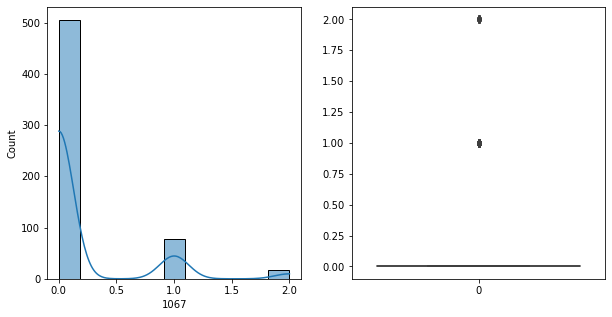

1067   Unique :  [0 2 1]
--------------------------------------------------------------------
1067   N unique :  3
--------------------------------------------------------------------
1067   Value Counts :  0    505
1     78
2     17
Name: 1067, dtype: int64
--------------------------------------------------------------------



[ 1068 ]
show_df_info :  1068


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


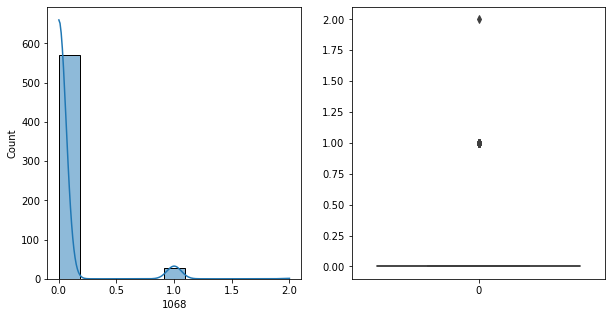

1068   Unique :  [0 1 2]
--------------------------------------------------------------------
1068   N unique :  3
--------------------------------------------------------------------
1068   Value Counts :  0    571
1     28
2      1
Name: 1068, dtype: int64
--------------------------------------------------------------------



[ 1069 ]
show_df_info :  1069


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


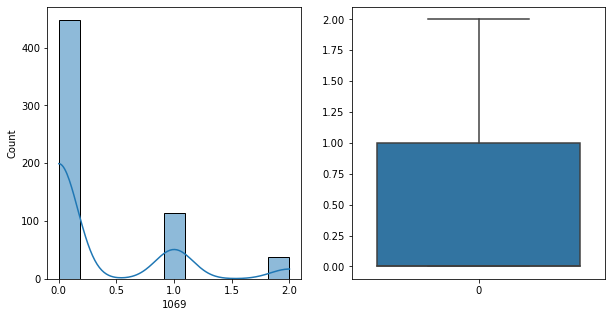

1069   Unique :  [1 0 2]
--------------------------------------------------------------------
1069   N unique :  3
--------------------------------------------------------------------
1069   Value Counts :  0    448
1    114
2     38
Name: 1069, dtype: int64
--------------------------------------------------------------------



[ 1070 ]
show_df_info :  1070


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


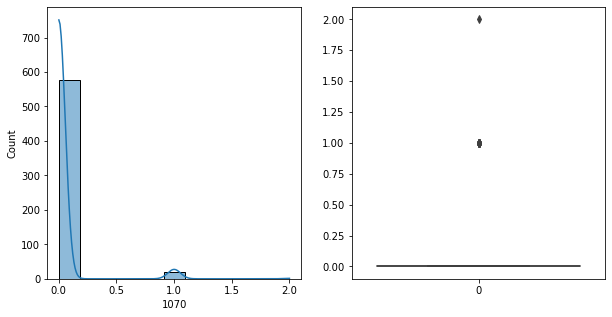

1070   Unique :  [0 1 2]
--------------------------------------------------------------------
1070   N unique :  3
--------------------------------------------------------------------
1070   Value Counts :  0    578
1     21
2      1
Name: 1070, dtype: int64
--------------------------------------------------------------------



[ 1071 ]
show_df_info :  1071


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


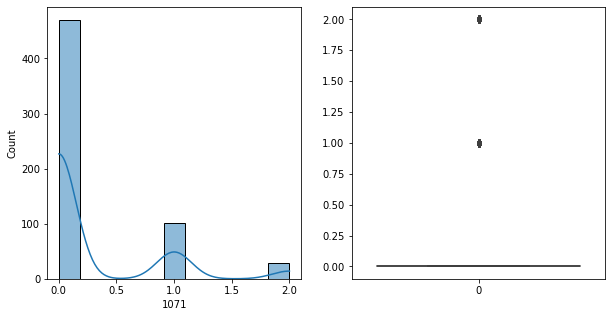

1071   Unique :  [0 2 1]
--------------------------------------------------------------------
1071   N unique :  3
--------------------------------------------------------------------
1071   Value Counts :  0    470
1    101
2     29
Name: 1071, dtype: int64
--------------------------------------------------------------------



[ 1072 ]
show_df_info :  1072


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


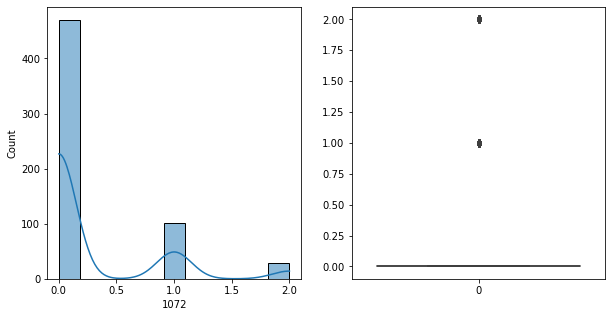

1072   Unique :  [0 2 1]
--------------------------------------------------------------------
1072   N unique :  3
--------------------------------------------------------------------
1072   Value Counts :  0    470
1    101
2     29
Name: 1072, dtype: int64
--------------------------------------------------------------------



[ 1073 ]
show_df_info :  1073


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


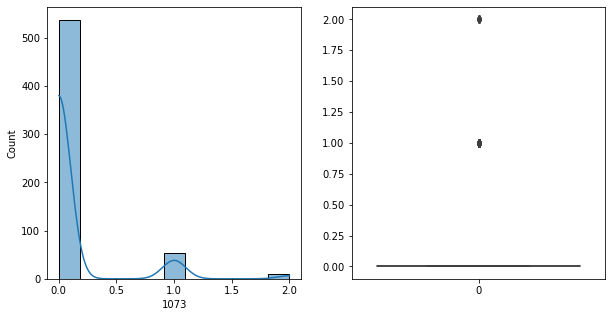

1073   Unique :  [1 0 2]
--------------------------------------------------------------------
1073   N unique :  3
--------------------------------------------------------------------
1073   Value Counts :  0    537
1     54
2      9
Name: 1073, dtype: int64
--------------------------------------------------------------------



[ 1074 ]
show_df_info :  1074


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


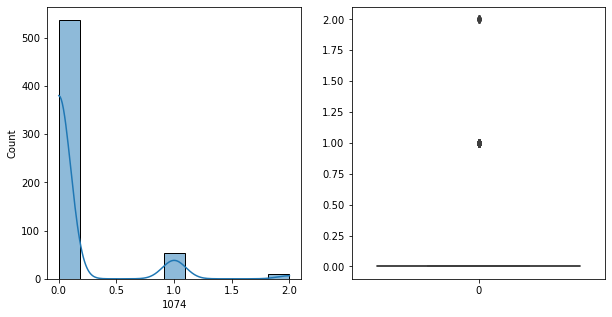

1074   Unique :  [1 0 2]
--------------------------------------------------------------------
1074   N unique :  3
--------------------------------------------------------------------
1074   Value Counts :  0    537
1     54
2      9
Name: 1074, dtype: int64
--------------------------------------------------------------------



[ 1075 ]
show_df_info :  1075


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


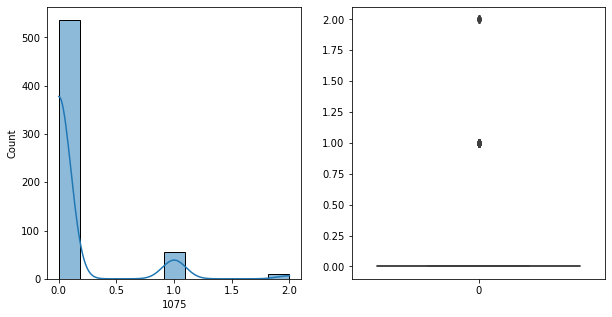

1075   Unique :  [1 0 2]
--------------------------------------------------------------------
1075   N unique :  3
--------------------------------------------------------------------
1075   Value Counts :  0    536
1     55
2      9
Name: 1075, dtype: int64
--------------------------------------------------------------------



[ 1076 ]
show_df_info :  1076


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


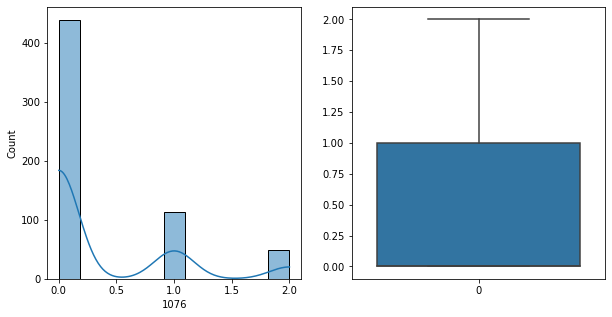

1076   Unique :  [1 0 2]
--------------------------------------------------------------------
1076   N unique :  3
--------------------------------------------------------------------
1076   Value Counts :  0    439
1    113
2     48
Name: 1076, dtype: int64
--------------------------------------------------------------------



[ 1077 ]
show_df_info :  1077


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


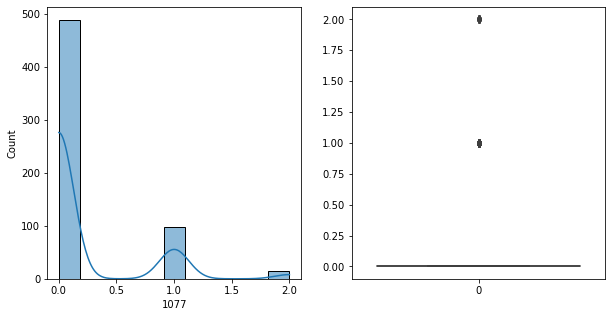

1077   Unique :  [0 1 2]
--------------------------------------------------------------------
1077   N unique :  3
--------------------------------------------------------------------
1077   Value Counts :  0    488
1     98
2     14
Name: 1077, dtype: int64
--------------------------------------------------------------------



[ 1078 ]
show_df_info :  1078


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


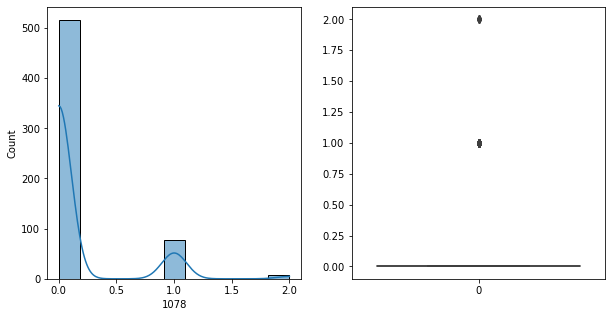

1078   Unique :  [0 1 2]
--------------------------------------------------------------------
1078   N unique :  3
--------------------------------------------------------------------
1078   Value Counts :  0    516
1     77
2      7
Name: 1078, dtype: int64
--------------------------------------------------------------------



[ 1079 ]
show_df_info :  1079


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


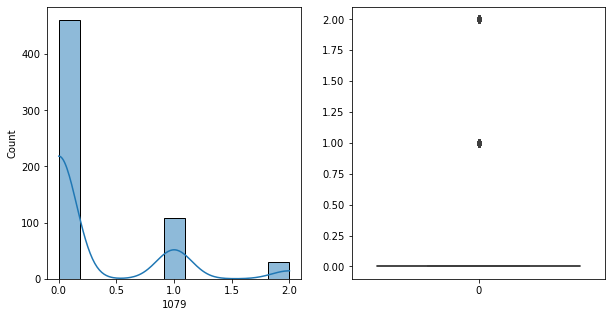

1079   Unique :  [1 0 2]
--------------------------------------------------------------------
1079   N unique :  3
--------------------------------------------------------------------
1079   Value Counts :  0    461
1    109
2     30
Name: 1079, dtype: int64
--------------------------------------------------------------------



[ 1080 ]
show_df_info :  1080


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


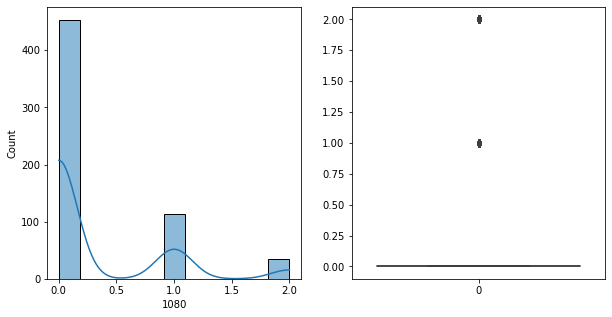

1080   Unique :  [1 0 2]
--------------------------------------------------------------------
1080   N unique :  3
--------------------------------------------------------------------
1080   Value Counts :  0    453
1    113
2     34
Name: 1080, dtype: int64
--------------------------------------------------------------------



[ 1081 ]
show_df_info :  1081


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


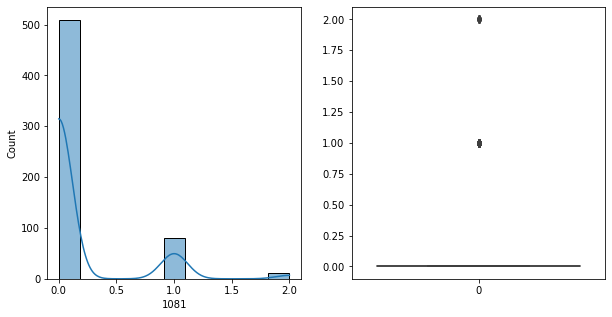

1081   Unique :  [0 1 2]
--------------------------------------------------------------------
1081   N unique :  3
--------------------------------------------------------------------
1081   Value Counts :  0    509
1     80
2     11
Name: 1081, dtype: int64
--------------------------------------------------------------------



[ 1082 ]
show_df_info :  1082


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


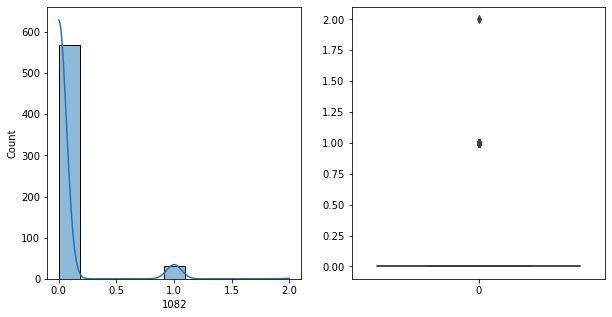

1082   Unique :  [0 1 2]
--------------------------------------------------------------------
1082   N unique :  3
--------------------------------------------------------------------
1082   Value Counts :  0    568
1     31
2      1
Name: 1082, dtype: int64
--------------------------------------------------------------------



[ 1083 ]
show_df_info :  1083


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


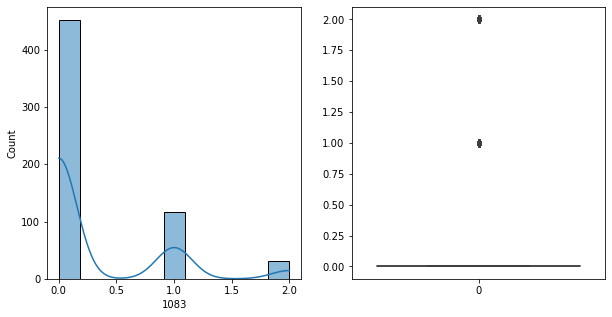

1083   Unique :  [1 0 2]
--------------------------------------------------------------------
1083   N unique :  3
--------------------------------------------------------------------
1083   Value Counts :  0    452
1    117
2     31
Name: 1083, dtype: int64
--------------------------------------------------------------------



[ 1084 ]
show_df_info :  1084


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


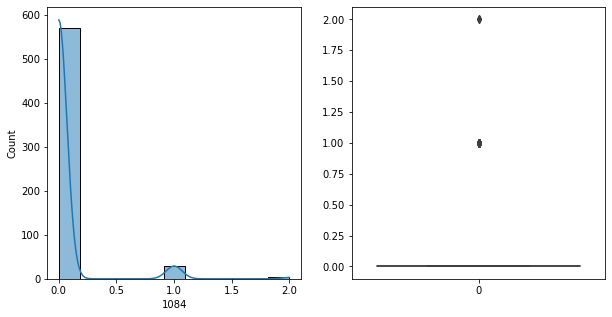

1084   Unique :  [0 1 2]
--------------------------------------------------------------------
1084   N unique :  3
--------------------------------------------------------------------
1084   Value Counts :  0    569
1     28
2      3
Name: 1084, dtype: int64
--------------------------------------------------------------------



[ 1085 ]
show_df_info :  1085


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


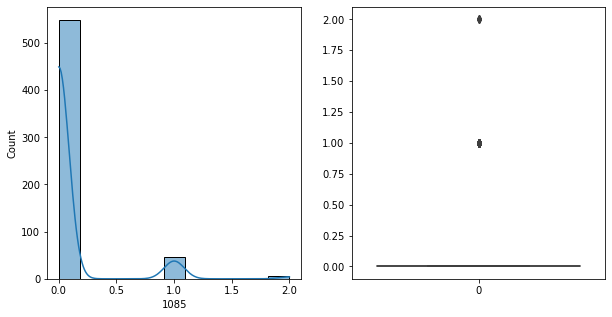

1085   Unique :  [0 1 2]
--------------------------------------------------------------------
1085   N unique :  3
--------------------------------------------------------------------
1085   Value Counts :  0    549
1     46
2      5
Name: 1085, dtype: int64
--------------------------------------------------------------------



[ 1086 ]
show_df_info :  1086


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


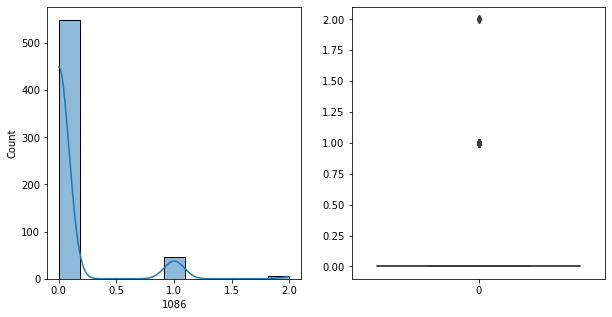

1086   Unique :  [0 1 2]
--------------------------------------------------------------------
1086   N unique :  3
--------------------------------------------------------------------
1086   Value Counts :  0    549
1     46
2      5
Name: 1086, dtype: int64
--------------------------------------------------------------------



[ 1087 ]
show_df_info :  1087


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


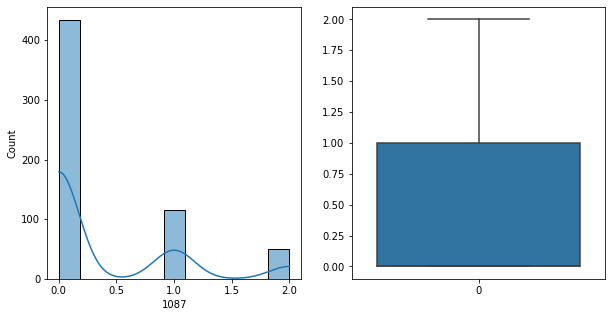

1087   Unique :  [1 0 2]
--------------------------------------------------------------------
1087   N unique :  3
--------------------------------------------------------------------
1087   Value Counts :  0    434
1    116
2     50
Name: 1087, dtype: int64
--------------------------------------------------------------------



[ 1088 ]
show_df_info :  1088


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


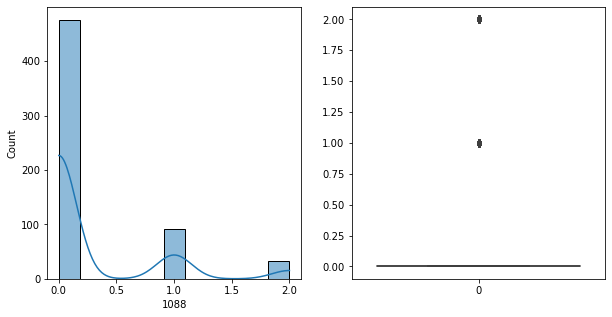

1088   Unique :  [1 0 2]
--------------------------------------------------------------------
1088   N unique :  3
--------------------------------------------------------------------
1088   Value Counts :  0    476
1     92
2     32
Name: 1088, dtype: int64
--------------------------------------------------------------------



[ 1089 ]
show_df_info :  1089


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


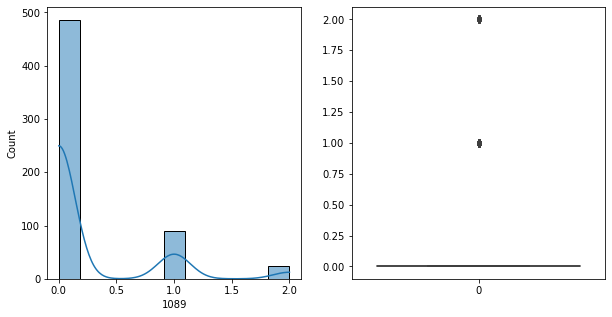

1089   Unique :  [1 0 2]
--------------------------------------------------------------------
1089   N unique :  3
--------------------------------------------------------------------
1089   Value Counts :  0    486
1     90
2     24
Name: 1089, dtype: int64
--------------------------------------------------------------------



[ 1090 ]
show_df_info :  1090


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


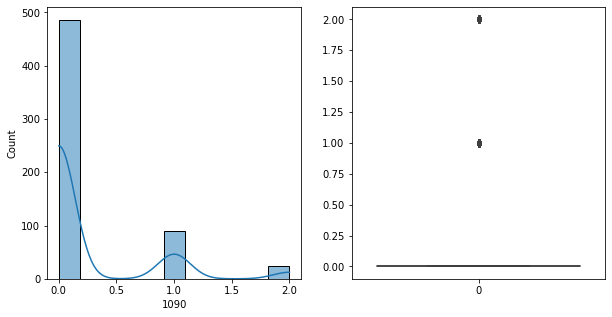

1090   Unique :  [1 0 2]
--------------------------------------------------------------------
1090   N unique :  3
--------------------------------------------------------------------
1090   Value Counts :  0    486
1     90
2     24
Name: 1090, dtype: int64
--------------------------------------------------------------------



[ 1091 ]
show_df_info :  1091


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


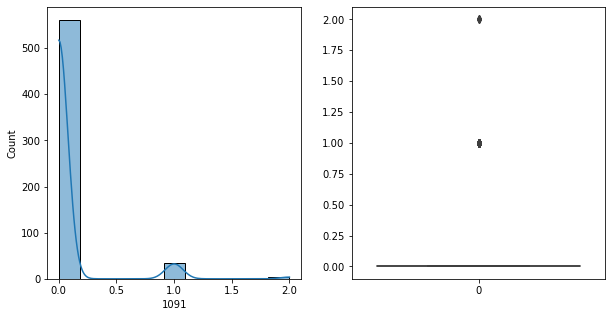

1091   Unique :  [0 2 1]
--------------------------------------------------------------------
1091   N unique :  3
--------------------------------------------------------------------
1091   Value Counts :  0    561
1     35
2      4
Name: 1091, dtype: int64
--------------------------------------------------------------------



[ 1092 ]
show_df_info :  1092


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


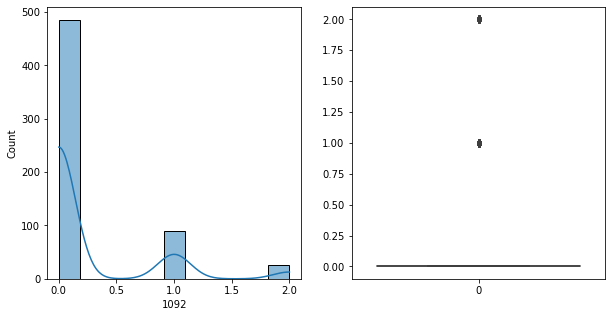

1092   Unique :  [1 0 2]
--------------------------------------------------------------------
1092   N unique :  3
--------------------------------------------------------------------
1092   Value Counts :  0    485
1     90
2     25
Name: 1092, dtype: int64
--------------------------------------------------------------------



[ 1093 ]
show_df_info :  1093


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


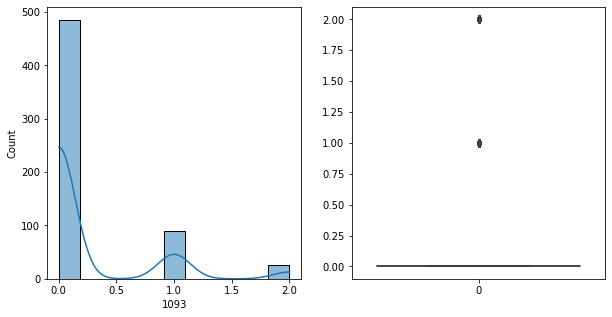

1093   Unique :  [1 0 2]
--------------------------------------------------------------------
1093   N unique :  3
--------------------------------------------------------------------
1093   Value Counts :  0    485
1     90
2     25
Name: 1093, dtype: int64
--------------------------------------------------------------------



[ 1094 ]
show_df_info :  1094


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


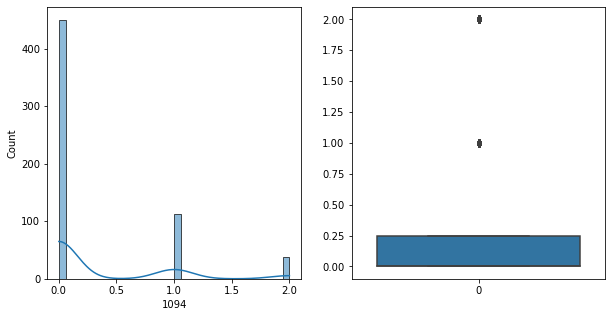

1094   Unique :  [1 0 2]
--------------------------------------------------------------------
1094   N unique :  3
--------------------------------------------------------------------
1094   Value Counts :  0    450
1    112
2     38
Name: 1094, dtype: int64
--------------------------------------------------------------------



[ 1095 ]
show_df_info :  1095


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


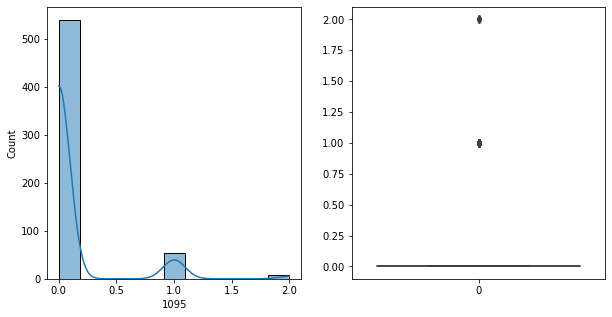

1095   Unique :  [0 2 1]
--------------------------------------------------------------------
1095   N unique :  3
--------------------------------------------------------------------
1095   Value Counts :  0    540
1     53
2      7
Name: 1095, dtype: int64
--------------------------------------------------------------------



[ 1096 ]
show_df_info :  1096


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


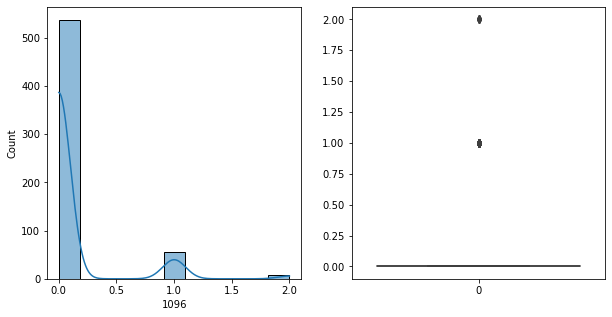

1096   Unique :  [0 2 1]
--------------------------------------------------------------------
1096   N unique :  3
--------------------------------------------------------------------
1096   Value Counts :  0    537
1     55
2      8
Name: 1096, dtype: int64
--------------------------------------------------------------------



[ 1097 ]
show_df_info :  1097


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


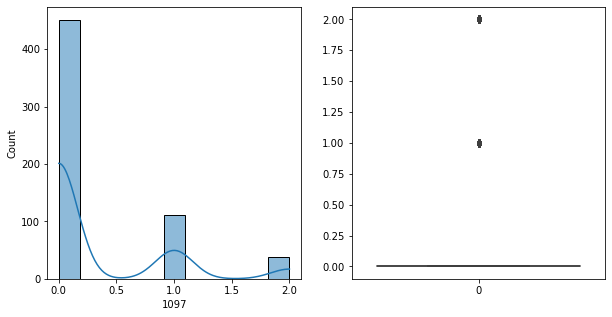

1097   Unique :  [1 0 2]
--------------------------------------------------------------------
1097   N unique :  3
--------------------------------------------------------------------
1097   Value Counts :  0    451
1    111
2     38
Name: 1097, dtype: int64
--------------------------------------------------------------------



[ 1098 ]
show_df_info :  1098


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


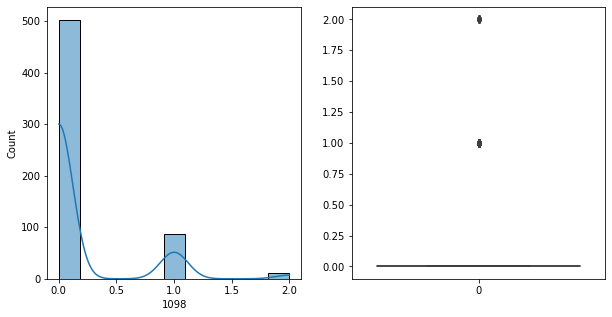

1098   Unique :  [1 0 2]
--------------------------------------------------------------------
1098   N unique :  3
--------------------------------------------------------------------
1098   Value Counts :  0    502
1     86
2     12
Name: 1098, dtype: int64
--------------------------------------------------------------------



[ 1099 ]
show_df_info :  1099


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


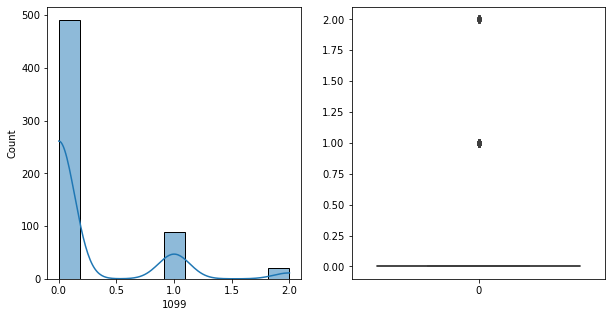

1099   Unique :  [0 1 2]
--------------------------------------------------------------------
1099   N unique :  3
--------------------------------------------------------------------
1099   Value Counts :  0    491
1     88
2     21
Name: 1099, dtype: int64
--------------------------------------------------------------------



[ 1100 ]
show_df_info :  1100


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


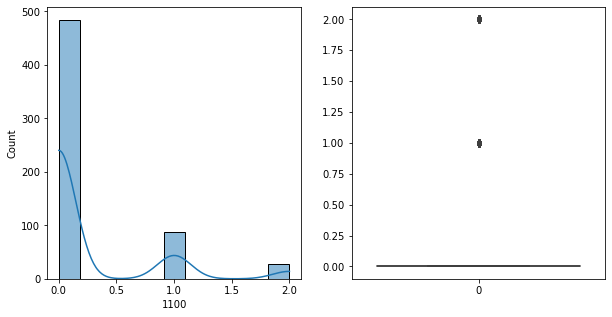

1100   Unique :  [1 0 2]
--------------------------------------------------------------------
1100   N unique :  3
--------------------------------------------------------------------
1100   Value Counts :  0    484
1     88
2     28
Name: 1100, dtype: int64
--------------------------------------------------------------------



[ 1101 ]
show_df_info :  1101


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


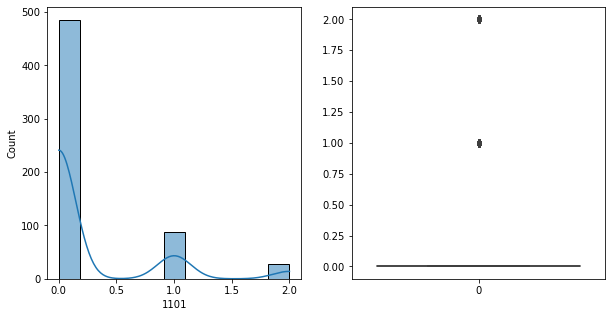

1101   Unique :  [1 0 2]
--------------------------------------------------------------------
1101   N unique :  3
--------------------------------------------------------------------
1101   Value Counts :  0    485
1     87
2     28
Name: 1101, dtype: int64
--------------------------------------------------------------------



[ 1102 ]
show_df_info :  1102


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


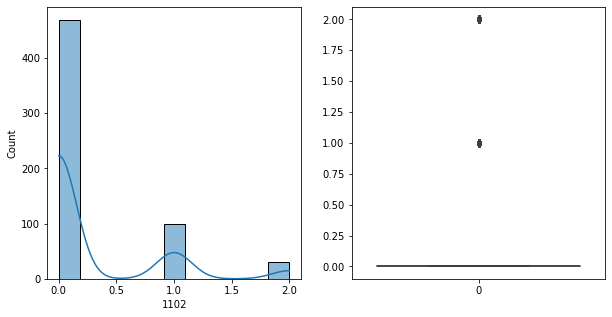

1102   Unique :  [1 0 2]
--------------------------------------------------------------------
1102   N unique :  3
--------------------------------------------------------------------
1102   Value Counts :  0    469
1    100
2     31
Name: 1102, dtype: int64
--------------------------------------------------------------------



[ 1103 ]
show_df_info :  1103


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


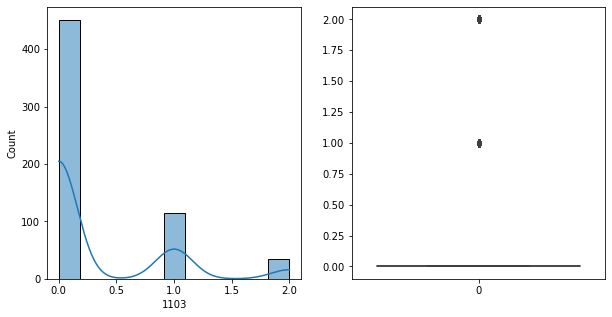

1103   Unique :  [1 0 2]
--------------------------------------------------------------------
1103   N unique :  3
--------------------------------------------------------------------
1103   Value Counts :  0    451
1    114
2     35
Name: 1103, dtype: int64
--------------------------------------------------------------------



[ 1104 ]
show_df_info :  1104


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


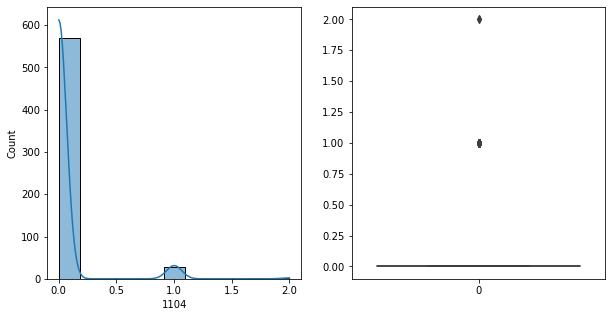

1104   Unique :  [0 1 2]
--------------------------------------------------------------------
1104   N unique :  3
--------------------------------------------------------------------
1104   Value Counts :  0    569
1     29
2      2
Name: 1104, dtype: int64
--------------------------------------------------------------------



[ 1105 ]
show_df_info :  1105


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


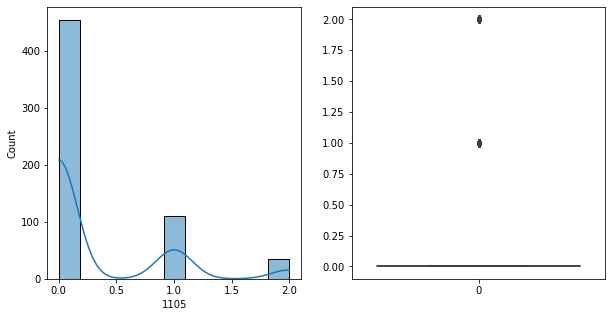

1105   Unique :  [1 0 2]
--------------------------------------------------------------------
1105   N unique :  3
--------------------------------------------------------------------
1105   Value Counts :  0    455
1    111
2     34
Name: 1105, dtype: int64
--------------------------------------------------------------------



[ 1106 ]
show_df_info :  1106


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


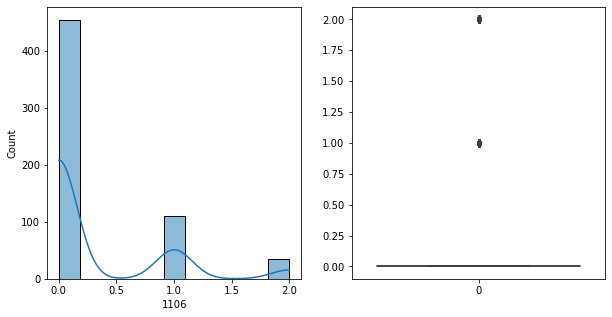

1106   Unique :  [1 0 2]
--------------------------------------------------------------------
1106   N unique :  3
--------------------------------------------------------------------
1106   Value Counts :  0    455
1    111
2     34
Name: 1106, dtype: int64
--------------------------------------------------------------------



[ 1107 ]
show_df_info :  1107


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


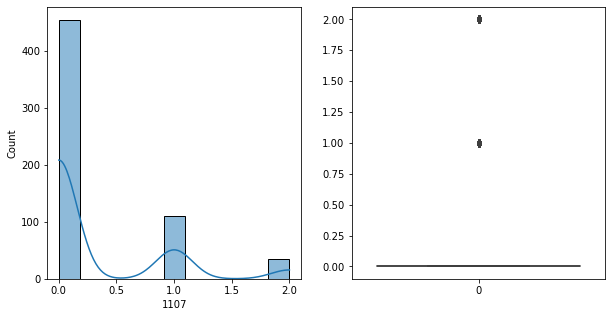

1107   Unique :  [1 0 2]
--------------------------------------------------------------------
1107   N unique :  3
--------------------------------------------------------------------
1107   Value Counts :  0    455
1    111
2     34
Name: 1107, dtype: int64
--------------------------------------------------------------------



[ 1108 ]
show_df_info :  1108


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


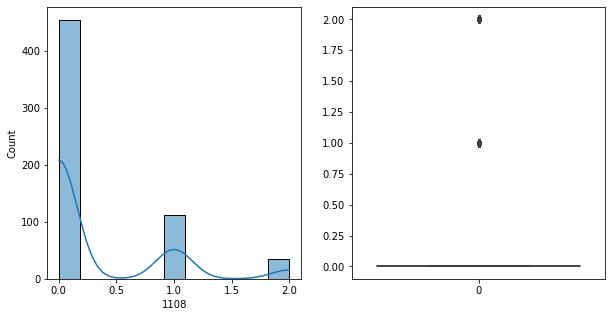

1108   Unique :  [1 0 2]
--------------------------------------------------------------------
1108   N unique :  3
--------------------------------------------------------------------
1108   Value Counts :  0    454
1    112
2     34
Name: 1108, dtype: int64
--------------------------------------------------------------------



[ 1109 ]
show_df_info :  1109


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


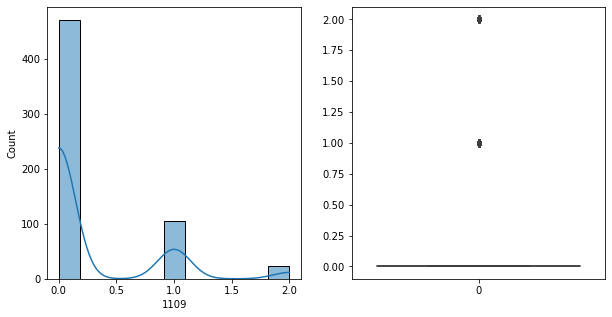

1109   Unique :  [1 0 2]
--------------------------------------------------------------------
1109   N unique :  3
--------------------------------------------------------------------
1109   Value Counts :  0    471
1    106
2     23
Name: 1109, dtype: int64
--------------------------------------------------------------------



[ 1110 ]
show_df_info :  1110


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


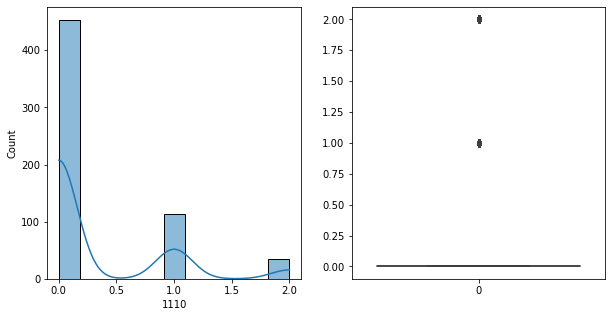

1110   Unique :  [1 0 2]
--------------------------------------------------------------------
1110   N unique :  3
--------------------------------------------------------------------
1110   Value Counts :  0    453
1    113
2     34
Name: 1110, dtype: int64
--------------------------------------------------------------------



[ 1111 ]
show_df_info :  1111


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


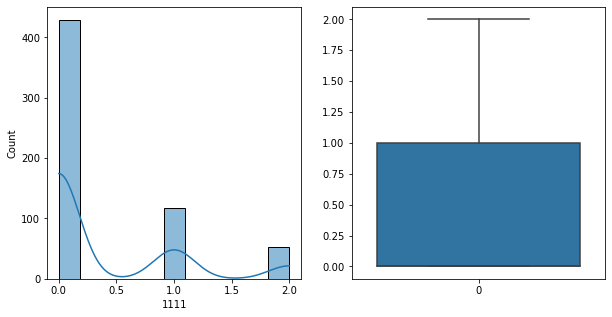

1111   Unique :  [1 0 2]
--------------------------------------------------------------------
1111   N unique :  3
--------------------------------------------------------------------
1111   Value Counts :  0    429
1    118
2     53
Name: 1111, dtype: int64
--------------------------------------------------------------------



[ 1112 ]
show_df_info :  1112


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


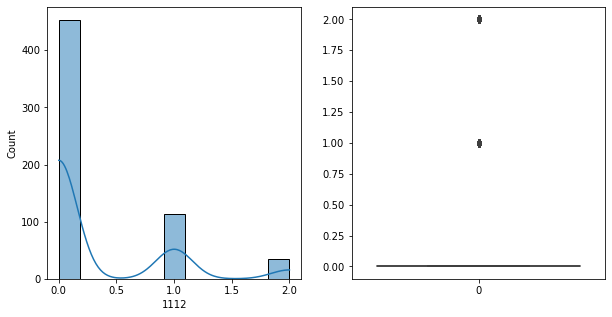

1112   Unique :  [1 0 2]
--------------------------------------------------------------------
1112   N unique :  3
--------------------------------------------------------------------
1112   Value Counts :  0    453
1    113
2     34
Name: 1112, dtype: int64
--------------------------------------------------------------------



[ 1113 ]
show_df_info :  1113


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


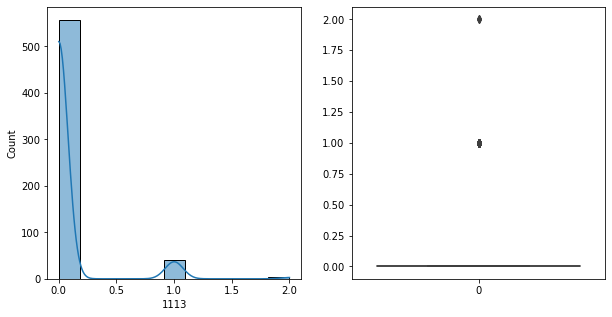

1113   Unique :  [0 1 2]
--------------------------------------------------------------------
1113   N unique :  3
--------------------------------------------------------------------
1113   Value Counts :  0    557
1     40
2      3
Name: 1113, dtype: int64
--------------------------------------------------------------------



[ 1114 ]
show_df_info :  1114


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


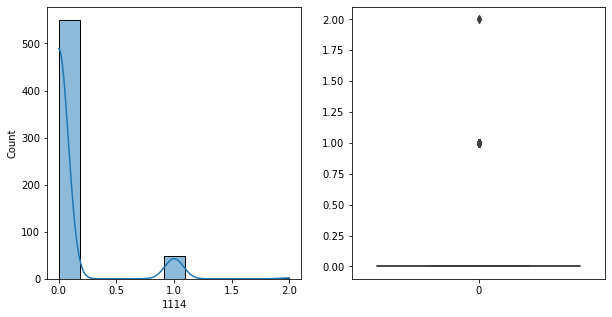

1114   Unique :  [0 1 2]
--------------------------------------------------------------------
1114   N unique :  3
--------------------------------------------------------------------
1114   Value Counts :  0    550
1     48
2      2
Name: 1114, dtype: int64
--------------------------------------------------------------------



[ 1115 ]
show_df_info :  1115


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


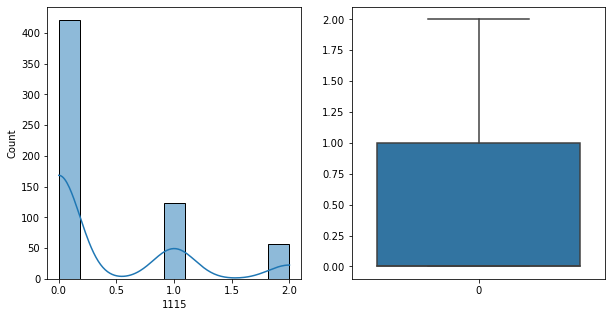

1115   Unique :  [1 0 2]
--------------------------------------------------------------------
1115   N unique :  3
--------------------------------------------------------------------
1115   Value Counts :  0    421
1    123
2     56
Name: 1115, dtype: int64
--------------------------------------------------------------------



[ 1116 ]
show_df_info :  1116


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


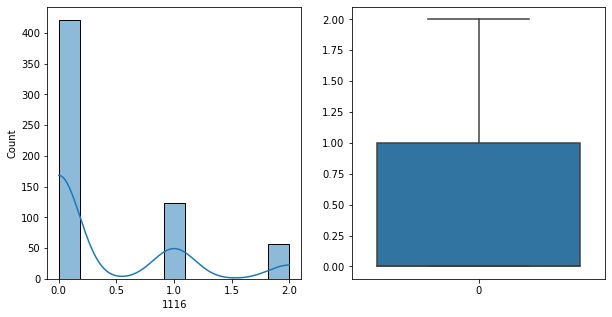

1116   Unique :  [1 0 2]
--------------------------------------------------------------------
1116   N unique :  3
--------------------------------------------------------------------
1116   Value Counts :  0    421
1    123
2     56
Name: 1116, dtype: int64
--------------------------------------------------------------------



[ 1117 ]
show_df_info :  1117


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


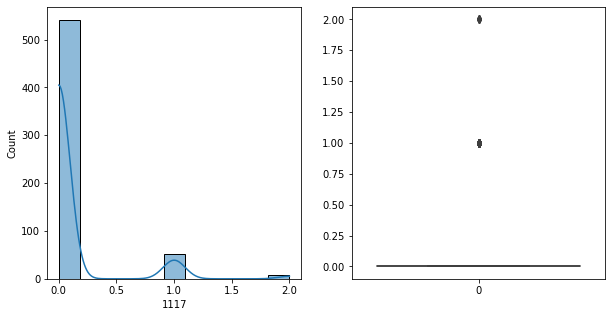

1117   Unique :  [1 0 2]
--------------------------------------------------------------------
1117   N unique :  3
--------------------------------------------------------------------
1117   Value Counts :  0    541
1     52
2      7
Name: 1117, dtype: int64
--------------------------------------------------------------------



[ 1118 ]
show_df_info :  1118


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


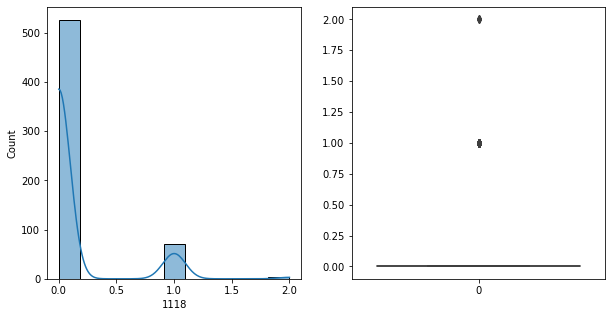

1118   Unique :  [1 0 2]
--------------------------------------------------------------------
1118   N unique :  3
--------------------------------------------------------------------
1118   Value Counts :  0    526
1     70
2      4
Name: 1118, dtype: int64
--------------------------------------------------------------------



[ 1119 ]
show_df_info :  1119


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


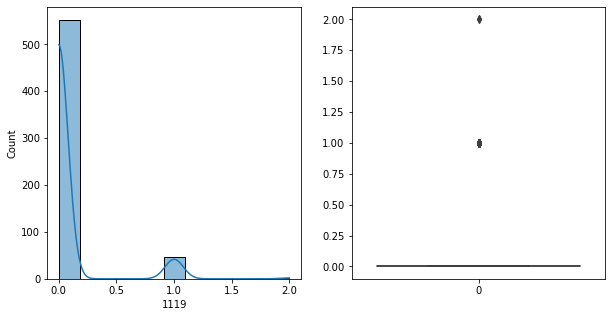

1119   Unique :  [0 1 2]
--------------------------------------------------------------------
1119   N unique :  3
--------------------------------------------------------------------
1119   Value Counts :  0    552
1     46
2      2
Name: 1119, dtype: int64
--------------------------------------------------------------------



[ 1120 ]
show_df_info :  1120


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


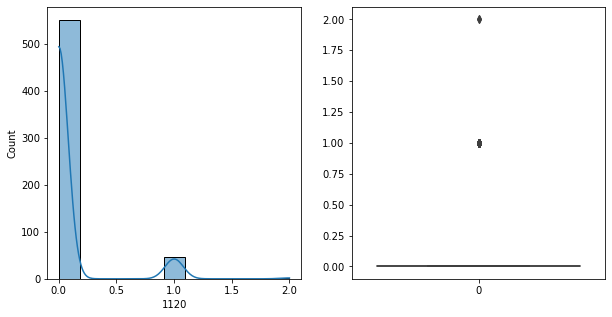

1120   Unique :  [0 1 2]
--------------------------------------------------------------------
1120   N unique :  3
--------------------------------------------------------------------
1120   Value Counts :  0    551
1     47
2      2
Name: 1120, dtype: int64
--------------------------------------------------------------------



[ 1121 ]
show_df_info :  1121


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


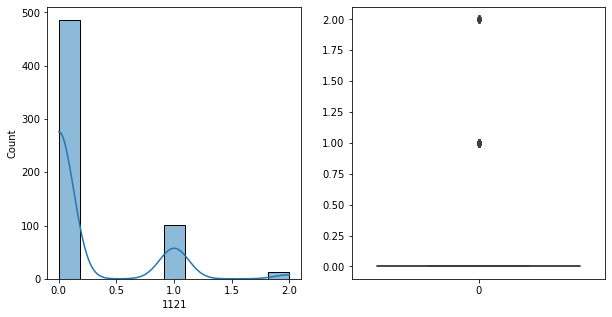

1121   Unique :  [1 0 2]
--------------------------------------------------------------------
1121   N unique :  3
--------------------------------------------------------------------
1121   Value Counts :  0    486
1    101
2     13
Name: 1121, dtype: int64
--------------------------------------------------------------------



[ 1122 ]
show_df_info :  1122


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


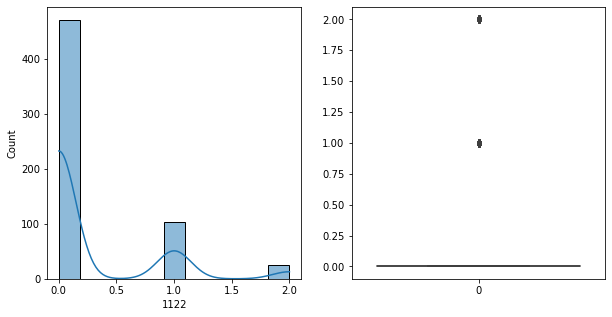

1122   Unique :  [0 1 2]
--------------------------------------------------------------------
1122   N unique :  3
--------------------------------------------------------------------
1122   Value Counts :  0    471
1    103
2     26
Name: 1122, dtype: int64
--------------------------------------------------------------------



[ 1123 ]
show_df_info :  1123


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


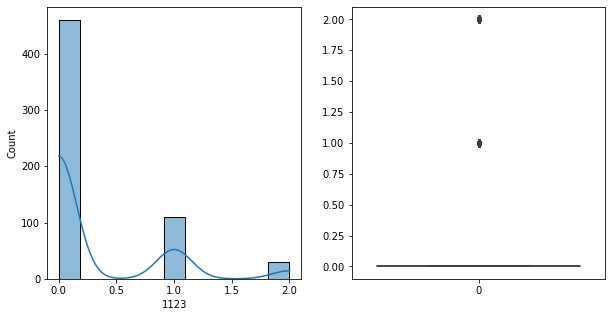

1123   Unique :  [1 0 2]
--------------------------------------------------------------------
1123   N unique :  3
--------------------------------------------------------------------
1123   Value Counts :  0    460
1    110
2     30
Name: 1123, dtype: int64
--------------------------------------------------------------------



[ 1124 ]
show_df_info :  1124


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


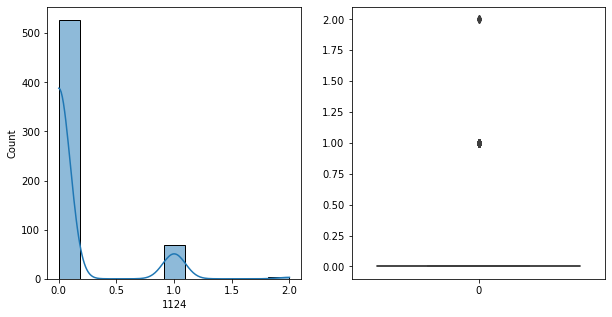

1124   Unique :  [1 0 2]
--------------------------------------------------------------------
1124   N unique :  3
--------------------------------------------------------------------
1124   Value Counts :  0    527
1     69
2      4
Name: 1124, dtype: int64
--------------------------------------------------------------------



[ 1125 ]
show_df_info :  1125


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


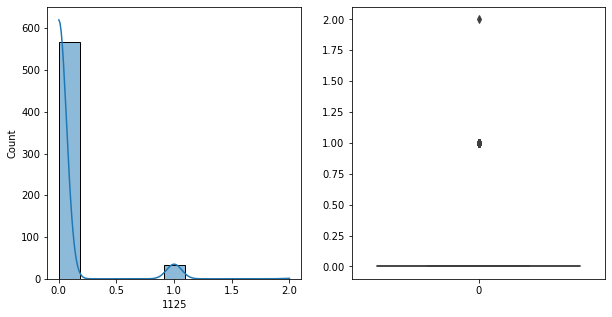

1125   Unique :  [0 1 2]
--------------------------------------------------------------------
1125   N unique :  3
--------------------------------------------------------------------
1125   Value Counts :  0    567
1     32
2      1
Name: 1125, dtype: int64
--------------------------------------------------------------------



[ 1126 ]
show_df_info :  1126


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


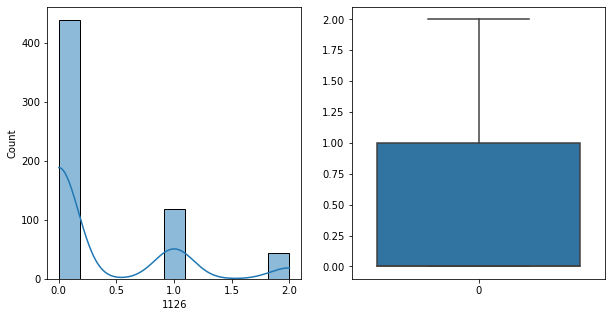

1126   Unique :  [1 0 2]
--------------------------------------------------------------------
1126   N unique :  3
--------------------------------------------------------------------
1126   Value Counts :  0    439
1    118
2     43
Name: 1126, dtype: int64
--------------------------------------------------------------------



[ 1127 ]
show_df_info :  1127


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


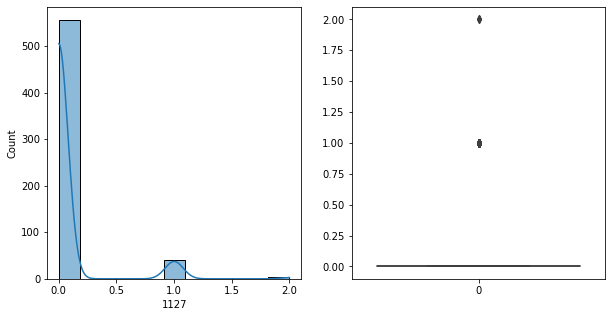

1127   Unique :  [0 1 2]
--------------------------------------------------------------------
1127   N unique :  3
--------------------------------------------------------------------
1127   Value Counts :  0    556
1     41
2      3
Name: 1127, dtype: int64
--------------------------------------------------------------------



[ 1128 ]
show_df_info :  1128


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


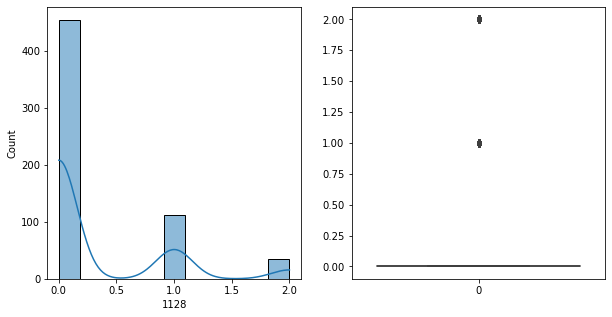

1128   Unique :  [1 0 2]
--------------------------------------------------------------------
1128   N unique :  3
--------------------------------------------------------------------
1128   Value Counts :  0    454
1    112
2     34
Name: 1128, dtype: int64
--------------------------------------------------------------------



[ 1129 ]
show_df_info :  1129


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


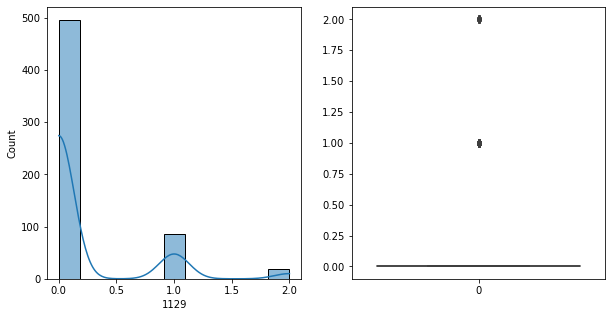

1129   Unique :  [0 1 2]
--------------------------------------------------------------------
1129   N unique :  3
--------------------------------------------------------------------
1129   Value Counts :  0    496
1     86
2     18
Name: 1129, dtype: int64
--------------------------------------------------------------------



[ 1130 ]
show_df_info :  1130


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


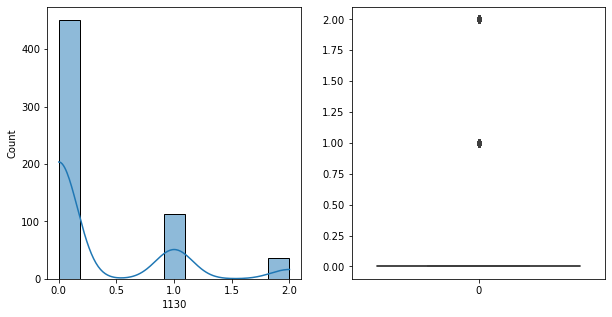

1130   Unique :  [1 0 2]
--------------------------------------------------------------------
1130   N unique :  3
--------------------------------------------------------------------
1130   Value Counts :  0    451
1    113
2     36
Name: 1130, dtype: int64
--------------------------------------------------------------------



[ 1131 ]
show_df_info :  1131


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


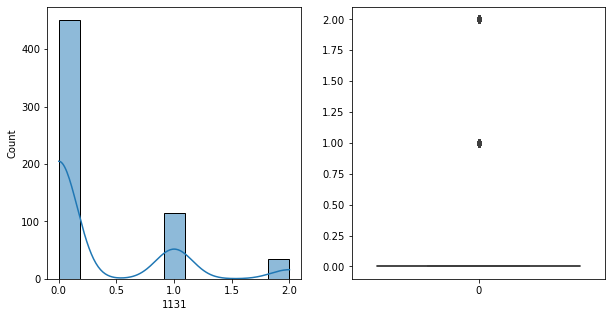

1131   Unique :  [1 0 2]
--------------------------------------------------------------------
1131   N unique :  3
--------------------------------------------------------------------
1131   Value Counts :  0    451
1    114
2     35
Name: 1131, dtype: int64
--------------------------------------------------------------------



[ 1132 ]
show_df_info :  1132


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


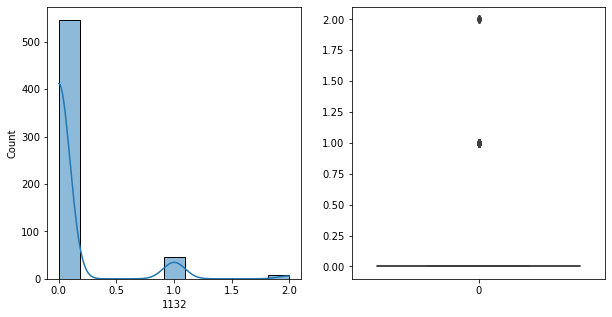

1132   Unique :  [1 0 2]
--------------------------------------------------------------------
1132   N unique :  3
--------------------------------------------------------------------
1132   Value Counts :  0    546
1     46
2      8
Name: 1132, dtype: int64
--------------------------------------------------------------------



[ 1133 ]
show_df_info :  1133


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


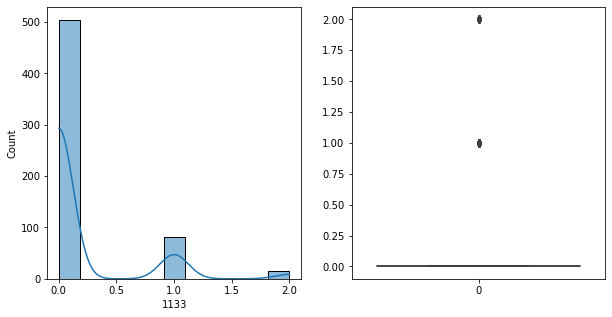

1133   Unique :  [0 1 2]
--------------------------------------------------------------------
1133   N unique :  3
--------------------------------------------------------------------
1133   Value Counts :  0    504
1     81
2     15
Name: 1133, dtype: int64
--------------------------------------------------------------------



[ 1134 ]
show_df_info :  1134


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


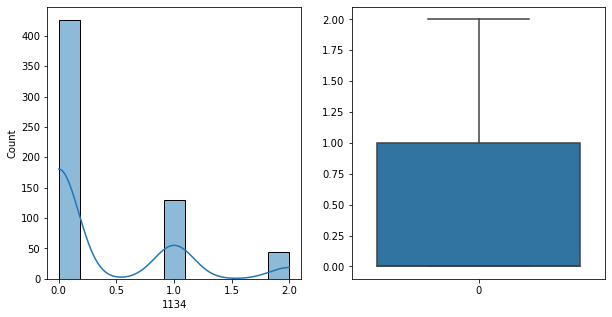

1134   Unique :  [1 0 2]
--------------------------------------------------------------------
1134   N unique :  3
--------------------------------------------------------------------
1134   Value Counts :  0    426
1    130
2     44
Name: 1134, dtype: int64
--------------------------------------------------------------------



[ 1135 ]
show_df_info :  1135


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


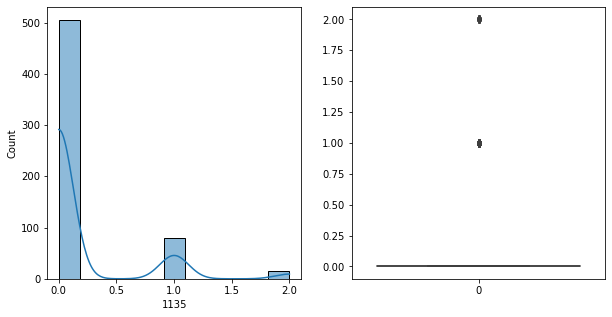

1135   Unique :  [0 1 2]
--------------------------------------------------------------------
1135   N unique :  3
--------------------------------------------------------------------
1135   Value Counts :  0    505
1     79
2     16
Name: 1135, dtype: int64
--------------------------------------------------------------------



[ 1136 ]
show_df_info :  1136


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


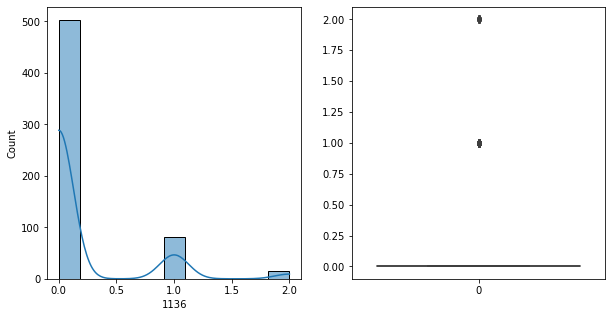

1136   Unique :  [0 1 2]
--------------------------------------------------------------------
1136   N unique :  3
--------------------------------------------------------------------
1136   Value Counts :  0    503
1     81
2     16
Name: 1136, dtype: int64
--------------------------------------------------------------------



[ 1137 ]
show_df_info :  1137


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


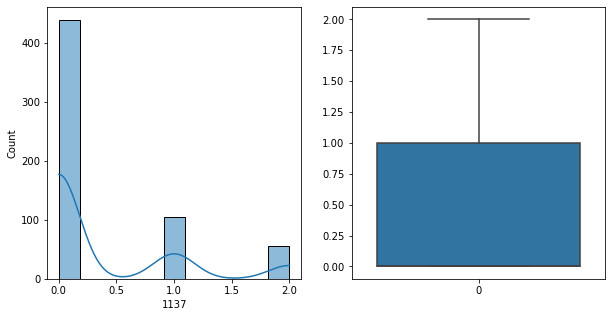

1137   Unique :  [0 1 2]
--------------------------------------------------------------------
1137   N unique :  3
--------------------------------------------------------------------
1137   Value Counts :  0    439
1    105
2     56
Name: 1137, dtype: int64
--------------------------------------------------------------------



[ 1138 ]
show_df_info :  1138


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


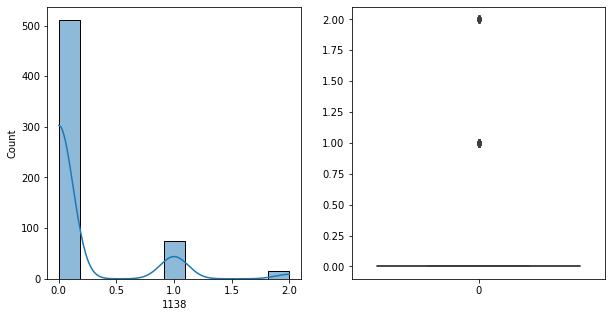

1138   Unique :  [0 1 2]
--------------------------------------------------------------------
1138   N unique :  3
--------------------------------------------------------------------
1138   Value Counts :  0    511
1     74
2     15
Name: 1138, dtype: int64
--------------------------------------------------------------------



[ 1139 ]
show_df_info :  1139


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


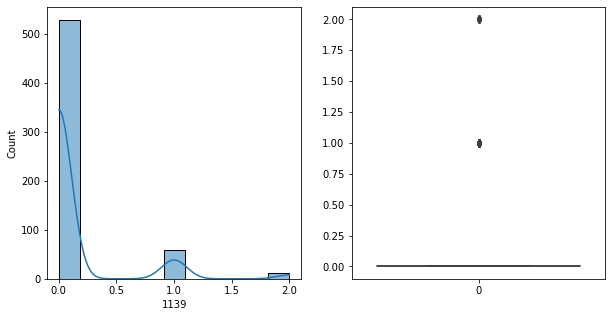

1139   Unique :  [1 0 2]
--------------------------------------------------------------------
1139   N unique :  3
--------------------------------------------------------------------
1139   Value Counts :  0    529
1     59
2     12
Name: 1139, dtype: int64
--------------------------------------------------------------------



[ 1140 ]
show_df_info :  1140


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


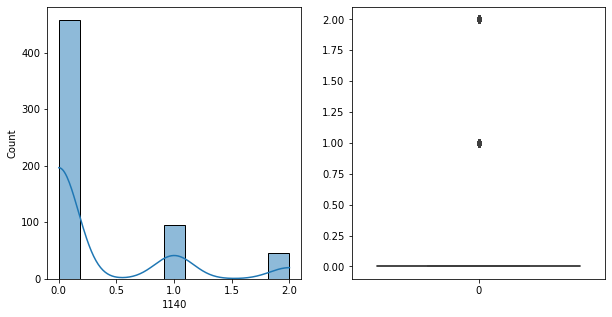

1140   Unique :  [2 0 1]
--------------------------------------------------------------------
1140   N unique :  3
--------------------------------------------------------------------
1140   Value Counts :  0    458
1     96
2     46
Name: 1140, dtype: int64
--------------------------------------------------------------------



[ 1141 ]
show_df_info :  1141


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


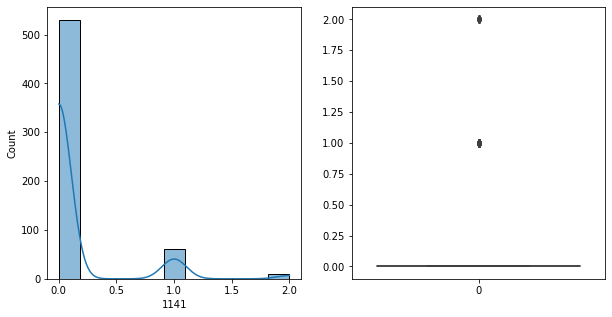

1141   Unique :  [1 0 2]
--------------------------------------------------------------------
1141   N unique :  3
--------------------------------------------------------------------
1141   Value Counts :  0    530
1     60
2     10
Name: 1141, dtype: int64
--------------------------------------------------------------------



[ 1142 ]
show_df_info :  1142


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


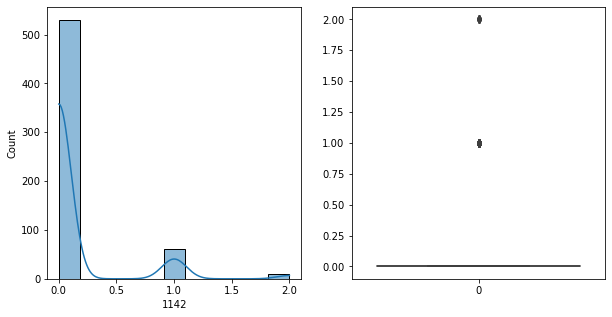

1142   Unique :  [1 0 2]
--------------------------------------------------------------------
1142   N unique :  3
--------------------------------------------------------------------
1142   Value Counts :  0    530
1     60
2     10
Name: 1142, dtype: int64
--------------------------------------------------------------------



[ 1143 ]
show_df_info :  1143


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


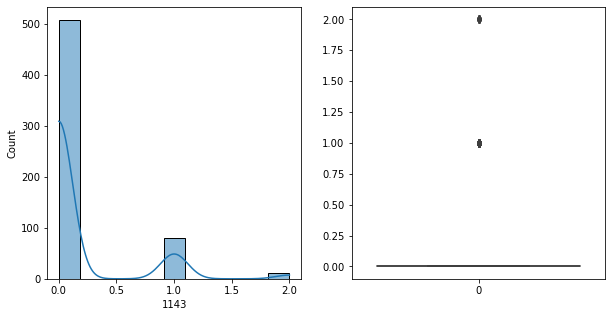

1143   Unique :  [1 0 2]
--------------------------------------------------------------------
1143   N unique :  3
--------------------------------------------------------------------
1143   Value Counts :  0    508
1     80
2     12
Name: 1143, dtype: int64
--------------------------------------------------------------------



[ 1144 ]
show_df_info :  1144


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


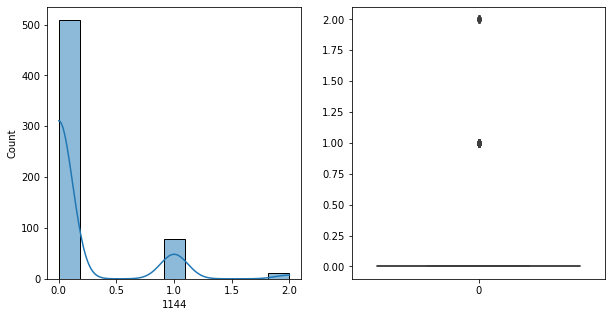

1144   Unique :  [1 0 2]
--------------------------------------------------------------------
1144   N unique :  3
--------------------------------------------------------------------
1144   Value Counts :  0    509
1     79
2     12
Name: 1144, dtype: int64
--------------------------------------------------------------------



[ 1145 ]
show_df_info :  1145


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


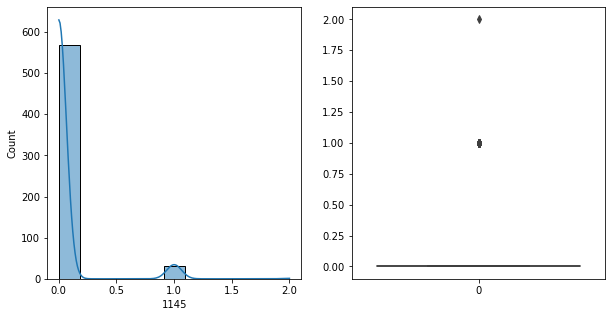

1145   Unique :  [0 1 2]
--------------------------------------------------------------------
1145   N unique :  3
--------------------------------------------------------------------
1145   Value Counts :  0    568
1     31
2      1
Name: 1145, dtype: int64
--------------------------------------------------------------------



[ 1146 ]
show_df_info :  1146


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


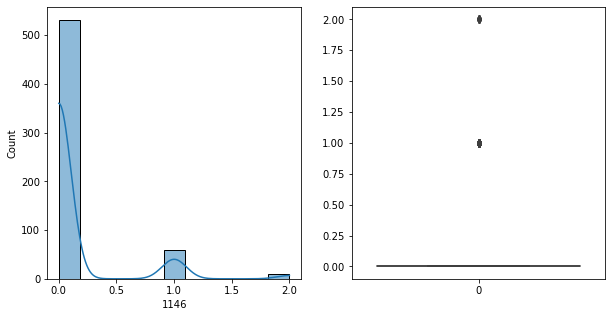

1146   Unique :  [1 0 2]
--------------------------------------------------------------------
1146   N unique :  3
--------------------------------------------------------------------
1146   Value Counts :  0    531
1     59
2     10
Name: 1146, dtype: int64
--------------------------------------------------------------------



[ 1147 ]
show_df_info :  1147


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


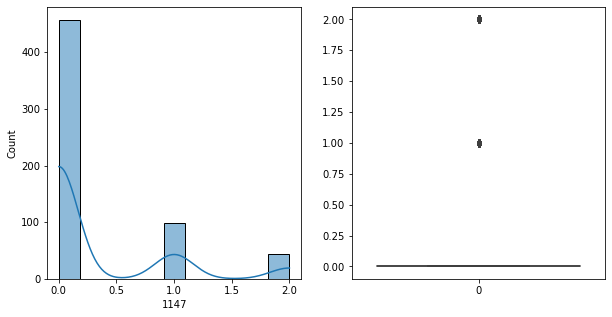

1147   Unique :  [2 0 1]
--------------------------------------------------------------------
1147   N unique :  3
--------------------------------------------------------------------
1147   Value Counts :  0    457
1     99
2     44
Name: 1147, dtype: int64
--------------------------------------------------------------------



[ 1148 ]
show_df_info :  1148


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


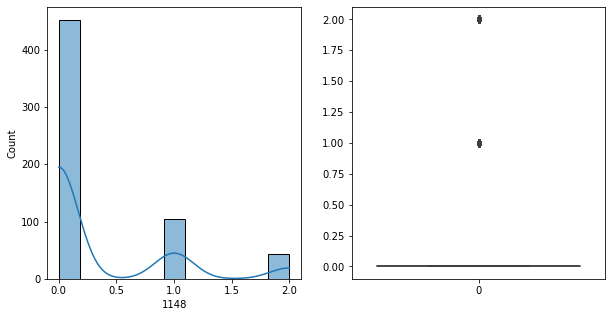

1148   Unique :  [0 1 2]
--------------------------------------------------------------------
1148   N unique :  3
--------------------------------------------------------------------
1148   Value Counts :  0    452
1    104
2     44
Name: 1148, dtype: int64
--------------------------------------------------------------------



[ 1149 ]
show_df_info :  1149


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


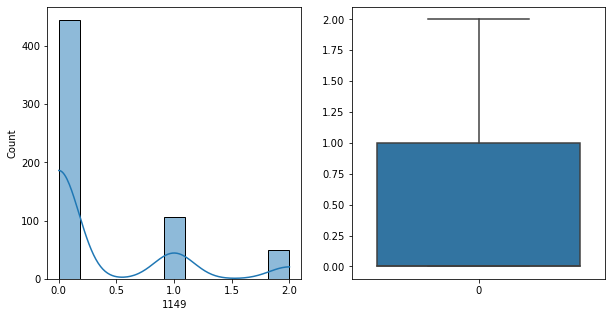

1149   Unique :  [1 0 2]
--------------------------------------------------------------------
1149   N unique :  3
--------------------------------------------------------------------
1149   Value Counts :  0    445
1    106
2     49
Name: 1149, dtype: int64
--------------------------------------------------------------------



[ 1150 ]
show_df_info :  1150


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


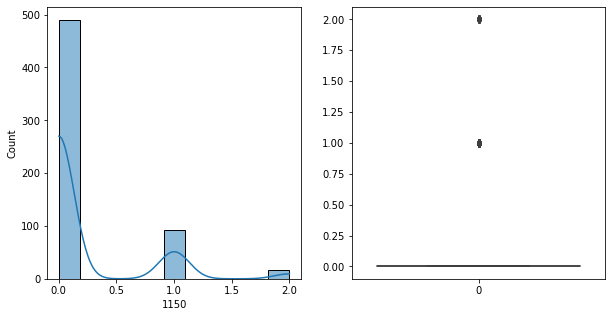

1150   Unique :  [0 1 2]
--------------------------------------------------------------------
1150   N unique :  3
--------------------------------------------------------------------
1150   Value Counts :  0    490
1     93
2     17
Name: 1150, dtype: int64
--------------------------------------------------------------------



[ 1151 ]
show_df_info :  1151


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


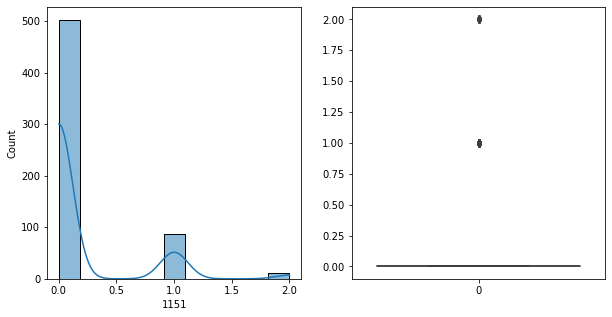

1151   Unique :  [0 1 2]
--------------------------------------------------------------------
1151   N unique :  3
--------------------------------------------------------------------
1151   Value Counts :  0    502
1     86
2     12
Name: 1151, dtype: int64
--------------------------------------------------------------------



[ 1152 ]
show_df_info :  1152


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


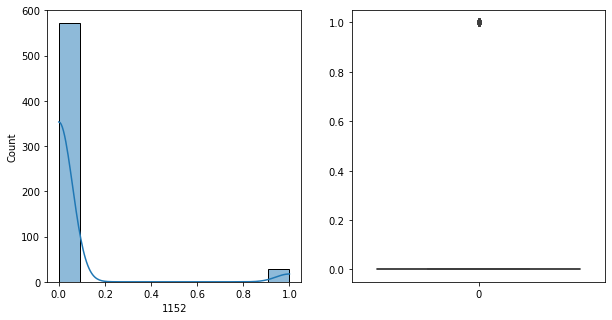

1152   Unique :  [0 1]
--------------------------------------------------------------------
1152   N unique :  2
--------------------------------------------------------------------
1152   Value Counts :  0    572
1     28
Name: 1152, dtype: int64
--------------------------------------------------------------------



[ 1153 ]
show_df_info :  1153


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


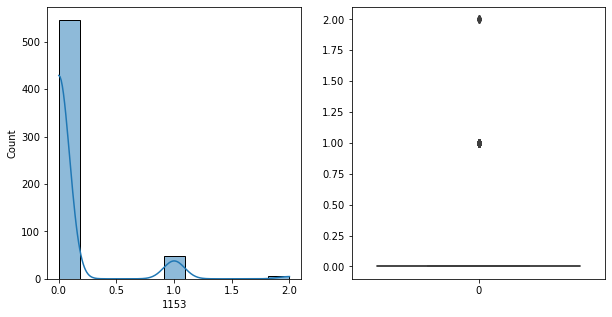

1153   Unique :  [1 0 2]
--------------------------------------------------------------------
1153   N unique :  3
--------------------------------------------------------------------
1153   Value Counts :  0    546
1     48
2      6
Name: 1153, dtype: int64
--------------------------------------------------------------------



[ 1154 ]
show_df_info :  1154


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


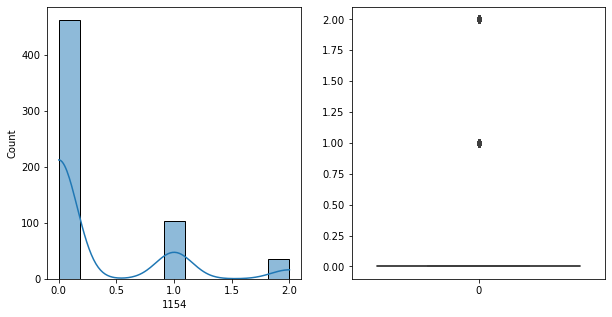

1154   Unique :  [1 0 2]
--------------------------------------------------------------------
1154   N unique :  3
--------------------------------------------------------------------
1154   Value Counts :  0    462
1    103
2     35
Name: 1154, dtype: int64
--------------------------------------------------------------------



[ 1155 ]
show_df_info :  1155


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


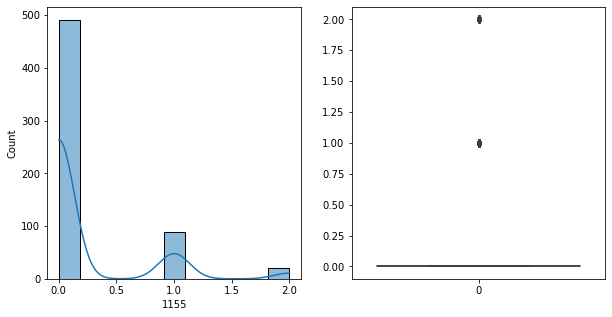

1155   Unique :  [0 1 2]
--------------------------------------------------------------------
1155   N unique :  3
--------------------------------------------------------------------
1155   Value Counts :  0    491
1     89
2     20
Name: 1155, dtype: int64
--------------------------------------------------------------------



[ 1156 ]
show_df_info :  1156


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


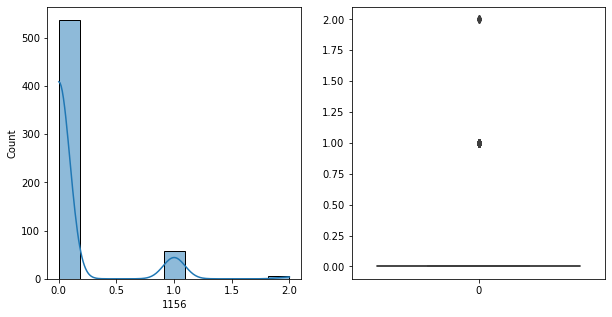

1156   Unique :  [0 1 2]
--------------------------------------------------------------------
1156   N unique :  3
--------------------------------------------------------------------
1156   Value Counts :  0    537
1     58
2      5
Name: 1156, dtype: int64
--------------------------------------------------------------------



[ 1157 ]
show_df_info :  1157


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


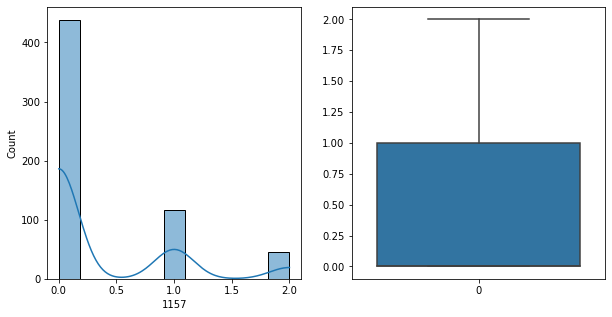

1157   Unique :  [2 0 1]
--------------------------------------------------------------------
1157   N unique :  3
--------------------------------------------------------------------
1157   Value Counts :  0    438
1    117
2     45
Name: 1157, dtype: int64
--------------------------------------------------------------------



[ 1158 ]
show_df_info :  1158


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


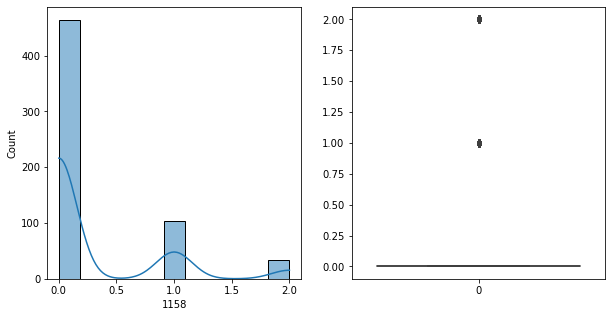

1158   Unique :  [2 0 1]
--------------------------------------------------------------------
1158   N unique :  3
--------------------------------------------------------------------
1158   Value Counts :  0    464
1    103
2     33
Name: 1158, dtype: int64
--------------------------------------------------------------------



[ 1159 ]
show_df_info :  1159


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


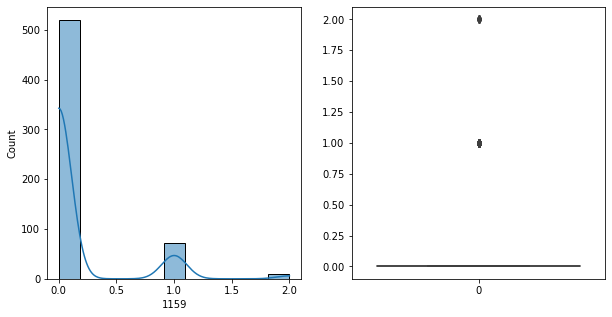

1159   Unique :  [0 1 2]
--------------------------------------------------------------------
1159   N unique :  3
--------------------------------------------------------------------
1159   Value Counts :  0    520
1     71
2      9
Name: 1159, dtype: int64
--------------------------------------------------------------------



[ 1160 ]
show_df_info :  1160


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


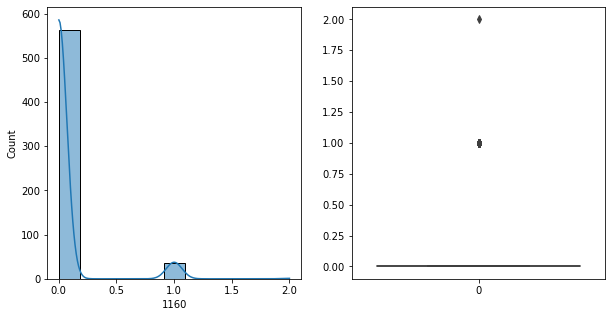

1160   Unique :  [0 2 1]
--------------------------------------------------------------------
1160   N unique :  3
--------------------------------------------------------------------
1160   Value Counts :  0    563
1     36
2      1
Name: 1160, dtype: int64
--------------------------------------------------------------------



[ 1161 ]
show_df_info :  1161


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


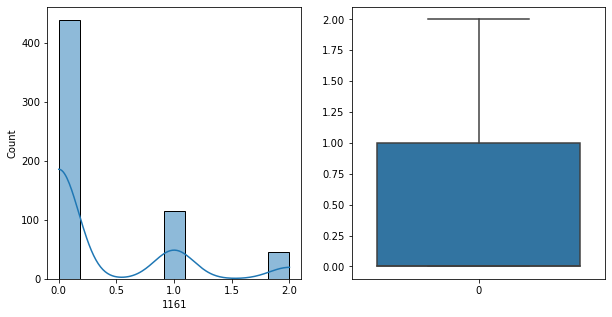

1161   Unique :  [2 0 1]
--------------------------------------------------------------------
1161   N unique :  3
--------------------------------------------------------------------
1161   Value Counts :  0    439
1    115
2     46
Name: 1161, dtype: int64
--------------------------------------------------------------------



[ 1162 ]
show_df_info :  1162


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


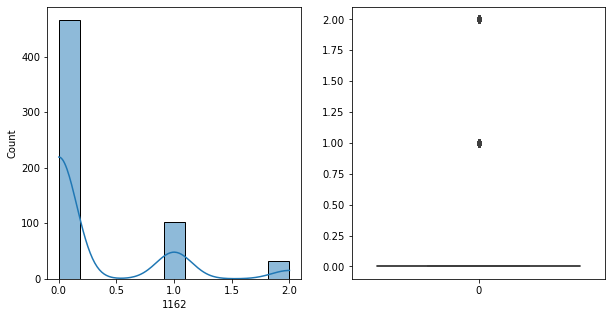

1162   Unique :  [0 2 1]
--------------------------------------------------------------------
1162   N unique :  3
--------------------------------------------------------------------
1162   Value Counts :  0    466
1    102
2     32
Name: 1162, dtype: int64
--------------------------------------------------------------------



[ 1163 ]
show_df_info :  1163


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


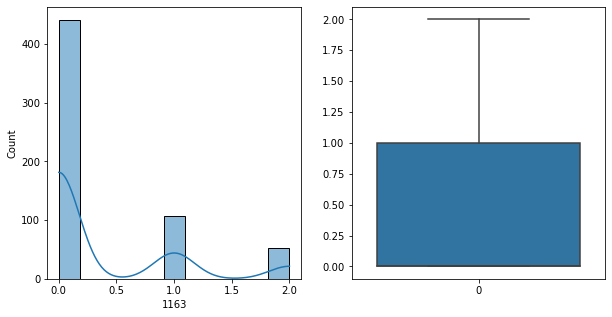

1163   Unique :  [0 2 1]
--------------------------------------------------------------------
1163   N unique :  3
--------------------------------------------------------------------
1163   Value Counts :  0    441
1    107
2     52
Name: 1163, dtype: int64
--------------------------------------------------------------------



[ 1164 ]
show_df_info :  1164


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


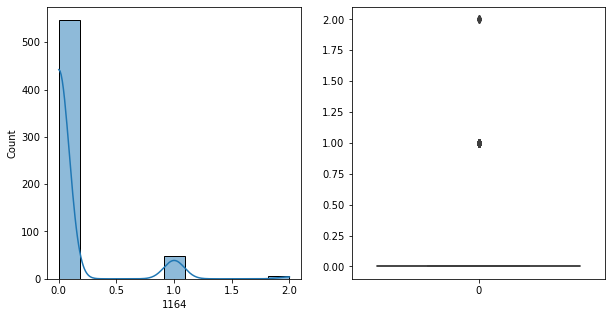

1164   Unique :  [0 2 1]
--------------------------------------------------------------------
1164   N unique :  3
--------------------------------------------------------------------
1164   Value Counts :  0    547
1     48
2      5
Name: 1164, dtype: int64
--------------------------------------------------------------------



[ 1165 ]
show_df_info :  1165


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


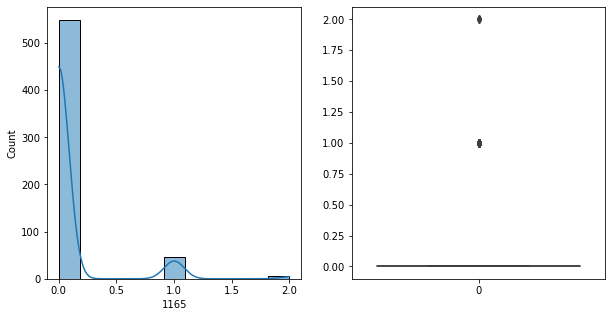

1165   Unique :  [0 2 1]
--------------------------------------------------------------------
1165   N unique :  3
--------------------------------------------------------------------
1165   Value Counts :  0    549
1     46
2      5
Name: 1165, dtype: int64
--------------------------------------------------------------------



[ 1166 ]
show_df_info :  1166


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


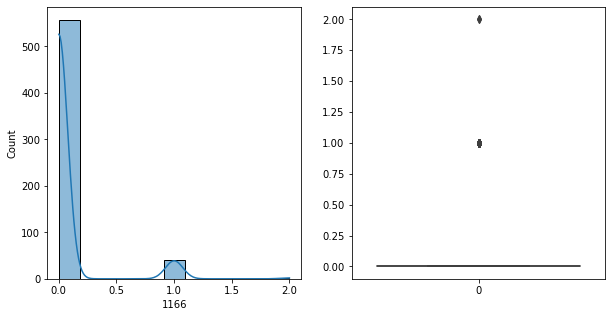

1166   Unique :  [0 2 1]
--------------------------------------------------------------------
1166   N unique :  3
--------------------------------------------------------------------
1166   Value Counts :  0    557
1     41
2      2
Name: 1166, dtype: int64
--------------------------------------------------------------------



[ 1167 ]
show_df_info :  1167


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


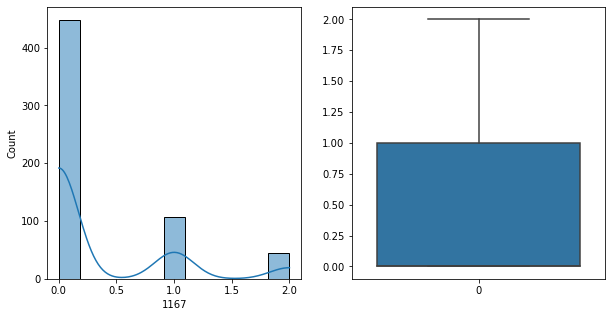

1167   Unique :  [1 0 2]
--------------------------------------------------------------------
1167   N unique :  3
--------------------------------------------------------------------
1167   Value Counts :  0    448
1    107
2     45
Name: 1167, dtype: int64
--------------------------------------------------------------------



[ 1168 ]
show_df_info :  1168


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


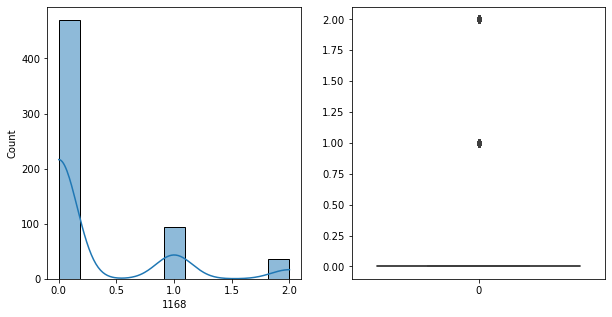

1168   Unique :  [0 1 2]
--------------------------------------------------------------------
1168   N unique :  3
--------------------------------------------------------------------
1168   Value Counts :  0    470
1     94
2     36
Name: 1168, dtype: int64
--------------------------------------------------------------------



[ 1169 ]
show_df_info :  1169


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


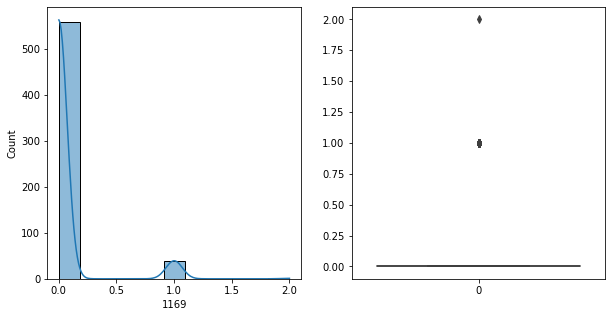

1169   Unique :  [0 1 2]
--------------------------------------------------------------------
1169   N unique :  3
--------------------------------------------------------------------
1169   Value Counts :  0    560
1     39
2      1
Name: 1169, dtype: int64
--------------------------------------------------------------------



[ 1170 ]
show_df_info :  1170


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


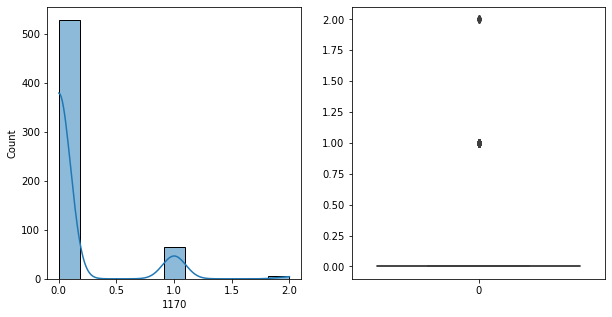

1170   Unique :  [0 1 2]
--------------------------------------------------------------------
1170   N unique :  3
--------------------------------------------------------------------
1170   Value Counts :  0    529
1     65
2      6
Name: 1170, dtype: int64
--------------------------------------------------------------------



[ 1171 ]
show_df_info :  1171


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


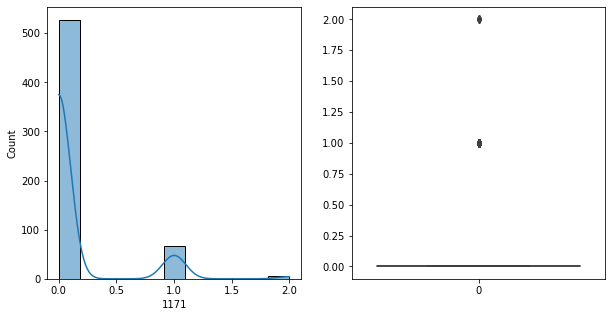

1171   Unique :  [0 2 1]
--------------------------------------------------------------------
1171   N unique :  3
--------------------------------------------------------------------
1171   Value Counts :  0    527
1     67
2      6
Name: 1171, dtype: int64
--------------------------------------------------------------------



[ 1172 ]
show_df_info :  1172


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


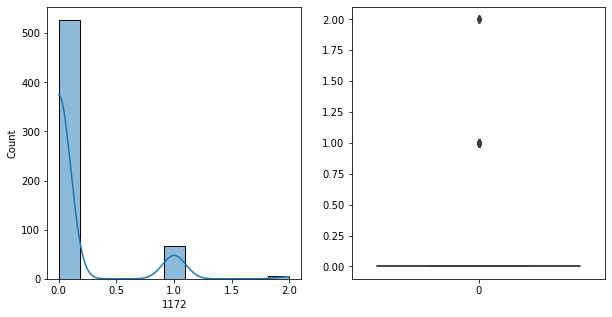

1172   Unique :  [0 2 1]
--------------------------------------------------------------------
1172   N unique :  3
--------------------------------------------------------------------
1172   Value Counts :  0    527
1     67
2      6
Name: 1172, dtype: int64
--------------------------------------------------------------------



[ 1173 ]
show_df_info :  1173


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


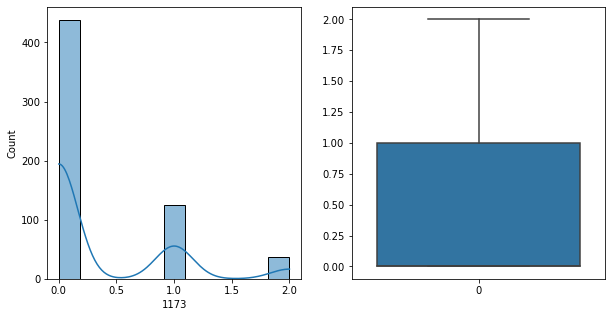

1173   Unique :  [2 0 1]
--------------------------------------------------------------------
1173   N unique :  3
--------------------------------------------------------------------
1173   Value Counts :  0    438
1    125
2     37
Name: 1173, dtype: int64
--------------------------------------------------------------------



[ 1174 ]
show_df_info :  1174


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


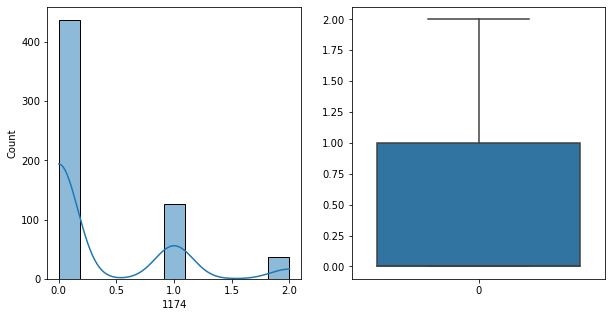

1174   Unique :  [2 0 1]
--------------------------------------------------------------------
1174   N unique :  3
--------------------------------------------------------------------
1174   Value Counts :  0    437
1    126
2     37
Name: 1174, dtype: int64
--------------------------------------------------------------------



[ 1175 ]
show_df_info :  1175


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


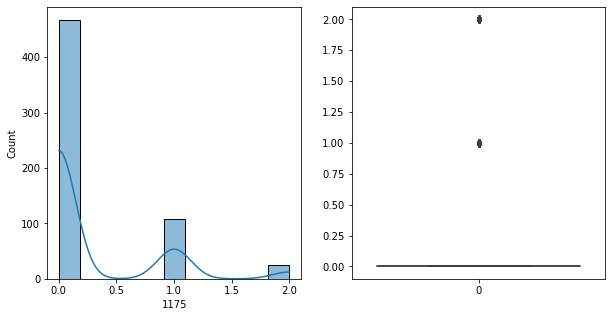

1175   Unique :  [2 0 1]
--------------------------------------------------------------------
1175   N unique :  3
--------------------------------------------------------------------
1175   Value Counts :  0    467
1    108
2     25
Name: 1175, dtype: int64
--------------------------------------------------------------------



[ 1176 ]
show_df_info :  1176


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


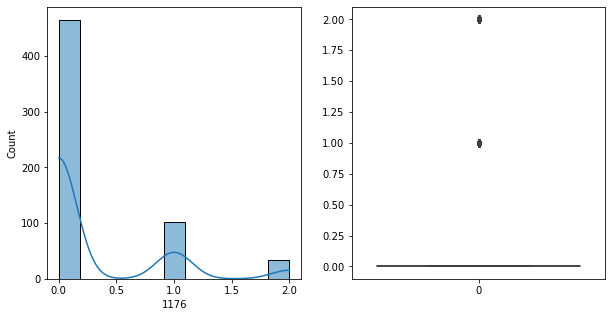

1176   Unique :  [0 1 2]
--------------------------------------------------------------------
1176   N unique :  3
--------------------------------------------------------------------
1176   Value Counts :  0    465
1    102
2     33
Name: 1176, dtype: int64
--------------------------------------------------------------------



[ 1177 ]
show_df_info :  1177


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


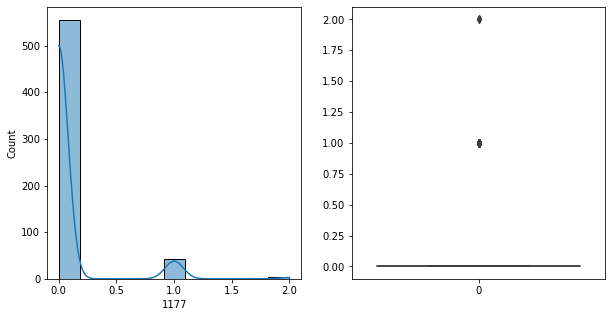

1177   Unique :  [0 2 1]
--------------------------------------------------------------------
1177   N unique :  3
--------------------------------------------------------------------
1177   Value Counts :  0    555
1     42
2      3
Name: 1177, dtype: int64
--------------------------------------------------------------------



[ 1178 ]
show_df_info :  1178


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


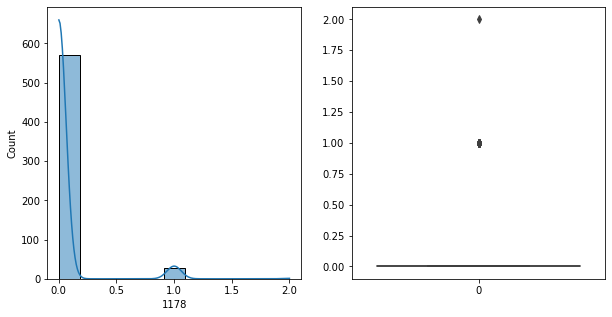

1178   Unique :  [0 1 2]
--------------------------------------------------------------------
1178   N unique :  3
--------------------------------------------------------------------
1178   Value Counts :  0    571
1     28
2      1
Name: 1178, dtype: int64
--------------------------------------------------------------------



[ 1179 ]
show_df_info :  1179


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


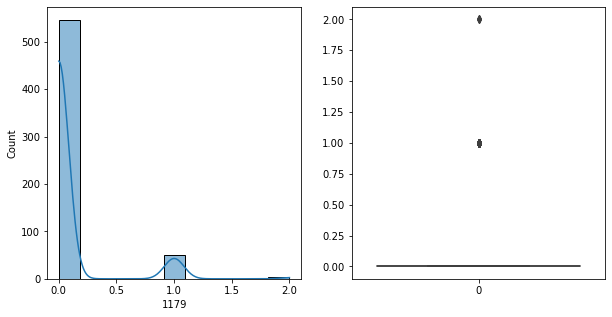

1179   Unique :  [0 2 1]
--------------------------------------------------------------------
1179   N unique :  3
--------------------------------------------------------------------
1179   Value Counts :  0    546
1     51
2      3
Name: 1179, dtype: int64
--------------------------------------------------------------------



[ 1180 ]
show_df_info :  1180


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


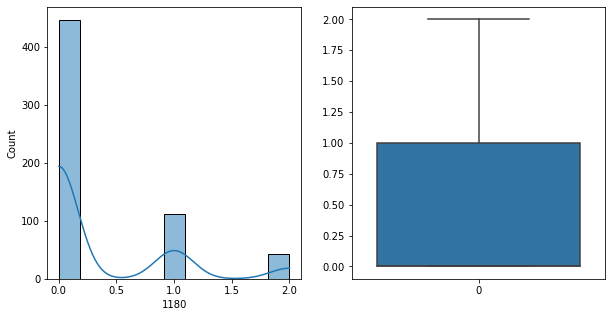

1180   Unique :  [1 0 2]
--------------------------------------------------------------------
1180   N unique :  3
--------------------------------------------------------------------
1180   Value Counts :  0    446
1    112
2     42
Name: 1180, dtype: int64
--------------------------------------------------------------------



[ 1181 ]
show_df_info :  1181


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


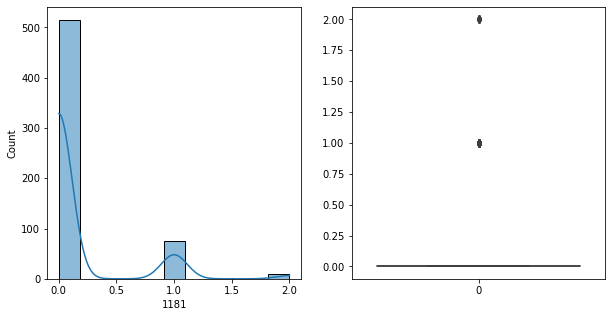

1181   Unique :  [1 0 2]
--------------------------------------------------------------------
1181   N unique :  3
--------------------------------------------------------------------
1181   Value Counts :  0    515
1     75
2     10
Name: 1181, dtype: int64
--------------------------------------------------------------------



[ 1182 ]
show_df_info :  1182


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


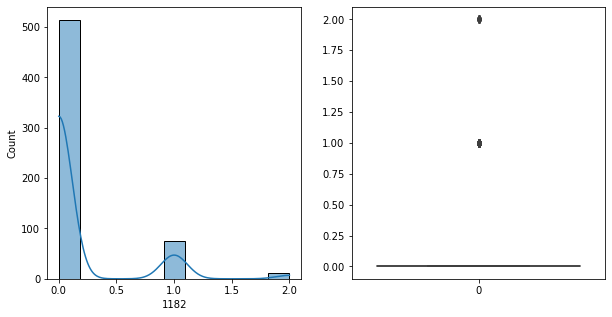

1182   Unique :  [1 0 2]
--------------------------------------------------------------------
1182   N unique :  3
--------------------------------------------------------------------
1182   Value Counts :  0    514
1     75
2     11
Name: 1182, dtype: int64
--------------------------------------------------------------------



[ 1183 ]
show_df_info :  1183


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


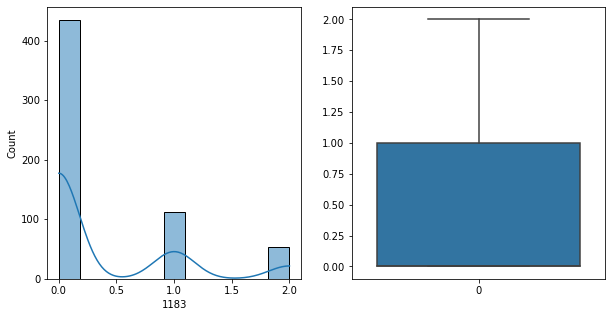

1183   Unique :  [1 0 2]
--------------------------------------------------------------------
1183   N unique :  3
--------------------------------------------------------------------
1183   Value Counts :  0    435
1    112
2     53
Name: 1183, dtype: int64
--------------------------------------------------------------------



[ 1184 ]
show_df_info :  1184


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


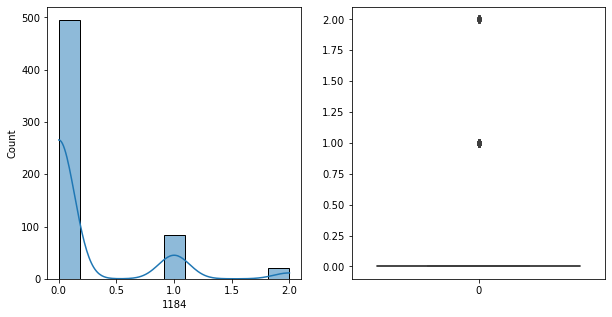

1184   Unique :  [0 1 2]
--------------------------------------------------------------------
1184   N unique :  3
--------------------------------------------------------------------
1184   Value Counts :  0    495
1     84
2     21
Name: 1184, dtype: int64
--------------------------------------------------------------------



[ 1185 ]
show_df_info :  1185


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


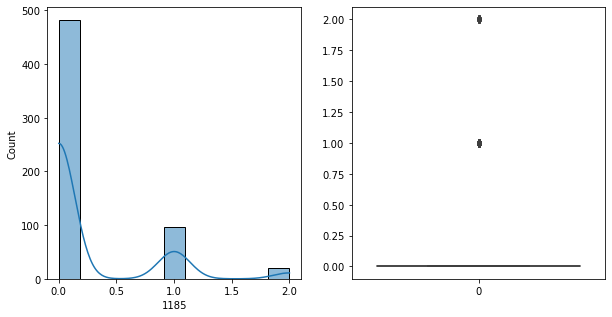

1185   Unique :  [1 0 2]
--------------------------------------------------------------------
1185   N unique :  3
--------------------------------------------------------------------
1185   Value Counts :  0    482
1     97
2     21
Name: 1185, dtype: int64
--------------------------------------------------------------------



[ 1186 ]
show_df_info :  1186


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


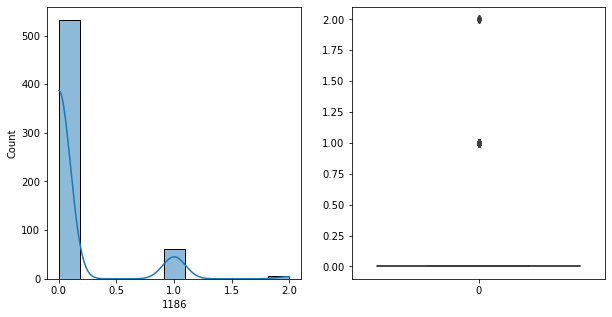

1186   Unique :  [0 1 2]
--------------------------------------------------------------------
1186   N unique :  3
--------------------------------------------------------------------
1186   Value Counts :  0    532
1     62
2      6
Name: 1186, dtype: int64
--------------------------------------------------------------------



[ 1187 ]
show_df_info :  1187


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


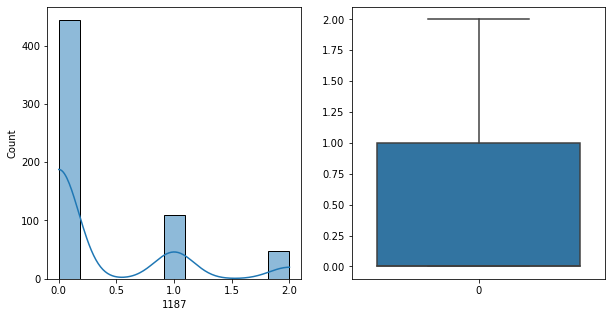

1187   Unique :  [1 0 2]
--------------------------------------------------------------------
1187   N unique :  3
--------------------------------------------------------------------
1187   Value Counts :  0    444
1    109
2     47
Name: 1187, dtype: int64
--------------------------------------------------------------------



[ 1188 ]
show_df_info :  1188


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


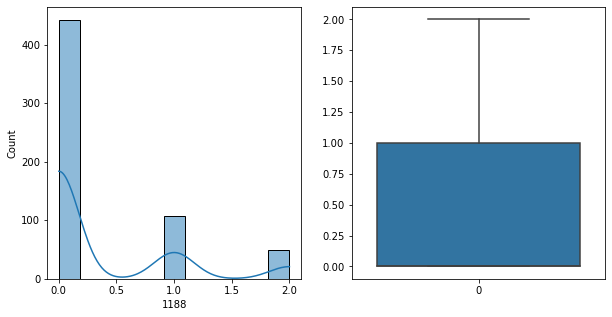

1188   Unique :  [1 0 2]
--------------------------------------------------------------------
1188   N unique :  3
--------------------------------------------------------------------
1188   Value Counts :  0    442
1    108
2     50
Name: 1188, dtype: int64
--------------------------------------------------------------------



[ 1189 ]
show_df_info :  1189


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


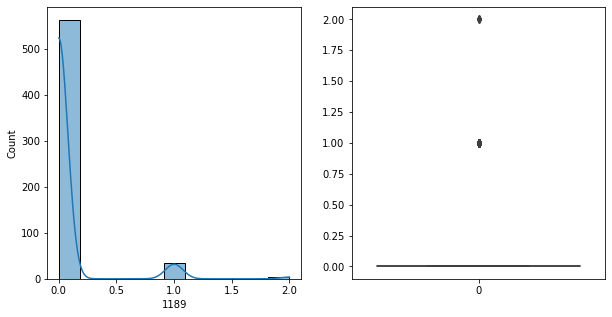

1189   Unique :  [0 1 2]
--------------------------------------------------------------------
1189   N unique :  3
--------------------------------------------------------------------
1189   Value Counts :  0    562
1     34
2      4
Name: 1189, dtype: int64
--------------------------------------------------------------------



[ 1190 ]
show_df_info :  1190


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


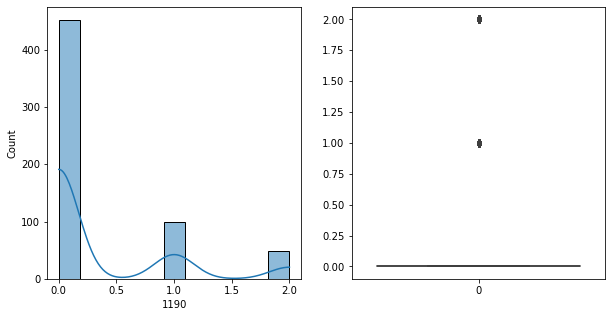

1190   Unique :  [1 0 2]
--------------------------------------------------------------------
1190   N unique :  3
--------------------------------------------------------------------
1190   Value Counts :  0    452
1    100
2     48
Name: 1190, dtype: int64
--------------------------------------------------------------------



[ 1191 ]
show_df_info :  1191


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


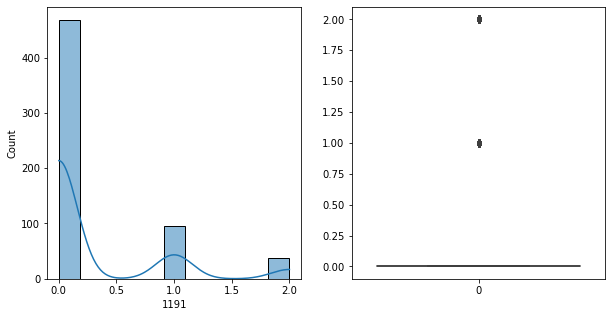

1191   Unique :  [1 0 2]
--------------------------------------------------------------------
1191   N unique :  3
--------------------------------------------------------------------
1191   Value Counts :  0    468
1     95
2     37
Name: 1191, dtype: int64
--------------------------------------------------------------------



[ 1192 ]
show_df_info :  1192


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


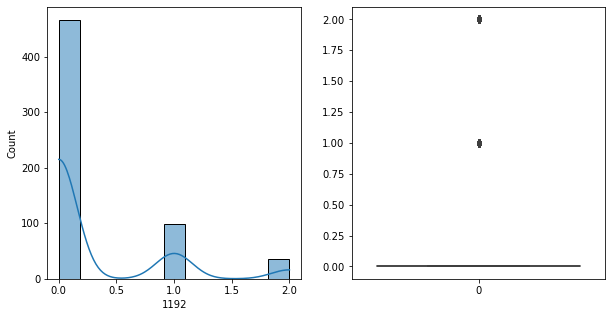

1192   Unique :  [1 0 2]
--------------------------------------------------------------------
1192   N unique :  3
--------------------------------------------------------------------
1192   Value Counts :  0    466
1     99
2     35
Name: 1192, dtype: int64
--------------------------------------------------------------------



[ 1193 ]
show_df_info :  1193


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


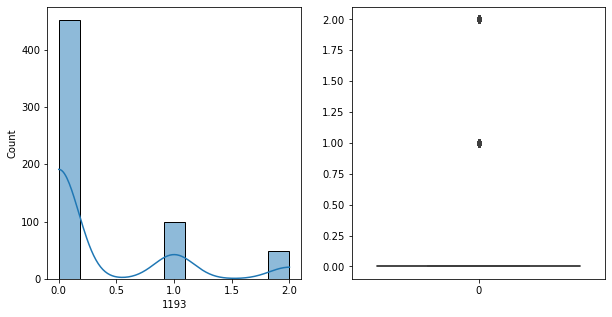

1193   Unique :  [1 0 2]
--------------------------------------------------------------------
1193   N unique :  3
--------------------------------------------------------------------
1193   Value Counts :  0    452
1    100
2     48
Name: 1193, dtype: int64
--------------------------------------------------------------------



[ 1194 ]
show_df_info :  1194


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


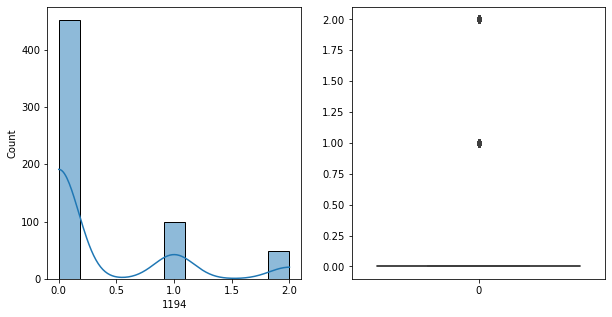

1194   Unique :  [1 0 2]
--------------------------------------------------------------------
1194   N unique :  3
--------------------------------------------------------------------
1194   Value Counts :  0    452
1    100
2     48
Name: 1194, dtype: int64
--------------------------------------------------------------------



[ 1195 ]
show_df_info :  1195


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


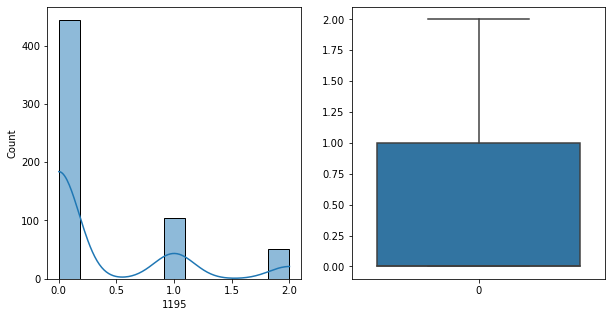

1195   Unique :  [1 0 2]
--------------------------------------------------------------------
1195   N unique :  3
--------------------------------------------------------------------
1195   Value Counts :  0    444
1    105
2     51
Name: 1195, dtype: int64
--------------------------------------------------------------------



[ 1196 ]
show_df_info :  1196


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


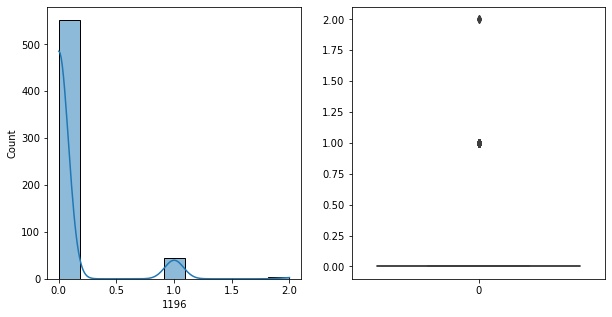

1196   Unique :  [0 1 2]
--------------------------------------------------------------------
1196   N unique :  3
--------------------------------------------------------------------
1196   Value Counts :  0    552
1     45
2      3
Name: 1196, dtype: int64
--------------------------------------------------------------------



[ 1197 ]
show_df_info :  1197


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


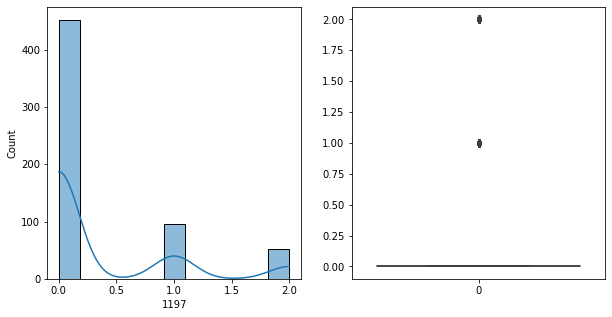

1197   Unique :  [1 0 2]
--------------------------------------------------------------------
1197   N unique :  3
--------------------------------------------------------------------
1197   Value Counts :  0    452
1     96
2     52
Name: 1197, dtype: int64
--------------------------------------------------------------------



[ 1198 ]
show_df_info :  1198


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


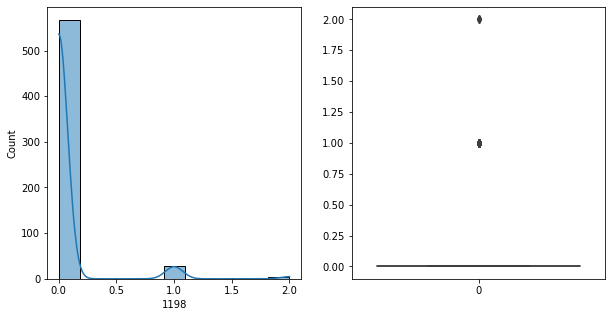

1198   Unique :  [0 1 2]
--------------------------------------------------------------------
1198   N unique :  3
--------------------------------------------------------------------
1198   Value Counts :  0    567
1     28
2      5
Name: 1198, dtype: int64
--------------------------------------------------------------------



[ 1199 ]
show_df_info :  1199


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


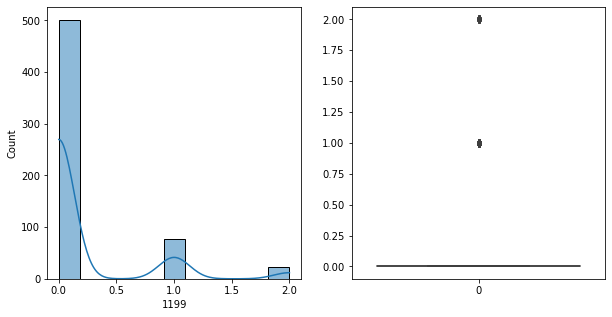

1199   Unique :  [1 0 2]
--------------------------------------------------------------------
1199   N unique :  3
--------------------------------------------------------------------
1199   Value Counts :  0    501
1     77
2     22
Name: 1199, dtype: int64
--------------------------------------------------------------------



[ 1200 ]
show_df_info :  1200


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


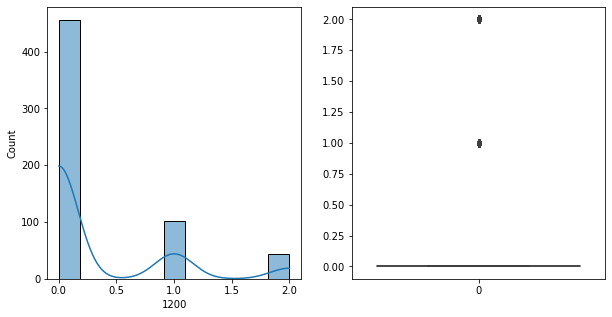

1200   Unique :  [1 0 2]
--------------------------------------------------------------------
1200   N unique :  3
--------------------------------------------------------------------
1200   Value Counts :  0    456
1    101
2     43
Name: 1200, dtype: int64
--------------------------------------------------------------------



[ 1201 ]
show_df_info :  1201


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


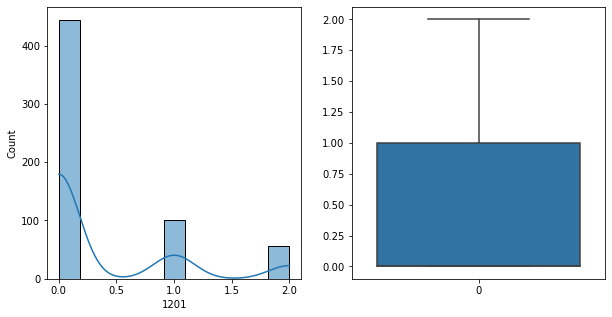

1201   Unique :  [1 0 2]
--------------------------------------------------------------------
1201   N unique :  3
--------------------------------------------------------------------
1201   Value Counts :  0    444
1    100
2     56
Name: 1201, dtype: int64
--------------------------------------------------------------------



[ 1202 ]
show_df_info :  1202


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


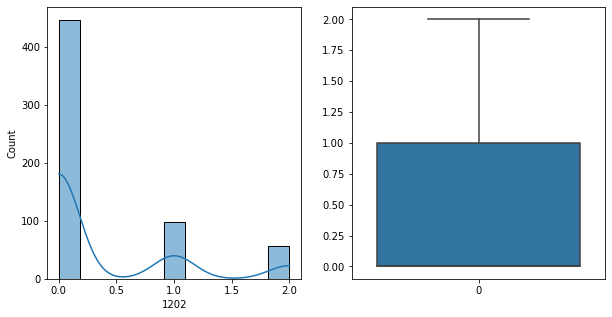

1202   Unique :  [1 0 2]
--------------------------------------------------------------------
1202   N unique :  3
--------------------------------------------------------------------
1202   Value Counts :  0    446
1     98
2     56
Name: 1202, dtype: int64
--------------------------------------------------------------------



[ 1203 ]
show_df_info :  1203


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


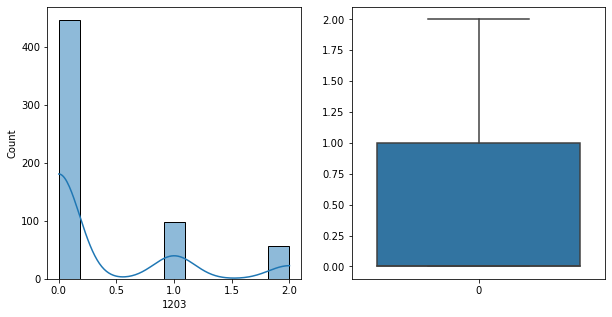

1203   Unique :  [1 0 2]
--------------------------------------------------------------------
1203   N unique :  3
--------------------------------------------------------------------
1203   Value Counts :  0    446
1     98
2     56
Name: 1203, dtype: int64
--------------------------------------------------------------------



[ 1204 ]
show_df_info :  1204


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


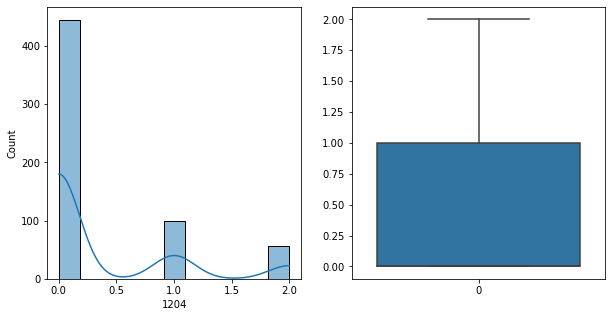

1204   Unique :  [1 0 2]
--------------------------------------------------------------------
1204   N unique :  3
--------------------------------------------------------------------
1204   Value Counts :  0    445
1     99
2     56
Name: 1204, dtype: int64
--------------------------------------------------------------------



[ 1205 ]
show_df_info :  1205


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


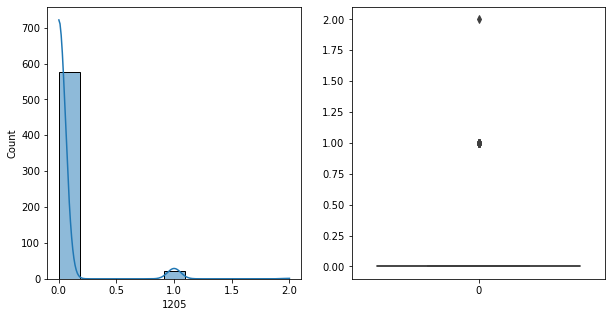

1205   Unique :  [0 1 2]
--------------------------------------------------------------------
1205   N unique :  3
--------------------------------------------------------------------
1205   Value Counts :  0    576
1     23
2      1
Name: 1205, dtype: int64
--------------------------------------------------------------------



[ 1206 ]
show_df_info :  1206


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


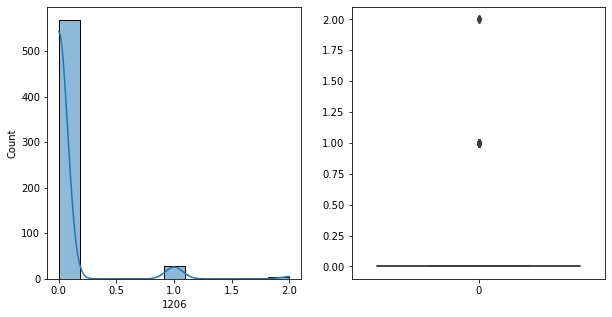

1206   Unique :  [0 1 2]
--------------------------------------------------------------------
1206   N unique :  3
--------------------------------------------------------------------
1206   Value Counts :  0    568
1     27
2      5
Name: 1206, dtype: int64
--------------------------------------------------------------------



[ 1207 ]
show_df_info :  1207


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


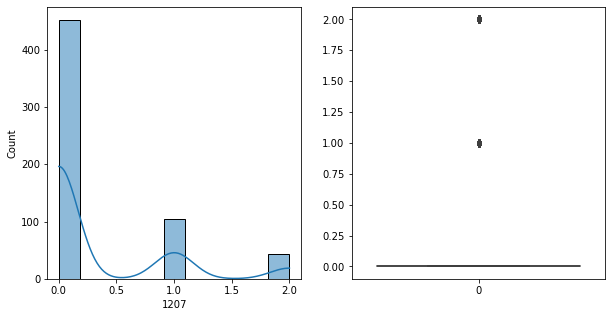

1207   Unique :  [1 0 2]
--------------------------------------------------------------------
1207   N unique :  3
--------------------------------------------------------------------
1207   Value Counts :  0    452
1    105
2     43
Name: 1207, dtype: int64
--------------------------------------------------------------------



[ 1208 ]
show_df_info :  1208


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


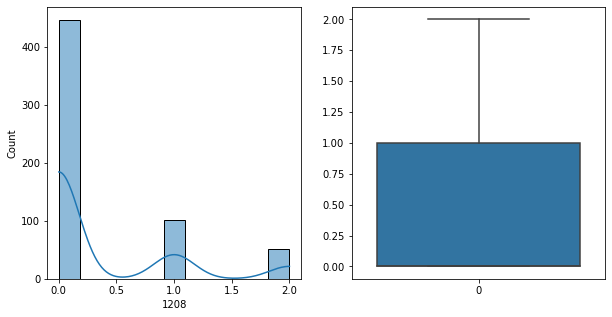

1208   Unique :  [1 0 2]
--------------------------------------------------------------------
1208   N unique :  3
--------------------------------------------------------------------
1208   Value Counts :  0    447
1    101
2     52
Name: 1208, dtype: int64
--------------------------------------------------------------------



[ 1209 ]
show_df_info :  1209


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


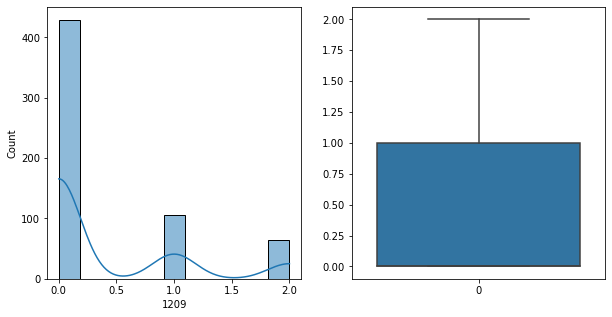

1209   Unique :  [1 0 2]
--------------------------------------------------------------------
1209   N unique :  3
--------------------------------------------------------------------
1209   Value Counts :  0    429
1    106
2     65
Name: 1209, dtype: int64
--------------------------------------------------------------------



[ 1210 ]
show_df_info :  1210


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


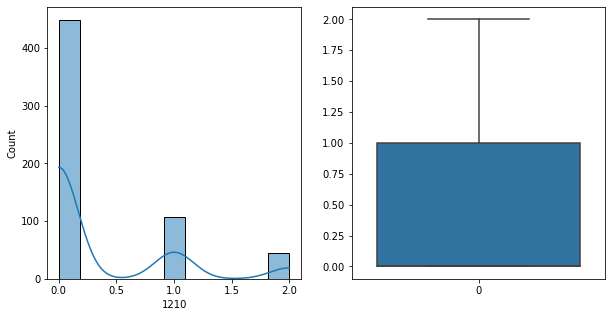

1210   Unique :  [1 0 2]
--------------------------------------------------------------------
1210   N unique :  3
--------------------------------------------------------------------
1210   Value Counts :  0    449
1    107
2     44
Name: 1210, dtype: int64
--------------------------------------------------------------------



[ 1211 ]
show_df_info :  1211


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


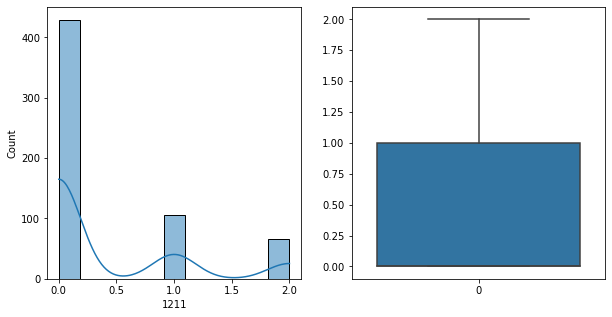

1211   Unique :  [1 0 2]
--------------------------------------------------------------------
1211   N unique :  3
--------------------------------------------------------------------
1211   Value Counts :  0    429
1    105
2     66
Name: 1211, dtype: int64
--------------------------------------------------------------------



[ 1212 ]
show_df_info :  1212


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


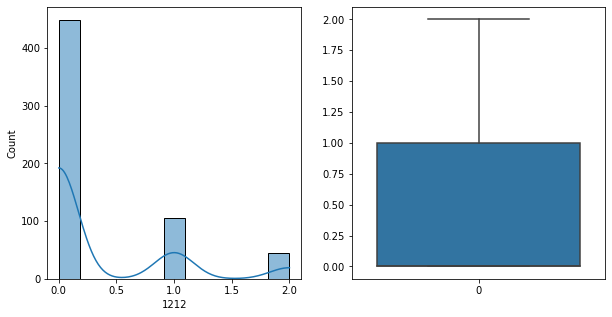

1212   Unique :  [1 0 2]
--------------------------------------------------------------------
1212   N unique :  3
--------------------------------------------------------------------
1212   Value Counts :  0    449
1    106
2     45
Name: 1212, dtype: int64
--------------------------------------------------------------------



[ 1213 ]
show_df_info :  1213


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


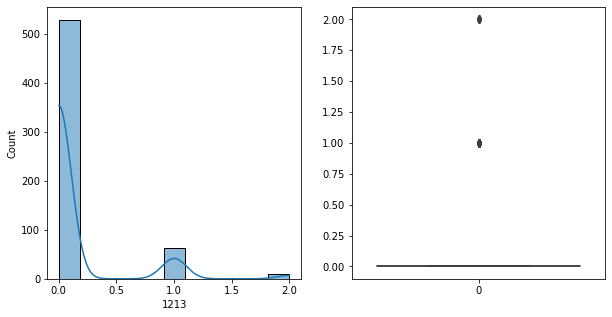

1213   Unique :  [1 0 2]
--------------------------------------------------------------------
1213   N unique :  3
--------------------------------------------------------------------
1213   Value Counts :  0    528
1     62
2     10
Name: 1213, dtype: int64
--------------------------------------------------------------------



[ 1214 ]
show_df_info :  1214


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


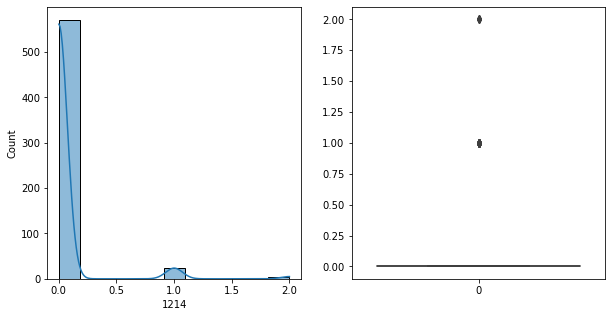

1214   Unique :  [0 1 2]
--------------------------------------------------------------------
1214   N unique :  3
--------------------------------------------------------------------
1214   Value Counts :  0    571
1     24
2      5
Name: 1214, dtype: int64
--------------------------------------------------------------------



[ 1215 ]
show_df_info :  1215


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


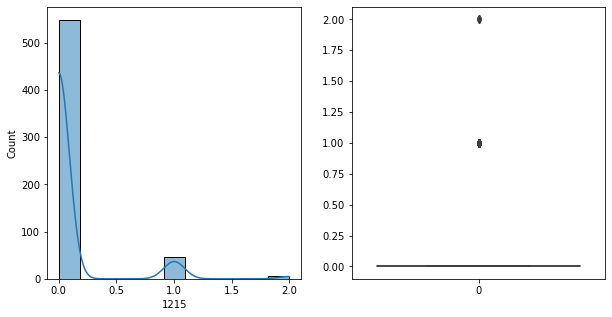

1215   Unique :  [0 1 2]
--------------------------------------------------------------------
1215   N unique :  3
--------------------------------------------------------------------
1215   Value Counts :  0    548
1     46
2      6
Name: 1215, dtype: int64
--------------------------------------------------------------------



[ 1216 ]
show_df_info :  1216


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


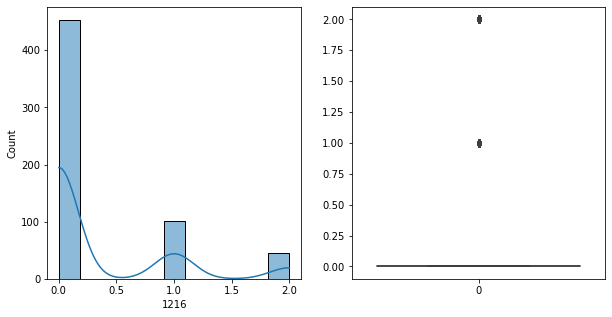

1216   Unique :  [1 0 2]
--------------------------------------------------------------------
1216   N unique :  3
--------------------------------------------------------------------
1216   Value Counts :  0    453
1    102
2     45
Name: 1216, dtype: int64
--------------------------------------------------------------------



[ 1217 ]
show_df_info :  1217


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


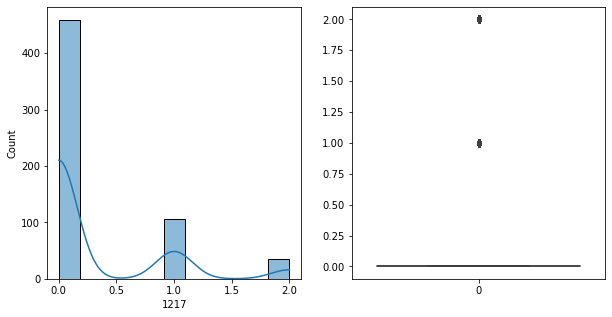

1217   Unique :  [1 0 2]
--------------------------------------------------------------------
1217   N unique :  3
--------------------------------------------------------------------
1217   Value Counts :  0    459
1    106
2     35
Name: 1217, dtype: int64
--------------------------------------------------------------------



[ 1218 ]
show_df_info :  1218


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


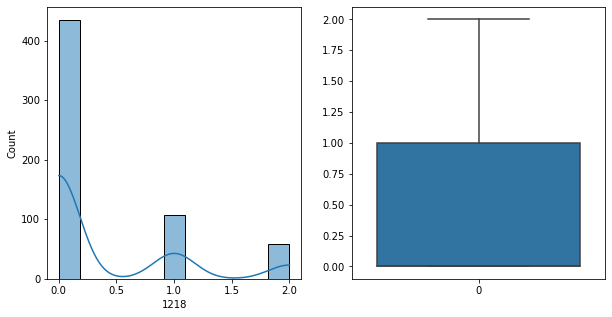

1218   Unique :  [1 0 2]
--------------------------------------------------------------------
1218   N unique :  3
--------------------------------------------------------------------
1218   Value Counts :  0    435
1    107
2     58
Name: 1218, dtype: int64
--------------------------------------------------------------------



[ 1219 ]
show_df_info :  1219


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


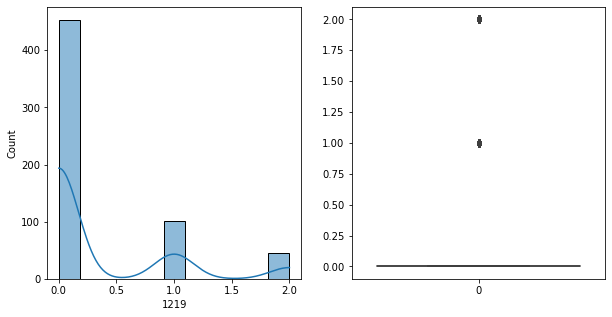

1219   Unique :  [1 0 2]
--------------------------------------------------------------------
1219   N unique :  3
--------------------------------------------------------------------
1219   Value Counts :  0    453
1    101
2     46
Name: 1219, dtype: int64
--------------------------------------------------------------------



[ 1220 ]
show_df_info :  1220


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


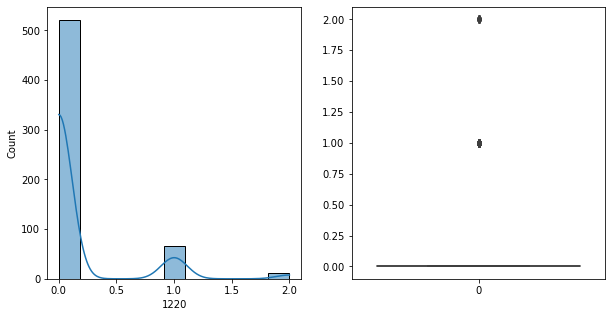

1220   Unique :  [0 1 2]
--------------------------------------------------------------------
1220   N unique :  3
--------------------------------------------------------------------
1220   Value Counts :  0    521
1     67
2     12
Name: 1220, dtype: int64
--------------------------------------------------------------------



[ 1221 ]
show_df_info :  1221


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


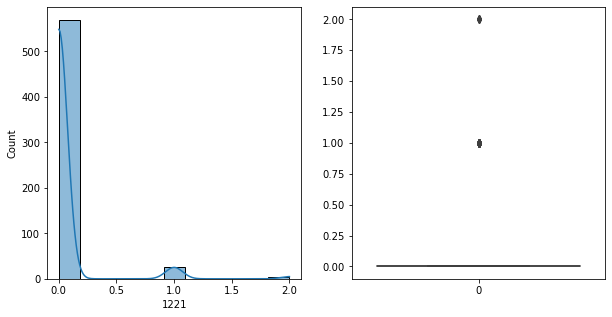

1221   Unique :  [0 1 2]
--------------------------------------------------------------------
1221   N unique :  3
--------------------------------------------------------------------
1221   Value Counts :  0    569
1     26
2      5
Name: 1221, dtype: int64
--------------------------------------------------------------------



[ 1222 ]
show_df_info :  1222


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


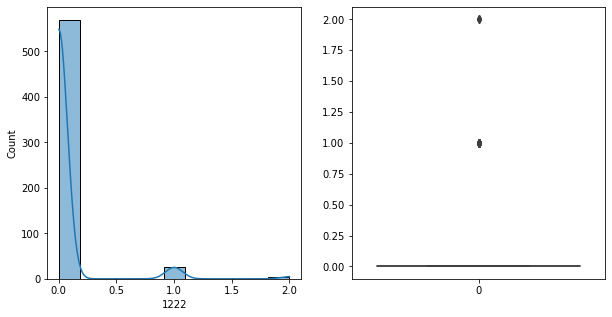

1222   Unique :  [0 1 2]
--------------------------------------------------------------------
1222   N unique :  3
--------------------------------------------------------------------
1222   Value Counts :  0    569
1     26
2      5
Name: 1222, dtype: int64
--------------------------------------------------------------------



[ 1223 ]
show_df_info :  1223


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


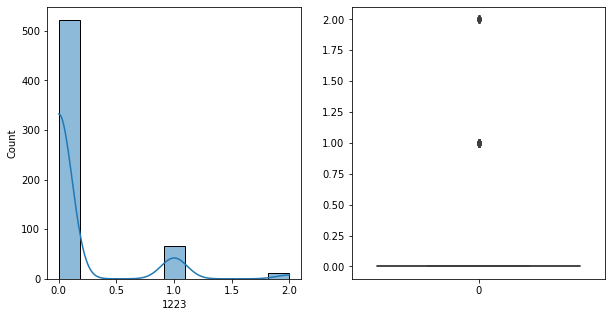

1223   Unique :  [0 1 2]
--------------------------------------------------------------------
1223   N unique :  3
--------------------------------------------------------------------
1223   Value Counts :  0    522
1     66
2     12
Name: 1223, dtype: int64
--------------------------------------------------------------------



[ 1224 ]
show_df_info :  1224


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


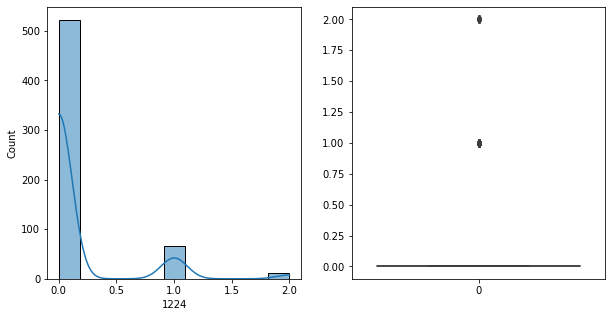

1224   Unique :  [0 1 2]
--------------------------------------------------------------------
1224   N unique :  3
--------------------------------------------------------------------
1224   Value Counts :  0    522
1     66
2     12
Name: 1224, dtype: int64
--------------------------------------------------------------------



[ 1225 ]
show_df_info :  1225


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


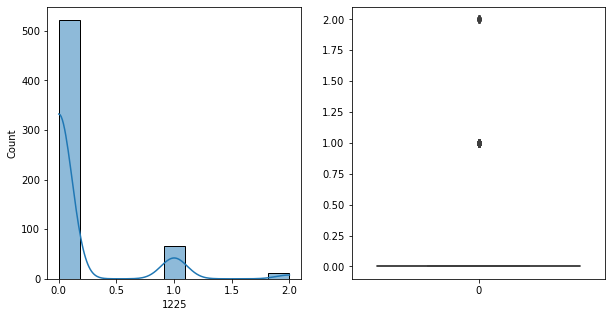

1225   Unique :  [0 1 2]
--------------------------------------------------------------------
1225   N unique :  3
--------------------------------------------------------------------
1225   Value Counts :  0    522
1     66
2     12
Name: 1225, dtype: int64
--------------------------------------------------------------------



[ 1226 ]
show_df_info :  1226


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


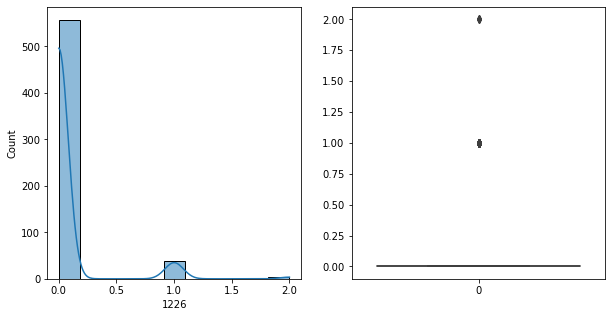

1226   Unique :  [0 1 2]
--------------------------------------------------------------------
1226   N unique :  3
--------------------------------------------------------------------
1226   Value Counts :  0    557
1     39
2      4
Name: 1226, dtype: int64
--------------------------------------------------------------------



[ 1227 ]
show_df_info :  1227


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


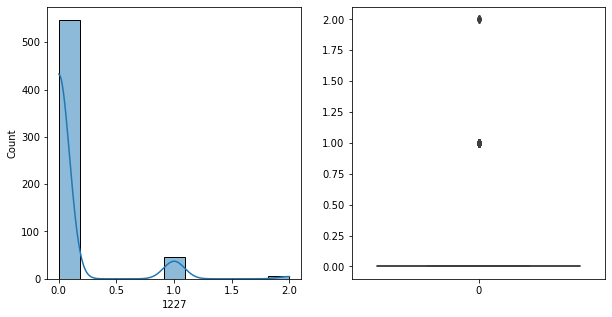

1227   Unique :  [0 2 1]
--------------------------------------------------------------------
1227   N unique :  3
--------------------------------------------------------------------
1227   Value Counts :  0    547
1     47
2      6
Name: 1227, dtype: int64
--------------------------------------------------------------------



[ 1228 ]
show_df_info :  1228


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


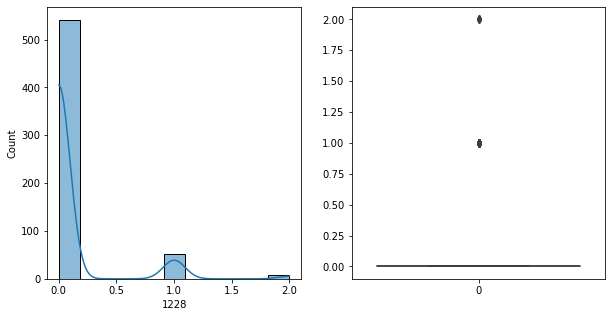

1228   Unique :  [1 0 2]
--------------------------------------------------------------------
1228   N unique :  3
--------------------------------------------------------------------
1228   Value Counts :  0    541
1     52
2      7
Name: 1228, dtype: int64
--------------------------------------------------------------------



[ 1229 ]
show_df_info :  1229


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


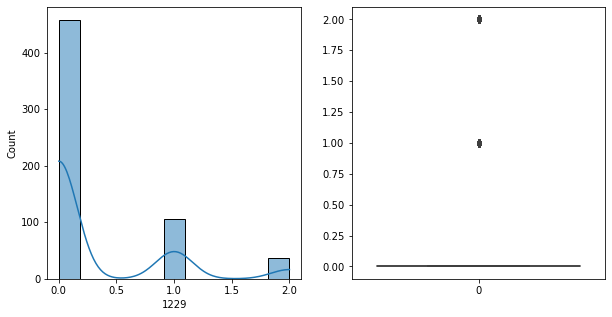

1229   Unique :  [0 1 2]
--------------------------------------------------------------------
1229   N unique :  3
--------------------------------------------------------------------
1229   Value Counts :  0    458
1    106
2     36
Name: 1229, dtype: int64
--------------------------------------------------------------------



[ 1230 ]
show_df_info :  1230


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


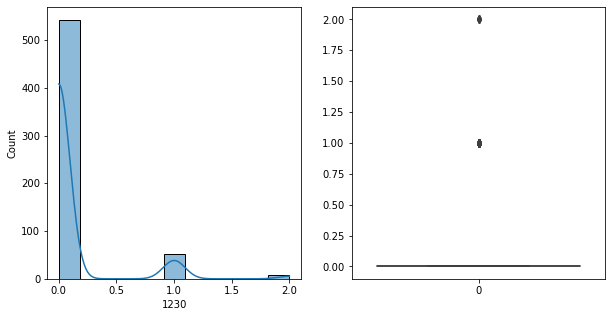

1230   Unique :  [1 0 2]
--------------------------------------------------------------------
1230   N unique :  3
--------------------------------------------------------------------
1230   Value Counts :  0    542
1     51
2      7
Name: 1230, dtype: int64
--------------------------------------------------------------------



[ 1231 ]
show_df_info :  1231


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


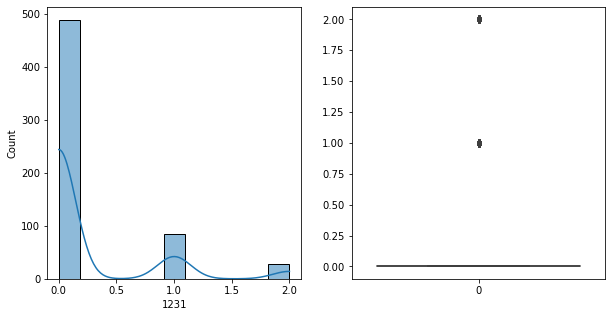

1231   Unique :  [1 0 2]
--------------------------------------------------------------------
1231   N unique :  3
--------------------------------------------------------------------
1231   Value Counts :  0    488
1     84
2     28
Name: 1231, dtype: int64
--------------------------------------------------------------------



[ 1232 ]
show_df_info :  1232


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


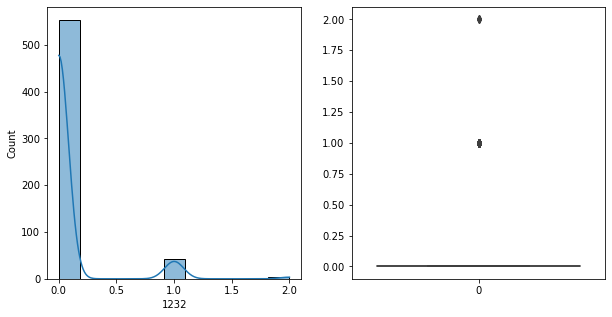

1232   Unique :  [1 0 2]
--------------------------------------------------------------------
1232   N unique :  3
--------------------------------------------------------------------
1232   Value Counts :  0    553
1     43
2      4
Name: 1232, dtype: int64
--------------------------------------------------------------------



[ 1233 ]
show_df_info :  1233


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


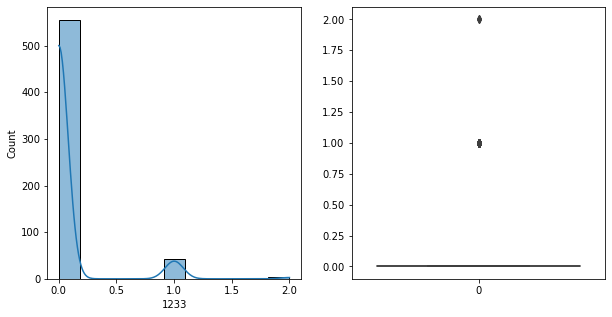

1233   Unique :  [1 0 2]
--------------------------------------------------------------------
1233   N unique :  3
--------------------------------------------------------------------
1233   Value Counts :  0    555
1     42
2      3
Name: 1233, dtype: int64
--------------------------------------------------------------------



[ 1234 ]
show_df_info :  1234


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


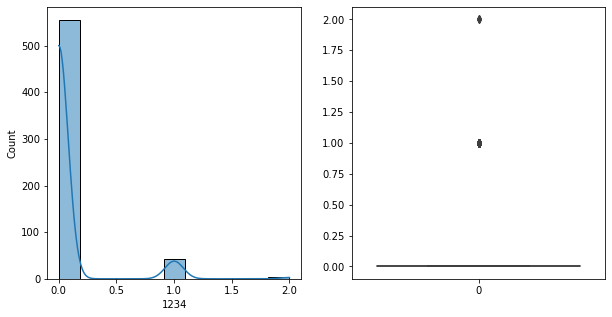

1234   Unique :  [1 0 2]
--------------------------------------------------------------------
1234   N unique :  3
--------------------------------------------------------------------
1234   Value Counts :  0    555
1     42
2      3
Name: 1234, dtype: int64
--------------------------------------------------------------------



[ 1235 ]
show_df_info :  1235


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


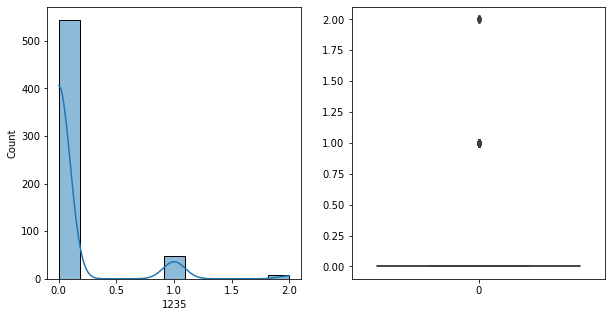

1235   Unique :  [1 0 2]
--------------------------------------------------------------------
1235   N unique :  3
--------------------------------------------------------------------
1235   Value Counts :  0    544
1     48
2      8
Name: 1235, dtype: int64
--------------------------------------------------------------------



[ 1236 ]
show_df_info :  1236


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


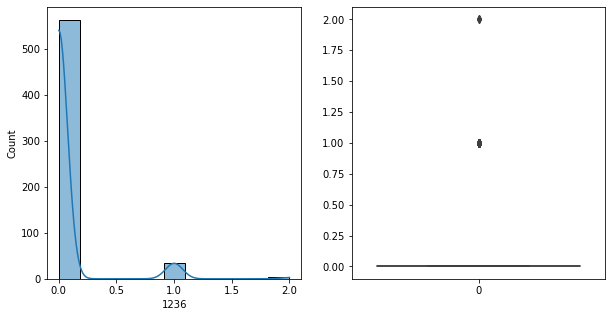

1236   Unique :  [1 0 2]
--------------------------------------------------------------------
1236   N unique :  3
--------------------------------------------------------------------
1236   Value Counts :  0    562
1     35
2      3
Name: 1236, dtype: int64
--------------------------------------------------------------------



[ 1237 ]
show_df_info :  1237


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


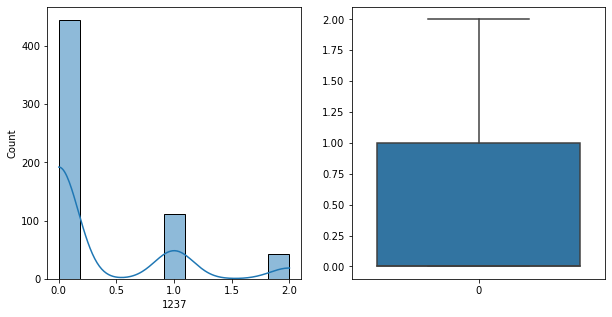

1237   Unique :  [0 1 2]
--------------------------------------------------------------------
1237   N unique :  3
--------------------------------------------------------------------
1237   Value Counts :  0    445
1    112
2     43
Name: 1237, dtype: int64
--------------------------------------------------------------------



[ 1238 ]
show_df_info :  1238


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


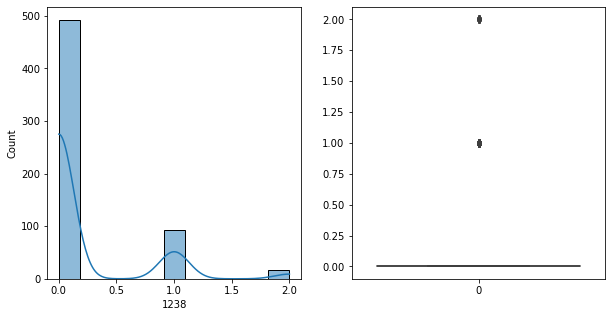

1238   Unique :  [0 1 2]
--------------------------------------------------------------------
1238   N unique :  3
--------------------------------------------------------------------
1238   Value Counts :  0    492
1     92
2     16
Name: 1238, dtype: int64
--------------------------------------------------------------------



[ 1239 ]
show_df_info :  1239


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


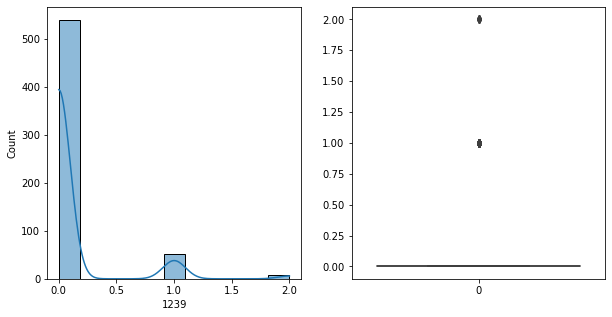

1239   Unique :  [1 0 2]
--------------------------------------------------------------------
1239   N unique :  3
--------------------------------------------------------------------
1239   Value Counts :  0    540
1     52
2      8
Name: 1239, dtype: int64
--------------------------------------------------------------------



[ 1240 ]
show_df_info :  1240


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


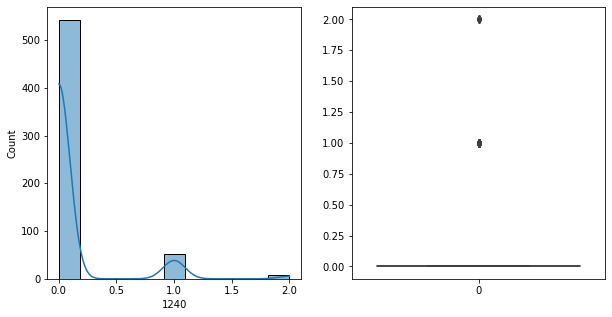

1240   Unique :  [1 0 2]
--------------------------------------------------------------------
1240   N unique :  3
--------------------------------------------------------------------
1240   Value Counts :  0    542
1     51
2      7
Name: 1240, dtype: int64
--------------------------------------------------------------------



[ 1241 ]
show_df_info :  1241


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


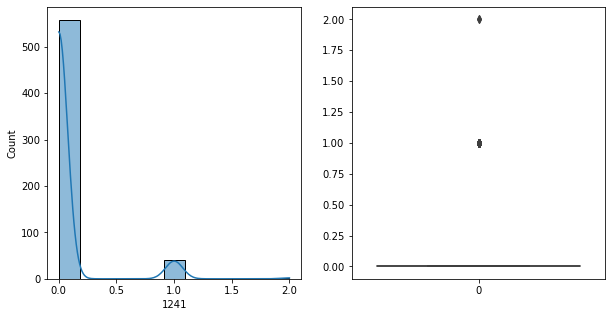

1241   Unique :  [1 0 2]
--------------------------------------------------------------------
1241   N unique :  3
--------------------------------------------------------------------
1241   Value Counts :  0    558
1     40
2      2
Name: 1241, dtype: int64
--------------------------------------------------------------------



[ 1242 ]
show_df_info :  1242


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


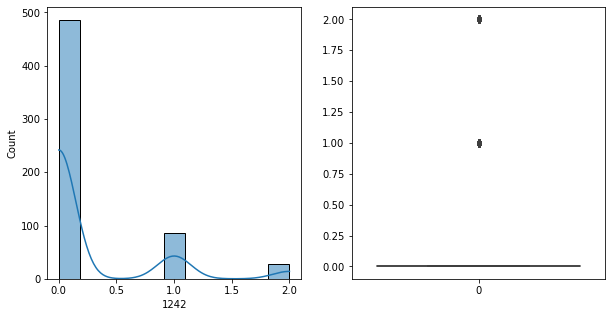

1242   Unique :  [1 0 2]
--------------------------------------------------------------------
1242   N unique :  3
--------------------------------------------------------------------
1242   Value Counts :  0    486
1     86
2     28
Name: 1242, dtype: int64
--------------------------------------------------------------------



[ 1243 ]
show_df_info :  1243


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


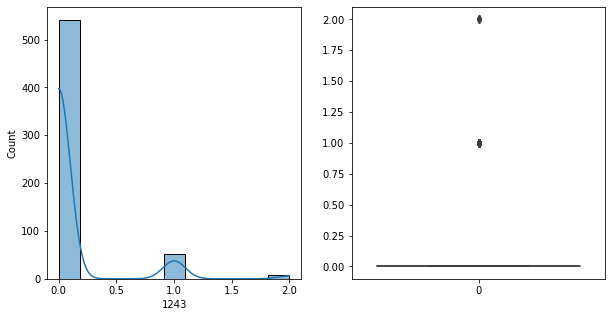

1243   Unique :  [1 0 2]
--------------------------------------------------------------------
1243   N unique :  3
--------------------------------------------------------------------
1243   Value Counts :  0    541
1     51
2      8
Name: 1243, dtype: int64
--------------------------------------------------------------------



[ 1244 ]
show_df_info :  1244


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


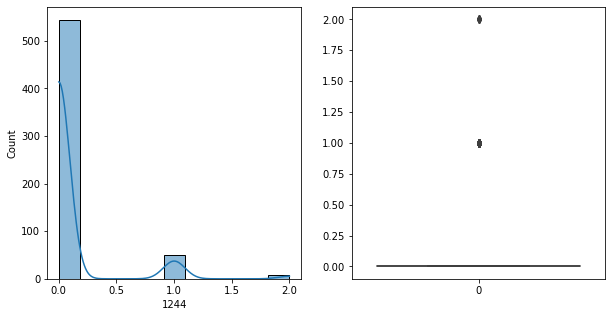

1244   Unique :  [1 0 2]
--------------------------------------------------------------------
1244   N unique :  3
--------------------------------------------------------------------
1244   Value Counts :  0    544
1     49
2      7
Name: 1244, dtype: int64
--------------------------------------------------------------------



[ 1245 ]
show_df_info :  1245


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


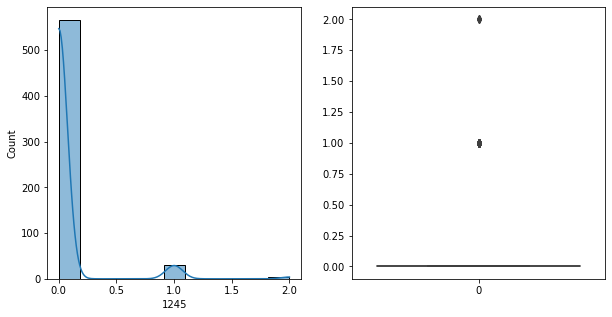

1245   Unique :  [0 1 2]
--------------------------------------------------------------------
1245   N unique :  3
--------------------------------------------------------------------
1245   Value Counts :  0    566
1     30
2      4
Name: 1245, dtype: int64
--------------------------------------------------------------------



[ 1246 ]
show_df_info :  1246


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


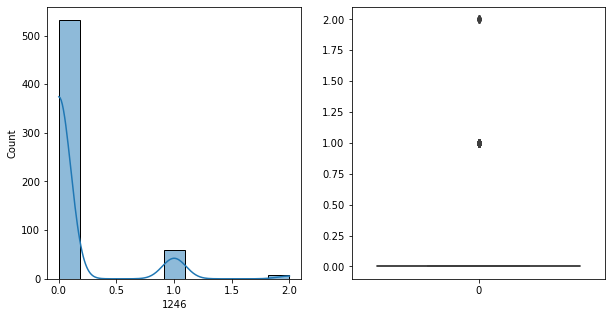

1246   Unique :  [1 0 2]
--------------------------------------------------------------------
1246   N unique :  3
--------------------------------------------------------------------
1246   Value Counts :  0    532
1     60
2      8
Name: 1246, dtype: int64
--------------------------------------------------------------------



[ 1247 ]
show_df_info :  1247


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


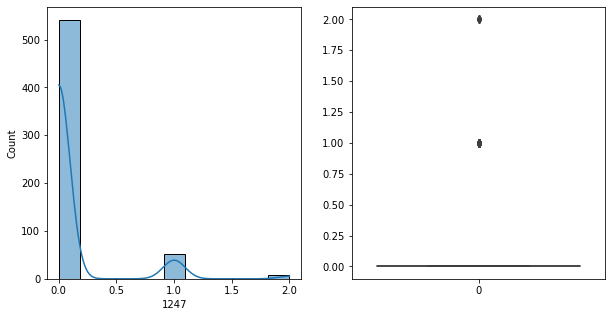

1247   Unique :  [1 0 2]
--------------------------------------------------------------------
1247   N unique :  3
--------------------------------------------------------------------
1247   Value Counts :  0    541
1     52
2      7
Name: 1247, dtype: int64
--------------------------------------------------------------------



[ 1248 ]
show_df_info :  1248


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


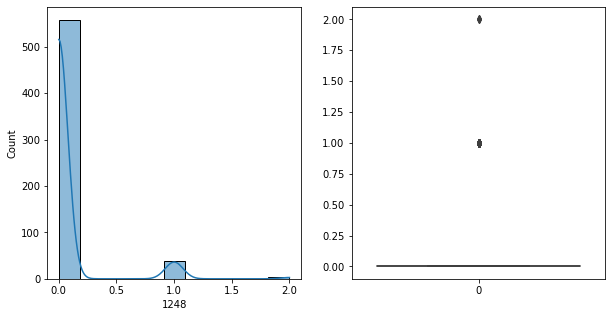

1248   Unique :  [1 0 2]
--------------------------------------------------------------------
1248   N unique :  3
--------------------------------------------------------------------
1248   Value Counts :  0    558
1     39
2      3
Name: 1248, dtype: int64
--------------------------------------------------------------------



[ 1249 ]
show_df_info :  1249


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


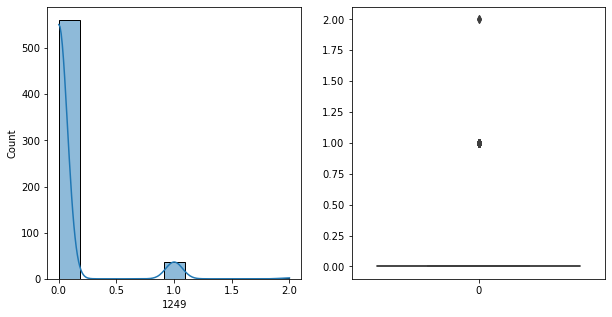

1249   Unique :  [1 0 2]
--------------------------------------------------------------------
1249   N unique :  3
--------------------------------------------------------------------
1249   Value Counts :  0    561
1     37
2      2
Name: 1249, dtype: int64
--------------------------------------------------------------------



[ 1250 ]
show_df_info :  1250


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


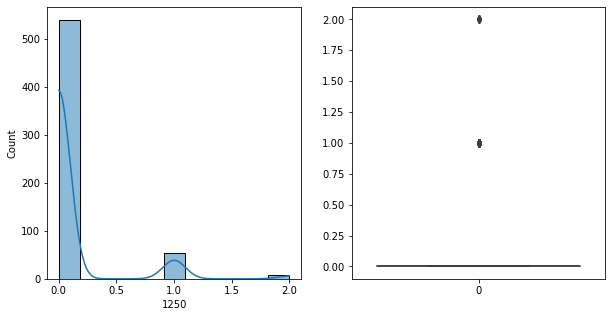

1250   Unique :  [1 0 2]
--------------------------------------------------------------------
1250   N unique :  3
--------------------------------------------------------------------
1250   Value Counts :  0    539
1     53
2      8
Name: 1250, dtype: int64
--------------------------------------------------------------------



[ 1251 ]
show_df_info :  1251


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


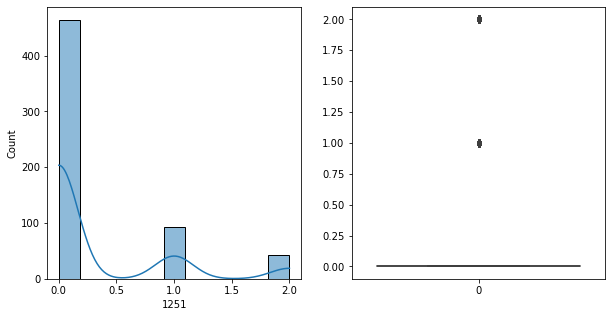

1251   Unique :  [1 0 2]
--------------------------------------------------------------------
1251   N unique :  3
--------------------------------------------------------------------
1251   Value Counts :  0    464
1     93
2     43
Name: 1251, dtype: int64
--------------------------------------------------------------------



[ 1252 ]
show_df_info :  1252


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


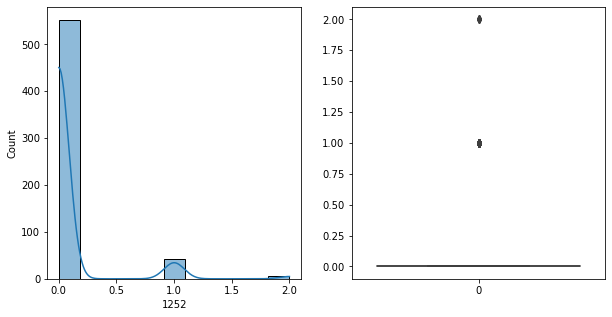

1252   Unique :  [0 1 2]
--------------------------------------------------------------------
1252   N unique :  3
--------------------------------------------------------------------
1252   Value Counts :  0    552
1     42
2      6
Name: 1252, dtype: int64
--------------------------------------------------------------------



[ 1253 ]
show_df_info :  1253


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


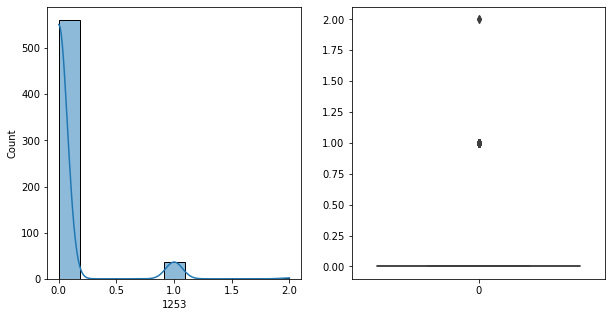

1253   Unique :  [0 1 2]
--------------------------------------------------------------------
1253   N unique :  3
--------------------------------------------------------------------
1253   Value Counts :  0    561
1     37
2      2
Name: 1253, dtype: int64
--------------------------------------------------------------------



[ 1254 ]
show_df_info :  1254


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


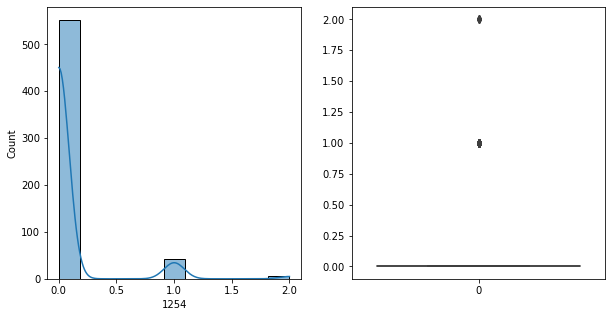

1254   Unique :  [0 1 2]
--------------------------------------------------------------------
1254   N unique :  3
--------------------------------------------------------------------
1254   Value Counts :  0    552
1     42
2      6
Name: 1254, dtype: int64
--------------------------------------------------------------------



[ 1255 ]
show_df_info :  1255


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


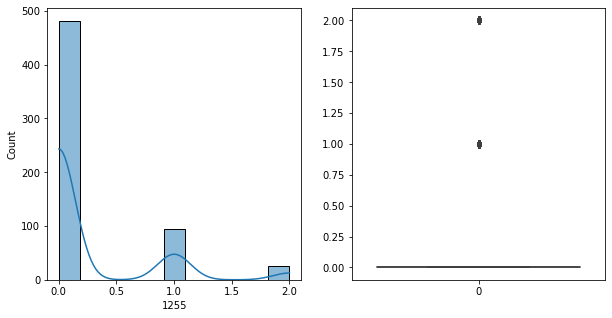

1255   Unique :  [1 0 2]
--------------------------------------------------------------------
1255   N unique :  3
--------------------------------------------------------------------
1255   Value Counts :  0    481
1     94
2     25
Name: 1255, dtype: int64
--------------------------------------------------------------------



[ 1256 ]
show_df_info :  1256


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


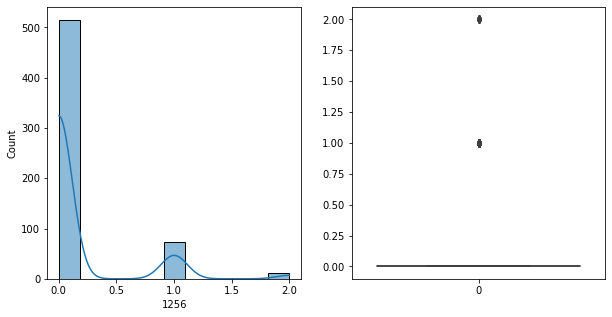

1256   Unique :  [0 1 2]
--------------------------------------------------------------------
1256   N unique :  3
--------------------------------------------------------------------
1256   Value Counts :  0    515
1     74
2     11
Name: 1256, dtype: int64
--------------------------------------------------------------------



[ 1257 ]
show_df_info :  1257


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


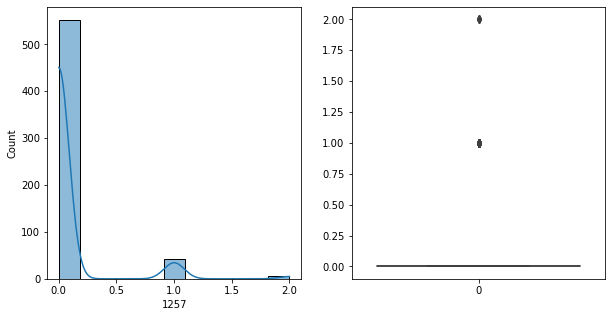

1257   Unique :  [0 1 2]
--------------------------------------------------------------------
1257   N unique :  3
--------------------------------------------------------------------
1257   Value Counts :  0    552
1     42
2      6
Name: 1257, dtype: int64
--------------------------------------------------------------------



[ 1258 ]
show_df_info :  1258


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


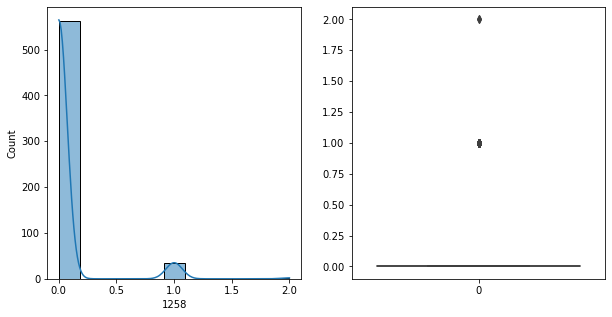

1258   Unique :  [0 1 2]
--------------------------------------------------------------------
1258   N unique :  3
--------------------------------------------------------------------
1258   Value Counts :  0    563
1     35
2      2
Name: 1258, dtype: int64
--------------------------------------------------------------------



[ 1259 ]
show_df_info :  1259


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


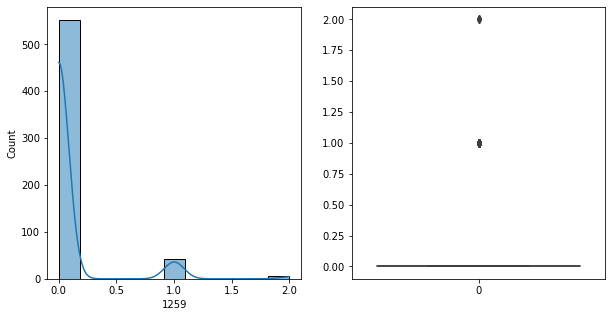

1259   Unique :  [0 1 2]
--------------------------------------------------------------------
1259   N unique :  3
--------------------------------------------------------------------
1259   Value Counts :  0    552
1     43
2      5
Name: 1259, dtype: int64
--------------------------------------------------------------------



[ 1260 ]
show_df_info :  1260


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


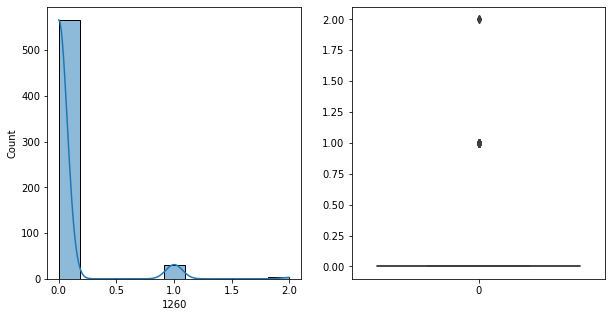

1260   Unique :  [0 1 2]
--------------------------------------------------------------------
1260   N unique :  3
--------------------------------------------------------------------
1260   Value Counts :  0    566
1     31
2      3
Name: 1260, dtype: int64
--------------------------------------------------------------------



[ 1261 ]
show_df_info :  1261


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


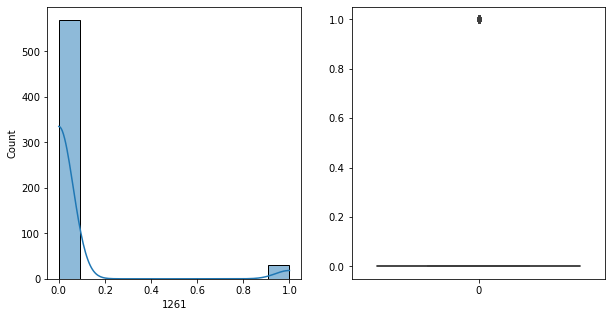

1261   Unique :  [0 1]
--------------------------------------------------------------------
1261   N unique :  2
--------------------------------------------------------------------
1261   Value Counts :  0    569
1     31
Name: 1261, dtype: int64
--------------------------------------------------------------------



[ 1262 ]
show_df_info :  1262


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


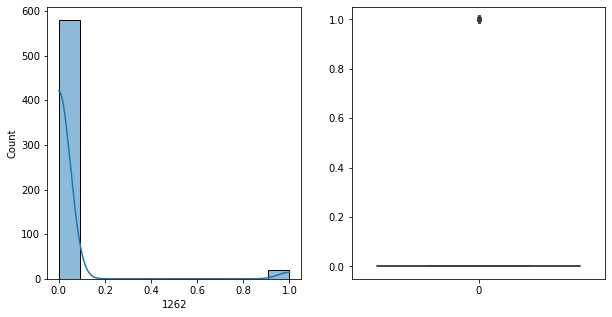

1262   Unique :  [0 1]
--------------------------------------------------------------------
1262   N unique :  2
--------------------------------------------------------------------
1262   Value Counts :  0    580
1     20
Name: 1262, dtype: int64
--------------------------------------------------------------------



[ 1263 ]
show_df_info :  1263


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


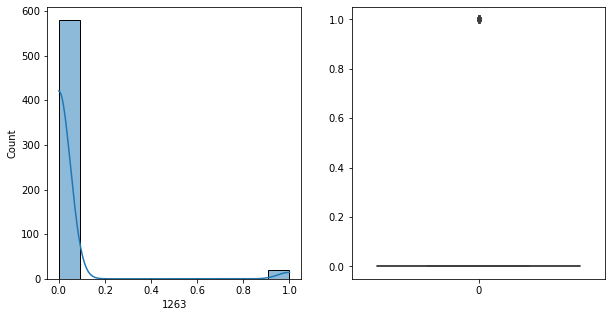

1263   Unique :  [0 1]
--------------------------------------------------------------------
1263   N unique :  2
--------------------------------------------------------------------
1263   Value Counts :  0    580
1     20
Name: 1263, dtype: int64
--------------------------------------------------------------------



[ 1264 ]
show_df_info :  1264


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


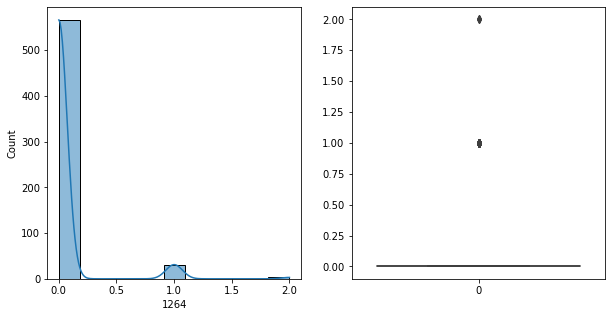

1264   Unique :  [0 1 2]
--------------------------------------------------------------------
1264   N unique :  3
--------------------------------------------------------------------
1264   Value Counts :  0    566
1     31
2      3
Name: 1264, dtype: int64
--------------------------------------------------------------------



[ 1265 ]
show_df_info :  1265


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


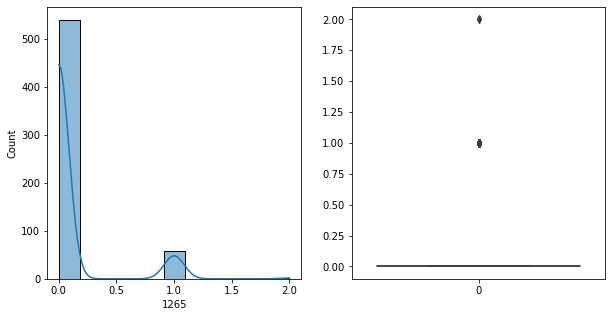

1265   Unique :  [1 0 2]
--------------------------------------------------------------------
1265   N unique :  3
--------------------------------------------------------------------
1265   Value Counts :  0    540
1     58
2      2
Name: 1265, dtype: int64
--------------------------------------------------------------------



[ 1266 ]
show_df_info :  1266


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


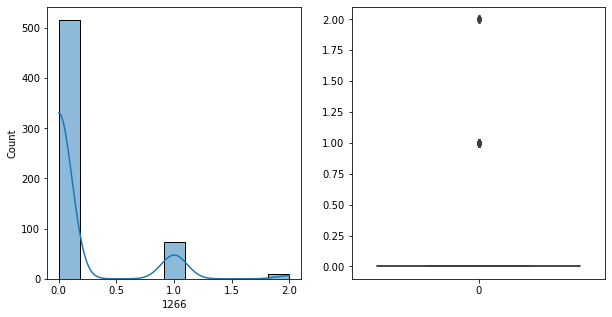

1266   Unique :  [0 1 2]
--------------------------------------------------------------------
1266   N unique :  3
--------------------------------------------------------------------
1266   Value Counts :  0    516
1     74
2     10
Name: 1266, dtype: int64
--------------------------------------------------------------------



[ 1267 ]
show_df_info :  1267


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


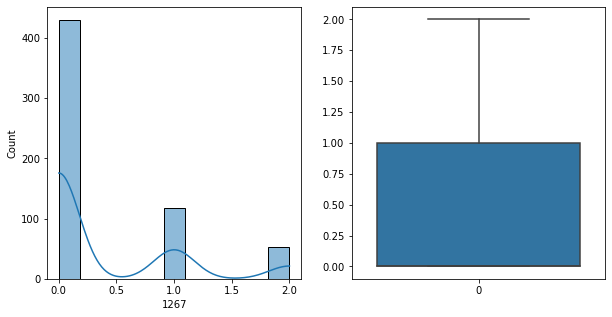

1267   Unique :  [1 0 2]
--------------------------------------------------------------------
1267   N unique :  3
--------------------------------------------------------------------
1267   Value Counts :  0    430
1    118
2     52
Name: 1267, dtype: int64
--------------------------------------------------------------------



[ 1268 ]
show_df_info :  1268


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


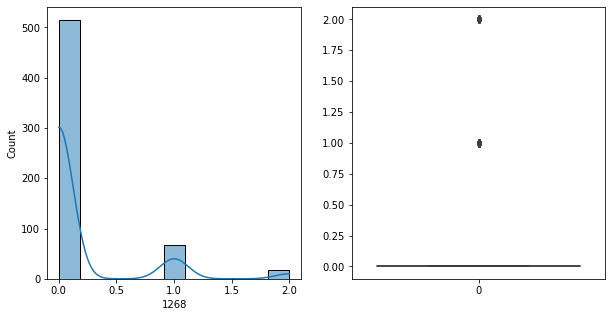

1268   Unique :  [1 0 2]
--------------------------------------------------------------------
1268   N unique :  3
--------------------------------------------------------------------
1268   Value Counts :  0    515
1     68
2     17
Name: 1268, dtype: int64
--------------------------------------------------------------------



[ 1269 ]
show_df_info :  1269


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


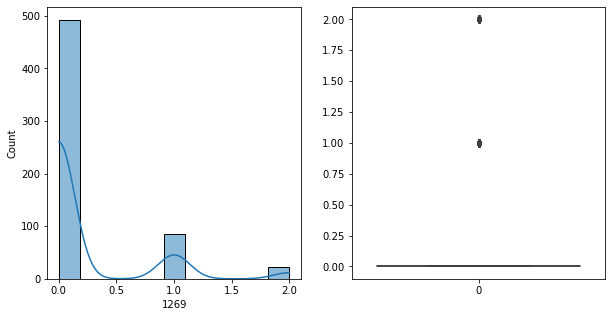

1269   Unique :  [0 1 2]
--------------------------------------------------------------------
1269   N unique :  3
--------------------------------------------------------------------
1269   Value Counts :  0    492
1     86
2     22
Name: 1269, dtype: int64
--------------------------------------------------------------------



[ 1270 ]
show_df_info :  1270


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


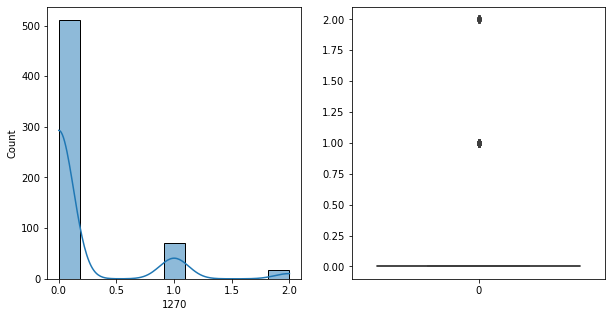

1270   Unique :  [0 1 2]
--------------------------------------------------------------------
1270   N unique :  3
--------------------------------------------------------------------
1270   Value Counts :  0    511
1     71
2     18
Name: 1270, dtype: int64
--------------------------------------------------------------------



[ 1271 ]
show_df_info :  1271


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


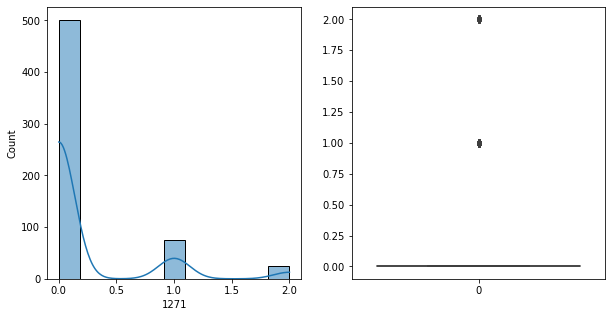

1271   Unique :  [0 1 2]
--------------------------------------------------------------------
1271   N unique :  3
--------------------------------------------------------------------
1271   Value Counts :  0    501
1     75
2     24
Name: 1271, dtype: int64
--------------------------------------------------------------------



[ 1272 ]
show_df_info :  1272


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


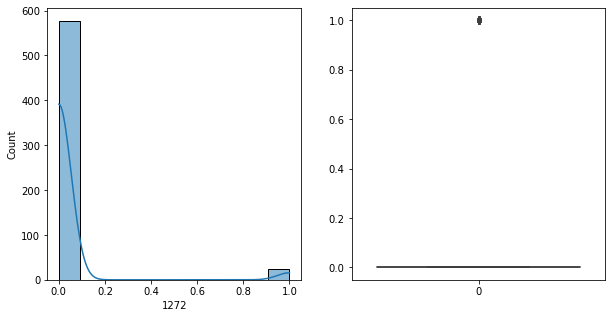

1272   Unique :  [0 1]
--------------------------------------------------------------------
1272   N unique :  2
--------------------------------------------------------------------
1272   Value Counts :  0    577
1     23
Name: 1272, dtype: int64
--------------------------------------------------------------------



[ 1273 ]
show_df_info :  1273


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


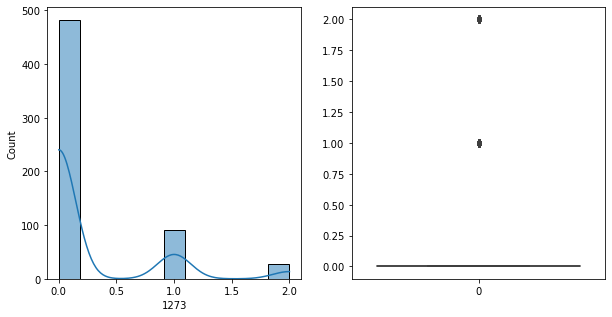

1273   Unique :  [0 1 2]
--------------------------------------------------------------------
1273   N unique :  3
--------------------------------------------------------------------
1273   Value Counts :  0    482
1     91
2     27
Name: 1273, dtype: int64
--------------------------------------------------------------------



[ 1274 ]
show_df_info :  1274


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


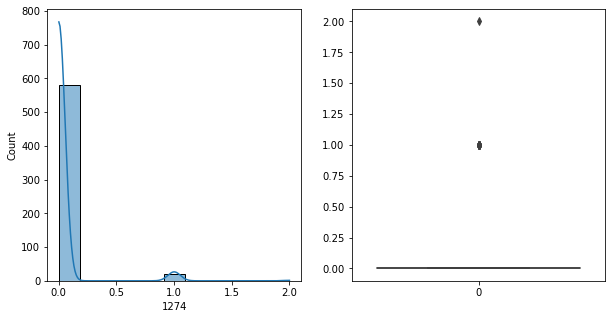

1274   Unique :  [0 1 2]
--------------------------------------------------------------------
1274   N unique :  3
--------------------------------------------------------------------
1274   Value Counts :  0    579
1     20
2      1
Name: 1274, dtype: int64
--------------------------------------------------------------------



[ 1275 ]
show_df_info :  1275


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


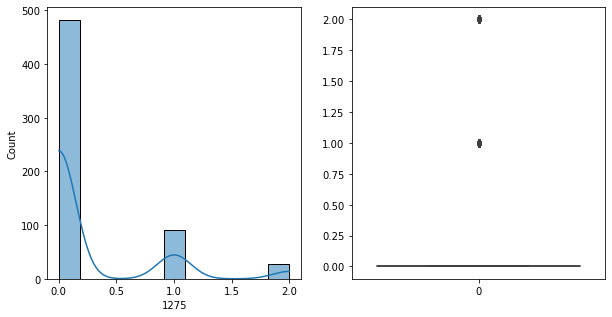

1275   Unique :  [0 1 2]
--------------------------------------------------------------------
1275   N unique :  3
--------------------------------------------------------------------
1275   Value Counts :  0    482
1     90
2     28
Name: 1275, dtype: int64
--------------------------------------------------------------------



[ 1276 ]
show_df_info :  1276


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


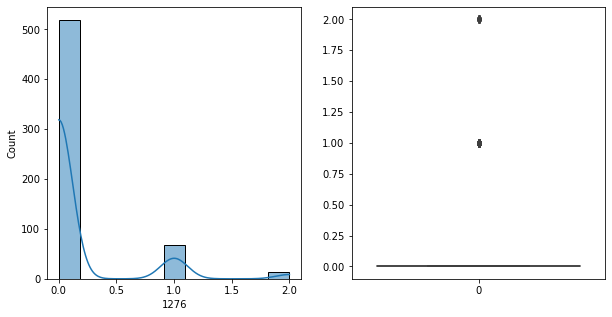

1276   Unique :  [0 1 2]
--------------------------------------------------------------------
1276   N unique :  3
--------------------------------------------------------------------
1276   Value Counts :  0    519
1     67
2     14
Name: 1276, dtype: int64
--------------------------------------------------------------------



[ 1277 ]
show_df_info :  1277


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


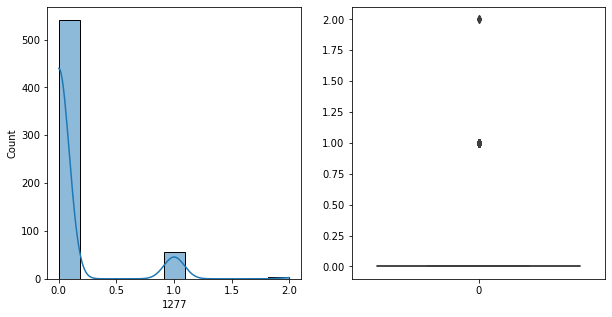

1277   Unique :  [0 1 2]
--------------------------------------------------------------------
1277   N unique :  3
--------------------------------------------------------------------
1277   Value Counts :  0    541
1     56
2      3
Name: 1277, dtype: int64
--------------------------------------------------------------------



[ 1278 ]
show_df_info :  1278


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


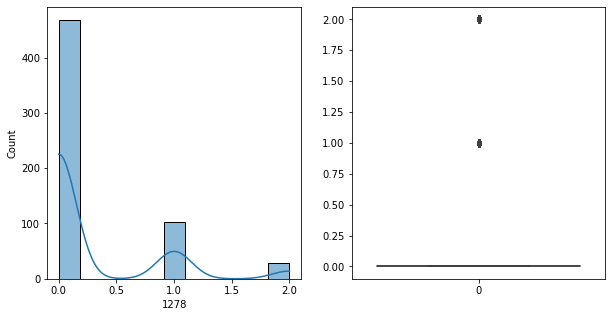

1278   Unique :  [1 0 2]
--------------------------------------------------------------------
1278   N unique :  3
--------------------------------------------------------------------
1278   Value Counts :  0    468
1    103
2     29
Name: 1278, dtype: int64
--------------------------------------------------------------------



[ 1279 ]
show_df_info :  1279


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


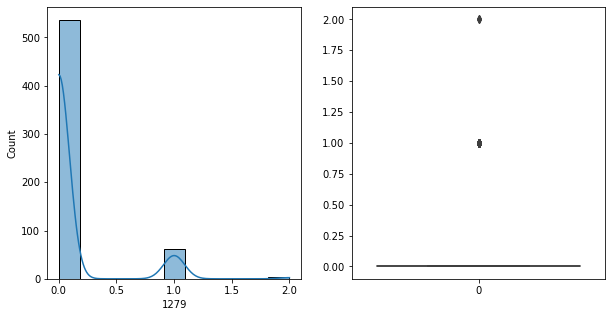

1279   Unique :  [0 1 2]
--------------------------------------------------------------------
1279   N unique :  3
--------------------------------------------------------------------
1279   Value Counts :  0    536
1     61
2      3
Name: 1279, dtype: int64
--------------------------------------------------------------------



[ 1280 ]
show_df_info :  1280


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


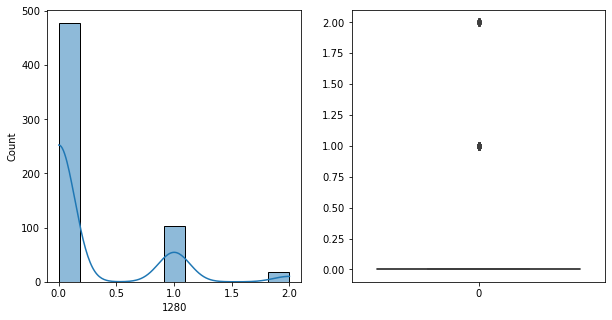

1280   Unique :  [1 0 2]
--------------------------------------------------------------------
1280   N unique :  3
--------------------------------------------------------------------
1280   Value Counts :  0    478
1    103
2     19
Name: 1280, dtype: int64
--------------------------------------------------------------------



[ 1281 ]
show_df_info :  1281


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


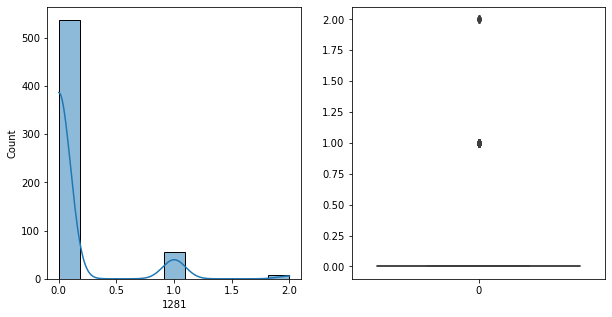

1281   Unique :  [0 2 1]
--------------------------------------------------------------------
1281   N unique :  3
--------------------------------------------------------------------
1281   Value Counts :  0    537
1     55
2      8
Name: 1281, dtype: int64
--------------------------------------------------------------------



[ 1282 ]
show_df_info :  1282


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


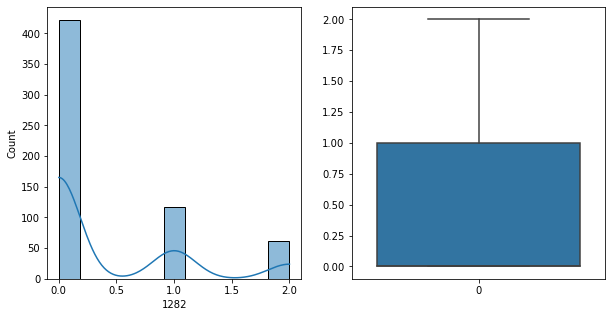

1282   Unique :  [1 0 2]
--------------------------------------------------------------------
1282   N unique :  3
--------------------------------------------------------------------
1282   Value Counts :  0    422
1    117
2     61
Name: 1282, dtype: int64
--------------------------------------------------------------------



[ 1283 ]
show_df_info :  1283


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


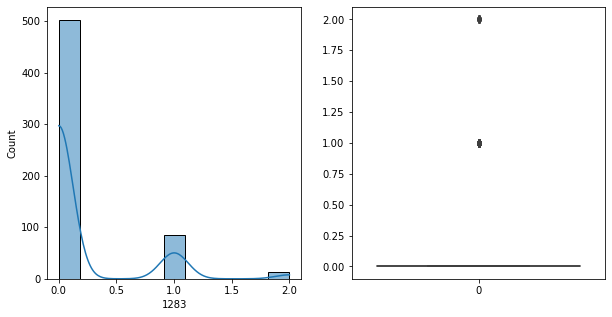

1283   Unique :  [1 0 2]
--------------------------------------------------------------------
1283   N unique :  3
--------------------------------------------------------------------
1283   Value Counts :  0    502
1     85
2     13
Name: 1283, dtype: int64
--------------------------------------------------------------------



[ 1284 ]
show_df_info :  1284


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


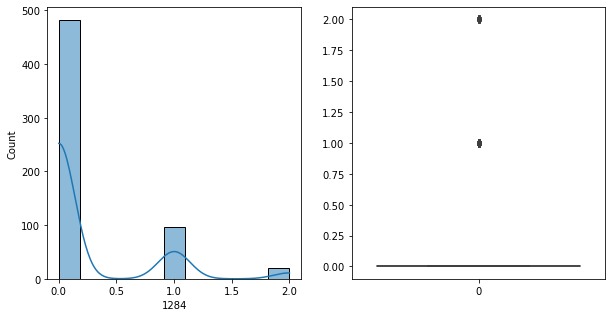

1284   Unique :  [0 1 2]
--------------------------------------------------------------------
1284   N unique :  3
--------------------------------------------------------------------
1284   Value Counts :  0    482
1     97
2     21
Name: 1284, dtype: int64
--------------------------------------------------------------------



[ 1285 ]
show_df_info :  1285


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


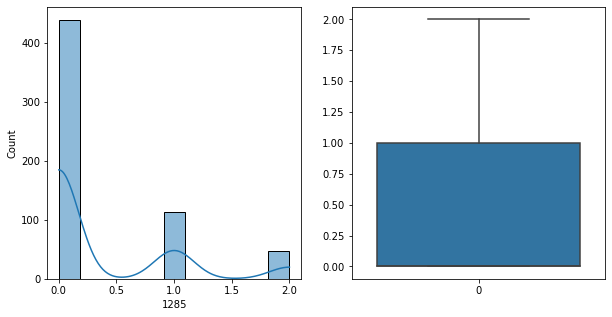

1285   Unique :  [0 1 2]
--------------------------------------------------------------------
1285   N unique :  3
--------------------------------------------------------------------
1285   Value Counts :  0    439
1    114
2     47
Name: 1285, dtype: int64
--------------------------------------------------------------------



[ 1286 ]
show_df_info :  1286


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


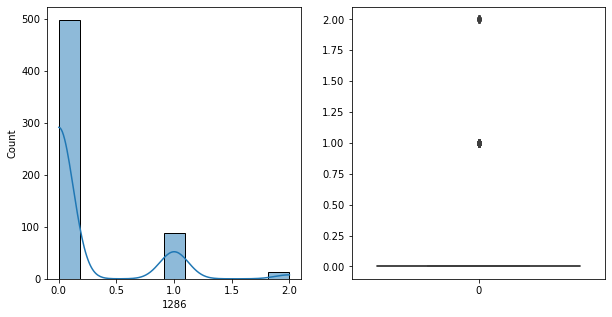

1286   Unique :  [0 1 2]
--------------------------------------------------------------------
1286   N unique :  3
--------------------------------------------------------------------
1286   Value Counts :  0    498
1     89
2     13
Name: 1286, dtype: int64
--------------------------------------------------------------------



[ 1287 ]
show_df_info :  1287


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


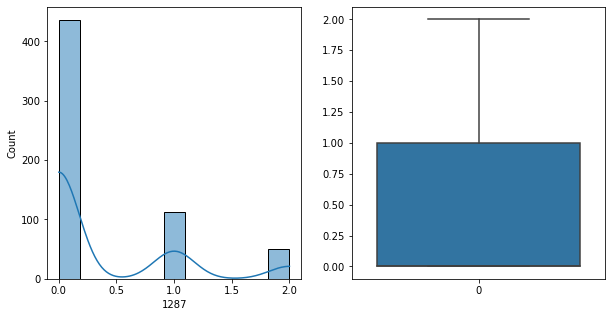

1287   Unique :  [0 1 2]
--------------------------------------------------------------------
1287   N unique :  3
--------------------------------------------------------------------
1287   Value Counts :  0    436
1    113
2     51
Name: 1287, dtype: int64
--------------------------------------------------------------------



[ 1288 ]
show_df_info :  1288


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


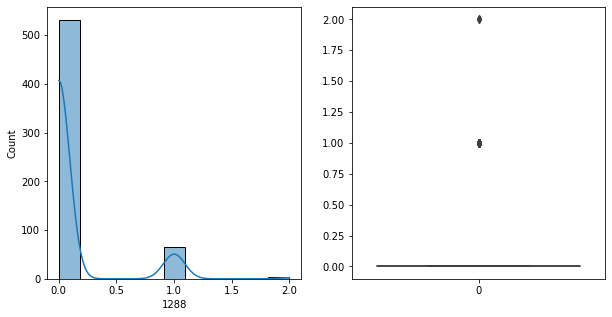

1288   Unique :  [0 1 2]
--------------------------------------------------------------------
1288   N unique :  3
--------------------------------------------------------------------
1288   Value Counts :  0    531
1     66
2      3
Name: 1288, dtype: int64
--------------------------------------------------------------------



[ 1289 ]
show_df_info :  1289


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


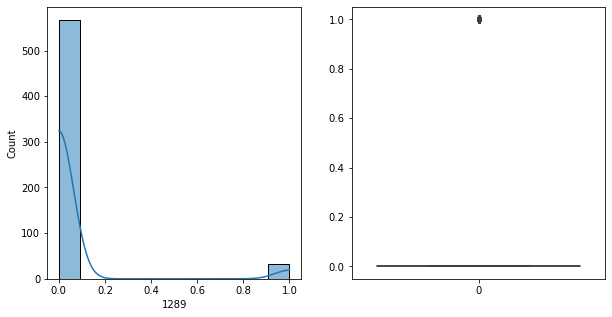

1289   Unique :  [0 1]
--------------------------------------------------------------------
1289   N unique :  2
--------------------------------------------------------------------
1289   Value Counts :  0    567
1     33
Name: 1289, dtype: int64
--------------------------------------------------------------------



[ 1290 ]
show_df_info :  1290


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


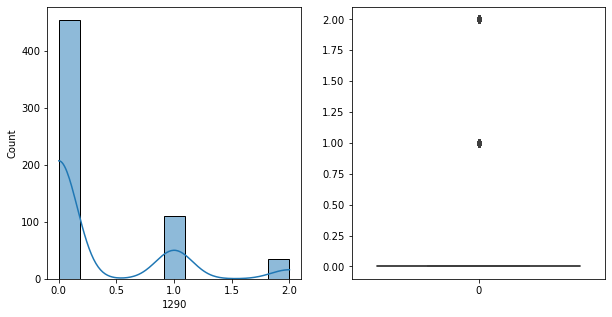

1290   Unique :  [1 0 2]
--------------------------------------------------------------------
1290   N unique :  3
--------------------------------------------------------------------
1290   Value Counts :  0    455
1    110
2     35
Name: 1290, dtype: int64
--------------------------------------------------------------------



[ 1291 ]
show_df_info :  1291


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


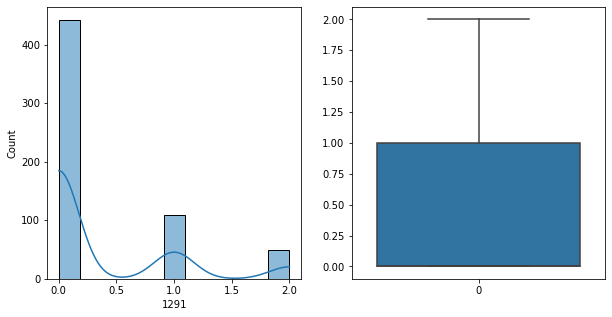

1291   Unique :  [1 0 2]
--------------------------------------------------------------------
1291   N unique :  3
--------------------------------------------------------------------
1291   Value Counts :  0    442
1    109
2     49
Name: 1291, dtype: int64
--------------------------------------------------------------------



[ 1292 ]
show_df_info :  1292


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


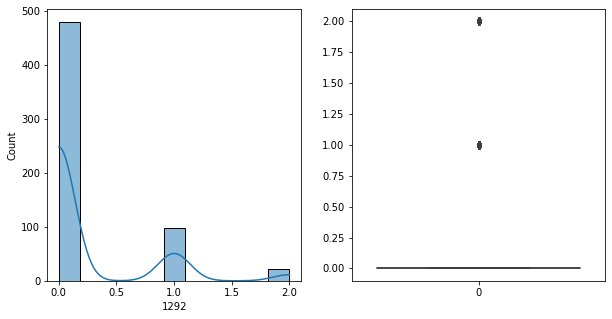

1292   Unique :  [0 1 2]
--------------------------------------------------------------------
1292   N unique :  3
--------------------------------------------------------------------
1292   Value Counts :  0    480
1     98
2     22
Name: 1292, dtype: int64
--------------------------------------------------------------------



[ 1293 ]
show_df_info :  1293


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


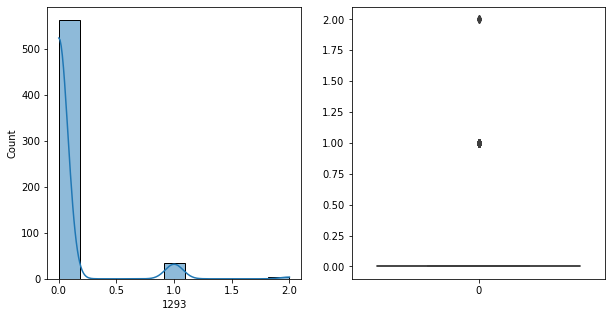

1293   Unique :  [1 0 2]
--------------------------------------------------------------------
1293   N unique :  3
--------------------------------------------------------------------
1293   Value Counts :  0    562
1     34
2      4
Name: 1293, dtype: int64
--------------------------------------------------------------------



[ 1294 ]
show_df_info :  1294


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


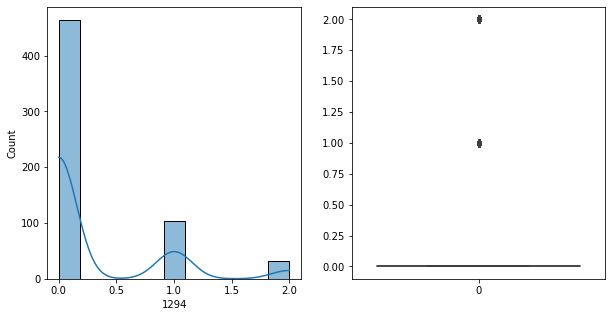

1294   Unique :  [0 1 2]
--------------------------------------------------------------------
1294   N unique :  3
--------------------------------------------------------------------
1294   Value Counts :  0    464
1    104
2     32
Name: 1294, dtype: int64
--------------------------------------------------------------------



[ 1295 ]
show_df_info :  1295


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


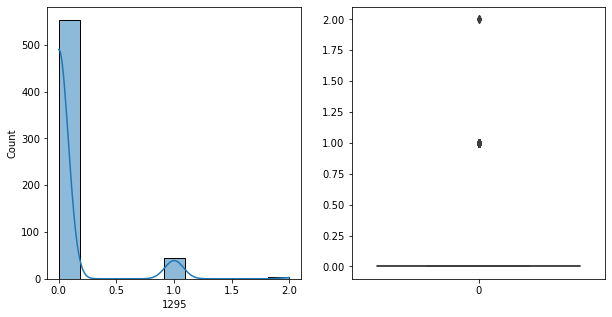

1295   Unique :  [1 0 2]
--------------------------------------------------------------------
1295   N unique :  3
--------------------------------------------------------------------
1295   Value Counts :  0    553
1     44
2      3
Name: 1295, dtype: int64
--------------------------------------------------------------------



[ 1296 ]
show_df_info :  1296


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


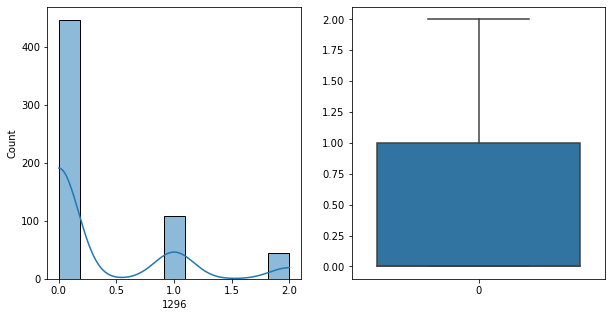

1296   Unique :  [1 0 2]
--------------------------------------------------------------------
1296   N unique :  3
--------------------------------------------------------------------
1296   Value Counts :  0    447
1    108
2     45
Name: 1296, dtype: int64
--------------------------------------------------------------------



[ 1297 ]
show_df_info :  1297


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


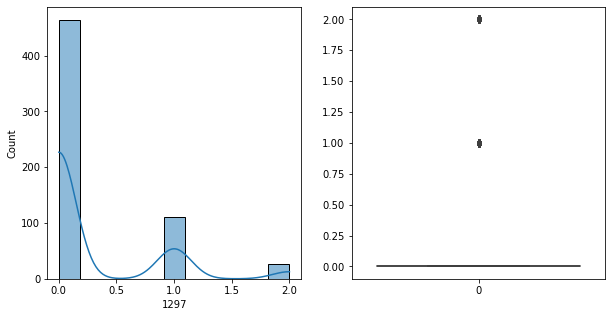

1297   Unique :  [0 1 2]
--------------------------------------------------------------------
1297   N unique :  3
--------------------------------------------------------------------
1297   Value Counts :  0    464
1    110
2     26
Name: 1297, dtype: int64
--------------------------------------------------------------------



[ 1298 ]
show_df_info :  1298


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


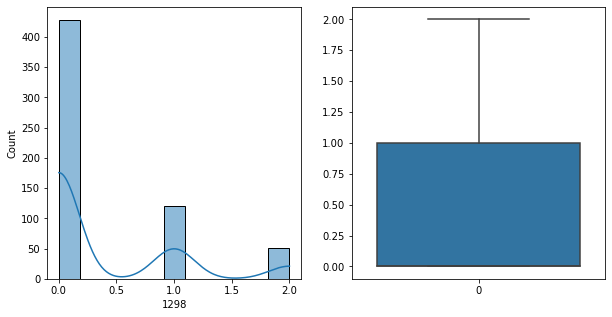

1298   Unique :  [1 0 2]
--------------------------------------------------------------------
1298   N unique :  3
--------------------------------------------------------------------
1298   Value Counts :  0    428
1    121
2     51
Name: 1298, dtype: int64
--------------------------------------------------------------------



[ 1299 ]
show_df_info :  1299


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


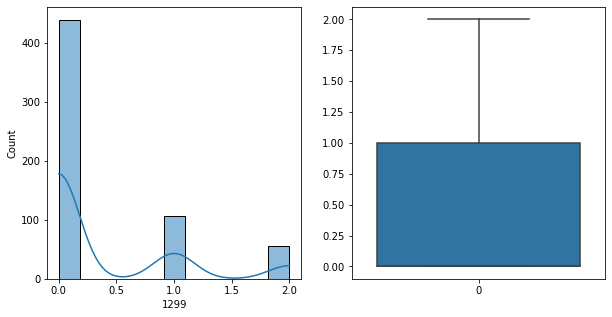

1299   Unique :  [1 0 2]
--------------------------------------------------------------------
1299   N unique :  3
--------------------------------------------------------------------
1299   Value Counts :  0    439
1    106
2     55
Name: 1299, dtype: int64
--------------------------------------------------------------------



[ 1300 ]
show_df_info :  1300


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


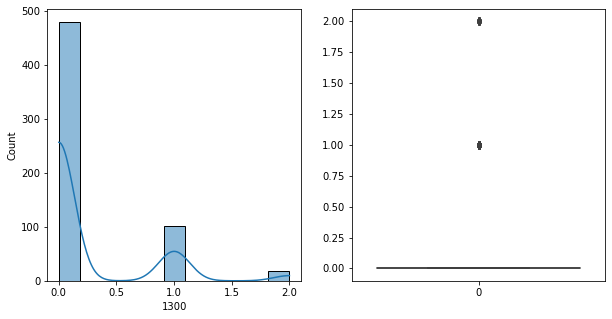

1300   Unique :  [0 1 2]
--------------------------------------------------------------------
1300   N unique :  3
--------------------------------------------------------------------
1300   Value Counts :  0    480
1    102
2     18
Name: 1300, dtype: int64
--------------------------------------------------------------------



[ 1301 ]
show_df_info :  1301


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


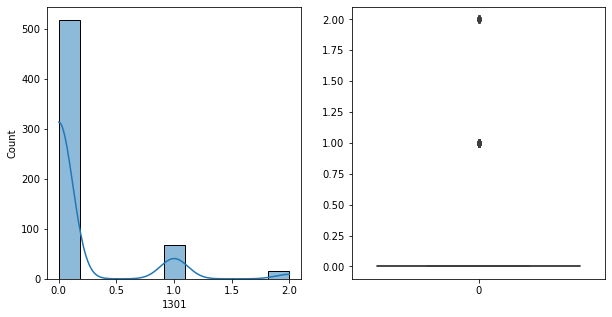

1301   Unique :  [1 0 2]
--------------------------------------------------------------------
1301   N unique :  3
--------------------------------------------------------------------
1301   Value Counts :  0    518
1     67
2     15
Name: 1301, dtype: int64
--------------------------------------------------------------------



[ 1302 ]
show_df_info :  1302


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


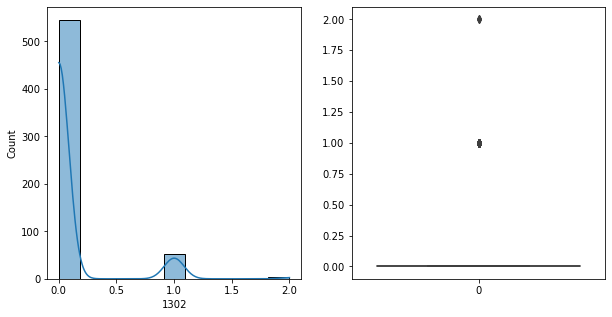

1302   Unique :  [0 1 2]
--------------------------------------------------------------------
1302   N unique :  3
--------------------------------------------------------------------
1302   Value Counts :  0    545
1     52
2      3
Name: 1302, dtype: int64
--------------------------------------------------------------------



[ 1303 ]
show_df_info :  1303


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


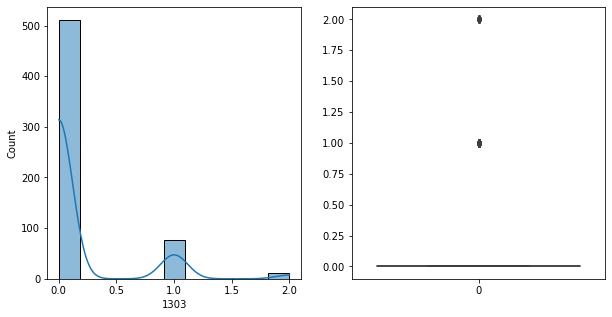

1303   Unique :  [1 0 2]
--------------------------------------------------------------------
1303   N unique :  3
--------------------------------------------------------------------
1303   Value Counts :  0    511
1     77
2     12
Name: 1303, dtype: int64
--------------------------------------------------------------------



[ 1304 ]
show_df_info :  1304


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


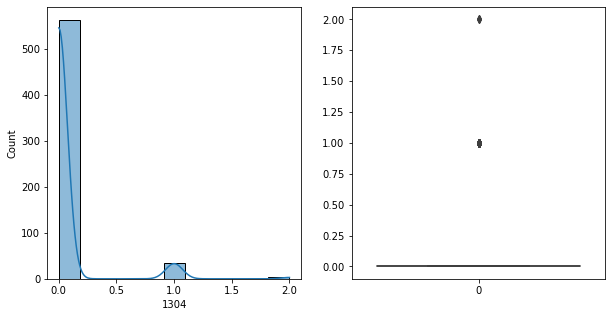

1304   Unique :  [0 1 2]
--------------------------------------------------------------------
1304   N unique :  3
--------------------------------------------------------------------
1304   Value Counts :  0    563
1     34
2      3
Name: 1304, dtype: int64
--------------------------------------------------------------------



[ 1305 ]
show_df_info :  1305


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


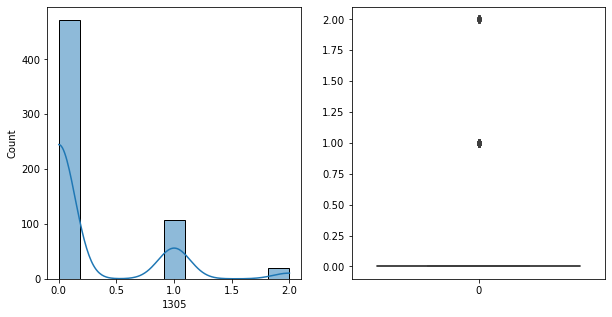

1305   Unique :  [1 0 2]
--------------------------------------------------------------------
1305   N unique :  3
--------------------------------------------------------------------
1305   Value Counts :  0    472
1    108
2     20
Name: 1305, dtype: int64
--------------------------------------------------------------------



[ 1306 ]
show_df_info :  1306


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


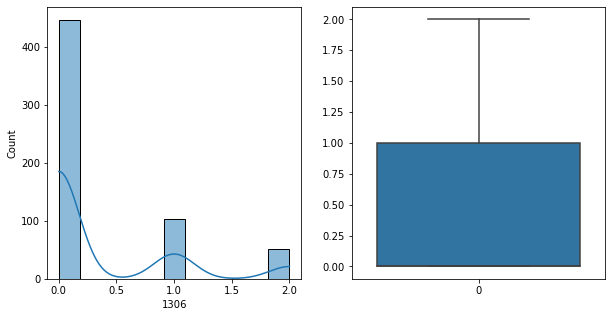

1306   Unique :  [2 0 1]
--------------------------------------------------------------------
1306   N unique :  3
--------------------------------------------------------------------
1306   Value Counts :  0    446
1    103
2     51
Name: 1306, dtype: int64
--------------------------------------------------------------------



[ 1307 ]
show_df_info :  1307


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


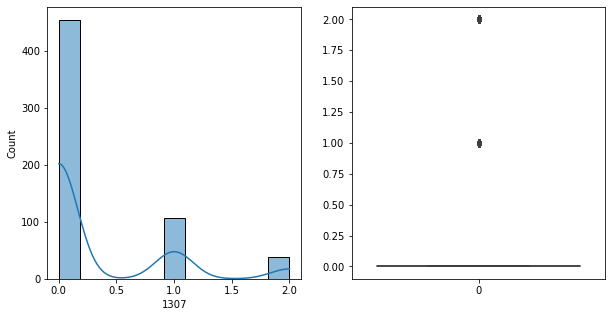

1307   Unique :  [2 0 1]
--------------------------------------------------------------------
1307   N unique :  3
--------------------------------------------------------------------
1307   Value Counts :  0    454
1    107
2     39
Name: 1307, dtype: int64
--------------------------------------------------------------------



[ 1308 ]
show_df_info :  1308


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


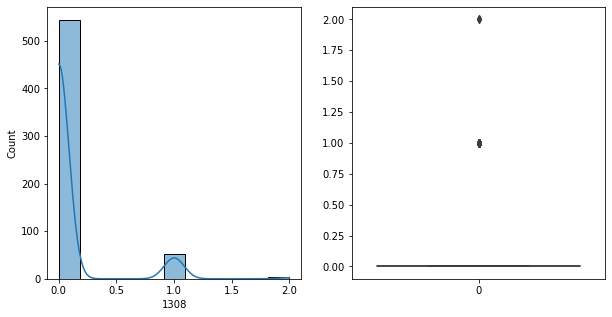

1308   Unique :  [1 0 2]
--------------------------------------------------------------------
1308   N unique :  3
--------------------------------------------------------------------
1308   Value Counts :  0    544
1     53
2      3
Name: 1308, dtype: int64
--------------------------------------------------------------------



[ 1309 ]
show_df_info :  1309


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


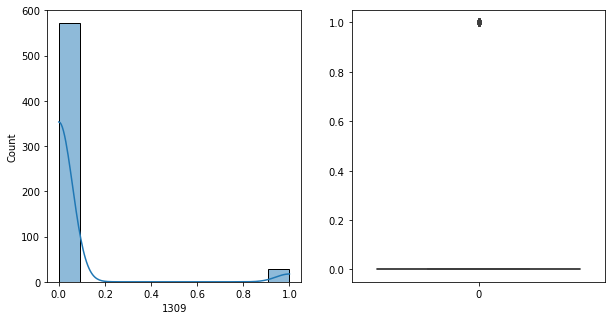

1309   Unique :  [0 1]
--------------------------------------------------------------------
1309   N unique :  2
--------------------------------------------------------------------
1309   Value Counts :  0    572
1     28
Name: 1309, dtype: int64
--------------------------------------------------------------------



[ 1310 ]
show_df_info :  1310


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


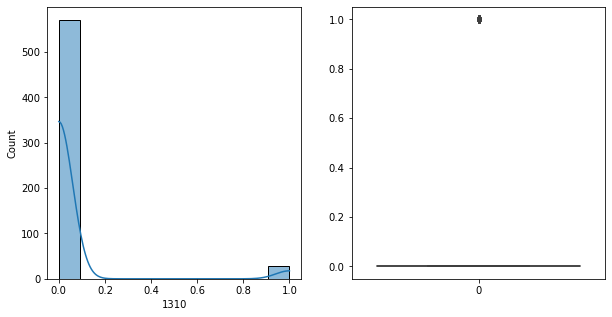

1310   Unique :  [0 1]
--------------------------------------------------------------------
1310   N unique :  2
--------------------------------------------------------------------
1310   Value Counts :  0    571
1     29
Name: 1310, dtype: int64
--------------------------------------------------------------------



[ 1311 ]
show_df_info :  1311


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


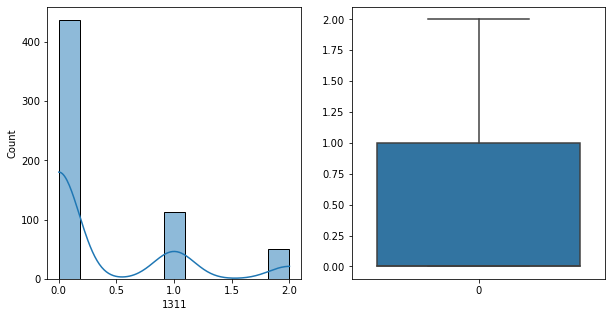

1311   Unique :  [2 0 1]
--------------------------------------------------------------------
1311   N unique :  3
--------------------------------------------------------------------
1311   Value Counts :  0    437
1    112
2     51
Name: 1311, dtype: int64
--------------------------------------------------------------------



[ 1312 ]
show_df_info :  1312


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


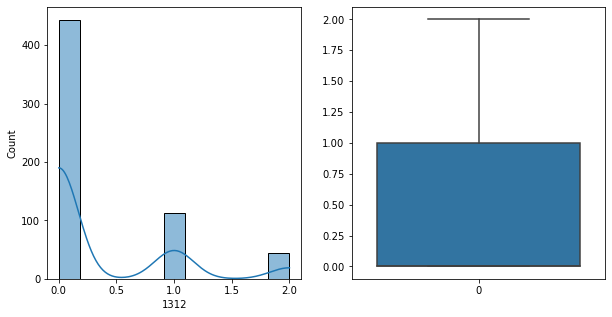

1312   Unique :  [0 1 2]
--------------------------------------------------------------------
1312   N unique :  3
--------------------------------------------------------------------
1312   Value Counts :  0    443
1    113
2     44
Name: 1312, dtype: int64
--------------------------------------------------------------------



[ 1313 ]
show_df_info :  1313


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


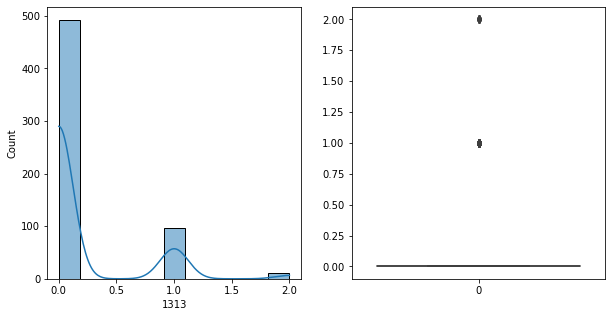

1313   Unique :  [0 1 2]
--------------------------------------------------------------------
1313   N unique :  3
--------------------------------------------------------------------
1313   Value Counts :  0    492
1     97
2     11
Name: 1313, dtype: int64
--------------------------------------------------------------------



[ 1314 ]
show_df_info :  1314


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


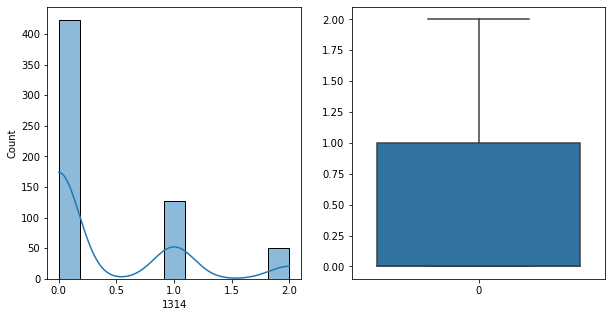

1314   Unique :  [1 0 2]
--------------------------------------------------------------------
1314   N unique :  3
--------------------------------------------------------------------
1314   Value Counts :  0    423
1    127
2     50
Name: 1314, dtype: int64
--------------------------------------------------------------------



[ 1315 ]
show_df_info :  1315


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


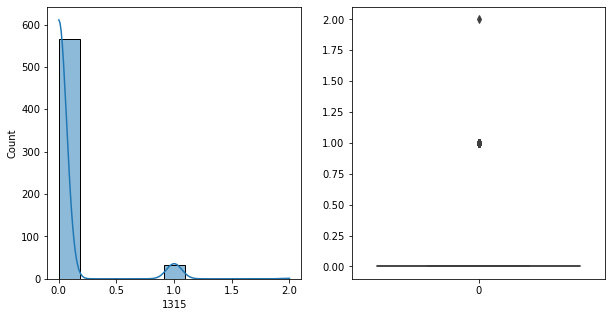

1315   Unique :  [0 1 2]
--------------------------------------------------------------------
1315   N unique :  3
--------------------------------------------------------------------
1315   Value Counts :  0    566
1     33
2      1
Name: 1315, dtype: int64
--------------------------------------------------------------------



[ 1316 ]
show_df_info :  1316


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


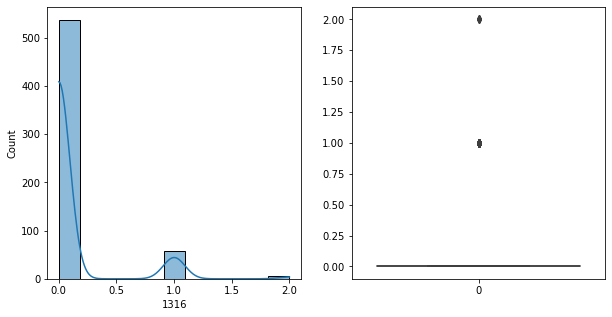

1316   Unique :  [1 0 2]
--------------------------------------------------------------------
1316   N unique :  3
--------------------------------------------------------------------
1316   Value Counts :  0    537
1     58
2      5
Name: 1316, dtype: int64
--------------------------------------------------------------------



[ 1317 ]
show_df_info :  1317


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


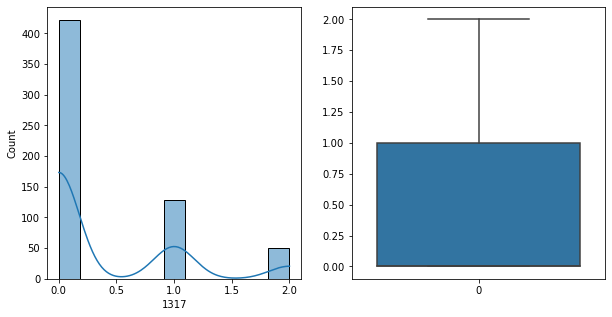

1317   Unique :  [1 0 2]
--------------------------------------------------------------------
1317   N unique :  3
--------------------------------------------------------------------
1317   Value Counts :  0    422
1    128
2     50
Name: 1317, dtype: int64
--------------------------------------------------------------------



[ 1318 ]
show_df_info :  1318


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


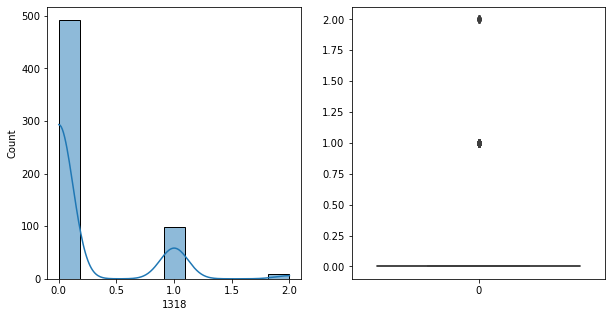

1318   Unique :  [0 1 2]
--------------------------------------------------------------------
1318   N unique :  3
--------------------------------------------------------------------
1318   Value Counts :  0    492
1     98
2     10
Name: 1318, dtype: int64
--------------------------------------------------------------------



[ 1319 ]
show_df_info :  1319


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


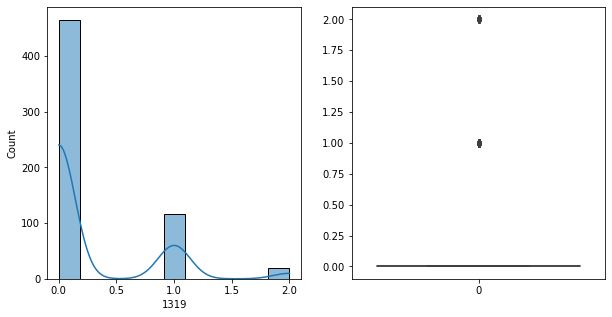

1319   Unique :  [0 1 2]
--------------------------------------------------------------------
1319   N unique :  3
--------------------------------------------------------------------
1319   Value Counts :  0    465
1    116
2     19
Name: 1319, dtype: int64
--------------------------------------------------------------------



[ 1320 ]
show_df_info :  1320


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


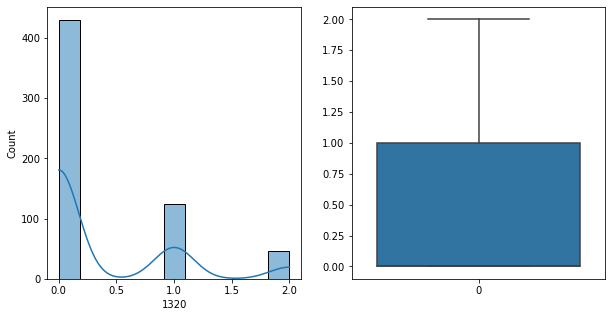

1320   Unique :  [1 0 2]
--------------------------------------------------------------------
1320   N unique :  3
--------------------------------------------------------------------
1320   Value Counts :  0    430
1    124
2     46
Name: 1320, dtype: int64
--------------------------------------------------------------------



[ 1321 ]
show_df_info :  1321


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


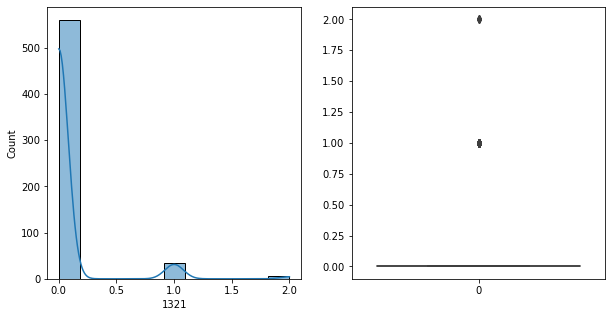

1321   Unique :  [0 1 2]
--------------------------------------------------------------------
1321   N unique :  3
--------------------------------------------------------------------
1321   Value Counts :  0    560
1     35
2      5
Name: 1321, dtype: int64
--------------------------------------------------------------------



[ 1322 ]
show_df_info :  1322


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


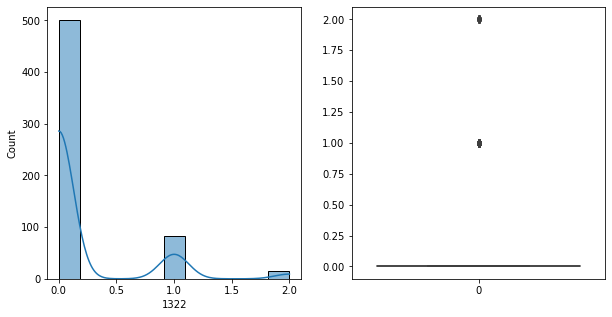

1322   Unique :  [0 1 2]
--------------------------------------------------------------------
1322   N unique :  3
--------------------------------------------------------------------
1322   Value Counts :  0    501
1     83
2     16
Name: 1322, dtype: int64
--------------------------------------------------------------------



[ 1323 ]
show_df_info :  1323


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


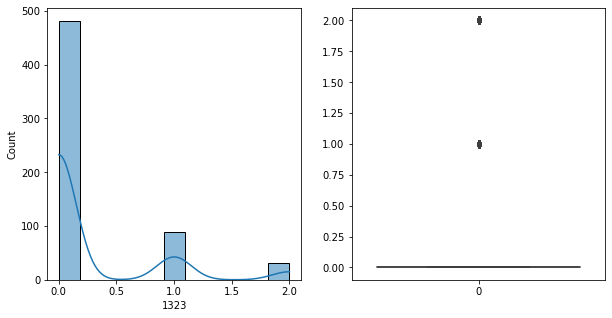

1323   Unique :  [1 0 2]
--------------------------------------------------------------------
1323   N unique :  3
--------------------------------------------------------------------
1323   Value Counts :  0    481
1     88
2     31
Name: 1323, dtype: int64
--------------------------------------------------------------------



[ 1324 ]
show_df_info :  1324


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


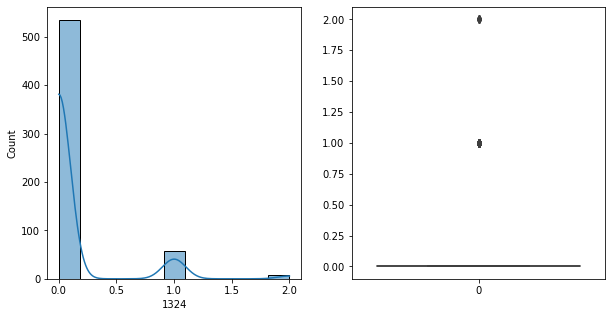

1324   Unique :  [0 1 2]
--------------------------------------------------------------------
1324   N unique :  3
--------------------------------------------------------------------
1324   Value Counts :  0    535
1     57
2      8
Name: 1324, dtype: int64
--------------------------------------------------------------------



[ 1325 ]
show_df_info :  1325


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


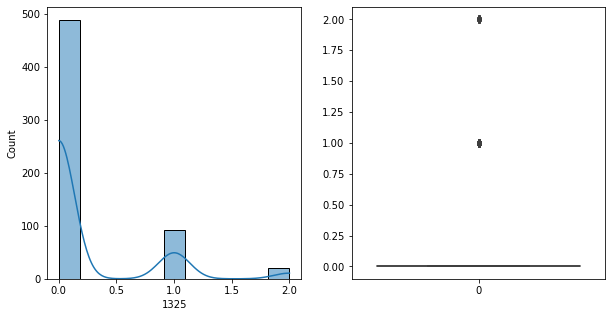

1325   Unique :  [0 1 2]
--------------------------------------------------------------------
1325   N unique :  3
--------------------------------------------------------------------
1325   Value Counts :  0    488
1     92
2     20
Name: 1325, dtype: int64
--------------------------------------------------------------------



[ 1326 ]
show_df_info :  1326


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


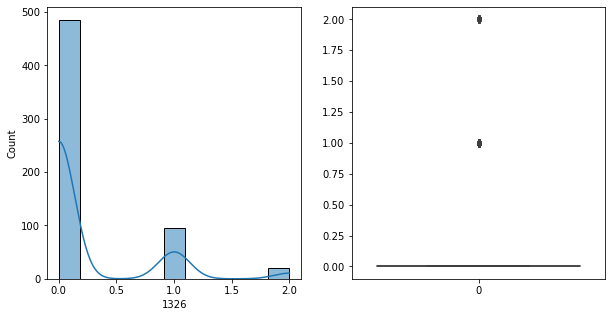

1326   Unique :  [0 1 2]
--------------------------------------------------------------------
1326   N unique :  3
--------------------------------------------------------------------
1326   Value Counts :  0    485
1     95
2     20
Name: 1326, dtype: int64
--------------------------------------------------------------------



[ 1327 ]
show_df_info :  1327


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


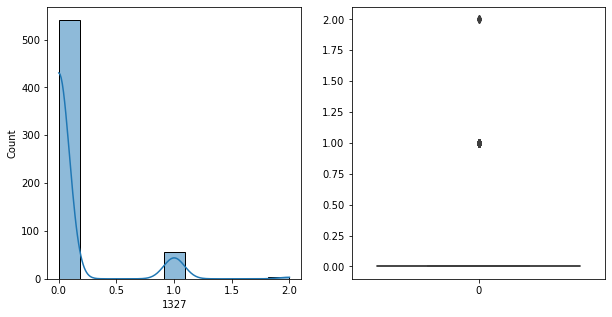

1327   Unique :  [1 0 2]
--------------------------------------------------------------------
1327   N unique :  3
--------------------------------------------------------------------
1327   Value Counts :  0    541
1     55
2      4
Name: 1327, dtype: int64
--------------------------------------------------------------------



[ 1328 ]
show_df_info :  1328


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


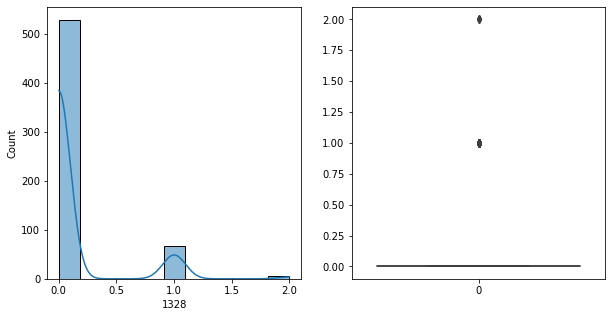

1328   Unique :  [1 0 2]
--------------------------------------------------------------------
1328   N unique :  3
--------------------------------------------------------------------
1328   Value Counts :  0    528
1     67
2      5
Name: 1328, dtype: int64
--------------------------------------------------------------------



[ 1329 ]
show_df_info :  1329


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


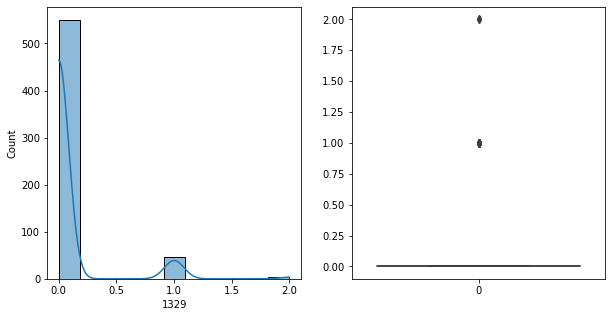

1329   Unique :  [1 0 2]
--------------------------------------------------------------------
1329   N unique :  3
--------------------------------------------------------------------
1329   Value Counts :  0    550
1     46
2      4
Name: 1329, dtype: int64
--------------------------------------------------------------------



[ 1330 ]
show_df_info :  1330


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


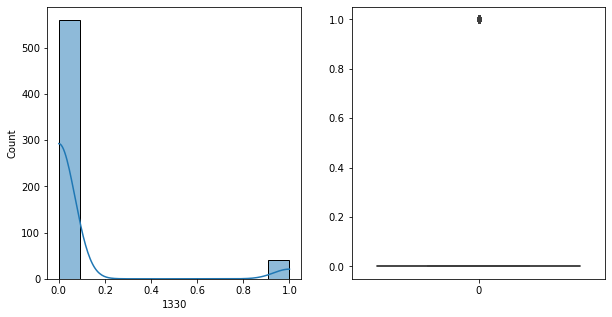

1330   Unique :  [0 1]
--------------------------------------------------------------------
1330   N unique :  2
--------------------------------------------------------------------
1330   Value Counts :  0    560
1     40
Name: 1330, dtype: int64
--------------------------------------------------------------------



[ 1331 ]
show_df_info :  1331


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


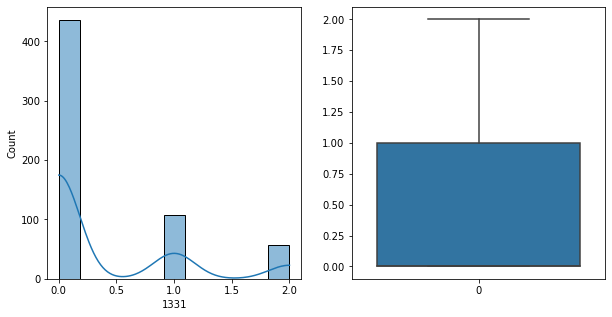

1331   Unique :  [2 0 1]
--------------------------------------------------------------------
1331   N unique :  3
--------------------------------------------------------------------
1331   Value Counts :  0    436
1    107
2     57
Name: 1331, dtype: int64
--------------------------------------------------------------------



[ 1332 ]
show_df_info :  1332


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


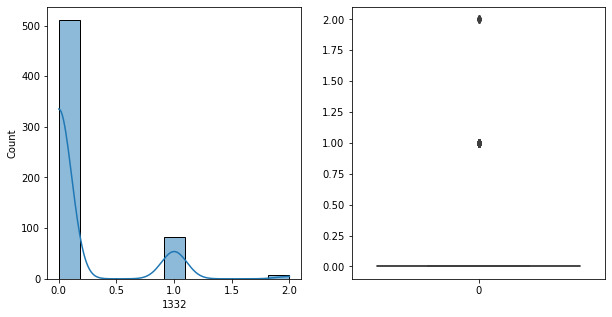

1332   Unique :  [0 1 2]
--------------------------------------------------------------------
1332   N unique :  3
--------------------------------------------------------------------
1332   Value Counts :  0    511
1     82
2      7
Name: 1332, dtype: int64
--------------------------------------------------------------------



[ 1333 ]
show_df_info :  1333


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


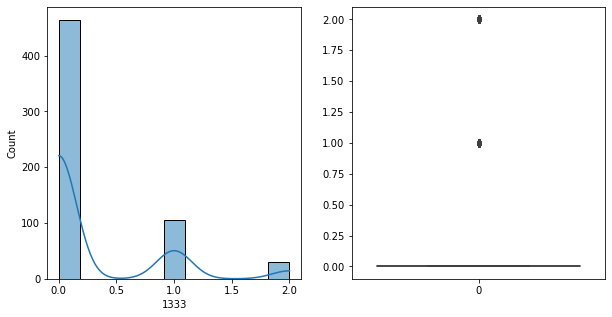

1333   Unique :  [1 0 2]
--------------------------------------------------------------------
1333   N unique :  3
--------------------------------------------------------------------
1333   Value Counts :  0    464
1    106
2     30
Name: 1333, dtype: int64
--------------------------------------------------------------------



[ 1334 ]
show_df_info :  1334


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


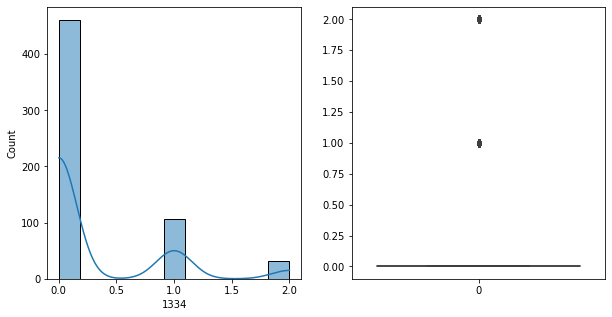

1334   Unique :  [1 0 2]
--------------------------------------------------------------------
1334   N unique :  3
--------------------------------------------------------------------
1334   Value Counts :  0    461
1    107
2     32
Name: 1334, dtype: int64
--------------------------------------------------------------------



[ 1335 ]
show_df_info :  1335


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


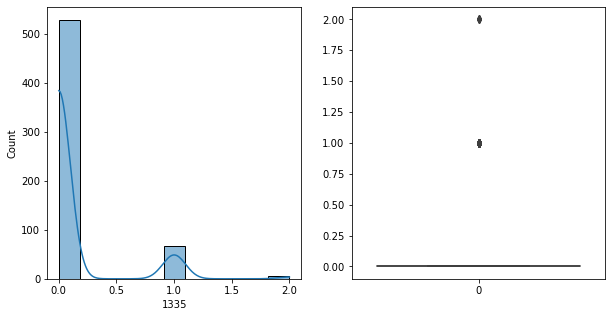

1335   Unique :  [1 0 2]
--------------------------------------------------------------------
1335   N unique :  3
--------------------------------------------------------------------
1335   Value Counts :  0    528
1     67
2      5
Name: 1335, dtype: int64
--------------------------------------------------------------------



[ 1336 ]
show_df_info :  1336


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


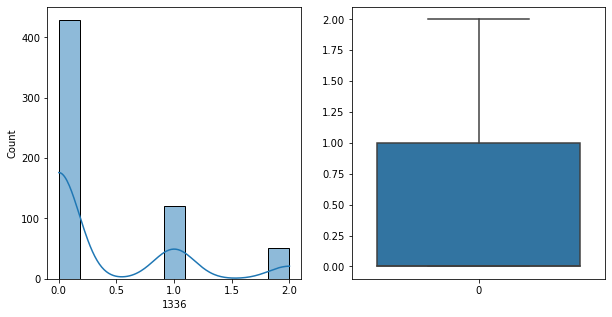

1336   Unique :  [0 1 2]
--------------------------------------------------------------------
1336   N unique :  3
--------------------------------------------------------------------
1336   Value Counts :  0    429
1    120
2     51
Name: 1336, dtype: int64
--------------------------------------------------------------------



[ 1337 ]
show_df_info :  1337


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


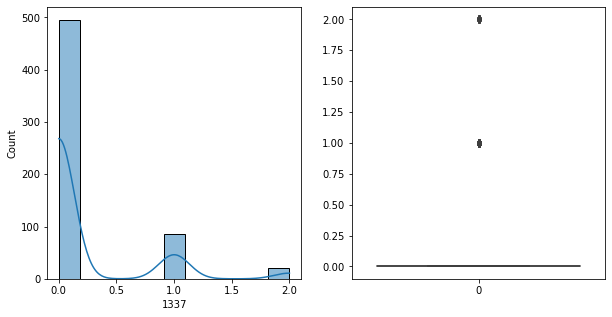

1337   Unique :  [2 0 1]
--------------------------------------------------------------------
1337   N unique :  3
--------------------------------------------------------------------
1337   Value Counts :  0    495
1     85
2     20
Name: 1337, dtype: int64
--------------------------------------------------------------------



[ 1338 ]
show_df_info :  1338


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


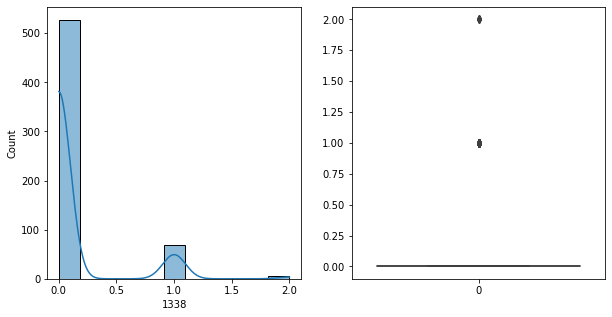

1338   Unique :  [1 0 2]
--------------------------------------------------------------------
1338   N unique :  3
--------------------------------------------------------------------
1338   Value Counts :  0    527
1     68
2      5
Name: 1338, dtype: int64
--------------------------------------------------------------------



[ 1339 ]
show_df_info :  1339


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


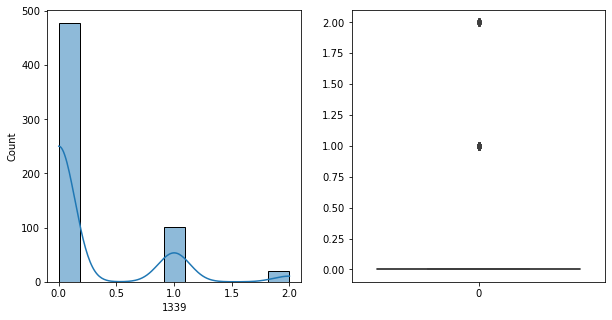

1339   Unique :  [0 1 2]
--------------------------------------------------------------------
1339   N unique :  3
--------------------------------------------------------------------
1339   Value Counts :  0    478
1    102
2     20
Name: 1339, dtype: int64
--------------------------------------------------------------------



[ 1340 ]
show_df_info :  1340


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


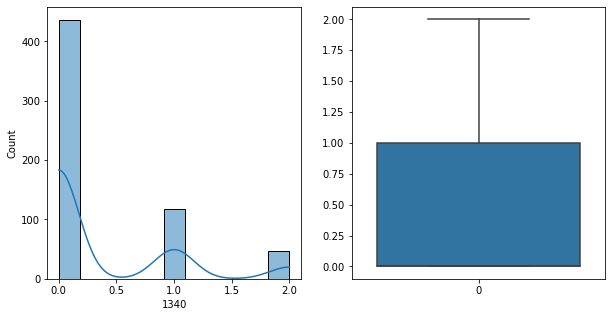

1340   Unique :  [0 1 2]
--------------------------------------------------------------------
1340   N unique :  3
--------------------------------------------------------------------
1340   Value Counts :  0    436
1    117
2     47
Name: 1340, dtype: int64
--------------------------------------------------------------------



[ 1341 ]
show_df_info :  1341


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


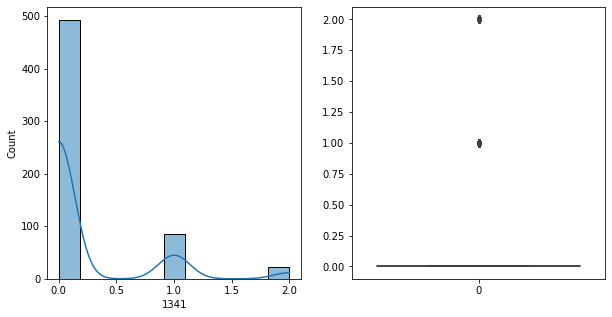

1341   Unique :  [2 0 1]
--------------------------------------------------------------------
1341   N unique :  3
--------------------------------------------------------------------
1341   Value Counts :  0    493
1     85
2     22
Name: 1341, dtype: int64
--------------------------------------------------------------------



[ 1342 ]
show_df_info :  1342


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


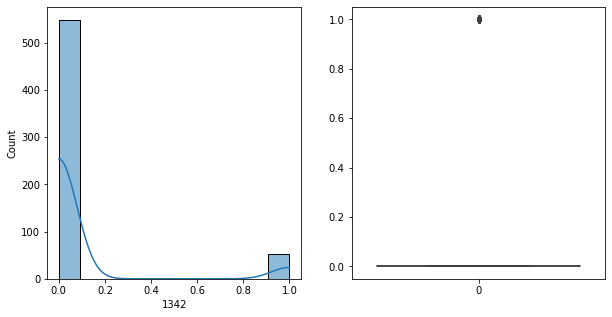

1342   Unique :  [0 1]
--------------------------------------------------------------------
1342   N unique :  2
--------------------------------------------------------------------
1342   Value Counts :  0    548
1     52
Name: 1342, dtype: int64
--------------------------------------------------------------------



[ 1343 ]
show_df_info :  1343


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


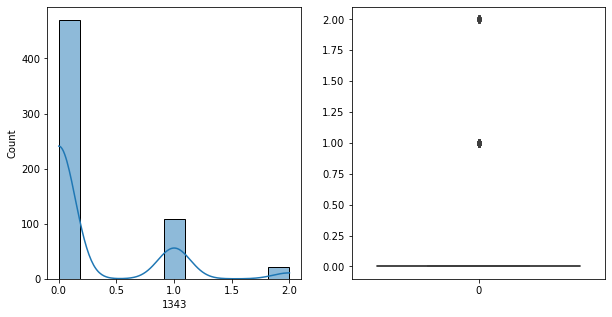

1343   Unique :  [1 0 2]
--------------------------------------------------------------------
1343   N unique :  3
--------------------------------------------------------------------
1343   Value Counts :  0    470
1    109
2     21
Name: 1343, dtype: int64
--------------------------------------------------------------------



[ 1344 ]
show_df_info :  1344


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


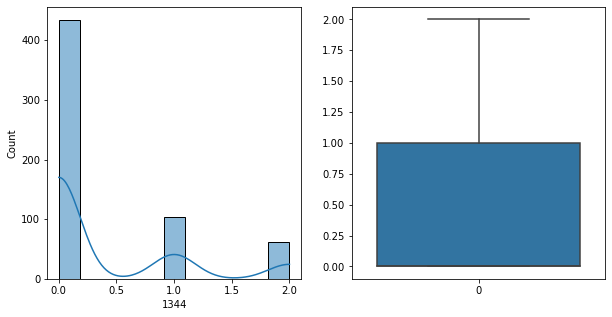

1344   Unique :  [2 0 1]
--------------------------------------------------------------------
1344   N unique :  3
--------------------------------------------------------------------
1344   Value Counts :  0    434
1    104
2     62
Name: 1344, dtype: int64
--------------------------------------------------------------------



[ 1345 ]
show_df_info :  1345


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


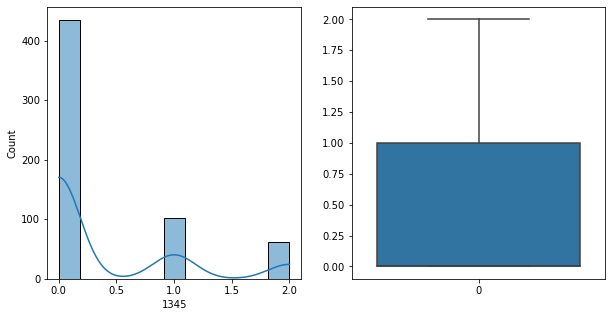

1345   Unique :  [2 0 1]
--------------------------------------------------------------------
1345   N unique :  3
--------------------------------------------------------------------
1345   Value Counts :  0    435
1    103
2     62
Name: 1345, dtype: int64
--------------------------------------------------------------------



[ 1346 ]
show_df_info :  1346


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


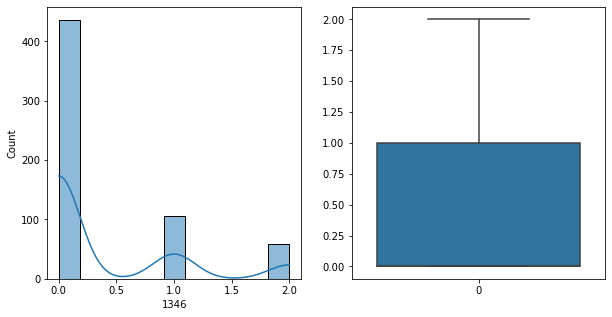

1346   Unique :  [0 1 2]
--------------------------------------------------------------------
1346   N unique :  3
--------------------------------------------------------------------
1346   Value Counts :  0    436
1    105
2     59
Name: 1346, dtype: int64
--------------------------------------------------------------------



[ 1347 ]
show_df_info :  1347


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


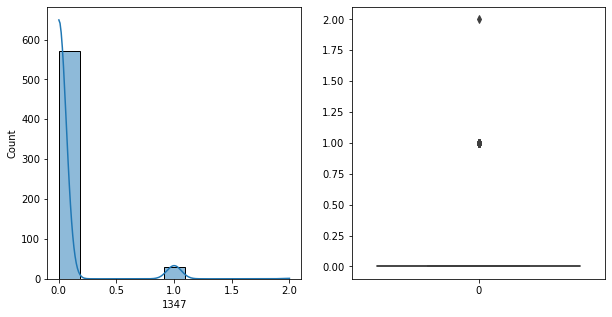

1347   Unique :  [0 1 2]
--------------------------------------------------------------------
1347   N unique :  3
--------------------------------------------------------------------
1347   Value Counts :  0    570
1     29
2      1
Name: 1347, dtype: int64
--------------------------------------------------------------------



[ 1348 ]
show_df_info :  1348


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


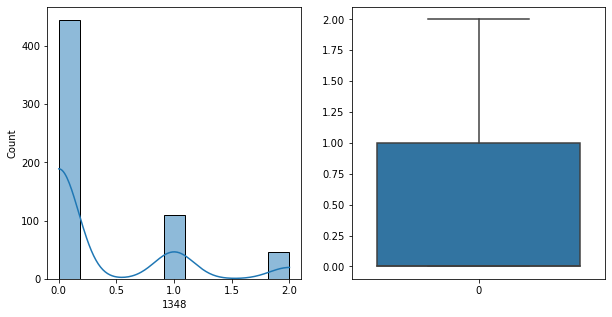

1348   Unique :  [1 0 2]
--------------------------------------------------------------------
1348   N unique :  3
--------------------------------------------------------------------
1348   Value Counts :  0    445
1    109
2     46
Name: 1348, dtype: int64
--------------------------------------------------------------------



[ 1349 ]
show_df_info :  1349


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


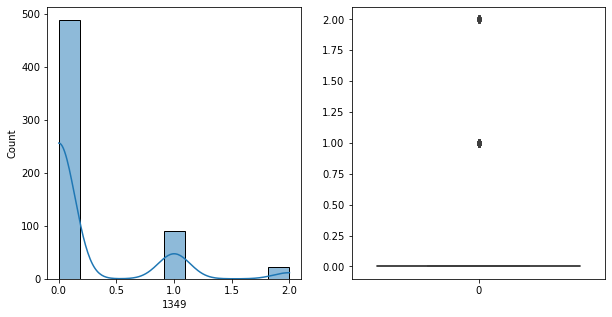

1349   Unique :  [0 1 2]
--------------------------------------------------------------------
1349   N unique :  3
--------------------------------------------------------------------
1349   Value Counts :  0    488
1     90
2     22
Name: 1349, dtype: int64
--------------------------------------------------------------------



[ 1350 ]
show_df_info :  1350


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


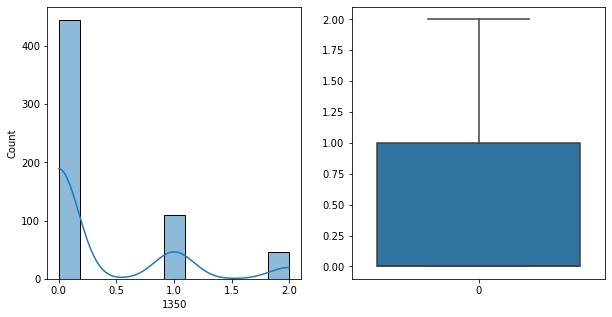

1350   Unique :  [1 0 2]
--------------------------------------------------------------------
1350   N unique :  3
--------------------------------------------------------------------
1350   Value Counts :  0    445
1    109
2     46
Name: 1350, dtype: int64
--------------------------------------------------------------------



[ 1351 ]
show_df_info :  1351


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


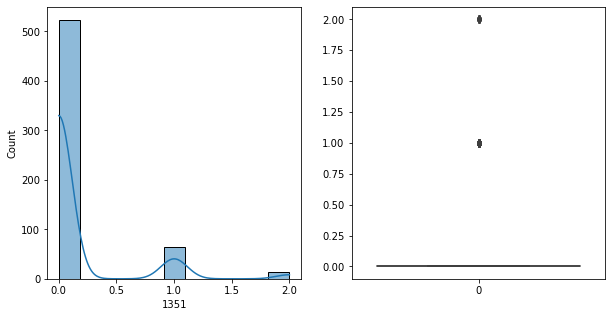

1351   Unique :  [0 1 2]
--------------------------------------------------------------------
1351   N unique :  3
--------------------------------------------------------------------
1351   Value Counts :  0    523
1     64
2     13
Name: 1351, dtype: int64
--------------------------------------------------------------------



[ 1352 ]
show_df_info :  1352


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


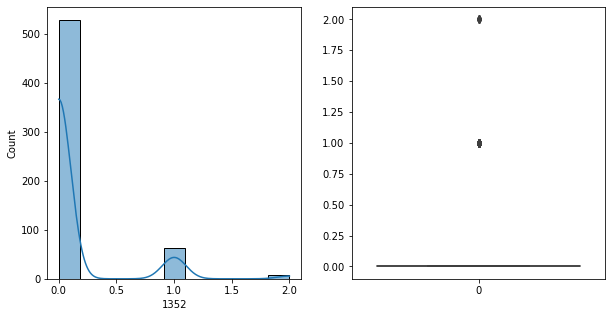

1352   Unique :  [0 1 2]
--------------------------------------------------------------------
1352   N unique :  3
--------------------------------------------------------------------
1352   Value Counts :  0    529
1     63
2      8
Name: 1352, dtype: int64
--------------------------------------------------------------------



[ 1353 ]
show_df_info :  1353


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


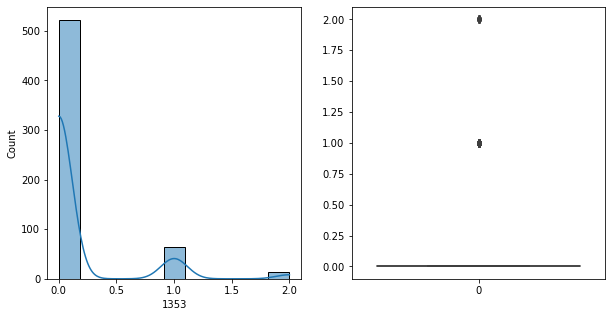

1353   Unique :  [0 1 2]
--------------------------------------------------------------------
1353   N unique :  3
--------------------------------------------------------------------
1353   Value Counts :  0    522
1     65
2     13
Name: 1353, dtype: int64
--------------------------------------------------------------------



[ 1354 ]
show_df_info :  1354


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


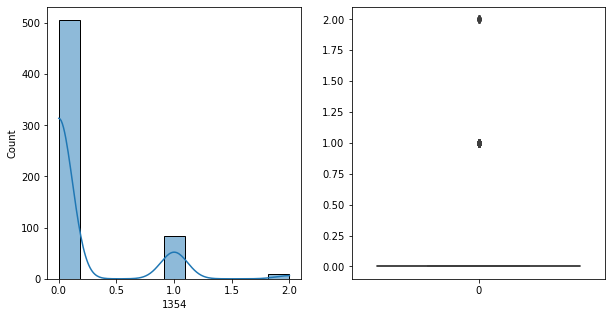

1354   Unique :  [1 0 2]
--------------------------------------------------------------------
1354   N unique :  3
--------------------------------------------------------------------
1354   Value Counts :  0    506
1     84
2     10
Name: 1354, dtype: int64
--------------------------------------------------------------------



[ 1355 ]
show_df_info :  1355


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


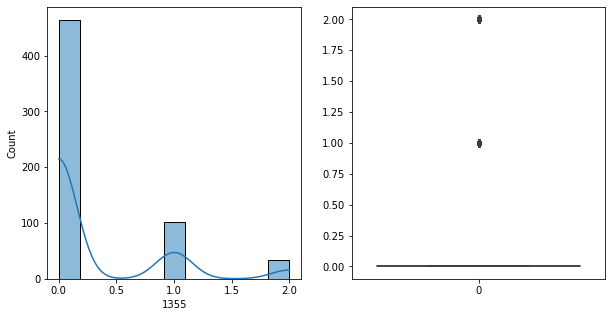

1355   Unique :  [0 1 2]
--------------------------------------------------------------------
1355   N unique :  3
--------------------------------------------------------------------
1355   Value Counts :  0    464
1    102
2     34
Name: 1355, dtype: int64
--------------------------------------------------------------------



[ 1356 ]
show_df_info :  1356


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


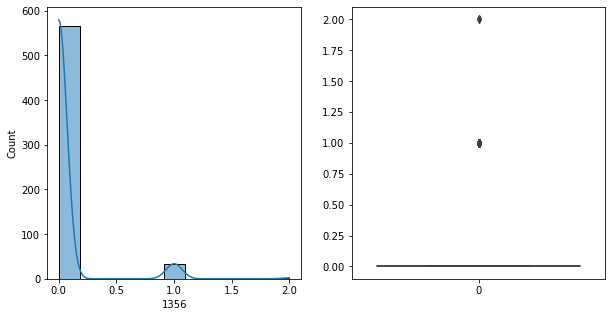

1356   Unique :  [0 1 2]
--------------------------------------------------------------------
1356   N unique :  3
--------------------------------------------------------------------
1356   Value Counts :  0    565
1     33
2      2
Name: 1356, dtype: int64
--------------------------------------------------------------------



[ 1357 ]
show_df_info :  1357


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


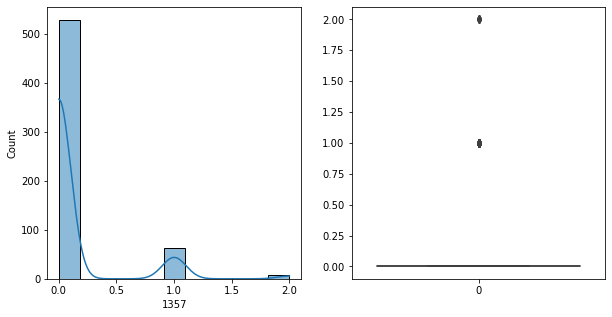

1357   Unique :  [0 1 2]
--------------------------------------------------------------------
1357   N unique :  3
--------------------------------------------------------------------
1357   Value Counts :  0    529
1     63
2      8
Name: 1357, dtype: int64
--------------------------------------------------------------------



[ 1358 ]
show_df_info :  1358


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


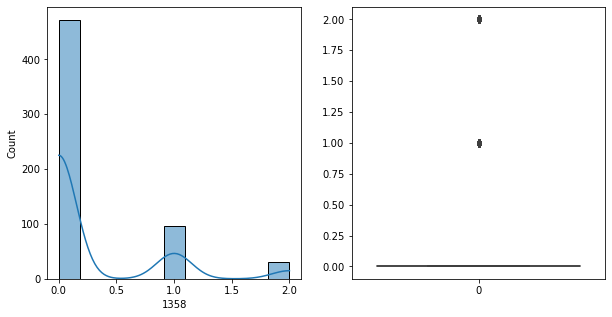

1358   Unique :  [1 0 2]
--------------------------------------------------------------------
1358   N unique :  3
--------------------------------------------------------------------
1358   Value Counts :  0    472
1     97
2     31
Name: 1358, dtype: int64
--------------------------------------------------------------------



[ 1359 ]
show_df_info :  1359


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


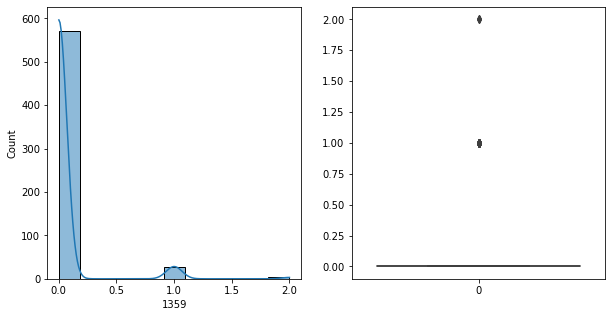

1359   Unique :  [0 1 2]
--------------------------------------------------------------------
1359   N unique :  3
--------------------------------------------------------------------
1359   Value Counts :  0    570
1     27
2      3
Name: 1359, dtype: int64
--------------------------------------------------------------------



[ 1360 ]
show_df_info :  1360


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


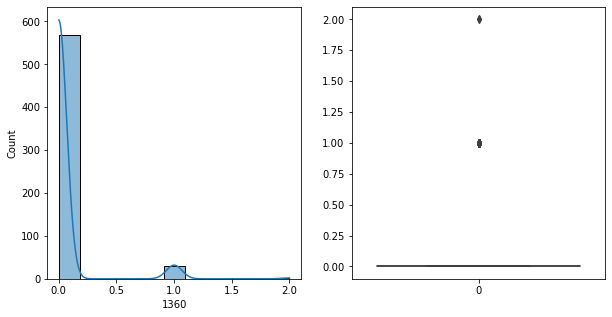

1360   Unique :  [0 1 2]
--------------------------------------------------------------------
1360   N unique :  3
--------------------------------------------------------------------
1360   Value Counts :  0    568
1     30
2      2
Name: 1360, dtype: int64
--------------------------------------------------------------------



[ 1361 ]
show_df_info :  1361


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


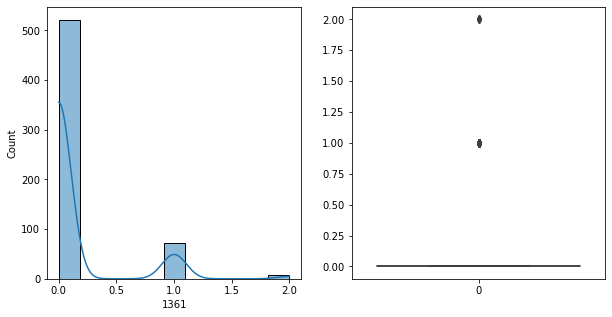

1361   Unique :  [1 0 2]
--------------------------------------------------------------------
1361   N unique :  3
--------------------------------------------------------------------
1361   Value Counts :  0    521
1     72
2      7
Name: 1361, dtype: int64
--------------------------------------------------------------------



[ 1362 ]
show_df_info :  1362


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


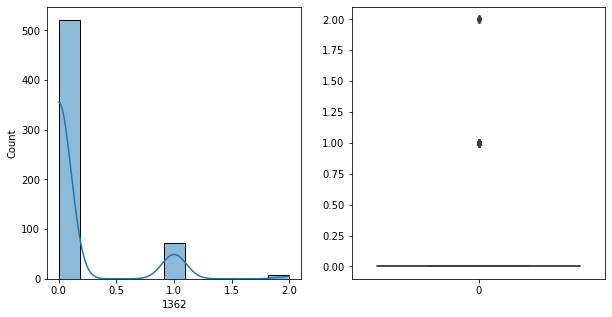

1362   Unique :  [1 0 2]
--------------------------------------------------------------------
1362   N unique :  3
--------------------------------------------------------------------
1362   Value Counts :  0    521
1     72
2      7
Name: 1362, dtype: int64
--------------------------------------------------------------------



[ 1363 ]
show_df_info :  1363


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


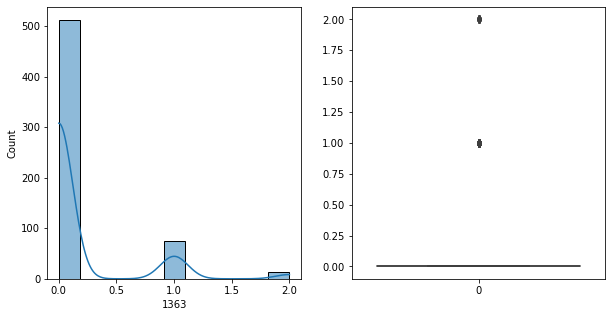

1363   Unique :  [0 1 2]
--------------------------------------------------------------------
1363   N unique :  3
--------------------------------------------------------------------
1363   Value Counts :  0    512
1     74
2     14
Name: 1363, dtype: int64
--------------------------------------------------------------------



[ 1364 ]
show_df_info :  1364


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


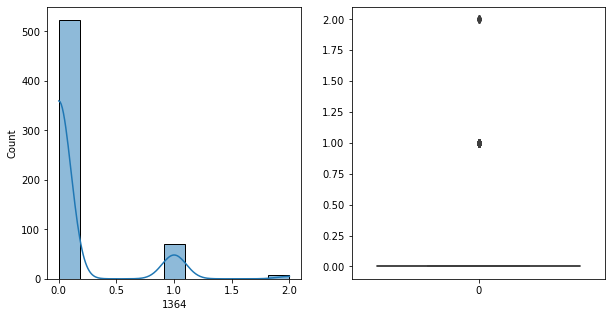

1364   Unique :  [1 0 2]
--------------------------------------------------------------------
1364   N unique :  3
--------------------------------------------------------------------
1364   Value Counts :  0    523
1     70
2      7
Name: 1364, dtype: int64
--------------------------------------------------------------------



[ 1365 ]
show_df_info :  1365


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


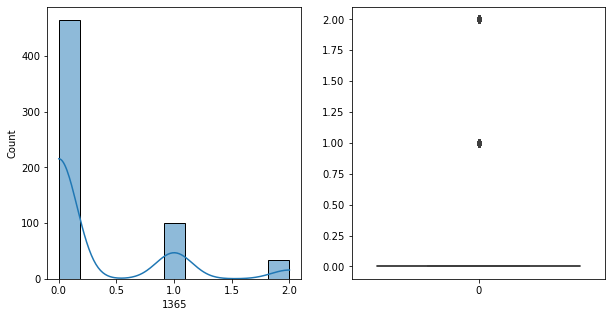

1365   Unique :  [1 0 2]
--------------------------------------------------------------------
1365   N unique :  3
--------------------------------------------------------------------
1365   Value Counts :  0    465
1    101
2     34
Name: 1365, dtype: int64
--------------------------------------------------------------------



[ 1366 ]
show_df_info :  1366


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


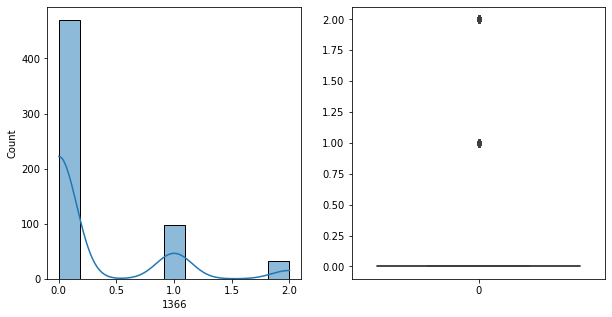

1366   Unique :  [1 0 2]
--------------------------------------------------------------------
1366   N unique :  3
--------------------------------------------------------------------
1366   Value Counts :  0    470
1     98
2     32
Name: 1366, dtype: int64
--------------------------------------------------------------------



[ 1367 ]
show_df_info :  1367


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


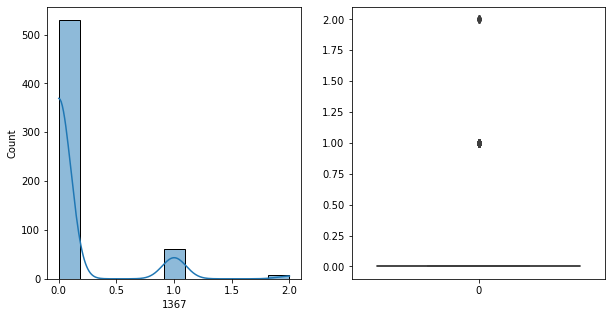

1367   Unique :  [0 1 2]
--------------------------------------------------------------------
1367   N unique :  3
--------------------------------------------------------------------
1367   Value Counts :  0    530
1     62
2      8
Name: 1367, dtype: int64
--------------------------------------------------------------------



[ 1368 ]
show_df_info :  1368


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


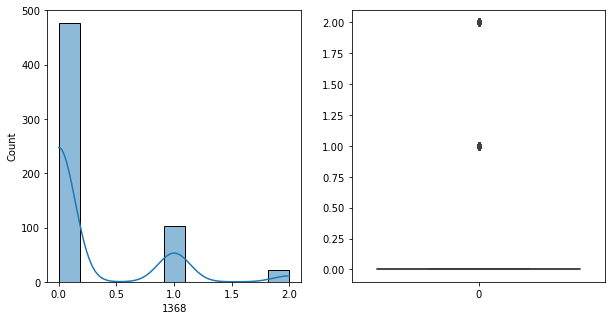

1368   Unique :  [1 0 2]
--------------------------------------------------------------------
1368   N unique :  3
--------------------------------------------------------------------
1368   Value Counts :  0    477
1    102
2     21
Name: 1368, dtype: int64
--------------------------------------------------------------------



[ 1369 ]
show_df_info :  1369


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


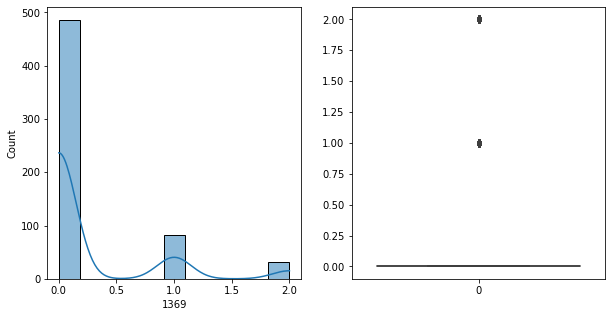

1369   Unique :  [1 0 2]
--------------------------------------------------------------------
1369   N unique :  3
--------------------------------------------------------------------
1369   Value Counts :  0    486
1     83
2     31
Name: 1369, dtype: int64
--------------------------------------------------------------------



[ 1370 ]
show_df_info :  1370


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


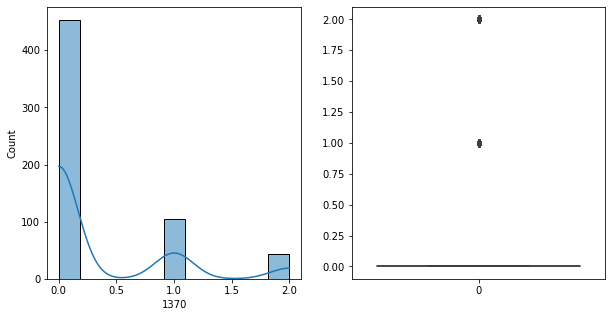

1370   Unique :  [1 0 2]
--------------------------------------------------------------------
1370   N unique :  3
--------------------------------------------------------------------
1370   Value Counts :  0    453
1    104
2     43
Name: 1370, dtype: int64
--------------------------------------------------------------------



[ 1371 ]
show_df_info :  1371


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


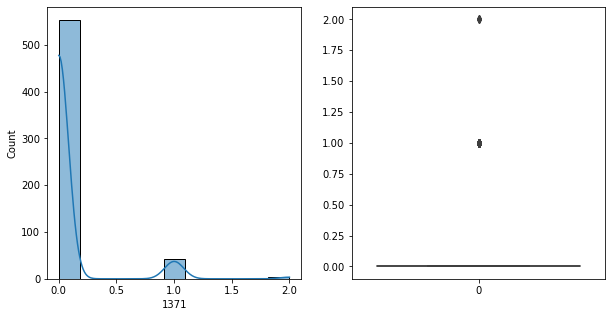

1371   Unique :  [0 1 2]
--------------------------------------------------------------------
1371   N unique :  3
--------------------------------------------------------------------
1371   Value Counts :  0    553
1     43
2      4
Name: 1371, dtype: int64
--------------------------------------------------------------------



[ 1372 ]
show_df_info :  1372


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


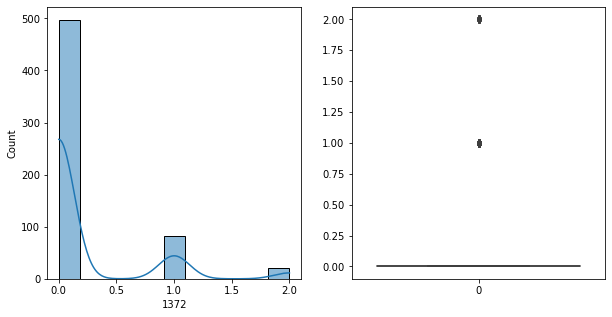

1372   Unique :  [1 0 2]
--------------------------------------------------------------------
1372   N unique :  3
--------------------------------------------------------------------
1372   Value Counts :  0    497
1     82
2     21
Name: 1372, dtype: int64
--------------------------------------------------------------------



[ 1373 ]
show_df_info :  1373


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


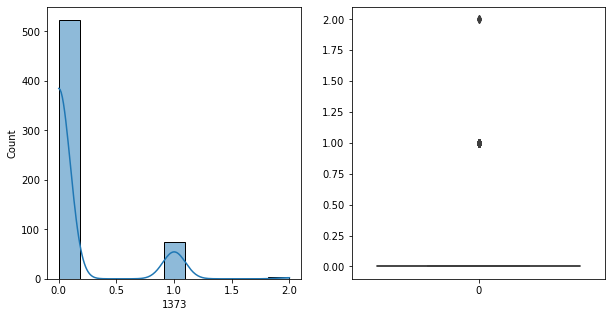

1373   Unique :  [1 0 2]
--------------------------------------------------------------------
1373   N unique :  3
--------------------------------------------------------------------
1373   Value Counts :  0    523
1     74
2      3
Name: 1373, dtype: int64
--------------------------------------------------------------------



[ 1374 ]
show_df_info :  1374


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


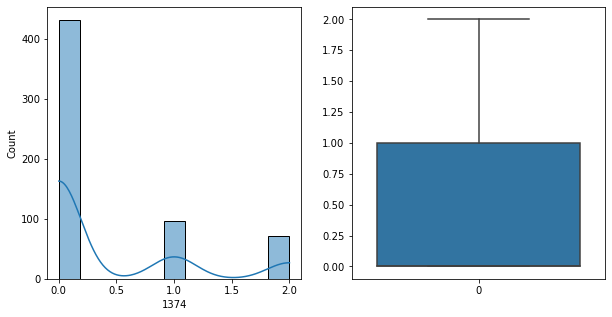

1374   Unique :  [2 0 1]
--------------------------------------------------------------------
1374   N unique :  3
--------------------------------------------------------------------
1374   Value Counts :  0    432
1     97
2     71
Name: 1374, dtype: int64
--------------------------------------------------------------------



[ 1375 ]
show_df_info :  1375


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


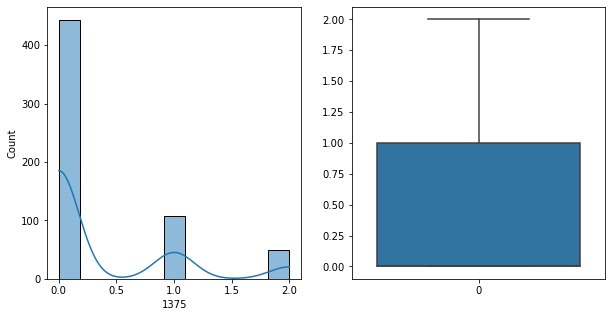

1375   Unique :  [1 0 2]
--------------------------------------------------------------------
1375   N unique :  3
--------------------------------------------------------------------
1375   Value Counts :  0    443
1    108
2     49
Name: 1375, dtype: int64
--------------------------------------------------------------------



[ 1376 ]
show_df_info :  1376


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


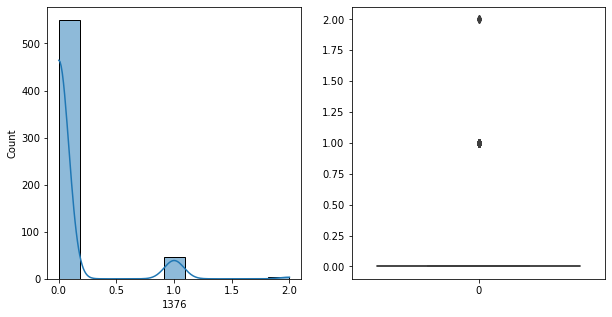

1376   Unique :  [0 1 2]
--------------------------------------------------------------------
1376   N unique :  3
--------------------------------------------------------------------
1376   Value Counts :  0    550
1     46
2      4
Name: 1376, dtype: int64
--------------------------------------------------------------------



[ 1377 ]
show_df_info :  1377


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


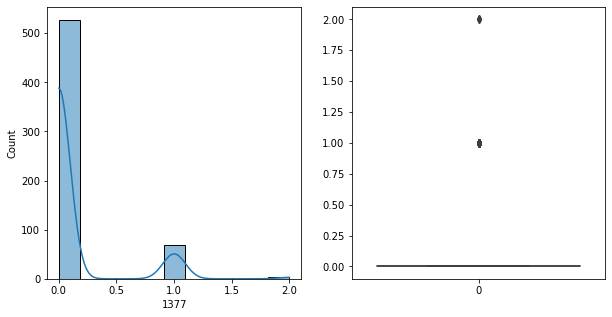

1377   Unique :  [1 0 2]
--------------------------------------------------------------------
1377   N unique :  3
--------------------------------------------------------------------
1377   Value Counts :  0    527
1     69
2      4
Name: 1377, dtype: int64
--------------------------------------------------------------------



[ 1378 ]
show_df_info :  1378


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


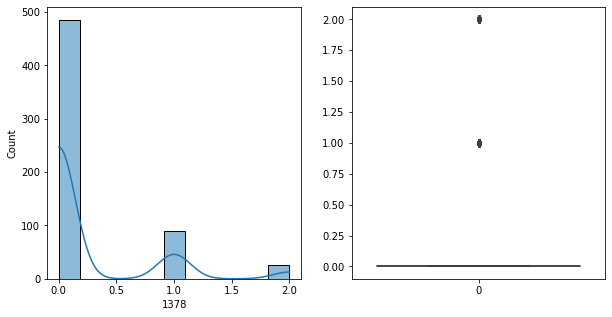

1378   Unique :  [1 0 2]
--------------------------------------------------------------------
1378   N unique :  3
--------------------------------------------------------------------
1378   Value Counts :  0    485
1     90
2     25
Name: 1378, dtype: int64
--------------------------------------------------------------------



[ 1379 ]
show_df_info :  1379


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


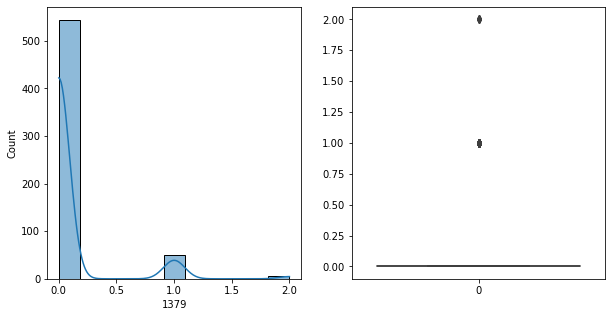

1379   Unique :  [0 1 2]
--------------------------------------------------------------------
1379   N unique :  3
--------------------------------------------------------------------
1379   Value Counts :  0    544
1     50
2      6
Name: 1379, dtype: int64
--------------------------------------------------------------------



[ 1380 ]
show_df_info :  1380


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


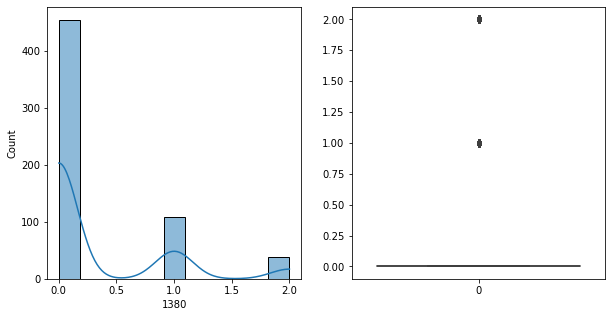

1380   Unique :  [1 0 2]
--------------------------------------------------------------------
1380   N unique :  3
--------------------------------------------------------------------
1380   Value Counts :  0    454
1    108
2     38
Name: 1380, dtype: int64
--------------------------------------------------------------------



[ 1381 ]
show_df_info :  1381


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


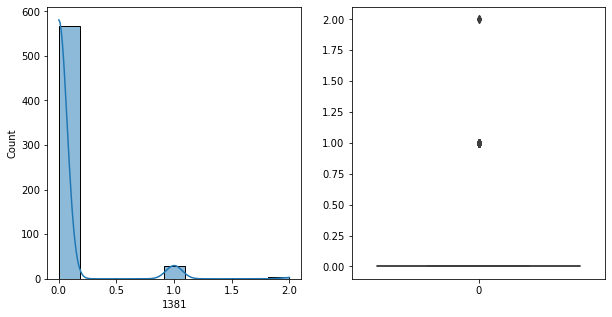

1381   Unique :  [0 1 2]
--------------------------------------------------------------------
1381   N unique :  3
--------------------------------------------------------------------
1381   Value Counts :  0    568
1     29
2      3
Name: 1381, dtype: int64
--------------------------------------------------------------------



[ 1382 ]
show_df_info :  1382


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


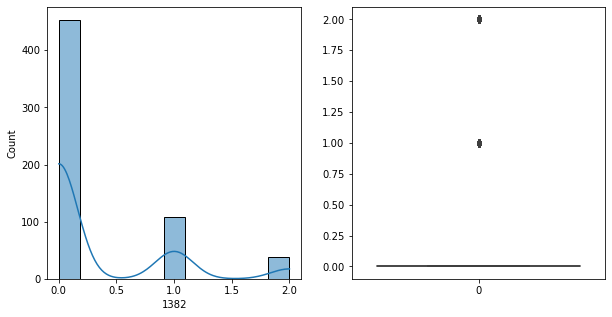

1382   Unique :  [1 0 2]
--------------------------------------------------------------------
1382   N unique :  3
--------------------------------------------------------------------
1382   Value Counts :  0    453
1    108
2     39
Name: 1382, dtype: int64
--------------------------------------------------------------------



[ 1383 ]
show_df_info :  1383


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


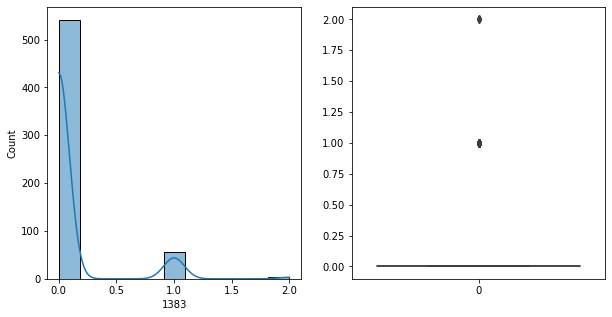

1383   Unique :  [0 1 2]
--------------------------------------------------------------------
1383   N unique :  3
--------------------------------------------------------------------
1383   Value Counts :  0    541
1     55
2      4
Name: 1383, dtype: int64
--------------------------------------------------------------------



[ 1384 ]
show_df_info :  1384


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


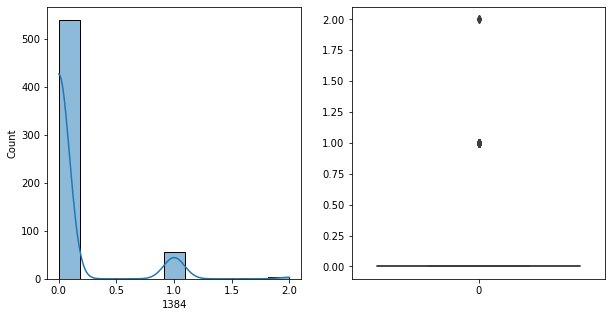

1384   Unique :  [0 1 2]
--------------------------------------------------------------------
1384   N unique :  3
--------------------------------------------------------------------
1384   Value Counts :  0    540
1     56
2      4
Name: 1384, dtype: int64
--------------------------------------------------------------------



[ 1385 ]
show_df_info :  1385


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


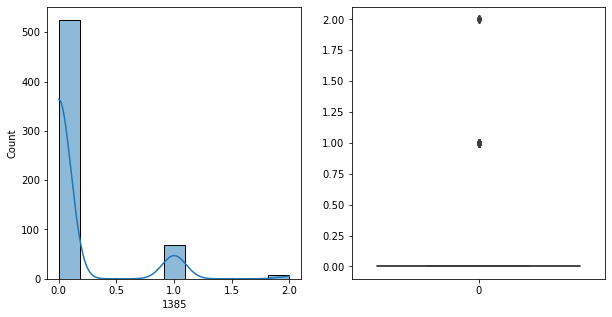

1385   Unique :  [0 1 2]
--------------------------------------------------------------------
1385   N unique :  3
--------------------------------------------------------------------
1385   Value Counts :  0    525
1     68
2      7
Name: 1385, dtype: int64
--------------------------------------------------------------------



[ 1386 ]
show_df_info :  1386


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


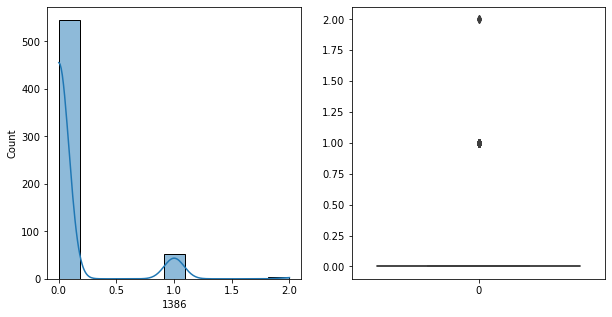

1386   Unique :  [0 1 2]
--------------------------------------------------------------------
1386   N unique :  3
--------------------------------------------------------------------
1386   Value Counts :  0    545
1     52
2      3
Name: 1386, dtype: int64
--------------------------------------------------------------------



[ 1387 ]
show_df_info :  1387


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


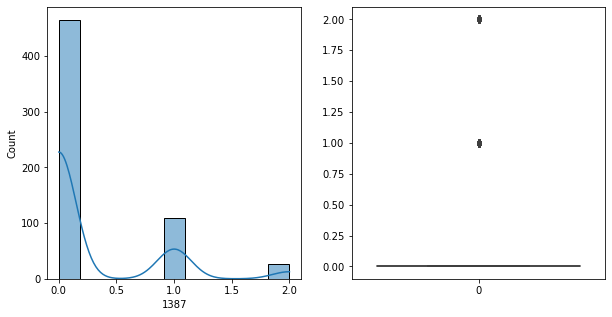

1387   Unique :  [1 0 2]
--------------------------------------------------------------------
1387   N unique :  3
--------------------------------------------------------------------
1387   Value Counts :  0    465
1    109
2     26
Name: 1387, dtype: int64
--------------------------------------------------------------------



[ 1388 ]
show_df_info :  1388


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


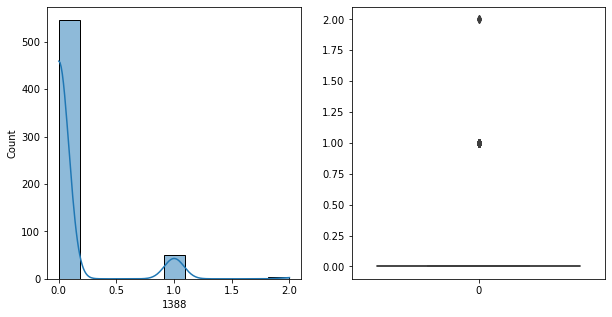

1388   Unique :  [0 1 2]
--------------------------------------------------------------------
1388   N unique :  3
--------------------------------------------------------------------
1388   Value Counts :  0    546
1     51
2      3
Name: 1388, dtype: int64
--------------------------------------------------------------------



[ 1389 ]
show_df_info :  1389


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


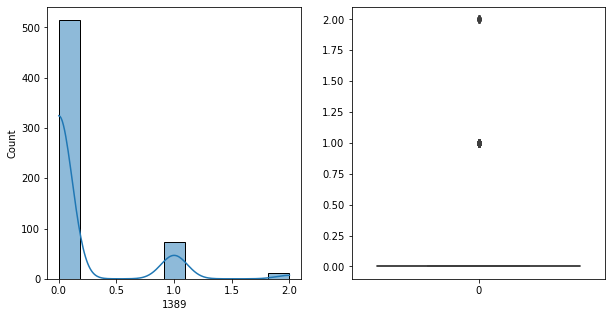

1389   Unique :  [1 0 2]
--------------------------------------------------------------------
1389   N unique :  3
--------------------------------------------------------------------
1389   Value Counts :  0    515
1     74
2     11
Name: 1389, dtype: int64
--------------------------------------------------------------------



[ 1390 ]
show_df_info :  1390


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


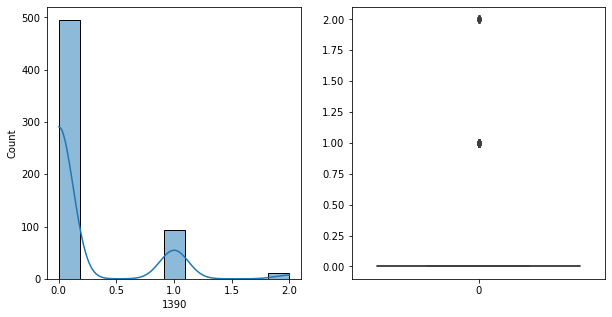

1390   Unique :  [0 1 2]
--------------------------------------------------------------------
1390   N unique :  3
--------------------------------------------------------------------
1390   Value Counts :  0    495
1     93
2     12
Name: 1390, dtype: int64
--------------------------------------------------------------------



[ 1391 ]
show_df_info :  1391


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


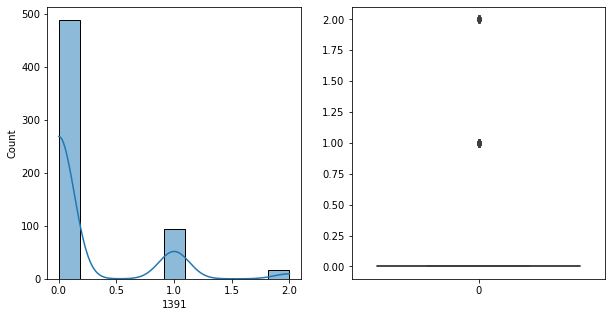

1391   Unique :  [1 0 2]
--------------------------------------------------------------------
1391   N unique :  3
--------------------------------------------------------------------
1391   Value Counts :  0    489
1     94
2     17
Name: 1391, dtype: int64
--------------------------------------------------------------------



[ 1392 ]
show_df_info :  1392


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


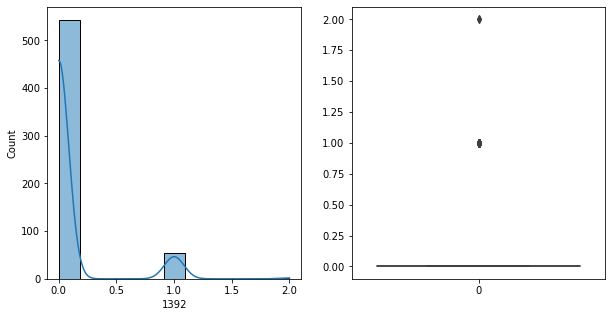

1392   Unique :  [0 1 2]
--------------------------------------------------------------------
1392   N unique :  3
--------------------------------------------------------------------
1392   Value Counts :  0    543
1     55
2      2
Name: 1392, dtype: int64
--------------------------------------------------------------------



[ 1393 ]
show_df_info :  1393


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


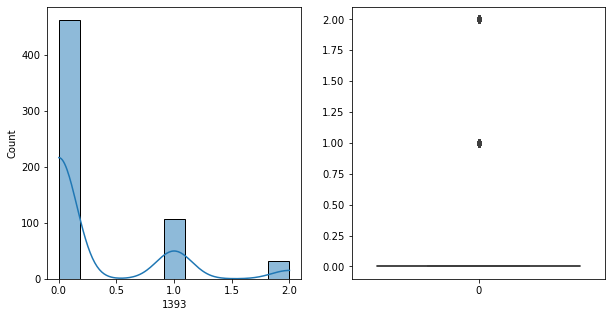

1393   Unique :  [1 0 2]
--------------------------------------------------------------------
1393   N unique :  3
--------------------------------------------------------------------
1393   Value Counts :  0    462
1    106
2     32
Name: 1393, dtype: int64
--------------------------------------------------------------------



[ 1394 ]
show_df_info :  1394


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


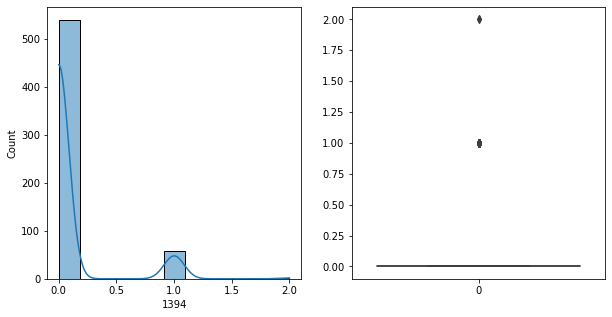

1394   Unique :  [0 1 2]
--------------------------------------------------------------------
1394   N unique :  3
--------------------------------------------------------------------
1394   Value Counts :  0    540
1     58
2      2
Name: 1394, dtype: int64
--------------------------------------------------------------------



[ 1395 ]
show_df_info :  1395


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


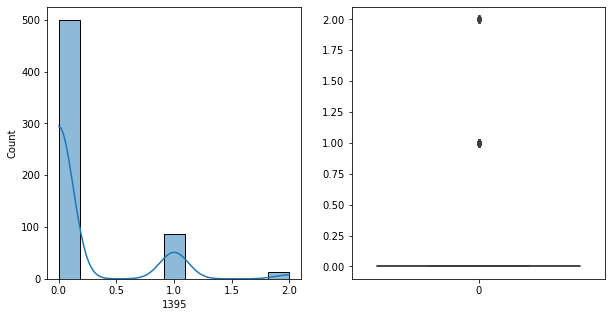

1395   Unique :  [1 0 2]
--------------------------------------------------------------------
1395   N unique :  3
--------------------------------------------------------------------
1395   Value Counts :  0    500
1     87
2     13
Name: 1395, dtype: int64
--------------------------------------------------------------------



[ 1396 ]
show_df_info :  1396


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


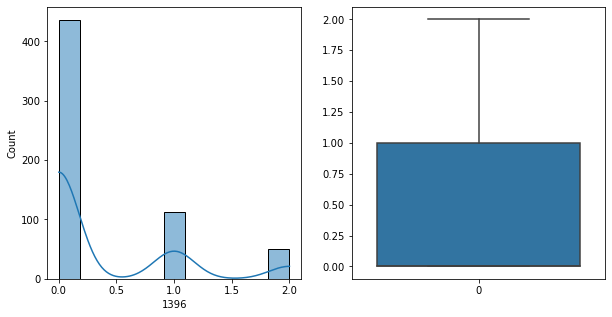

1396   Unique :  [1 0 2]
--------------------------------------------------------------------
1396   N unique :  3
--------------------------------------------------------------------
1396   Value Counts :  0    436
1    113
2     51
Name: 1396, dtype: int64
--------------------------------------------------------------------



[ 1397 ]
show_df_info :  1397


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


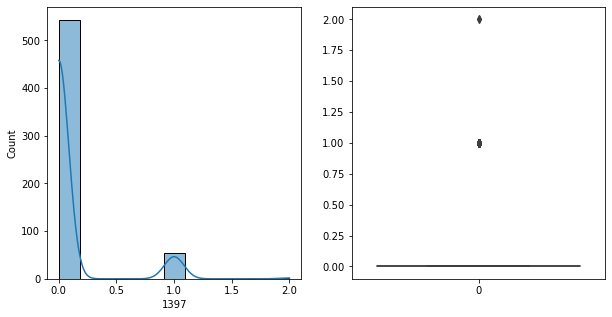

1397   Unique :  [0 1 2]
--------------------------------------------------------------------
1397   N unique :  3
--------------------------------------------------------------------
1397   Value Counts :  0    543
1     55
2      2
Name: 1397, dtype: int64
--------------------------------------------------------------------



[ 1398 ]
show_df_info :  1398


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


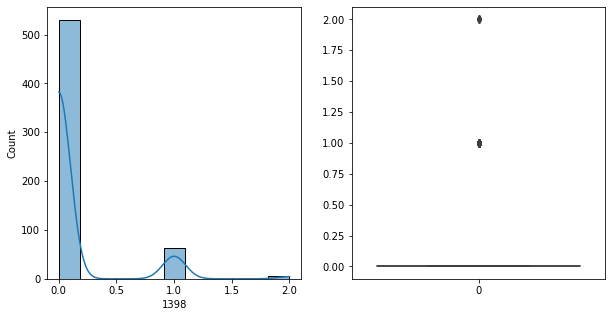

1398   Unique :  [0 1 2]
--------------------------------------------------------------------
1398   N unique :  3
--------------------------------------------------------------------
1398   Value Counts :  0    530
1     64
2      6
Name: 1398, dtype: int64
--------------------------------------------------------------------



[ 1399 ]
show_df_info :  1399


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


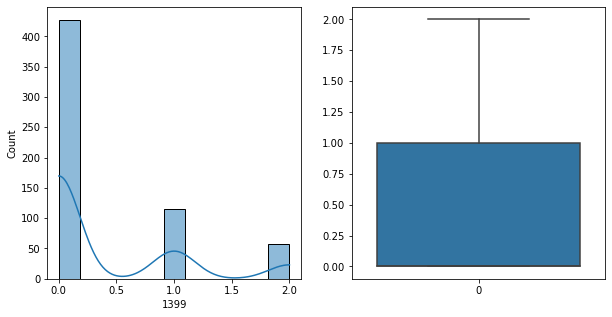

1399   Unique :  [2 0 1]
--------------------------------------------------------------------
1399   N unique :  3
--------------------------------------------------------------------
1399   Value Counts :  0    427
1    115
2     58
Name: 1399, dtype: int64
--------------------------------------------------------------------



[ 1400 ]
show_df_info :  1400


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


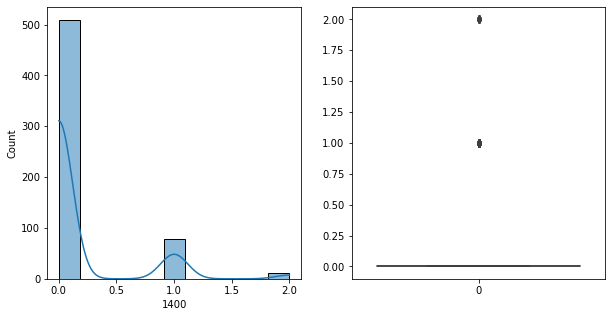

1400   Unique :  [0 1 2]
--------------------------------------------------------------------
1400   N unique :  3
--------------------------------------------------------------------
1400   Value Counts :  0    509
1     79
2     12
Name: 1400, dtype: int64
--------------------------------------------------------------------



[ 1401 ]
show_df_info :  1401


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


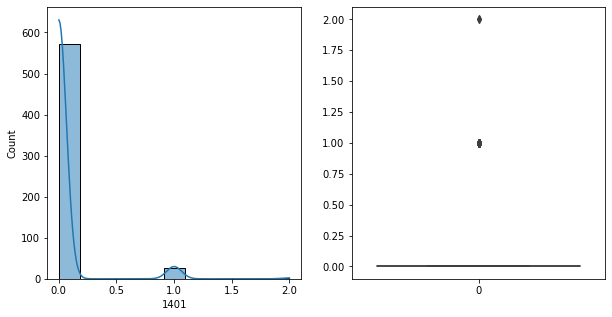

1401   Unique :  [0 1 2]
--------------------------------------------------------------------
1401   N unique :  3
--------------------------------------------------------------------
1401   Value Counts :  0    571
1     27
2      2
Name: 1401, dtype: int64
--------------------------------------------------------------------



[ 1402 ]
show_df_info :  1402


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


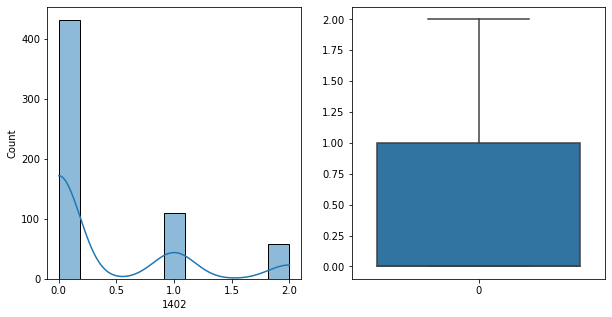

1402   Unique :  [2 0 1]
--------------------------------------------------------------------
1402   N unique :  3
--------------------------------------------------------------------
1402   Value Counts :  0    432
1    110
2     58
Name: 1402, dtype: int64
--------------------------------------------------------------------



[ 1403 ]
show_df_info :  1403


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


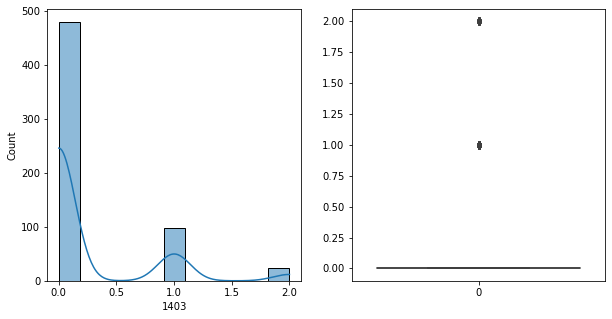

1403   Unique :  [0 1 2]
--------------------------------------------------------------------
1403   N unique :  3
--------------------------------------------------------------------
1403   Value Counts :  0    480
1     97
2     23
Name: 1403, dtype: int64
--------------------------------------------------------------------



[ 1404 ]
show_df_info :  1404


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


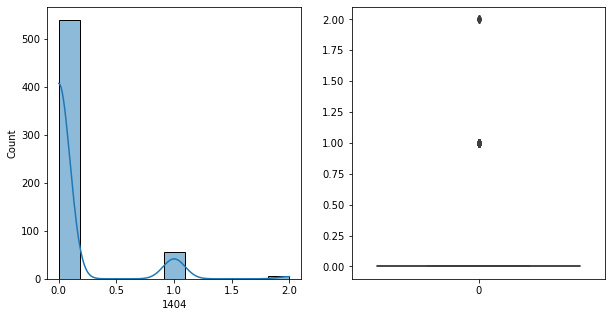

1404   Unique :  [0 1 2]
--------------------------------------------------------------------
1404   N unique :  3
--------------------------------------------------------------------
1404   Value Counts :  0    539
1     55
2      6
Name: 1404, dtype: int64
--------------------------------------------------------------------



[ 1405 ]
show_df_info :  1405


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


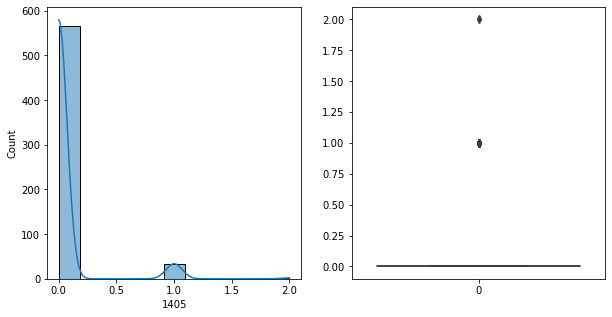

1405   Unique :  [0 1 2]
--------------------------------------------------------------------
1405   N unique :  3
--------------------------------------------------------------------
1405   Value Counts :  0    565
1     33
2      2
Name: 1405, dtype: int64
--------------------------------------------------------------------



[ 1406 ]
show_df_info :  1406


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


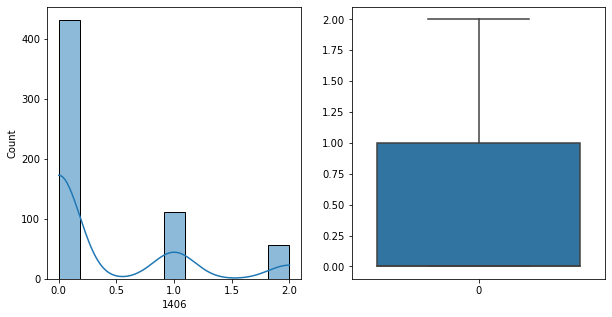

1406   Unique :  [2 0 1]
--------------------------------------------------------------------
1406   N unique :  3
--------------------------------------------------------------------
1406   Value Counts :  0    432
1    111
2     57
Name: 1406, dtype: int64
--------------------------------------------------------------------



[ 1407 ]
show_df_info :  1407


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


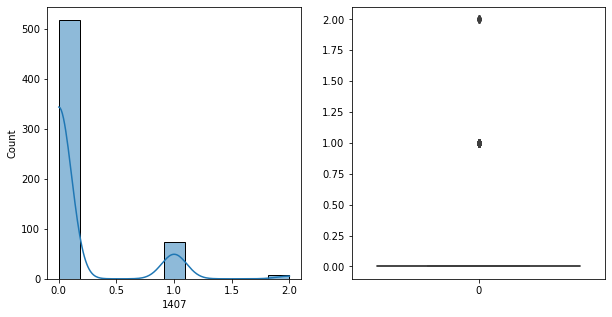

1407   Unique :  [0 1 2]
--------------------------------------------------------------------
1407   N unique :  3
--------------------------------------------------------------------
1407   Value Counts :  0    518
1     74
2      8
Name: 1407, dtype: int64
--------------------------------------------------------------------



[ 1408 ]
show_df_info :  1408


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


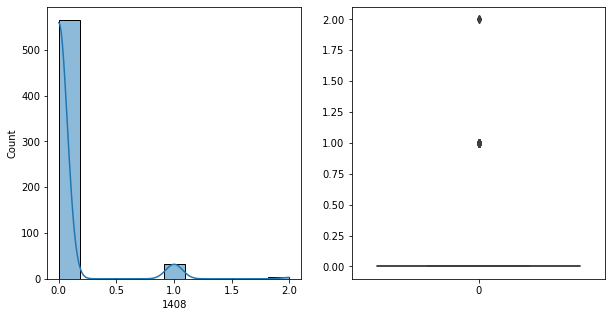

1408   Unique :  [0 2 1]
--------------------------------------------------------------------
1408   N unique :  3
--------------------------------------------------------------------
1408   Value Counts :  0    565
1     32
2      3
Name: 1408, dtype: int64
--------------------------------------------------------------------



[ 1409 ]
show_df_info :  1409


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


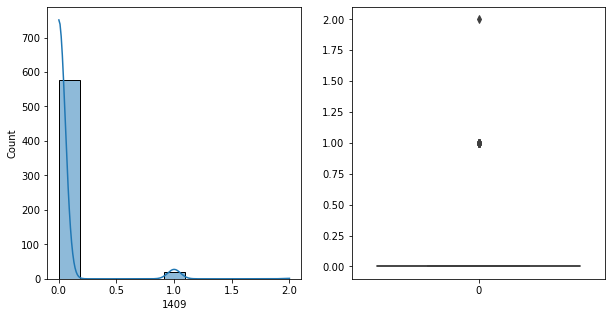

1409   Unique :  [0 1 2]
--------------------------------------------------------------------
1409   N unique :  3
--------------------------------------------------------------------
1409   Value Counts :  0    578
1     21
2      1
Name: 1409, dtype: int64
--------------------------------------------------------------------



[ 1410 ]
show_df_info :  1410


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


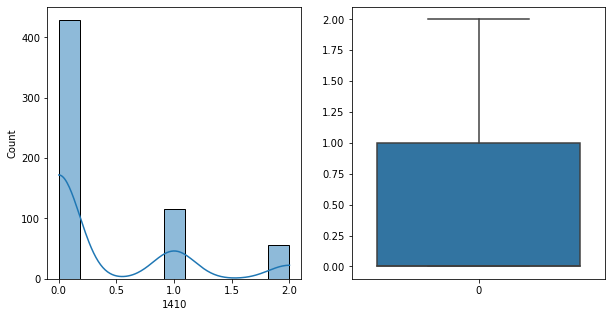

1410   Unique :  [2 0 1]
--------------------------------------------------------------------
1410   N unique :  3
--------------------------------------------------------------------
1410   Value Counts :  0    429
1    115
2     56
Name: 1410, dtype: int64
--------------------------------------------------------------------



[ 1411 ]
show_df_info :  1411


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


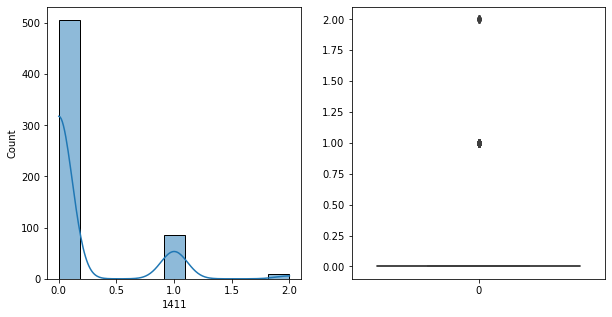

1411   Unique :  [0 1 2]
--------------------------------------------------------------------
1411   N unique :  3
--------------------------------------------------------------------
1411   Value Counts :  0    506
1     85
2      9
Name: 1411, dtype: int64
--------------------------------------------------------------------



[ 1412 ]
show_df_info :  1412


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


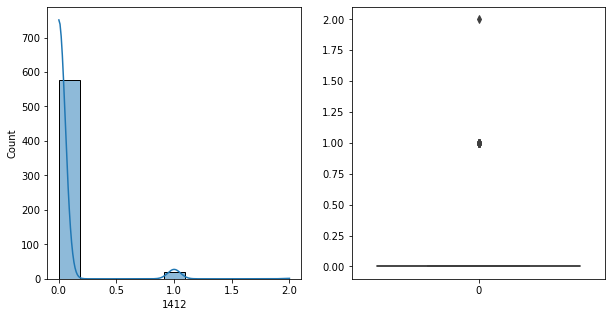

1412   Unique :  [0 1 2]
--------------------------------------------------------------------
1412   N unique :  3
--------------------------------------------------------------------
1412   Value Counts :  0    578
1     21
2      1
Name: 1412, dtype: int64
--------------------------------------------------------------------



[ 1413 ]
show_df_info :  1413


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


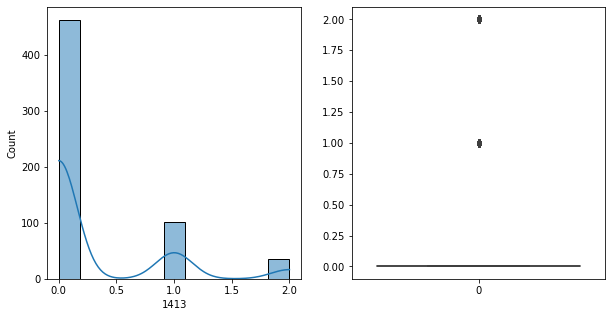

1413   Unique :  [2 0 1]
--------------------------------------------------------------------
1413   N unique :  3
--------------------------------------------------------------------
1413   Value Counts :  0    462
1    102
2     36
Name: 1413, dtype: int64
--------------------------------------------------------------------



[ 1414 ]
show_df_info :  1414


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


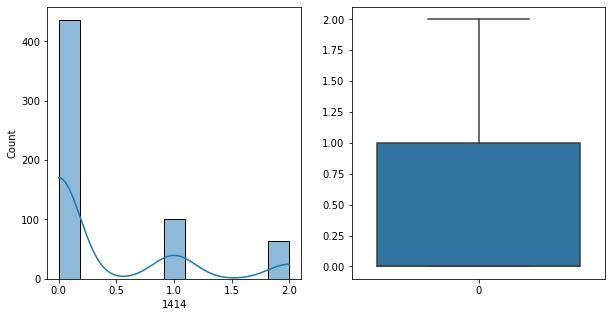

1414   Unique :  [2 0 1]
--------------------------------------------------------------------
1414   N unique :  3
--------------------------------------------------------------------
1414   Value Counts :  0    436
1    101
2     63
Name: 1414, dtype: int64
--------------------------------------------------------------------



[ 1415 ]
show_df_info :  1415


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


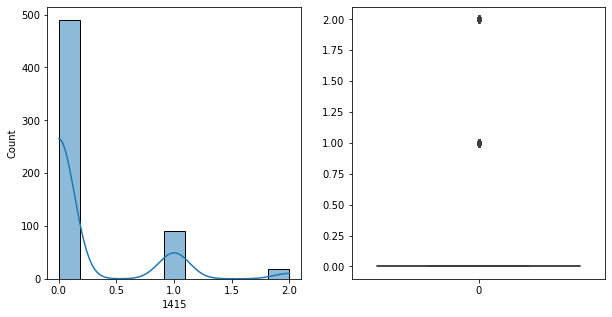

1415   Unique :  [0 2 1]
--------------------------------------------------------------------
1415   N unique :  3
--------------------------------------------------------------------
1415   Value Counts :  0    490
1     91
2     19
Name: 1415, dtype: int64
--------------------------------------------------------------------



[ 1416 ]
show_df_info :  1416


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


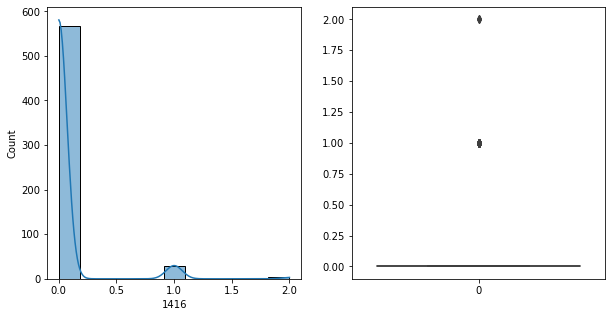

1416   Unique :  [0 2 1]
--------------------------------------------------------------------
1416   N unique :  3
--------------------------------------------------------------------
1416   Value Counts :  0    568
1     29
2      3
Name: 1416, dtype: int64
--------------------------------------------------------------------



[ 1417 ]
show_df_info :  1417


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


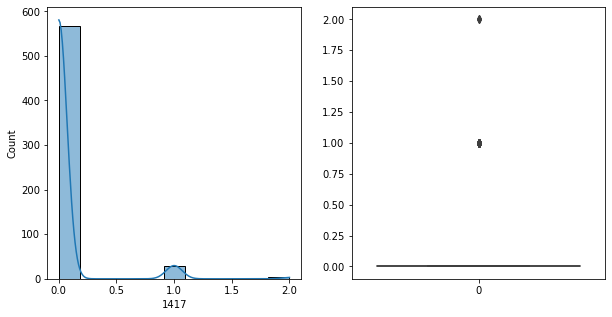

1417   Unique :  [0 2 1]
--------------------------------------------------------------------
1417   N unique :  3
--------------------------------------------------------------------
1417   Value Counts :  0    568
1     29
2      3
Name: 1417, dtype: int64
--------------------------------------------------------------------



[ 1418 ]
show_df_info :  1418


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


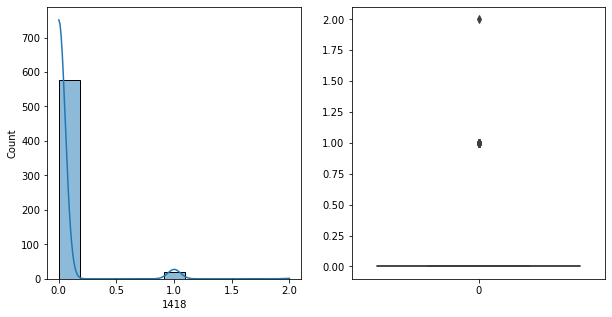

1418   Unique :  [0 1 2]
--------------------------------------------------------------------
1418   N unique :  3
--------------------------------------------------------------------
1418   Value Counts :  0    578
1     21
2      1
Name: 1418, dtype: int64
--------------------------------------------------------------------



[ 1419 ]
show_df_info :  1419


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


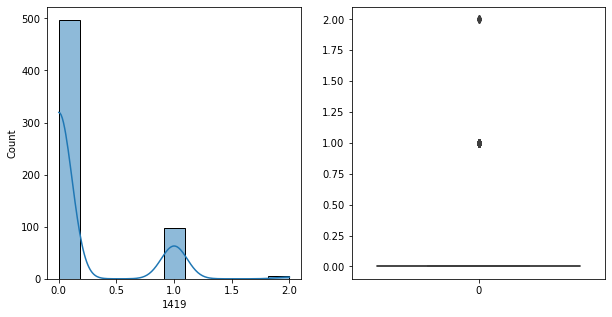

1419   Unique :  [1 0 2]
--------------------------------------------------------------------
1419   N unique :  3
--------------------------------------------------------------------
1419   Value Counts :  0    497
1     98
2      5
Name: 1419, dtype: int64
--------------------------------------------------------------------



[ 1420 ]
show_df_info :  1420


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


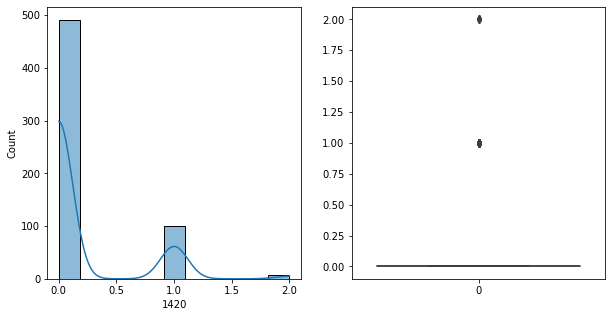

1420   Unique :  [1 0 2]
--------------------------------------------------------------------
1420   N unique :  3
--------------------------------------------------------------------
1420   Value Counts :  0    491
1    101
2      8
Name: 1420, dtype: int64
--------------------------------------------------------------------



[ 1421 ]
show_df_info :  1421


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


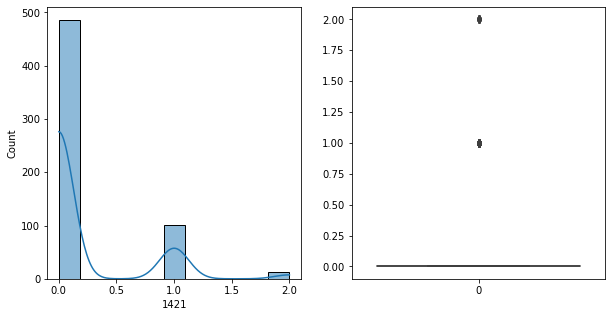

1421   Unique :  [0 2 1]
--------------------------------------------------------------------
1421   N unique :  3
--------------------------------------------------------------------
1421   Value Counts :  0    486
1    101
2     13
Name: 1421, dtype: int64
--------------------------------------------------------------------



[ 1422 ]
show_df_info :  1422


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


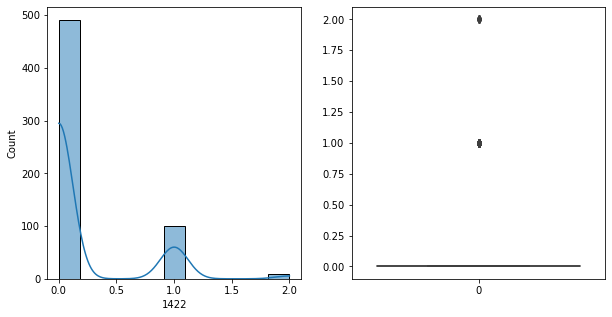

1422   Unique :  [0 2 1]
--------------------------------------------------------------------
1422   N unique :  3
--------------------------------------------------------------------
1422   Value Counts :  0    491
1    100
2      9
Name: 1422, dtype: int64
--------------------------------------------------------------------



[ 1423 ]
show_df_info :  1423


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


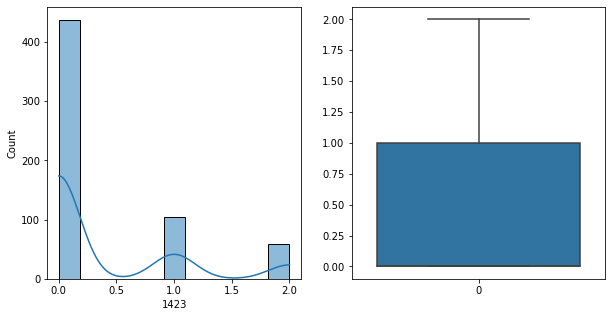

1423   Unique :  [1 0 2]
--------------------------------------------------------------------
1423   N unique :  3
--------------------------------------------------------------------
1423   Value Counts :  0    437
1    104
2     59
Name: 1423, dtype: int64
--------------------------------------------------------------------



[ 1424 ]
show_df_info :  1424


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


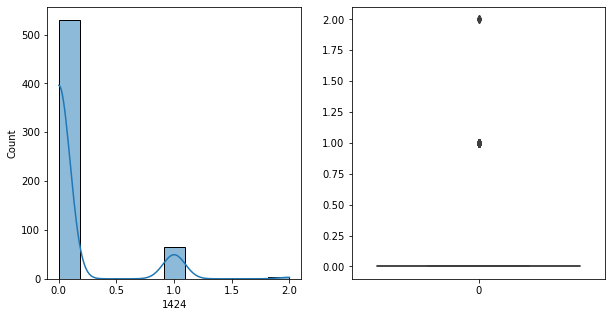

1424   Unique :  [1 0 2]
--------------------------------------------------------------------
1424   N unique :  3
--------------------------------------------------------------------
1424   Value Counts :  0    530
1     66
2      4
Name: 1424, dtype: int64
--------------------------------------------------------------------



[ 1425 ]
show_df_info :  1425


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


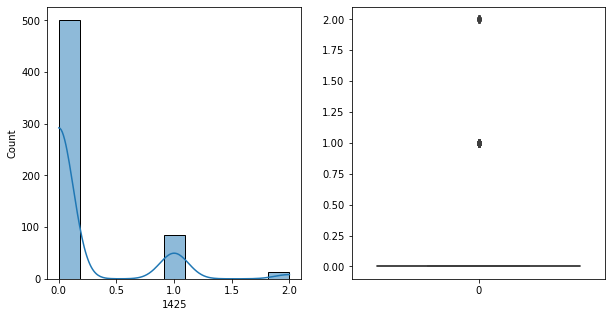

1425   Unique :  [1 0 2]
--------------------------------------------------------------------
1425   N unique :  3
--------------------------------------------------------------------
1425   Value Counts :  0    501
1     85
2     14
Name: 1425, dtype: int64
--------------------------------------------------------------------



[ 1426 ]
show_df_info :  1426


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


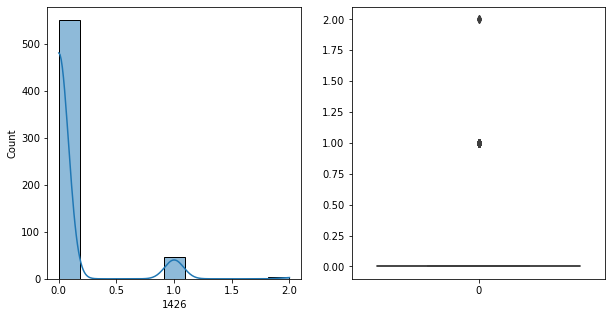

1426   Unique :  [1 0 2]
--------------------------------------------------------------------
1426   N unique :  3
--------------------------------------------------------------------
1426   Value Counts :  0    551
1     46
2      3
Name: 1426, dtype: int64
--------------------------------------------------------------------



[ 1427 ]
show_df_info :  1427


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


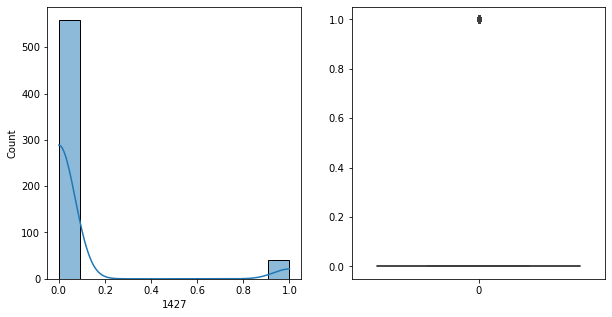

1427   Unique :  [0 1]
--------------------------------------------------------------------
1427   N unique :  2
--------------------------------------------------------------------
1427   Value Counts :  0    559
1     41
Name: 1427, dtype: int64
--------------------------------------------------------------------



[ 1428 ]
show_df_info :  1428


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


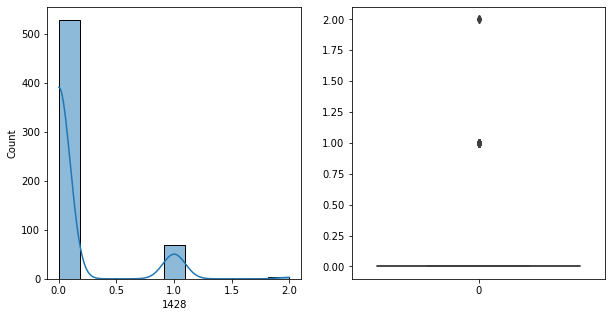

1428   Unique :  [1 0 2]
--------------------------------------------------------------------
1428   N unique :  3
--------------------------------------------------------------------
1428   Value Counts :  0    528
1     68
2      4
Name: 1428, dtype: int64
--------------------------------------------------------------------



[ 1429 ]
show_df_info :  1429


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


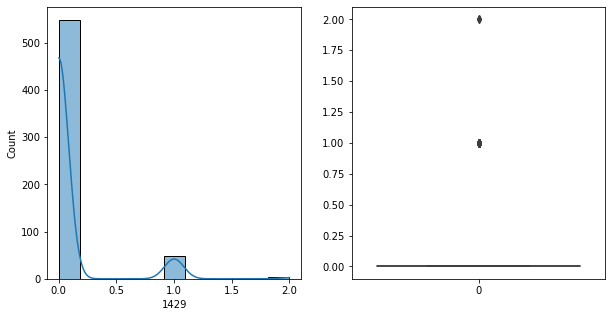

1429   Unique :  [0 2 1]
--------------------------------------------------------------------
1429   N unique :  3
--------------------------------------------------------------------
1429   Value Counts :  0    548
1     49
2      3
Name: 1429, dtype: int64
--------------------------------------------------------------------



[ 1430 ]
show_df_info :  1430


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


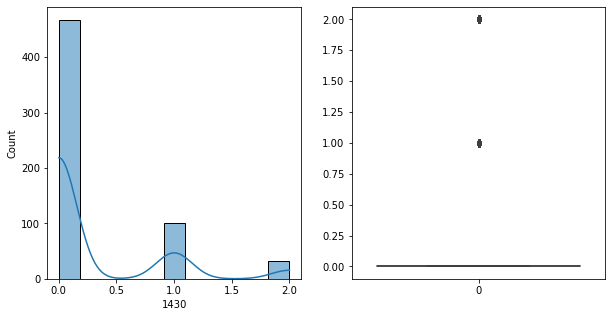

1430   Unique :  [0 1 2]
--------------------------------------------------------------------
1430   N unique :  3
--------------------------------------------------------------------
1430   Value Counts :  0    467
1    100
2     33
Name: 1430, dtype: int64
--------------------------------------------------------------------



[ 1431 ]
show_df_info :  1431


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


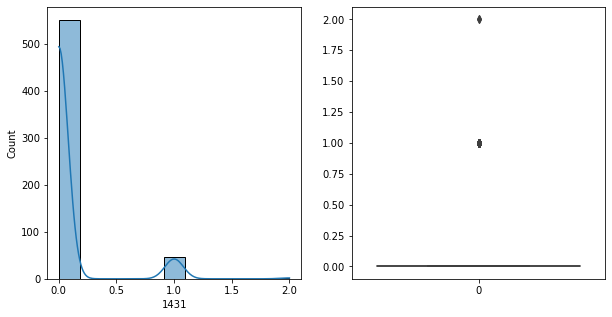

1431   Unique :  [1 0 2]
--------------------------------------------------------------------
1431   N unique :  3
--------------------------------------------------------------------
1431   Value Counts :  0    551
1     47
2      2
Name: 1431, dtype: int64
--------------------------------------------------------------------



[ 1432 ]
show_df_info :  1432


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


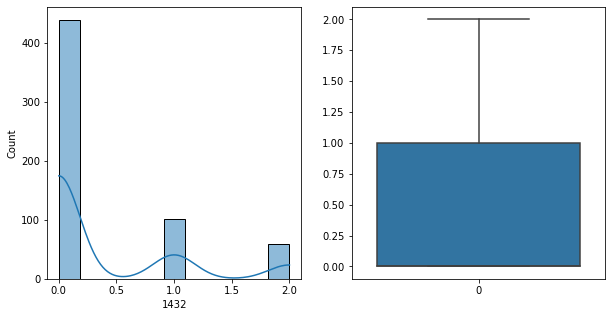

1432   Unique :  [0 2 1]
--------------------------------------------------------------------
1432   N unique :  3
--------------------------------------------------------------------
1432   Value Counts :  0    439
1    102
2     59
Name: 1432, dtype: int64
--------------------------------------------------------------------



[ 1433 ]
show_df_info :  1433


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


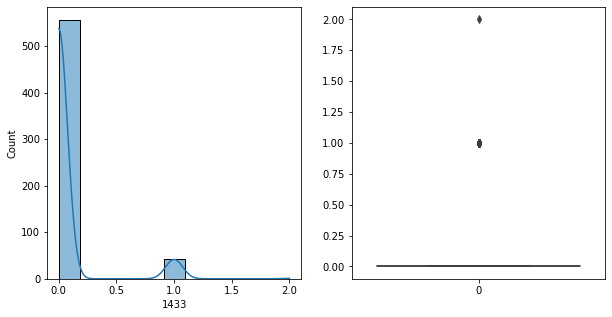

1433   Unique :  [0 1 2]
--------------------------------------------------------------------
1433   N unique :  3
--------------------------------------------------------------------
1433   Value Counts :  0    556
1     43
2      1
Name: 1433, dtype: int64
--------------------------------------------------------------------



[ 1434 ]
show_df_info :  1434


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


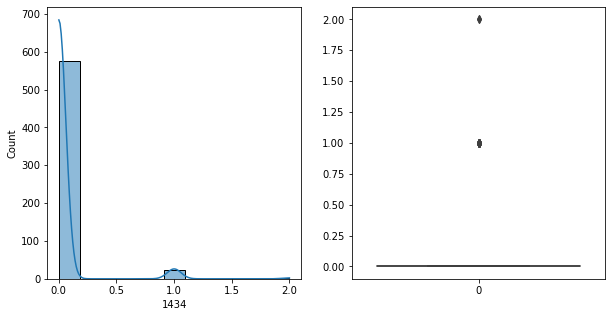

1434   Unique :  [0 1 2]
--------------------------------------------------------------------
1434   N unique :  3
--------------------------------------------------------------------
1434   Value Counts :  0    576
1     22
2      2
Name: 1434, dtype: int64
--------------------------------------------------------------------



[ 1435 ]
show_df_info :  1435


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


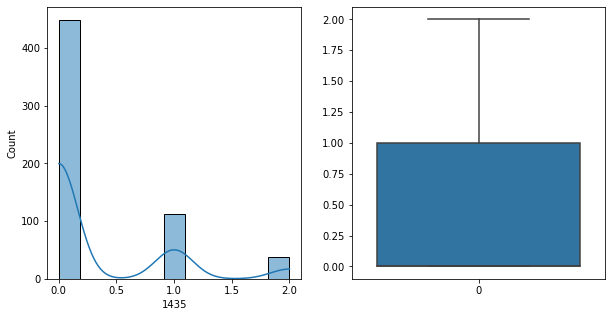

1435   Unique :  [0 1 2]
--------------------------------------------------------------------
1435   N unique :  3
--------------------------------------------------------------------
1435   Value Counts :  0    449
1    113
2     38
Name: 1435, dtype: int64
--------------------------------------------------------------------



[ 1436 ]
show_df_info :  1436


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


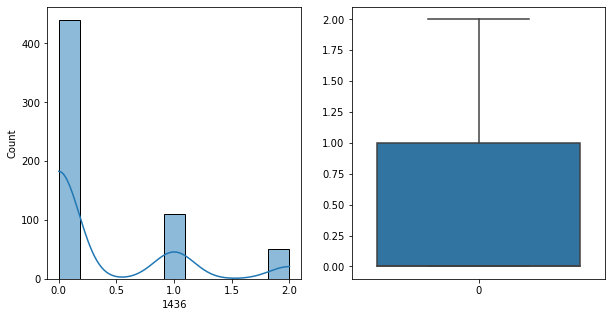

1436   Unique :  [1 0 2]
--------------------------------------------------------------------
1436   N unique :  3
--------------------------------------------------------------------
1436   Value Counts :  0    440
1    110
2     50
Name: 1436, dtype: int64
--------------------------------------------------------------------



[ 1437 ]
show_df_info :  1437


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


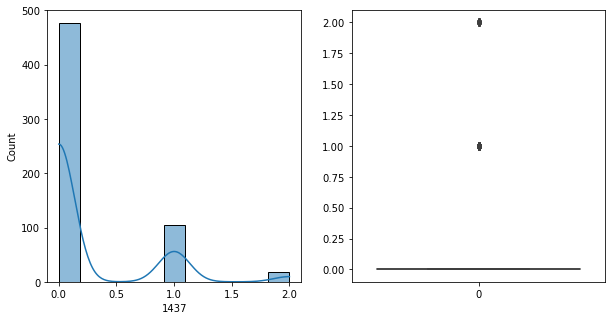

1437   Unique :  [0 1 2]
--------------------------------------------------------------------
1437   N unique :  3
--------------------------------------------------------------------
1437   Value Counts :  0    477
1    105
2     18
Name: 1437, dtype: int64
--------------------------------------------------------------------



[ 1438 ]
show_df_info :  1438


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


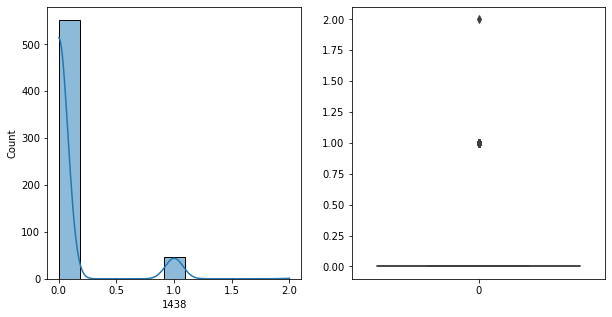

1438   Unique :  [1 0 2]
--------------------------------------------------------------------
1438   N unique :  3
--------------------------------------------------------------------
1438   Value Counts :  0    552
1     47
2      1
Name: 1438, dtype: int64
--------------------------------------------------------------------



[ 1439 ]
show_df_info :  1439


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


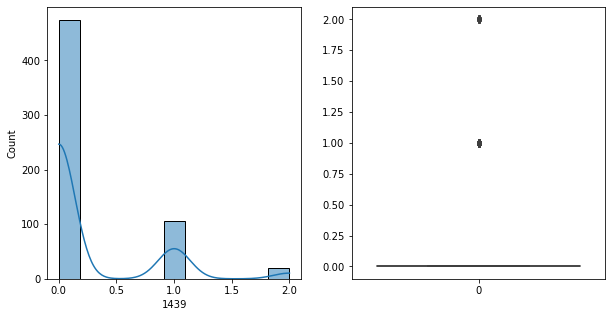

1439   Unique :  [0 1 2]
--------------------------------------------------------------------
1439   N unique :  3
--------------------------------------------------------------------
1439   Value Counts :  0    474
1    106
2     20
Name: 1439, dtype: int64
--------------------------------------------------------------------



[ 1440 ]
show_df_info :  1440


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


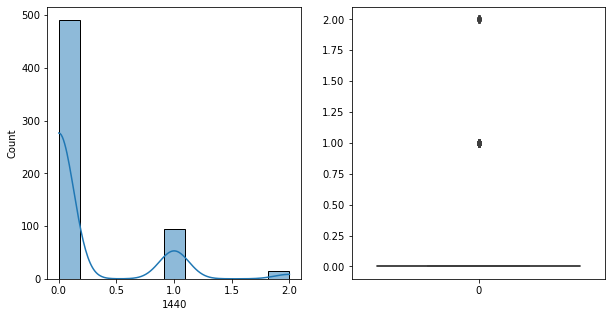

1440   Unique :  [2 0 1]
--------------------------------------------------------------------
1440   N unique :  3
--------------------------------------------------------------------
1440   Value Counts :  0    491
1     94
2     15
Name: 1440, dtype: int64
--------------------------------------------------------------------



[ 1441 ]
show_df_info :  1441


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


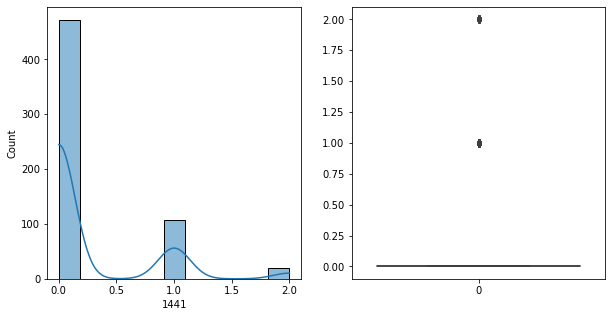

1441   Unique :  [0 1 2]
--------------------------------------------------------------------
1441   N unique :  3
--------------------------------------------------------------------
1441   Value Counts :  0    472
1    108
2     20
Name: 1441, dtype: int64
--------------------------------------------------------------------



[ 1442 ]
show_df_info :  1442


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


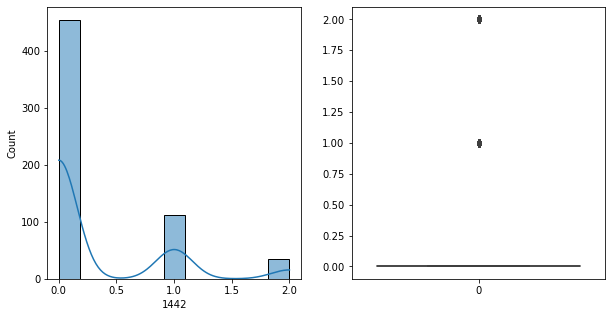

1442   Unique :  [0 1 2]
--------------------------------------------------------------------
1442   N unique :  3
--------------------------------------------------------------------
1442   Value Counts :  0    454
1    112
2     34
Name: 1442, dtype: int64
--------------------------------------------------------------------



[ 1443 ]
show_df_info :  1443


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


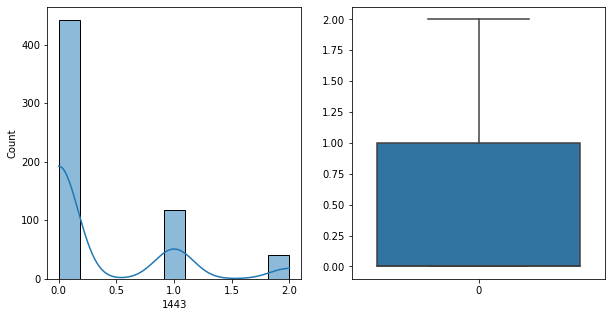

1443   Unique :  [0 1 2]
--------------------------------------------------------------------
1443   N unique :  3
--------------------------------------------------------------------
1443   Value Counts :  0    442
1    117
2     41
Name: 1443, dtype: int64
--------------------------------------------------------------------



[ 1444 ]
show_df_info :  1444


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


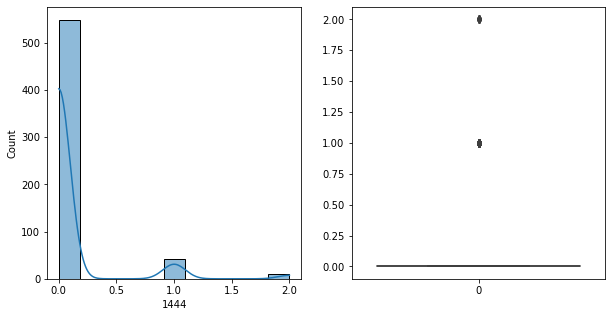

1444   Unique :  [0 1 2]
--------------------------------------------------------------------
1444   N unique :  3
--------------------------------------------------------------------
1444   Value Counts :  0    548
1     42
2     10
Name: 1444, dtype: int64
--------------------------------------------------------------------



[ 1445 ]
show_df_info :  1445


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


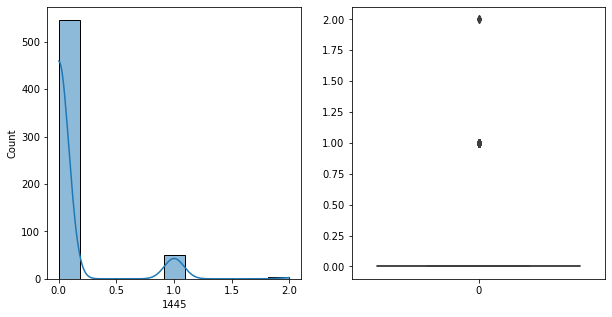

1445   Unique :  [0 1 2]
--------------------------------------------------------------------
1445   N unique :  3
--------------------------------------------------------------------
1445   Value Counts :  0    546
1     51
2      3
Name: 1445, dtype: int64
--------------------------------------------------------------------



[ 1446 ]
show_df_info :  1446


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


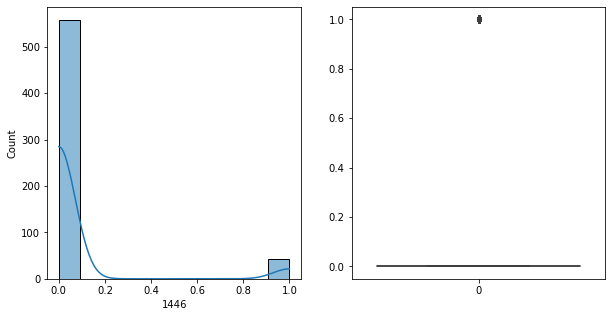

1446   Unique :  [0 1]
--------------------------------------------------------------------
1446   N unique :  2
--------------------------------------------------------------------
1446   Value Counts :  0    558
1     42
Name: 1446, dtype: int64
--------------------------------------------------------------------



[ 1447 ]
show_df_info :  1447


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


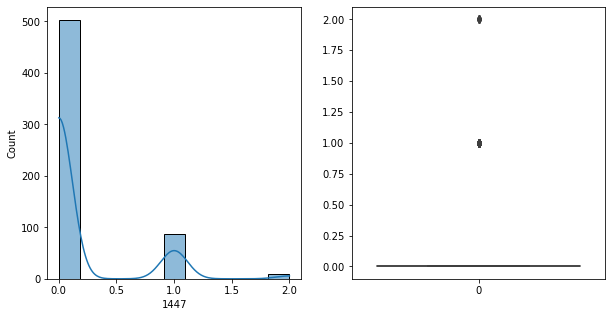

1447   Unique :  [0 1 2]
--------------------------------------------------------------------
1447   N unique :  3
--------------------------------------------------------------------
1447   Value Counts :  0    503
1     88
2      9
Name: 1447, dtype: int64
--------------------------------------------------------------------



[ 1448 ]
show_df_info :  1448


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


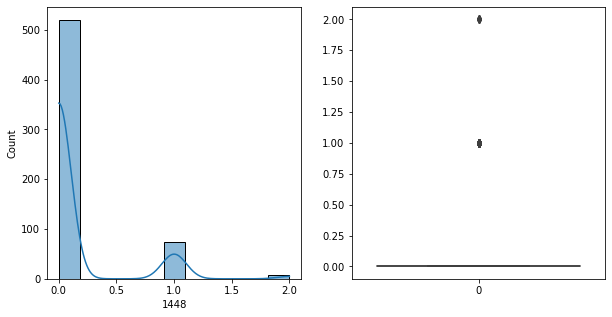

1448   Unique :  [0 1 2]
--------------------------------------------------------------------
1448   N unique :  3
--------------------------------------------------------------------
1448   Value Counts :  0    520
1     73
2      7
Name: 1448, dtype: int64
--------------------------------------------------------------------



[ 1449 ]
show_df_info :  1449


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


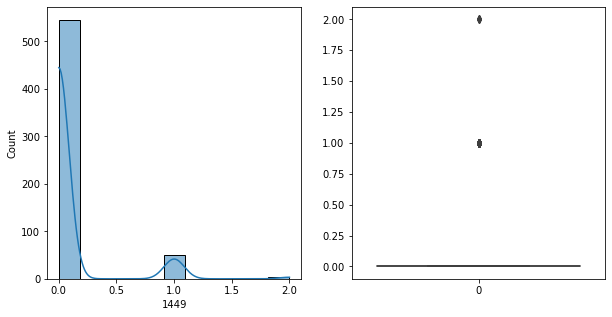

1449   Unique :  [0 1 2]
--------------------------------------------------------------------
1449   N unique :  3
--------------------------------------------------------------------
1449   Value Counts :  0    545
1     51
2      4
Name: 1449, dtype: int64
--------------------------------------------------------------------



[ 1450 ]
show_df_info :  1450


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


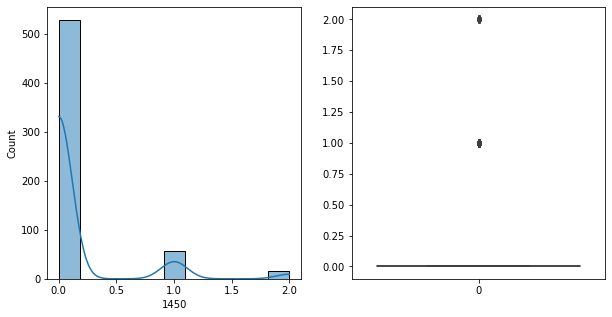

1450   Unique :  [0 1 2]
--------------------------------------------------------------------
1450   N unique :  3
--------------------------------------------------------------------
1450   Value Counts :  0    529
1     56
2     15
Name: 1450, dtype: int64
--------------------------------------------------------------------



[ 1451 ]
show_df_info :  1451


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


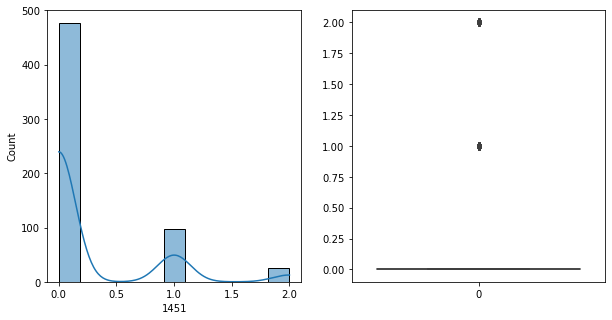

1451   Unique :  [0 2 1]
--------------------------------------------------------------------
1451   N unique :  3
--------------------------------------------------------------------
1451   Value Counts :  0    477
1     98
2     25
Name: 1451, dtype: int64
--------------------------------------------------------------------



[ 1452 ]
show_df_info :  1452


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


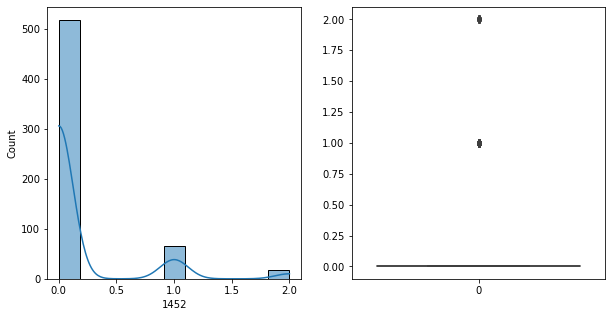

1452   Unique :  [0 2 1]
--------------------------------------------------------------------
1452   N unique :  3
--------------------------------------------------------------------
1452   Value Counts :  0    518
1     65
2     17
Name: 1452, dtype: int64
--------------------------------------------------------------------



[ 1453 ]
show_df_info :  1453


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


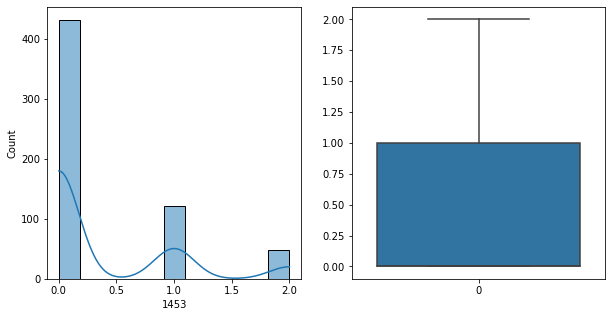

1453   Unique :  [0 2 1]
--------------------------------------------------------------------
1453   N unique :  3
--------------------------------------------------------------------
1453   Value Counts :  0    431
1    121
2     48
Name: 1453, dtype: int64
--------------------------------------------------------------------



[ 1454 ]
show_df_info :  1454


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


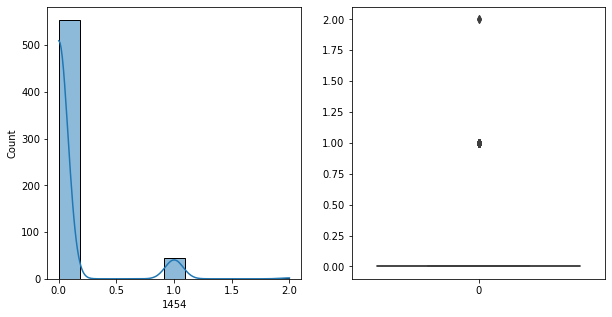

1454   Unique :  [0 1 2]
--------------------------------------------------------------------
1454   N unique :  3
--------------------------------------------------------------------
1454   Value Counts :  0    554
1     44
2      2
Name: 1454, dtype: int64
--------------------------------------------------------------------



[ 1455 ]
show_df_info :  1455


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


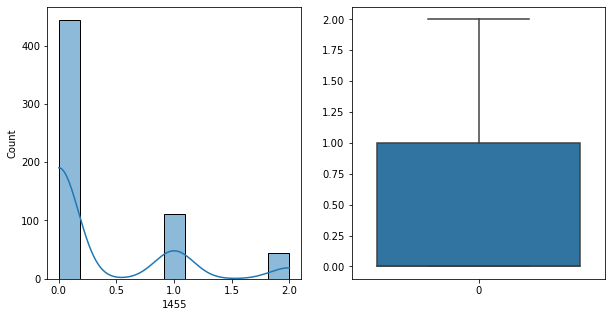

1455   Unique :  [1 0 2]
--------------------------------------------------------------------
1455   N unique :  3
--------------------------------------------------------------------
1455   Value Counts :  0    444
1    112
2     44
Name: 1455, dtype: int64
--------------------------------------------------------------------



[ 1456 ]
show_df_info :  1456


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


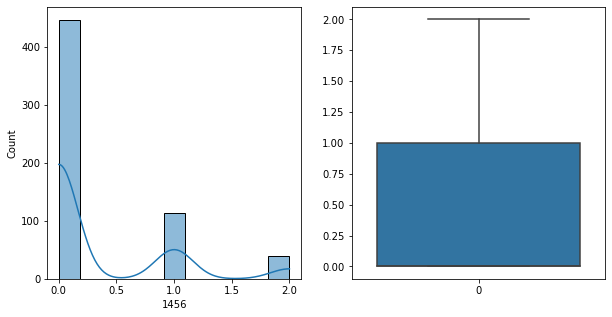

1456   Unique :  [1 0 2]
--------------------------------------------------------------------
1456   N unique :  3
--------------------------------------------------------------------
1456   Value Counts :  0    447
1    114
2     39
Name: 1456, dtype: int64
--------------------------------------------------------------------



[ 1457 ]
show_df_info :  1457


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


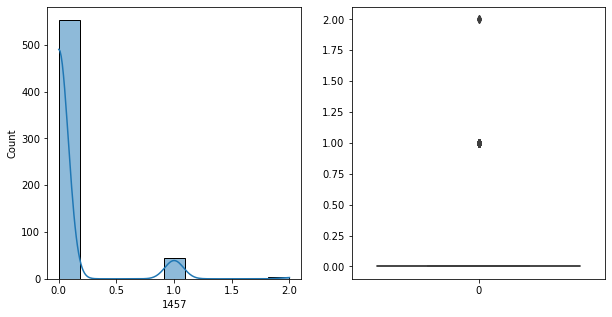

1457   Unique :  [0 1 2]
--------------------------------------------------------------------
1457   N unique :  3
--------------------------------------------------------------------
1457   Value Counts :  0    553
1     44
2      3
Name: 1457, dtype: int64
--------------------------------------------------------------------



[ 1458 ]
show_df_info :  1458


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


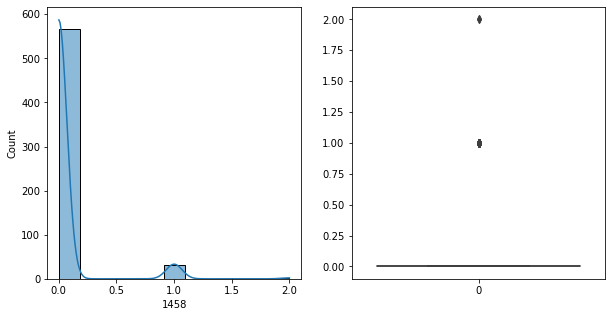

1458   Unique :  [1 0 2]
--------------------------------------------------------------------
1458   N unique :  3
--------------------------------------------------------------------
1458   Value Counts :  0    566
1     32
2      2
Name: 1458, dtype: int64
--------------------------------------------------------------------



[ 1459 ]
show_df_info :  1459


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


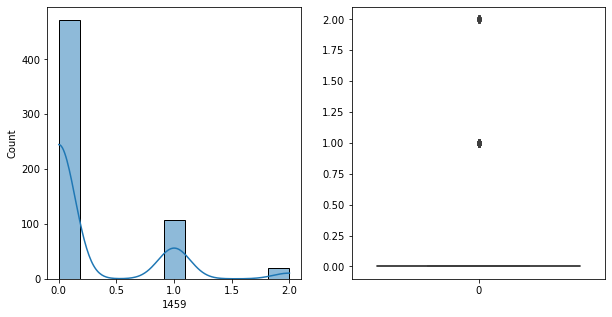

1459   Unique :  [1 0 2]
--------------------------------------------------------------------
1459   N unique :  3
--------------------------------------------------------------------
1459   Value Counts :  0    472
1    108
2     20
Name: 1459, dtype: int64
--------------------------------------------------------------------



[ 1460 ]
show_df_info :  1460


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


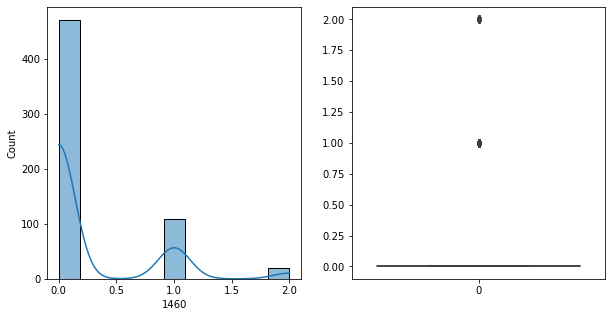

1460   Unique :  [1 0 2]
--------------------------------------------------------------------
1460   N unique :  3
--------------------------------------------------------------------
1460   Value Counts :  0    471
1    109
2     20
Name: 1460, dtype: int64
--------------------------------------------------------------------



[ 1461 ]
show_df_info :  1461


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


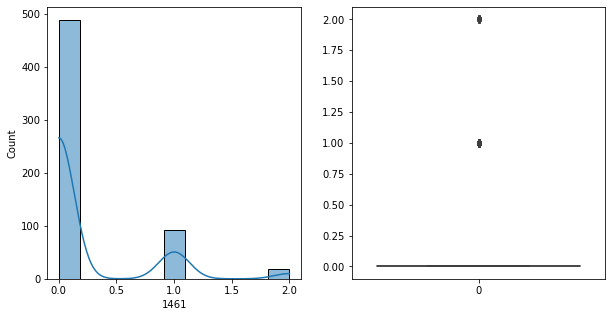

1461   Unique :  [1 0 2]
--------------------------------------------------------------------
1461   N unique :  3
--------------------------------------------------------------------
1461   Value Counts :  0    489
1     93
2     18
Name: 1461, dtype: int64
--------------------------------------------------------------------



[ 1462 ]
show_df_info :  1462


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


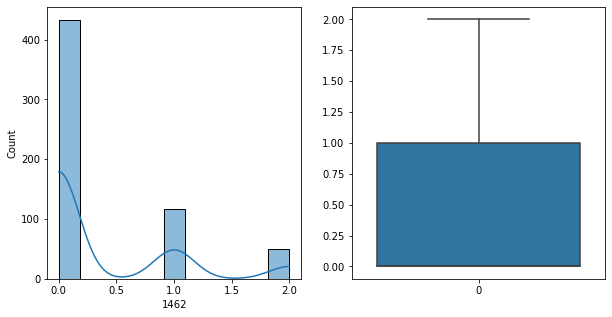

1462   Unique :  [0 1 2]
--------------------------------------------------------------------
1462   N unique :  3
--------------------------------------------------------------------
1462   Value Counts :  0    433
1    117
2     50
Name: 1462, dtype: int64
--------------------------------------------------------------------



[ 1463 ]
show_df_info :  1463


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


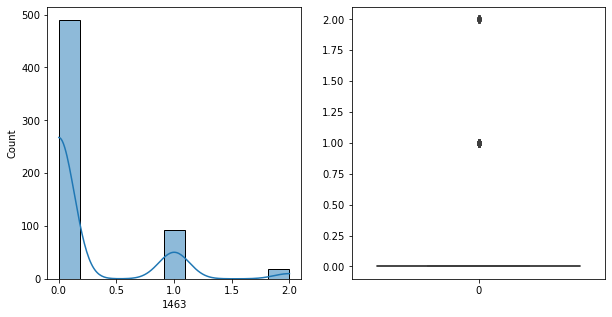

1463   Unique :  [1 0 2]
--------------------------------------------------------------------
1463   N unique :  3
--------------------------------------------------------------------
1463   Value Counts :  0    490
1     92
2     18
Name: 1463, dtype: int64
--------------------------------------------------------------------



[ 1464 ]
show_df_info :  1464


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


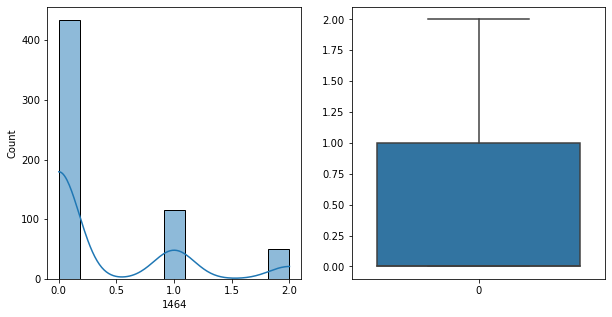

1464   Unique :  [0 1 2]
--------------------------------------------------------------------
1464   N unique :  3
--------------------------------------------------------------------
1464   Value Counts :  0    434
1    116
2     50
Name: 1464, dtype: int64
--------------------------------------------------------------------



[ 1465 ]
show_df_info :  1465


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


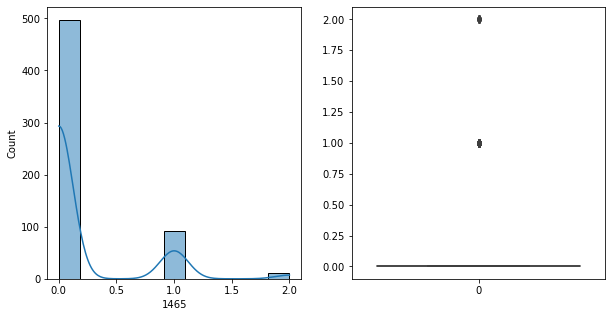

1465   Unique :  [1 0 2]
--------------------------------------------------------------------
1465   N unique :  3
--------------------------------------------------------------------
1465   Value Counts :  0    497
1     91
2     12
Name: 1465, dtype: int64
--------------------------------------------------------------------



[ 1466 ]
show_df_info :  1466


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


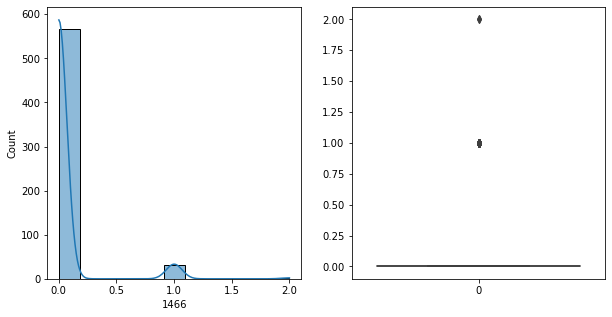

1466   Unique :  [0 1 2]
--------------------------------------------------------------------
1466   N unique :  3
--------------------------------------------------------------------
1466   Value Counts :  0    566
1     32
2      2
Name: 1466, dtype: int64
--------------------------------------------------------------------



[ 1467 ]
show_df_info :  1467


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


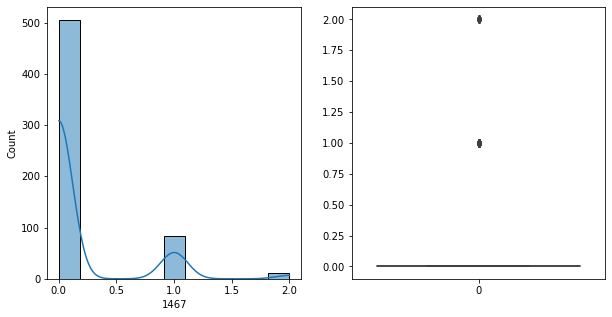

1467   Unique :  [1 0 2]
--------------------------------------------------------------------
1467   N unique :  3
--------------------------------------------------------------------
1467   Value Counts :  0    505
1     84
2     11
Name: 1467, dtype: int64
--------------------------------------------------------------------



[ 1468 ]
show_df_info :  1468


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


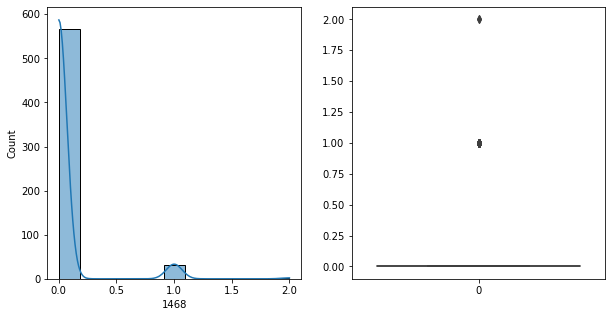

1468   Unique :  [0 1 2]
--------------------------------------------------------------------
1468   N unique :  3
--------------------------------------------------------------------
1468   Value Counts :  0    566
1     32
2      2
Name: 1468, dtype: int64
--------------------------------------------------------------------



[ 1469 ]
show_df_info :  1469


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


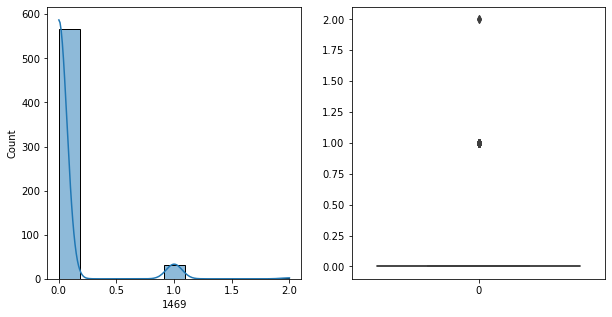

1469   Unique :  [0 1 2]
--------------------------------------------------------------------
1469   N unique :  3
--------------------------------------------------------------------
1469   Value Counts :  0    566
1     32
2      2
Name: 1469, dtype: int64
--------------------------------------------------------------------



[ 1470 ]
show_df_info :  1470


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


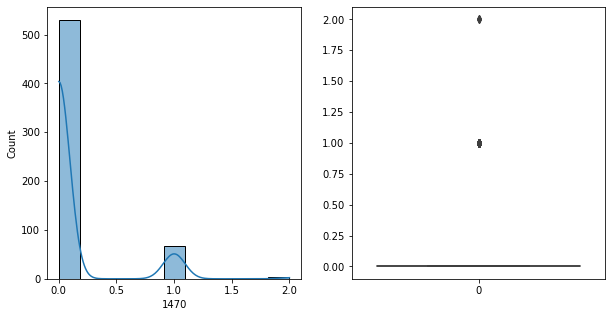

1470   Unique :  [1 0 2]
--------------------------------------------------------------------
1470   N unique :  3
--------------------------------------------------------------------
1470   Value Counts :  0    530
1     67
2      3
Name: 1470, dtype: int64
--------------------------------------------------------------------



[ 1471 ]
show_df_info :  1471


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


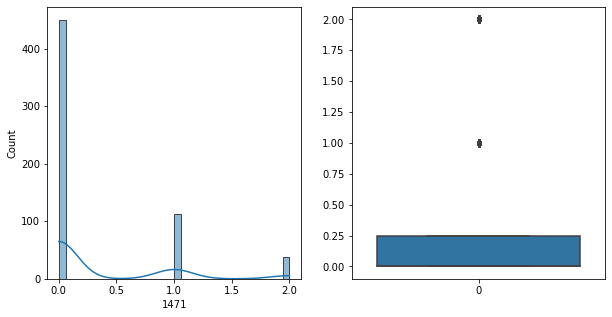

1471   Unique :  [0 1 2]
--------------------------------------------------------------------
1471   N unique :  3
--------------------------------------------------------------------
1471   Value Counts :  0    450
1    112
2     38
Name: 1471, dtype: int64
--------------------------------------------------------------------



[ 1472 ]
show_df_info :  1472


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


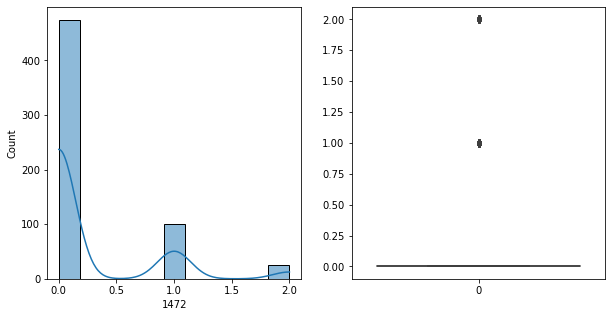

1472   Unique :  [1 0 2]
--------------------------------------------------------------------
1472   N unique :  3
--------------------------------------------------------------------
1472   Value Counts :  0    474
1    101
2     25
Name: 1472, dtype: int64
--------------------------------------------------------------------



[ 1473 ]
show_df_info :  1473


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


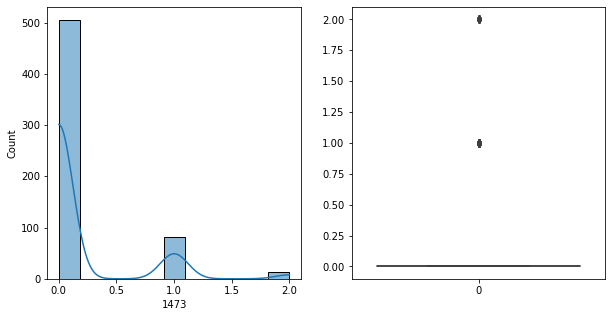

1473   Unique :  [0 1 2]
--------------------------------------------------------------------
1473   N unique :  3
--------------------------------------------------------------------
1473   Value Counts :  0    505
1     82
2     13
Name: 1473, dtype: int64
--------------------------------------------------------------------



[ 1474 ]
show_df_info :  1474


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


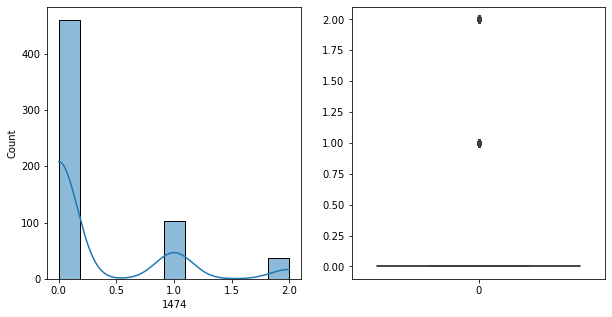

1474   Unique :  [0 1 2]
--------------------------------------------------------------------
1474   N unique :  3
--------------------------------------------------------------------
1474   Value Counts :  0    460
1    103
2     37
Name: 1474, dtype: int64
--------------------------------------------------------------------



[ 1475 ]
show_df_info :  1475


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


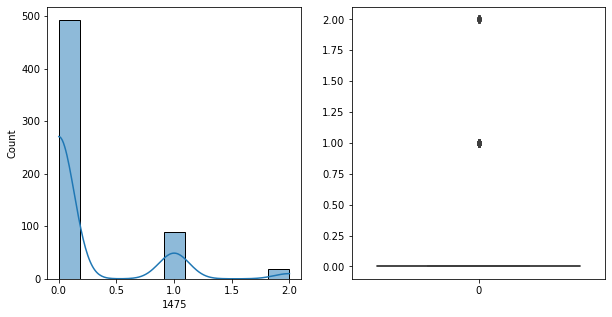

1475   Unique :  [0 1 2]
--------------------------------------------------------------------
1475   N unique :  3
--------------------------------------------------------------------
1475   Value Counts :  0    493
1     89
2     18
Name: 1475, dtype: int64
--------------------------------------------------------------------



[ 1476 ]
show_df_info :  1476


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


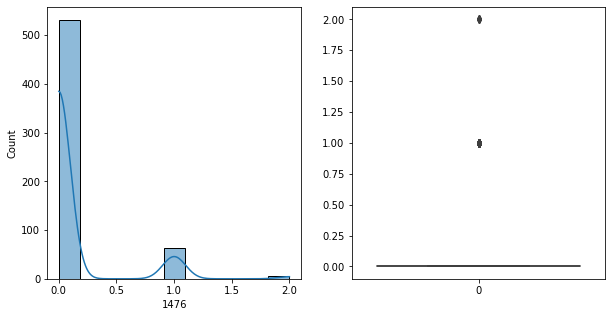

1476   Unique :  [1 0 2]
--------------------------------------------------------------------
1476   N unique :  3
--------------------------------------------------------------------
1476   Value Counts :  0    531
1     63
2      6
Name: 1476, dtype: int64
--------------------------------------------------------------------



[ 1477 ]
show_df_info :  1477


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


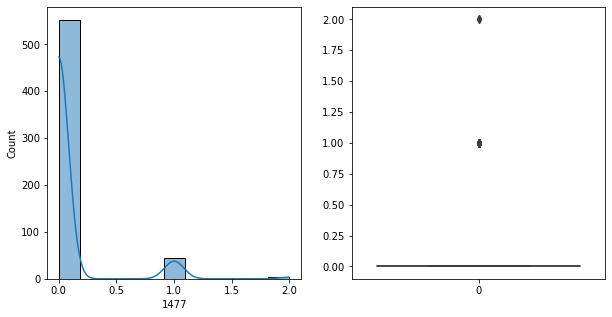

1477   Unique :  [0 1 2]
--------------------------------------------------------------------
1477   N unique :  3
--------------------------------------------------------------------
1477   Value Counts :  0    552
1     44
2      4
Name: 1477, dtype: int64
--------------------------------------------------------------------



[ 1478 ]
show_df_info :  1478


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


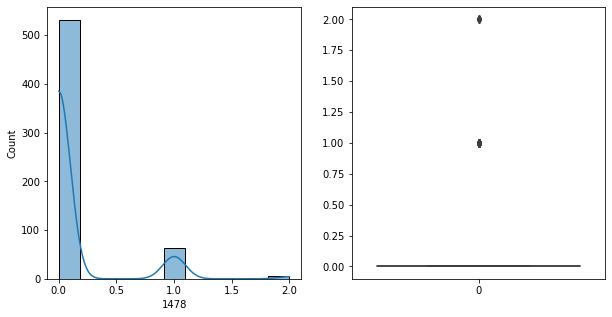

1478   Unique :  [1 0 2]
--------------------------------------------------------------------
1478   N unique :  3
--------------------------------------------------------------------
1478   Value Counts :  0    531
1     63
2      6
Name: 1478, dtype: int64
--------------------------------------------------------------------



[ 1479 ]
show_df_info :  1479


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


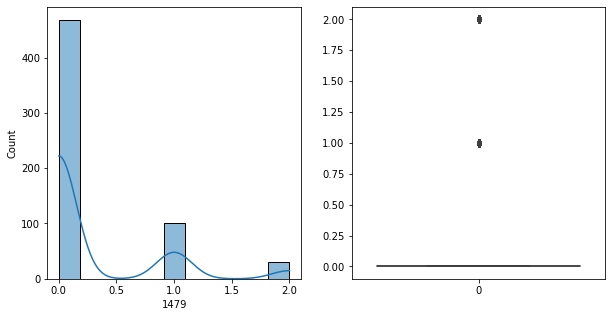

1479   Unique :  [0 1 2]
--------------------------------------------------------------------
1479   N unique :  3
--------------------------------------------------------------------
1479   Value Counts :  0    468
1    101
2     31
Name: 1479, dtype: int64
--------------------------------------------------------------------



[ 1480 ]
show_df_info :  1480


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


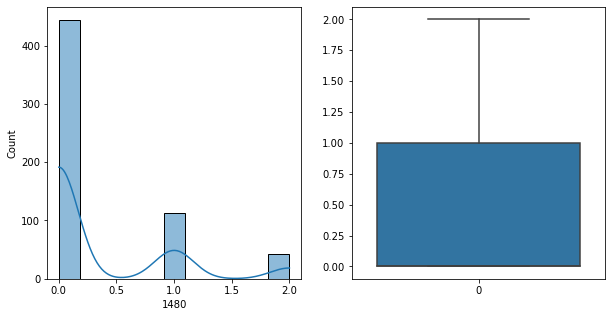

1480   Unique :  [2 0 1]
--------------------------------------------------------------------
1480   N unique :  3
--------------------------------------------------------------------
1480   Value Counts :  0    444
1    113
2     43
Name: 1480, dtype: int64
--------------------------------------------------------------------



[ 1481 ]
show_df_info :  1481


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


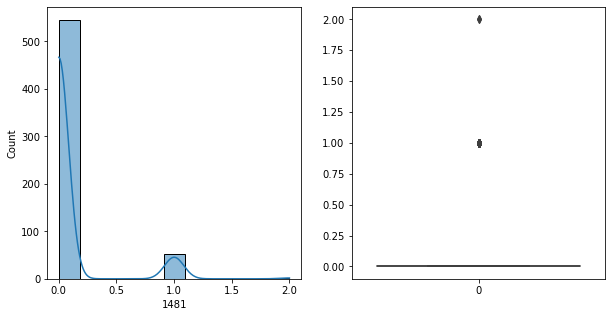

1481   Unique :  [1 0 2]
--------------------------------------------------------------------
1481   N unique :  3
--------------------------------------------------------------------
1481   Value Counts :  0    545
1     53
2      2
Name: 1481, dtype: int64
--------------------------------------------------------------------



[ 1482 ]
show_df_info :  1482


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


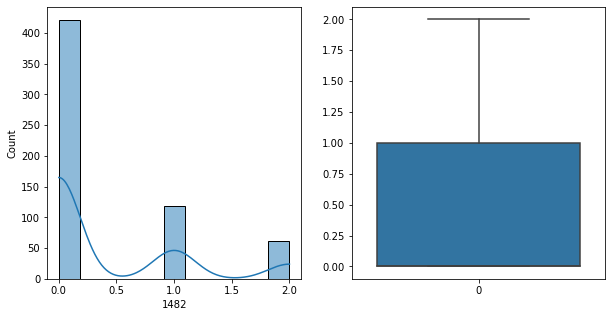

1482   Unique :  [0 1 2]
--------------------------------------------------------------------
1482   N unique :  3
--------------------------------------------------------------------
1482   Value Counts :  0    421
1    118
2     61
Name: 1482, dtype: int64
--------------------------------------------------------------------



[ 1483 ]
show_df_info :  1483


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


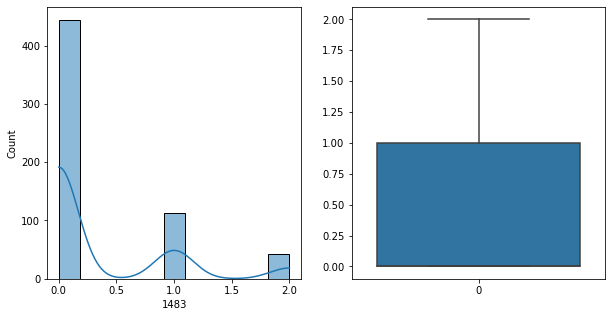

1483   Unique :  [2 0 1]
--------------------------------------------------------------------
1483   N unique :  3
--------------------------------------------------------------------
1483   Value Counts :  0    444
1    113
2     43
Name: 1483, dtype: int64
--------------------------------------------------------------------



[ 1484 ]
show_df_info :  1484


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


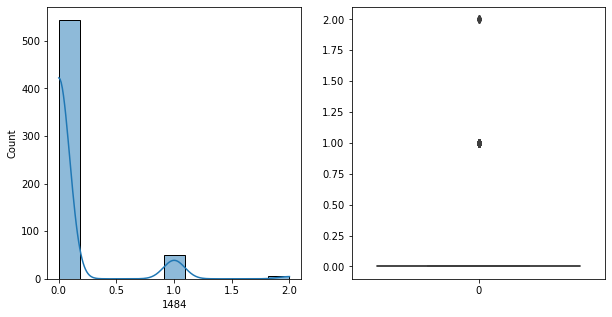

1484   Unique :  [0 1 2]
--------------------------------------------------------------------
1484   N unique :  3
--------------------------------------------------------------------
1484   Value Counts :  0    544
1     50
2      6
Name: 1484, dtype: int64
--------------------------------------------------------------------



[ 1485 ]
show_df_info :  1485


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


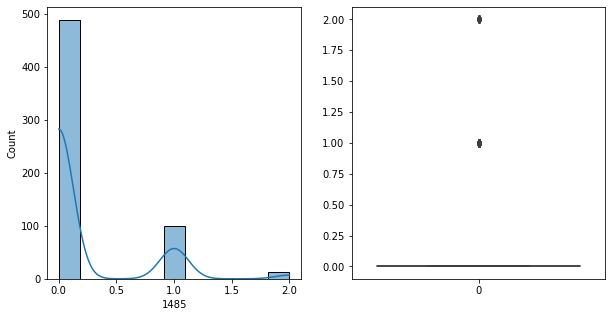

1485   Unique :  [1 0 2]
--------------------------------------------------------------------
1485   N unique :  3
--------------------------------------------------------------------
1485   Value Counts :  0    489
1     99
2     12
Name: 1485, dtype: int64
--------------------------------------------------------------------



[ 1486 ]
show_df_info :  1486


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


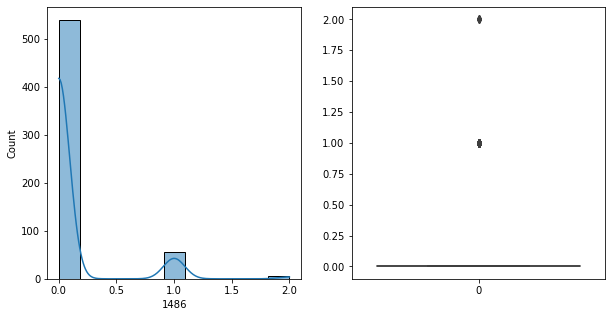

1486   Unique :  [0 1 2]
--------------------------------------------------------------------
1486   N unique :  3
--------------------------------------------------------------------
1486   Value Counts :  0    540
1     55
2      5
Name: 1486, dtype: int64
--------------------------------------------------------------------



[ 1487 ]
show_df_info :  1487


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


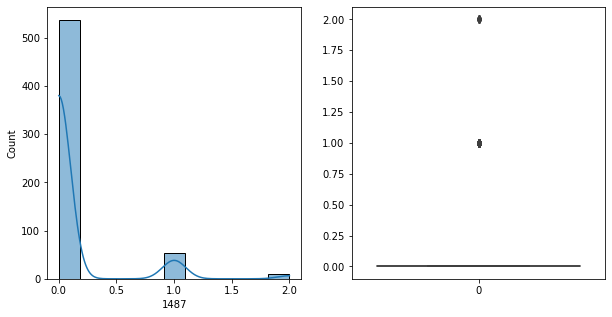

1487   Unique :  [0 1 2]
--------------------------------------------------------------------
1487   N unique :  3
--------------------------------------------------------------------
1487   Value Counts :  0    537
1     54
2      9
Name: 1487, dtype: int64
--------------------------------------------------------------------



[ 1488 ]
show_df_info :  1488


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


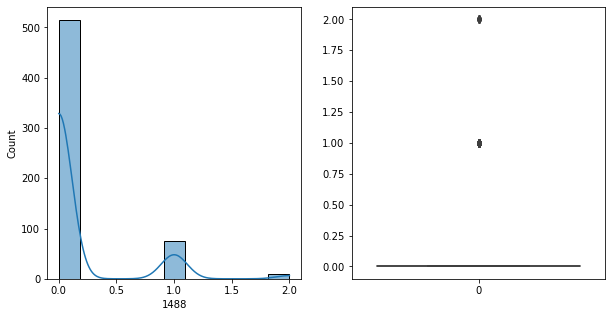

1488   Unique :  [0 1 2]
--------------------------------------------------------------------
1488   N unique :  3
--------------------------------------------------------------------
1488   Value Counts :  0    515
1     75
2     10
Name: 1488, dtype: int64
--------------------------------------------------------------------



[ 1489 ]
show_df_info :  1489


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


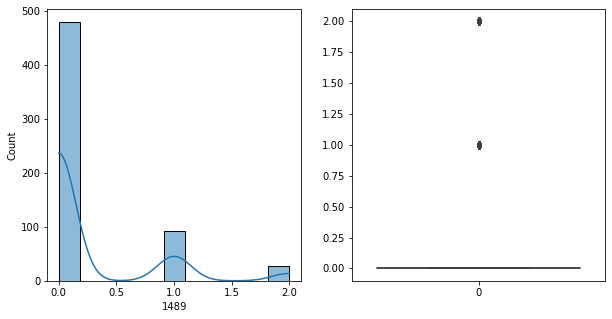

1489   Unique :  [1 0 2]
--------------------------------------------------------------------
1489   N unique :  3
--------------------------------------------------------------------
1489   Value Counts :  0    480
1     92
2     28
Name: 1489, dtype: int64
--------------------------------------------------------------------



[ 1490 ]
show_df_info :  1490


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


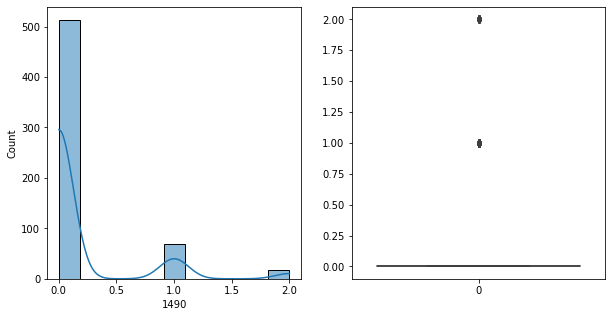

1490   Unique :  [0 1 2]
--------------------------------------------------------------------
1490   N unique :  3
--------------------------------------------------------------------
1490   Value Counts :  0    513
1     69
2     18
Name: 1490, dtype: int64
--------------------------------------------------------------------



[ 1491 ]
show_df_info :  1491


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


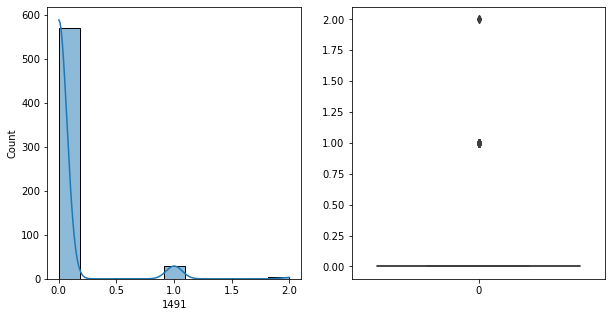

1491   Unique :  [0 1 2]
--------------------------------------------------------------------
1491   N unique :  3
--------------------------------------------------------------------
1491   Value Counts :  0    569
1     28
2      3
Name: 1491, dtype: int64
--------------------------------------------------------------------



[ 1492 ]
show_df_info :  1492


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


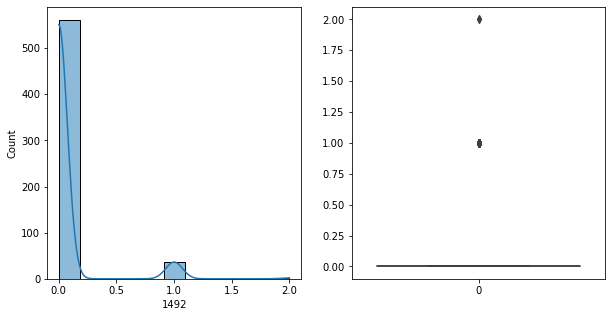

1492   Unique :  [0 1 2]
--------------------------------------------------------------------
1492   N unique :  3
--------------------------------------------------------------------
1492   Value Counts :  0    561
1     37
2      2
Name: 1492, dtype: int64
--------------------------------------------------------------------



[ 1493 ]
show_df_info :  1493


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


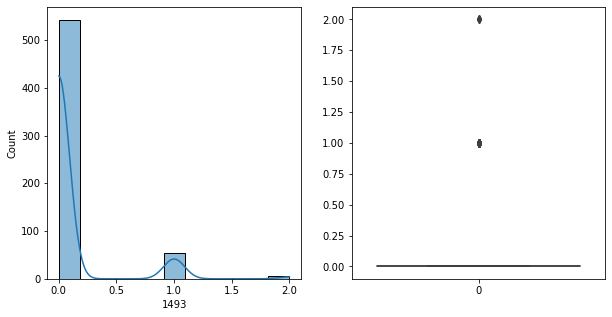

1493   Unique :  [0 1 2]
--------------------------------------------------------------------
1493   N unique :  3
--------------------------------------------------------------------
1493   Value Counts :  0    542
1     53
2      5
Name: 1493, dtype: int64
--------------------------------------------------------------------



[ 1494 ]
show_df_info :  1494


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


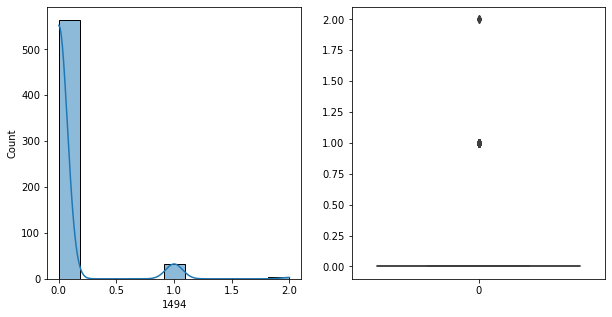

1494   Unique :  [1 0 2]
--------------------------------------------------------------------
1494   N unique :  3
--------------------------------------------------------------------
1494   Value Counts :  0    564
1     33
2      3
Name: 1494, dtype: int64
--------------------------------------------------------------------



[ 1495 ]
show_df_info :  1495


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


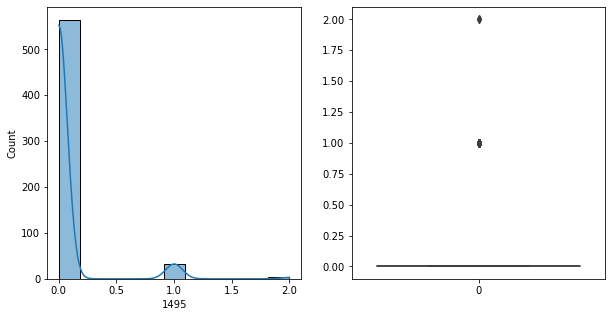

1495   Unique :  [1 0 2]
--------------------------------------------------------------------
1495   N unique :  3
--------------------------------------------------------------------
1495   Value Counts :  0    564
1     33
2      3
Name: 1495, dtype: int64
--------------------------------------------------------------------



[ 1496 ]
show_df_info :  1496


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


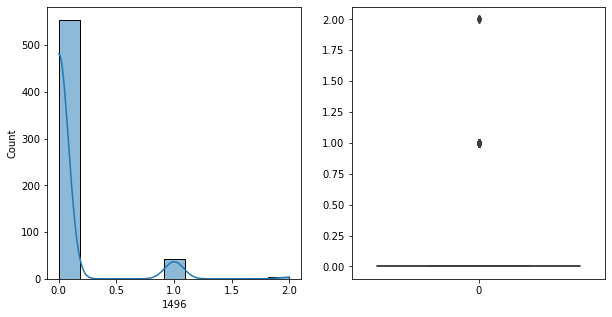

1496   Unique :  [0 1 2]
--------------------------------------------------------------------
1496   N unique :  3
--------------------------------------------------------------------
1496   Value Counts :  0    554
1     42
2      4
Name: 1496, dtype: int64
--------------------------------------------------------------------



[ 1497 ]
show_df_info :  1497


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


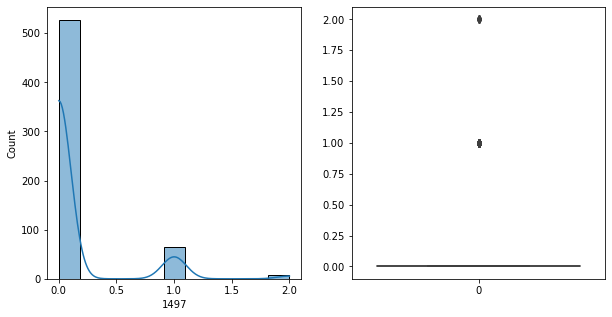

1497   Unique :  [1 0 2]
--------------------------------------------------------------------
1497   N unique :  3
--------------------------------------------------------------------
1497   Value Counts :  0    527
1     65
2      8
Name: 1497, dtype: int64
--------------------------------------------------------------------



[ 1498 ]
show_df_info :  1498


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


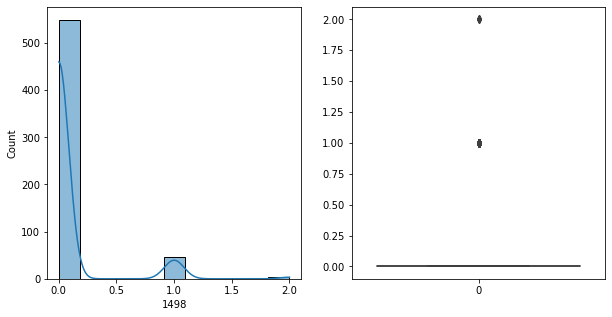

1498   Unique :  [0 1 2]
--------------------------------------------------------------------
1498   N unique :  3
--------------------------------------------------------------------
1498   Value Counts :  0    549
1     47
2      4
Name: 1498, dtype: int64
--------------------------------------------------------------------



[ 1499 ]
show_df_info :  1499


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


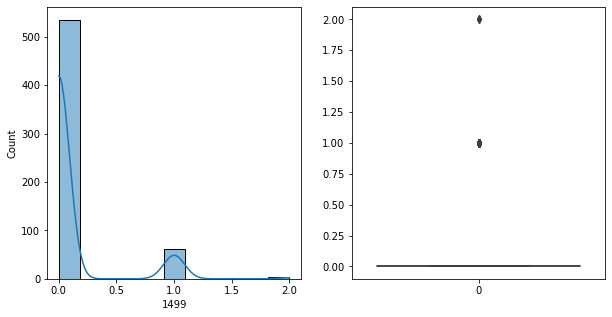

1499   Unique :  [1 0 2]
--------------------------------------------------------------------
1499   N unique :  3
--------------------------------------------------------------------
1499   Value Counts :  0    535
1     62
2      3
Name: 1499, dtype: int64
--------------------------------------------------------------------



[ 1500 ]
show_df_info :  1500


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


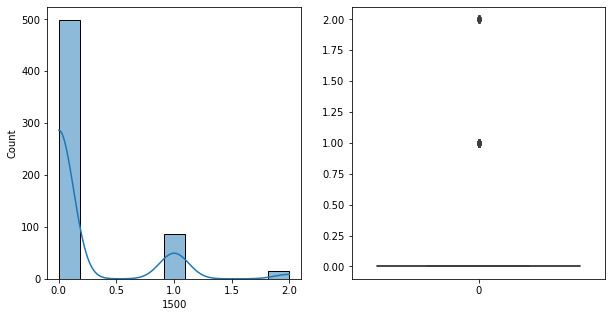

1500   Unique :  [0 2 1]
--------------------------------------------------------------------
1500   N unique :  3
--------------------------------------------------------------------
1500   Value Counts :  0    499
1     86
2     15
Name: 1500, dtype: int64
--------------------------------------------------------------------



[ 1501 ]
show_df_info :  1501


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


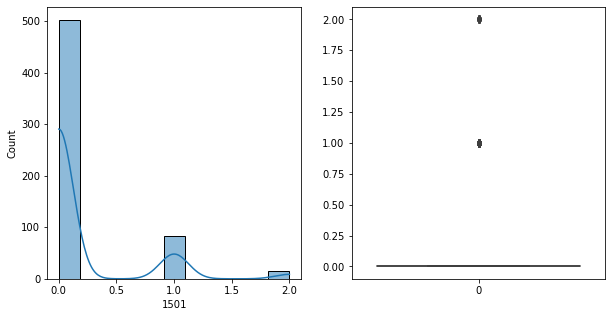

1501   Unique :  [0 2 1]
--------------------------------------------------------------------
1501   N unique :  3
--------------------------------------------------------------------
1501   Value Counts :  0    502
1     83
2     15
Name: 1501, dtype: int64
--------------------------------------------------------------------



[ 1502 ]
show_df_info :  1502


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


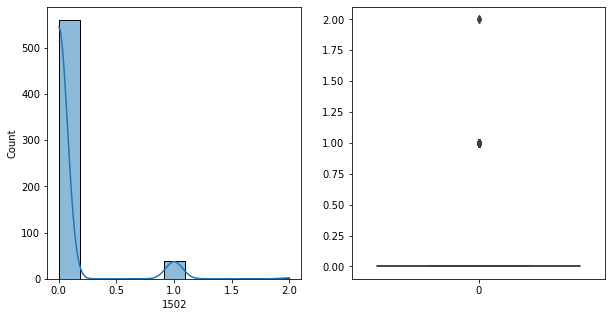

1502   Unique :  [0 1 2]
--------------------------------------------------------------------
1502   N unique :  3
--------------------------------------------------------------------
1502   Value Counts :  0    560
1     38
2      2
Name: 1502, dtype: int64
--------------------------------------------------------------------



[ 1503 ]
show_df_info :  1503


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


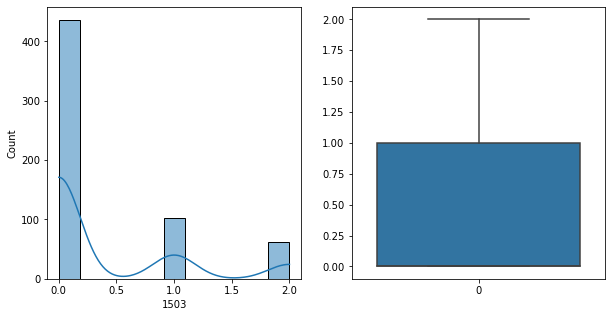

1503   Unique :  [1 0 2]
--------------------------------------------------------------------
1503   N unique :  3
--------------------------------------------------------------------
1503   Value Counts :  0    436
1    102
2     62
Name: 1503, dtype: int64
--------------------------------------------------------------------



[ 1504 ]
show_df_info :  1504


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


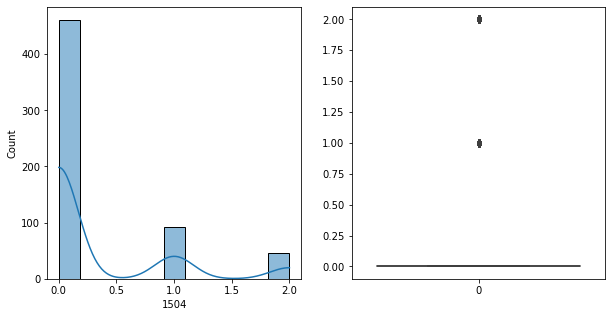

1504   Unique :  [1 0 2]
--------------------------------------------------------------------
1504   N unique :  3
--------------------------------------------------------------------
1504   Value Counts :  0    461
1     93
2     46
Name: 1504, dtype: int64
--------------------------------------------------------------------



[ 1505 ]
show_df_info :  1505


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


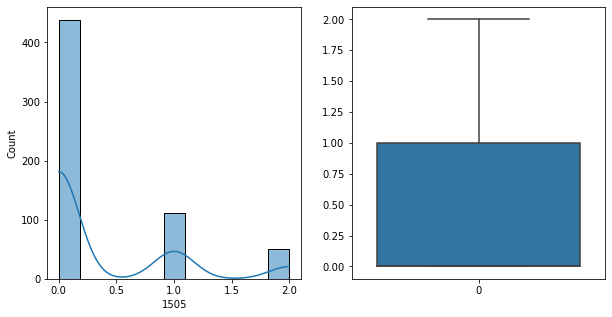

1505   Unique :  [1 0 2]
--------------------------------------------------------------------
1505   N unique :  3
--------------------------------------------------------------------
1505   Value Counts :  0    438
1    112
2     50
Name: 1505, dtype: int64
--------------------------------------------------------------------



[ 1506 ]
show_df_info :  1506


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


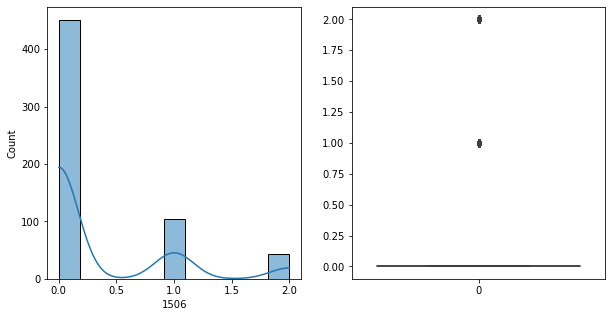

1506   Unique :  [1 0 2]
--------------------------------------------------------------------
1506   N unique :  3
--------------------------------------------------------------------
1506   Value Counts :  0    451
1    105
2     44
Name: 1506, dtype: int64
--------------------------------------------------------------------



[ 1507 ]
show_df_info :  1507


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


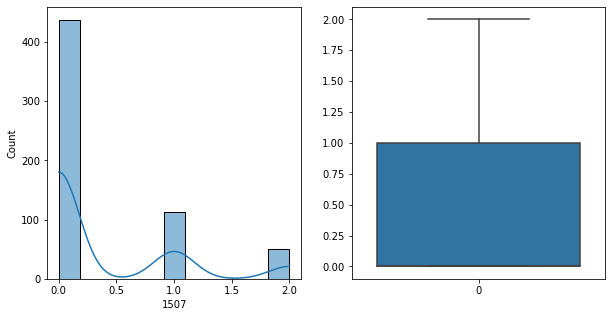

1507   Unique :  [1 0 2]
--------------------------------------------------------------------
1507   N unique :  3
--------------------------------------------------------------------
1507   Value Counts :  0    437
1    112
2     51
Name: 1507, dtype: int64
--------------------------------------------------------------------



[ 1508 ]
show_df_info :  1508


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


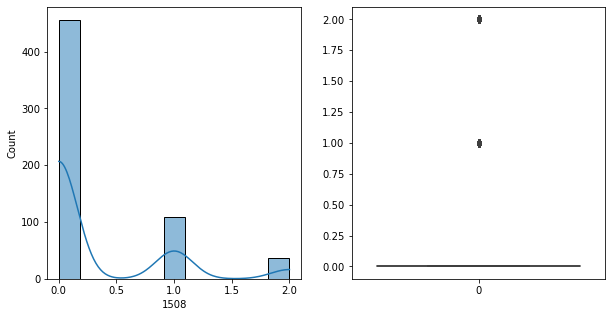

1508   Unique :  [1 0 2]
--------------------------------------------------------------------
1508   N unique :  3
--------------------------------------------------------------------
1508   Value Counts :  0    456
1    108
2     36
Name: 1508, dtype: int64
--------------------------------------------------------------------



[ 1509 ]
show_df_info :  1509


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


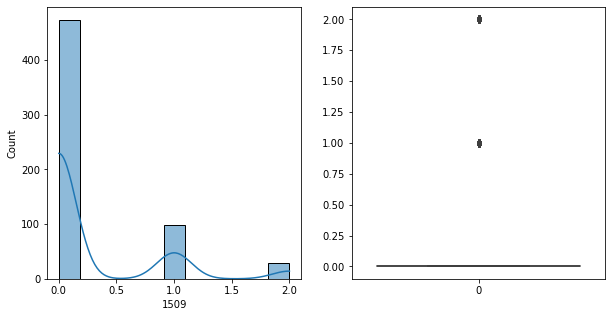

1509   Unique :  [1 0 2]
--------------------------------------------------------------------
1509   N unique :  3
--------------------------------------------------------------------
1509   Value Counts :  0    473
1     98
2     29
Name: 1509, dtype: int64
--------------------------------------------------------------------



[ 1510 ]
show_df_info :  1510


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


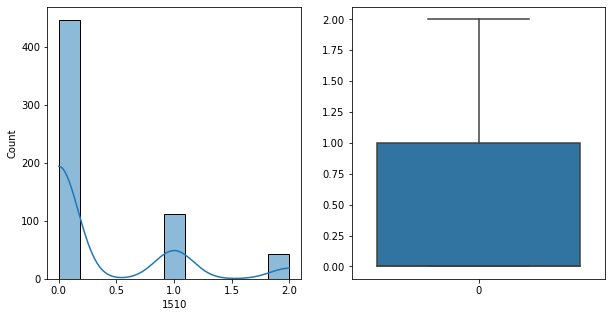

1510   Unique :  [1 0 2]
--------------------------------------------------------------------
1510   N unique :  3
--------------------------------------------------------------------
1510   Value Counts :  0    446
1    112
2     42
Name: 1510, dtype: int64
--------------------------------------------------------------------



[ 1511 ]
show_df_info :  1511


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


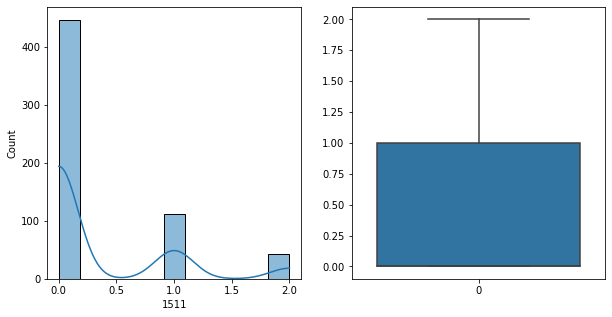

1511   Unique :  [1 0 2]
--------------------------------------------------------------------
1511   N unique :  3
--------------------------------------------------------------------
1511   Value Counts :  0    446
1    112
2     42
Name: 1511, dtype: int64
--------------------------------------------------------------------



[ 1512 ]
show_df_info :  1512


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


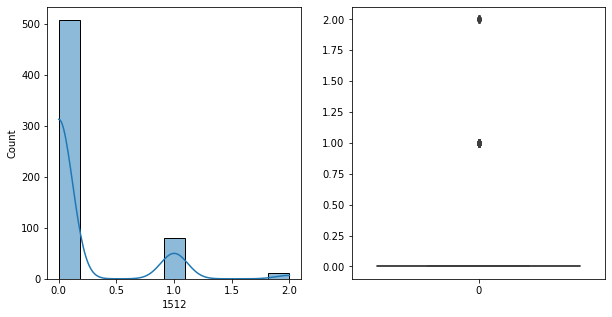

1512   Unique :  [0 1 2]
--------------------------------------------------------------------
1512   N unique :  3
--------------------------------------------------------------------
1512   Value Counts :  0    508
1     81
2     11
Name: 1512, dtype: int64
--------------------------------------------------------------------



[ 1513 ]
show_df_info :  1513


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


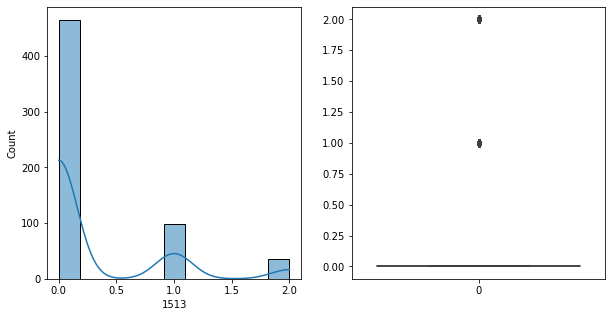

1513   Unique :  [0 1 2]
--------------------------------------------------------------------
1513   N unique :  3
--------------------------------------------------------------------
1513   Value Counts :  0    465
1     99
2     36
Name: 1513, dtype: int64
--------------------------------------------------------------------



[ 1514 ]
show_df_info :  1514


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


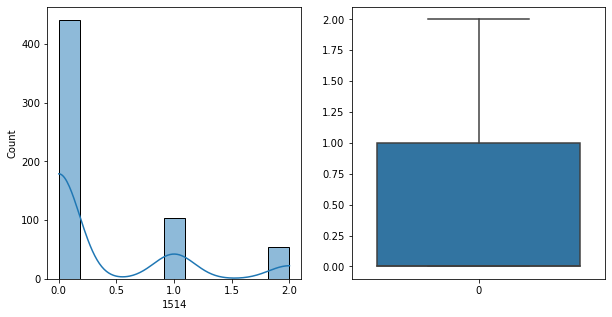

1514   Unique :  [2 0 1]
--------------------------------------------------------------------
1514   N unique :  3
--------------------------------------------------------------------
1514   Value Counts :  0    441
1    104
2     55
Name: 1514, dtype: int64
--------------------------------------------------------------------



[ 1515 ]
show_df_info :  1515


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


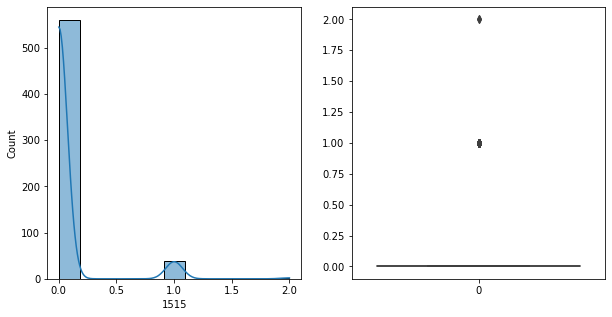

1515   Unique :  [0 1 2]
--------------------------------------------------------------------
1515   N unique :  3
--------------------------------------------------------------------
1515   Value Counts :  0    560
1     38
2      2
Name: 1515, dtype: int64
--------------------------------------------------------------------



[ 1516 ]
show_df_info :  1516


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


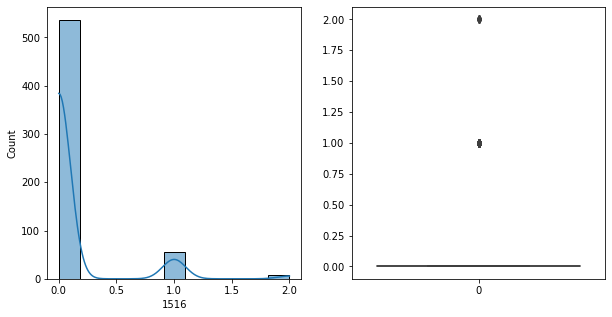

1516   Unique :  [2 0 1]
--------------------------------------------------------------------
1516   N unique :  3
--------------------------------------------------------------------
1516   Value Counts :  0    536
1     56
2      8
Name: 1516, dtype: int64
--------------------------------------------------------------------



[ 1517 ]
show_df_info :  1517


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


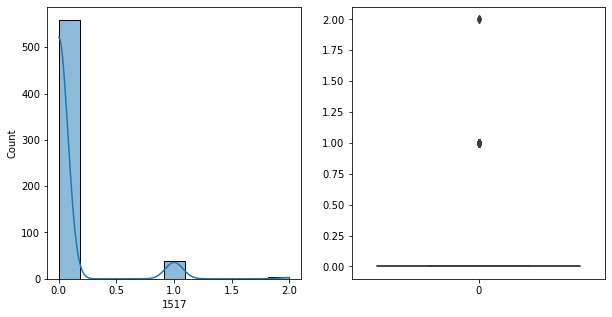

1517   Unique :  [0 2 1]
--------------------------------------------------------------------
1517   N unique :  3
--------------------------------------------------------------------
1517   Value Counts :  0    559
1     38
2      3
Name: 1517, dtype: int64
--------------------------------------------------------------------



[ 1518 ]
show_df_info :  1518


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


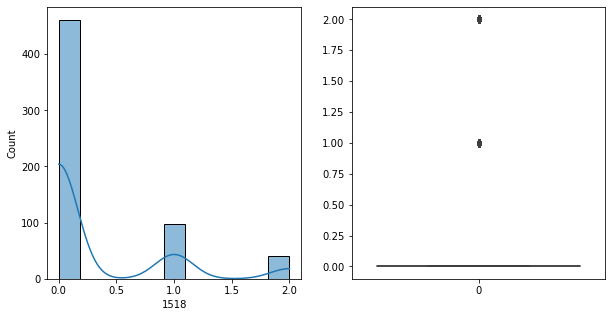

1518   Unique :  [0 1 2]
--------------------------------------------------------------------
1518   N unique :  3
--------------------------------------------------------------------
1518   Value Counts :  0    461
1     98
2     41
Name: 1518, dtype: int64
--------------------------------------------------------------------



[ 1519 ]
show_df_info :  1519


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


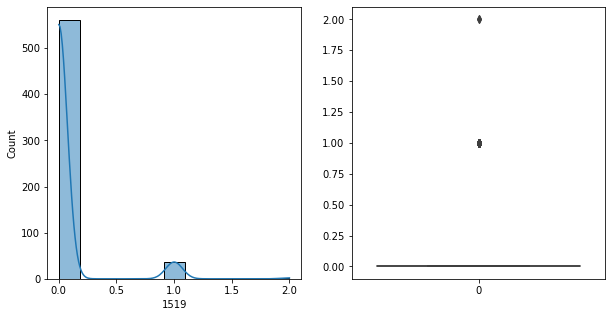

1519   Unique :  [0 1 2]
--------------------------------------------------------------------
1519   N unique :  3
--------------------------------------------------------------------
1519   Value Counts :  0    561
1     37
2      2
Name: 1519, dtype: int64
--------------------------------------------------------------------



[ 1520 ]
show_df_info :  1520


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


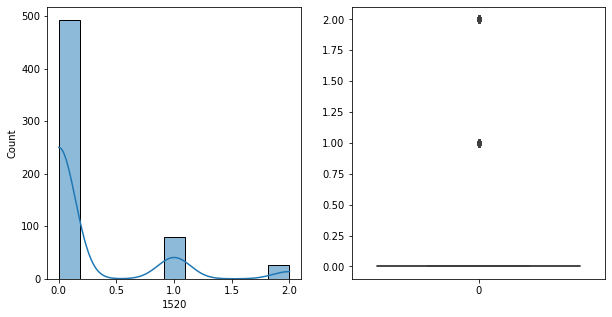

1520   Unique :  [0 1 2]
--------------------------------------------------------------------
1520   N unique :  3
--------------------------------------------------------------------
1520   Value Counts :  0    493
1     80
2     27
Name: 1520, dtype: int64
--------------------------------------------------------------------



[ 1521 ]
show_df_info :  1521


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


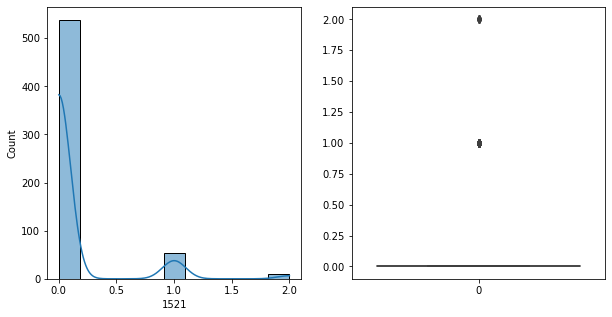

1521   Unique :  [2 0 1]
--------------------------------------------------------------------
1521   N unique :  3
--------------------------------------------------------------------
1521   Value Counts :  0    538
1     53
2      9
Name: 1521, dtype: int64
--------------------------------------------------------------------



[ 1522 ]
show_df_info :  1522


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


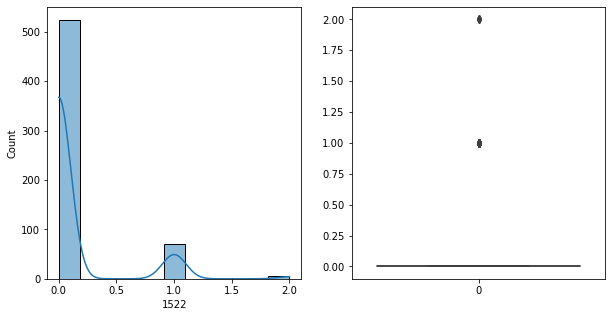

1522   Unique :  [0 1 2]
--------------------------------------------------------------------
1522   N unique :  3
--------------------------------------------------------------------
1522   Value Counts :  0    524
1     70
2      6
Name: 1522, dtype: int64
--------------------------------------------------------------------



[ 1523 ]
show_df_info :  1523


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


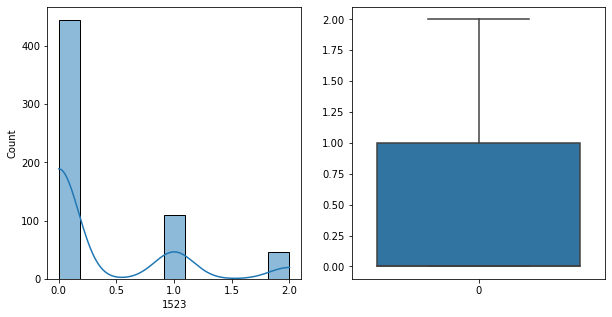

1523   Unique :  [0 1 2]
--------------------------------------------------------------------
1523   N unique :  3
--------------------------------------------------------------------
1523   Value Counts :  0    445
1    109
2     46
Name: 1523, dtype: int64
--------------------------------------------------------------------



[ 1524 ]
show_df_info :  1524


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


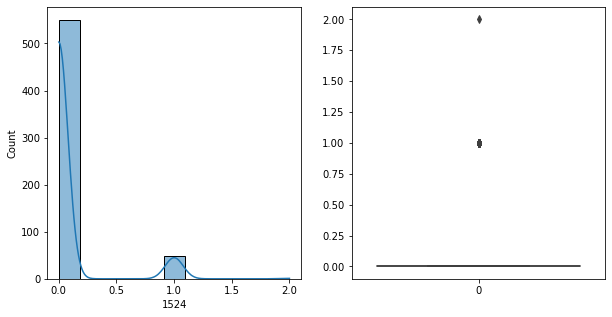

1524   Unique :  [0 1 2]
--------------------------------------------------------------------
1524   N unique :  3
--------------------------------------------------------------------
1524   Value Counts :  0    550
1     49
2      1
Name: 1524, dtype: int64
--------------------------------------------------------------------



[ 1525 ]
show_df_info :  1525


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


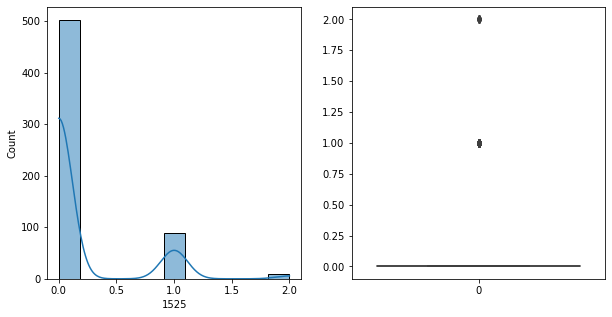

1525   Unique :  [0 1 2]
--------------------------------------------------------------------
1525   N unique :  3
--------------------------------------------------------------------
1525   Value Counts :  0    502
1     89
2      9
Name: 1525, dtype: int64
--------------------------------------------------------------------



[ 1526 ]
show_df_info :  1526


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


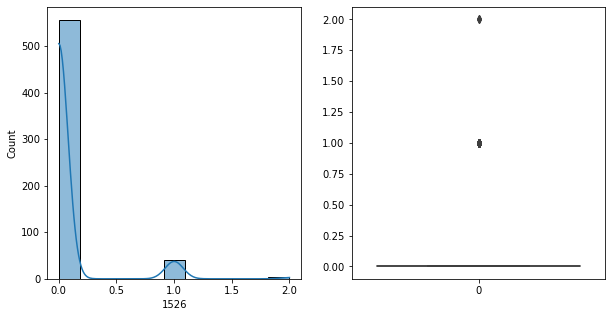

1526   Unique :  [0 1 2]
--------------------------------------------------------------------
1526   N unique :  3
--------------------------------------------------------------------
1526   Value Counts :  0    556
1     41
2      3
Name: 1526, dtype: int64
--------------------------------------------------------------------



[ 1527 ]
show_df_info :  1527


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


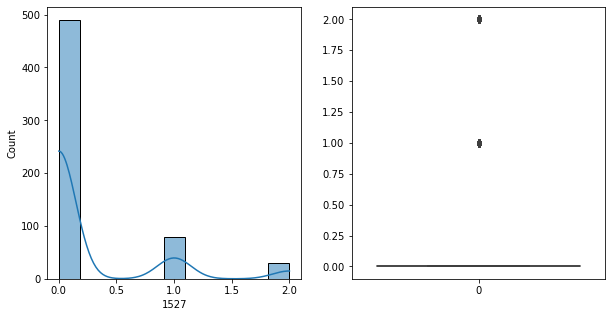

1527   Unique :  [0 1 2]
--------------------------------------------------------------------
1527   N unique :  3
--------------------------------------------------------------------
1527   Value Counts :  0    490
1     80
2     30
Name: 1527, dtype: int64
--------------------------------------------------------------------



[ 1528 ]
show_df_info :  1528


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


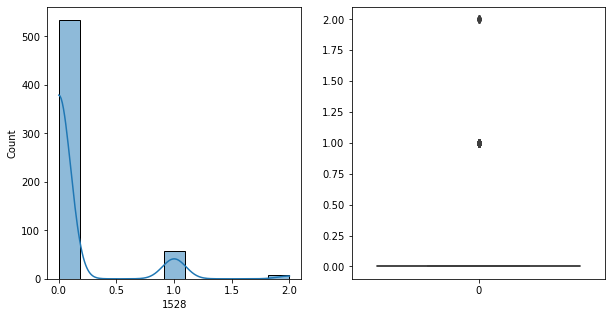

1528   Unique :  [0 1 2]
--------------------------------------------------------------------
1528   N unique :  3
--------------------------------------------------------------------
1528   Value Counts :  0    534
1     58
2      8
Name: 1528, dtype: int64
--------------------------------------------------------------------



[ 1529 ]
show_df_info :  1529


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


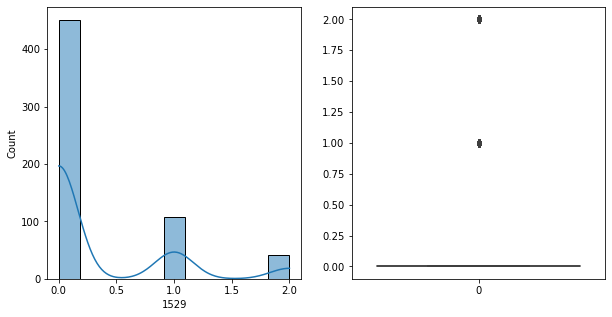

1529   Unique :  [0 1 2]
--------------------------------------------------------------------
1529   N unique :  3
--------------------------------------------------------------------
1529   Value Counts :  0    451
1    107
2     42
Name: 1529, dtype: int64
--------------------------------------------------------------------



[ 1530 ]
show_df_info :  1530


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


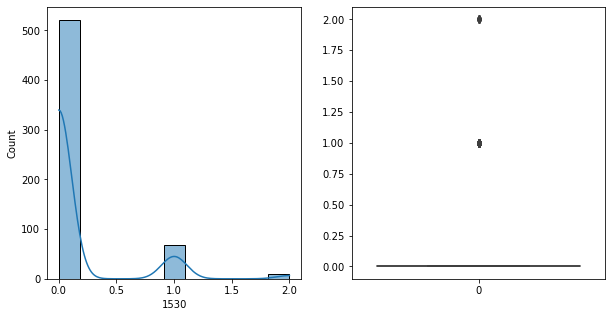

1530   Unique :  [0 1 2]
--------------------------------------------------------------------
1530   N unique :  3
--------------------------------------------------------------------
1530   Value Counts :  0    521
1     69
2     10
Name: 1530, dtype: int64
--------------------------------------------------------------------



[ 1531 ]
show_df_info :  1531


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


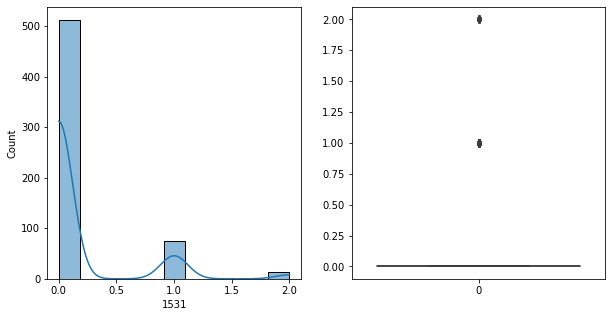

1531   Unique :  [2 0 1]
--------------------------------------------------------------------
1531   N unique :  3
--------------------------------------------------------------------
1531   Value Counts :  0    512
1     75
2     13
Name: 1531, dtype: int64
--------------------------------------------------------------------



[ 1532 ]
show_df_info :  1532


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


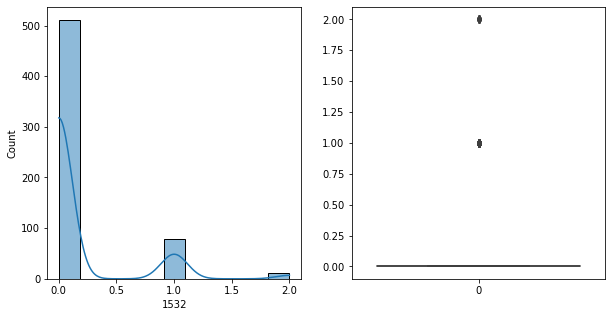

1532   Unique :  [0 1 2]
--------------------------------------------------------------------
1532   N unique :  3
--------------------------------------------------------------------
1532   Value Counts :  0    511
1     78
2     11
Name: 1532, dtype: int64
--------------------------------------------------------------------



[ 1533 ]
show_df_info :  1533


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


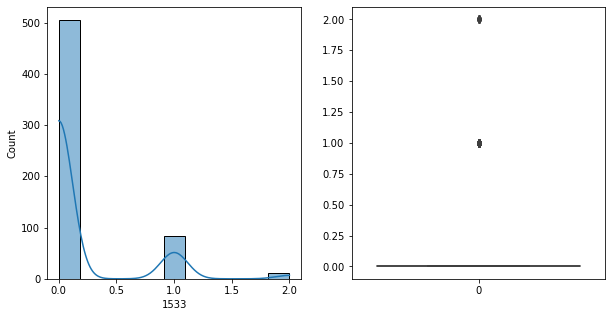

1533   Unique :  [0 1 2]
--------------------------------------------------------------------
1533   N unique :  3
--------------------------------------------------------------------
1533   Value Counts :  0    505
1     84
2     11
Name: 1533, dtype: int64
--------------------------------------------------------------------



[ 1534 ]
show_df_info :  1534


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


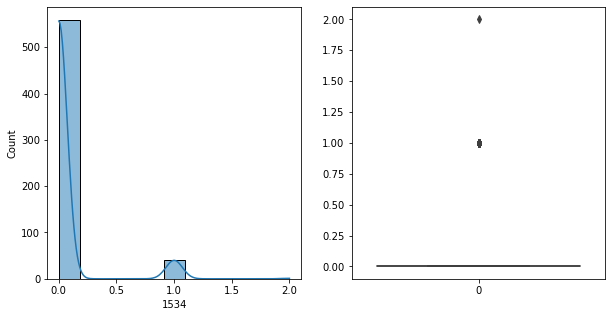

1534   Unique :  [0 1 2]
--------------------------------------------------------------------
1534   N unique :  3
--------------------------------------------------------------------
1534   Value Counts :  0    559
1     40
2      1
Name: 1534, dtype: int64
--------------------------------------------------------------------



[ 1535 ]
show_df_info :  1535


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


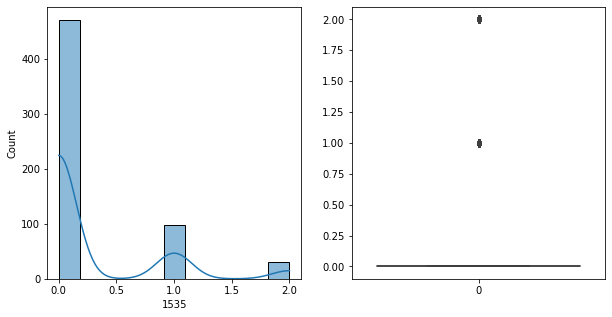

1535   Unique :  [1 0 2]
--------------------------------------------------------------------
1535   N unique :  3
--------------------------------------------------------------------
1535   Value Counts :  0    471
1     98
2     31
Name: 1535, dtype: int64
--------------------------------------------------------------------



[ 1536 ]
show_df_info :  1536


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


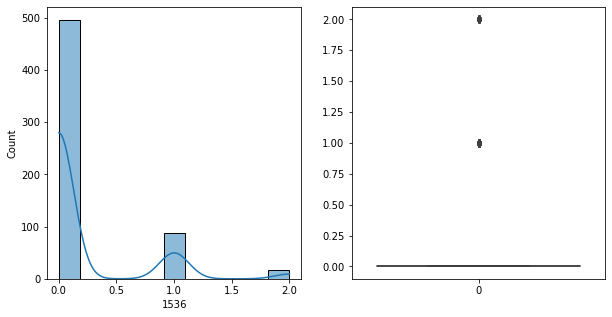

1536   Unique :  [1 0 2]
--------------------------------------------------------------------
1536   N unique :  3
--------------------------------------------------------------------
1536   Value Counts :  0    496
1     88
2     16
Name: 1536, dtype: int64
--------------------------------------------------------------------



[ 1537 ]
show_df_info :  1537


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


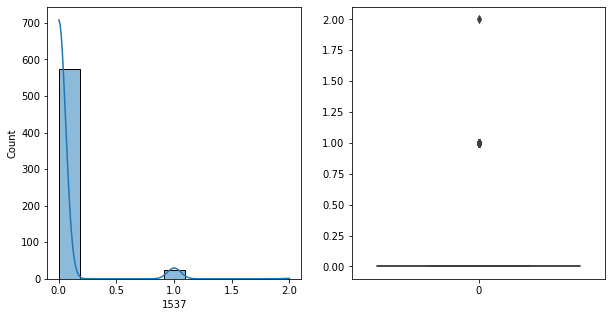

1537   Unique :  [0 1 2]
--------------------------------------------------------------------
1537   N unique :  3
--------------------------------------------------------------------
1537   Value Counts :  0    575
1     24
2      1
Name: 1537, dtype: int64
--------------------------------------------------------------------



[ 1538 ]
show_df_info :  1538


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


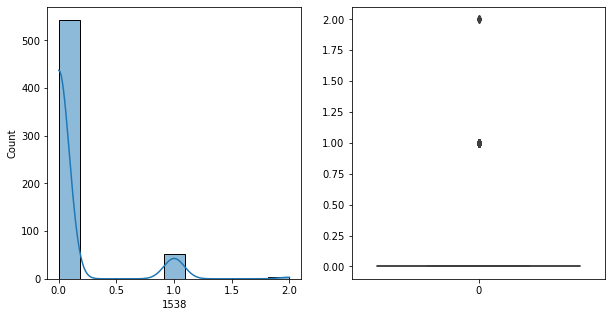

1538   Unique :  [1 0 2]
--------------------------------------------------------------------
1538   N unique :  3
--------------------------------------------------------------------
1538   Value Counts :  0    543
1     53
2      4
Name: 1538, dtype: int64
--------------------------------------------------------------------



[ 1539 ]
show_df_info :  1539


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


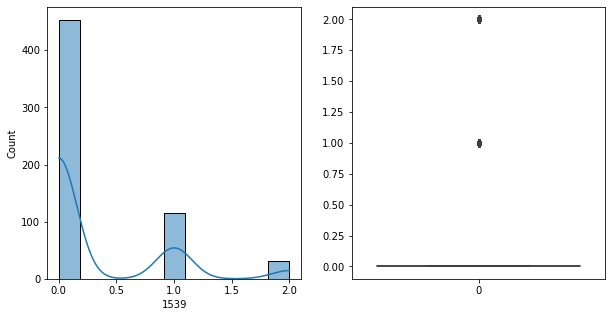

1539   Unique :  [1 0 2]
--------------------------------------------------------------------
1539   N unique :  3
--------------------------------------------------------------------
1539   Value Counts :  0    453
1    116
2     31
Name: 1539, dtype: int64
--------------------------------------------------------------------



[ 1540 ]
show_df_info :  1540


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


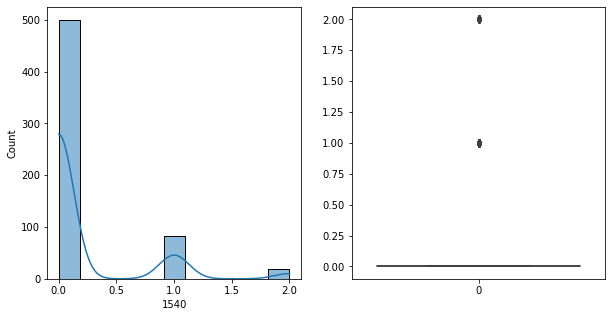

1540   Unique :  [0 1 2]
--------------------------------------------------------------------
1540   N unique :  3
--------------------------------------------------------------------
1540   Value Counts :  0    500
1     82
2     18
Name: 1540, dtype: int64
--------------------------------------------------------------------



[ 1541 ]
show_df_info :  1541


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


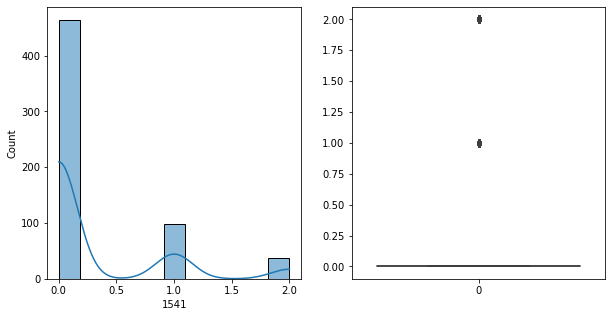

1541   Unique :  [0 1 2]
--------------------------------------------------------------------
1541   N unique :  3
--------------------------------------------------------------------
1541   Value Counts :  0    464
1     98
2     38
Name: 1541, dtype: int64
--------------------------------------------------------------------



[ 1542 ]
show_df_info :  1542


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


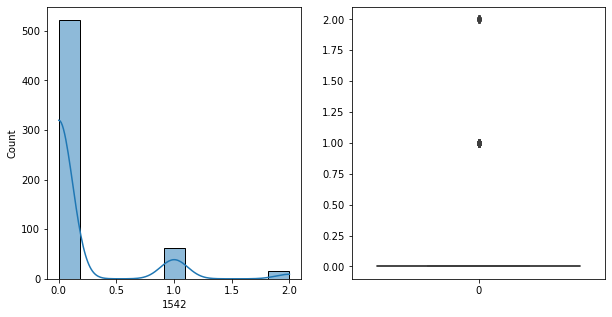

1542   Unique :  [0 1 2]
--------------------------------------------------------------------
1542   N unique :  3
--------------------------------------------------------------------
1542   Value Counts :  0    522
1     63
2     15
Name: 1542, dtype: int64
--------------------------------------------------------------------



[ 1543 ]
show_df_info :  1543


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


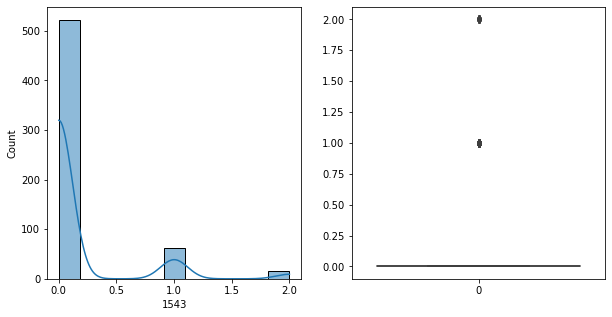

1543   Unique :  [0 1 2]
--------------------------------------------------------------------
1543   N unique :  3
--------------------------------------------------------------------
1543   Value Counts :  0    522
1     63
2     15
Name: 1543, dtype: int64
--------------------------------------------------------------------



[ 1544 ]
show_df_info :  1544


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


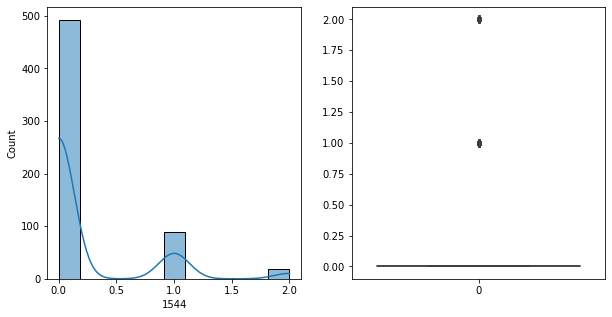

1544   Unique :  [1 0 2]
--------------------------------------------------------------------
1544   N unique :  3
--------------------------------------------------------------------
1544   Value Counts :  0    492
1     89
2     19
Name: 1544, dtype: int64
--------------------------------------------------------------------



[ 1545 ]
show_df_info :  1545


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


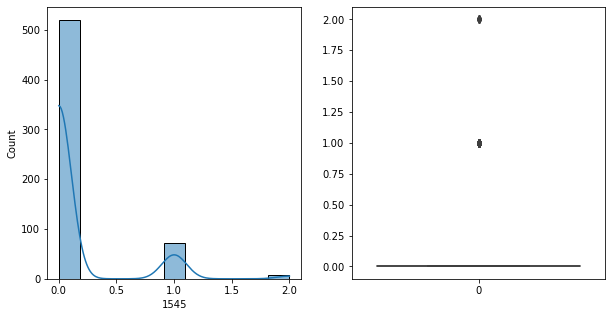

1545   Unique :  [1 0 2]
--------------------------------------------------------------------
1545   N unique :  3
--------------------------------------------------------------------
1545   Value Counts :  0    520
1     72
2      8
Name: 1545, dtype: int64
--------------------------------------------------------------------



[ 1546 ]
show_df_info :  1546


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


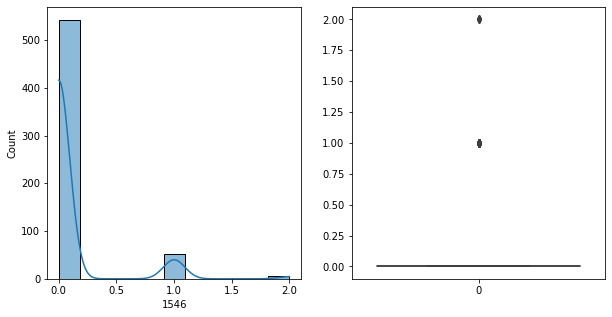

1546   Unique :  [0 1 2]
--------------------------------------------------------------------
1546   N unique :  3
--------------------------------------------------------------------
1546   Value Counts :  0    542
1     52
2      6
Name: 1546, dtype: int64
--------------------------------------------------------------------



[ 1547 ]
show_df_info :  1547


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


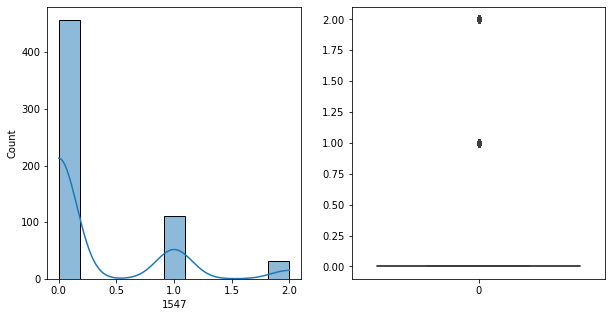

1547   Unique :  [2 0 1]
--------------------------------------------------------------------
1547   N unique :  3
--------------------------------------------------------------------
1547   Value Counts :  0    457
1    111
2     32
Name: 1547, dtype: int64
--------------------------------------------------------------------



[ 1548 ]
show_df_info :  1548


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


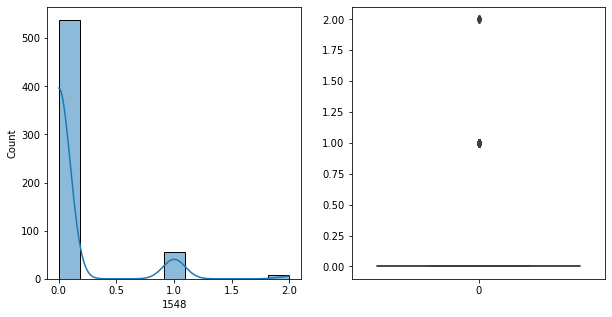

1548   Unique :  [0 1 2]
--------------------------------------------------------------------
1548   N unique :  3
--------------------------------------------------------------------
1548   Value Counts :  0    538
1     55
2      7
Name: 1548, dtype: int64
--------------------------------------------------------------------



[ 1549 ]
show_df_info :  1549


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


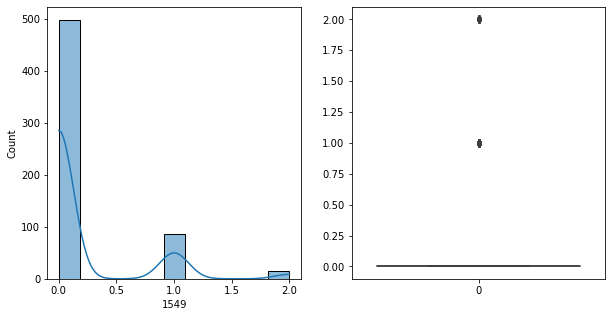

1549   Unique :  [2 0 1]
--------------------------------------------------------------------
1549   N unique :  3
--------------------------------------------------------------------
1549   Value Counts :  0    498
1     87
2     15
Name: 1549, dtype: int64
--------------------------------------------------------------------



[ 1550 ]
show_df_info :  1550


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


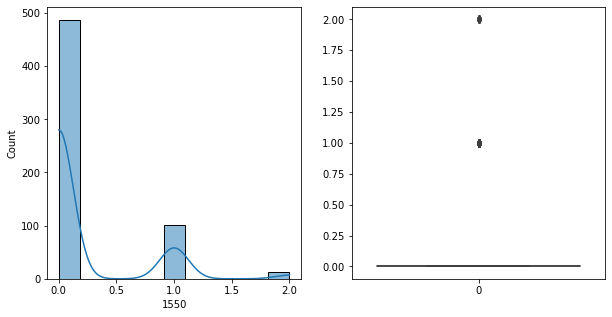

1550   Unique :  [1 0 2]
--------------------------------------------------------------------
1550   N unique :  3
--------------------------------------------------------------------
1550   Value Counts :  0    487
1    101
2     12
Name: 1550, dtype: int64
--------------------------------------------------------------------



[ 1551 ]
show_df_info :  1551


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


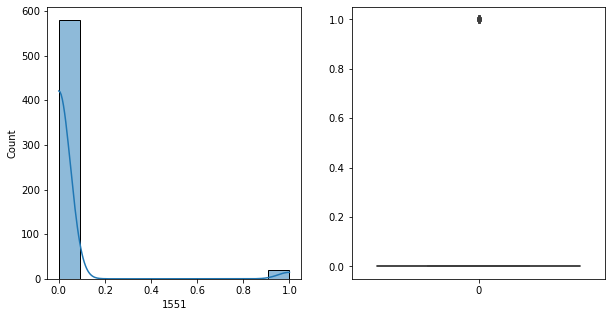

1551   Unique :  [0 1]
--------------------------------------------------------------------
1551   N unique :  2
--------------------------------------------------------------------
1551   Value Counts :  0    580
1     20
Name: 1551, dtype: int64
--------------------------------------------------------------------



[ 1552 ]
show_df_info :  1552


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


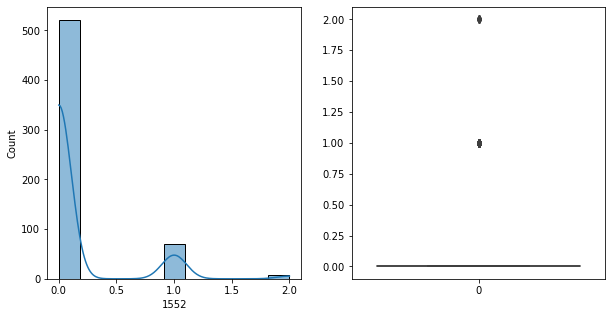

1552   Unique :  [1 0 2]
--------------------------------------------------------------------
1552   N unique :  3
--------------------------------------------------------------------
1552   Value Counts :  0    521
1     71
2      8
Name: 1552, dtype: int64
--------------------------------------------------------------------



[ 1553 ]
show_df_info :  1553


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


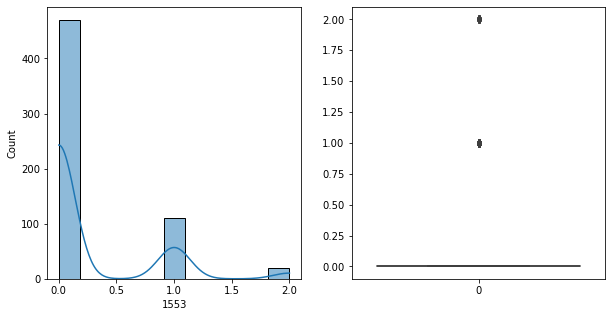

1553   Unique :  [1 0 2]
--------------------------------------------------------------------
1553   N unique :  3
--------------------------------------------------------------------
1553   Value Counts :  0    470
1    110
2     20
Name: 1553, dtype: int64
--------------------------------------------------------------------



[ 1554 ]
show_df_info :  1554


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


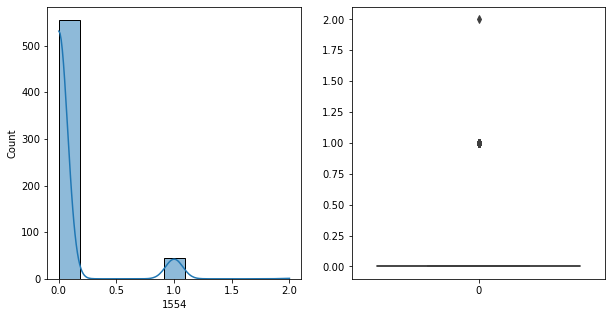

1554   Unique :  [0 1 2]
--------------------------------------------------------------------
1554   N unique :  3
--------------------------------------------------------------------
1554   Value Counts :  0    555
1     44
2      1
Name: 1554, dtype: int64
--------------------------------------------------------------------



[ 1555 ]
show_df_info :  1555


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


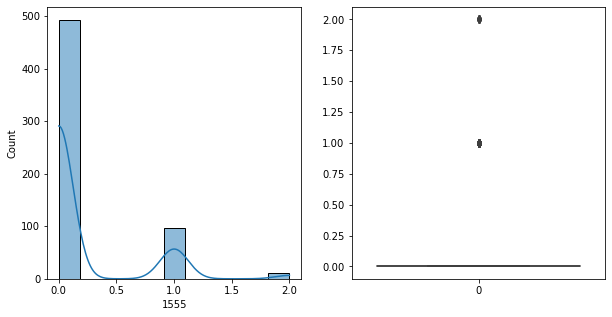

1555   Unique :  [1 0 2]
--------------------------------------------------------------------
1555   N unique :  3
--------------------------------------------------------------------
1555   Value Counts :  0    493
1     96
2     11
Name: 1555, dtype: int64
--------------------------------------------------------------------



[ 1556 ]
show_df_info :  1556


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


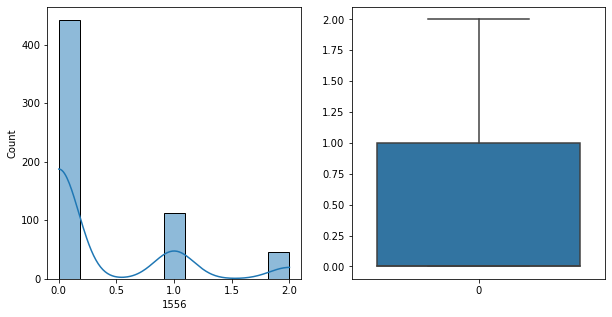

1556   Unique :  [2 0 1]
--------------------------------------------------------------------
1556   N unique :  3
--------------------------------------------------------------------
1556   Value Counts :  0    442
1    112
2     46
Name: 1556, dtype: int64
--------------------------------------------------------------------



[ 1557 ]
show_df_info :  1557


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


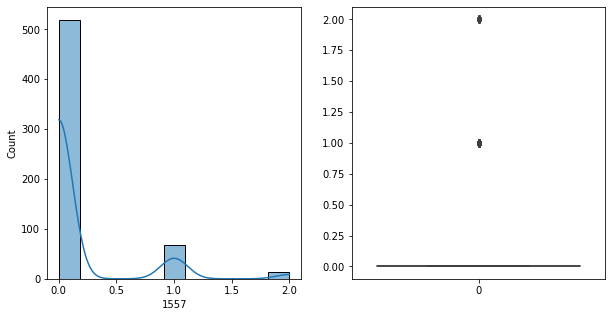

1557   Unique :  [0 1 2]
--------------------------------------------------------------------
1557   N unique :  3
--------------------------------------------------------------------
1557   Value Counts :  0    519
1     67
2     14
Name: 1557, dtype: int64
--------------------------------------------------------------------



[ 1558 ]
show_df_info :  1558


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


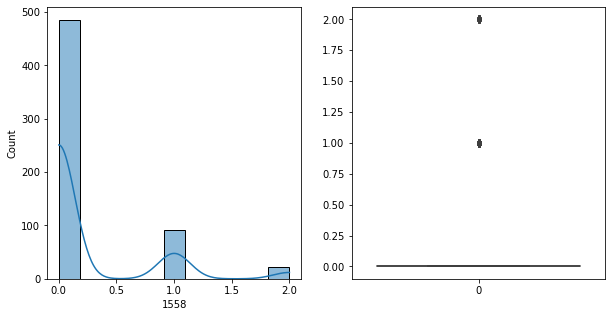

1558   Unique :  [1 0 2]
--------------------------------------------------------------------
1558   N unique :  3
--------------------------------------------------------------------
1558   Value Counts :  0    485
1     92
2     23
Name: 1558, dtype: int64
--------------------------------------------------------------------



[ 1559 ]
show_df_info :  1559


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


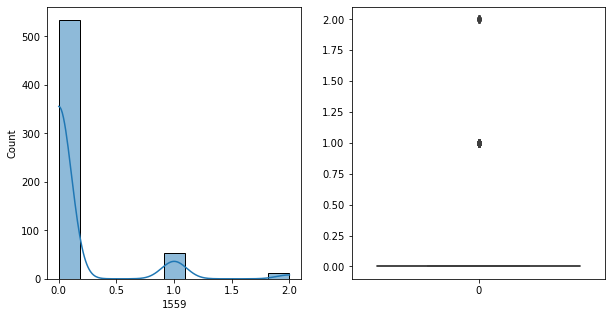

1559   Unique :  [0 2 1]
--------------------------------------------------------------------
1559   N unique :  3
--------------------------------------------------------------------
1559   Value Counts :  0    534
1     54
2     12
Name: 1559, dtype: int64
--------------------------------------------------------------------



[ 1560 ]
show_df_info :  1560


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


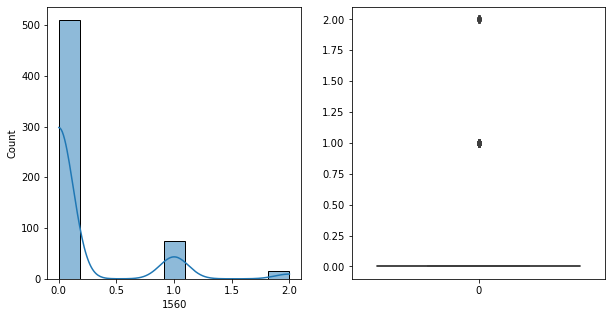

1560   Unique :  [1 0 2]
--------------------------------------------------------------------
1560   N unique :  3
--------------------------------------------------------------------
1560   Value Counts :  0    510
1     74
2     16
Name: 1560, dtype: int64
--------------------------------------------------------------------



[ 1561 ]
show_df_info :  1561


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


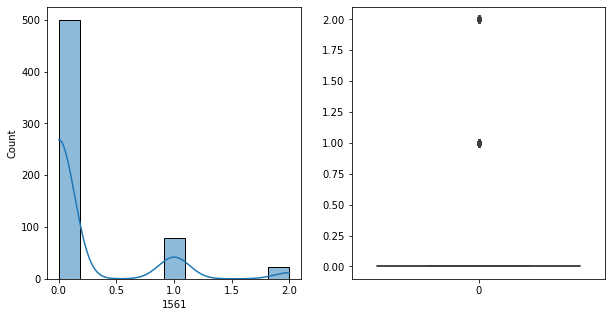

1561   Unique :  [1 0 2]
--------------------------------------------------------------------
1561   N unique :  3
--------------------------------------------------------------------
1561   Value Counts :  0    500
1     78
2     22
Name: 1561, dtype: int64
--------------------------------------------------------------------



[ 1562 ]
show_df_info :  1562


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


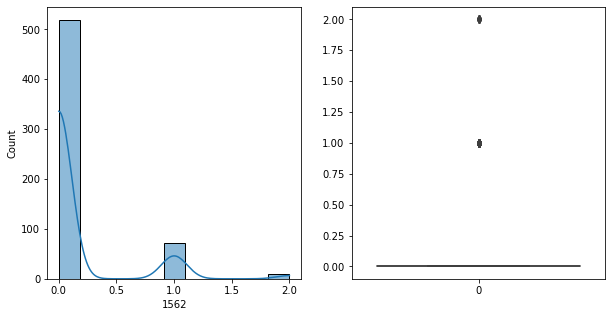

1562   Unique :  [0 2 1]
--------------------------------------------------------------------
1562   N unique :  3
--------------------------------------------------------------------
1562   Value Counts :  0    519
1     71
2     10
Name: 1562, dtype: int64
--------------------------------------------------------------------



[ 1563 ]
show_df_info :  1563


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


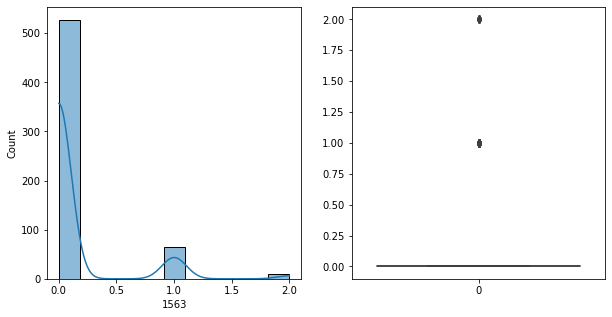

1563   Unique :  [0 2 1]
--------------------------------------------------------------------
1563   N unique :  3
--------------------------------------------------------------------
1563   Value Counts :  0    527
1     64
2      9
Name: 1563, dtype: int64
--------------------------------------------------------------------



[ 1564 ]
show_df_info :  1564


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


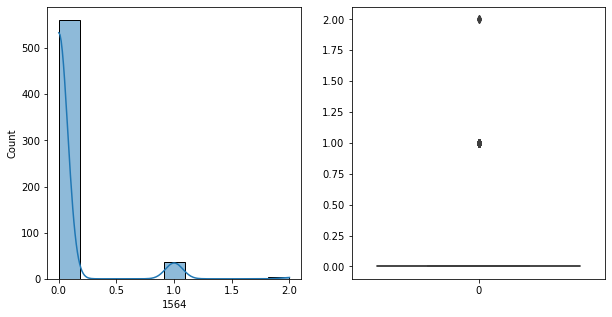

1564   Unique :  [0 2 1]
--------------------------------------------------------------------
1564   N unique :  3
--------------------------------------------------------------------
1564   Value Counts :  0    561
1     36
2      3
Name: 1564, dtype: int64
--------------------------------------------------------------------



[ 1565 ]
show_df_info :  1565


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


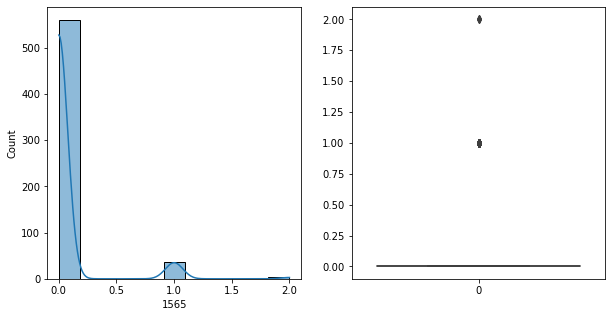

1565   Unique :  [0 2 1]
--------------------------------------------------------------------
1565   N unique :  3
--------------------------------------------------------------------
1565   Value Counts :  0    560
1     37
2      3
Name: 1565, dtype: int64
--------------------------------------------------------------------



[ 1566 ]
show_df_info :  1566


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


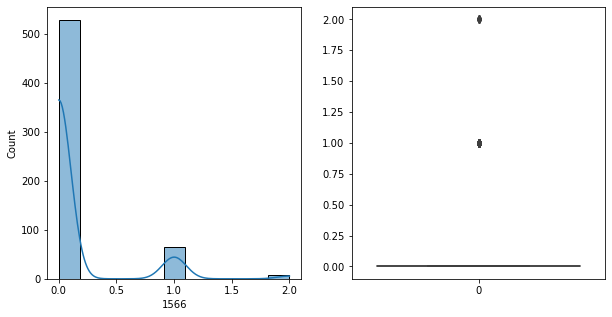

1566   Unique :  [0 2 1]
--------------------------------------------------------------------
1566   N unique :  3
--------------------------------------------------------------------
1566   Value Counts :  0    528
1     64
2      8
Name: 1566, dtype: int64
--------------------------------------------------------------------



[ 1567 ]
show_df_info :  1567


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


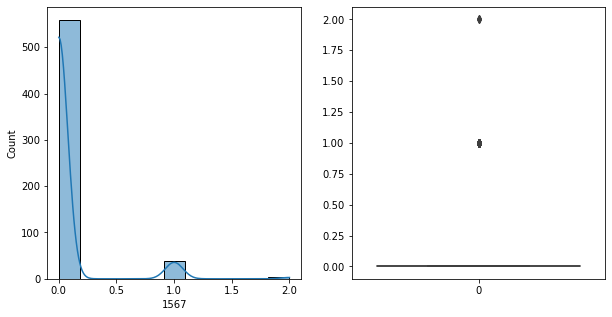

1567   Unique :  [0 2 1]
--------------------------------------------------------------------
1567   N unique :  3
--------------------------------------------------------------------
1567   Value Counts :  0    559
1     38
2      3
Name: 1567, dtype: int64
--------------------------------------------------------------------



[ 1568 ]
show_df_info :  1568


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


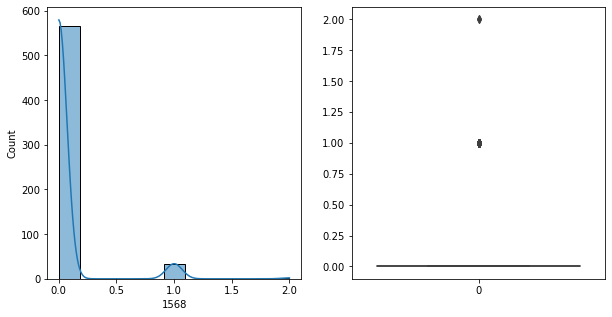

1568   Unique :  [0 2 1]
--------------------------------------------------------------------
1568   N unique :  3
--------------------------------------------------------------------
1568   Value Counts :  0    565
1     33
2      2
Name: 1568, dtype: int64
--------------------------------------------------------------------



[ 1569 ]
show_df_info :  1569


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


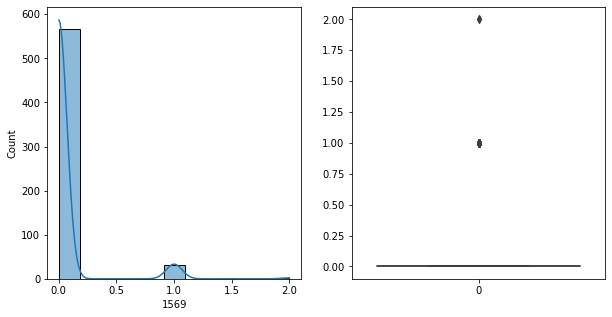

1569   Unique :  [0 2 1]
--------------------------------------------------------------------
1569   N unique :  3
--------------------------------------------------------------------
1569   Value Counts :  0    566
1     32
2      2
Name: 1569, dtype: int64
--------------------------------------------------------------------



[ 1570 ]
show_df_info :  1570


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


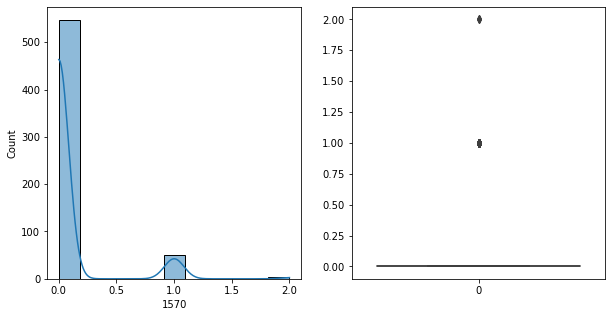

1570   Unique :  [0 1 2]
--------------------------------------------------------------------
1570   N unique :  3
--------------------------------------------------------------------
1570   Value Counts :  0    547
1     50
2      3
Name: 1570, dtype: int64
--------------------------------------------------------------------



[ 1571 ]
show_df_info :  1571


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


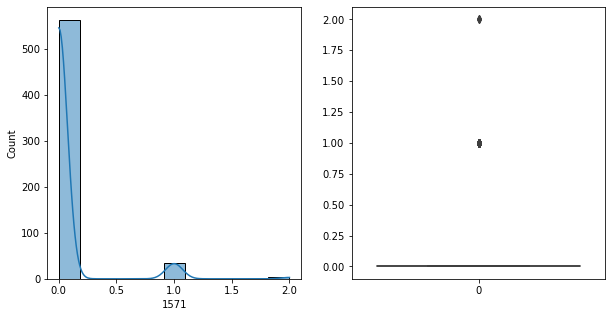

1571   Unique :  [0 1 2]
--------------------------------------------------------------------
1571   N unique :  3
--------------------------------------------------------------------
1571   Value Counts :  0    563
1     34
2      3
Name: 1571, dtype: int64
--------------------------------------------------------------------



[ 1572 ]
show_df_info :  1572


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


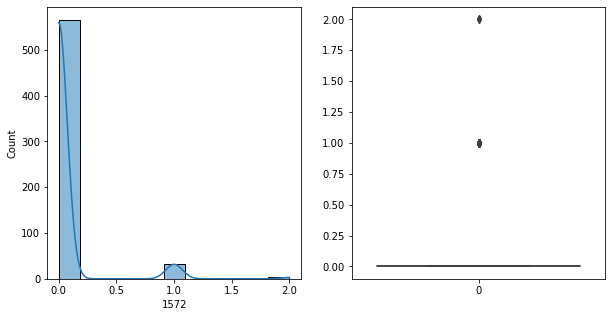

1572   Unique :  [0 1 2]
--------------------------------------------------------------------
1572   N unique :  3
--------------------------------------------------------------------
1572   Value Counts :  0    565
1     32
2      3
Name: 1572, dtype: int64
--------------------------------------------------------------------



[ 1573 ]
show_df_info :  1573


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


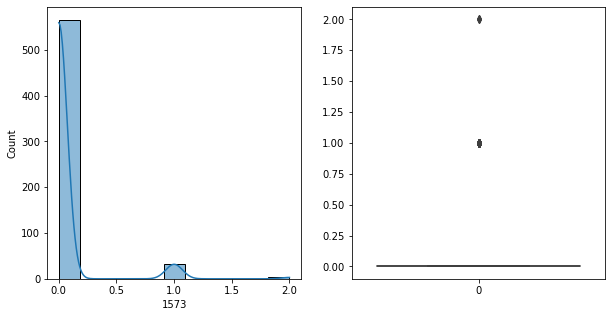

1573   Unique :  [0 1 2]
--------------------------------------------------------------------
1573   N unique :  3
--------------------------------------------------------------------
1573   Value Counts :  0    565
1     32
2      3
Name: 1573, dtype: int64
--------------------------------------------------------------------



[ 1574 ]
show_df_info :  1574


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


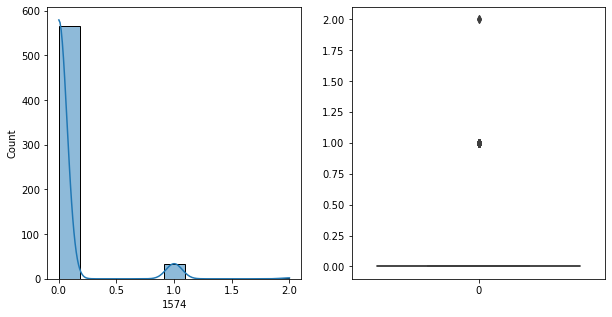

1574   Unique :  [0 1 2]
--------------------------------------------------------------------
1574   N unique :  3
--------------------------------------------------------------------
1574   Value Counts :  0    565
1     33
2      2
Name: 1574, dtype: int64
--------------------------------------------------------------------



[ 1575 ]
show_df_info :  1575


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


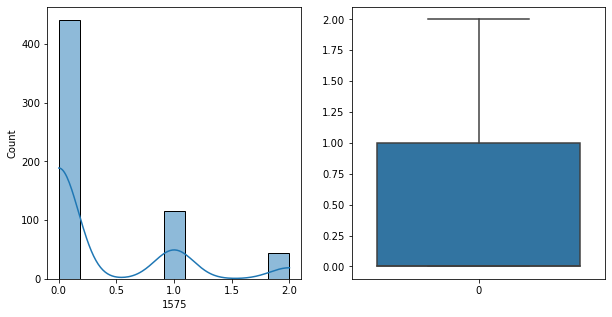

1575   Unique :  [1 0 2]
--------------------------------------------------------------------
1575   N unique :  3
--------------------------------------------------------------------
1575   Value Counts :  0    441
1    115
2     44
Name: 1575, dtype: int64
--------------------------------------------------------------------



[ 1576 ]
show_df_info :  1576


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


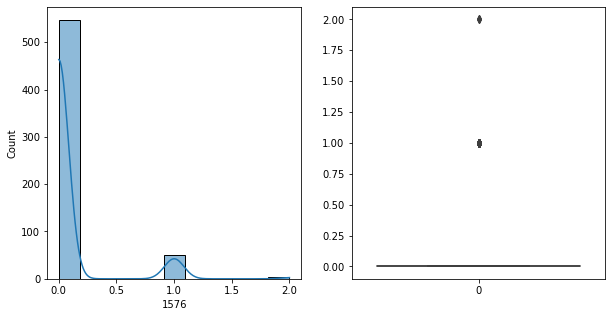

1576   Unique :  [0 1 2]
--------------------------------------------------------------------
1576   N unique :  3
--------------------------------------------------------------------
1576   Value Counts :  0    547
1     50
2      3
Name: 1576, dtype: int64
--------------------------------------------------------------------



[ 1577 ]
show_df_info :  1577


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


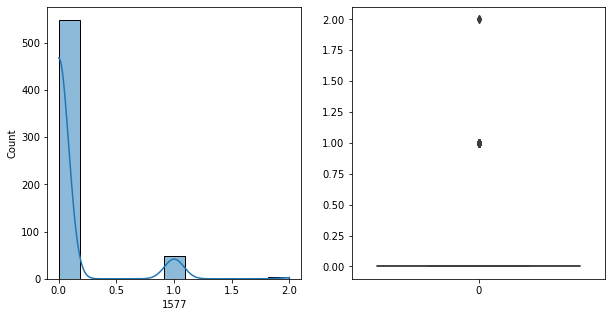

1577   Unique :  [0 1 2]
--------------------------------------------------------------------
1577   N unique :  3
--------------------------------------------------------------------
1577   Value Counts :  0    548
1     49
2      3
Name: 1577, dtype: int64
--------------------------------------------------------------------



[ 1578 ]
show_df_info :  1578


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


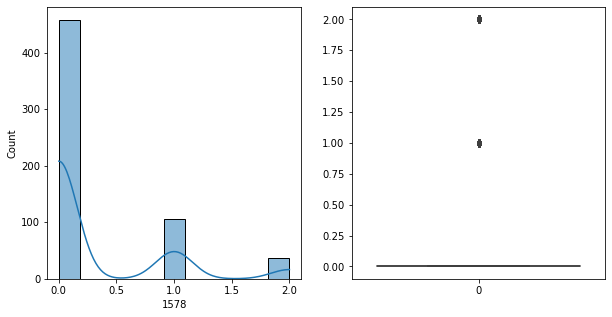

1578   Unique :  [1 0 2]
--------------------------------------------------------------------
1578   N unique :  3
--------------------------------------------------------------------
1578   Value Counts :  0    458
1    106
2     36
Name: 1578, dtype: int64
--------------------------------------------------------------------



[ 1579 ]
show_df_info :  1579


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


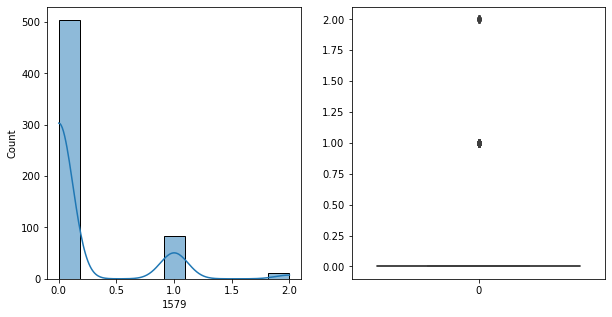

1579   Unique :  [1 0 2]
--------------------------------------------------------------------
1579   N unique :  3
--------------------------------------------------------------------
1579   Value Counts :  0    504
1     84
2     12
Name: 1579, dtype: int64
--------------------------------------------------------------------



[ 1580 ]
show_df_info :  1580


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


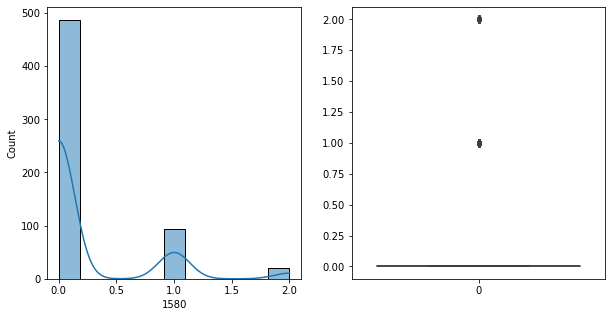

1580   Unique :  [1 0 2]
--------------------------------------------------------------------
1580   N unique :  3
--------------------------------------------------------------------
1580   Value Counts :  0    487
1     93
2     20
Name: 1580, dtype: int64
--------------------------------------------------------------------



[ 1581 ]
show_df_info :  1581


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


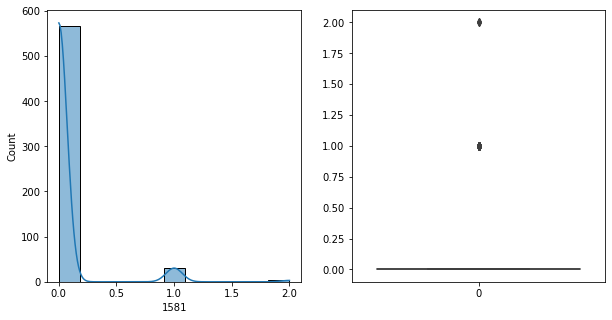

1581   Unique :  [0 1 2]
--------------------------------------------------------------------
1581   N unique :  3
--------------------------------------------------------------------
1581   Value Counts :  0    567
1     30
2      3
Name: 1581, dtype: int64
--------------------------------------------------------------------



[ 1582 ]
show_df_info :  1582


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


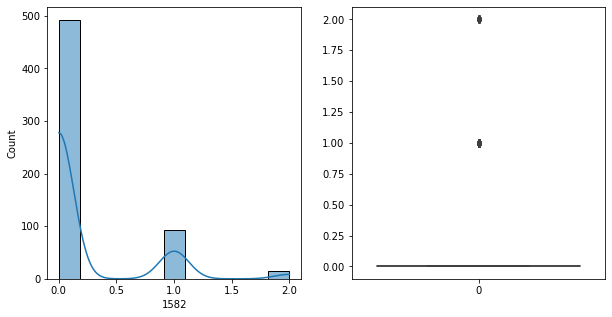

1582   Unique :  [1 0 2]
--------------------------------------------------------------------
1582   N unique :  3
--------------------------------------------------------------------
1582   Value Counts :  0    492
1     93
2     15
Name: 1582, dtype: int64
--------------------------------------------------------------------



[ 1583 ]
show_df_info :  1583


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


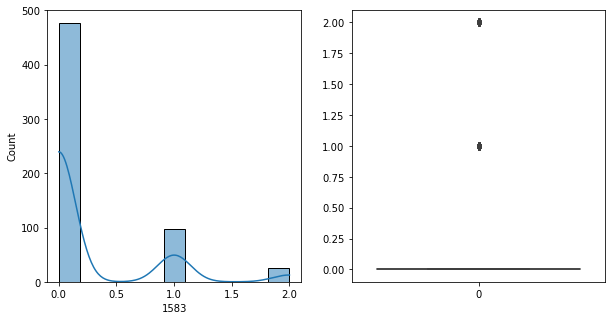

1583   Unique :  [1 0 2]
--------------------------------------------------------------------
1583   N unique :  3
--------------------------------------------------------------------
1583   Value Counts :  0    477
1     98
2     25
Name: 1583, dtype: int64
--------------------------------------------------------------------



[ 1584 ]
show_df_info :  1584


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


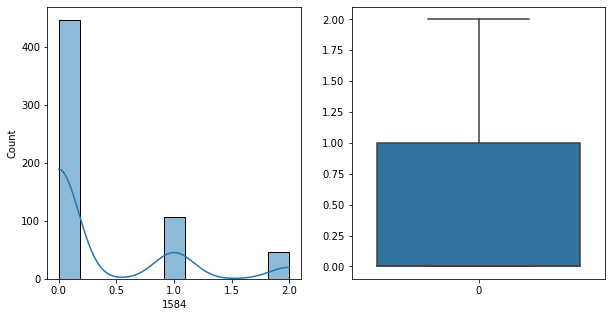

1584   Unique :  [1 0 2]
--------------------------------------------------------------------
1584   N unique :  3
--------------------------------------------------------------------
1584   Value Counts :  0    446
1    107
2     47
Name: 1584, dtype: int64
--------------------------------------------------------------------



[ 1585 ]
show_df_info :  1585


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


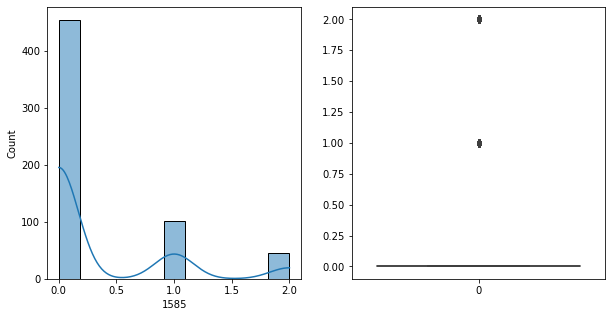

1585   Unique :  [1 0 2]
--------------------------------------------------------------------
1585   N unique :  3
--------------------------------------------------------------------
1585   Value Counts :  0    454
1    101
2     45
Name: 1585, dtype: int64
--------------------------------------------------------------------



[ 1586 ]
show_df_info :  1586


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


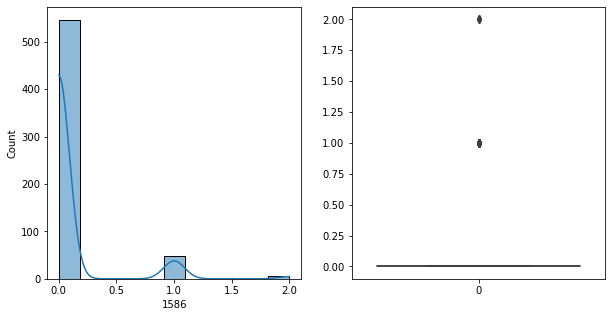

1586   Unique :  [0 2 1]
--------------------------------------------------------------------
1586   N unique :  3
--------------------------------------------------------------------
1586   Value Counts :  0    546
1     48
2      6
Name: 1586, dtype: int64
--------------------------------------------------------------------



[ 1587 ]
show_df_info :  1587


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


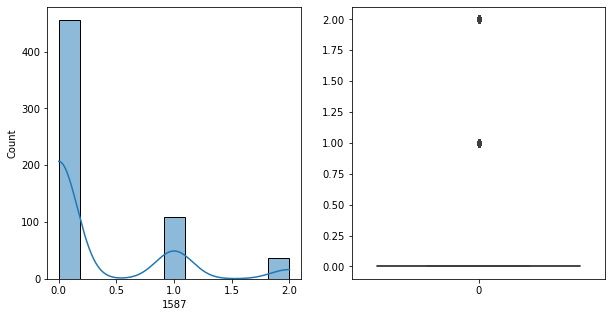

1587   Unique :  [1 0 2]
--------------------------------------------------------------------
1587   N unique :  3
--------------------------------------------------------------------
1587   Value Counts :  0    456
1    108
2     36
Name: 1587, dtype: int64
--------------------------------------------------------------------



[ 1588 ]
show_df_info :  1588


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


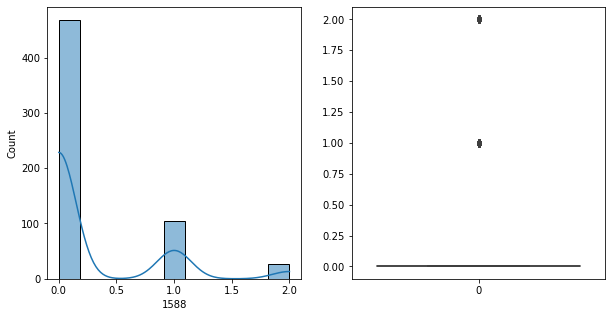

1588   Unique :  [0 2 1]
--------------------------------------------------------------------
1588   N unique :  3
--------------------------------------------------------------------
1588   Value Counts :  0    468
1    105
2     27
Name: 1588, dtype: int64
--------------------------------------------------------------------



[ 1589 ]
show_df_info :  1589


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


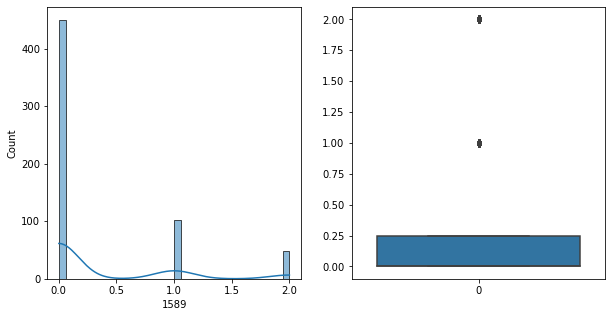

1589   Unique :  [0 2 1]
--------------------------------------------------------------------
1589   N unique :  3
--------------------------------------------------------------------
1589   Value Counts :  0    450
1    102
2     48
Name: 1589, dtype: int64
--------------------------------------------------------------------



[ 1590 ]
show_df_info :  1590


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


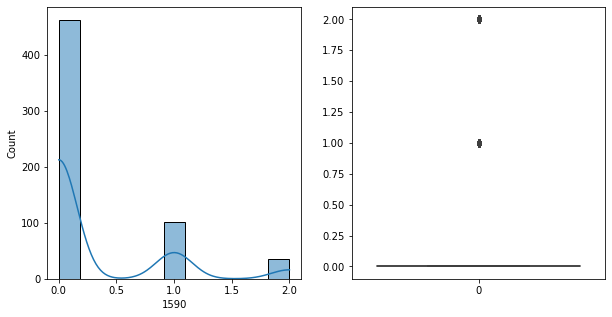

1590   Unique :  [0 2 1]
--------------------------------------------------------------------
1590   N unique :  3
--------------------------------------------------------------------
1590   Value Counts :  0    463
1    102
2     35
Name: 1590, dtype: int64
--------------------------------------------------------------------



[ 1591 ]
show_df_info :  1591


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


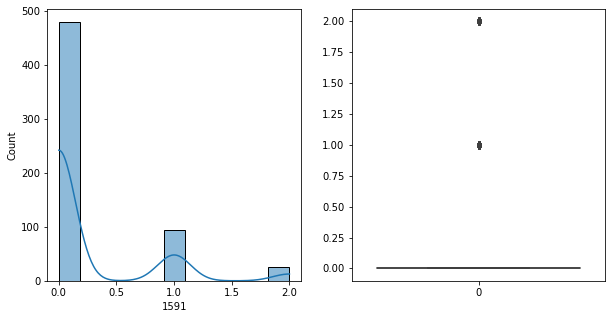

1591   Unique :  [0 2 1]
--------------------------------------------------------------------
1591   N unique :  3
--------------------------------------------------------------------
1591   Value Counts :  0    480
1     95
2     25
Name: 1591, dtype: int64
--------------------------------------------------------------------



[ 1592 ]
show_df_info :  1592


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


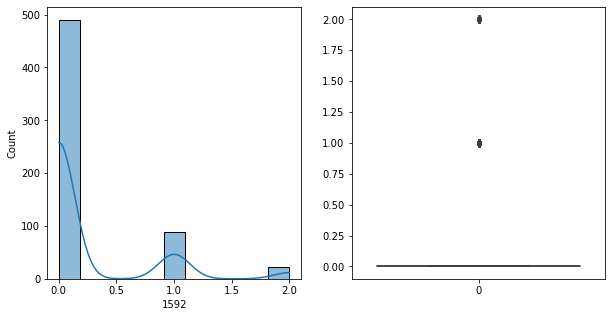

1592   Unique :  [0 2 1]
--------------------------------------------------------------------
1592   N unique :  3
--------------------------------------------------------------------
1592   Value Counts :  0    490
1     88
2     22
Name: 1592, dtype: int64
--------------------------------------------------------------------



[ 1593 ]
show_df_info :  1593


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


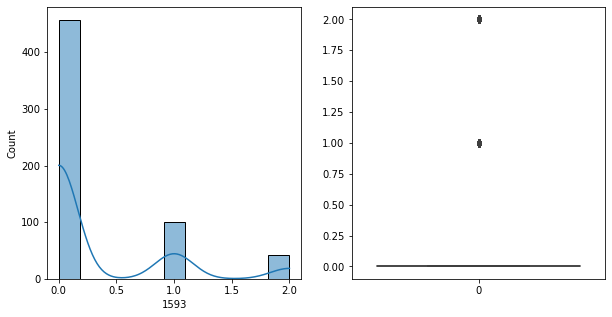

1593   Unique :  [0 2 1]
--------------------------------------------------------------------
1593   N unique :  3
--------------------------------------------------------------------
1593   Value Counts :  0    457
1    101
2     42
Name: 1593, dtype: int64
--------------------------------------------------------------------



[ 1594 ]
show_df_info :  1594


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


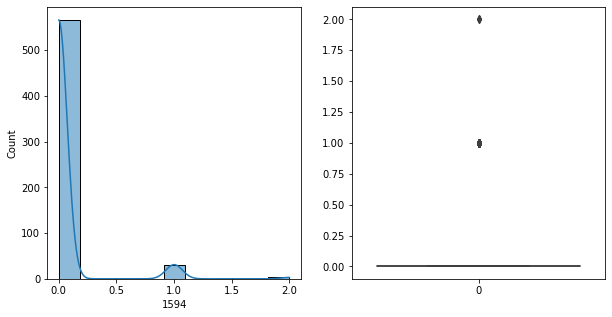

1594   Unique :  [0 1 2]
--------------------------------------------------------------------
1594   N unique :  3
--------------------------------------------------------------------
1594   Value Counts :  0    566
1     31
2      3
Name: 1594, dtype: int64
--------------------------------------------------------------------



[ 1595 ]
show_df_info :  1595


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


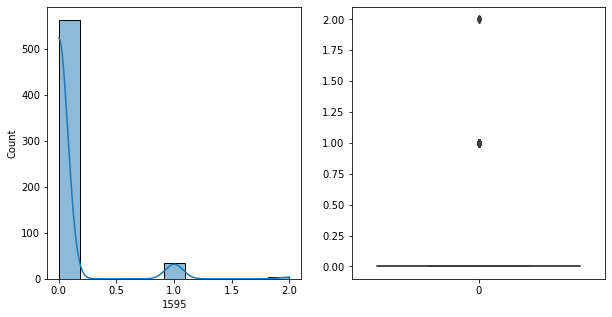

1595   Unique :  [0 1 2]
--------------------------------------------------------------------
1595   N unique :  3
--------------------------------------------------------------------
1595   Value Counts :  0    562
1     34
2      4
Name: 1595, dtype: int64
--------------------------------------------------------------------



[ 1596 ]
show_df_info :  1596


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


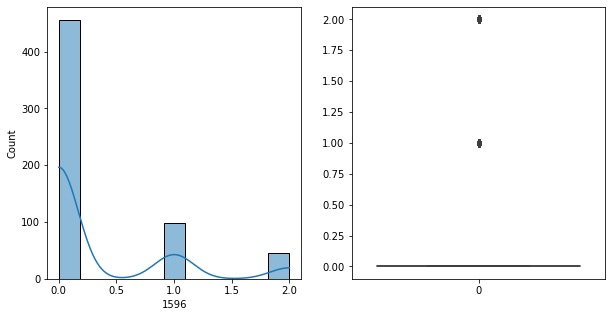

1596   Unique :  [0 2 1]
--------------------------------------------------------------------
1596   N unique :  3
--------------------------------------------------------------------
1596   Value Counts :  0    456
1     99
2     45
Name: 1596, dtype: int64
--------------------------------------------------------------------



[ 1597 ]
show_df_info :  1597


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


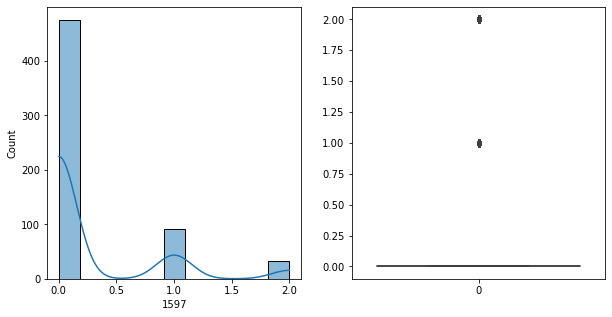

1597   Unique :  [0 2 1]
--------------------------------------------------------------------
1597   N unique :  3
--------------------------------------------------------------------
1597   Value Counts :  0    475
1     92
2     33
Name: 1597, dtype: int64
--------------------------------------------------------------------



[ 1598 ]
show_df_info :  1598


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


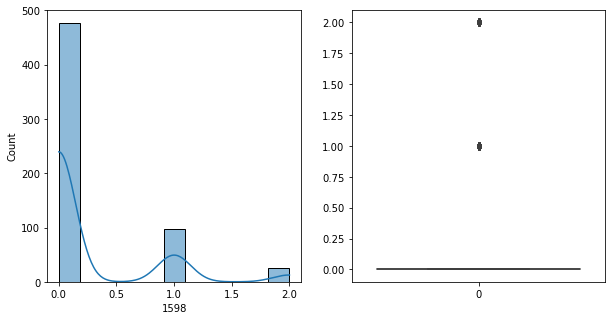

1598   Unique :  [0 2 1]
--------------------------------------------------------------------
1598   N unique :  3
--------------------------------------------------------------------
1598   Value Counts :  0    477
1     98
2     25
Name: 1598, dtype: int64
--------------------------------------------------------------------



[ 1599 ]
show_df_info :  1599


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


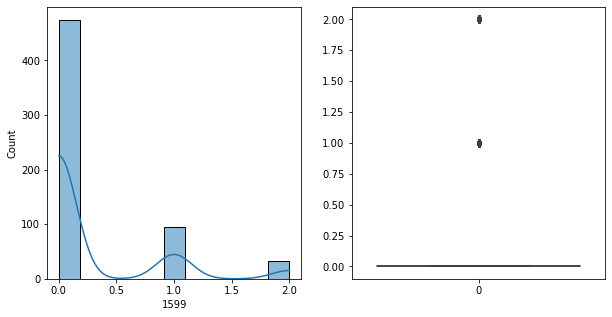

1599   Unique :  [0 2 1]
--------------------------------------------------------------------
1599   N unique :  3
--------------------------------------------------------------------
1599   Value Counts :  0    474
1     94
2     32
Name: 1599, dtype: int64
--------------------------------------------------------------------



[ 1600 ]
show_df_info :  1600


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


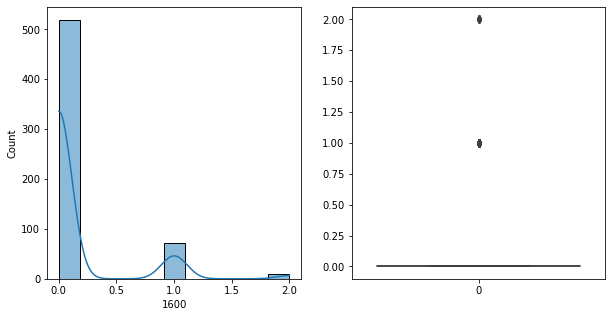

1600   Unique :  [1 0 2]
--------------------------------------------------------------------
1600   N unique :  3
--------------------------------------------------------------------
1600   Value Counts :  0    519
1     71
2     10
Name: 1600, dtype: int64
--------------------------------------------------------------------



[ 1601 ]
show_df_info :  1601


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


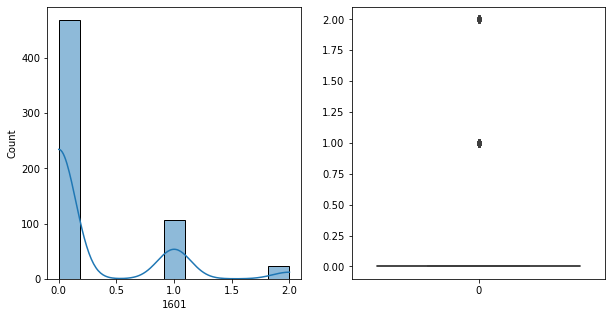

1601   Unique :  [0 1 2]
--------------------------------------------------------------------
1601   N unique :  3
--------------------------------------------------------------------
1601   Value Counts :  0    469
1    107
2     24
Name: 1601, dtype: int64
--------------------------------------------------------------------



[ 1602 ]
show_df_info :  1602


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


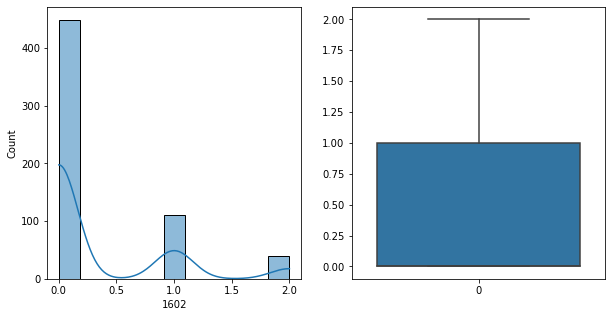

1602   Unique :  [2 0 1]
--------------------------------------------------------------------
1602   N unique :  3
--------------------------------------------------------------------
1602   Value Counts :  0    449
1    111
2     40
Name: 1602, dtype: int64
--------------------------------------------------------------------



[ 1603 ]
show_df_info :  1603


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


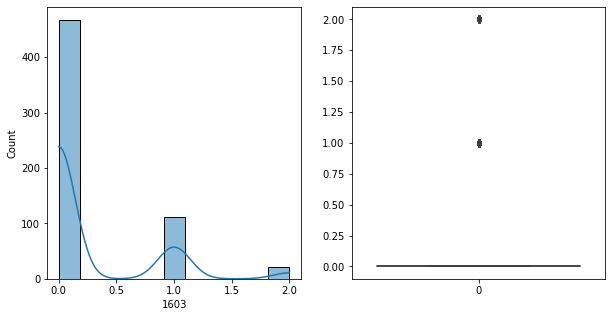

1603   Unique :  [2 0 1]
--------------------------------------------------------------------
1603   N unique :  3
--------------------------------------------------------------------
1603   Value Counts :  0    467
1    112
2     21
Name: 1603, dtype: int64
--------------------------------------------------------------------



[ 1604 ]
show_df_info :  1604


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


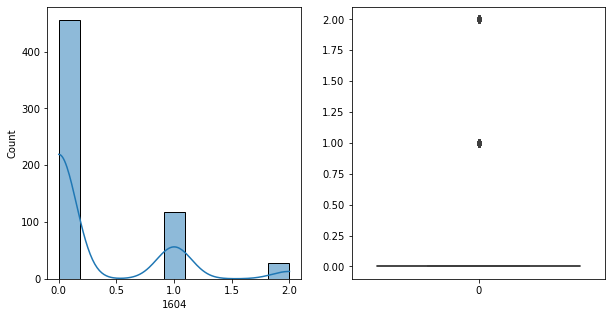

1604   Unique :  [0 1 2]
--------------------------------------------------------------------
1604   N unique :  3
--------------------------------------------------------------------
1604   Value Counts :  0    456
1    117
2     27
Name: 1604, dtype: int64
--------------------------------------------------------------------



[ 1605 ]
show_df_info :  1605


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


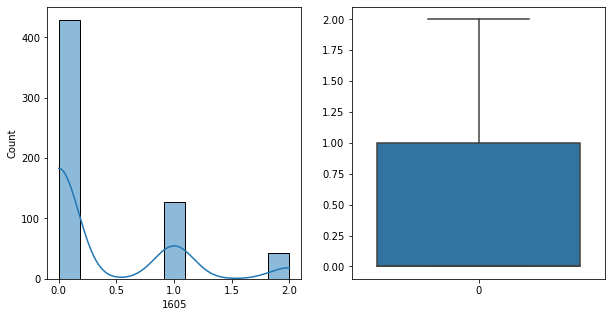

1605   Unique :  [0 1 2]
--------------------------------------------------------------------
1605   N unique :  3
--------------------------------------------------------------------
1605   Value Counts :  0    429
1    128
2     43
Name: 1605, dtype: int64
--------------------------------------------------------------------



[ 1606 ]
show_df_info :  1606


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


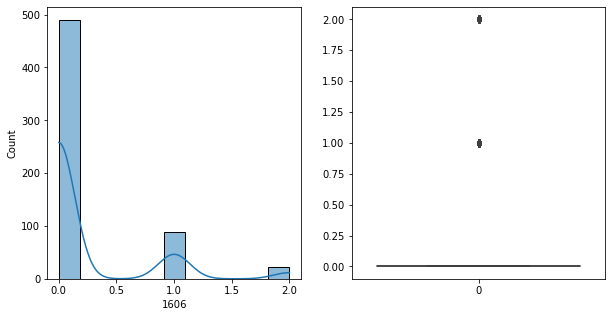

1606   Unique :  [0 1 2]
--------------------------------------------------------------------
1606   N unique :  3
--------------------------------------------------------------------
1606   Value Counts :  0    490
1     88
2     22
Name: 1606, dtype: int64
--------------------------------------------------------------------



[ 1607 ]
show_df_info :  1607


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


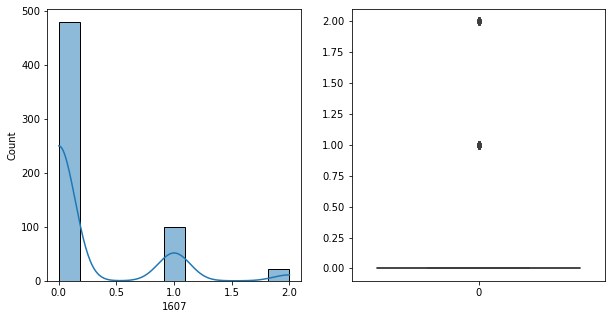

1607   Unique :  [0 1 2]
--------------------------------------------------------------------
1607   N unique :  3
--------------------------------------------------------------------
1607   Value Counts :  0    480
1     99
2     21
Name: 1607, dtype: int64
--------------------------------------------------------------------



[ 1608 ]
show_df_info :  1608


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


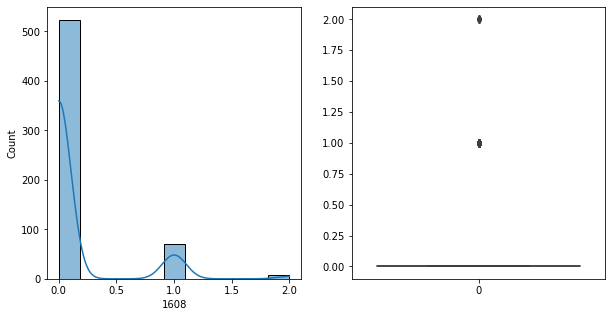

1608   Unique :  [0 2 1]
--------------------------------------------------------------------
1608   N unique :  3
--------------------------------------------------------------------
1608   Value Counts :  0    523
1     70
2      7
Name: 1608, dtype: int64
--------------------------------------------------------------------



[ 1609 ]
show_df_info :  1609


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


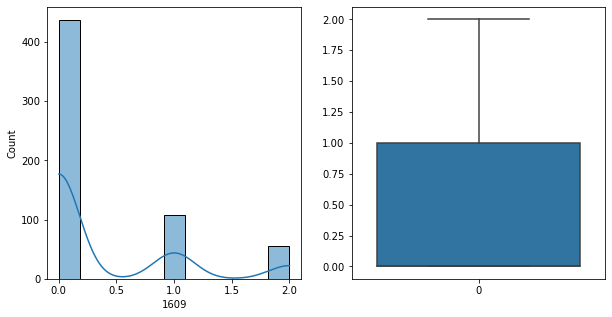

1609   Unique :  [0 2 1]
--------------------------------------------------------------------
1609   N unique :  3
--------------------------------------------------------------------
1609   Value Counts :  0    437
1    108
2     55
Name: 1609, dtype: int64
--------------------------------------------------------------------



[ 1610 ]
show_df_info :  1610


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


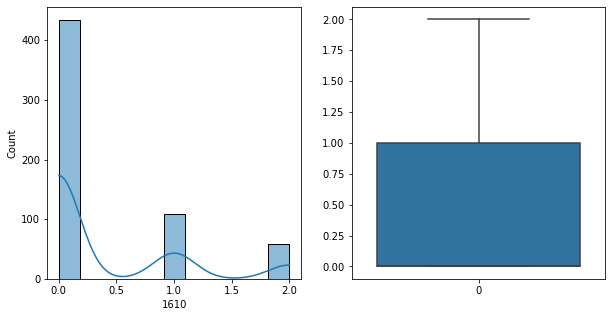

1610   Unique :  [0 2 1]
--------------------------------------------------------------------
1610   N unique :  3
--------------------------------------------------------------------
1610   Value Counts :  0    434
1    108
2     58
Name: 1610, dtype: int64
--------------------------------------------------------------------



[ 1611 ]
show_df_info :  1611


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


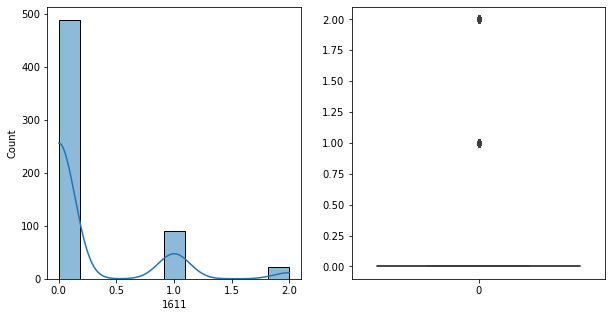

1611   Unique :  [0 1 2]
--------------------------------------------------------------------
1611   N unique :  3
--------------------------------------------------------------------
1611   Value Counts :  0    488
1     90
2     22
Name: 1611, dtype: int64
--------------------------------------------------------------------



[ 1612 ]
show_df_info :  1612


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


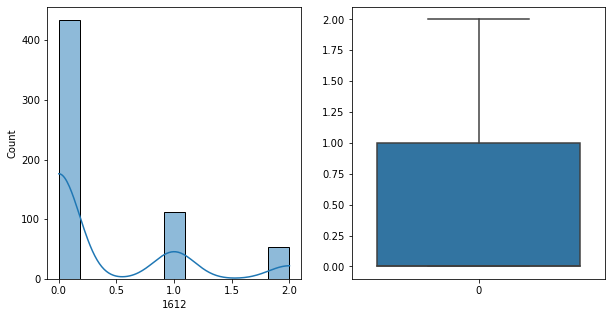

1612   Unique :  [1 0 2]
--------------------------------------------------------------------
1612   N unique :  3
--------------------------------------------------------------------
1612   Value Counts :  0    434
1    112
2     54
Name: 1612, dtype: int64
--------------------------------------------------------------------



[ 1613 ]
show_df_info :  1613


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


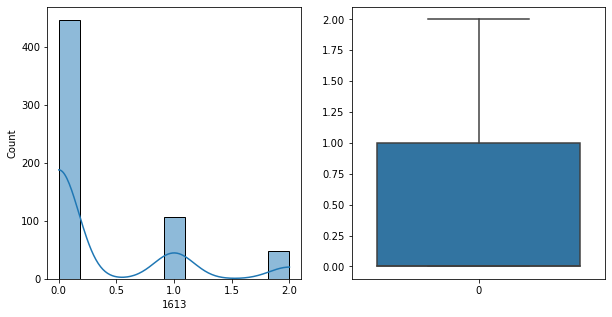

1613   Unique :  [1 0 2]
--------------------------------------------------------------------
1613   N unique :  3
--------------------------------------------------------------------
1613   Value Counts :  0    446
1    106
2     48
Name: 1613, dtype: int64
--------------------------------------------------------------------



[ 1614 ]
show_df_info :  1614


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


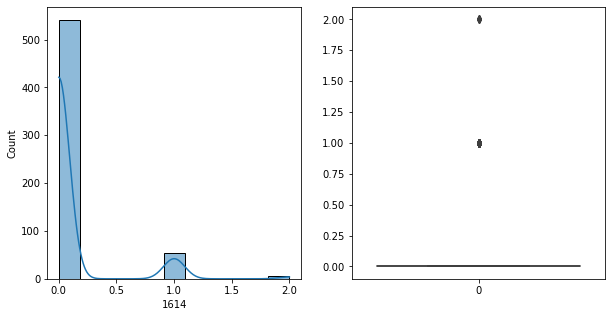

1614   Unique :  [1 0 2]
--------------------------------------------------------------------
1614   N unique :  3
--------------------------------------------------------------------
1614   Value Counts :  0    541
1     54
2      5
Name: 1614, dtype: int64
--------------------------------------------------------------------



[ 1615 ]
show_df_info :  1615


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


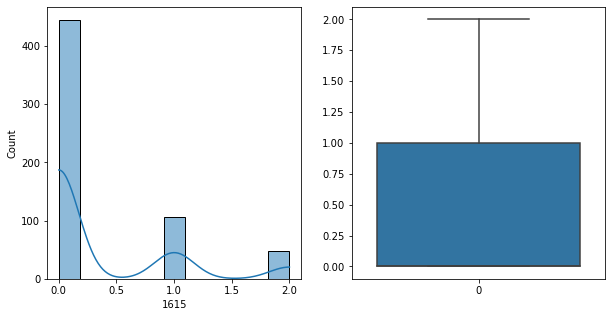

1615   Unique :  [1 0 2]
--------------------------------------------------------------------
1615   N unique :  3
--------------------------------------------------------------------
1615   Value Counts :  0    445
1    107
2     48
Name: 1615, dtype: int64
--------------------------------------------------------------------



[ 1616 ]
show_df_info :  1616


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


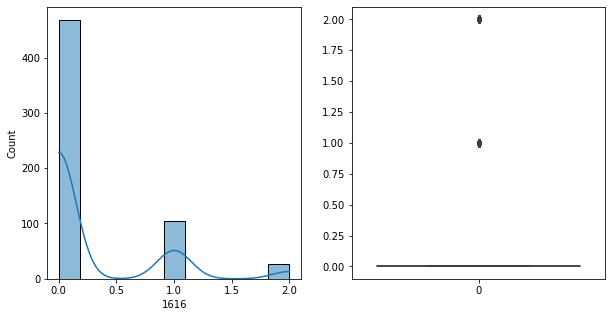

1616   Unique :  [0 1 2]
--------------------------------------------------------------------
1616   N unique :  3
--------------------------------------------------------------------
1616   Value Counts :  0    468
1    105
2     27
Name: 1616, dtype: int64
--------------------------------------------------------------------



[ 1617 ]
show_df_info :  1617


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


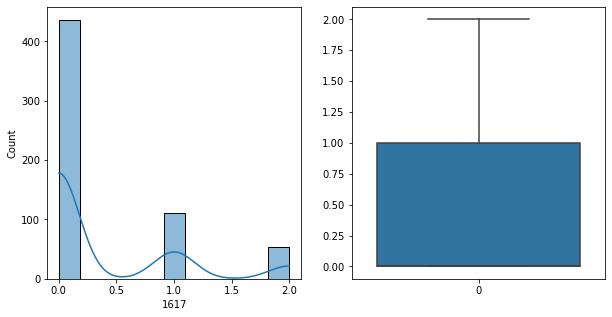

1617   Unique :  [2 0 1]
--------------------------------------------------------------------
1617   N unique :  3
--------------------------------------------------------------------
1617   Value Counts :  0    436
1    111
2     53
Name: 1617, dtype: int64
--------------------------------------------------------------------



[ 1618 ]
show_df_info :  1618


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


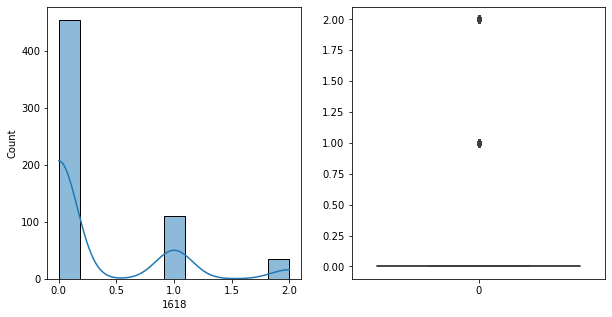

1618   Unique :  [0 1 2]
--------------------------------------------------------------------
1618   N unique :  3
--------------------------------------------------------------------
1618   Value Counts :  0    455
1    110
2     35
Name: 1618, dtype: int64
--------------------------------------------------------------------



[ 1619 ]
show_df_info :  1619


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


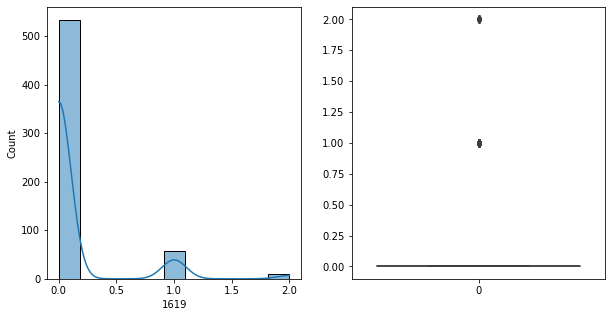

1619   Unique :  [1 0 2]
--------------------------------------------------------------------
1619   N unique :  3
--------------------------------------------------------------------
1619   Value Counts :  0    533
1     57
2     10
Name: 1619, dtype: int64
--------------------------------------------------------------------



[ 1620 ]
show_df_info :  1620


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


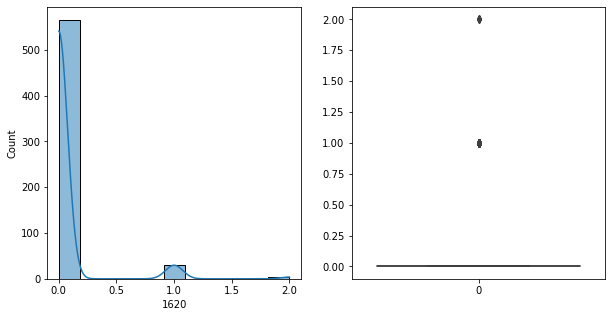

1620   Unique :  [0 1 2]
--------------------------------------------------------------------
1620   N unique :  3
--------------------------------------------------------------------
1620   Value Counts :  0    565
1     31
2      4
Name: 1620, dtype: int64
--------------------------------------------------------------------



[ 1621 ]
show_df_info :  1621


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


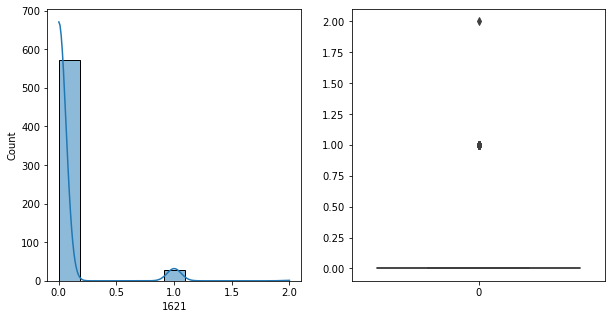

1621   Unique :  [1 0 2]
--------------------------------------------------------------------
1621   N unique :  3
--------------------------------------------------------------------
1621   Value Counts :  0    572
1     27
2      1
Name: 1621, dtype: int64
--------------------------------------------------------------------



[ 1622 ]
show_df_info :  1622


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


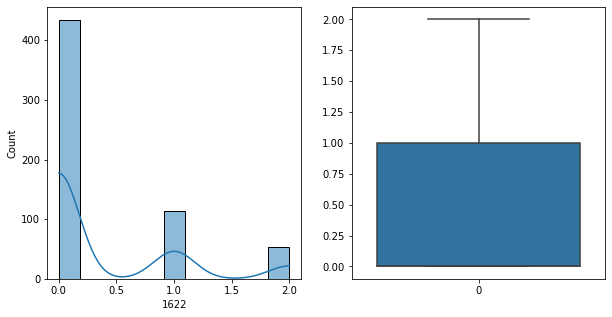

1622   Unique :  [2 0 1]
--------------------------------------------------------------------
1622   N unique :  3
--------------------------------------------------------------------
1622   Value Counts :  0    434
1    113
2     53
Name: 1622, dtype: int64
--------------------------------------------------------------------



[ 1623 ]
show_df_info :  1623


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


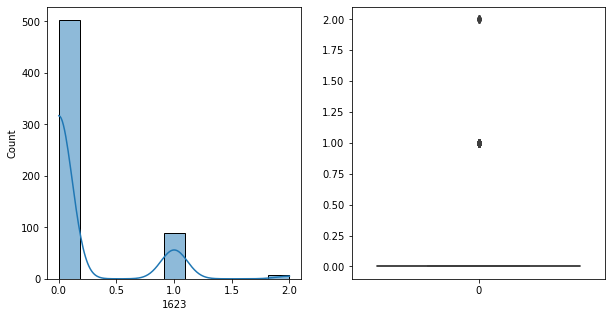

1623   Unique :  [0 1 2]
--------------------------------------------------------------------
1623   N unique :  3
--------------------------------------------------------------------
1623   Value Counts :  0    503
1     89
2      8
Name: 1623, dtype: int64
--------------------------------------------------------------------



[ 1624 ]
show_df_info :  1624


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


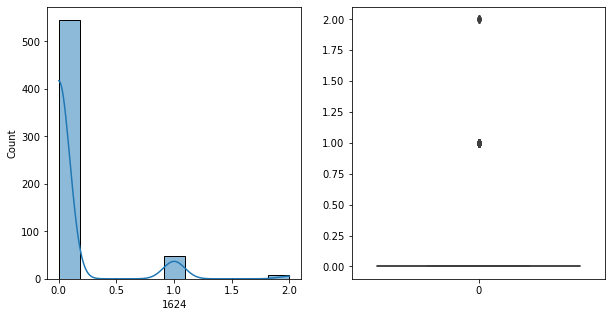

1624   Unique :  [0 1 2]
--------------------------------------------------------------------
1624   N unique :  3
--------------------------------------------------------------------
1624   Value Counts :  0    545
1     48
2      7
Name: 1624, dtype: int64
--------------------------------------------------------------------



[ 1625 ]
show_df_info :  1625


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


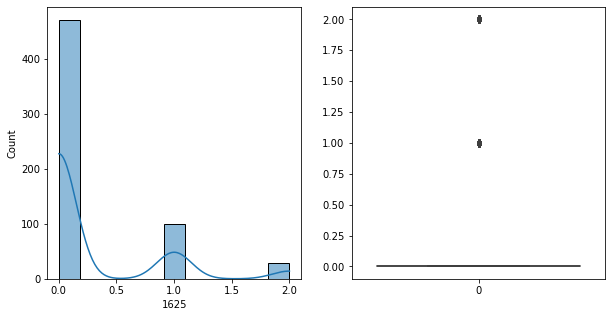

1625   Unique :  [1 0 2]
--------------------------------------------------------------------
1625   N unique :  3
--------------------------------------------------------------------
1625   Value Counts :  0    471
1    100
2     29
Name: 1625, dtype: int64
--------------------------------------------------------------------



[ 1626 ]
show_df_info :  1626


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


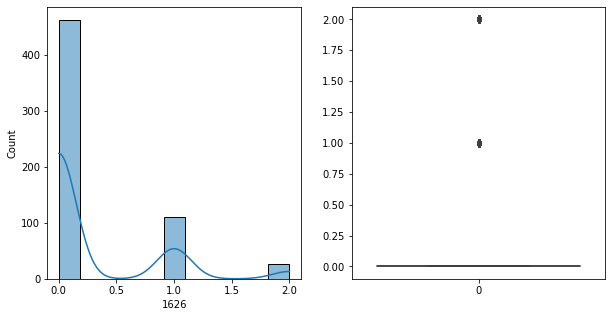

1626   Unique :  [1 0 2]
--------------------------------------------------------------------
1626   N unique :  3
--------------------------------------------------------------------
1626   Value Counts :  0    462
1    111
2     27
Name: 1626, dtype: int64
--------------------------------------------------------------------



[ 1627 ]
show_df_info :  1627


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


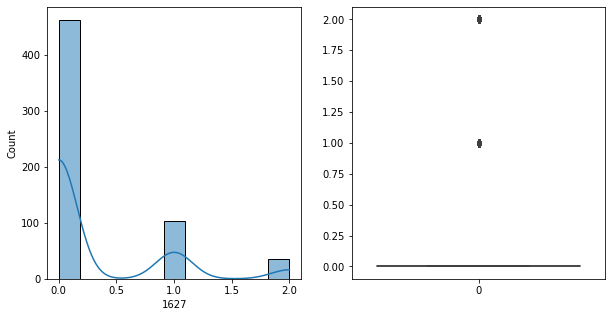

1627   Unique :  [1 0 2]
--------------------------------------------------------------------
1627   N unique :  3
--------------------------------------------------------------------
1627   Value Counts :  0    462
1    103
2     35
Name: 1627, dtype: int64
--------------------------------------------------------------------



[ 1628 ]
show_df_info :  1628


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


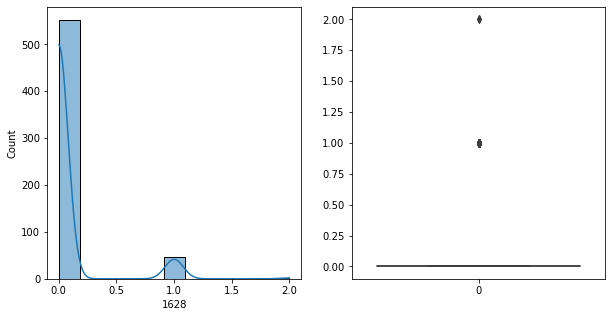

1628   Unique :  [0 1 2]
--------------------------------------------------------------------
1628   N unique :  3
--------------------------------------------------------------------
1628   Value Counts :  0    552
1     46
2      2
Name: 1628, dtype: int64
--------------------------------------------------------------------



[ 1629 ]
show_df_info :  1629


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


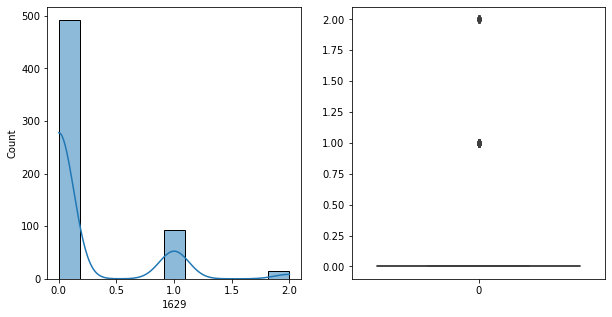

1629   Unique :  [1 0 2]
--------------------------------------------------------------------
1629   N unique :  3
--------------------------------------------------------------------
1629   Value Counts :  0    492
1     93
2     15
Name: 1629, dtype: int64
--------------------------------------------------------------------



[ 1630 ]
show_df_info :  1630


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


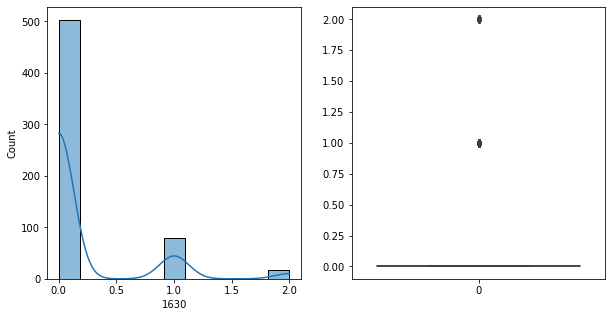

1630   Unique :  [0 1 2]
--------------------------------------------------------------------
1630   N unique :  3
--------------------------------------------------------------------
1630   Value Counts :  0    503
1     79
2     18
Name: 1630, dtype: int64
--------------------------------------------------------------------



[ 1631 ]
show_df_info :  1631


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


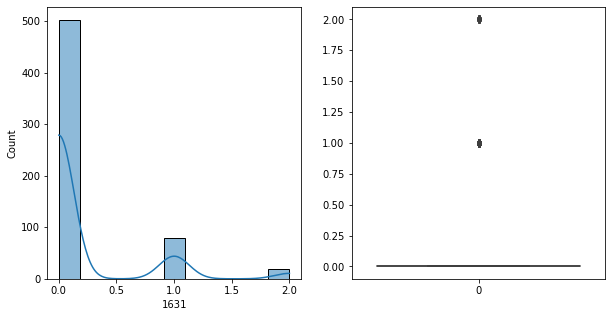

1631   Unique :  [0 1 2]
--------------------------------------------------------------------
1631   N unique :  3
--------------------------------------------------------------------
1631   Value Counts :  0    502
1     79
2     19
Name: 1631, dtype: int64
--------------------------------------------------------------------



[ 1632 ]
show_df_info :  1632


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


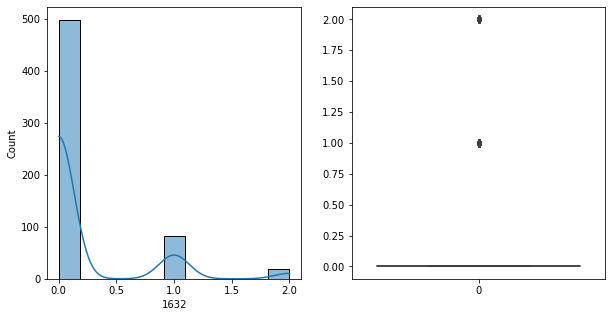

1632   Unique :  [0 1 2]
--------------------------------------------------------------------
1632   N unique :  3
--------------------------------------------------------------------
1632   Value Counts :  0    498
1     83
2     19
Name: 1632, dtype: int64
--------------------------------------------------------------------



[ 1633 ]
show_df_info :  1633


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


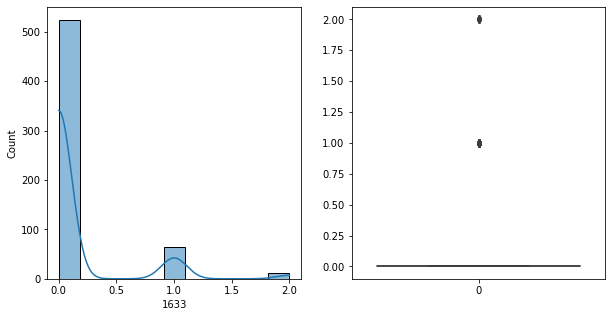

1633   Unique :  [0 2 1]
--------------------------------------------------------------------
1633   N unique :  3
--------------------------------------------------------------------
1633   Value Counts :  0    524
1     65
2     11
Name: 1633, dtype: int64
--------------------------------------------------------------------



[ 1634 ]
show_df_info :  1634


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


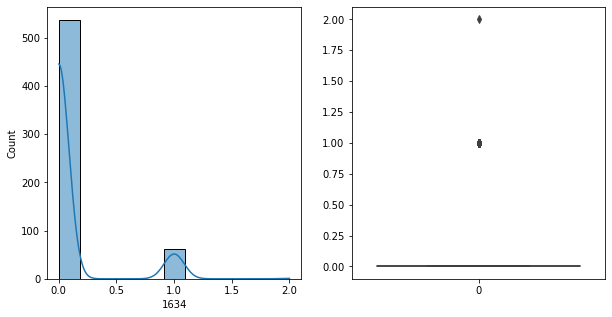

1634   Unique :  [1 0 2]
--------------------------------------------------------------------
1634   N unique :  3
--------------------------------------------------------------------
1634   Value Counts :  0    537
1     62
2      1
Name: 1634, dtype: int64
--------------------------------------------------------------------



[ 1635 ]
show_df_info :  1635


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


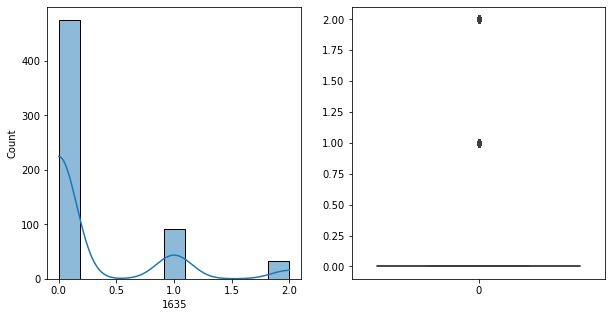

1635   Unique :  [1 0 2]
--------------------------------------------------------------------
1635   N unique :  3
--------------------------------------------------------------------
1635   Value Counts :  0    475
1     92
2     33
Name: 1635, dtype: int64
--------------------------------------------------------------------



[ 1636 ]
show_df_info :  1636


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


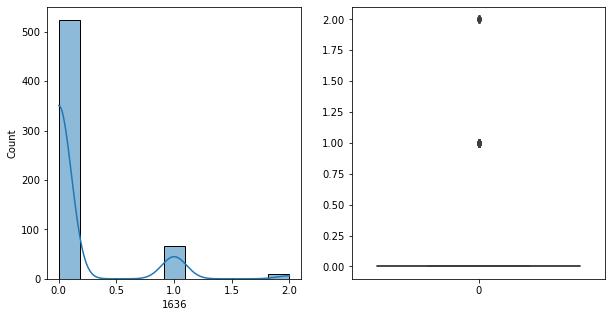

1636   Unique :  [0 2 1]
--------------------------------------------------------------------
1636   N unique :  3
--------------------------------------------------------------------
1636   Value Counts :  0    524
1     67
2      9
Name: 1636, dtype: int64
--------------------------------------------------------------------



[ 1637 ]
show_df_info :  1637


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


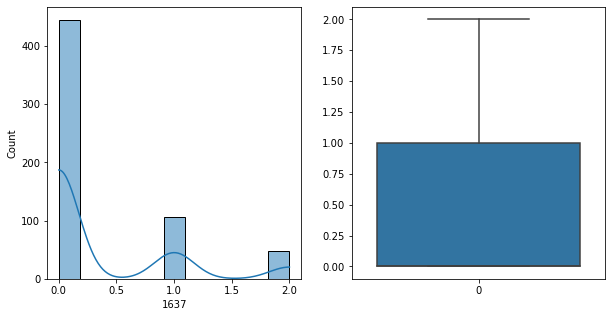

1637   Unique :  [1 0 2]
--------------------------------------------------------------------
1637   N unique :  3
--------------------------------------------------------------------
1637   Value Counts :  0    445
1    107
2     48
Name: 1637, dtype: int64
--------------------------------------------------------------------



[ 1638 ]
show_df_info :  1638


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


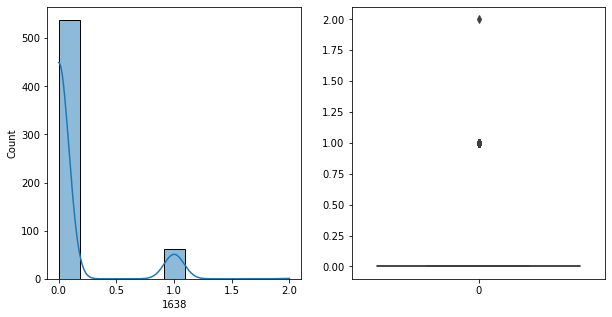

1638   Unique :  [1 0 2]
--------------------------------------------------------------------
1638   N unique :  3
--------------------------------------------------------------------
1638   Value Counts :  0    538
1     61
2      1
Name: 1638, dtype: int64
--------------------------------------------------------------------



[ 1639 ]
show_df_info :  1639


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


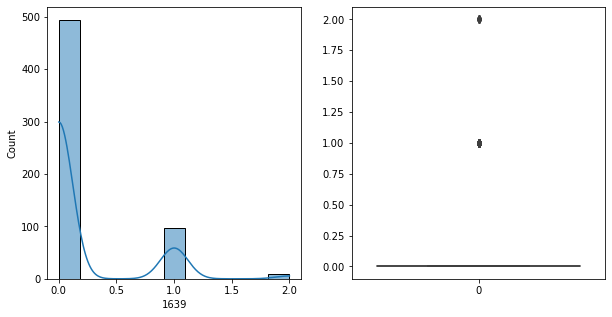

1639   Unique :  [1 0 2]
--------------------------------------------------------------------
1639   N unique :  3
--------------------------------------------------------------------
1639   Value Counts :  0    494
1     97
2      9
Name: 1639, dtype: int64
--------------------------------------------------------------------



[ 1640 ]
show_df_info :  1640


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


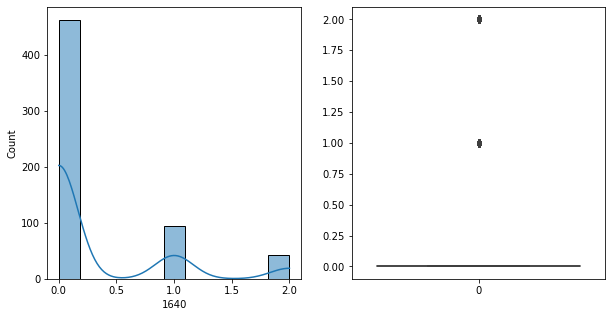

1640   Unique :  [0 1 2]
--------------------------------------------------------------------
1640   N unique :  3
--------------------------------------------------------------------
1640   Value Counts :  0    462
1     95
2     43
Name: 1640, dtype: int64
--------------------------------------------------------------------



[ 1641 ]
show_df_info :  1641


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


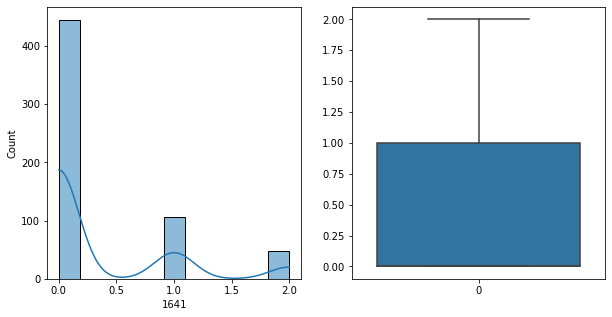

1641   Unique :  [0 1 2]
--------------------------------------------------------------------
1641   N unique :  3
--------------------------------------------------------------------
1641   Value Counts :  0    445
1    107
2     48
Name: 1641, dtype: int64
--------------------------------------------------------------------



[ 1642 ]
show_df_info :  1642


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


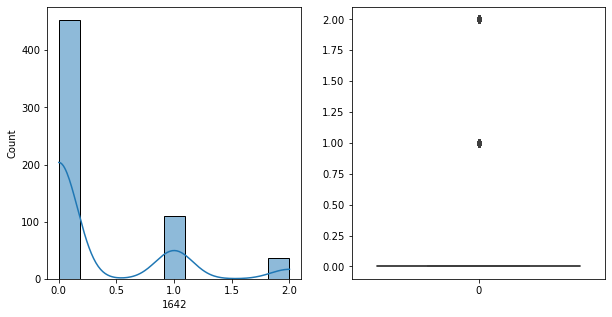

1642   Unique :  [1 0 2]
--------------------------------------------------------------------
1642   N unique :  3
--------------------------------------------------------------------
1642   Value Counts :  0    453
1    110
2     37
Name: 1642, dtype: int64
--------------------------------------------------------------------



[ 1643 ]
show_df_info :  1643


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


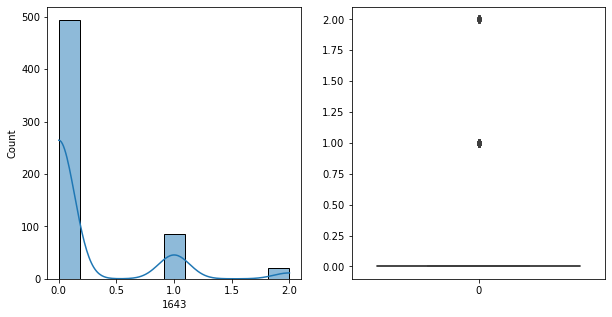

1643   Unique :  [1 0 2]
--------------------------------------------------------------------
1643   N unique :  3
--------------------------------------------------------------------
1643   Value Counts :  0    494
1     85
2     21
Name: 1643, dtype: int64
--------------------------------------------------------------------



[ 1644 ]
show_df_info :  1644


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


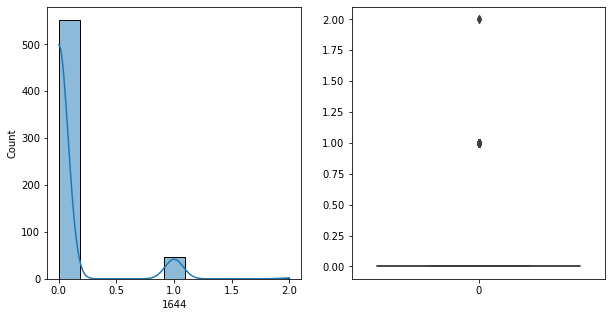

1644   Unique :  [1 0 2]
--------------------------------------------------------------------
1644   N unique :  3
--------------------------------------------------------------------
1644   Value Counts :  0    552
1     46
2      2
Name: 1644, dtype: int64
--------------------------------------------------------------------



[ 1645 ]
show_df_info :  1645


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


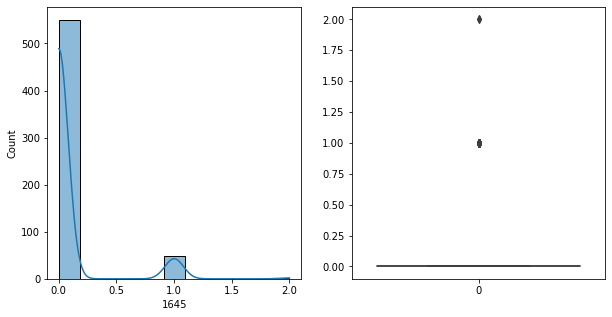

1645   Unique :  [1 0 2]
--------------------------------------------------------------------
1645   N unique :  3
--------------------------------------------------------------------
1645   Value Counts :  0    550
1     48
2      2
Name: 1645, dtype: int64
--------------------------------------------------------------------



[ 1646 ]
show_df_info :  1646


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


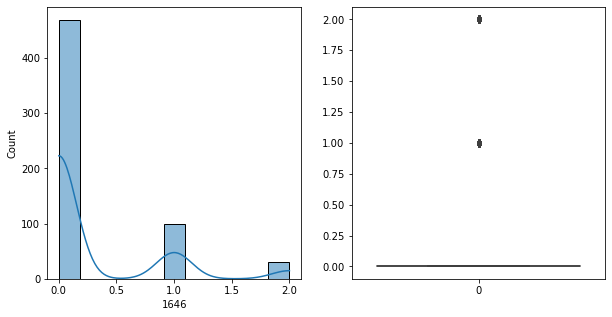

1646   Unique :  [0 1 2]
--------------------------------------------------------------------
1646   N unique :  3
--------------------------------------------------------------------
1646   Value Counts :  0    469
1    100
2     31
Name: 1646, dtype: int64
--------------------------------------------------------------------



[ 1647 ]
show_df_info :  1647


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


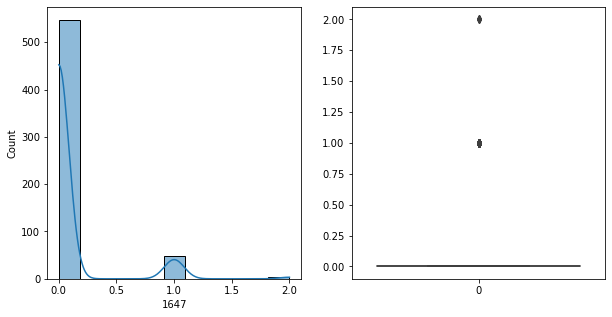

1647   Unique :  [0 1 2]
--------------------------------------------------------------------
1647   N unique :  3
--------------------------------------------------------------------
1647   Value Counts :  0    547
1     49
2      4
Name: 1647, dtype: int64
--------------------------------------------------------------------



[ 1648 ]
show_df_info :  1648


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


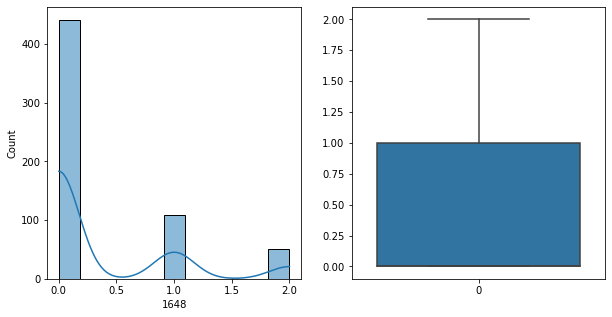

1648   Unique :  [2 0 1]
--------------------------------------------------------------------
1648   N unique :  3
--------------------------------------------------------------------
1648   Value Counts :  0    441
1    109
2     50
Name: 1648, dtype: int64
--------------------------------------------------------------------



[ 1649 ]
show_df_info :  1649


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


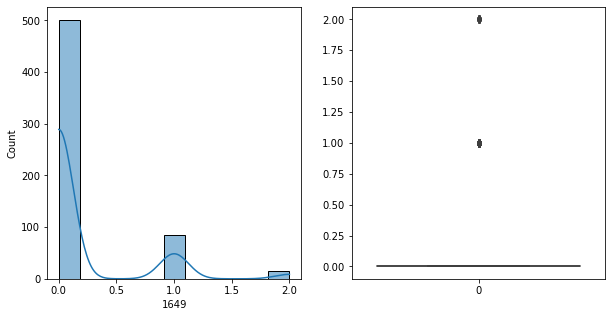

1649   Unique :  [0 1 2]
--------------------------------------------------------------------
1649   N unique :  3
--------------------------------------------------------------------
1649   Value Counts :  0    501
1     84
2     15
Name: 1649, dtype: int64
--------------------------------------------------------------------



[ 1650 ]
show_df_info :  1650


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


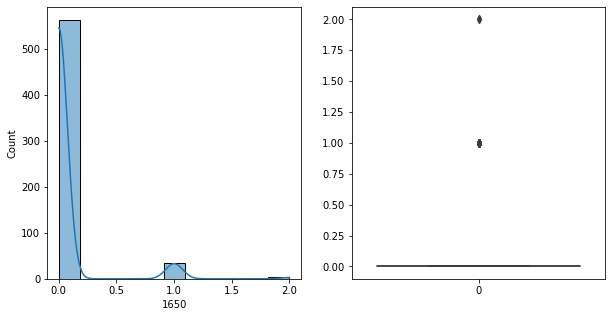

1650   Unique :  [1 0 2]
--------------------------------------------------------------------
1650   N unique :  3
--------------------------------------------------------------------
1650   Value Counts :  0    563
1     34
2      3
Name: 1650, dtype: int64
--------------------------------------------------------------------



[ 1651 ]
show_df_info :  1651


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


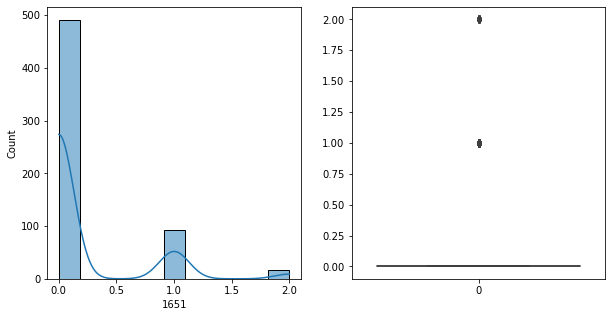

1651   Unique :  [1 0 2]
--------------------------------------------------------------------
1651   N unique :  3
--------------------------------------------------------------------
1651   Value Counts :  0    491
1     93
2     16
Name: 1651, dtype: int64
--------------------------------------------------------------------



[ 1652 ]
show_df_info :  1652


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


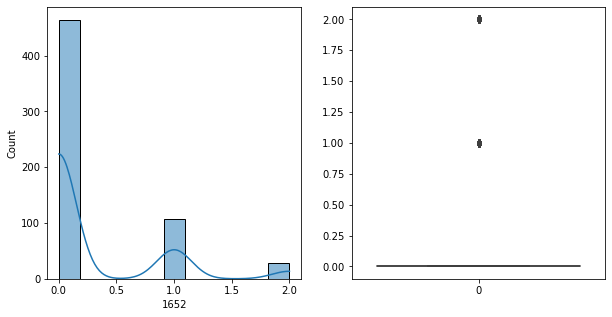

1652   Unique :  [0 1 2]
--------------------------------------------------------------------
1652   N unique :  3
--------------------------------------------------------------------
1652   Value Counts :  0    464
1    108
2     28
Name: 1652, dtype: int64
--------------------------------------------------------------------



[ 1653 ]
show_df_info :  1653


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


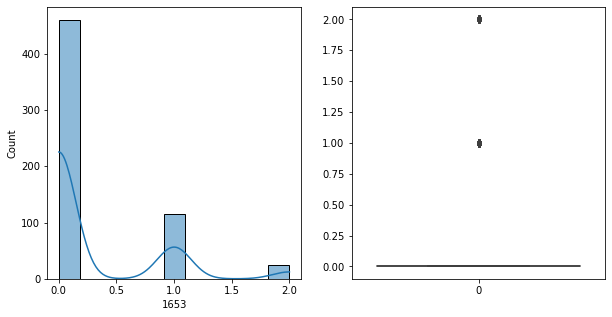

1653   Unique :  [1 0 2]
--------------------------------------------------------------------
1653   N unique :  3
--------------------------------------------------------------------
1653   Value Counts :  0    460
1    115
2     25
Name: 1653, dtype: int64
--------------------------------------------------------------------



[ 1654 ]
show_df_info :  1654


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


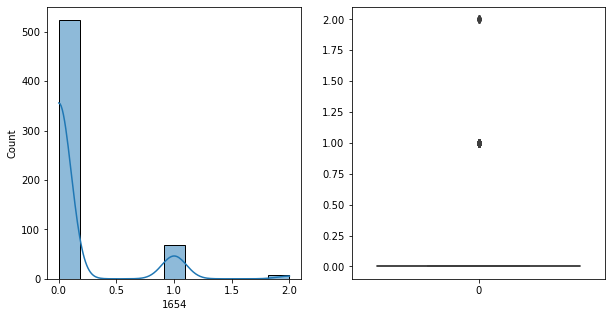

1654   Unique :  [0 1 2]
--------------------------------------------------------------------
1654   N unique :  3
--------------------------------------------------------------------
1654   Value Counts :  0    524
1     68
2      8
Name: 1654, dtype: int64
--------------------------------------------------------------------



[ 1655 ]
show_df_info :  1655


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


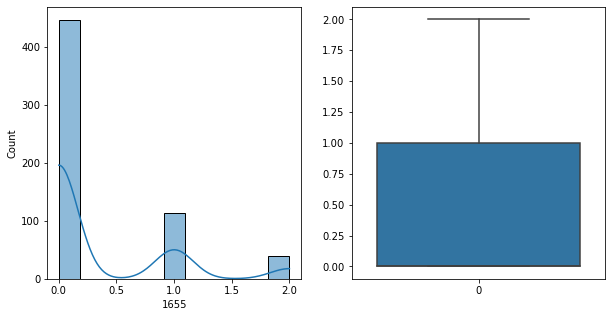

1655   Unique :  [1 0 2]
--------------------------------------------------------------------
1655   N unique :  3
--------------------------------------------------------------------
1655   Value Counts :  0    446
1    114
2     40
Name: 1655, dtype: int64
--------------------------------------------------------------------



[ 1656 ]
show_df_info :  1656


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


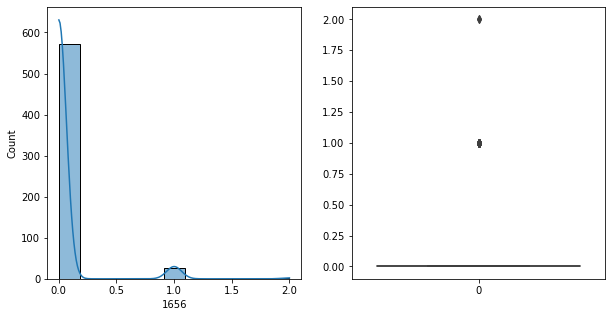

1656   Unique :  [1 0 2]
--------------------------------------------------------------------
1656   N unique :  3
--------------------------------------------------------------------
1656   Value Counts :  0    571
1     27
2      2
Name: 1656, dtype: int64
--------------------------------------------------------------------



[ 1657 ]
show_df_info :  1657


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


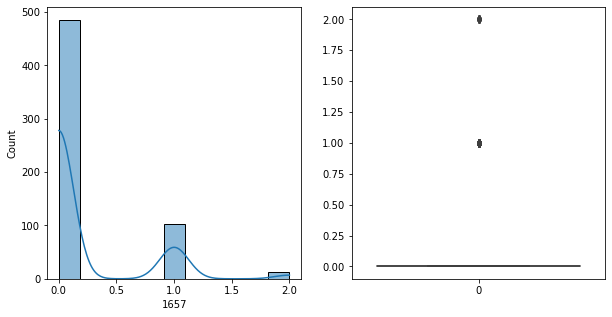

1657   Unique :  [1 0 2]
--------------------------------------------------------------------
1657   N unique :  3
--------------------------------------------------------------------
1657   Value Counts :  0    485
1    103
2     12
Name: 1657, dtype: int64
--------------------------------------------------------------------



[ 1658 ]
show_df_info :  1658


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


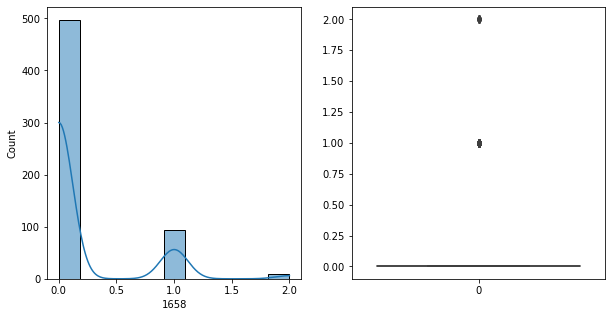

1658   Unique :  [0 2 1]
--------------------------------------------------------------------
1658   N unique :  3
--------------------------------------------------------------------
1658   Value Counts :  0    497
1     93
2     10
Name: 1658, dtype: int64
--------------------------------------------------------------------



[ 1659 ]
show_df_info :  1659


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


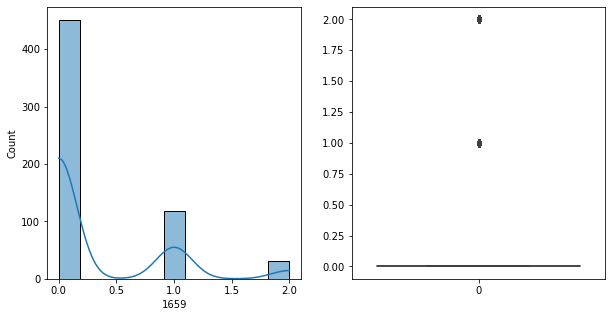

1659   Unique :  [0 1 2]
--------------------------------------------------------------------
1659   N unique :  3
--------------------------------------------------------------------
1659   Value Counts :  0    451
1    118
2     31
Name: 1659, dtype: int64
--------------------------------------------------------------------



[ 1660 ]
show_df_info :  1660


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


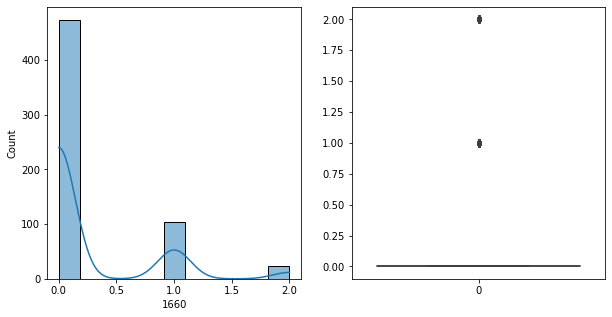

1660   Unique :  [1 0 2]
--------------------------------------------------------------------
1660   N unique :  3
--------------------------------------------------------------------
1660   Value Counts :  0    473
1    104
2     23
Name: 1660, dtype: int64
--------------------------------------------------------------------



[ 1661 ]
show_df_info :  1661


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


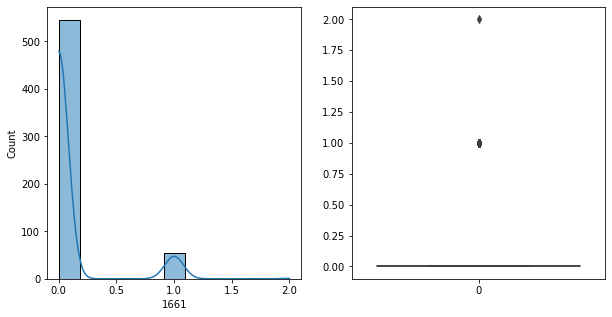

1661   Unique :  [1 0 2]
--------------------------------------------------------------------
1661   N unique :  3
--------------------------------------------------------------------
1661   Value Counts :  0    545
1     54
2      1
Name: 1661, dtype: int64
--------------------------------------------------------------------



[ 1662 ]
show_df_info :  1662


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


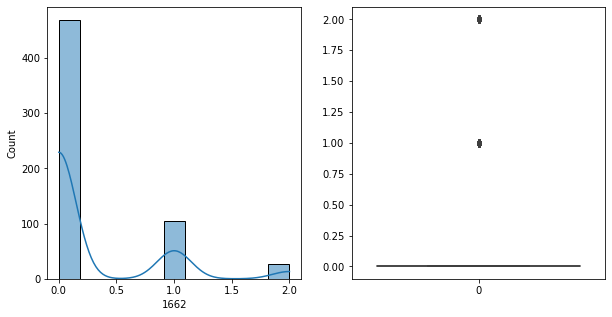

1662   Unique :  [0 1 2]
--------------------------------------------------------------------
1662   N unique :  3
--------------------------------------------------------------------
1662   Value Counts :  0    469
1    104
2     27
Name: 1662, dtype: int64
--------------------------------------------------------------------



[ 1663 ]
show_df_info :  1663


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


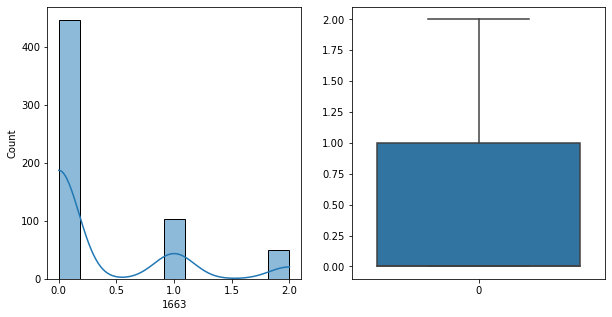

1663   Unique :  [2 0 1]
--------------------------------------------------------------------
1663   N unique :  3
--------------------------------------------------------------------
1663   Value Counts :  0    447
1    104
2     49
Name: 1663, dtype: int64
--------------------------------------------------------------------



[ 1664 ]
show_df_info :  1664


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


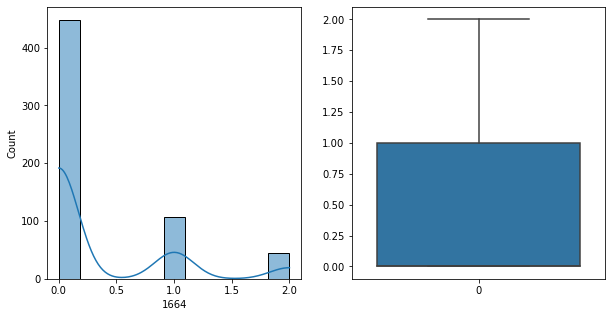

1664   Unique :  [2 0 1]
--------------------------------------------------------------------
1664   N unique :  3
--------------------------------------------------------------------
1664   Value Counts :  0    448
1    107
2     45
Name: 1664, dtype: int64
--------------------------------------------------------------------



[ 1665 ]
show_df_info :  1665


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


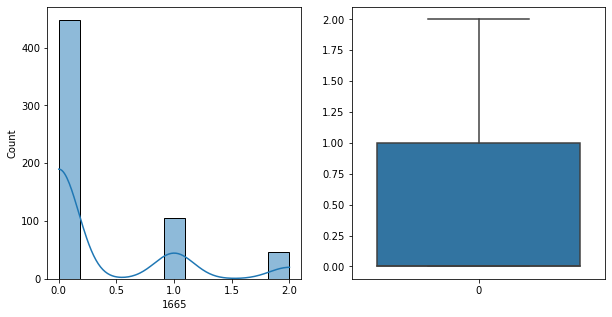

1665   Unique :  [2 0 1]
--------------------------------------------------------------------
1665   N unique :  3
--------------------------------------------------------------------
1665   Value Counts :  0    448
1    105
2     47
Name: 1665, dtype: int64
--------------------------------------------------------------------



[ 1666 ]
show_df_info :  1666


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


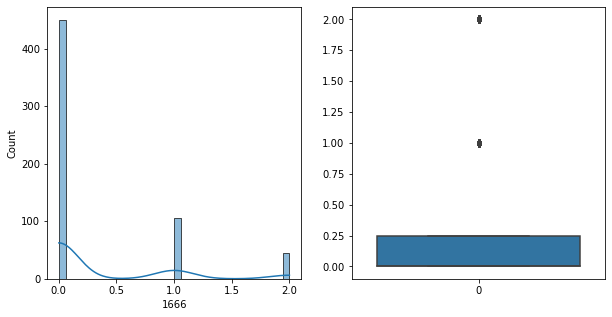

1666   Unique :  [2 0 1]
--------------------------------------------------------------------
1666   N unique :  3
--------------------------------------------------------------------
1666   Value Counts :  0    450
1    105
2     45
Name: 1666, dtype: int64
--------------------------------------------------------------------



[ 1667 ]
show_df_info :  1667


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


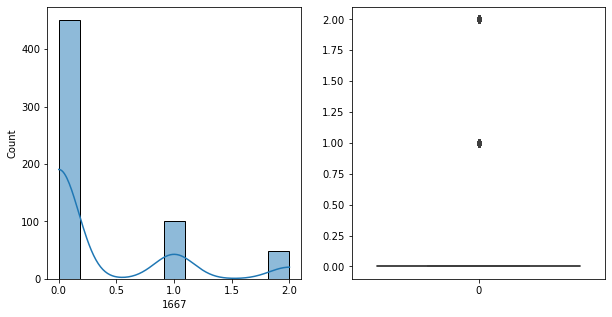

1667   Unique :  [2 0 1]
--------------------------------------------------------------------
1667   N unique :  3
--------------------------------------------------------------------
1667   Value Counts :  0    451
1    101
2     48
Name: 1667, dtype: int64
--------------------------------------------------------------------



[ 1668 ]
show_df_info :  1668


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


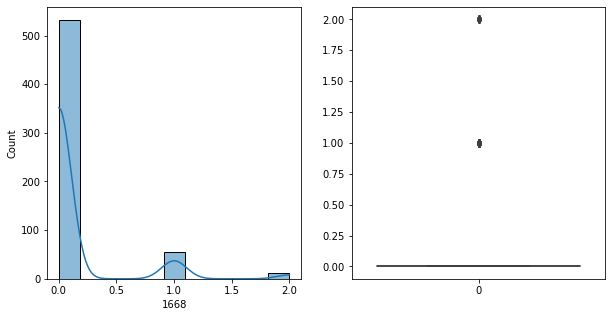

1668   Unique :  [0 1 2]
--------------------------------------------------------------------
1668   N unique :  3
--------------------------------------------------------------------
1668   Value Counts :  0    532
1     56
2     12
Name: 1668, dtype: int64
--------------------------------------------------------------------



[ 1669 ]
show_df_info :  1669


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


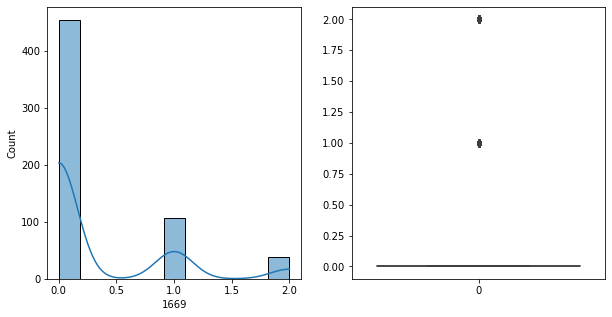

1669   Unique :  [0 1 2]
--------------------------------------------------------------------
1669   N unique :  3
--------------------------------------------------------------------
1669   Value Counts :  0    455
1    107
2     38
Name: 1669, dtype: int64
--------------------------------------------------------------------



[ 1670 ]
show_df_info :  1670


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


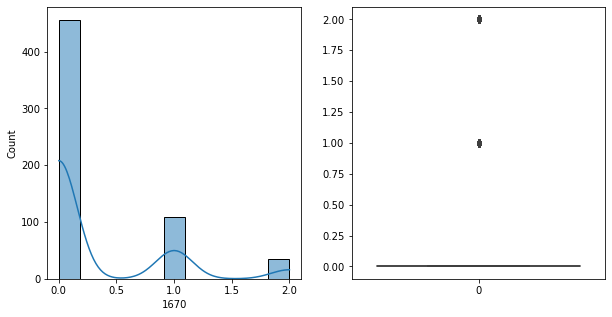

1670   Unique :  [2 0 1]
--------------------------------------------------------------------
1670   N unique :  3
--------------------------------------------------------------------
1670   Value Counts :  0    456
1    109
2     35
Name: 1670, dtype: int64
--------------------------------------------------------------------



[ 1671 ]
show_df_info :  1671


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


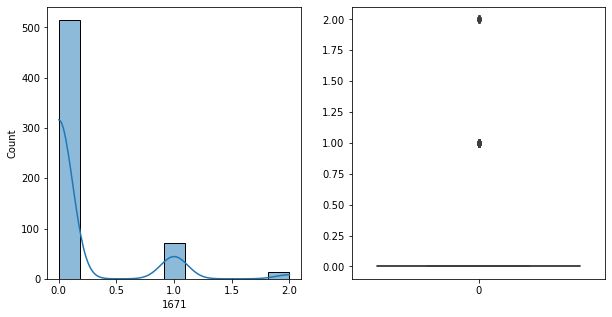

1671   Unique :  [0 1 2]
--------------------------------------------------------------------
1671   N unique :  3
--------------------------------------------------------------------
1671   Value Counts :  0    515
1     72
2     13
Name: 1671, dtype: int64
--------------------------------------------------------------------



[ 1672 ]
show_df_info :  1672


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


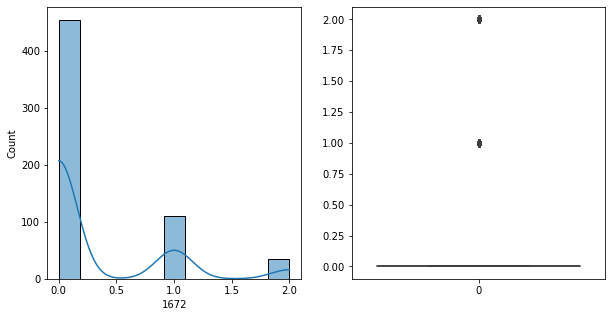

1672   Unique :  [2 0 1]
--------------------------------------------------------------------
1672   N unique :  3
--------------------------------------------------------------------
1672   Value Counts :  0    455
1    110
2     35
Name: 1672, dtype: int64
--------------------------------------------------------------------



[ 1673 ]
show_df_info :  1673


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


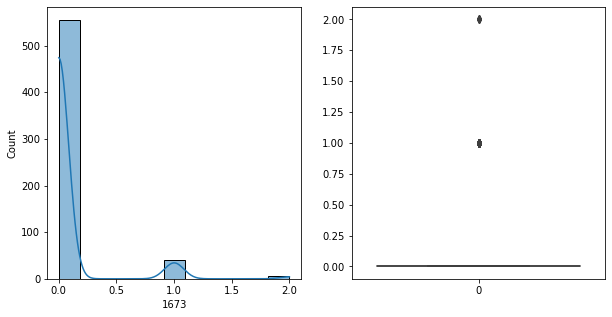

1673   Unique :  [0 1 2]
--------------------------------------------------------------------
1673   N unique :  3
--------------------------------------------------------------------
1673   Value Counts :  0    555
1     40
2      5
Name: 1673, dtype: int64
--------------------------------------------------------------------



[ 1674 ]
show_df_info :  1674


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


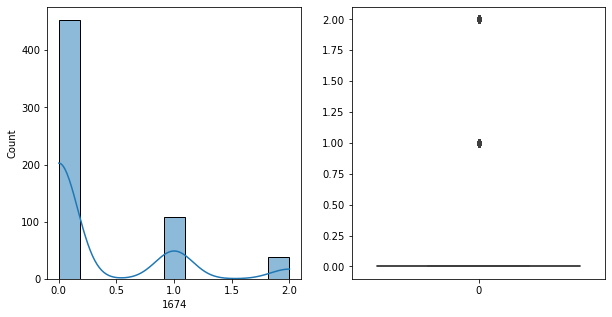

1674   Unique :  [0 2 1]
--------------------------------------------------------------------
1674   N unique :  3
--------------------------------------------------------------------
1674   Value Counts :  0    453
1    109
2     38
Name: 1674, dtype: int64
--------------------------------------------------------------------



[ 1675 ]
show_df_info :  1675


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


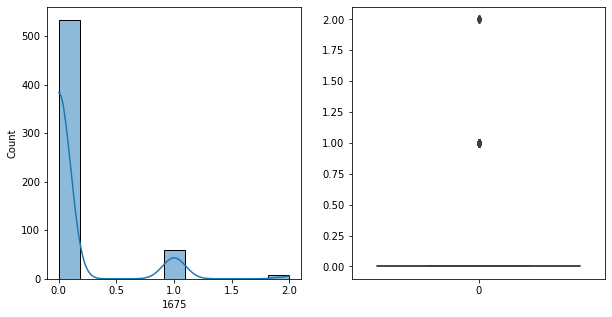

1675   Unique :  [0 2 1]
--------------------------------------------------------------------
1675   N unique :  3
--------------------------------------------------------------------
1675   Value Counts :  0    533
1     60
2      7
Name: 1675, dtype: int64
--------------------------------------------------------------------



[ 1676 ]
show_df_info :  1676


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


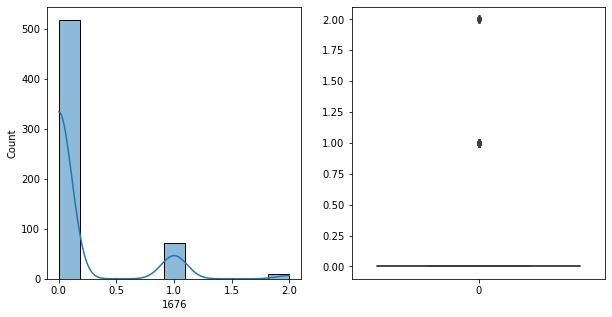

1676   Unique :  [0 1 2]
--------------------------------------------------------------------
1676   N unique :  3
--------------------------------------------------------------------
1676   Value Counts :  0    518
1     72
2     10
Name: 1676, dtype: int64
--------------------------------------------------------------------



[ 1677 ]
show_df_info :  1677


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


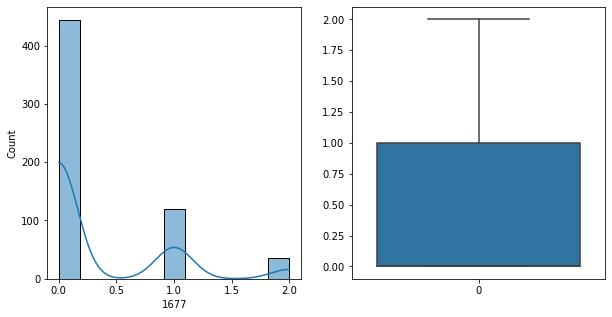

1677   Unique :  [1 0 2]
--------------------------------------------------------------------
1677   N unique :  3
--------------------------------------------------------------------
1677   Value Counts :  0    444
1    120
2     36
Name: 1677, dtype: int64
--------------------------------------------------------------------



[ 1678 ]
show_df_info :  1678


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


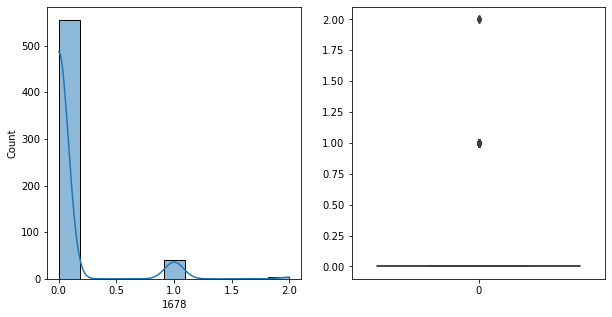

1678   Unique :  [0 2 1]
--------------------------------------------------------------------
1678   N unique :  3
--------------------------------------------------------------------
1678   Value Counts :  0    555
1     41
2      4
Name: 1678, dtype: int64
--------------------------------------------------------------------



[ 1679 ]
show_df_info :  1679


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


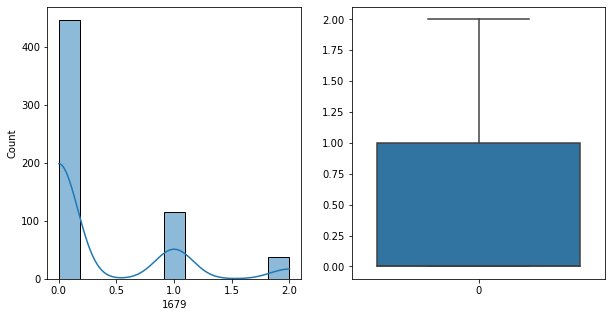

1679   Unique :  [1 0 2]
--------------------------------------------------------------------
1679   N unique :  3
--------------------------------------------------------------------
1679   Value Counts :  0    447
1    115
2     38
Name: 1679, dtype: int64
--------------------------------------------------------------------



[ 1680 ]
show_df_info :  1680


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


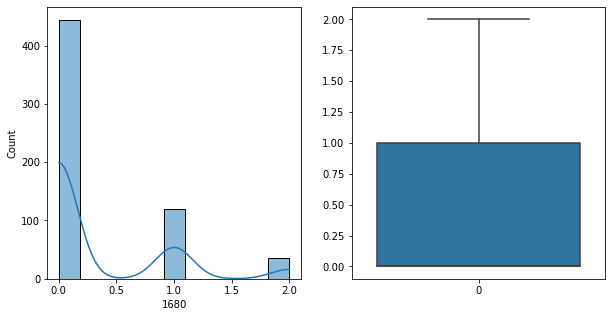

1680   Unique :  [1 0 2]
--------------------------------------------------------------------
1680   N unique :  3
--------------------------------------------------------------------
1680   Value Counts :  0    444
1    120
2     36
Name: 1680, dtype: int64
--------------------------------------------------------------------



[ 1681 ]
show_df_info :  1681


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


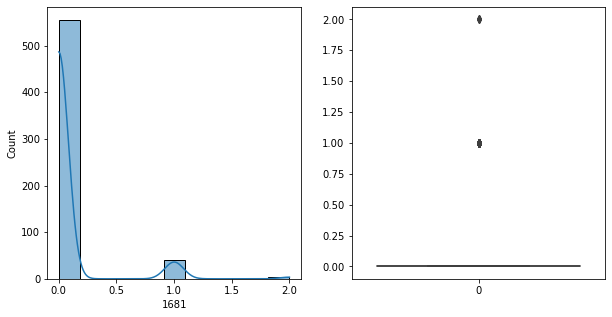

1681   Unique :  [0 2 1]
--------------------------------------------------------------------
1681   N unique :  3
--------------------------------------------------------------------
1681   Value Counts :  0    555
1     41
2      4
Name: 1681, dtype: int64
--------------------------------------------------------------------



[ 1682 ]
show_df_info :  1682


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


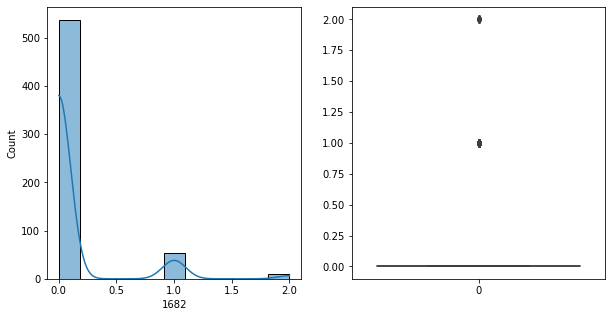

1682   Unique :  [0 1 2]
--------------------------------------------------------------------
1682   N unique :  3
--------------------------------------------------------------------
1682   Value Counts :  0    537
1     54
2      9
Name: 1682, dtype: int64
--------------------------------------------------------------------



[ 1683 ]
show_df_info :  1683


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


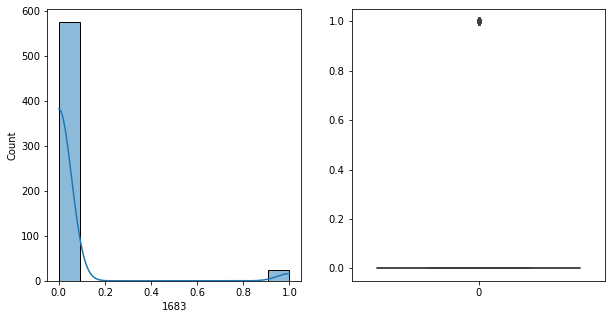

1683   Unique :  [0 1]
--------------------------------------------------------------------
1683   N unique :  2
--------------------------------------------------------------------
1683   Value Counts :  0    576
1     24
Name: 1683, dtype: int64
--------------------------------------------------------------------



[ 1684 ]
show_df_info :  1684


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


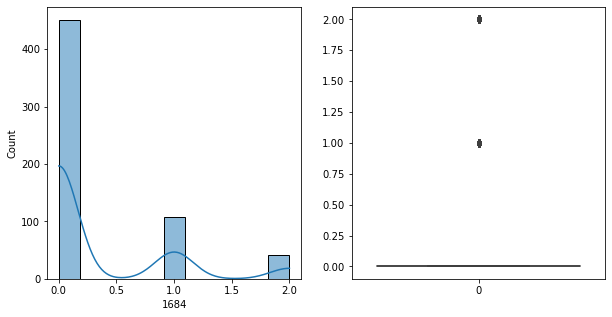

1684   Unique :  [1 0 2]
--------------------------------------------------------------------
1684   N unique :  3
--------------------------------------------------------------------
1684   Value Counts :  0    451
1    107
2     42
Name: 1684, dtype: int64
--------------------------------------------------------------------



[ 1685 ]
show_df_info :  1685


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


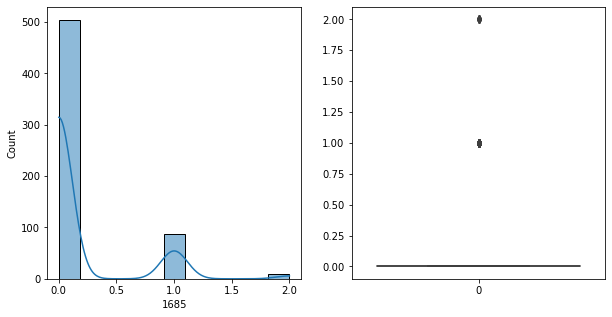

1685   Unique :  [1 0 2]
--------------------------------------------------------------------
1685   N unique :  3
--------------------------------------------------------------------
1685   Value Counts :  0    504
1     87
2      9
Name: 1685, dtype: int64
--------------------------------------------------------------------



[ 1686 ]
show_df_info :  1686


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


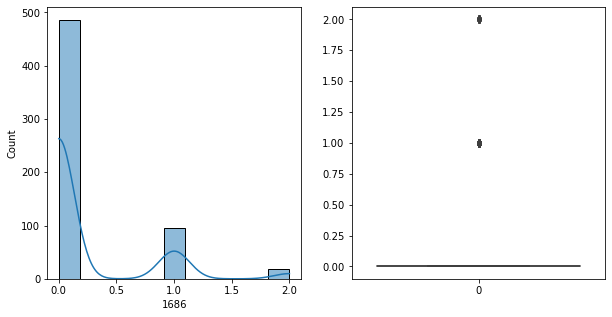

1686   Unique :  [1 0 2]
--------------------------------------------------------------------
1686   N unique :  3
--------------------------------------------------------------------
1686   Value Counts :  0    486
1     96
2     18
Name: 1686, dtype: int64
--------------------------------------------------------------------



[ 1687 ]
show_df_info :  1687


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


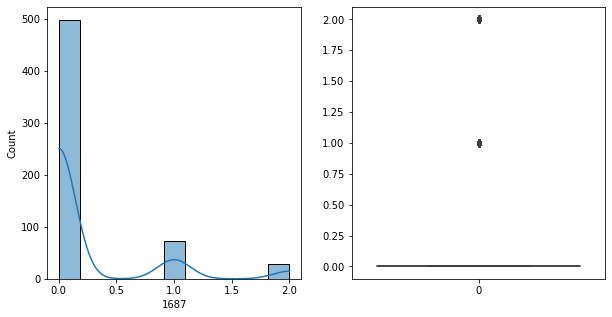

1687   Unique :  [0 1 2]
--------------------------------------------------------------------
1687   N unique :  3
--------------------------------------------------------------------
1687   Value Counts :  0    498
1     73
2     29
Name: 1687, dtype: int64
--------------------------------------------------------------------



[ 1688 ]
show_df_info :  1688


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


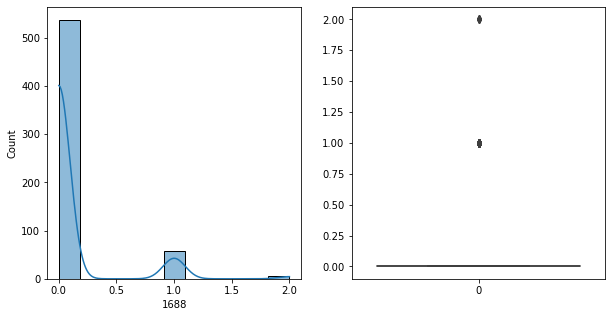

1688   Unique :  [0 1 2]
--------------------------------------------------------------------
1688   N unique :  3
--------------------------------------------------------------------
1688   Value Counts :  0    537
1     57
2      6
Name: 1688, dtype: int64
--------------------------------------------------------------------



[ 1689 ]
show_df_info :  1689


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


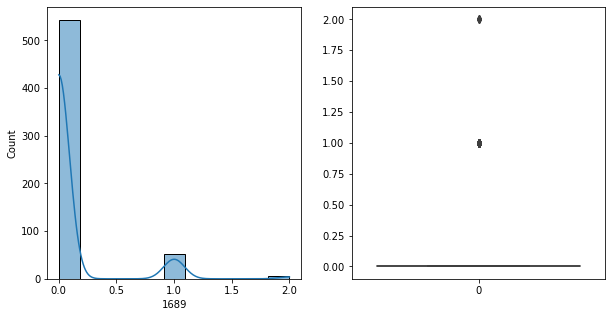

1689   Unique :  [0 1 2]
--------------------------------------------------------------------
1689   N unique :  3
--------------------------------------------------------------------
1689   Value Counts :  0    543
1     52
2      5
Name: 1689, dtype: int64
--------------------------------------------------------------------



[ 1690 ]
show_df_info :  1690


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


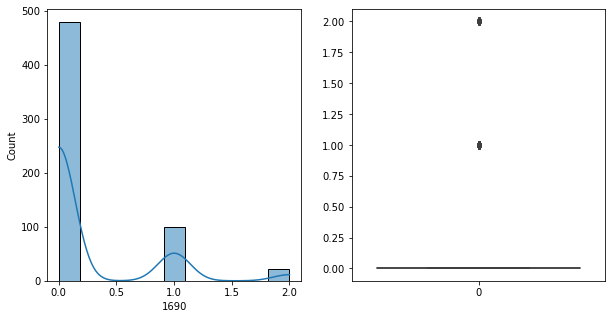

1690   Unique :  [1 0 2]
--------------------------------------------------------------------
1690   N unique :  3
--------------------------------------------------------------------
1690   Value Counts :  0    479
1     99
2     22
Name: 1690, dtype: int64
--------------------------------------------------------------------



[ 1691 ]
show_df_info :  1691


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


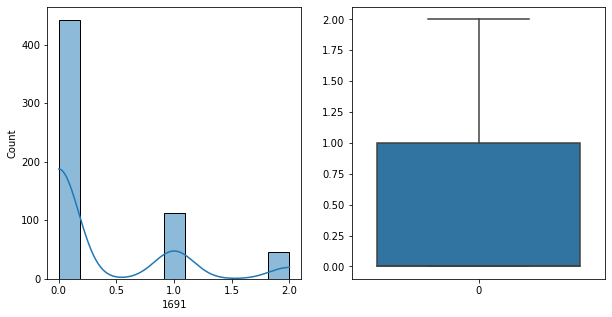

1691   Unique :  [1 0 2]
--------------------------------------------------------------------
1691   N unique :  3
--------------------------------------------------------------------
1691   Value Counts :  0    442
1    112
2     46
Name: 1691, dtype: int64
--------------------------------------------------------------------



[ 1692 ]
show_df_info :  1692


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


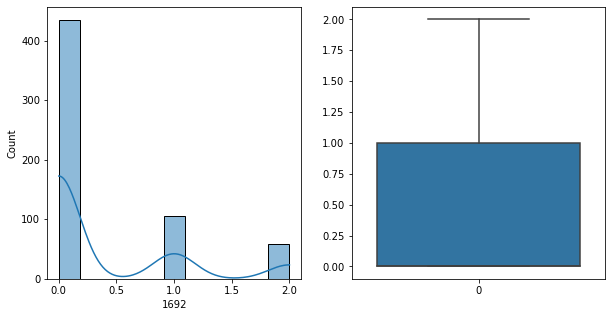

1692   Unique :  [1 0 2]
--------------------------------------------------------------------
1692   N unique :  3
--------------------------------------------------------------------
1692   Value Counts :  0    435
1    106
2     59
Name: 1692, dtype: int64
--------------------------------------------------------------------



[ 1693 ]
show_df_info :  1693


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


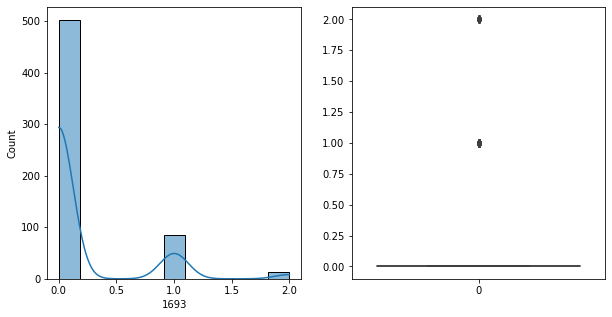

1693   Unique :  [1 0 2]
--------------------------------------------------------------------
1693   N unique :  3
--------------------------------------------------------------------
1693   Value Counts :  0    502
1     84
2     14
Name: 1693, dtype: int64
--------------------------------------------------------------------



[ 1694 ]
show_df_info :  1694


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


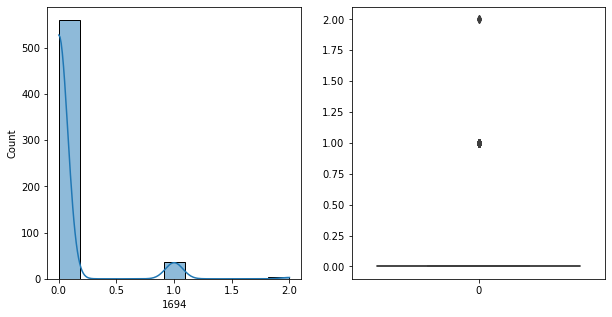

1694   Unique :  [0 1 2]
--------------------------------------------------------------------
1694   N unique :  3
--------------------------------------------------------------------
1694   Value Counts :  0    560
1     37
2      3
Name: 1694, dtype: int64
--------------------------------------------------------------------



[ 1695 ]
show_df_info :  1695


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


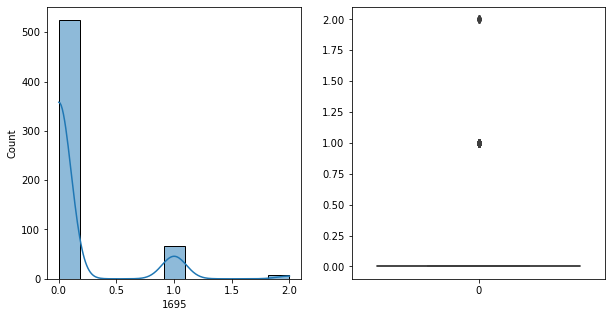

1695   Unique :  [0 1 2]
--------------------------------------------------------------------
1695   N unique :  3
--------------------------------------------------------------------
1695   Value Counts :  0    525
1     67
2      8
Name: 1695, dtype: int64
--------------------------------------------------------------------



[ 1696 ]
show_df_info :  1696


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


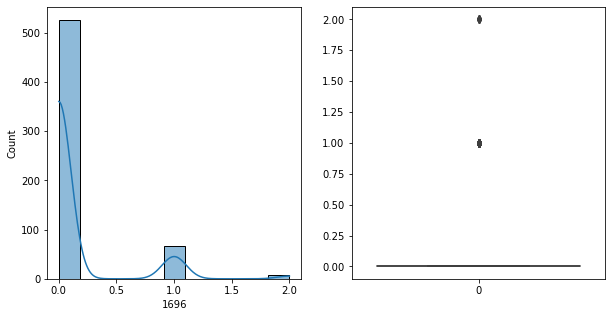

1696   Unique :  [0 1 2]
--------------------------------------------------------------------
1696   N unique :  3
--------------------------------------------------------------------
1696   Value Counts :  0    526
1     66
2      8
Name: 1696, dtype: int64
--------------------------------------------------------------------



[ 1697 ]
show_df_info :  1697


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


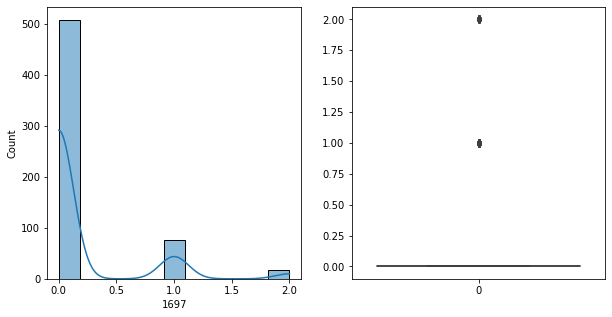

1697   Unique :  [0 1 2]
--------------------------------------------------------------------
1697   N unique :  3
--------------------------------------------------------------------
1697   Value Counts :  0    507
1     76
2     17
Name: 1697, dtype: int64
--------------------------------------------------------------------



[ 1698 ]
show_df_info :  1698


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


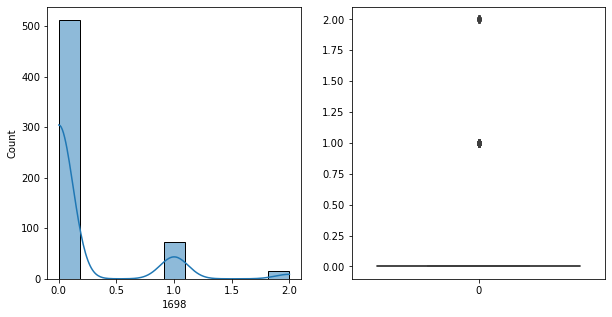

1698   Unique :  [1 0 2]
--------------------------------------------------------------------
1698   N unique :  3
--------------------------------------------------------------------
1698   Value Counts :  0    512
1     73
2     15
Name: 1698, dtype: int64
--------------------------------------------------------------------



[ 1699 ]
show_df_info :  1699


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


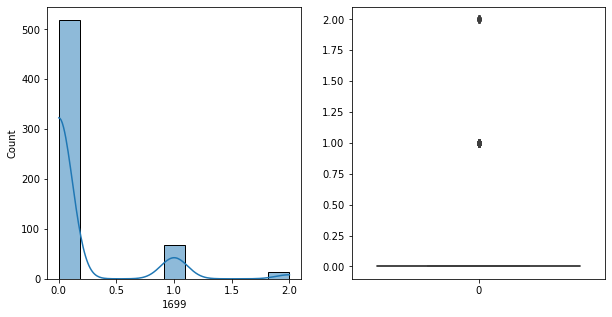

1699   Unique :  [1 0 2]
--------------------------------------------------------------------
1699   N unique :  3
--------------------------------------------------------------------
1699   Value Counts :  0    519
1     68
2     13
Name: 1699, dtype: int64
--------------------------------------------------------------------



[ 1700 ]
show_df_info :  1700


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


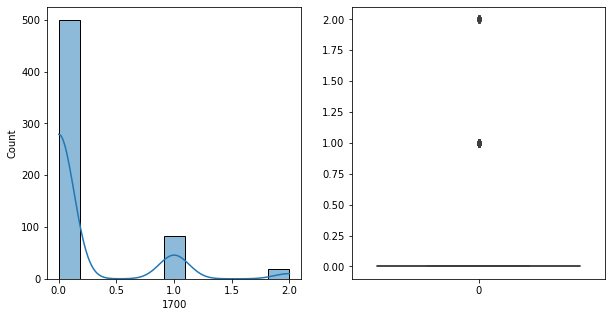

1700   Unique :  [1 0 2]
--------------------------------------------------------------------
1700   N unique :  3
--------------------------------------------------------------------
1700   Value Counts :  0    500
1     82
2     18
Name: 1700, dtype: int64
--------------------------------------------------------------------



[ 1701 ]
show_df_info :  1701


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


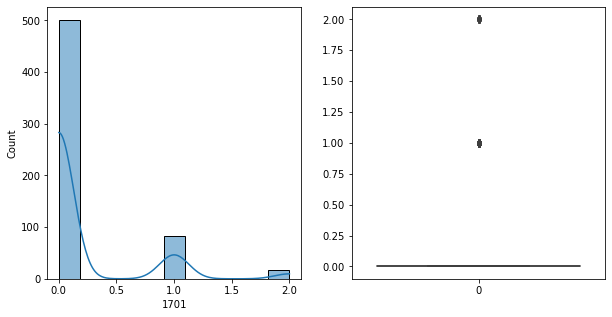

1701   Unique :  [1 0 2]
--------------------------------------------------------------------
1701   N unique :  3
--------------------------------------------------------------------
1701   Value Counts :  0    501
1     82
2     17
Name: 1701, dtype: int64
--------------------------------------------------------------------



[ 1702 ]
show_df_info :  1702


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


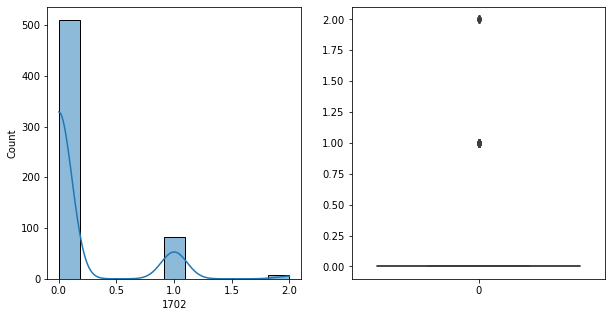

1702   Unique :  [0 1 2]
--------------------------------------------------------------------
1702   N unique :  3
--------------------------------------------------------------------
1702   Value Counts :  0    510
1     82
2      8
Name: 1702, dtype: int64
--------------------------------------------------------------------



[ 1703 ]
show_df_info :  1703


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


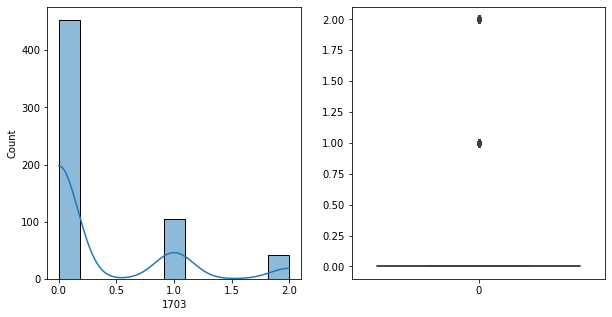

1703   Unique :  [0 1 2]
--------------------------------------------------------------------
1703   N unique :  3
--------------------------------------------------------------------
1703   Value Counts :  0    453
1    105
2     42
Name: 1703, dtype: int64
--------------------------------------------------------------------



[ 1704 ]
show_df_info :  1704


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


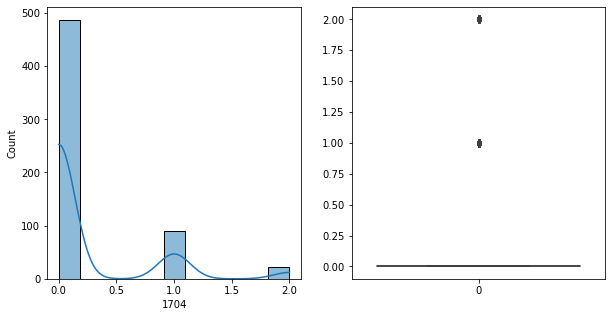

1704   Unique :  [0 1 2]
--------------------------------------------------------------------
1704   N unique :  3
--------------------------------------------------------------------
1704   Value Counts :  0    487
1     90
2     23
Name: 1704, dtype: int64
--------------------------------------------------------------------



[ 1705 ]
show_df_info :  1705


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


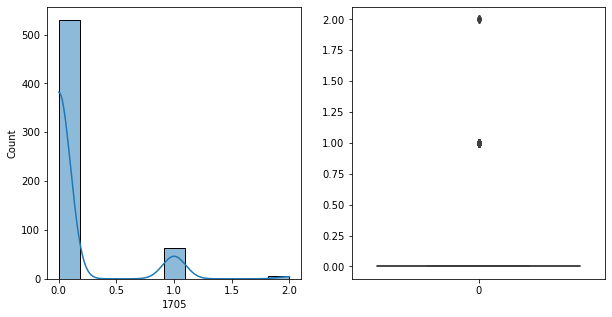

1705   Unique :  [0 1 2]
--------------------------------------------------------------------
1705   N unique :  3
--------------------------------------------------------------------
1705   Value Counts :  0    530
1     64
2      6
Name: 1705, dtype: int64
--------------------------------------------------------------------



[ 1706 ]
show_df_info :  1706


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


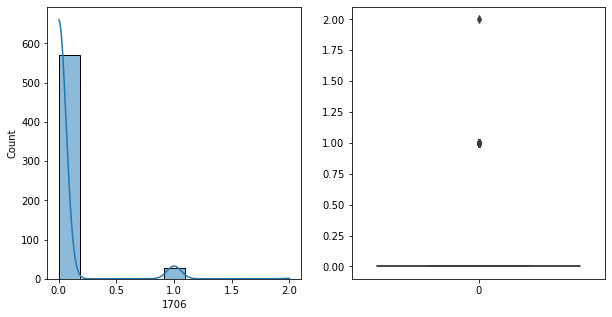

1706   Unique :  [0 1 2]
--------------------------------------------------------------------
1706   N unique :  3
--------------------------------------------------------------------
1706   Value Counts :  0    571
1     28
2      1
Name: 1706, dtype: int64
--------------------------------------------------------------------



[ 1707 ]
show_df_info :  1707


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


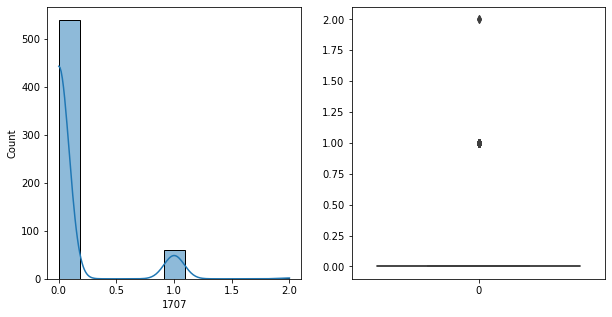

1707   Unique :  [0 1 2]
--------------------------------------------------------------------
1707   N unique :  3
--------------------------------------------------------------------
1707   Value Counts :  0    539
1     59
2      2
Name: 1707, dtype: int64
--------------------------------------------------------------------



[ 1708 ]
show_df_info :  1708


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


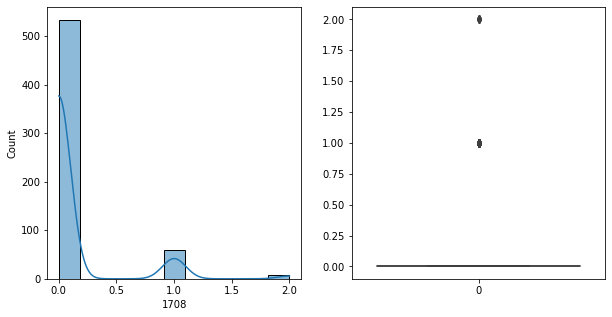

1708   Unique :  [0 1 2]
--------------------------------------------------------------------
1708   N unique :  3
--------------------------------------------------------------------
1708   Value Counts :  0    533
1     59
2      8
Name: 1708, dtype: int64
--------------------------------------------------------------------



[ 1709 ]
show_df_info :  1709


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


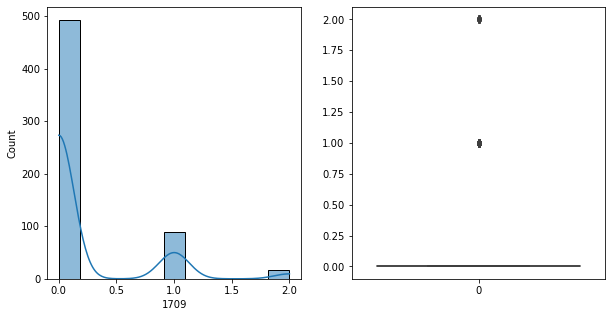

1709   Unique :  [0 1 2]
--------------------------------------------------------------------
1709   N unique :  3
--------------------------------------------------------------------
1709   Value Counts :  0    493
1     90
2     17
Name: 1709, dtype: int64
--------------------------------------------------------------------



[ 1710 ]
show_df_info :  1710


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


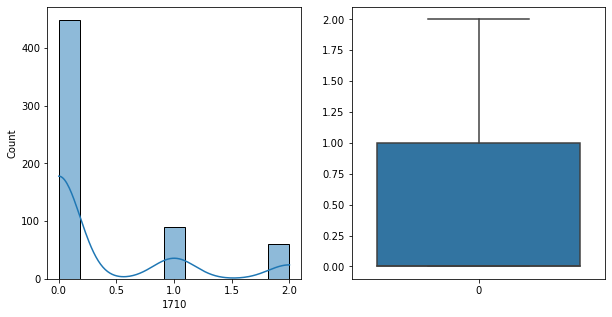

1710   Unique :  [0 1 2]
--------------------------------------------------------------------
1710   N unique :  3
--------------------------------------------------------------------
1710   Value Counts :  0    449
1     90
2     61
Name: 1710, dtype: int64
--------------------------------------------------------------------



[ 1711 ]
show_df_info :  1711


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


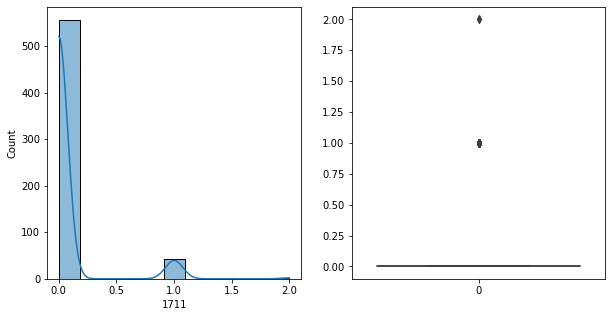

1711   Unique :  [0 1 2]
--------------------------------------------------------------------
1711   N unique :  3
--------------------------------------------------------------------
1711   Value Counts :  0    556
1     42
2      2
Name: 1711, dtype: int64
--------------------------------------------------------------------



[ 1712 ]
show_df_info :  1712


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


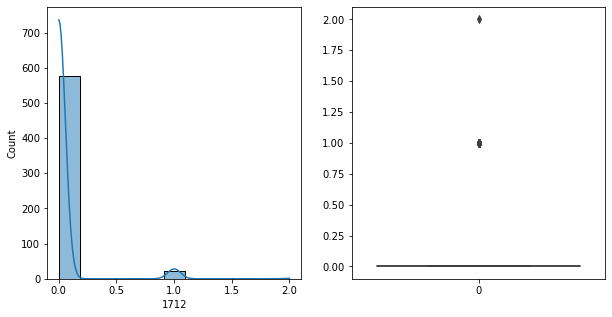

1712   Unique :  [0 1 2]
--------------------------------------------------------------------
1712   N unique :  3
--------------------------------------------------------------------
1712   Value Counts :  0    577
1     22
2      1
Name: 1712, dtype: int64
--------------------------------------------------------------------



[ 1713 ]
show_df_info :  1713


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


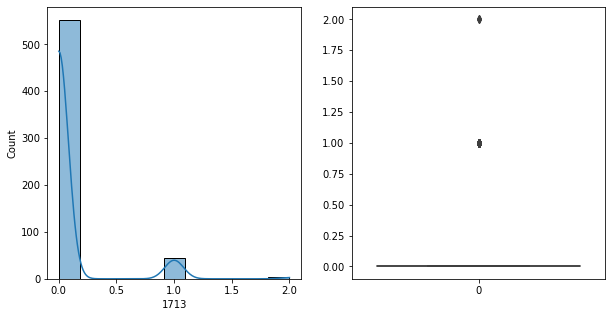

1713   Unique :  [0 1 2]
--------------------------------------------------------------------
1713   N unique :  3
--------------------------------------------------------------------
1713   Value Counts :  0    552
1     45
2      3
Name: 1713, dtype: int64
--------------------------------------------------------------------



[ 1714 ]
show_df_info :  1714


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


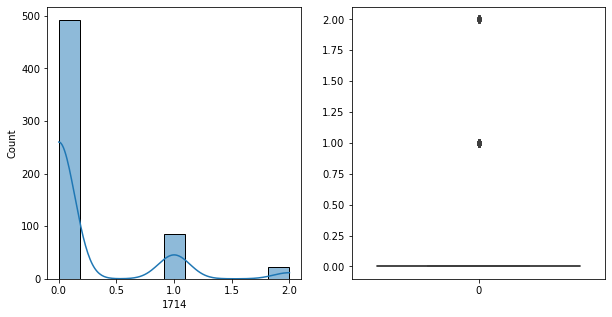

1714   Unique :  [0 1 2]
--------------------------------------------------------------------
1714   N unique :  3
--------------------------------------------------------------------
1714   Value Counts :  0    492
1     86
2     22
Name: 1714, dtype: int64
--------------------------------------------------------------------



[ 1715 ]
show_df_info :  1715


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


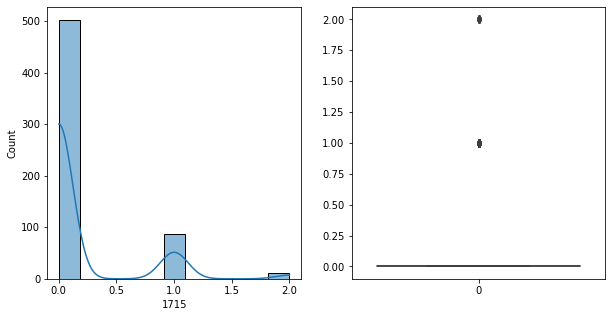

1715   Unique :  [0 1 2]
--------------------------------------------------------------------
1715   N unique :  3
--------------------------------------------------------------------
1715   Value Counts :  0    502
1     86
2     12
Name: 1715, dtype: int64
--------------------------------------------------------------------



[ 1716 ]
show_df_info :  1716


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


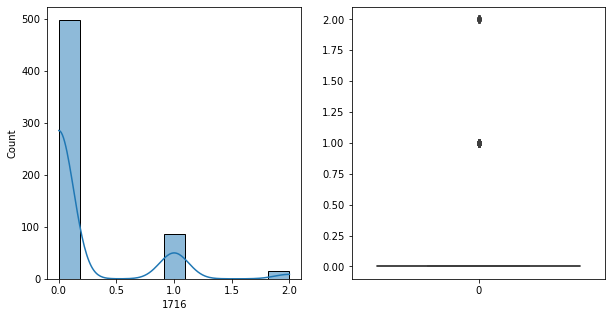

1716   Unique :  [1 0 2]
--------------------------------------------------------------------
1716   N unique :  3
--------------------------------------------------------------------
1716   Value Counts :  0    498
1     87
2     15
Name: 1716, dtype: int64
--------------------------------------------------------------------



[ 1717 ]
show_df_info :  1717


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


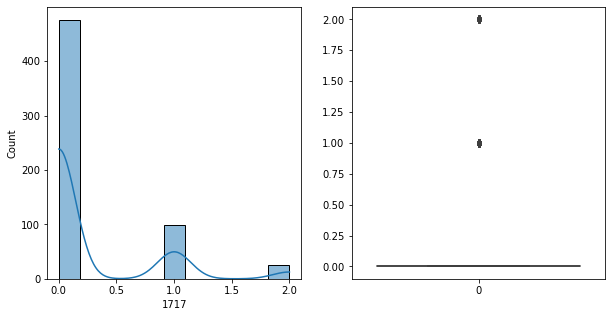

1717   Unique :  [1 0 2]
--------------------------------------------------------------------
1717   N unique :  3
--------------------------------------------------------------------
1717   Value Counts :  0    476
1     99
2     25
Name: 1717, dtype: int64
--------------------------------------------------------------------



[ 1718 ]
show_df_info :  1718


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


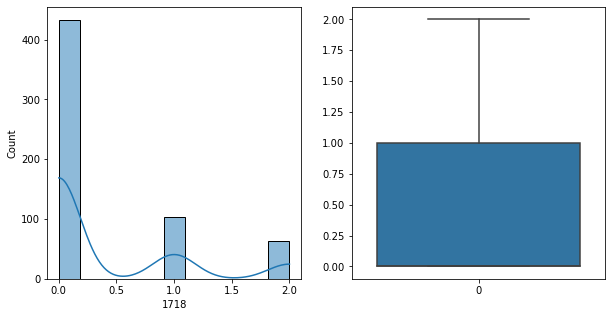

1718   Unique :  [1 0 2]
--------------------------------------------------------------------
1718   N unique :  3
--------------------------------------------------------------------
1718   Value Counts :  0    433
1    104
2     63
Name: 1718, dtype: int64
--------------------------------------------------------------------



[ 1719 ]
show_df_info :  1719


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


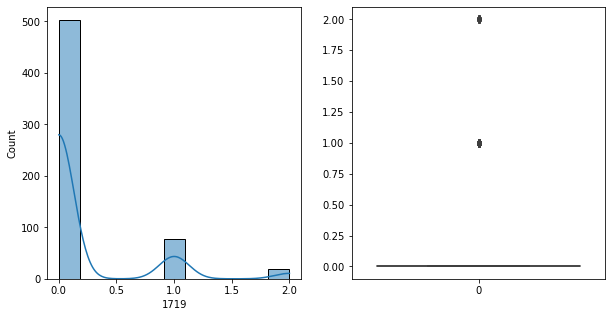

1719   Unique :  [1 0 2]
--------------------------------------------------------------------
1719   N unique :  3
--------------------------------------------------------------------
1719   Value Counts :  0    503
1     78
2     19
Name: 1719, dtype: int64
--------------------------------------------------------------------



[ 1720 ]
show_df_info :  1720


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


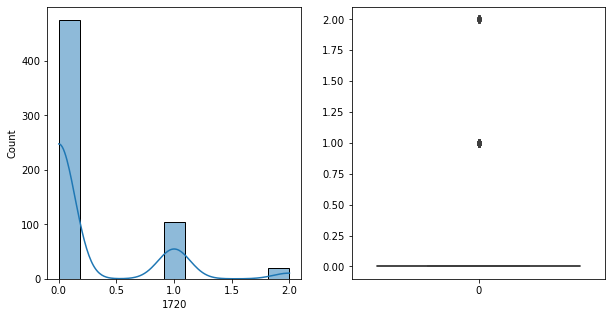

1720   Unique :  [0 1 2]
--------------------------------------------------------------------
1720   N unique :  3
--------------------------------------------------------------------
1720   Value Counts :  0    475
1    105
2     20
Name: 1720, dtype: int64
--------------------------------------------------------------------



[ 1721 ]
show_df_info :  1721


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


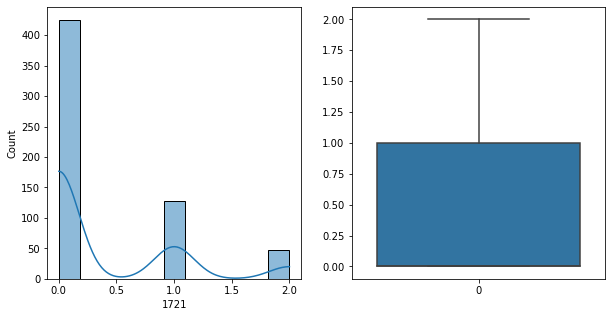

1721   Unique :  [2 0 1]
--------------------------------------------------------------------
1721   N unique :  3
--------------------------------------------------------------------
1721   Value Counts :  0    425
1    127
2     48
Name: 1721, dtype: int64
--------------------------------------------------------------------



[ 1722 ]
show_df_info :  1722


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


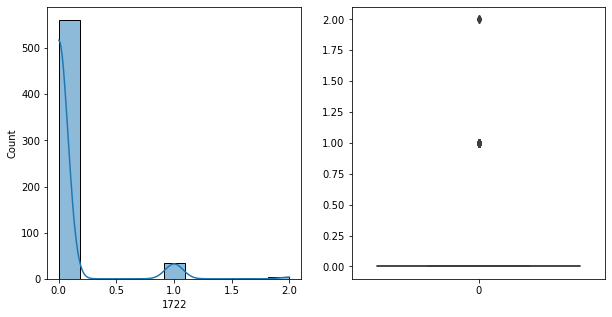

1722   Unique :  [0 1 2]
--------------------------------------------------------------------
1722   N unique :  3
--------------------------------------------------------------------
1722   Value Counts :  0    561
1     35
2      4
Name: 1722, dtype: int64
--------------------------------------------------------------------



[ 1723 ]
show_df_info :  1723


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


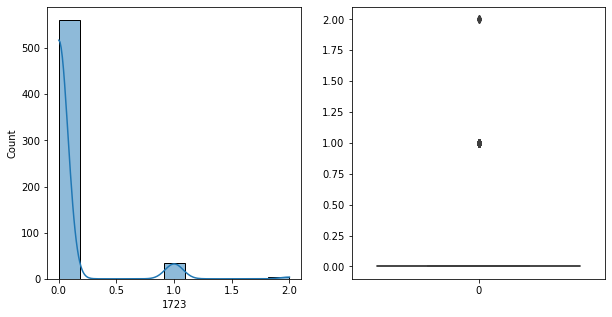

1723   Unique :  [0 1 2]
--------------------------------------------------------------------
1723   N unique :  3
--------------------------------------------------------------------
1723   Value Counts :  0    561
1     35
2      4
Name: 1723, dtype: int64
--------------------------------------------------------------------



[ 1724 ]
show_df_info :  1724


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


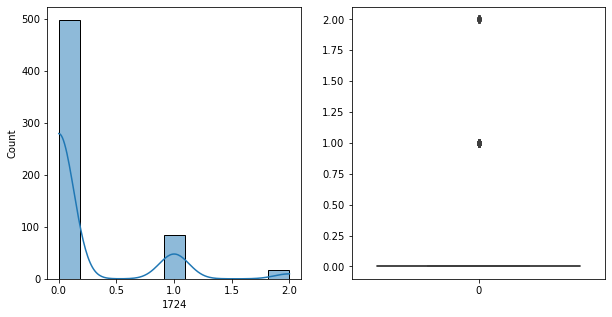

1724   Unique :  [1 0 2]
--------------------------------------------------------------------
1724   N unique :  3
--------------------------------------------------------------------
1724   Value Counts :  0    498
1     85
2     17
Name: 1724, dtype: int64
--------------------------------------------------------------------



[ 1725 ]
show_df_info :  1725


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


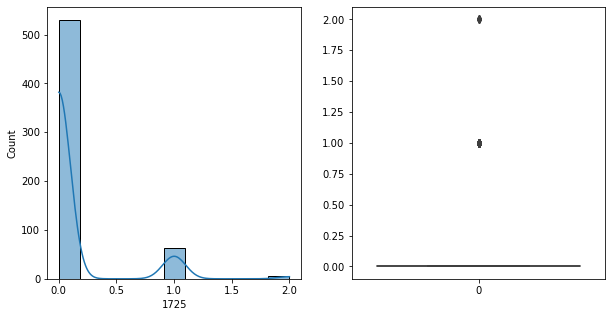

1725   Unique :  [1 0 2]
--------------------------------------------------------------------
1725   N unique :  3
--------------------------------------------------------------------
1725   Value Counts :  0    530
1     64
2      6
Name: 1725, dtype: int64
--------------------------------------------------------------------



[ 1726 ]
show_df_info :  1726


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


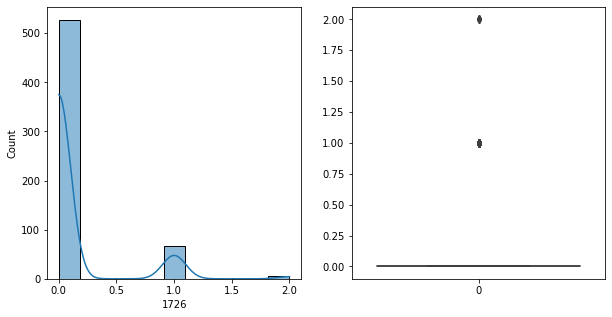

1726   Unique :  [1 0 2]
--------------------------------------------------------------------
1726   N unique :  3
--------------------------------------------------------------------
1726   Value Counts :  0    527
1     67
2      6
Name: 1726, dtype: int64
--------------------------------------------------------------------



[ 1727 ]
show_df_info :  1727


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


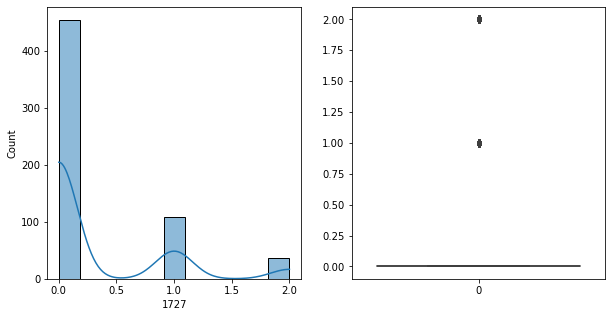

1727   Unique :  [1 0 2]
--------------------------------------------------------------------
1727   N unique :  3
--------------------------------------------------------------------
1727   Value Counts :  0    455
1    108
2     37
Name: 1727, dtype: int64
--------------------------------------------------------------------



[ 1728 ]
show_df_info :  1728


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


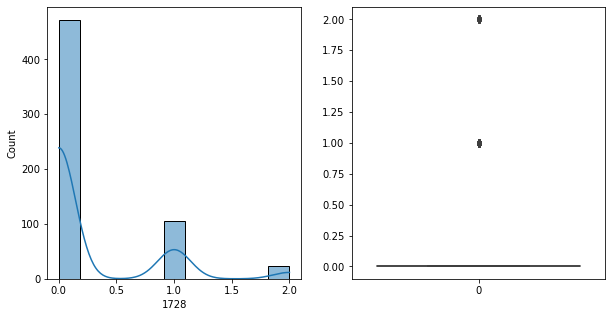

1728   Unique :  [0 1 2]
--------------------------------------------------------------------
1728   N unique :  3
--------------------------------------------------------------------
1728   Value Counts :  0    472
1    105
2     23
Name: 1728, dtype: int64
--------------------------------------------------------------------



[ 1729 ]
show_df_info :  1729


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


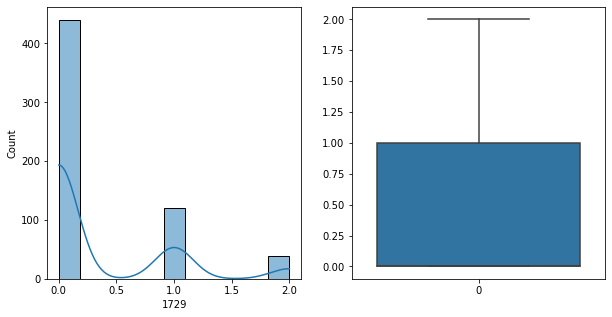

1729   Unique :  [0 1 2]
--------------------------------------------------------------------
1729   N unique :  3
--------------------------------------------------------------------
1729   Value Counts :  0    440
1    121
2     39
Name: 1729, dtype: int64
--------------------------------------------------------------------



[ 1730 ]
show_df_info :  1730


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


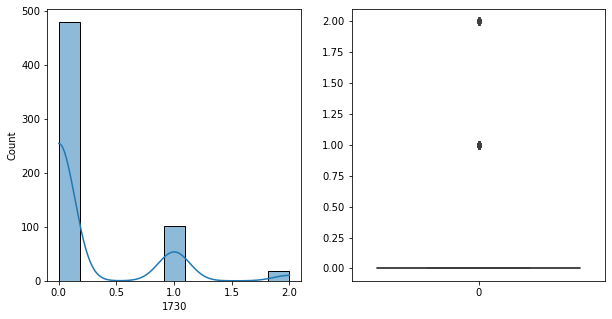

1730   Unique :  [1 0 2]
--------------------------------------------------------------------
1730   N unique :  3
--------------------------------------------------------------------
1730   Value Counts :  0    480
1    101
2     19
Name: 1730, dtype: int64
--------------------------------------------------------------------



[ 1731 ]
show_df_info :  1731


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


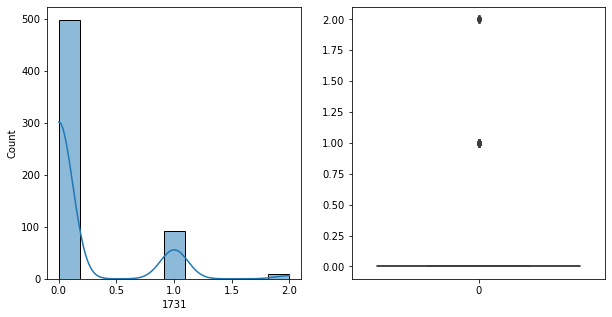

1731   Unique :  [1 0 2]
--------------------------------------------------------------------
1731   N unique :  3
--------------------------------------------------------------------
1731   Value Counts :  0    498
1     92
2     10
Name: 1731, dtype: int64
--------------------------------------------------------------------



[ 1732 ]
show_df_info :  1732


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


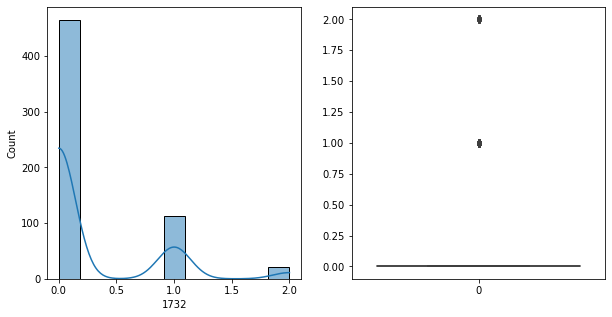

1732   Unique :  [1 0 2]
--------------------------------------------------------------------
1732   N unique :  3
--------------------------------------------------------------------
1732   Value Counts :  0    465
1    113
2     22
Name: 1732, dtype: int64
--------------------------------------------------------------------



[ 1733 ]
show_df_info :  1733


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


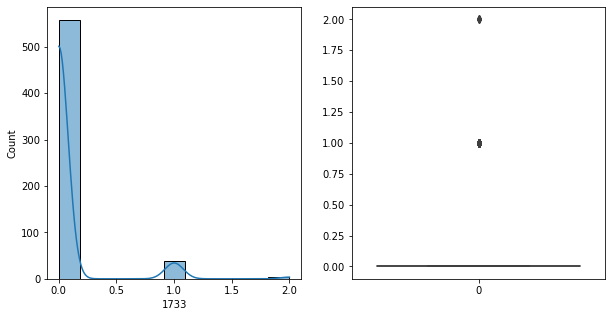

1733   Unique :  [0 1 2]
--------------------------------------------------------------------
1733   N unique :  3
--------------------------------------------------------------------
1733   Value Counts :  0    558
1     38
2      4
Name: 1733, dtype: int64
--------------------------------------------------------------------



[ 1734 ]
show_df_info :  1734


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


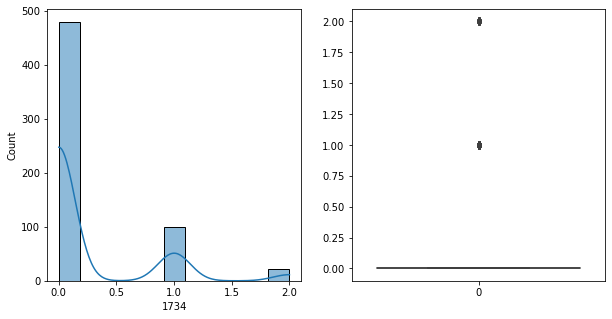

1734   Unique :  [0 1 2]
--------------------------------------------------------------------
1734   N unique :  3
--------------------------------------------------------------------
1734   Value Counts :  0    479
1     99
2     22
Name: 1734, dtype: int64
--------------------------------------------------------------------



[ 1735 ]
show_df_info :  1735


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


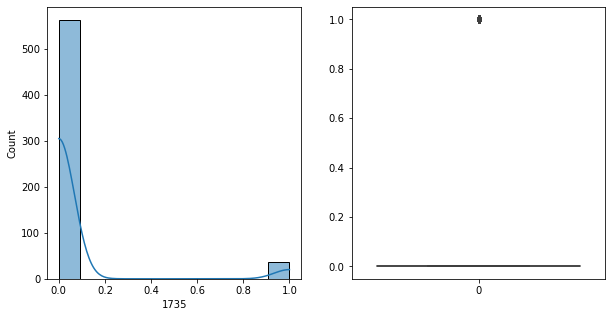

1735   Unique :  [1 0]
--------------------------------------------------------------------
1735   N unique :  2
--------------------------------------------------------------------
1735   Value Counts :  0    563
1     37
Name: 1735, dtype: int64
--------------------------------------------------------------------



[ 1736 ]
show_df_info :  1736


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


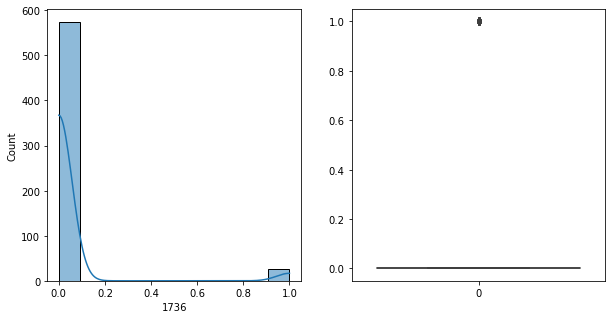

1736   Unique :  [0 1]
--------------------------------------------------------------------
1736   N unique :  2
--------------------------------------------------------------------
1736   Value Counts :  0    574
1     26
Name: 1736, dtype: int64
--------------------------------------------------------------------



[ 1737 ]
show_df_info :  1737


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


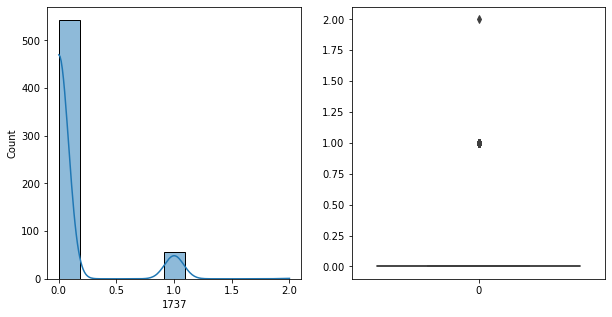

1737   Unique :  [0 1 2]
--------------------------------------------------------------------
1737   N unique :  3
--------------------------------------------------------------------
1737   Value Counts :  0    543
1     56
2      1
Name: 1737, dtype: int64
--------------------------------------------------------------------



[ 1738 ]
show_df_info :  1738


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


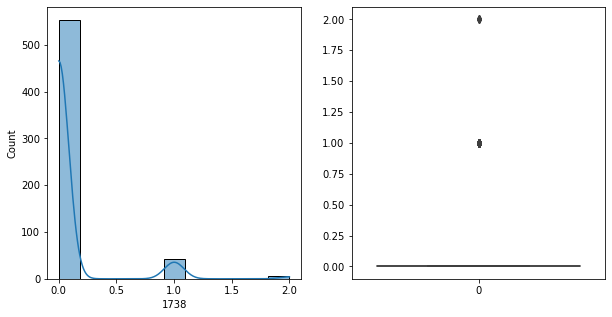

1738   Unique :  [0 1 2]
--------------------------------------------------------------------
1738   N unique :  3
--------------------------------------------------------------------
1738   Value Counts :  0    553
1     42
2      5
Name: 1738, dtype: int64
--------------------------------------------------------------------



[ 1739 ]
show_df_info :  1739


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


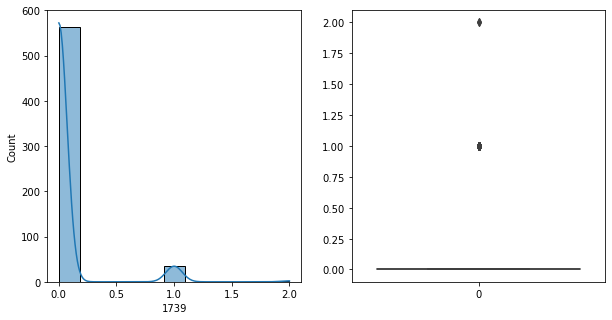

1739   Unique :  [0 1 2]
--------------------------------------------------------------------
1739   N unique :  3
--------------------------------------------------------------------
1739   Value Counts :  0    564
1     34
2      2
Name: 1739, dtype: int64
--------------------------------------------------------------------



[ 1740 ]
show_df_info :  1740


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


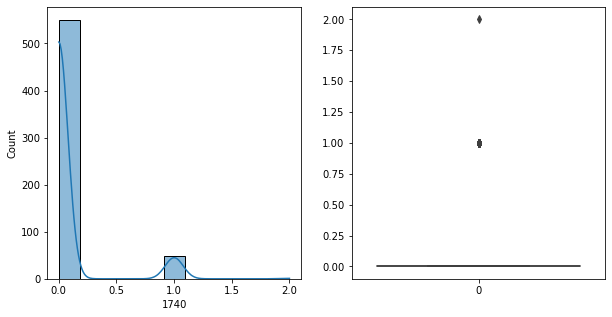

1740   Unique :  [0 1 2]
--------------------------------------------------------------------
1740   N unique :  3
--------------------------------------------------------------------
1740   Value Counts :  0    550
1     49
2      1
Name: 1740, dtype: int64
--------------------------------------------------------------------



[ 1741 ]
show_df_info :  1741


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


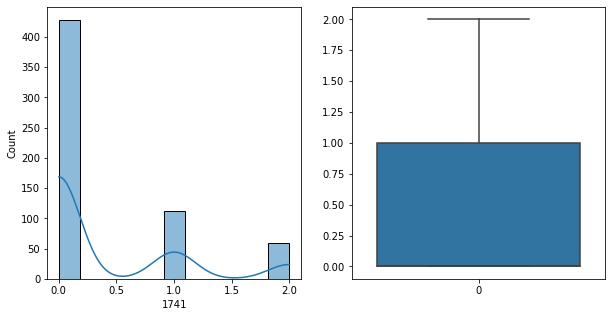

1741   Unique :  [2 0 1]
--------------------------------------------------------------------
1741   N unique :  3
--------------------------------------------------------------------
1741   Value Counts :  0    428
1    112
2     60
Name: 1741, dtype: int64
--------------------------------------------------------------------



[ 1742 ]
show_df_info :  1742


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


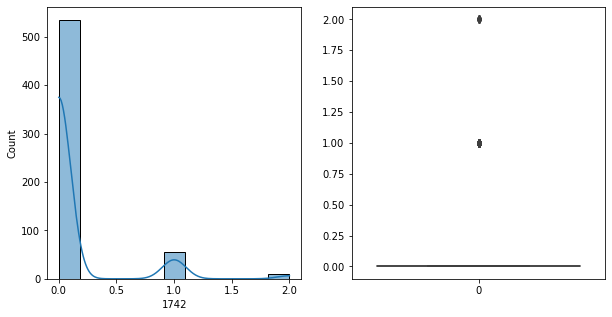

1742   Unique :  [0 1 2]
--------------------------------------------------------------------
1742   N unique :  3
--------------------------------------------------------------------
1742   Value Counts :  0    535
1     56
2      9
Name: 1742, dtype: int64
--------------------------------------------------------------------



[ 1743 ]
show_df_info :  1743


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


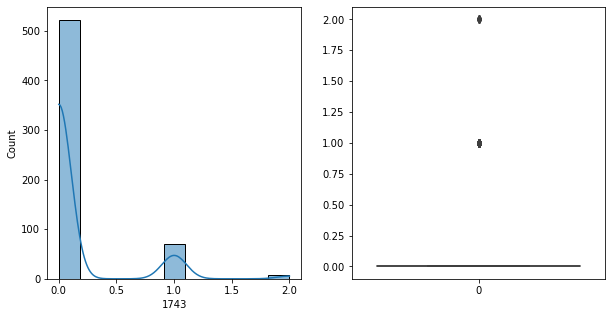

1743   Unique :  [2 0 1]
--------------------------------------------------------------------
1743   N unique :  3
--------------------------------------------------------------------
1743   Value Counts :  0    522
1     70
2      8
Name: 1743, dtype: int64
--------------------------------------------------------------------



[ 1744 ]
show_df_info :  1744


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


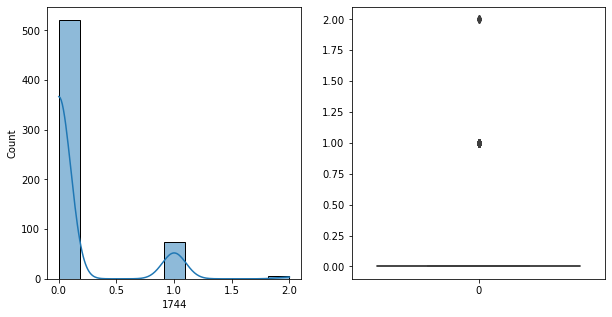

1744   Unique :  [1 0 2]
--------------------------------------------------------------------
1744   N unique :  3
--------------------------------------------------------------------
1744   Value Counts :  0    521
1     74
2      5
Name: 1744, dtype: int64
--------------------------------------------------------------------



[ 1745 ]
show_df_info :  1745


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


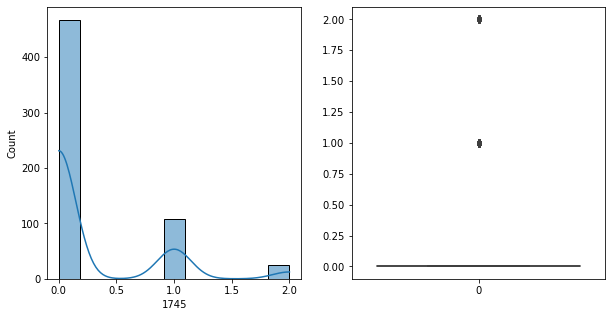

1745   Unique :  [0 1 2]
--------------------------------------------------------------------
1745   N unique :  3
--------------------------------------------------------------------
1745   Value Counts :  0    467
1    108
2     25
Name: 1745, dtype: int64
--------------------------------------------------------------------



[ 1746 ]
show_df_info :  1746


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


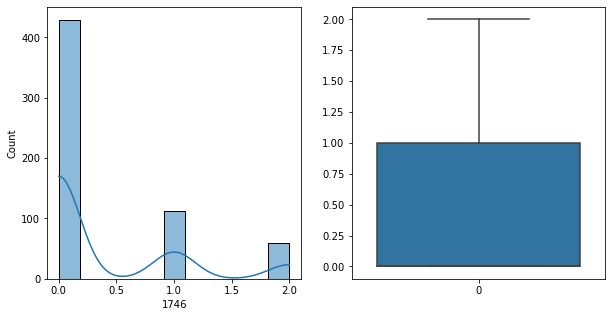

1746   Unique :  [1 0 2]
--------------------------------------------------------------------
1746   N unique :  3
--------------------------------------------------------------------
1746   Value Counts :  0    429
1    112
2     59
Name: 1746, dtype: int64
--------------------------------------------------------------------



[ 1747 ]
show_df_info :  1747


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


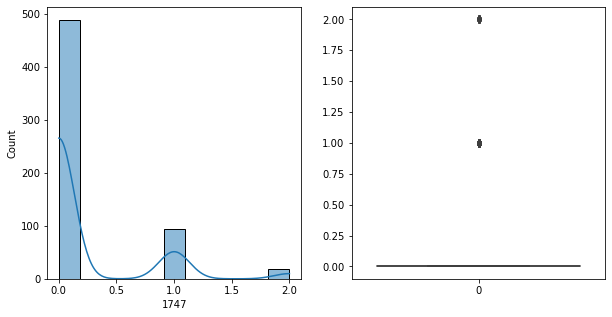

1747   Unique :  [0 1 2]
--------------------------------------------------------------------
1747   N unique :  3
--------------------------------------------------------------------
1747   Value Counts :  0    488
1     94
2     18
Name: 1747, dtype: int64
--------------------------------------------------------------------



[ 1748 ]
show_df_info :  1748


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


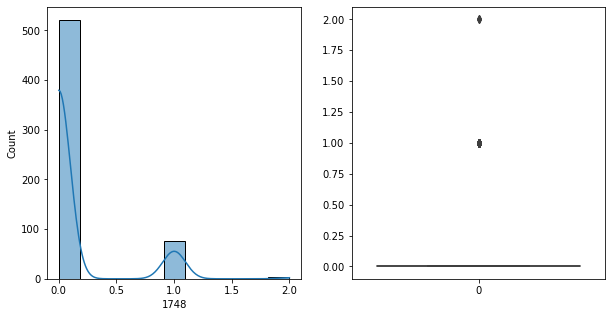

1748   Unique :  [0 1 2]
--------------------------------------------------------------------
1748   N unique :  3
--------------------------------------------------------------------
1748   Value Counts :  0    521
1     76
2      3
Name: 1748, dtype: int64
--------------------------------------------------------------------



[ 1749 ]
show_df_info :  1749


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


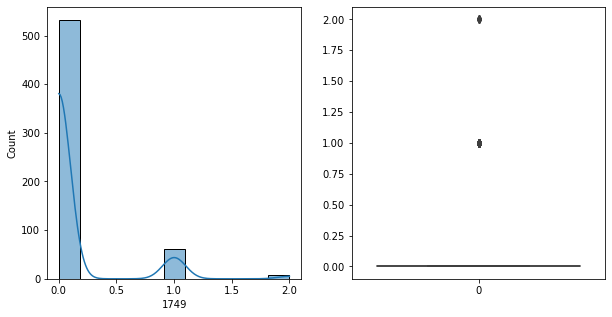

1749   Unique :  [1 0 2]
--------------------------------------------------------------------
1749   N unique :  3
--------------------------------------------------------------------
1749   Value Counts :  0    532
1     61
2      7
Name: 1749, dtype: int64
--------------------------------------------------------------------



[ 1750 ]
show_df_info :  1750


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


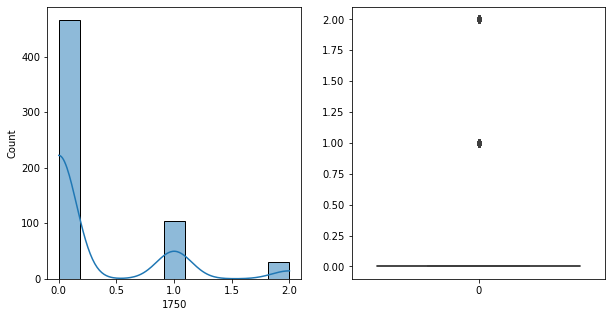

1750   Unique :  [0 1 2]
--------------------------------------------------------------------
1750   N unique :  3
--------------------------------------------------------------------
1750   Value Counts :  0    466
1    104
2     30
Name: 1750, dtype: int64
--------------------------------------------------------------------



[ 1751 ]
show_df_info :  1751


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


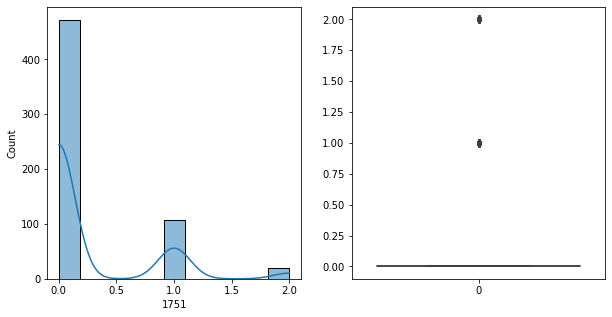

1751   Unique :  [0 1 2]
--------------------------------------------------------------------
1751   N unique :  3
--------------------------------------------------------------------
1751   Value Counts :  0    472
1    108
2     20
Name: 1751, dtype: int64
--------------------------------------------------------------------



[ 1752 ]
show_df_info :  1752


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


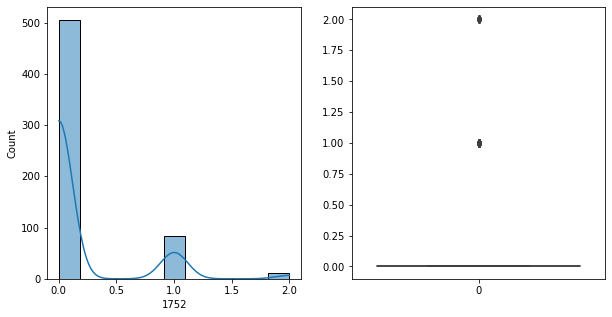

1752   Unique :  [0 1 2]
--------------------------------------------------------------------
1752   N unique :  3
--------------------------------------------------------------------
1752   Value Counts :  0    505
1     84
2     11
Name: 1752, dtype: int64
--------------------------------------------------------------------



[ 1753 ]
show_df_info :  1753


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


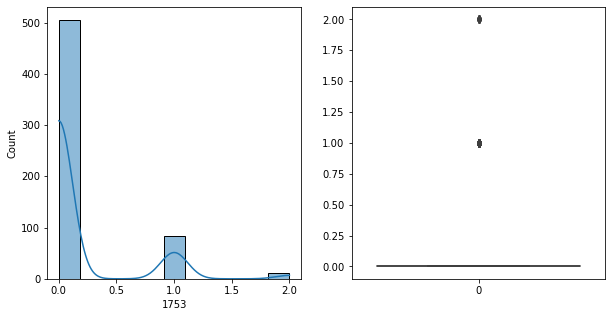

1753   Unique :  [0 1 2]
--------------------------------------------------------------------
1753   N unique :  3
--------------------------------------------------------------------
1753   Value Counts :  0    505
1     84
2     11
Name: 1753, dtype: int64
--------------------------------------------------------------------



[ 1754 ]
show_df_info :  1754


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


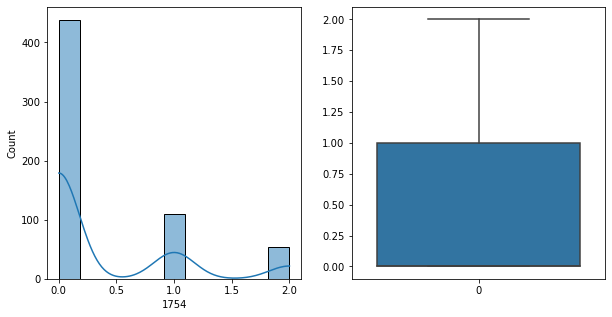

1754   Unique :  [2 0 1]
--------------------------------------------------------------------
1754   N unique :  3
--------------------------------------------------------------------
1754   Value Counts :  0    438
1    109
2     53
Name: 1754, dtype: int64
--------------------------------------------------------------------



[ 1755 ]
show_df_info :  1755


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


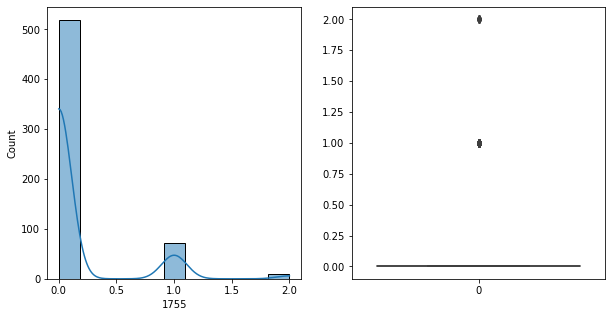

1755   Unique :  [1 0 2]
--------------------------------------------------------------------
1755   N unique :  3
--------------------------------------------------------------------
1755   Value Counts :  0    519
1     72
2      9
Name: 1755, dtype: int64
--------------------------------------------------------------------



[ 1756 ]
show_df_info :  1756


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


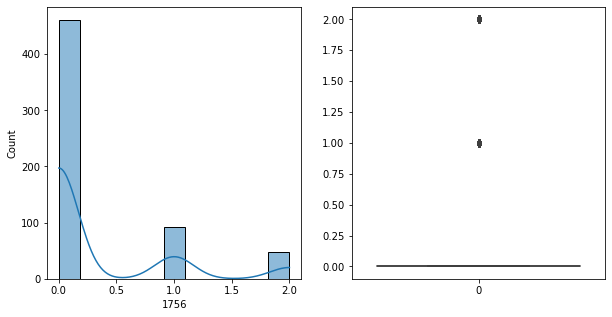

1756   Unique :  [1 0 2]
--------------------------------------------------------------------
1756   N unique :  3
--------------------------------------------------------------------
1756   Value Counts :  0    461
1     92
2     47
Name: 1756, dtype: int64
--------------------------------------------------------------------



[ 1757 ]
show_df_info :  1757


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


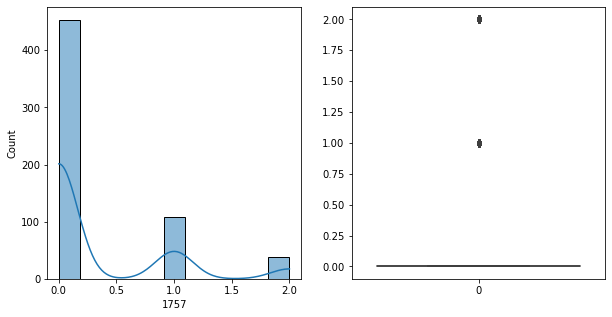

1757   Unique :  [1 0 2]
--------------------------------------------------------------------
1757   N unique :  3
--------------------------------------------------------------------
1757   Value Counts :  0    453
1    108
2     39
Name: 1757, dtype: int64
--------------------------------------------------------------------



[ 1758 ]
show_df_info :  1758


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


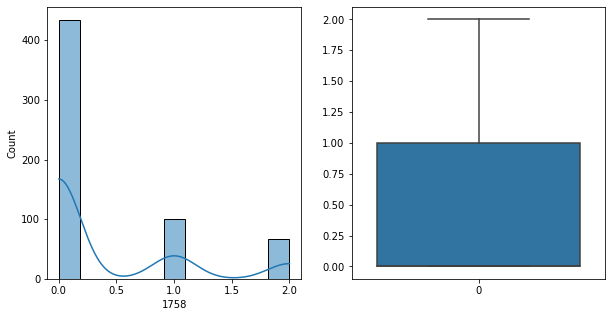

1758   Unique :  [2 0 1]
--------------------------------------------------------------------
1758   N unique :  3
--------------------------------------------------------------------
1758   Value Counts :  0    434
1    100
2     66
Name: 1758, dtype: int64
--------------------------------------------------------------------



[ 1759 ]
show_df_info :  1759


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


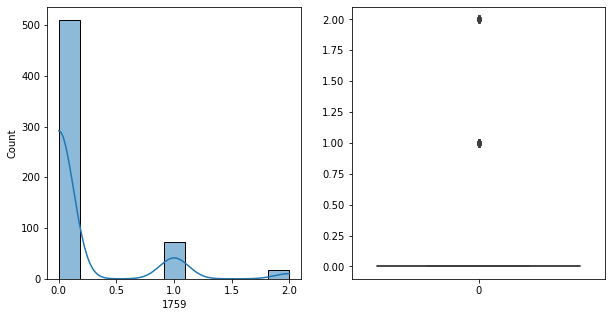

1759   Unique :  [0 1 2]
--------------------------------------------------------------------
1759   N unique :  3
--------------------------------------------------------------------
1759   Value Counts :  0    510
1     72
2     18
Name: 1759, dtype: int64
--------------------------------------------------------------------



[ 1760 ]
show_df_info :  1760


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


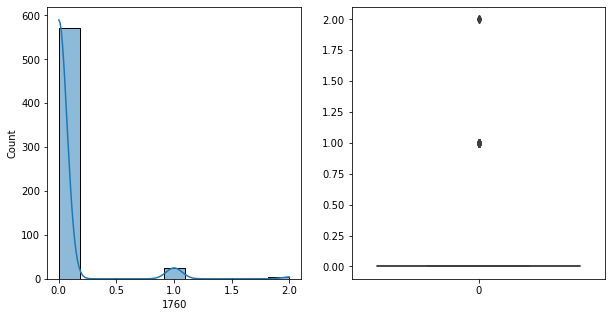

1760   Unique :  [0 1 2]
--------------------------------------------------------------------
1760   N unique :  3
--------------------------------------------------------------------
1760   Value Counts :  0    572
1     24
2      4
Name: 1760, dtype: int64
--------------------------------------------------------------------



[ 1761 ]
show_df_info :  1761


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


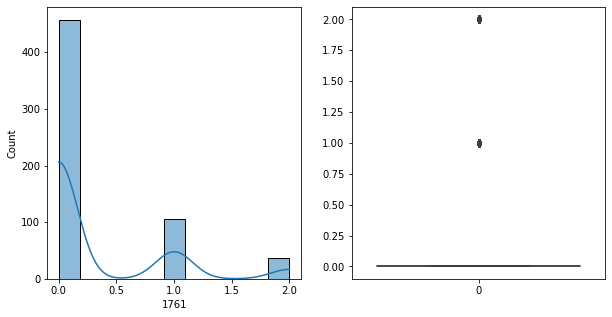

1761   Unique :  [1 0 2]
--------------------------------------------------------------------
1761   N unique :  3
--------------------------------------------------------------------
1761   Value Counts :  0    457
1    106
2     37
Name: 1761, dtype: int64
--------------------------------------------------------------------



[ 1762 ]
show_df_info :  1762


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


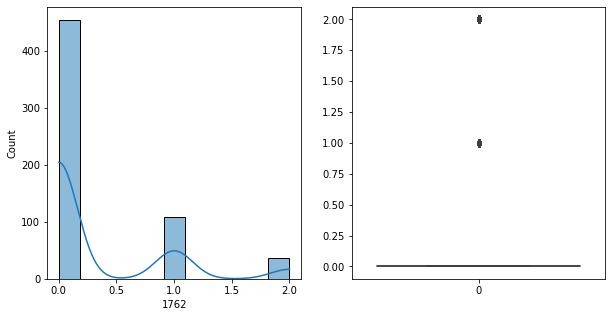

1762   Unique :  [1 0 2]
--------------------------------------------------------------------
1762   N unique :  3
--------------------------------------------------------------------
1762   Value Counts :  0    454
1    109
2     37
Name: 1762, dtype: int64
--------------------------------------------------------------------



[ 1763 ]
show_df_info :  1763


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


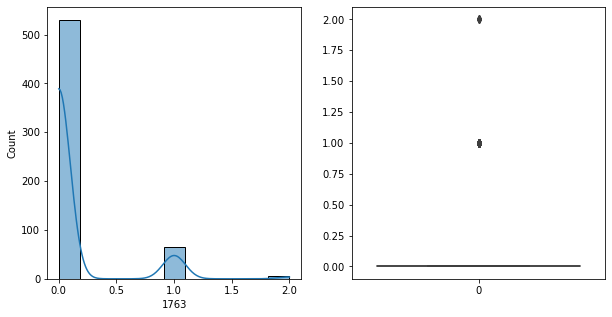

1763   Unique :  [1 0 2]
--------------------------------------------------------------------
1763   N unique :  3
--------------------------------------------------------------------
1763   Value Counts :  0    530
1     65
2      5
Name: 1763, dtype: int64
--------------------------------------------------------------------



[ 1764 ]
show_df_info :  1764


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


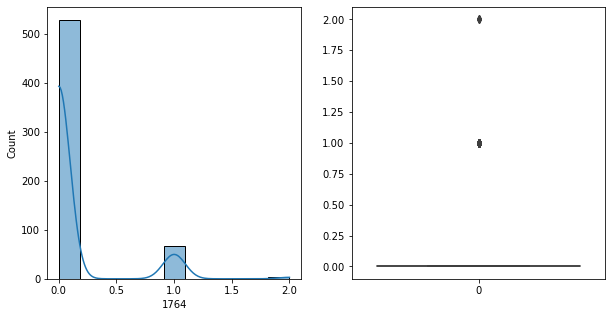

1764   Unique :  [1 0 2]
--------------------------------------------------------------------
1764   N unique :  3
--------------------------------------------------------------------
1764   Value Counts :  0    529
1     67
2      4
Name: 1764, dtype: int64
--------------------------------------------------------------------



[ 1765 ]
show_df_info :  1765


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


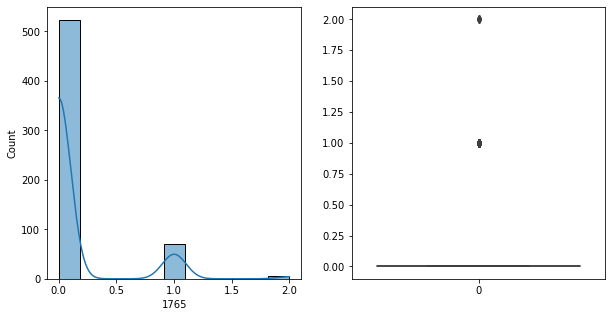

1765   Unique :  [1 0 2]
--------------------------------------------------------------------
1765   N unique :  3
--------------------------------------------------------------------
1765   Value Counts :  0    523
1     71
2      6
Name: 1765, dtype: int64
--------------------------------------------------------------------



[ 1766 ]
show_df_info :  1766


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


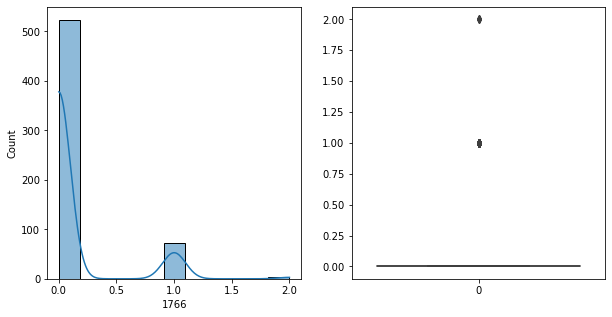

1766   Unique :  [1 0 2]
--------------------------------------------------------------------
1766   N unique :  3
--------------------------------------------------------------------
1766   Value Counts :  0    523
1     73
2      4
Name: 1766, dtype: int64
--------------------------------------------------------------------



[ 1767 ]
show_df_info :  1767


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


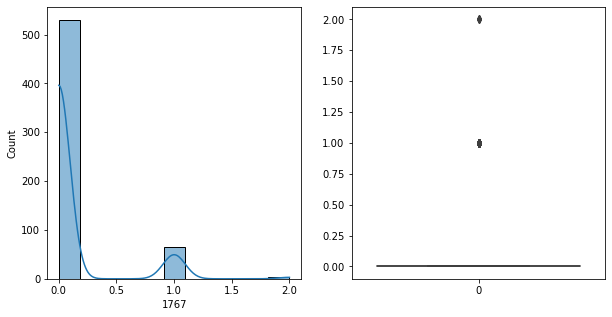

1767   Unique :  [1 0 2]
--------------------------------------------------------------------
1767   N unique :  3
--------------------------------------------------------------------
1767   Value Counts :  0    530
1     66
2      4
Name: 1767, dtype: int64
--------------------------------------------------------------------



[ 1768 ]
show_df_info :  1768


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


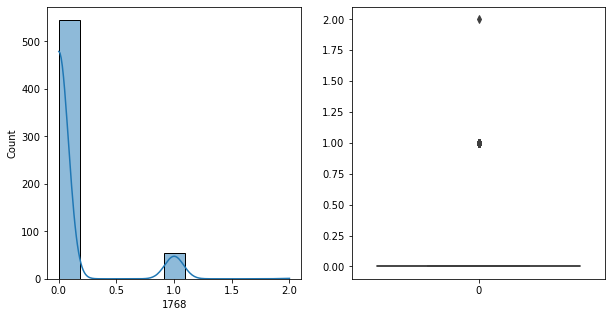

1768   Unique :  [1 0 2]
--------------------------------------------------------------------
1768   N unique :  3
--------------------------------------------------------------------
1768   Value Counts :  0    545
1     54
2      1
Name: 1768, dtype: int64
--------------------------------------------------------------------



[ 1769 ]
show_df_info :  1769


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


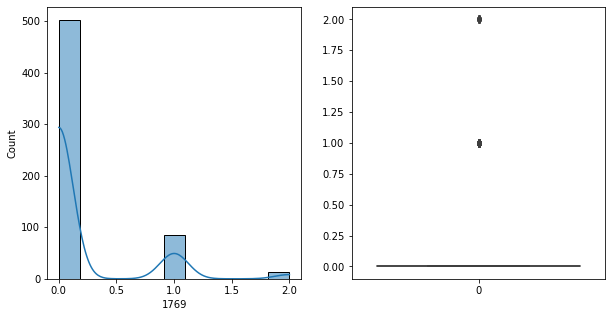

1769   Unique :  [1 0 2]
--------------------------------------------------------------------
1769   N unique :  3
--------------------------------------------------------------------
1769   Value Counts :  0    502
1     84
2     14
Name: 1769, dtype: int64
--------------------------------------------------------------------



[ 1770 ]
show_df_info :  1770


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


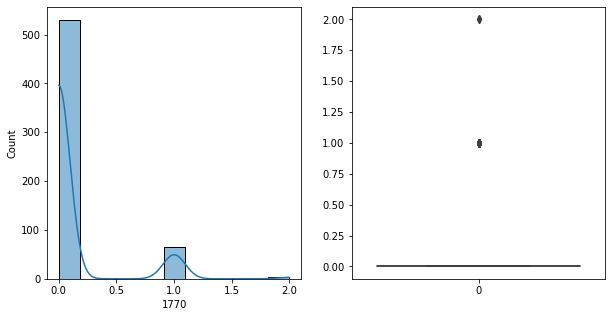

1770   Unique :  [1 0 2]
--------------------------------------------------------------------
1770   N unique :  3
--------------------------------------------------------------------
1770   Value Counts :  0    530
1     66
2      4
Name: 1770, dtype: int64
--------------------------------------------------------------------



[ 1771 ]
show_df_info :  1771


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


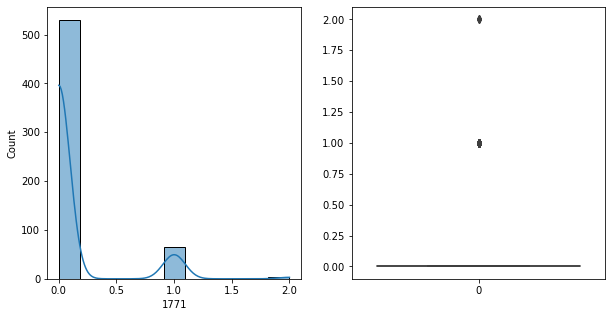

1771   Unique :  [1 0 2]
--------------------------------------------------------------------
1771   N unique :  3
--------------------------------------------------------------------
1771   Value Counts :  0    530
1     66
2      4
Name: 1771, dtype: int64
--------------------------------------------------------------------



[ 1772 ]
show_df_info :  1772


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


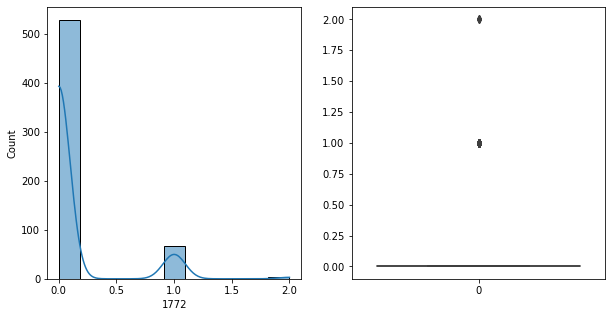

1772   Unique :  [1 0 2]
--------------------------------------------------------------------
1772   N unique :  3
--------------------------------------------------------------------
1772   Value Counts :  0    529
1     67
2      4
Name: 1772, dtype: int64
--------------------------------------------------------------------



[ 1773 ]
show_df_info :  1773


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


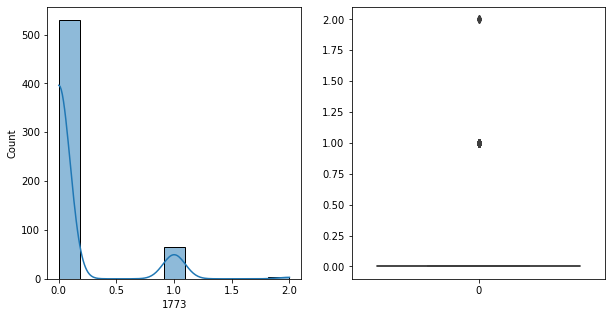

1773   Unique :  [1 0 2]
--------------------------------------------------------------------
1773   N unique :  3
--------------------------------------------------------------------
1773   Value Counts :  0    530
1     66
2      4
Name: 1773, dtype: int64
--------------------------------------------------------------------



[ 1774 ]
show_df_info :  1774


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


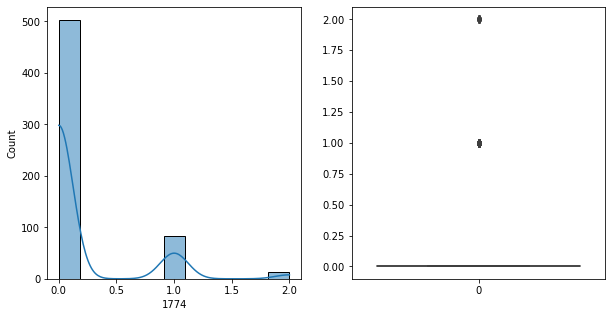

1774   Unique :  [1 0 2]
--------------------------------------------------------------------
1774   N unique :  3
--------------------------------------------------------------------
1774   Value Counts :  0    503
1     84
2     13
Name: 1774, dtype: int64
--------------------------------------------------------------------



[ 1775 ]
show_df_info :  1775


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


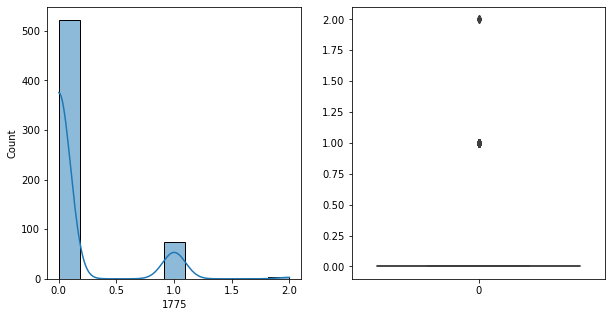

1775   Unique :  [1 0 2]
--------------------------------------------------------------------
1775   N unique :  3
--------------------------------------------------------------------
1775   Value Counts :  0    522
1     74
2      4
Name: 1775, dtype: int64
--------------------------------------------------------------------



[ 1776 ]
show_df_info :  1776


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


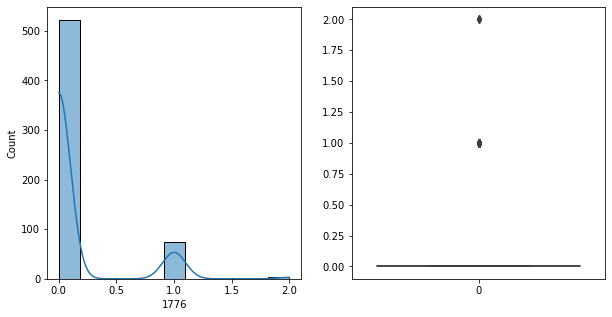

1776   Unique :  [1 0 2]
--------------------------------------------------------------------
1776   N unique :  3
--------------------------------------------------------------------
1776   Value Counts :  0    522
1     74
2      4
Name: 1776, dtype: int64
--------------------------------------------------------------------



[ 1777 ]
show_df_info :  1777


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


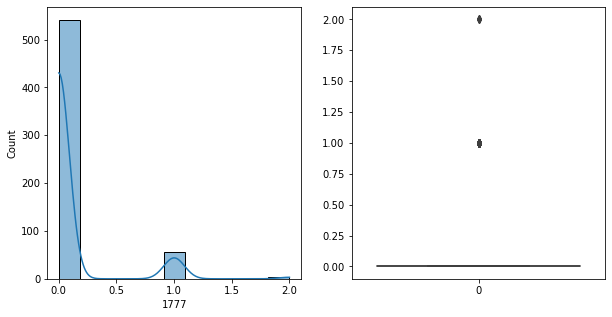

1777   Unique :  [0 1 2]
--------------------------------------------------------------------
1777   N unique :  3
--------------------------------------------------------------------
1777   Value Counts :  0    541
1     55
2      4
Name: 1777, dtype: int64
--------------------------------------------------------------------



[ 1778 ]
show_df_info :  1778


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


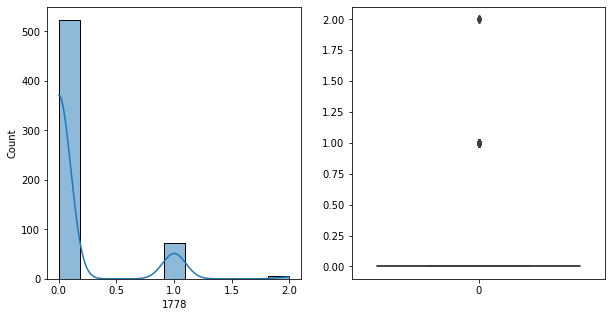

1778   Unique :  [1 0 2]
--------------------------------------------------------------------
1778   N unique :  3
--------------------------------------------------------------------
1778   Value Counts :  0    523
1     72
2      5
Name: 1778, dtype: int64
--------------------------------------------------------------------



[ 1779 ]
show_df_info :  1779


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


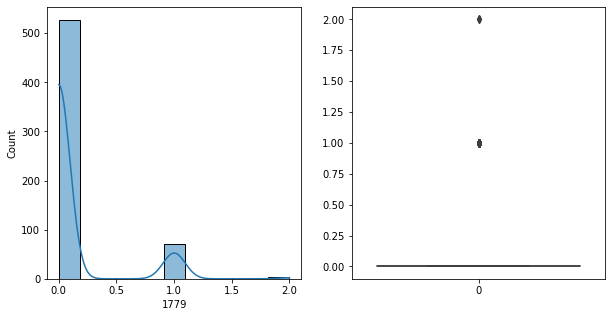

1779   Unique :  [1 0 2]
--------------------------------------------------------------------
1779   N unique :  3
--------------------------------------------------------------------
1779   Value Counts :  0    527
1     70
2      3
Name: 1779, dtype: int64
--------------------------------------------------------------------



[ 1780 ]
show_df_info :  1780


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


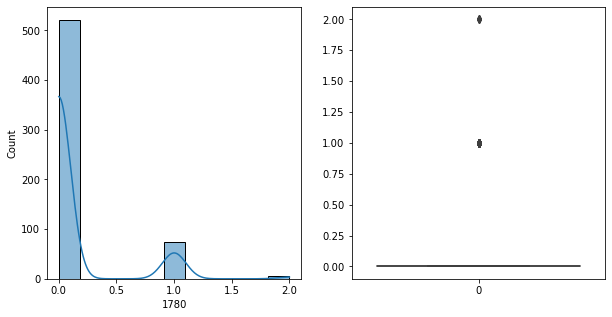

1780   Unique :  [1 0 2]
--------------------------------------------------------------------
1780   N unique :  3
--------------------------------------------------------------------
1780   Value Counts :  0    521
1     74
2      5
Name: 1780, dtype: int64
--------------------------------------------------------------------



[ 1781 ]
show_df_info :  1781


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


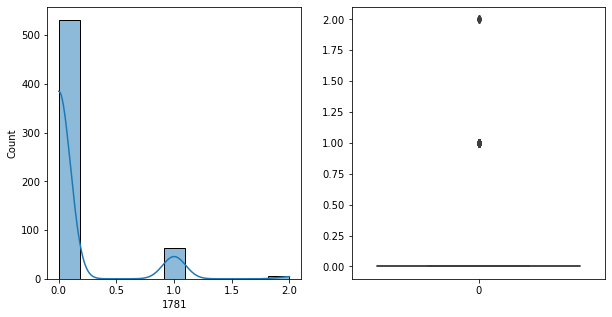

1781   Unique :  [1 0 2]
--------------------------------------------------------------------
1781   N unique :  3
--------------------------------------------------------------------
1781   Value Counts :  0    531
1     63
2      6
Name: 1781, dtype: int64
--------------------------------------------------------------------



[ 1782 ]
show_df_info :  1782


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


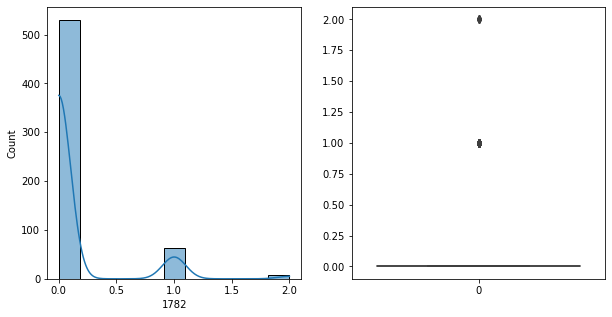

1782   Unique :  [1 0 2]
--------------------------------------------------------------------
1782   N unique :  3
--------------------------------------------------------------------
1782   Value Counts :  0    530
1     63
2      7
Name: 1782, dtype: int64
--------------------------------------------------------------------



[ 1783 ]
show_df_info :  1783


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


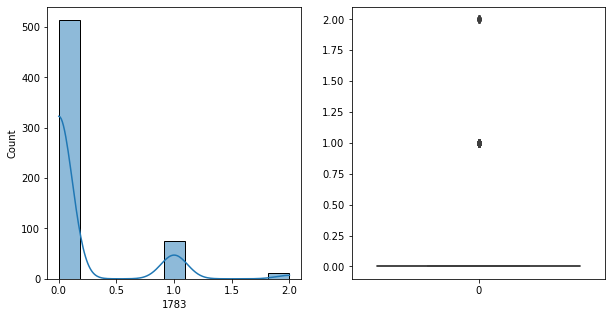

1783   Unique :  [0 1 2]
--------------------------------------------------------------------
1783   N unique :  3
--------------------------------------------------------------------
1783   Value Counts :  0    514
1     75
2     11
Name: 1783, dtype: int64
--------------------------------------------------------------------



[ 1784 ]
show_df_info :  1784


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


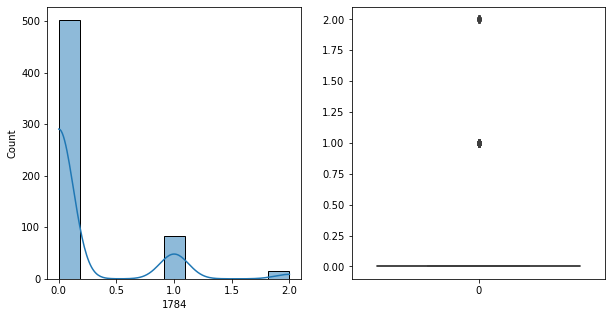

1784   Unique :  [0 1 2]
--------------------------------------------------------------------
1784   N unique :  3
--------------------------------------------------------------------
1784   Value Counts :  0    502
1     83
2     15
Name: 1784, dtype: int64
--------------------------------------------------------------------



[ 1785 ]
show_df_info :  1785


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


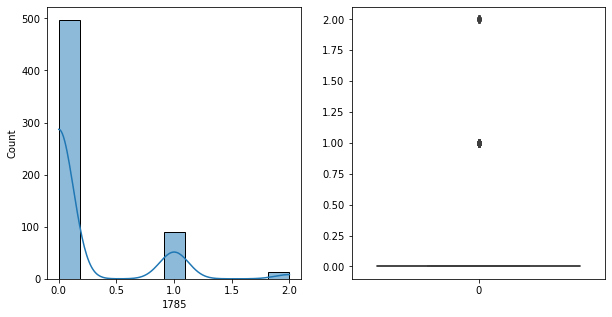

1785   Unique :  [1 0 2]
--------------------------------------------------------------------
1785   N unique :  3
--------------------------------------------------------------------
1785   Value Counts :  0    497
1     89
2     14
Name: 1785, dtype: int64
--------------------------------------------------------------------



[ 1786 ]
show_df_info :  1786


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


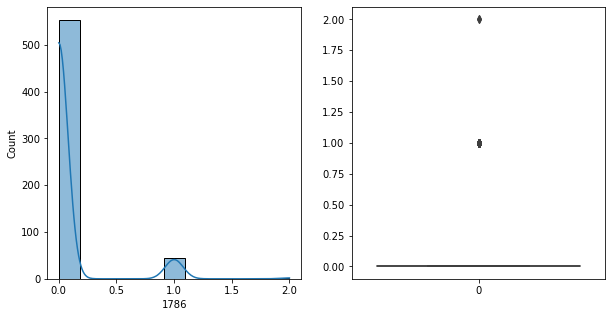

1786   Unique :  [0 1 2]
--------------------------------------------------------------------
1786   N unique :  3
--------------------------------------------------------------------
1786   Value Counts :  0    553
1     45
2      2
Name: 1786, dtype: int64
--------------------------------------------------------------------



[ 1787 ]
show_df_info :  1787


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


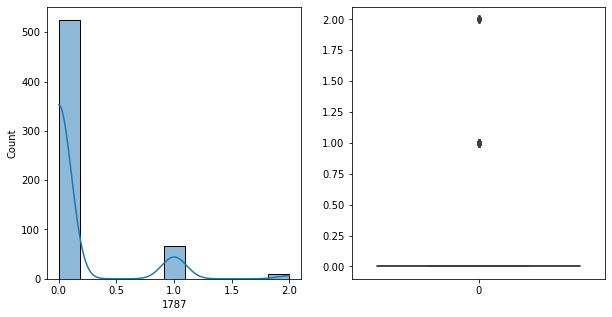

1787   Unique :  [0 1 2]
--------------------------------------------------------------------
1787   N unique :  3
--------------------------------------------------------------------
1787   Value Counts :  0    525
1     66
2      9
Name: 1787, dtype: int64
--------------------------------------------------------------------



[ 1788 ]
show_df_info :  1788


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


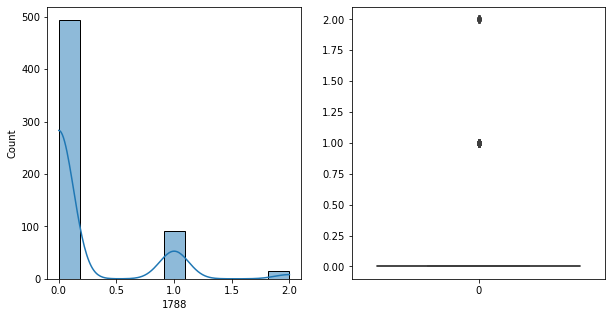

1788   Unique :  [1 0 2]
--------------------------------------------------------------------
1788   N unique :  3
--------------------------------------------------------------------
1788   Value Counts :  0    494
1     92
2     14
Name: 1788, dtype: int64
--------------------------------------------------------------------



[ 1789 ]
show_df_info :  1789


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


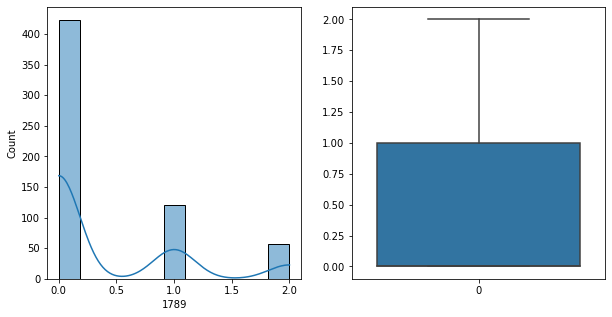

1789   Unique :  [1 0 2]
--------------------------------------------------------------------
1789   N unique :  3
--------------------------------------------------------------------
1789   Value Counts :  0    423
1    120
2     57
Name: 1789, dtype: int64
--------------------------------------------------------------------



[ 1790 ]
show_df_info :  1790


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


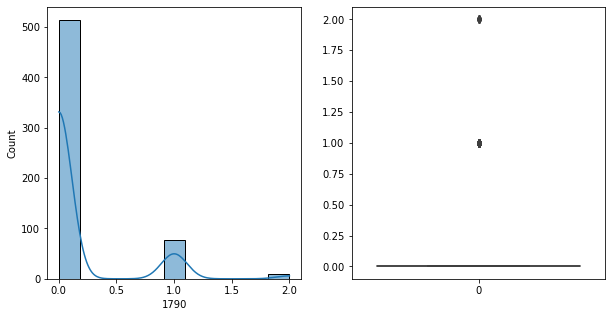

1790   Unique :  [0 1 2]
--------------------------------------------------------------------
1790   N unique :  3
--------------------------------------------------------------------
1790   Value Counts :  0    514
1     77
2      9
Name: 1790, dtype: int64
--------------------------------------------------------------------



[ 1791 ]
show_df_info :  1791


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


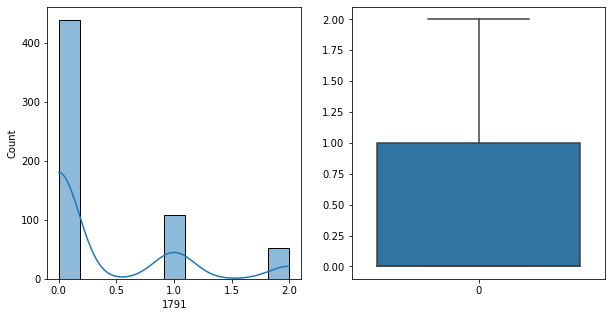

1791   Unique :  [1 0 2]
--------------------------------------------------------------------
1791   N unique :  3
--------------------------------------------------------------------
1791   Value Counts :  0    439
1    109
2     52
Name: 1791, dtype: int64
--------------------------------------------------------------------



[ 1792 ]
show_df_info :  1792


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


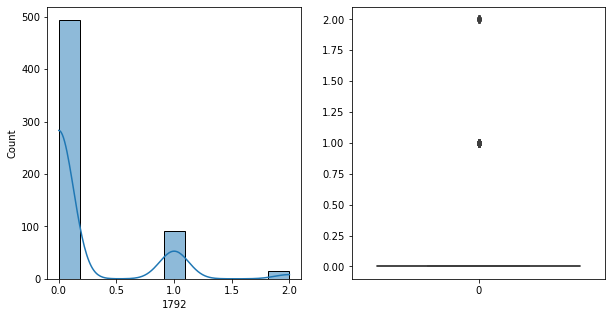

1792   Unique :  [1 0 2]
--------------------------------------------------------------------
1792   N unique :  3
--------------------------------------------------------------------
1792   Value Counts :  0    494
1     92
2     14
Name: 1792, dtype: int64
--------------------------------------------------------------------



[ 1793 ]
show_df_info :  1793


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


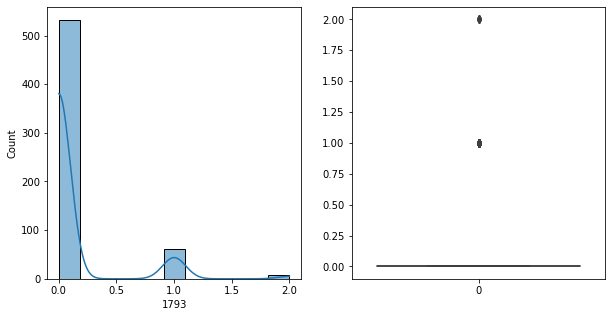

1793   Unique :  [1 0 2]
--------------------------------------------------------------------
1793   N unique :  3
--------------------------------------------------------------------
1793   Value Counts :  0    532
1     61
2      7
Name: 1793, dtype: int64
--------------------------------------------------------------------



[ 1794 ]
show_df_info :  1794


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


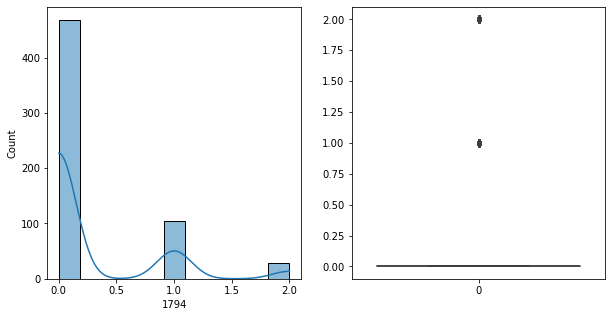

1794   Unique :  [1 0 2]
--------------------------------------------------------------------
1794   N unique :  3
--------------------------------------------------------------------
1794   Value Counts :  0    468
1    104
2     28
Name: 1794, dtype: int64
--------------------------------------------------------------------



[ 1795 ]
show_df_info :  1795


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


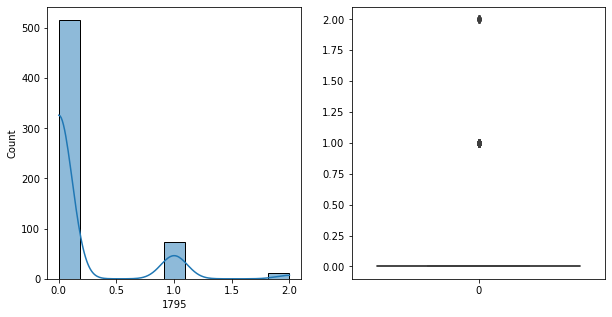

1795   Unique :  [0 1 2]
--------------------------------------------------------------------
1795   N unique :  3
--------------------------------------------------------------------
1795   Value Counts :  0    516
1     73
2     11
Name: 1795, dtype: int64
--------------------------------------------------------------------



[ 1796 ]
show_df_info :  1796


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


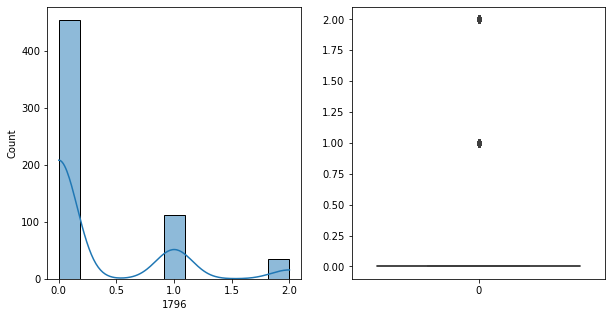

1796   Unique :  [1 0 2]
--------------------------------------------------------------------
1796   N unique :  3
--------------------------------------------------------------------
1796   Value Counts :  0    454
1    112
2     34
Name: 1796, dtype: int64
--------------------------------------------------------------------



[ 1797 ]
show_df_info :  1797


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


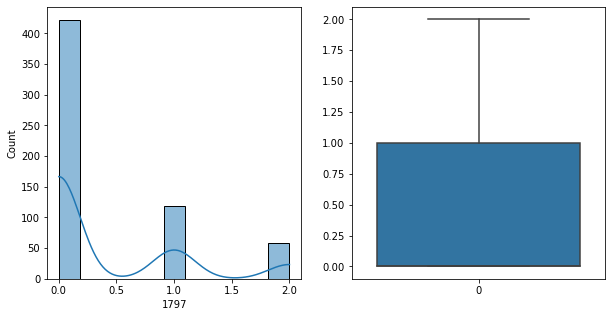

1797   Unique :  [1 0 2]
--------------------------------------------------------------------
1797   N unique :  3
--------------------------------------------------------------------
1797   Value Counts :  0    422
1    119
2     59
Name: 1797, dtype: int64
--------------------------------------------------------------------



[ 1798 ]
show_df_info :  1798


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


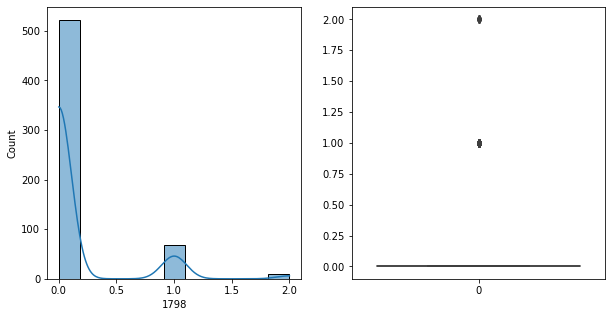

1798   Unique :  [0 1 2]
--------------------------------------------------------------------
1798   N unique :  3
--------------------------------------------------------------------
1798   Value Counts :  0    522
1     69
2      9
Name: 1798, dtype: int64
--------------------------------------------------------------------



[ 1799 ]
show_df_info :  1799


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


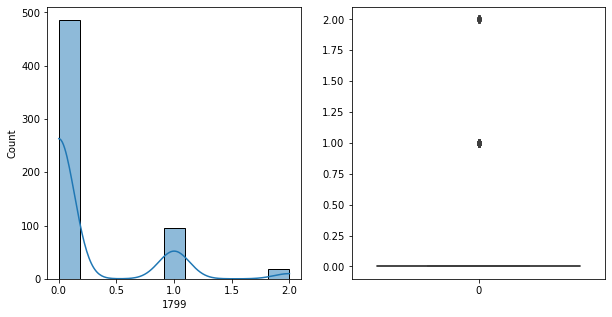

1799   Unique :  [1 0 2]
--------------------------------------------------------------------
1799   N unique :  3
--------------------------------------------------------------------
1799   Value Counts :  0    486
1     96
2     18
Name: 1799, dtype: int64
--------------------------------------------------------------------



[ 1800 ]
show_df_info :  1800


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


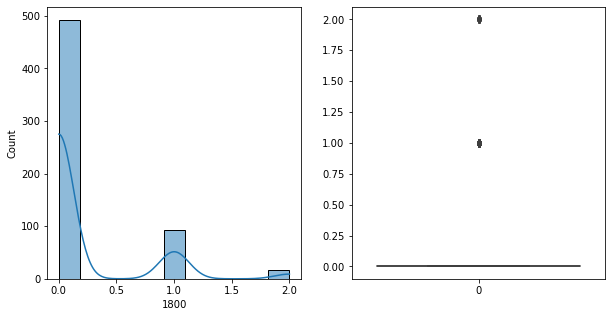

1800   Unique :  [1 0 2]
--------------------------------------------------------------------
1800   N unique :  3
--------------------------------------------------------------------
1800   Value Counts :  0    492
1     92
2     16
Name: 1800, dtype: int64
--------------------------------------------------------------------



[ 1801 ]
show_df_info :  1801


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


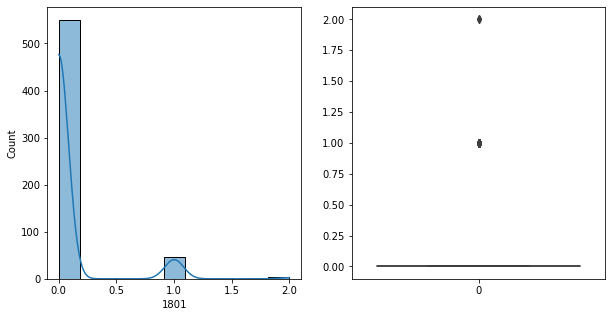

1801   Unique :  [0 1 2]
--------------------------------------------------------------------
1801   N unique :  3
--------------------------------------------------------------------
1801   Value Counts :  0    550
1     47
2      3
Name: 1801, dtype: int64
--------------------------------------------------------------------



[ 1802 ]
show_df_info :  1802


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


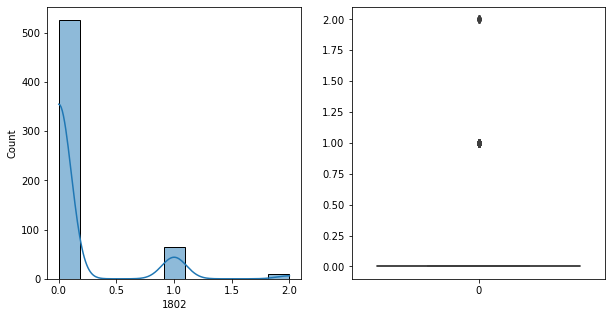

1802   Unique :  [0 1 2]
--------------------------------------------------------------------
1802   N unique :  3
--------------------------------------------------------------------
1802   Value Counts :  0    526
1     65
2      9
Name: 1802, dtype: int64
--------------------------------------------------------------------



[ 1803 ]
show_df_info :  1803


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


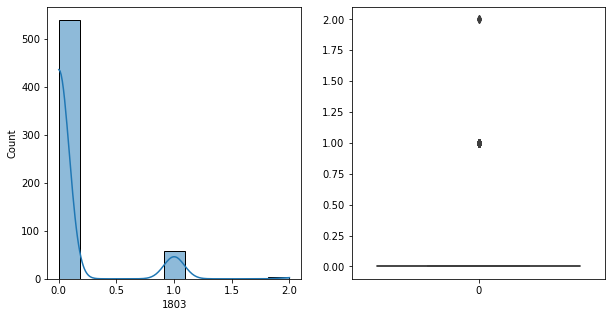

1803   Unique :  [0 1 2]
--------------------------------------------------------------------
1803   N unique :  3
--------------------------------------------------------------------
1803   Value Counts :  0    540
1     57
2      3
Name: 1803, dtype: int64
--------------------------------------------------------------------



[ 1804 ]
show_df_info :  1804


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


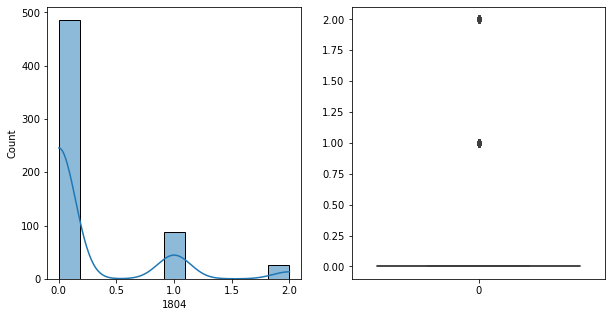

1804   Unique :  [0 1 2]
--------------------------------------------------------------------
1804   N unique :  3
--------------------------------------------------------------------
1804   Value Counts :  0    486
1     88
2     26
Name: 1804, dtype: int64
--------------------------------------------------------------------



[ 1805 ]
show_df_info :  1805


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


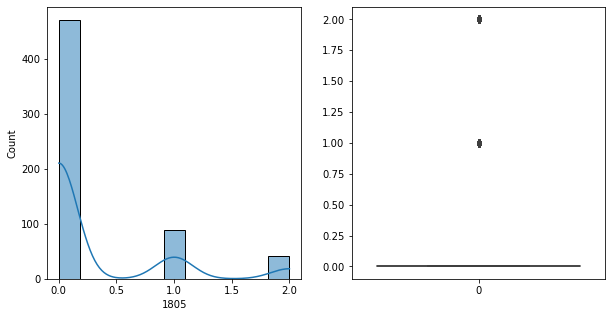

1805   Unique :  [0 1 2]
--------------------------------------------------------------------
1805   N unique :  3
--------------------------------------------------------------------
1805   Value Counts :  0    471
1     88
2     41
Name: 1805, dtype: int64
--------------------------------------------------------------------



[ 1806 ]
show_df_info :  1806


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


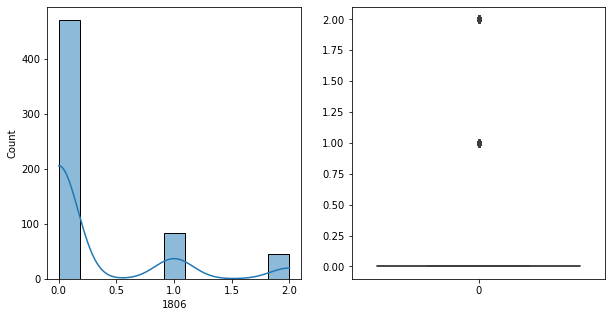

1806   Unique :  [0 1 2]
--------------------------------------------------------------------
1806   N unique :  3
--------------------------------------------------------------------
1806   Value Counts :  0    471
1     84
2     45
Name: 1806, dtype: int64
--------------------------------------------------------------------



[ 1807 ]
show_df_info :  1807


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


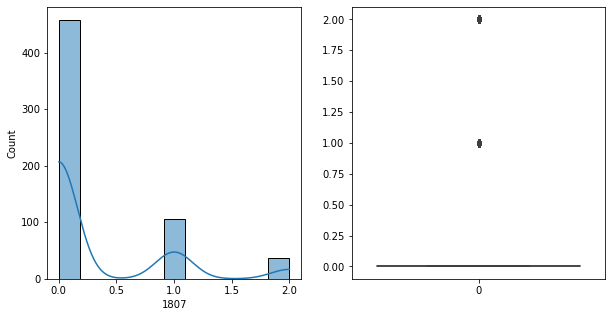

1807   Unique :  [0 1 2]
--------------------------------------------------------------------
1807   N unique :  3
--------------------------------------------------------------------
1807   Value Counts :  0    458
1    105
2     37
Name: 1807, dtype: int64
--------------------------------------------------------------------



[ 1808 ]
show_df_info :  1808


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


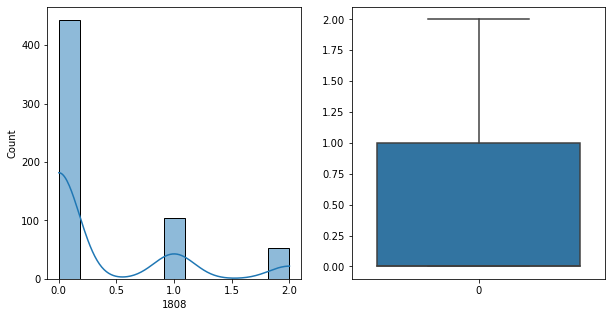

1808   Unique :  [1 0 2]
--------------------------------------------------------------------
1808   N unique :  3
--------------------------------------------------------------------
1808   Value Counts :  0    443
1    104
2     53
Name: 1808, dtype: int64
--------------------------------------------------------------------



[ 1809 ]
show_df_info :  1809


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


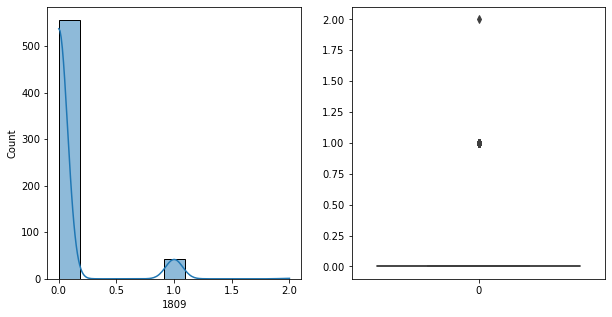

1809   Unique :  [1 0 2]
--------------------------------------------------------------------
1809   N unique :  3
--------------------------------------------------------------------
1809   Value Counts :  0    556
1     43
2      1
Name: 1809, dtype: int64
--------------------------------------------------------------------



[ 1810 ]
show_df_info :  1810


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


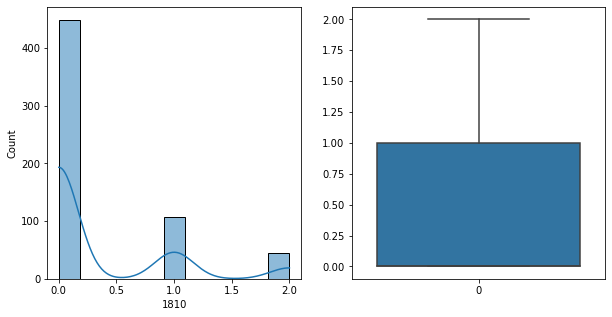

1810   Unique :  [0 1 2]
--------------------------------------------------------------------
1810   N unique :  3
--------------------------------------------------------------------
1810   Value Counts :  0    449
1    107
2     44
Name: 1810, dtype: int64
--------------------------------------------------------------------



[ 1811 ]
show_df_info :  1811


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


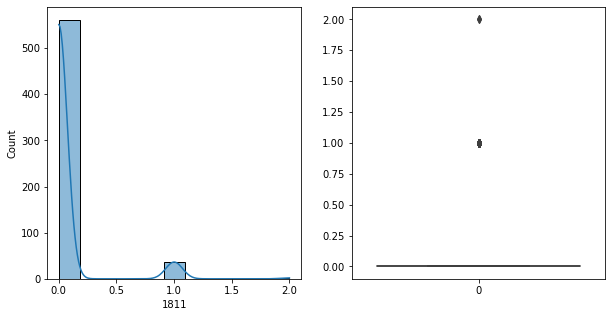

1811   Unique :  [1 0 2]
--------------------------------------------------------------------
1811   N unique :  3
--------------------------------------------------------------------
1811   Value Counts :  0    561
1     37
2      2
Name: 1811, dtype: int64
--------------------------------------------------------------------



[ 1812 ]
show_df_info :  1812


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


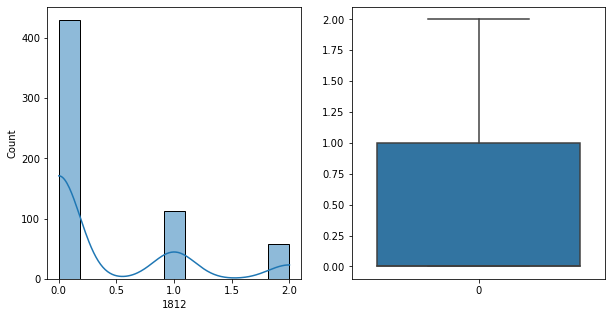

1812   Unique :  [1 0 2]
--------------------------------------------------------------------
1812   N unique :  3
--------------------------------------------------------------------
1812   Value Counts :  0    430
1    112
2     58
Name: 1812, dtype: int64
--------------------------------------------------------------------



[ 1813 ]
show_df_info :  1813


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


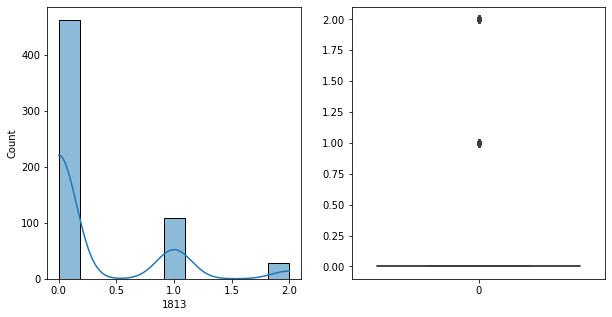

1813   Unique :  [0 1 2]
--------------------------------------------------------------------
1813   N unique :  3
--------------------------------------------------------------------
1813   Value Counts :  0    462
1    109
2     29
Name: 1813, dtype: int64
--------------------------------------------------------------------



[ 1814 ]
show_df_info :  1814


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


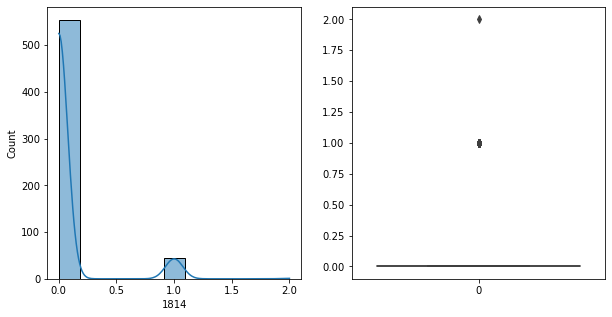

1814   Unique :  [1 0 2]
--------------------------------------------------------------------
1814   N unique :  3
--------------------------------------------------------------------
1814   Value Counts :  0    554
1     45
2      1
Name: 1814, dtype: int64
--------------------------------------------------------------------



[ 1815 ]
show_df_info :  1815


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


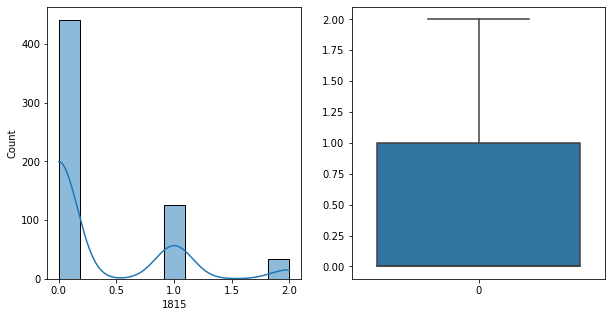

1815   Unique :  [0 2 1]
--------------------------------------------------------------------
1815   N unique :  3
--------------------------------------------------------------------
1815   Value Counts :  0    441
1    125
2     34
Name: 1815, dtype: int64
--------------------------------------------------------------------



[ 1816 ]
show_df_info :  1816


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


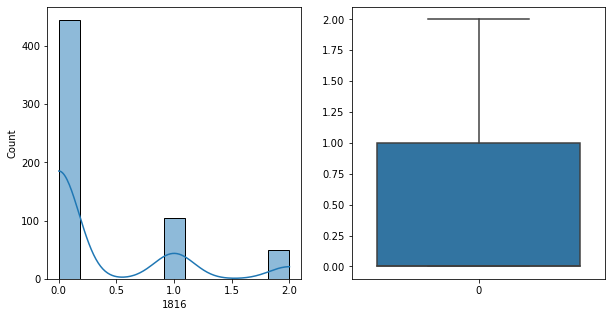

1816   Unique :  [1 0 2]
--------------------------------------------------------------------
1816   N unique :  3
--------------------------------------------------------------------
1816   Value Counts :  0    445
1    105
2     50
Name: 1816, dtype: int64
--------------------------------------------------------------------



[ 1817 ]
show_df_info :  1817


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


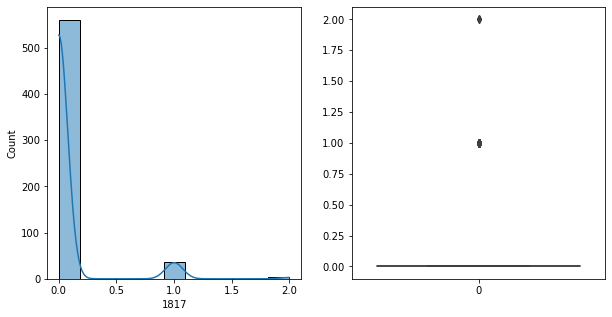

1817   Unique :  [0 1 2]
--------------------------------------------------------------------
1817   N unique :  3
--------------------------------------------------------------------
1817   Value Counts :  0    560
1     37
2      3
Name: 1817, dtype: int64
--------------------------------------------------------------------



[ 1818 ]
show_df_info :  1818


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


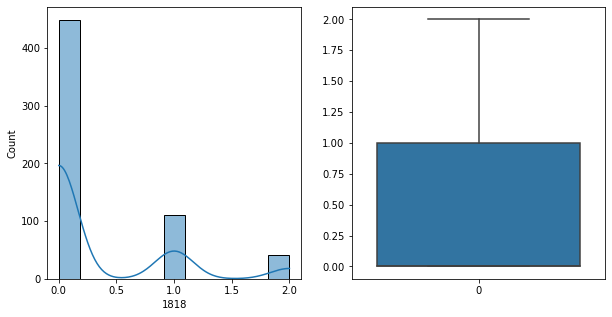

1818   Unique :  [1 0 2]
--------------------------------------------------------------------
1818   N unique :  3
--------------------------------------------------------------------
1818   Value Counts :  0    449
1    110
2     41
Name: 1818, dtype: int64
--------------------------------------------------------------------



[ 1819 ]
show_df_info :  1819


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


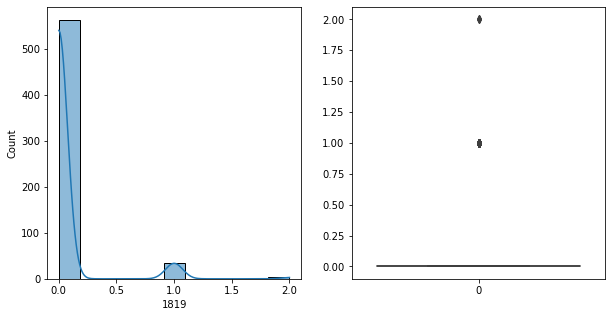

1819   Unique :  [0 1 2]
--------------------------------------------------------------------
1819   N unique :  3
--------------------------------------------------------------------
1819   Value Counts :  0    562
1     35
2      3
Name: 1819, dtype: int64
--------------------------------------------------------------------



[ 1820 ]
show_df_info :  1820


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


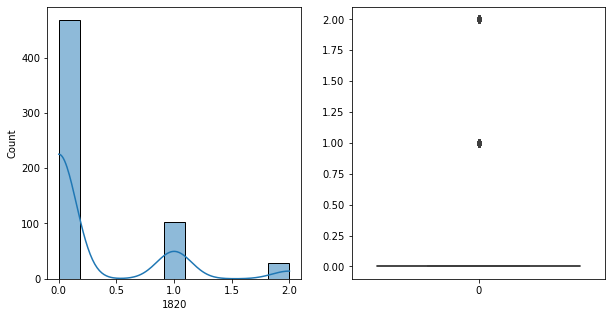

1820   Unique :  [1 0 2]
--------------------------------------------------------------------
1820   N unique :  3
--------------------------------------------------------------------
1820   Value Counts :  0    468
1    103
2     29
Name: 1820, dtype: int64
--------------------------------------------------------------------



[ 1821 ]
show_df_info :  1821


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


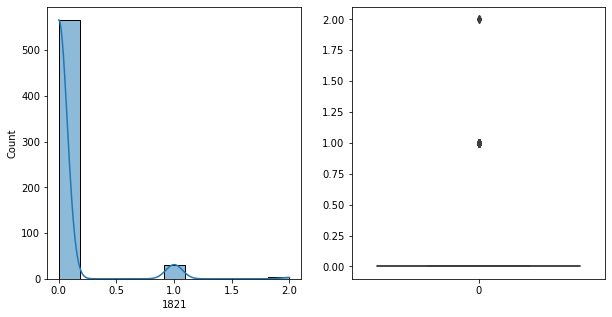

1821   Unique :  [0 1 2]
--------------------------------------------------------------------
1821   N unique :  3
--------------------------------------------------------------------
1821   Value Counts :  0    566
1     31
2      3
Name: 1821, dtype: int64
--------------------------------------------------------------------



[ 1822 ]
show_df_info :  1822


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


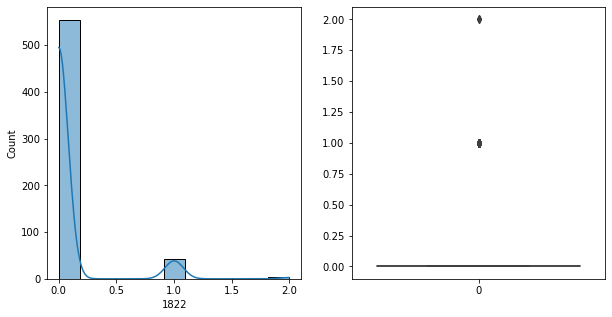

1822   Unique :  [0 1 2]
--------------------------------------------------------------------
1822   N unique :  3
--------------------------------------------------------------------
1822   Value Counts :  0    554
1     43
2      3
Name: 1822, dtype: int64
--------------------------------------------------------------------



[ 1823 ]
show_df_info :  1823


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


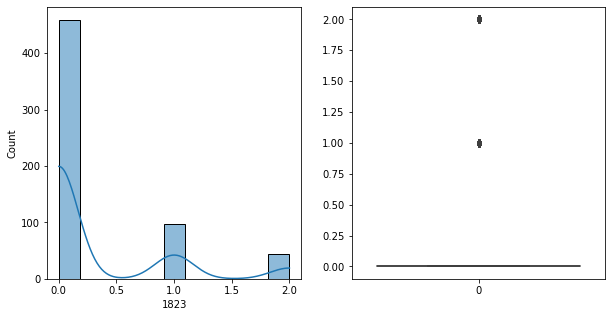

1823   Unique :  [2 0 1]
--------------------------------------------------------------------
1823   N unique :  3
--------------------------------------------------------------------
1823   Value Counts :  0    459
1     97
2     44
Name: 1823, dtype: int64
--------------------------------------------------------------------



[ 1824 ]
show_df_info :  1824


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


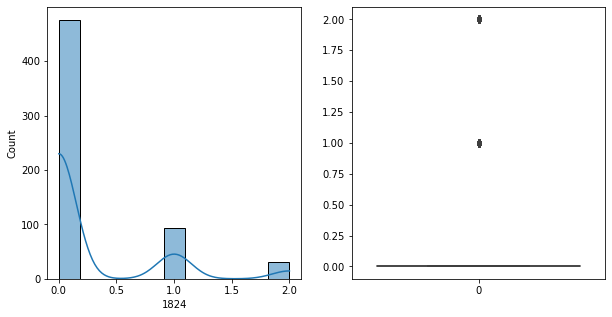

1824   Unique :  [0 2 1]
--------------------------------------------------------------------
1824   N unique :  3
--------------------------------------------------------------------
1824   Value Counts :  0    476
1     94
2     30
Name: 1824, dtype: int64
--------------------------------------------------------------------



[ 1825 ]
show_df_info :  1825


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


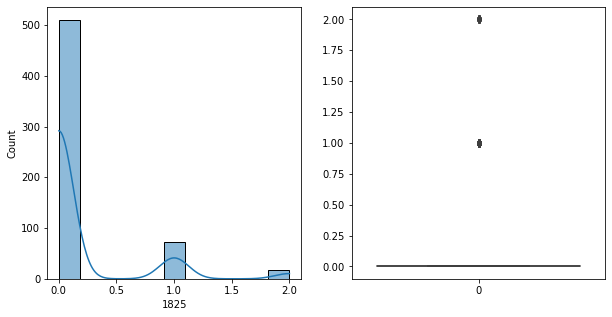

1825   Unique :  [0 1 2]
--------------------------------------------------------------------
1825   N unique :  3
--------------------------------------------------------------------
1825   Value Counts :  0    510
1     72
2     18
Name: 1825, dtype: int64
--------------------------------------------------------------------



[ 1826 ]
show_df_info :  1826


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


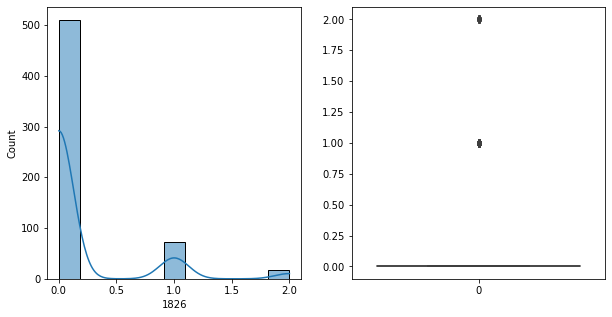

1826   Unique :  [0 1 2]
--------------------------------------------------------------------
1826   N unique :  3
--------------------------------------------------------------------
1826   Value Counts :  0    510
1     72
2     18
Name: 1826, dtype: int64
--------------------------------------------------------------------



[ 1827 ]
show_df_info :  1827


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


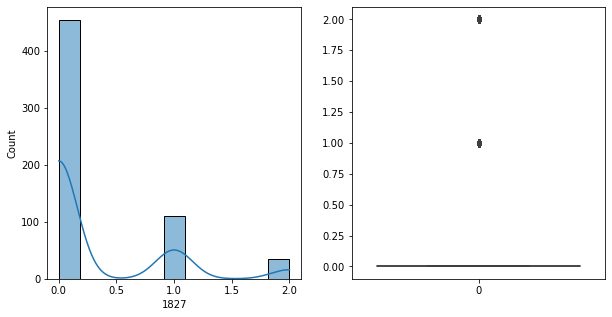

1827   Unique :  [1 0 2]
--------------------------------------------------------------------
1827   N unique :  3
--------------------------------------------------------------------
1827   Value Counts :  0    454
1    111
2     35
Name: 1827, dtype: int64
--------------------------------------------------------------------



[ 1828 ]
show_df_info :  1828


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


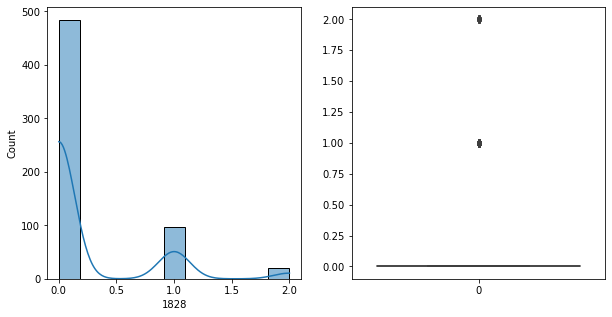

1828   Unique :  [1 0 2]
--------------------------------------------------------------------
1828   N unique :  3
--------------------------------------------------------------------
1828   Value Counts :  0    484
1     96
2     20
Name: 1828, dtype: int64
--------------------------------------------------------------------



[ 1829 ]
show_df_info :  1829


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


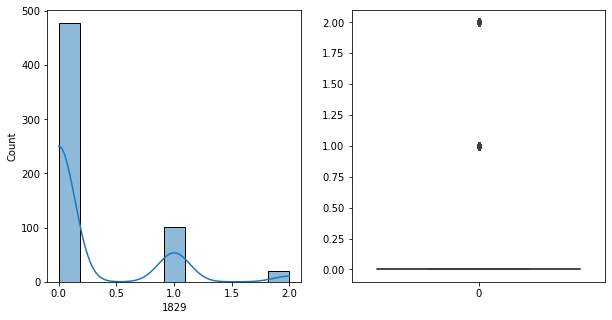

1829   Unique :  [1 0 2]
--------------------------------------------------------------------
1829   N unique :  3
--------------------------------------------------------------------
1829   Value Counts :  0    478
1    102
2     20
Name: 1829, dtype: int64
--------------------------------------------------------------------



[ 1830 ]
show_df_info :  1830


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


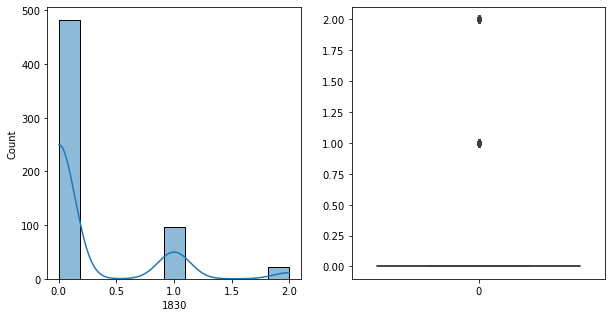

1830   Unique :  [1 0 2]
--------------------------------------------------------------------
1830   N unique :  3
--------------------------------------------------------------------
1830   Value Counts :  0    482
1     96
2     22
Name: 1830, dtype: int64
--------------------------------------------------------------------



[ 1831 ]
show_df_info :  1831


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


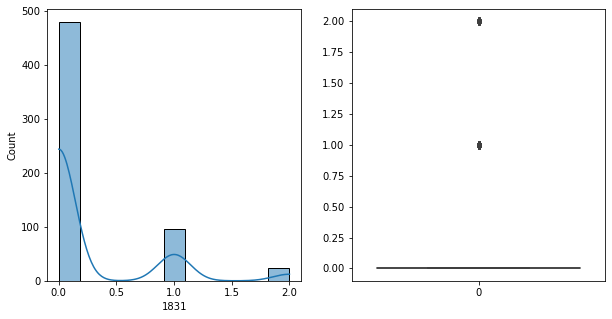

1831   Unique :  [0 1 2]
--------------------------------------------------------------------
1831   N unique :  3
--------------------------------------------------------------------
1831   Value Counts :  0    480
1     96
2     24
Name: 1831, dtype: int64
--------------------------------------------------------------------



[ 1832 ]
show_df_info :  1832


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


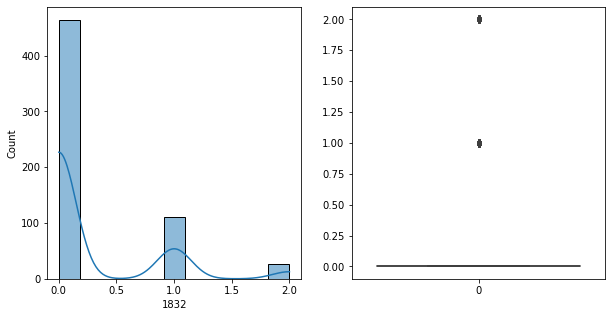

1832   Unique :  [0 1 2]
--------------------------------------------------------------------
1832   N unique :  3
--------------------------------------------------------------------
1832   Value Counts :  0    464
1    110
2     26
Name: 1832, dtype: int64
--------------------------------------------------------------------



[ 1833 ]
show_df_info :  1833


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


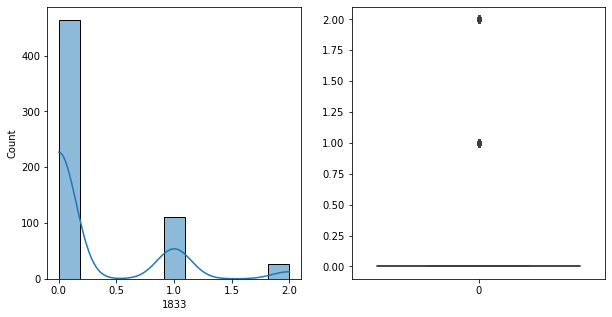

1833   Unique :  [0 1 2]
--------------------------------------------------------------------
1833   N unique :  3
--------------------------------------------------------------------
1833   Value Counts :  0    464
1    110
2     26
Name: 1833, dtype: int64
--------------------------------------------------------------------



[ 1834 ]
show_df_info :  1834


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


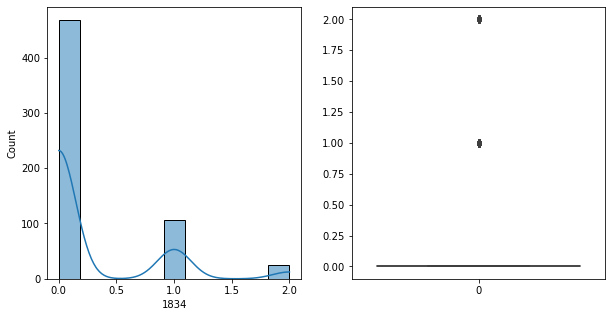

1834   Unique :  [0 1 2]
--------------------------------------------------------------------
1834   N unique :  3
--------------------------------------------------------------------
1834   Value Counts :  0    468
1    107
2     25
Name: 1834, dtype: int64
--------------------------------------------------------------------



[ 1835 ]
show_df_info :  1835


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


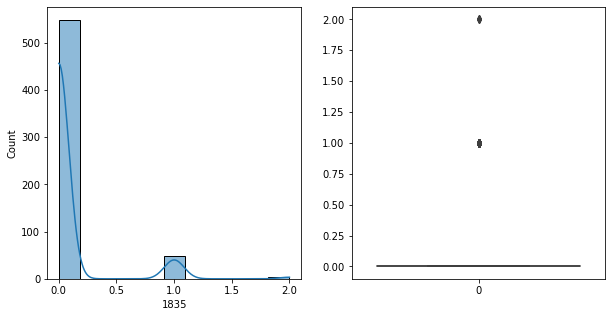

1835   Unique :  [0 1 2]
--------------------------------------------------------------------
1835   N unique :  3
--------------------------------------------------------------------
1835   Value Counts :  0    548
1     48
2      4
Name: 1835, dtype: int64
--------------------------------------------------------------------



[ 1836 ]
show_df_info :  1836


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


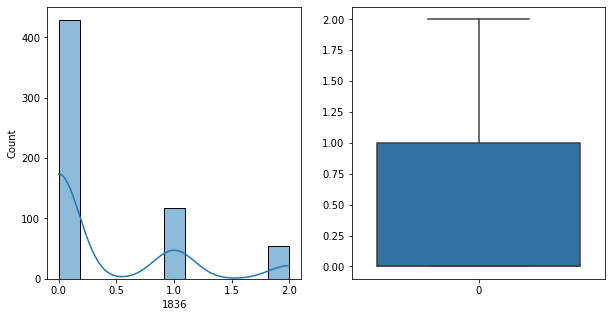

1836   Unique :  [0 1 2]
--------------------------------------------------------------------
1836   N unique :  3
--------------------------------------------------------------------
1836   Value Counts :  0    429
1    117
2     54
Name: 1836, dtype: int64
--------------------------------------------------------------------



[ 1837 ]
show_df_info :  1837


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


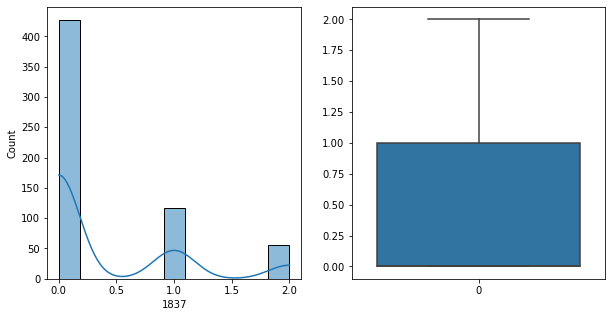

1837   Unique :  [2 0 1]
--------------------------------------------------------------------
1837   N unique :  3
--------------------------------------------------------------------
1837   Value Counts :  0    427
1    117
2     56
Name: 1837, dtype: int64
--------------------------------------------------------------------



[ 1838 ]
show_df_info :  1838


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


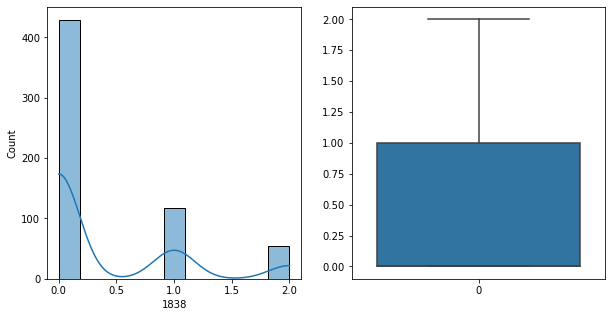

1838   Unique :  [0 1 2]
--------------------------------------------------------------------
1838   N unique :  3
--------------------------------------------------------------------
1838   Value Counts :  0    429
1    117
2     54
Name: 1838, dtype: int64
--------------------------------------------------------------------



[ 1839 ]
show_df_info :  1839


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


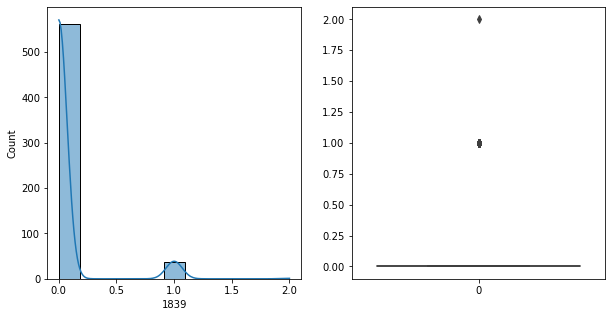

1839   Unique :  [1 0 2]
--------------------------------------------------------------------
1839   N unique :  3
--------------------------------------------------------------------
1839   Value Counts :  0    561
1     38
2      1
Name: 1839, dtype: int64
--------------------------------------------------------------------



[ 1840 ]
show_df_info :  1840


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


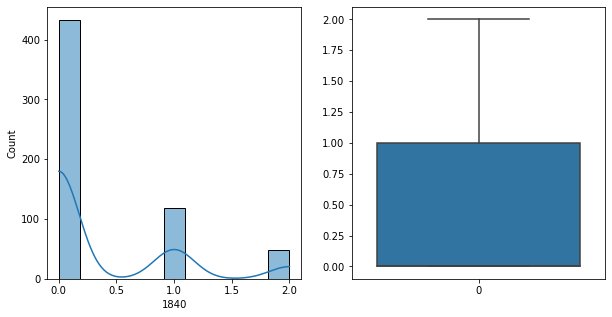

1840   Unique :  [1 0 2]
--------------------------------------------------------------------
1840   N unique :  3
--------------------------------------------------------------------
1840   Value Counts :  0    433
1    118
2     49
Name: 1840, dtype: int64
--------------------------------------------------------------------



[ 1841 ]
show_df_info :  1841


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


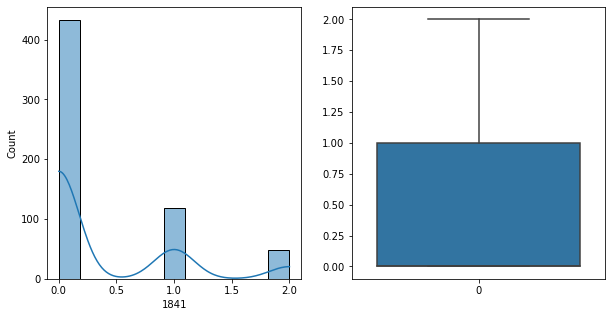

1841   Unique :  [1 0 2]
--------------------------------------------------------------------
1841   N unique :  3
--------------------------------------------------------------------
1841   Value Counts :  0    433
1    118
2     49
Name: 1841, dtype: int64
--------------------------------------------------------------------



[ 1842 ]
show_df_info :  1842


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


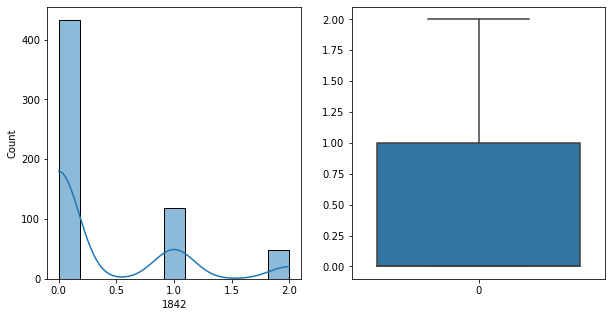

1842   Unique :  [1 0 2]
--------------------------------------------------------------------
1842   N unique :  3
--------------------------------------------------------------------
1842   Value Counts :  0    433
1    118
2     49
Name: 1842, dtype: int64
--------------------------------------------------------------------



[ 1843 ]
show_df_info :  1843


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


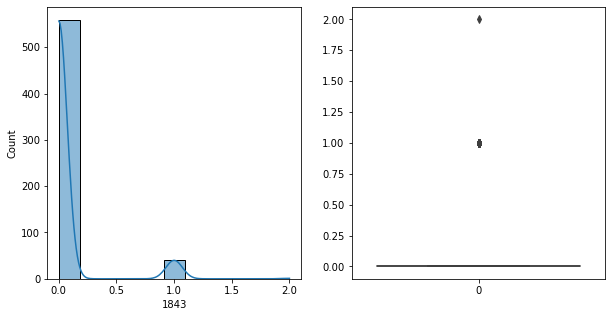

1843   Unique :  [0 1 2]
--------------------------------------------------------------------
1843   N unique :  3
--------------------------------------------------------------------
1843   Value Counts :  0    559
1     40
2      1
Name: 1843, dtype: int64
--------------------------------------------------------------------



[ 1844 ]
show_df_info :  1844


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


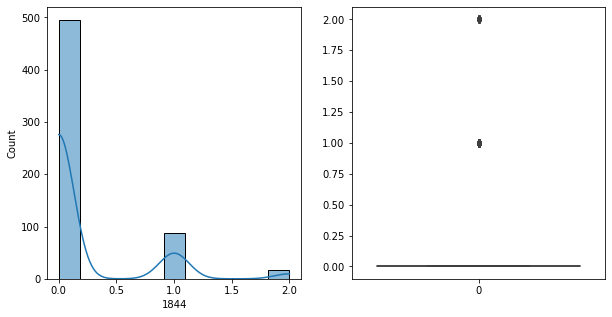

1844   Unique :  [0 1 2]
--------------------------------------------------------------------
1844   N unique :  3
--------------------------------------------------------------------
1844   Value Counts :  0    495
1     88
2     17
Name: 1844, dtype: int64
--------------------------------------------------------------------



[ 1845 ]
show_df_info :  1845


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


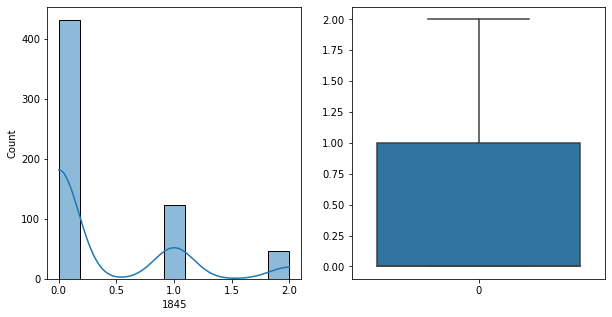

1845   Unique :  [0 1 2]
--------------------------------------------------------------------
1845   N unique :  3
--------------------------------------------------------------------
1845   Value Counts :  0    431
1    123
2     46
Name: 1845, dtype: int64
--------------------------------------------------------------------



[ 1846 ]
show_df_info :  1846


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


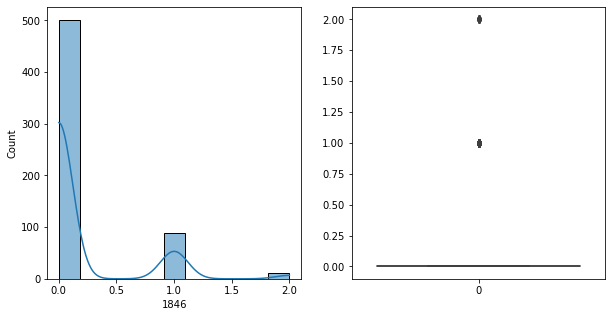

1846   Unique :  [0 1 2]
--------------------------------------------------------------------
1846   N unique :  3
--------------------------------------------------------------------
1846   Value Counts :  0    501
1     88
2     11
Name: 1846, dtype: int64
--------------------------------------------------------------------



[ 1847 ]
show_df_info :  1847


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


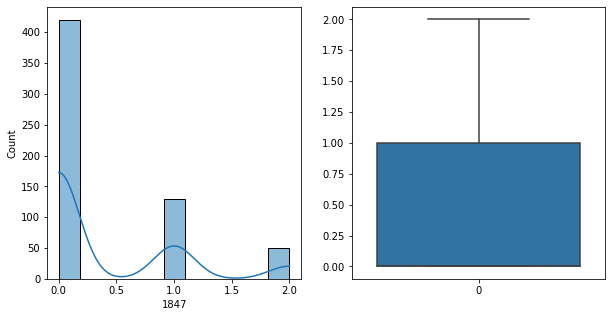

1847   Unique :  [1 0 2]
--------------------------------------------------------------------
1847   N unique :  3
--------------------------------------------------------------------
1847   Value Counts :  0    420
1    130
2     50
Name: 1847, dtype: int64
--------------------------------------------------------------------



[ 1848 ]
show_df_info :  1848


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


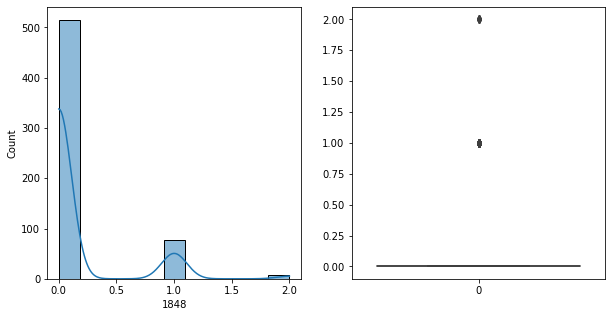

1848   Unique :  [0 1 2]
--------------------------------------------------------------------
1848   N unique :  3
--------------------------------------------------------------------
1848   Value Counts :  0    515
1     77
2      8
Name: 1848, dtype: int64
--------------------------------------------------------------------



[ 1849 ]
show_df_info :  1849


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


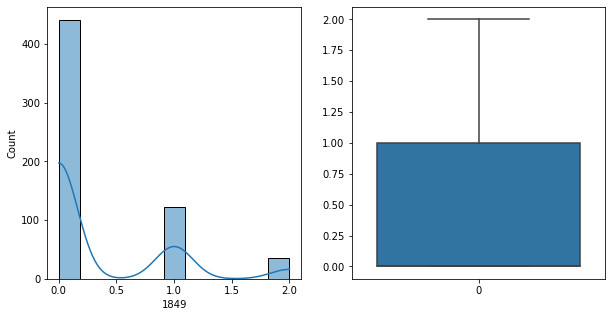

1849   Unique :  [1 0 2]
--------------------------------------------------------------------
1849   N unique :  3
--------------------------------------------------------------------
1849   Value Counts :  0    441
1    123
2     36
Name: 1849, dtype: int64
--------------------------------------------------------------------



[ 1850 ]
show_df_info :  1850


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


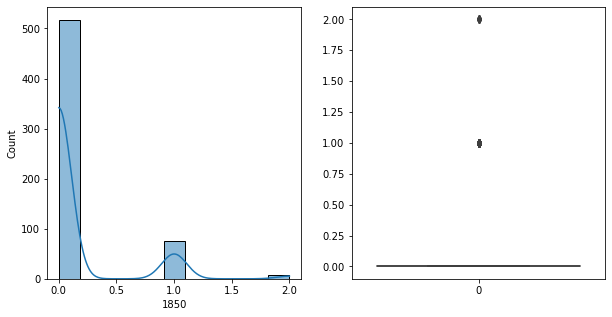

1850   Unique :  [0 1 2]
--------------------------------------------------------------------
1850   N unique :  3
--------------------------------------------------------------------
1850   Value Counts :  0    517
1     75
2      8
Name: 1850, dtype: int64
--------------------------------------------------------------------



[ 1851 ]
show_df_info :  1851


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


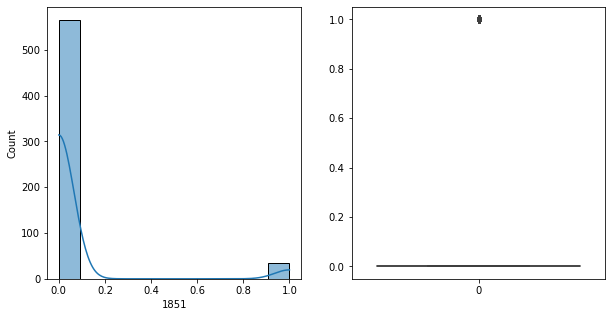

1851   Unique :  [0 1]
--------------------------------------------------------------------
1851   N unique :  2
--------------------------------------------------------------------
1851   Value Counts :  0    565
1     35
Name: 1851, dtype: int64
--------------------------------------------------------------------



[ 1852 ]
show_df_info :  1852


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


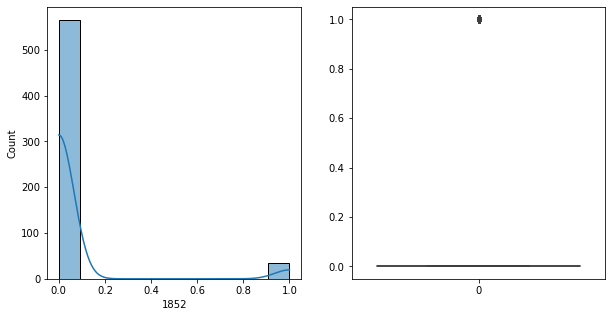

1852   Unique :  [0 1]
--------------------------------------------------------------------
1852   N unique :  2
--------------------------------------------------------------------
1852   Value Counts :  0    565
1     35
Name: 1852, dtype: int64
--------------------------------------------------------------------



[ 1853 ]
show_df_info :  1853


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


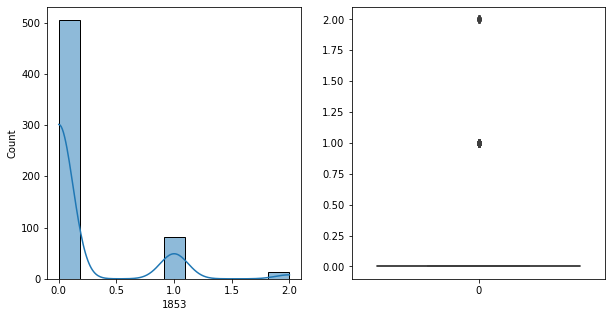

1853   Unique :  [0 1 2]
--------------------------------------------------------------------
1853   N unique :  3
--------------------------------------------------------------------
1853   Value Counts :  0    505
1     82
2     13
Name: 1853, dtype: int64
--------------------------------------------------------------------



[ 1854 ]
show_df_info :  1854


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


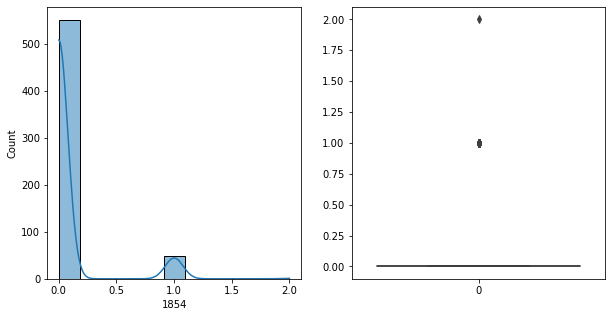

1854   Unique :  [0 1 2]
--------------------------------------------------------------------
1854   N unique :  3
--------------------------------------------------------------------
1854   Value Counts :  0    551
1     48
2      1
Name: 1854, dtype: int64
--------------------------------------------------------------------



[ 1855 ]
show_df_info :  1855


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


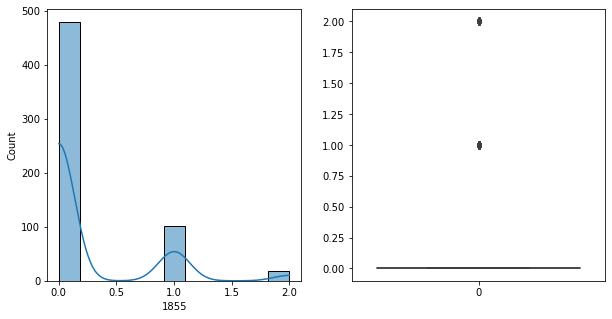

1855   Unique :  [0 1 2]
--------------------------------------------------------------------
1855   N unique :  3
--------------------------------------------------------------------
1855   Value Counts :  0    479
1    102
2     19
Name: 1855, dtype: int64
--------------------------------------------------------------------



[ 1856 ]
show_df_info :  1856


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


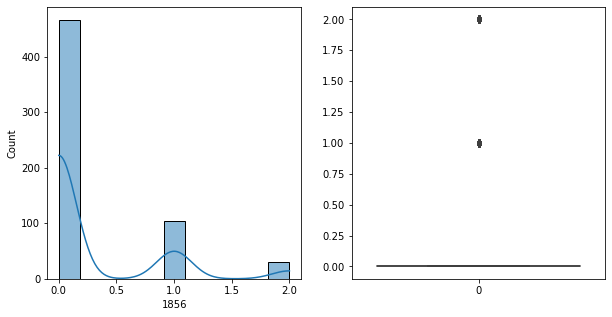

1856   Unique :  [1 0 2]
--------------------------------------------------------------------
1856   N unique :  3
--------------------------------------------------------------------
1856   Value Counts :  0    466
1    104
2     30
Name: 1856, dtype: int64
--------------------------------------------------------------------



[ 1857 ]
show_df_info :  1857


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


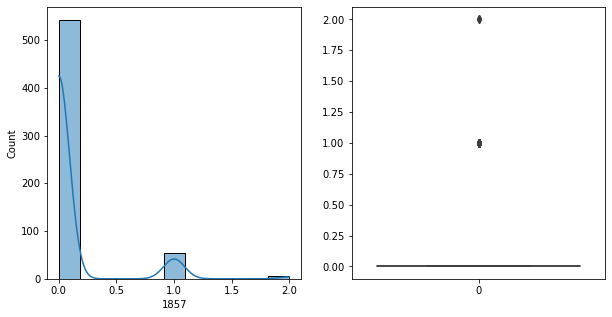

1857   Unique :  [0 1 2]
--------------------------------------------------------------------
1857   N unique :  3
--------------------------------------------------------------------
1857   Value Counts :  0    542
1     53
2      5
Name: 1857, dtype: int64
--------------------------------------------------------------------



[ 1858 ]
show_df_info :  1858


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


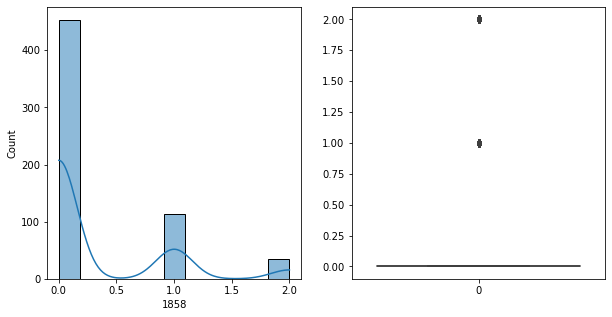

1858   Unique :  [1 0 2]
--------------------------------------------------------------------
1858   N unique :  3
--------------------------------------------------------------------
1858   Value Counts :  0    453
1    113
2     34
Name: 1858, dtype: int64
--------------------------------------------------------------------



[ 1859 ]
show_df_info :  1859


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


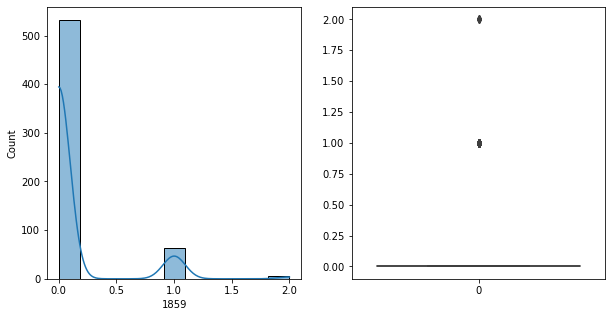

1859   Unique :  [1 0 2]
--------------------------------------------------------------------
1859   N unique :  3
--------------------------------------------------------------------
1859   Value Counts :  0    532
1     63
2      5
Name: 1859, dtype: int64
--------------------------------------------------------------------



[ 1860 ]
show_df_info :  1860


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


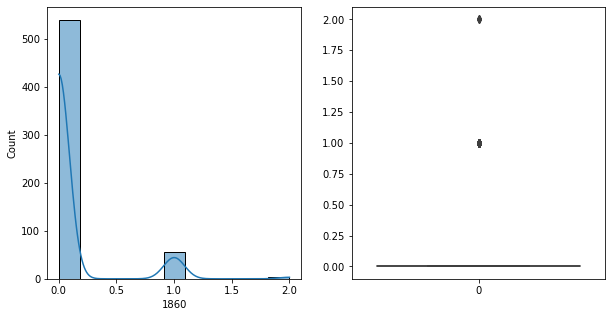

1860   Unique :  [1 0 2]
--------------------------------------------------------------------
1860   N unique :  3
--------------------------------------------------------------------
1860   Value Counts :  0    540
1     56
2      4
Name: 1860, dtype: int64
--------------------------------------------------------------------



[ 1861 ]
show_df_info :  1861


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


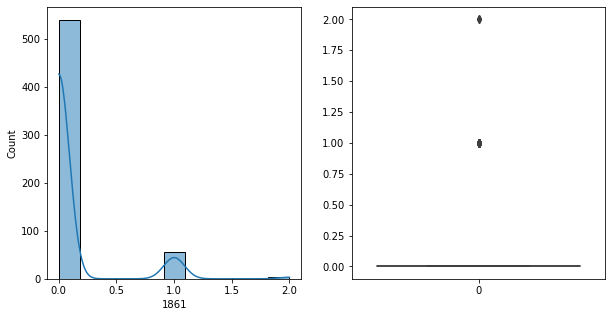

1861   Unique :  [1 0 2]
--------------------------------------------------------------------
1861   N unique :  3
--------------------------------------------------------------------
1861   Value Counts :  0    540
1     56
2      4
Name: 1861, dtype: int64
--------------------------------------------------------------------



[ 1862 ]
show_df_info :  1862


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


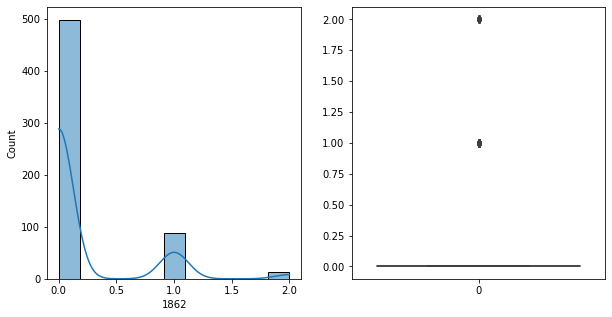

1862   Unique :  [1 0 2]
--------------------------------------------------------------------
1862   N unique :  3
--------------------------------------------------------------------
1862   Value Counts :  0    498
1     88
2     14
Name: 1862, dtype: int64
--------------------------------------------------------------------



[ 1863 ]
show_df_info :  1863


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


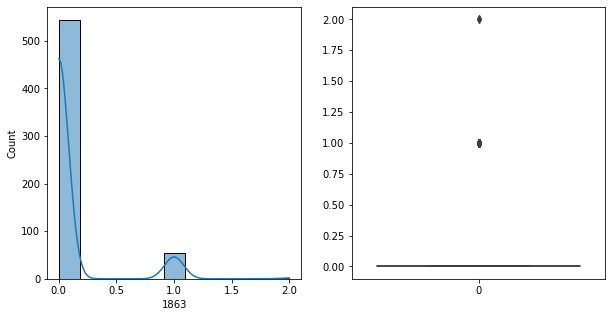

1863   Unique :  [0 1 2]
--------------------------------------------------------------------
1863   N unique :  3
--------------------------------------------------------------------
1863   Value Counts :  0    544
1     54
2      2
Name: 1863, dtype: int64
--------------------------------------------------------------------



[ 1864 ]
show_df_info :  1864


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


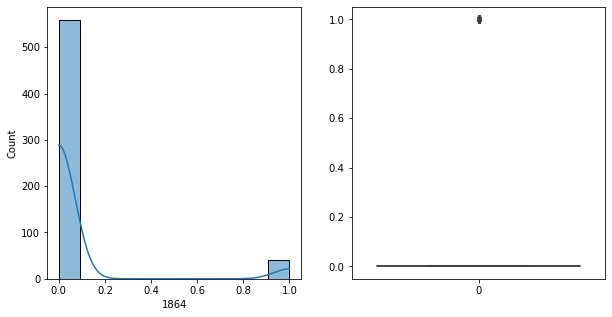

1864   Unique :  [0 1]
--------------------------------------------------------------------
1864   N unique :  2
--------------------------------------------------------------------
1864   Value Counts :  0    559
1     41
Name: 1864, dtype: int64
--------------------------------------------------------------------



[ 1865 ]
show_df_info :  1865


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


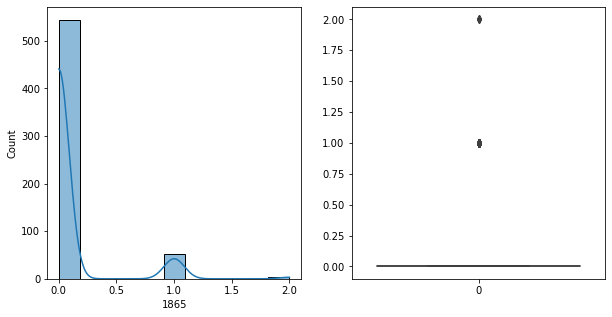

1865   Unique :  [0 1 2]
--------------------------------------------------------------------
1865   N unique :  3
--------------------------------------------------------------------
1865   Value Counts :  0    544
1     52
2      4
Name: 1865, dtype: int64
--------------------------------------------------------------------



[ 1866 ]
show_df_info :  1866


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


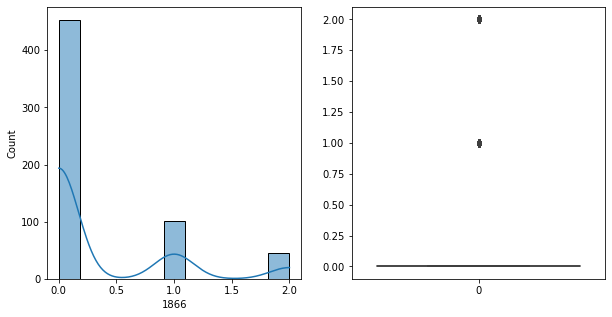

1866   Unique :  [1 0 2]
--------------------------------------------------------------------
1866   N unique :  3
--------------------------------------------------------------------
1866   Value Counts :  0    453
1    101
2     46
Name: 1866, dtype: int64
--------------------------------------------------------------------



[ 1867 ]
show_df_info :  1867


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


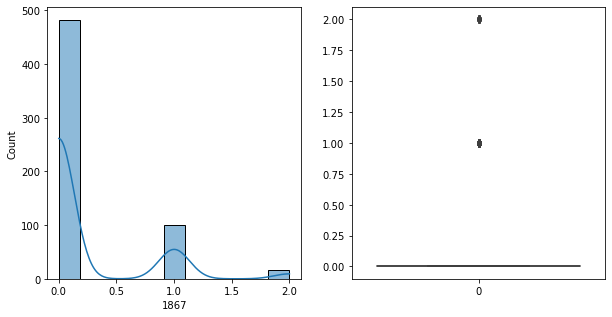

1867   Unique :  [0 1 2]
--------------------------------------------------------------------
1867   N unique :  3
--------------------------------------------------------------------
1867   Value Counts :  0    482
1    101
2     17
Name: 1867, dtype: int64
--------------------------------------------------------------------



[ 1868 ]
show_df_info :  1868


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


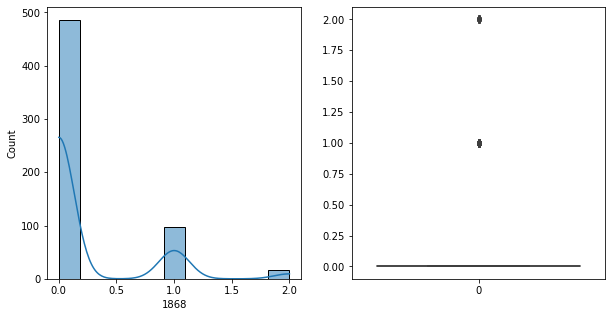

1868   Unique :  [0 1 2]
--------------------------------------------------------------------
1868   N unique :  3
--------------------------------------------------------------------
1868   Value Counts :  0    486
1     97
2     17
Name: 1868, dtype: int64
--------------------------------------------------------------------



[ 1869 ]
show_df_info :  1869


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


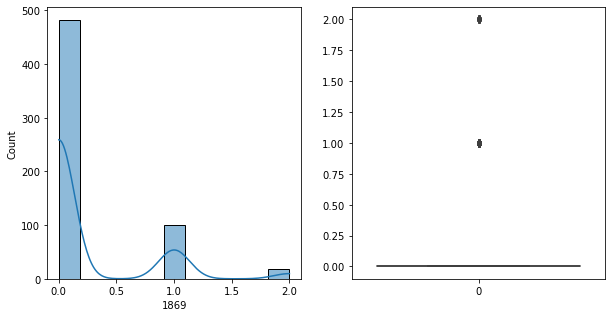

1869   Unique :  [0 1 2]
--------------------------------------------------------------------
1869   N unique :  3
--------------------------------------------------------------------
1869   Value Counts :  0    482
1    100
2     18
Name: 1869, dtype: int64
--------------------------------------------------------------------



[ 1870 ]
show_df_info :  1870


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


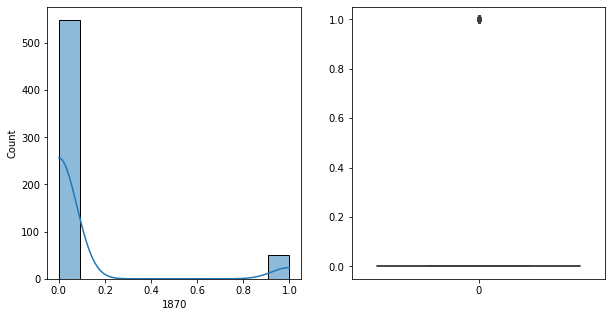

1870   Unique :  [0 1]
--------------------------------------------------------------------
1870   N unique :  2
--------------------------------------------------------------------
1870   Value Counts :  0    549
1     51
Name: 1870, dtype: int64
--------------------------------------------------------------------



[ 1871 ]
show_df_info :  1871


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


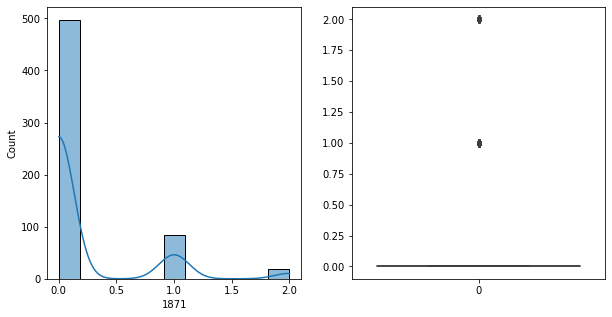

1871   Unique :  [1 0 2]
--------------------------------------------------------------------
1871   N unique :  3
--------------------------------------------------------------------
1871   Value Counts :  0    497
1     84
2     19
Name: 1871, dtype: int64
--------------------------------------------------------------------



[ 1872 ]
show_df_info :  1872


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


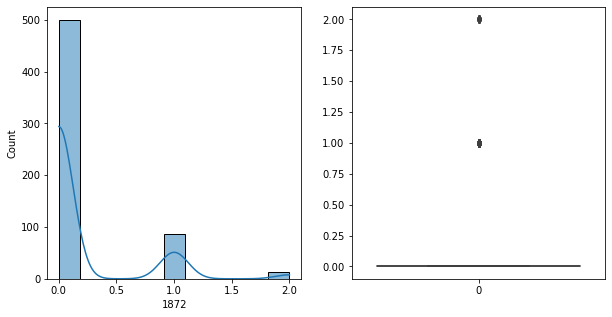

1872   Unique :  [1 0 2]
--------------------------------------------------------------------
1872   N unique :  3
--------------------------------------------------------------------
1872   Value Counts :  0    500
1     87
2     13
Name: 1872, dtype: int64
--------------------------------------------------------------------



[ 1873 ]
show_df_info :  1873


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


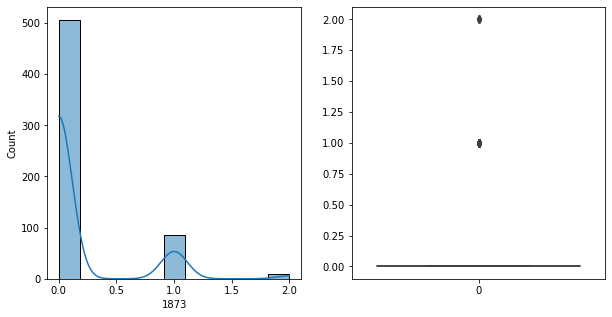

1873   Unique :  [0 1 2]
--------------------------------------------------------------------
1873   N unique :  3
--------------------------------------------------------------------
1873   Value Counts :  0    506
1     85
2      9
Name: 1873, dtype: int64
--------------------------------------------------------------------



[ 1874 ]
show_df_info :  1874


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


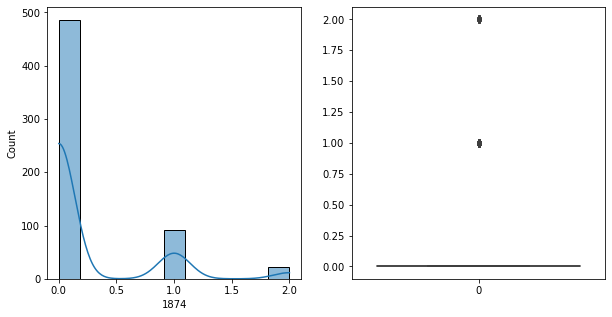

1874   Unique :  [1 0 2]
--------------------------------------------------------------------
1874   N unique :  3
--------------------------------------------------------------------
1874   Value Counts :  0    486
1     92
2     22
Name: 1874, dtype: int64
--------------------------------------------------------------------



[ 1875 ]
show_df_info :  1875


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


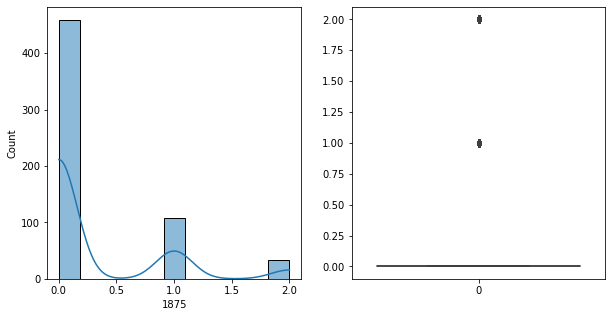

1875   Unique :  [1 0 2]
--------------------------------------------------------------------
1875   N unique :  3
--------------------------------------------------------------------
1875   Value Counts :  0    459
1    107
2     34
Name: 1875, dtype: int64
--------------------------------------------------------------------



[ 1876 ]
show_df_info :  1876


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


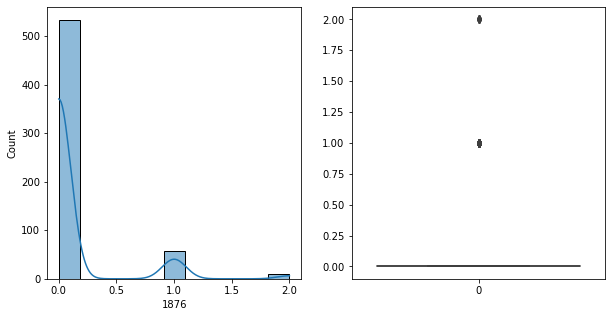

1876   Unique :  [1 0 2]
--------------------------------------------------------------------
1876   N unique :  3
--------------------------------------------------------------------
1876   Value Counts :  0    533
1     58
2      9
Name: 1876, dtype: int64
--------------------------------------------------------------------



[ 1877 ]
show_df_info :  1877


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


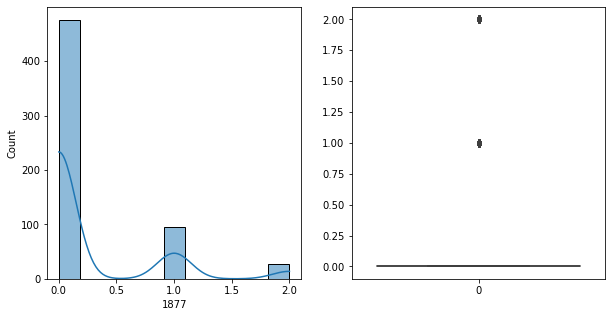

1877   Unique :  [1 0 2]
--------------------------------------------------------------------
1877   N unique :  3
--------------------------------------------------------------------
1877   Value Counts :  0    476
1     96
2     28
Name: 1877, dtype: int64
--------------------------------------------------------------------



[ 1878 ]
show_df_info :  1878


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


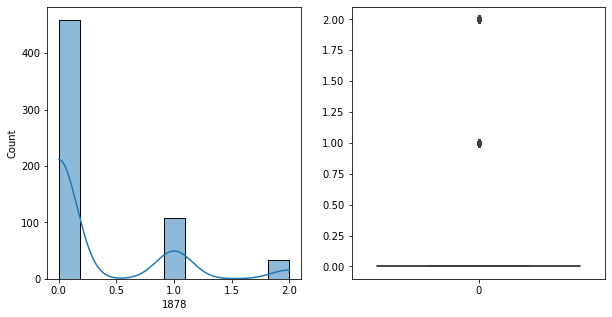

1878   Unique :  [1 0 2]
--------------------------------------------------------------------
1878   N unique :  3
--------------------------------------------------------------------
1878   Value Counts :  0    459
1    107
2     34
Name: 1878, dtype: int64
--------------------------------------------------------------------



[ 1879 ]
show_df_info :  1879


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


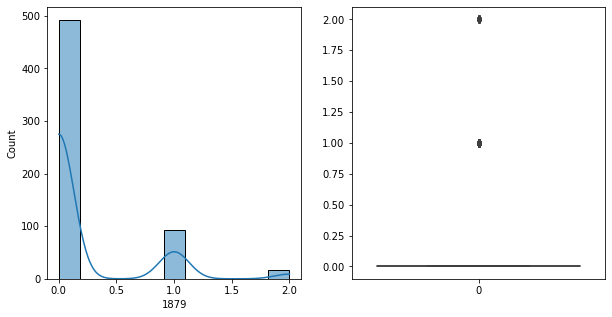

1879   Unique :  [1 0 2]
--------------------------------------------------------------------
1879   N unique :  3
--------------------------------------------------------------------
1879   Value Counts :  0    492
1     92
2     16
Name: 1879, dtype: int64
--------------------------------------------------------------------



[ 1880 ]
show_df_info :  1880


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


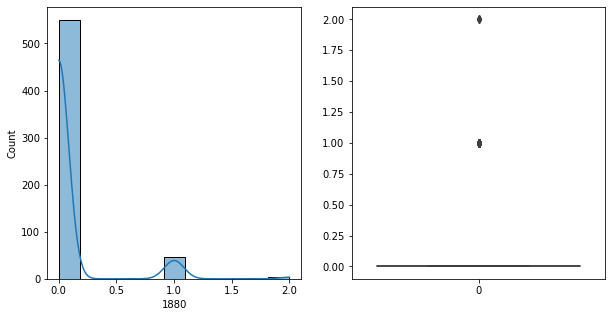

1880   Unique :  [1 0 2]
--------------------------------------------------------------------
1880   N unique :  3
--------------------------------------------------------------------
1880   Value Counts :  0    550
1     46
2      4
Name: 1880, dtype: int64
--------------------------------------------------------------------



[ 1881 ]
show_df_info :  1881


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


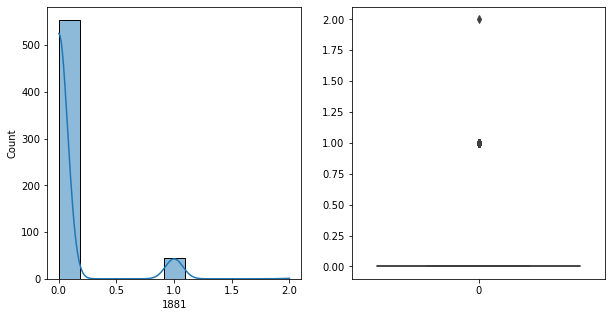

1881   Unique :  [0 1 2]
--------------------------------------------------------------------
1881   N unique :  3
--------------------------------------------------------------------
1881   Value Counts :  0    554
1     45
2      1
Name: 1881, dtype: int64
--------------------------------------------------------------------



[ 1882 ]
show_df_info :  1882


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


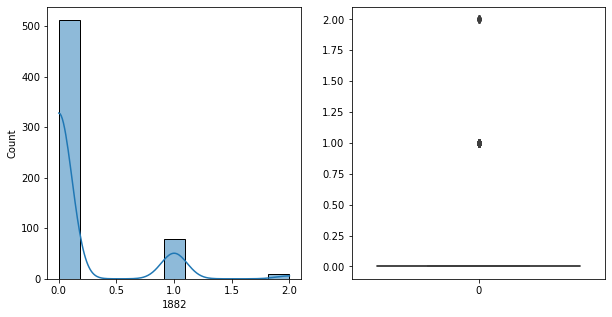

1882   Unique :  [1 0 2]
--------------------------------------------------------------------
1882   N unique :  3
--------------------------------------------------------------------
1882   Value Counts :  0    512
1     79
2      9
Name: 1882, dtype: int64
--------------------------------------------------------------------



[ 1883 ]
show_df_info :  1883


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


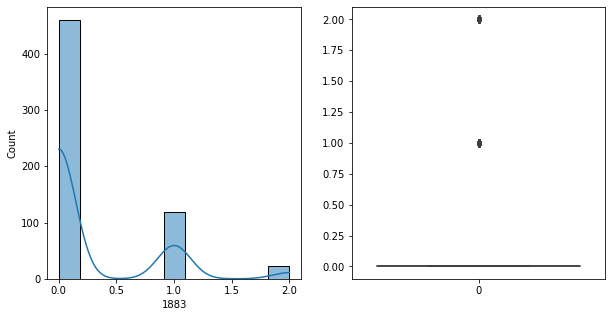

1883   Unique :  [1 0 2]
--------------------------------------------------------------------
1883   N unique :  3
--------------------------------------------------------------------
1883   Value Counts :  0    460
1    118
2     22
Name: 1883, dtype: int64
--------------------------------------------------------------------



[ 1884 ]
show_df_info :  1884


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


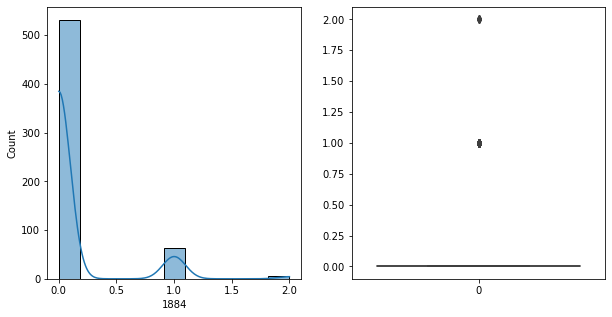

1884   Unique :  [1 0 2]
--------------------------------------------------------------------
1884   N unique :  3
--------------------------------------------------------------------
1884   Value Counts :  0    531
1     63
2      6
Name: 1884, dtype: int64
--------------------------------------------------------------------



[ 1885 ]
show_df_info :  1885


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


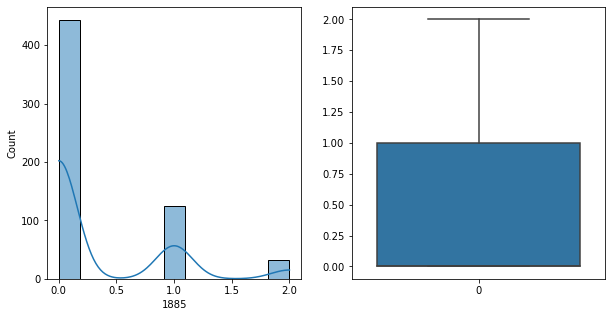

1885   Unique :  [0 1 2]
--------------------------------------------------------------------
1885   N unique :  3
--------------------------------------------------------------------
1885   Value Counts :  0    443
1    124
2     33
Name: 1885, dtype: int64
--------------------------------------------------------------------



[ 1886 ]
show_df_info :  1886


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


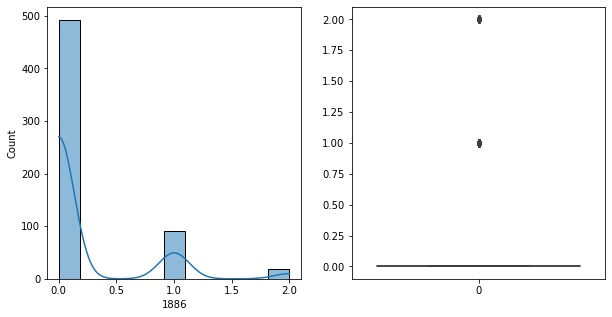

1886   Unique :  [1 0 2]
--------------------------------------------------------------------
1886   N unique :  3
--------------------------------------------------------------------
1886   Value Counts :  0    492
1     90
2     18
Name: 1886, dtype: int64
--------------------------------------------------------------------



[ 1887 ]
show_df_info :  1887


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


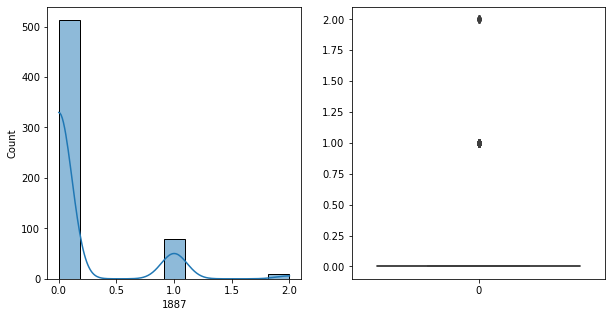

1887   Unique :  [1 0 2]
--------------------------------------------------------------------
1887   N unique :  3
--------------------------------------------------------------------
1887   Value Counts :  0    513
1     78
2      9
Name: 1887, dtype: int64
--------------------------------------------------------------------



[ 1888 ]
show_df_info :  1888


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


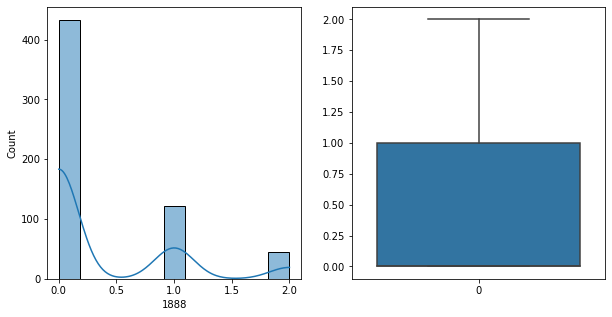

1888   Unique :  [1 0 2]
--------------------------------------------------------------------
1888   N unique :  3
--------------------------------------------------------------------
1888   Value Counts :  0    433
1    122
2     45
Name: 1888, dtype: int64
--------------------------------------------------------------------



[ 1889 ]
show_df_info :  1889


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


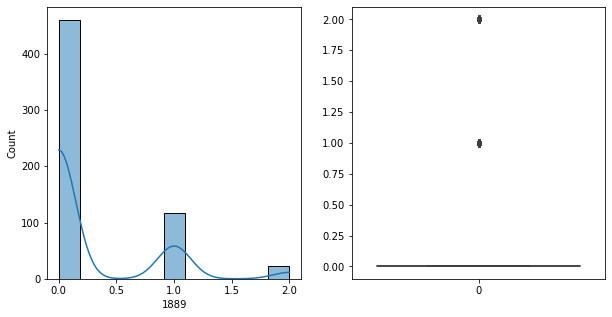

1889   Unique :  [1 0 2]
--------------------------------------------------------------------
1889   N unique :  3
--------------------------------------------------------------------
1889   Value Counts :  0    460
1    117
2     23
Name: 1889, dtype: int64
--------------------------------------------------------------------



[ 1890 ]
show_df_info :  1890


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


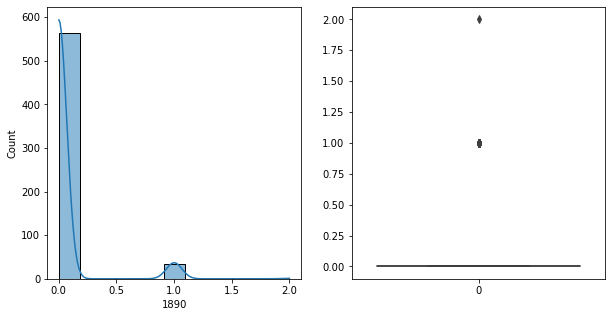

1890   Unique :  [0 1 2]
--------------------------------------------------------------------
1890   N unique :  3
--------------------------------------------------------------------
1890   Value Counts :  0    564
1     35
2      1
Name: 1890, dtype: int64
--------------------------------------------------------------------



[ 1891 ]
show_df_info :  1891


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


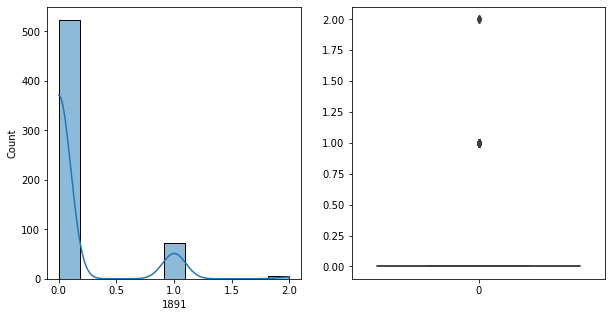

1891   Unique :  [0 1 2]
--------------------------------------------------------------------
1891   N unique :  3
--------------------------------------------------------------------
1891   Value Counts :  0    523
1     72
2      5
Name: 1891, dtype: int64
--------------------------------------------------------------------



[ 1892 ]
show_df_info :  1892


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


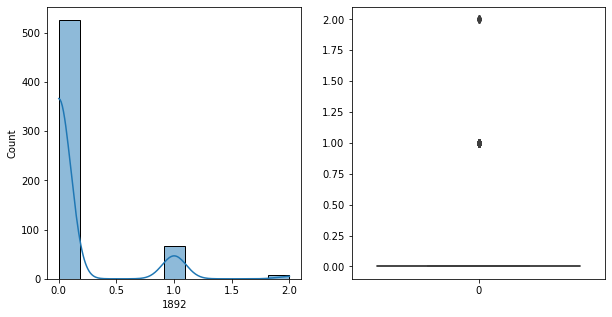

1892   Unique :  [0 1 2]
--------------------------------------------------------------------
1892   N unique :  3
--------------------------------------------------------------------
1892   Value Counts :  0    526
1     67
2      7
Name: 1892, dtype: int64
--------------------------------------------------------------------



[ 1893 ]
show_df_info :  1893


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


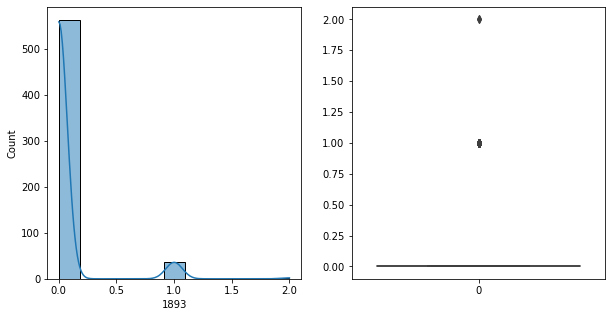

1893   Unique :  [0 1 2]
--------------------------------------------------------------------
1893   N unique :  3
--------------------------------------------------------------------
1893   Value Counts :  0    562
1     36
2      2
Name: 1893, dtype: int64
--------------------------------------------------------------------



[ 1894 ]
show_df_info :  1894


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


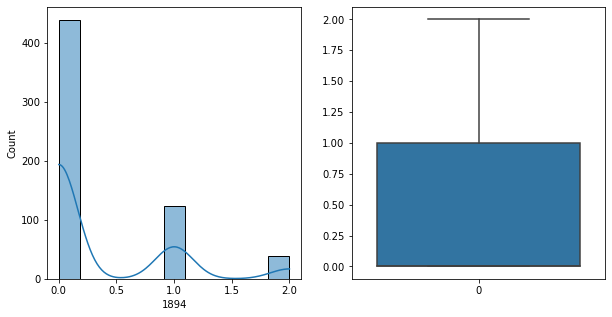

1894   Unique :  [1 0 2]
--------------------------------------------------------------------
1894   N unique :  3
--------------------------------------------------------------------
1894   Value Counts :  0    439
1    123
2     38
Name: 1894, dtype: int64
--------------------------------------------------------------------



[ 1895 ]
show_df_info :  1895


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


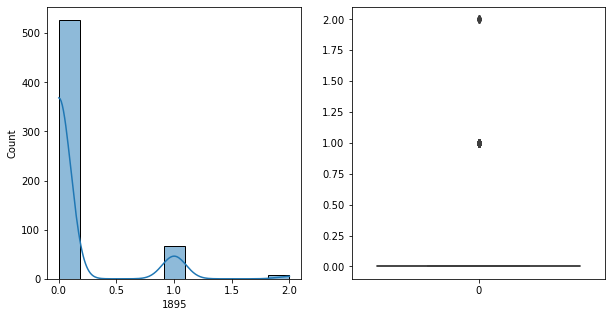

1895   Unique :  [0 1 2]
--------------------------------------------------------------------
1895   N unique :  3
--------------------------------------------------------------------
1895   Value Counts :  0    527
1     66
2      7
Name: 1895, dtype: int64
--------------------------------------------------------------------



[ 1896 ]
show_df_info :  1896


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


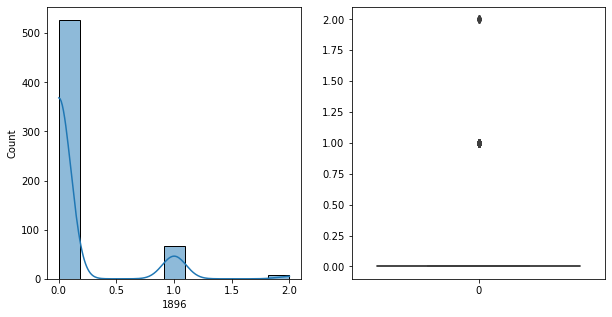

1896   Unique :  [0 1 2]
--------------------------------------------------------------------
1896   N unique :  3
--------------------------------------------------------------------
1896   Value Counts :  0    527
1     66
2      7
Name: 1896, dtype: int64
--------------------------------------------------------------------



[ 1897 ]
show_df_info :  1897


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


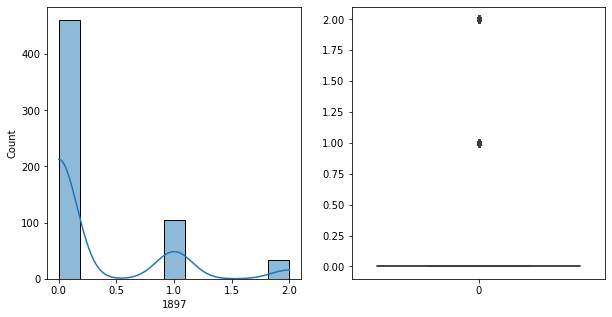

1897   Unique :  [1 0 2]
--------------------------------------------------------------------
1897   N unique :  3
--------------------------------------------------------------------
1897   Value Counts :  0    461
1    105
2     34
Name: 1897, dtype: int64
--------------------------------------------------------------------



[ 1898 ]
show_df_info :  1898


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


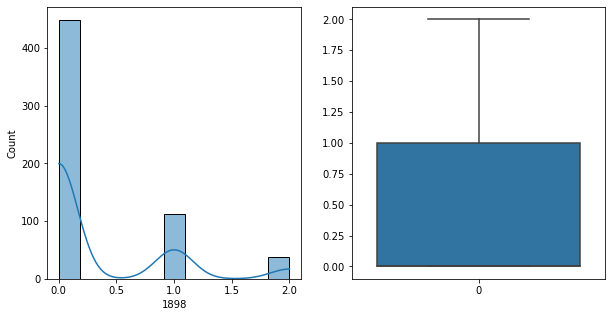

1898   Unique :  [2 0 1]
--------------------------------------------------------------------
1898   N unique :  3
--------------------------------------------------------------------
1898   Value Counts :  0    449
1    113
2     38
Name: 1898, dtype: int64
--------------------------------------------------------------------



[ 1899 ]
show_df_info :  1899


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


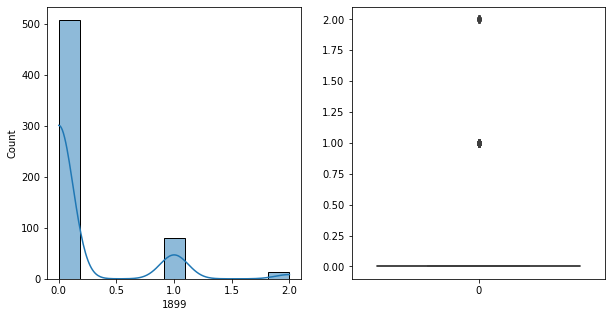

1899   Unique :  [0 2 1]
--------------------------------------------------------------------
1899   N unique :  3
--------------------------------------------------------------------
1899   Value Counts :  0    507
1     79
2     14
Name: 1899, dtype: int64
--------------------------------------------------------------------



[ 1900 ]
show_df_info :  1900


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


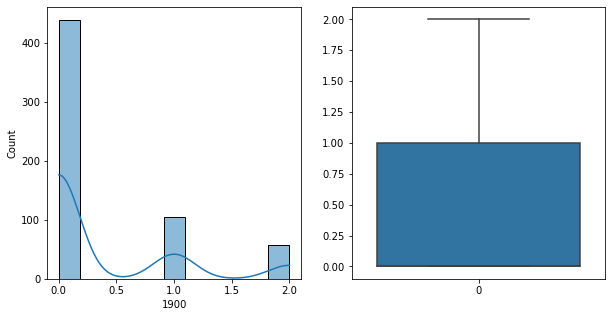

1900   Unique :  [1 0 2]
--------------------------------------------------------------------
1900   N unique :  3
--------------------------------------------------------------------
1900   Value Counts :  0    439
1    104
2     57
Name: 1900, dtype: int64
--------------------------------------------------------------------



[ 1901 ]
show_df_info :  1901


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


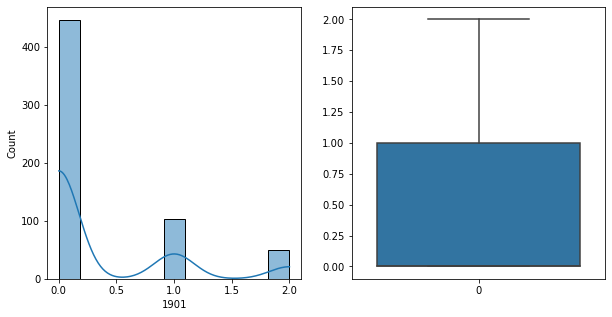

1901   Unique :  [1 0 2]
--------------------------------------------------------------------
1901   N unique :  3
--------------------------------------------------------------------
1901   Value Counts :  0    447
1    103
2     50
Name: 1901, dtype: int64
--------------------------------------------------------------------



[ 1902 ]
show_df_info :  1902


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


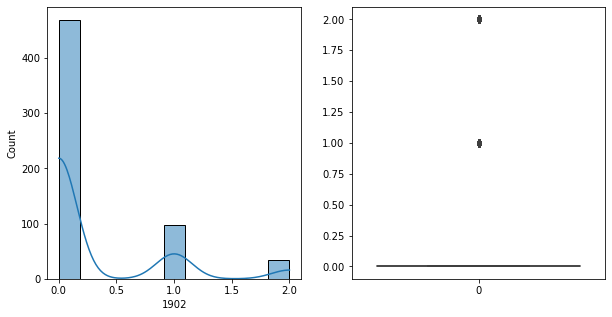

1902   Unique :  [1 0 2]
--------------------------------------------------------------------
1902   N unique :  3
--------------------------------------------------------------------
1902   Value Counts :  0    469
1     97
2     34
Name: 1902, dtype: int64
--------------------------------------------------------------------



[ 1903 ]
show_df_info :  1903


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


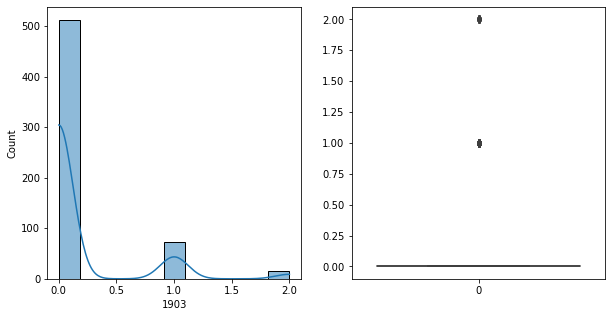

1903   Unique :  [0 2 1]
--------------------------------------------------------------------
1903   N unique :  3
--------------------------------------------------------------------
1903   Value Counts :  0    512
1     73
2     15
Name: 1903, dtype: int64
--------------------------------------------------------------------



[ 1904 ]
show_df_info :  1904


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


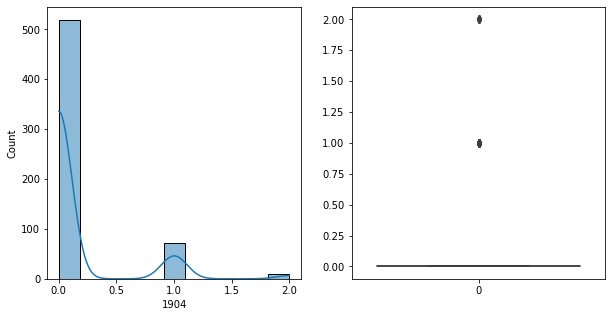

1904   Unique :  [1 0 2]
--------------------------------------------------------------------
1904   N unique :  3
--------------------------------------------------------------------
1904   Value Counts :  0    519
1     71
2     10
Name: 1904, dtype: int64
--------------------------------------------------------------------



[ 1905 ]
show_df_info :  1905


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


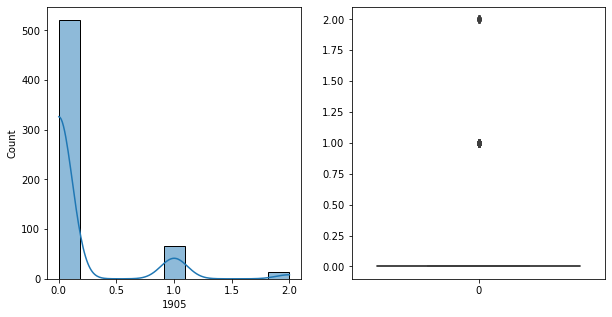

1905   Unique :  [1 0 2]
--------------------------------------------------------------------
1905   N unique :  3
--------------------------------------------------------------------
1905   Value Counts :  0    521
1     66
2     13
Name: 1905, dtype: int64
--------------------------------------------------------------------



[ 1906 ]
show_df_info :  1906


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


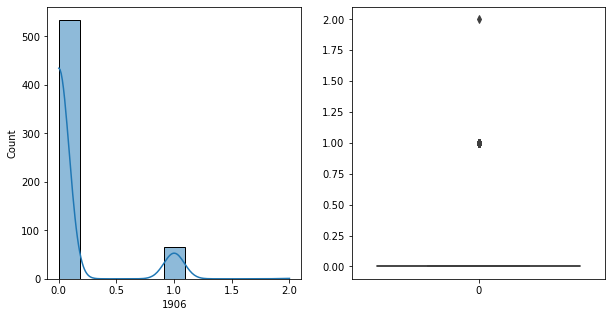

1906   Unique :  [0 2 1]
--------------------------------------------------------------------
1906   N unique :  3
--------------------------------------------------------------------
1906   Value Counts :  0    534
1     65
2      1
Name: 1906, dtype: int64
--------------------------------------------------------------------



[ 1907 ]
show_df_info :  1907


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


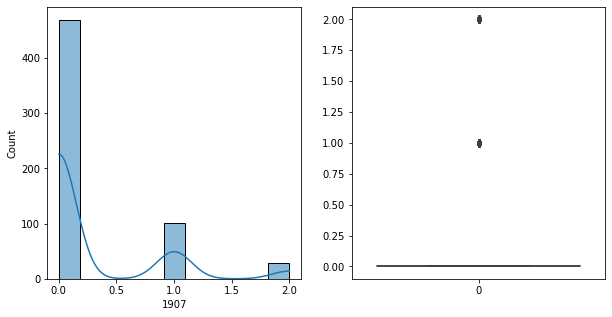

1907   Unique :  [1 0 2]
--------------------------------------------------------------------
1907   N unique :  3
--------------------------------------------------------------------
1907   Value Counts :  0    469
1    102
2     29
Name: 1907, dtype: int64
--------------------------------------------------------------------



[ 1908 ]
show_df_info :  1908


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


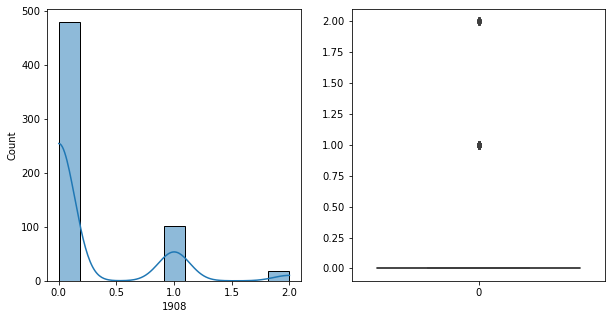

1908   Unique :  [1 0 2]
--------------------------------------------------------------------
1908   N unique :  3
--------------------------------------------------------------------
1908   Value Counts :  0    480
1    101
2     19
Name: 1908, dtype: int64
--------------------------------------------------------------------



[ 1909 ]
show_df_info :  1909


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


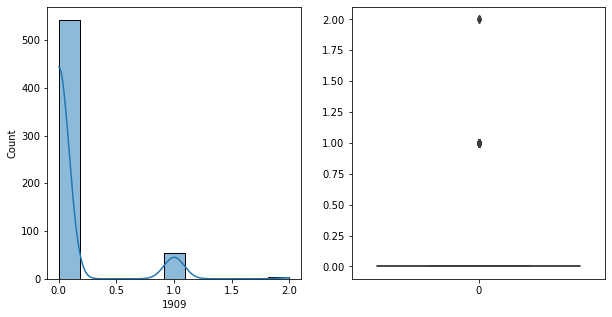

1909   Unique :  [0 1 2]
--------------------------------------------------------------------
1909   N unique :  3
--------------------------------------------------------------------
1909   Value Counts :  0    542
1     55
2      3
Name: 1909, dtype: int64
--------------------------------------------------------------------



[ 1910 ]
show_df_info :  1910


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


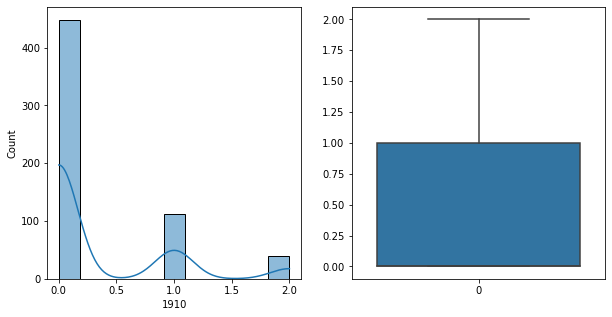

1910   Unique :  [1 0 2]
--------------------------------------------------------------------
1910   N unique :  3
--------------------------------------------------------------------
1910   Value Counts :  0    448
1    112
2     40
Name: 1910, dtype: int64
--------------------------------------------------------------------



[ 1911 ]
show_df_info :  1911


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


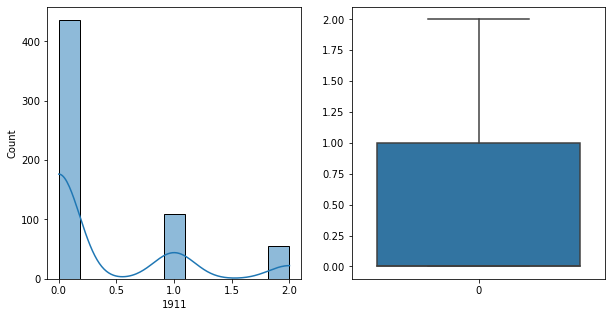

1911   Unique :  [0 2 1]
--------------------------------------------------------------------
1911   N unique :  3
--------------------------------------------------------------------
1911   Value Counts :  0    436
1    109
2     55
Name: 1911, dtype: int64
--------------------------------------------------------------------



[ 1912 ]
show_df_info :  1912


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


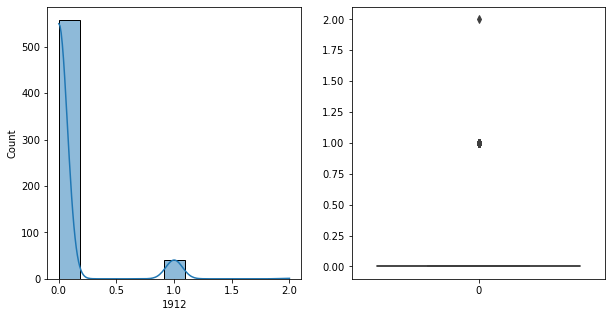

1912   Unique :  [0 1 2]
--------------------------------------------------------------------
1912   N unique :  3
--------------------------------------------------------------------
1912   Value Counts :  0    558
1     41
2      1
Name: 1912, dtype: int64
--------------------------------------------------------------------



[ 1913 ]
show_df_info :  1913


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


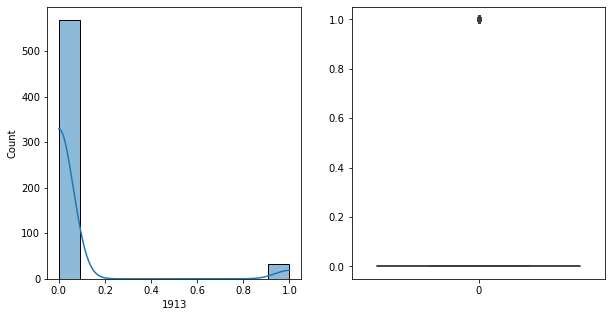

1913   Unique :  [0 1]
--------------------------------------------------------------------
1913   N unique :  2
--------------------------------------------------------------------
1913   Value Counts :  0    568
1     32
Name: 1913, dtype: int64
--------------------------------------------------------------------



[ 1914 ]
show_df_info :  1914


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


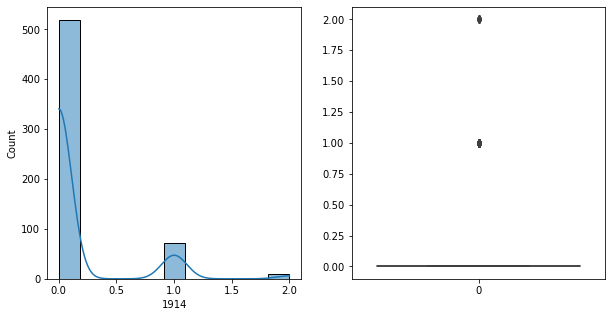

1914   Unique :  [2 0 1]
--------------------------------------------------------------------
1914   N unique :  3
--------------------------------------------------------------------
1914   Value Counts :  0    519
1     72
2      9
Name: 1914, dtype: int64
--------------------------------------------------------------------



[ 1915 ]
show_df_info :  1915


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


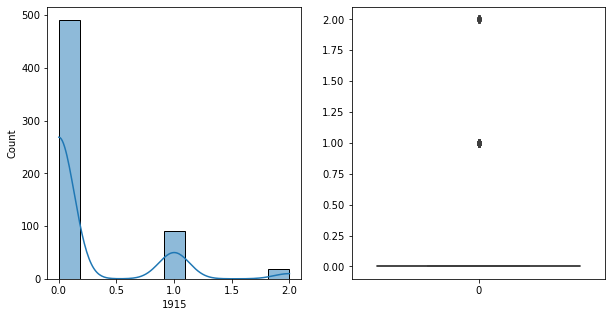

1915   Unique :  [0 1 2]
--------------------------------------------------------------------
1915   N unique :  3
--------------------------------------------------------------------
1915   Value Counts :  0    491
1     91
2     18
Name: 1915, dtype: int64
--------------------------------------------------------------------



[ 1916 ]
show_df_info :  1916


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


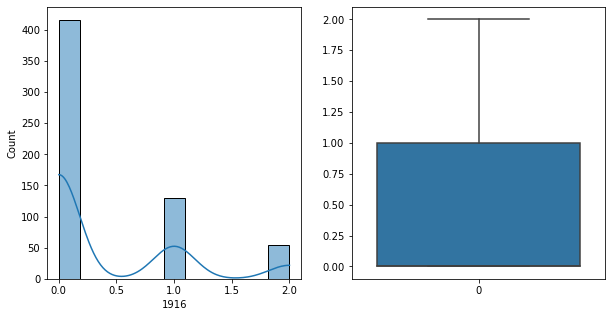

1916   Unique :  [0 2 1]
--------------------------------------------------------------------
1916   N unique :  3
--------------------------------------------------------------------
1916   Value Counts :  0    416
1    130
2     54
Name: 1916, dtype: int64
--------------------------------------------------------------------



[ 1917 ]
show_df_info :  1917


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


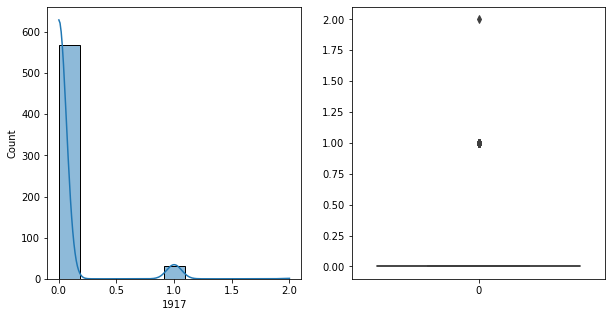

1917   Unique :  [0 1 2]
--------------------------------------------------------------------
1917   N unique :  3
--------------------------------------------------------------------
1917   Value Counts :  0    568
1     31
2      1
Name: 1917, dtype: int64
--------------------------------------------------------------------



[ 1918 ]
show_df_info :  1918


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


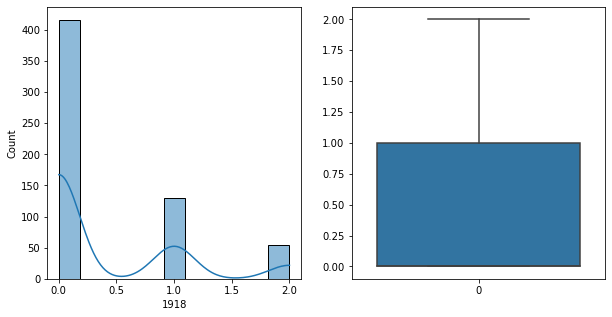

1918   Unique :  [0 2 1]
--------------------------------------------------------------------
1918   N unique :  3
--------------------------------------------------------------------
1918   Value Counts :  0    416
1    130
2     54
Name: 1918, dtype: int64
--------------------------------------------------------------------



[ 1919 ]
show_df_info :  1919


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


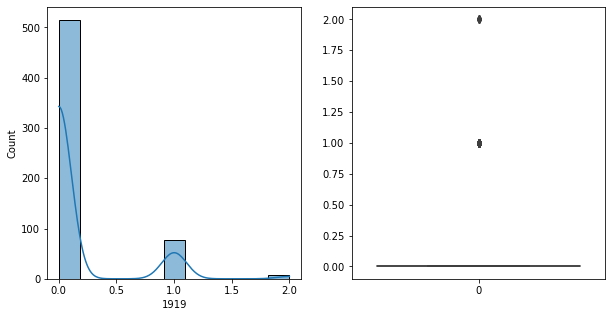

1919   Unique :  [2 0 1]
--------------------------------------------------------------------
1919   N unique :  3
--------------------------------------------------------------------
1919   Value Counts :  0    515
1     78
2      7
Name: 1919, dtype: int64
--------------------------------------------------------------------



[ 1920 ]
show_df_info :  1920


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


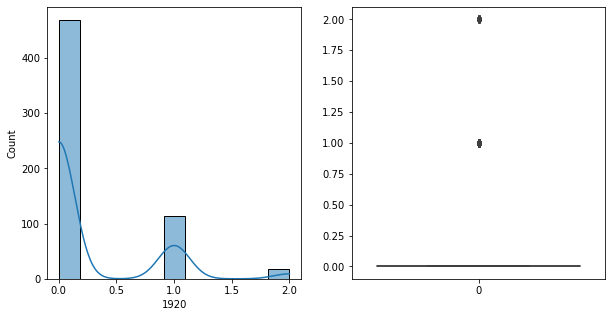

1920   Unique :  [2 0 1]
--------------------------------------------------------------------
1920   N unique :  3
--------------------------------------------------------------------
1920   Value Counts :  0    469
1    114
2     17
Name: 1920, dtype: int64
--------------------------------------------------------------------



[ 1921 ]
show_df_info :  1921


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


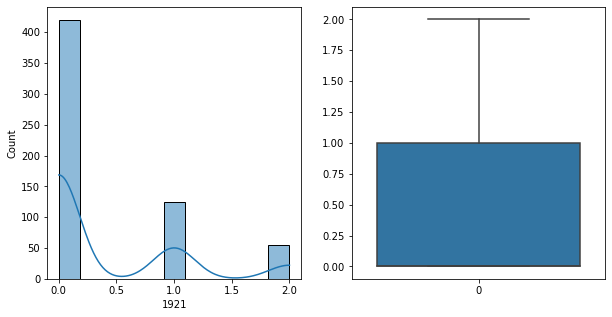

1921   Unique :  [0 2 1]
--------------------------------------------------------------------
1921   N unique :  3
--------------------------------------------------------------------
1921   Value Counts :  0    420
1    125
2     55
Name: 1921, dtype: int64
--------------------------------------------------------------------



[ 1922 ]
show_df_info :  1922


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


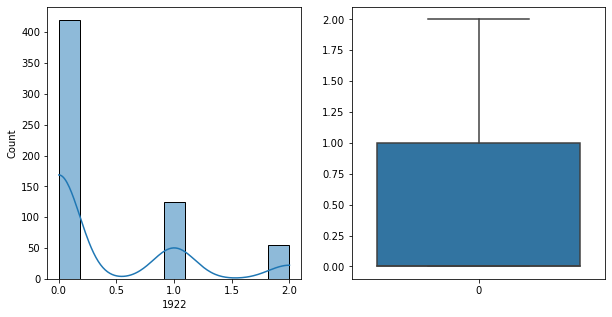

1922   Unique :  [0 2 1]
--------------------------------------------------------------------
1922   N unique :  3
--------------------------------------------------------------------
1922   Value Counts :  0    420
1    125
2     55
Name: 1922, dtype: int64
--------------------------------------------------------------------



[ 1923 ]
show_df_info :  1923


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


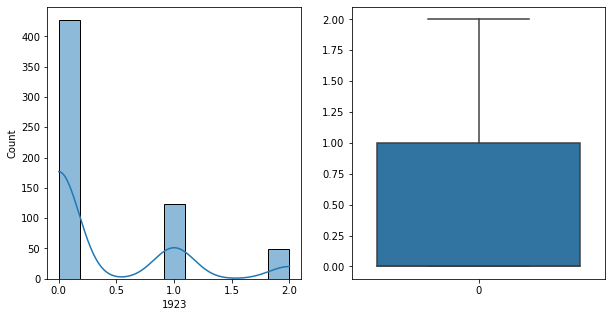

1923   Unique :  [0 2 1]
--------------------------------------------------------------------
1923   N unique :  3
--------------------------------------------------------------------
1923   Value Counts :  0    427
1    124
2     49
Name: 1923, dtype: int64
--------------------------------------------------------------------



[ 1924 ]
show_df_info :  1924


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


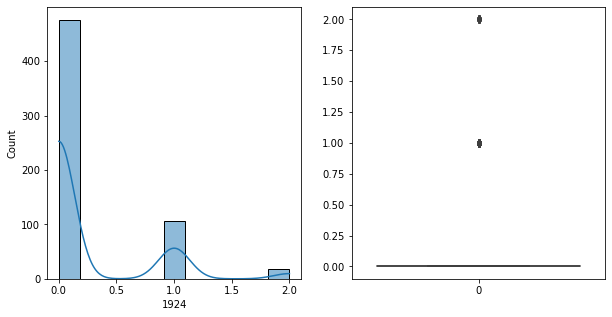

1924   Unique :  [2 0 1]
--------------------------------------------------------------------
1924   N unique :  3
--------------------------------------------------------------------
1924   Value Counts :  0    476
1    106
2     18
Name: 1924, dtype: int64
--------------------------------------------------------------------



[ 1925 ]
show_df_info :  1925


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


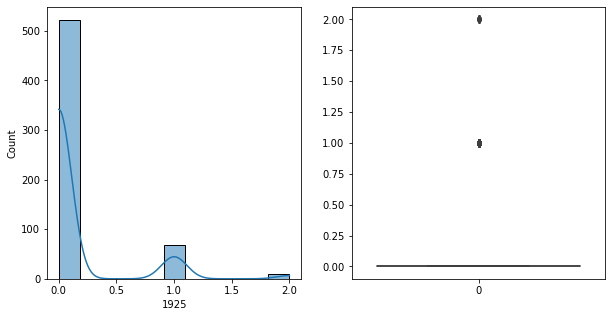

1925   Unique :  [0 1 2]
--------------------------------------------------------------------
1925   N unique :  3
--------------------------------------------------------------------
1925   Value Counts :  0    522
1     68
2     10
Name: 1925, dtype: int64
--------------------------------------------------------------------



[ 1926 ]
show_df_info :  1926


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


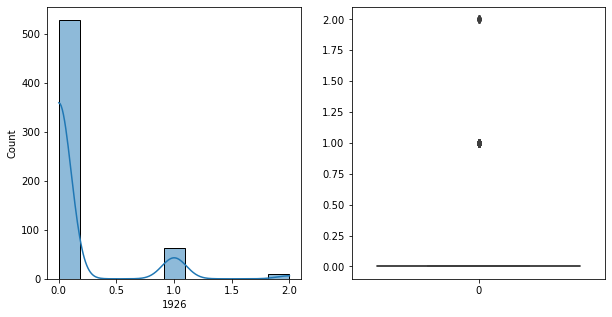

1926   Unique :  [0 1 2]
--------------------------------------------------------------------
1926   N unique :  3
--------------------------------------------------------------------
1926   Value Counts :  0    528
1     63
2      9
Name: 1926, dtype: int64
--------------------------------------------------------------------



[ 1927 ]
show_df_info :  1927


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


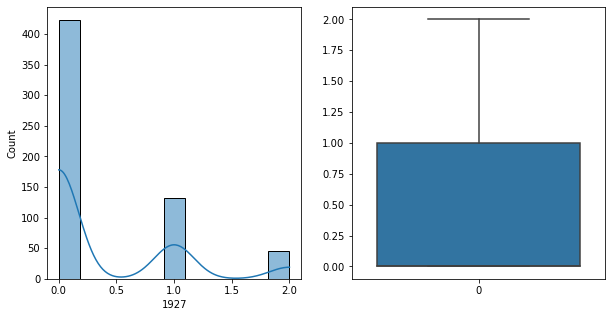

1927   Unique :  [0 2 1]
--------------------------------------------------------------------
1927   N unique :  3
--------------------------------------------------------------------
1927   Value Counts :  0    423
1    132
2     45
Name: 1927, dtype: int64
--------------------------------------------------------------------



[ 1928 ]
show_df_info :  1928


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


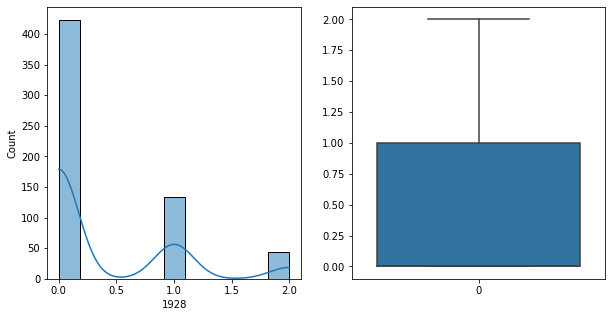

1928   Unique :  [0 2 1]
--------------------------------------------------------------------
1928   N unique :  3
--------------------------------------------------------------------
1928   Value Counts :  0    423
1    133
2     44
Name: 1928, dtype: int64
--------------------------------------------------------------------



[ 1929 ]
show_df_info :  1929


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


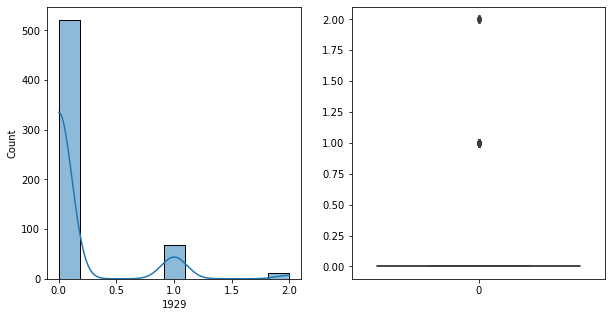

1929   Unique :  [0 1 2]
--------------------------------------------------------------------
1929   N unique :  3
--------------------------------------------------------------------
1929   Value Counts :  0    521
1     68
2     11
Name: 1929, dtype: int64
--------------------------------------------------------------------



[ 1930 ]
show_df_info :  1930


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


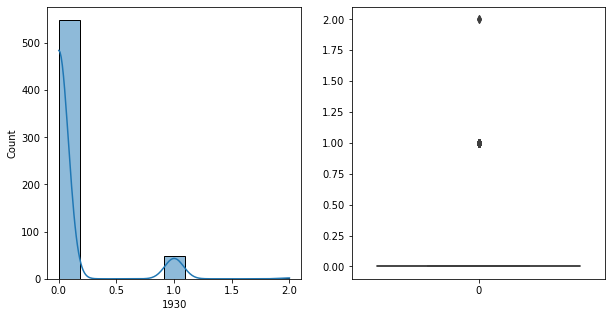

1930   Unique :  [0 1 2]
--------------------------------------------------------------------
1930   N unique :  3
--------------------------------------------------------------------
1930   Value Counts :  0    549
1     49
2      2
Name: 1930, dtype: int64
--------------------------------------------------------------------



[ 1931 ]
show_df_info :  1931


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


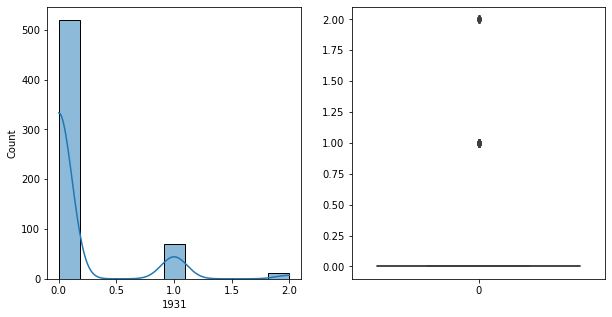

1931   Unique :  [0 1 2]
--------------------------------------------------------------------
1931   N unique :  3
--------------------------------------------------------------------
1931   Value Counts :  0    520
1     69
2     11
Name: 1931, dtype: int64
--------------------------------------------------------------------



[ 1932 ]
show_df_info :  1932


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


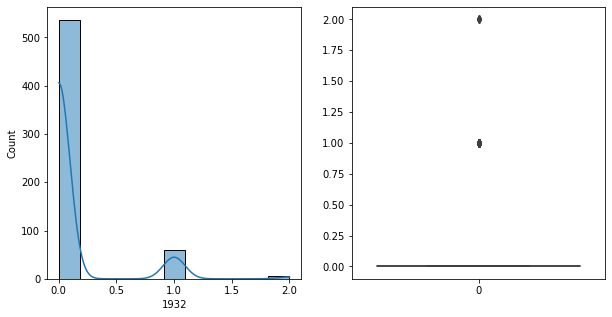

1932   Unique :  [0 1 2]
--------------------------------------------------------------------
1932   N unique :  3
--------------------------------------------------------------------
1932   Value Counts :  0    536
1     59
2      5
Name: 1932, dtype: int64
--------------------------------------------------------------------



[ 1933 ]
show_df_info :  1933


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


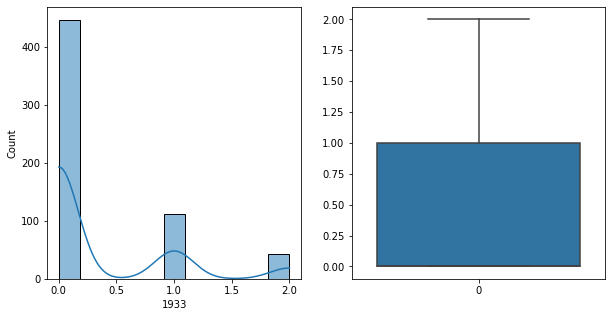

1933   Unique :  [0 1 2]
--------------------------------------------------------------------
1933   N unique :  3
--------------------------------------------------------------------
1933   Value Counts :  0    446
1    111
2     43
Name: 1933, dtype: int64
--------------------------------------------------------------------



[ 1934 ]
show_df_info :  1934


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


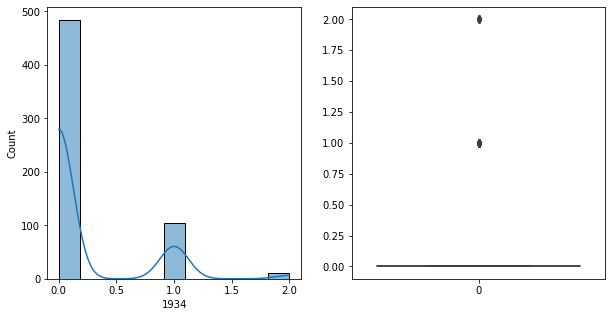

1934   Unique :  [0 1 2]
--------------------------------------------------------------------
1934   N unique :  3
--------------------------------------------------------------------
1934   Value Counts :  0    484
1    105
2     11
Name: 1934, dtype: int64
--------------------------------------------------------------------



[ 1935 ]
show_df_info :  1935


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


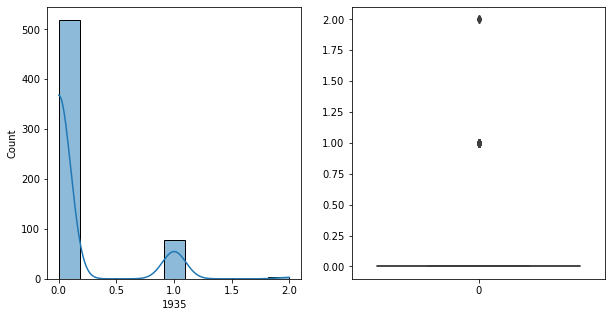

1935   Unique :  [0 1 2]
--------------------------------------------------------------------
1935   N unique :  3
--------------------------------------------------------------------
1935   Value Counts :  0    519
1     77
2      4
Name: 1935, dtype: int64
--------------------------------------------------------------------



[ 1936 ]
show_df_info :  1936


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


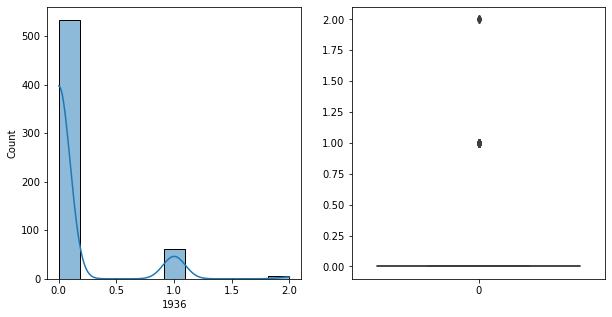

1936   Unique :  [2 0 1]
--------------------------------------------------------------------
1936   N unique :  3
--------------------------------------------------------------------
1936   Value Counts :  0    533
1     62
2      5
Name: 1936, dtype: int64
--------------------------------------------------------------------



[ 1937 ]
show_df_info :  1937


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


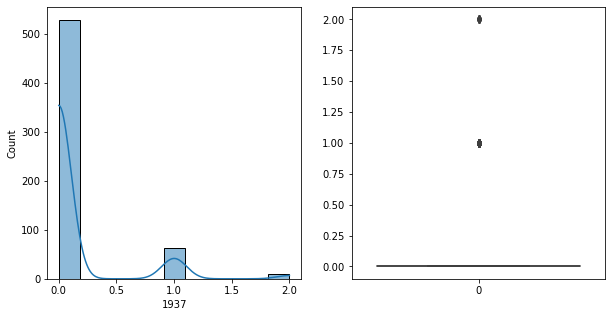

1937   Unique :  [0 1 2]
--------------------------------------------------------------------
1937   N unique :  3
--------------------------------------------------------------------
1937   Value Counts :  0    528
1     62
2     10
Name: 1937, dtype: int64
--------------------------------------------------------------------



[ 1938 ]
show_df_info :  1938


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


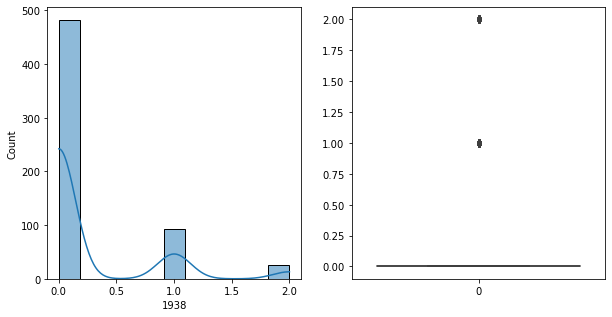

1938   Unique :  [1 0 2]
--------------------------------------------------------------------
1938   N unique :  3
--------------------------------------------------------------------
1938   Value Counts :  0    482
1     92
2     26
Name: 1938, dtype: int64
--------------------------------------------------------------------



[ 1939 ]
show_df_info :  1939


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


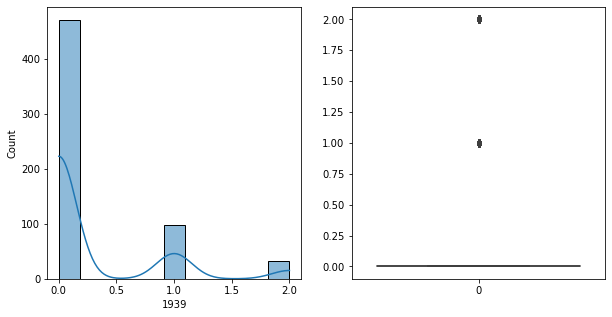

1939   Unique :  [1 0 2]
--------------------------------------------------------------------
1939   N unique :  3
--------------------------------------------------------------------
1939   Value Counts :  0    471
1     97
2     32
Name: 1939, dtype: int64
--------------------------------------------------------------------



[ 1940 ]
show_df_info :  1940


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


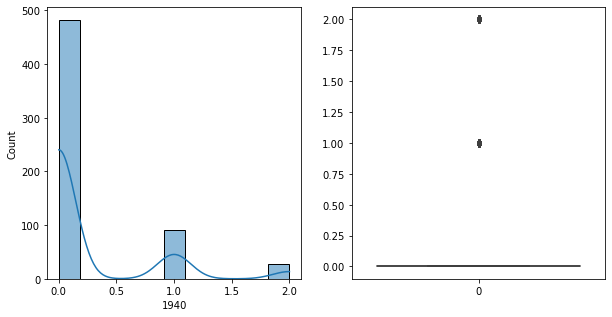

1940   Unique :  [1 0 2]
--------------------------------------------------------------------
1940   N unique :  3
--------------------------------------------------------------------
1940   Value Counts :  0    482
1     91
2     27
Name: 1940, dtype: int64
--------------------------------------------------------------------



[ 1941 ]
show_df_info :  1941


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


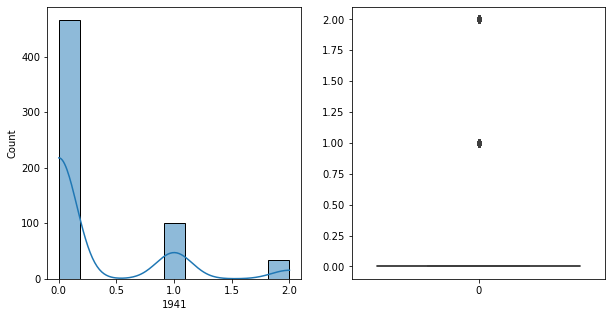

1941   Unique :  [1 0 2]
--------------------------------------------------------------------
1941   N unique :  3
--------------------------------------------------------------------
1941   Value Counts :  0    466
1    101
2     33
Name: 1941, dtype: int64
--------------------------------------------------------------------



[ 1942 ]
show_df_info :  1942


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


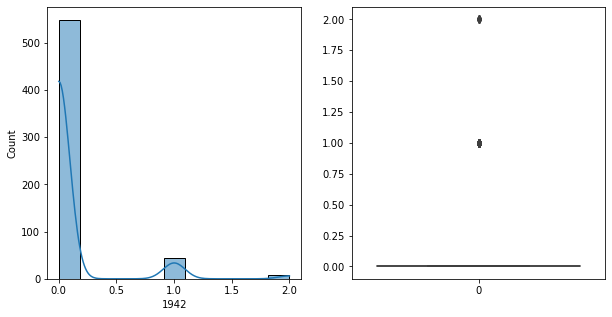

1942   Unique :  [1 0 2]
--------------------------------------------------------------------
1942   N unique :  3
--------------------------------------------------------------------
1942   Value Counts :  0    548
1     44
2      8
Name: 1942, dtype: int64
--------------------------------------------------------------------



[ 1943 ]
show_df_info :  1943


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


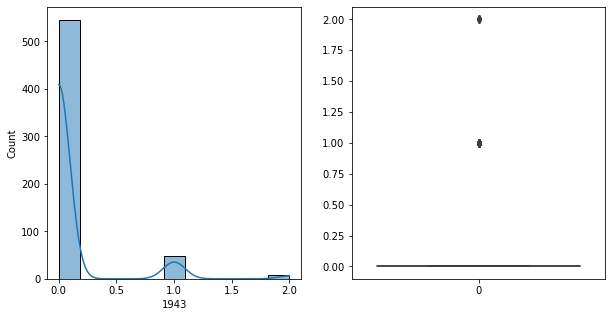

1943   Unique :  [1 0 2]
--------------------------------------------------------------------
1943   N unique :  3
--------------------------------------------------------------------
1943   Value Counts :  0    545
1     47
2      8
Name: 1943, dtype: int64
--------------------------------------------------------------------



[ 1944 ]
show_df_info :  1944


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


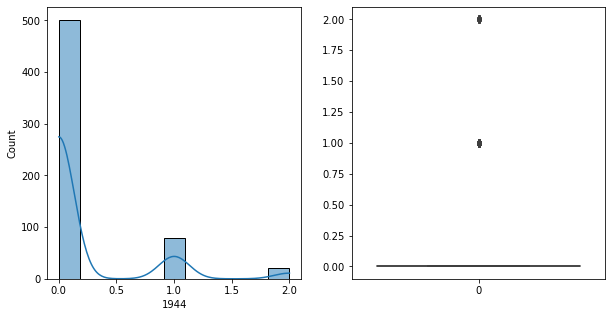

1944   Unique :  [1 0 2]
--------------------------------------------------------------------
1944   N unique :  3
--------------------------------------------------------------------
1944   Value Counts :  0    501
1     79
2     20
Name: 1944, dtype: int64
--------------------------------------------------------------------



[ 1945 ]
show_df_info :  1945


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


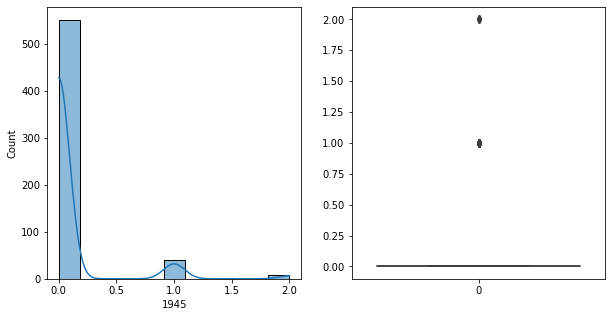

1945   Unique :  [0 1 2]
--------------------------------------------------------------------
1945   N unique :  3
--------------------------------------------------------------------
1945   Value Counts :  0    551
1     41
2      8
Name: 1945, dtype: int64
--------------------------------------------------------------------



[ 1946 ]
show_df_info :  1946


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


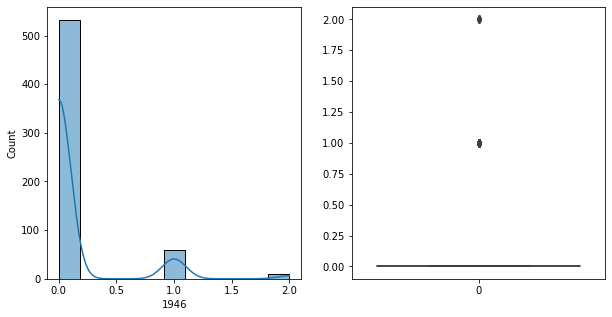

1946   Unique :  [0 1 2]
--------------------------------------------------------------------
1946   N unique :  3
--------------------------------------------------------------------
1946   Value Counts :  0    532
1     59
2      9
Name: 1946, dtype: int64
--------------------------------------------------------------------



[ 1947 ]
show_df_info :  1947


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


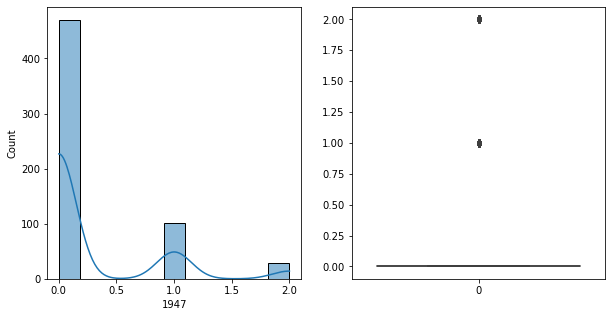

1947   Unique :  [1 0 2]
--------------------------------------------------------------------
1947   N unique :  3
--------------------------------------------------------------------
1947   Value Counts :  0    470
1    101
2     29
Name: 1947, dtype: int64
--------------------------------------------------------------------



[ 1948 ]
show_df_info :  1948


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


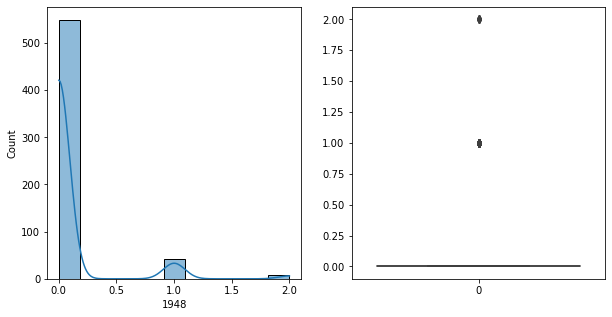

1948   Unique :  [1 0 2]
--------------------------------------------------------------------
1948   N unique :  3
--------------------------------------------------------------------
1948   Value Counts :  0    549
1     43
2      8
Name: 1948, dtype: int64
--------------------------------------------------------------------



[ 1949 ]
show_df_info :  1949


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


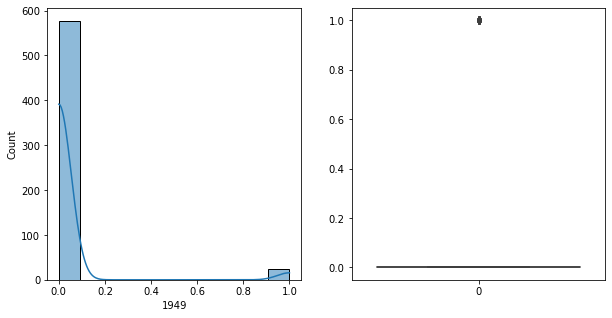

1949   Unique :  [0 1]
--------------------------------------------------------------------
1949   N unique :  2
--------------------------------------------------------------------
1949   Value Counts :  0    577
1     23
Name: 1949, dtype: int64
--------------------------------------------------------------------



[ 1950 ]
show_df_info :  1950


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


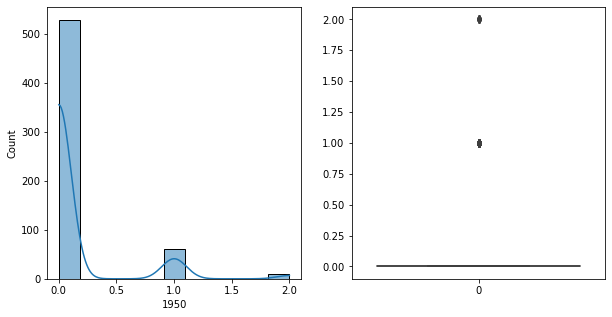

1950   Unique :  [0 1 2]
--------------------------------------------------------------------
1950   N unique :  3
--------------------------------------------------------------------
1950   Value Counts :  0    529
1     61
2     10
Name: 1950, dtype: int64
--------------------------------------------------------------------



[ 1951 ]
show_df_info :  1951


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


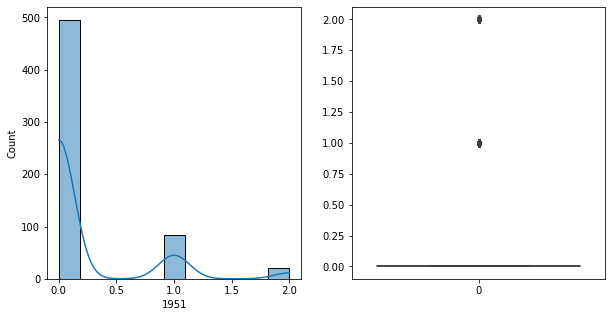

1951   Unique :  [1 0 2]
--------------------------------------------------------------------
1951   N unique :  3
--------------------------------------------------------------------
1951   Value Counts :  0    495
1     84
2     21
Name: 1951, dtype: int64
--------------------------------------------------------------------



[ 1952 ]
show_df_info :  1952


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


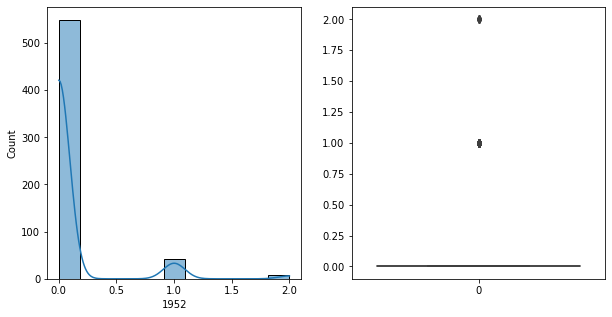

1952   Unique :  [1 0 2]
--------------------------------------------------------------------
1952   N unique :  3
--------------------------------------------------------------------
1952   Value Counts :  0    549
1     43
2      8
Name: 1952, dtype: int64
--------------------------------------------------------------------



[ 1953 ]
show_df_info :  1953


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


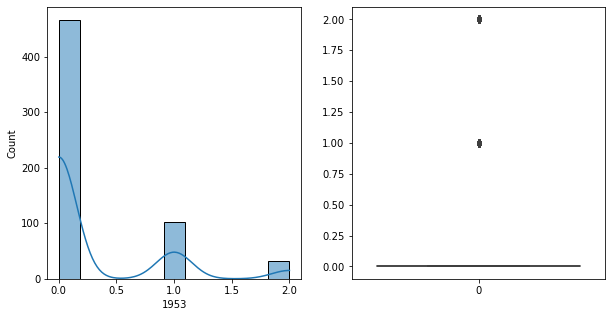

1953   Unique :  [1 0 2]
--------------------------------------------------------------------
1953   N unique :  3
--------------------------------------------------------------------
1953   Value Counts :  0    466
1    102
2     32
Name: 1953, dtype: int64
--------------------------------------------------------------------



[ 1954 ]
show_df_info :  1954


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


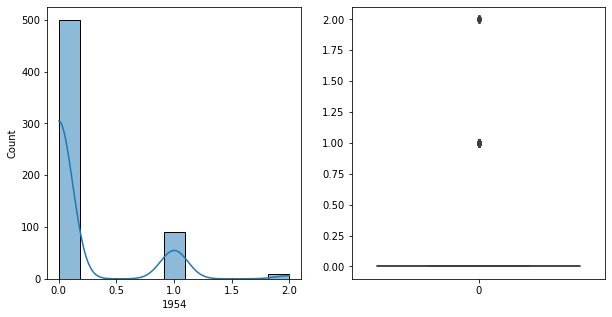

1954   Unique :  [1 0 2]
--------------------------------------------------------------------
1954   N unique :  3
--------------------------------------------------------------------
1954   Value Counts :  0    500
1     90
2     10
Name: 1954, dtype: int64
--------------------------------------------------------------------



[ 1955 ]
show_df_info :  1955


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


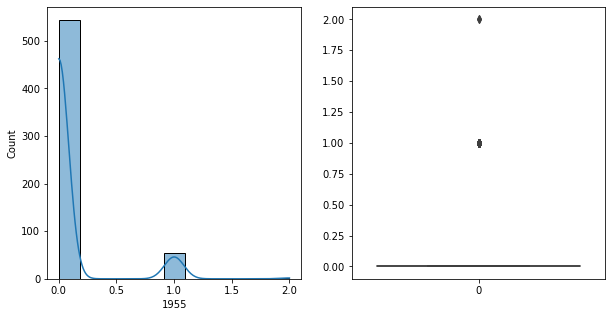

1955   Unique :  [0 1 2]
--------------------------------------------------------------------
1955   N unique :  3
--------------------------------------------------------------------
1955   Value Counts :  0    544
1     54
2      2
Name: 1955, dtype: int64
--------------------------------------------------------------------



[ 1956 ]
show_df_info :  1956


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


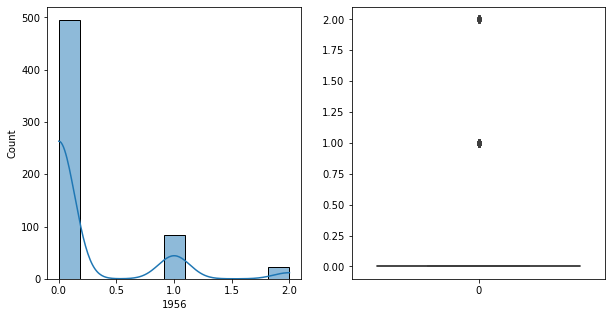

1956   Unique :  [2 0 1]
--------------------------------------------------------------------
1956   N unique :  3
--------------------------------------------------------------------
1956   Value Counts :  0    495
1     83
2     22
Name: 1956, dtype: int64
--------------------------------------------------------------------



[ 1957 ]
show_df_info :  1957


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


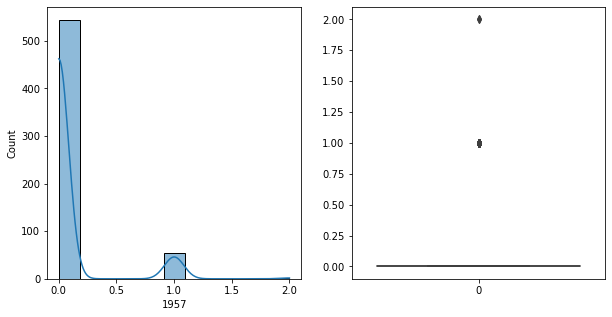

1957   Unique :  [0 1 2]
--------------------------------------------------------------------
1957   N unique :  3
--------------------------------------------------------------------
1957   Value Counts :  0    544
1     54
2      2
Name: 1957, dtype: int64
--------------------------------------------------------------------



[ 1958 ]
show_df_info :  1958


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


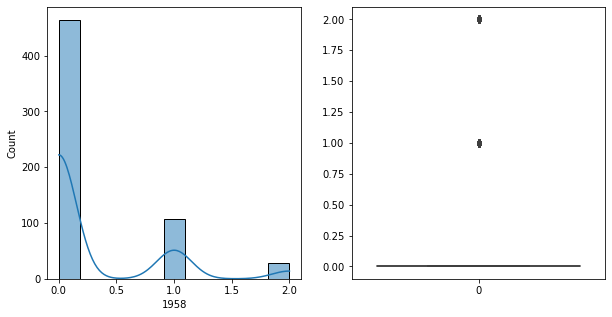

1958   Unique :  [0 2 1]
--------------------------------------------------------------------
1958   N unique :  3
--------------------------------------------------------------------
1958   Value Counts :  0    464
1    107
2     29
Name: 1958, dtype: int64
--------------------------------------------------------------------



[ 1959 ]
show_df_info :  1959


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


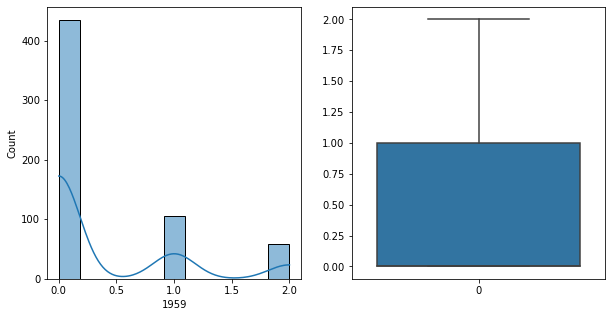

1959   Unique :  [0 2 1]
--------------------------------------------------------------------
1959   N unique :  3
--------------------------------------------------------------------
1959   Value Counts :  0    435
1    106
2     59
Name: 1959, dtype: int64
--------------------------------------------------------------------



[ 1960 ]
show_df_info :  1960


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


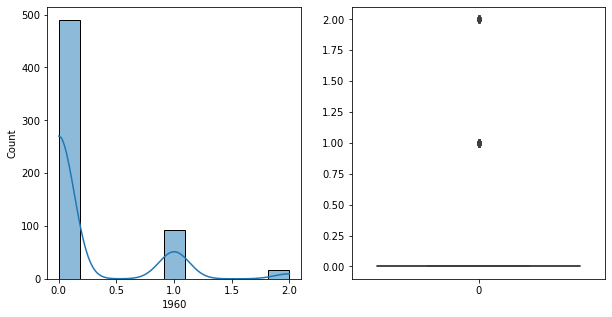

1960   Unique :  [1 0 2]
--------------------------------------------------------------------
1960   N unique :  3
--------------------------------------------------------------------
1960   Value Counts :  0    490
1     93
2     17
Name: 1960, dtype: int64
--------------------------------------------------------------------



[ 1961 ]
show_df_info :  1961


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


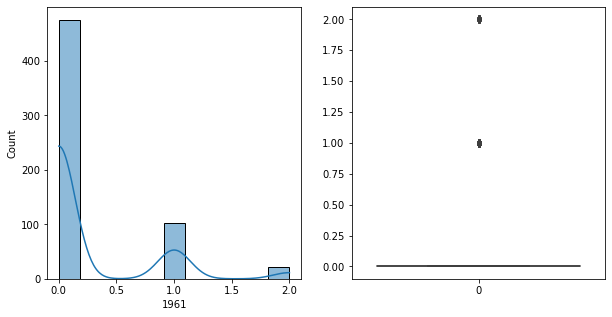

1961   Unique :  [1 0 2]
--------------------------------------------------------------------
1961   N unique :  3
--------------------------------------------------------------------
1961   Value Counts :  0    475
1    103
2     22
Name: 1961, dtype: int64
--------------------------------------------------------------------



[ 1962 ]
show_df_info :  1962


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


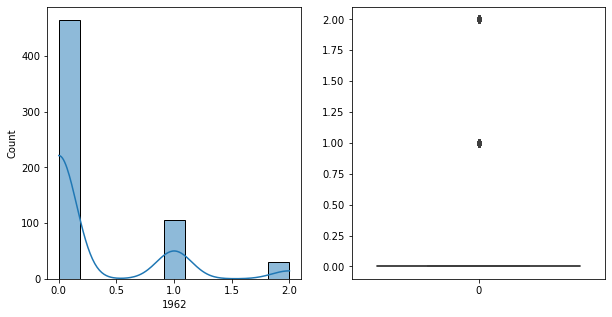

1962   Unique :  [1 0 2]
--------------------------------------------------------------------
1962   N unique :  3
--------------------------------------------------------------------
1962   Value Counts :  0    465
1    105
2     30
Name: 1962, dtype: int64
--------------------------------------------------------------------



[ 1963 ]
show_df_info :  1963


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


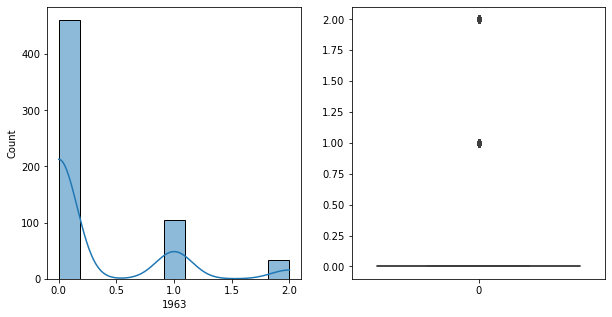

1963   Unique :  [1 0 2]
--------------------------------------------------------------------
1963   N unique :  3
--------------------------------------------------------------------
1963   Value Counts :  0    461
1    105
2     34
Name: 1963, dtype: int64
--------------------------------------------------------------------



[ 1964 ]
show_df_info :  1964


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


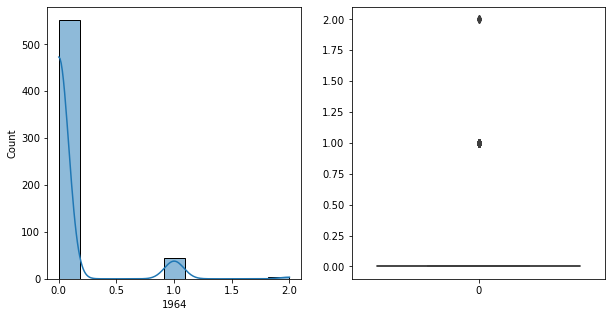

1964   Unique :  [1 0 2]
--------------------------------------------------------------------
1964   N unique :  3
--------------------------------------------------------------------
1964   Value Counts :  0    552
1     44
2      4
Name: 1964, dtype: int64
--------------------------------------------------------------------



[ 1965 ]
show_df_info :  1965


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


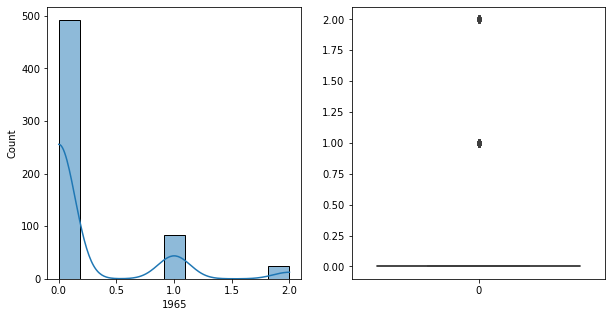

1965   Unique :  [0 2 1]
--------------------------------------------------------------------
1965   N unique :  3
--------------------------------------------------------------------
1965   Value Counts :  0    492
1     84
2     24
Name: 1965, dtype: int64
--------------------------------------------------------------------



[ 1966 ]
show_df_info :  1966


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


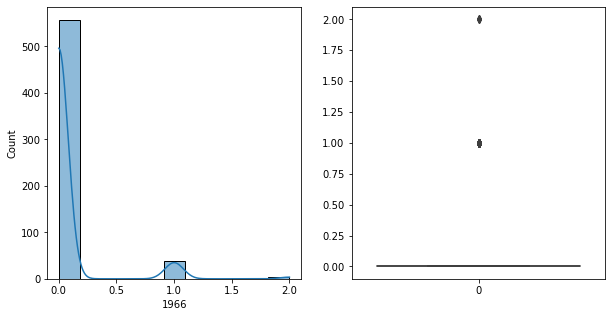

1966   Unique :  [1 0 2]
--------------------------------------------------------------------
1966   N unique :  3
--------------------------------------------------------------------
1966   Value Counts :  0    557
1     39
2      4
Name: 1966, dtype: int64
--------------------------------------------------------------------



[ 1967 ]
show_df_info :  1967


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


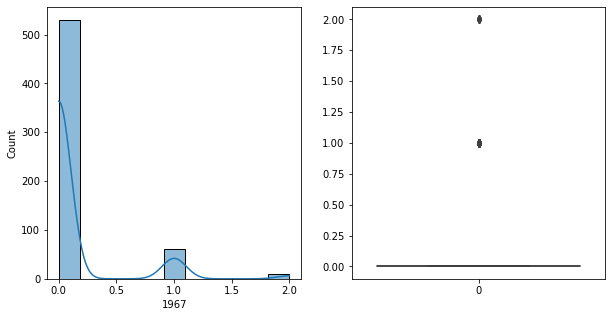

1967   Unique :  [0 2 1]
--------------------------------------------------------------------
1967   N unique :  3
--------------------------------------------------------------------
1967   Value Counts :  0    530
1     61
2      9
Name: 1967, dtype: int64
--------------------------------------------------------------------



[ 1968 ]
show_df_info :  1968


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


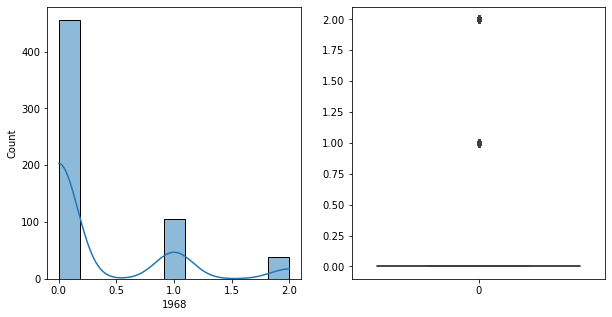

1968   Unique :  [1 0 2]
--------------------------------------------------------------------
1968   N unique :  3
--------------------------------------------------------------------
1968   Value Counts :  0    456
1    105
2     39
Name: 1968, dtype: int64
--------------------------------------------------------------------



[ 1969 ]
show_df_info :  1969


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


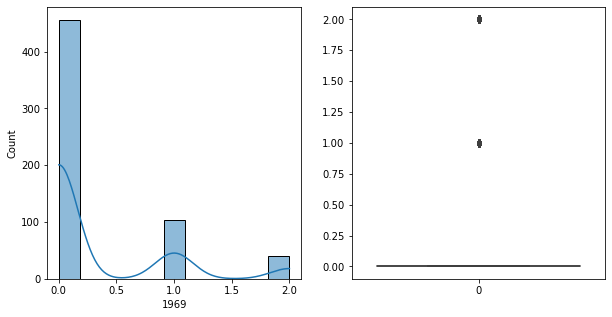

1969   Unique :  [1 0 2]
--------------------------------------------------------------------
1969   N unique :  3
--------------------------------------------------------------------
1969   Value Counts :  0    456
1    103
2     41
Name: 1969, dtype: int64
--------------------------------------------------------------------



[ 1970 ]
show_df_info :  1970


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


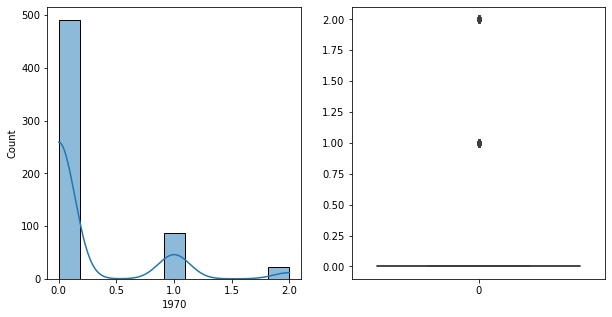

1970   Unique :  [0 2 1]
--------------------------------------------------------------------
1970   N unique :  3
--------------------------------------------------------------------
1970   Value Counts :  0    491
1     87
2     22
Name: 1970, dtype: int64
--------------------------------------------------------------------



[ 1971 ]
show_df_info :  1971


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


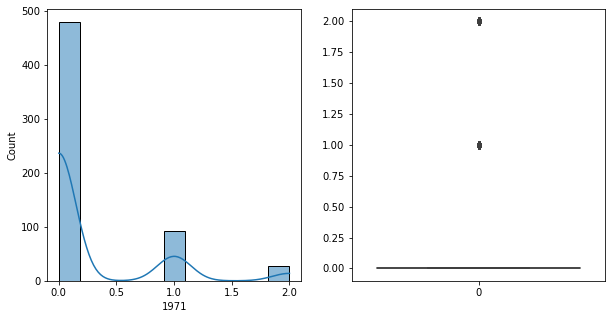

1971   Unique :  [0 2 1]
--------------------------------------------------------------------
1971   N unique :  3
--------------------------------------------------------------------
1971   Value Counts :  0    480
1     92
2     28
Name: 1971, dtype: int64
--------------------------------------------------------------------



[ 1972 ]
show_df_info :  1972


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


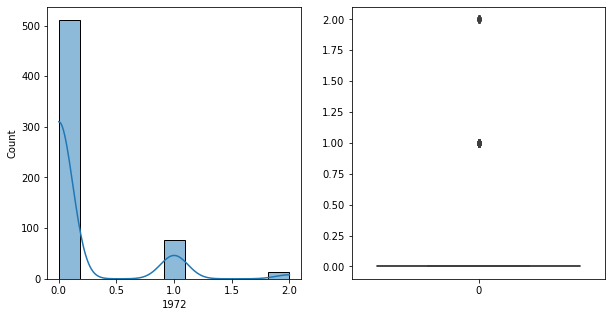

1972   Unique :  [0 1 2]
--------------------------------------------------------------------
1972   N unique :  3
--------------------------------------------------------------------
1972   Value Counts :  0    511
1     76
2     13
Name: 1972, dtype: int64
--------------------------------------------------------------------



[ 1973 ]
show_df_info :  1973


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


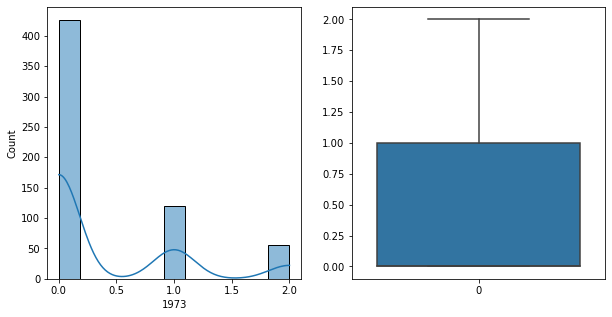

1973   Unique :  [1 0 2]
--------------------------------------------------------------------
1973   N unique :  3
--------------------------------------------------------------------
1973   Value Counts :  0    426
1    119
2     55
Name: 1973, dtype: int64
--------------------------------------------------------------------



[ 1974 ]
show_df_info :  1974


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


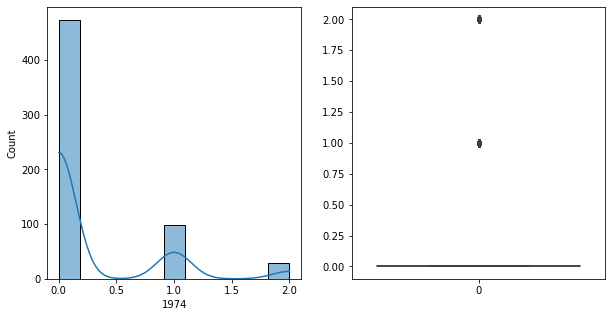

1974   Unique :  [0 1 2]
--------------------------------------------------------------------
1974   N unique :  3
--------------------------------------------------------------------
1974   Value Counts :  0    473
1     99
2     28
Name: 1974, dtype: int64
--------------------------------------------------------------------



[ 1975 ]
show_df_info :  1975


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


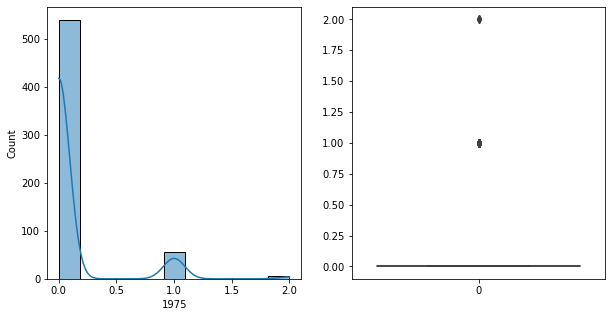

1975   Unique :  [1 0 2]
--------------------------------------------------------------------
1975   N unique :  3
--------------------------------------------------------------------
1975   Value Counts :  0    540
1     55
2      5
Name: 1975, dtype: int64
--------------------------------------------------------------------



[ 1976 ]
show_df_info :  1976


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


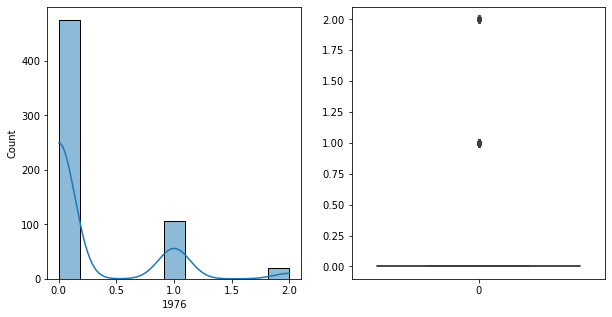

1976   Unique :  [1 0 2]
--------------------------------------------------------------------
1976   N unique :  3
--------------------------------------------------------------------
1976   Value Counts :  0    475
1    106
2     19
Name: 1976, dtype: int64
--------------------------------------------------------------------



[ 1977 ]
show_df_info :  1977


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


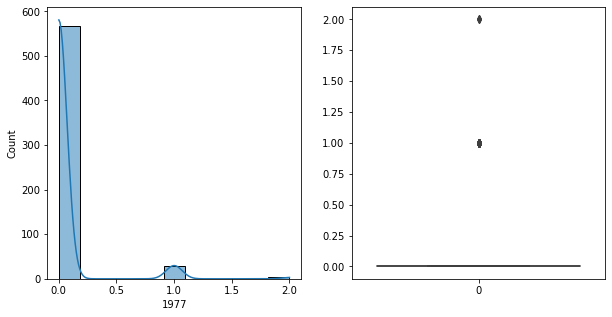

1977   Unique :  [0 1 2]
--------------------------------------------------------------------
1977   N unique :  3
--------------------------------------------------------------------
1977   Value Counts :  0    568
1     29
2      3
Name: 1977, dtype: int64
--------------------------------------------------------------------



[ 1978 ]
show_df_info :  1978


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


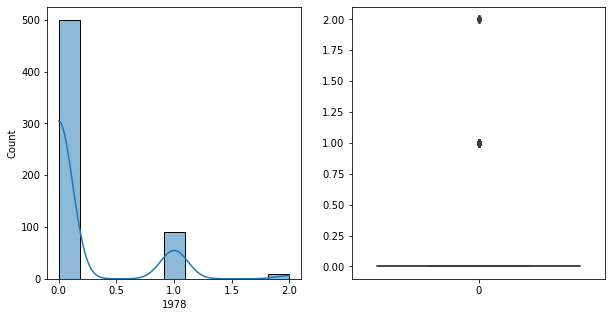

1978   Unique :  [1 0 2]
--------------------------------------------------------------------
1978   N unique :  3
--------------------------------------------------------------------
1978   Value Counts :  0    500
1     90
2     10
Name: 1978, dtype: int64
--------------------------------------------------------------------



[ 1979 ]
show_df_info :  1979


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


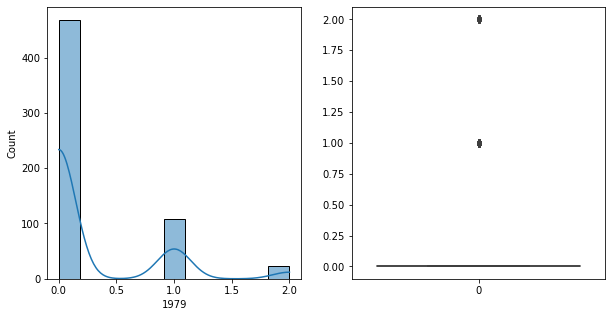

1979   Unique :  [2 0 1]
--------------------------------------------------------------------
1979   N unique :  3
--------------------------------------------------------------------
1979   Value Counts :  0    468
1    108
2     24
Name: 1979, dtype: int64
--------------------------------------------------------------------



[ 1980 ]
show_df_info :  1980


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


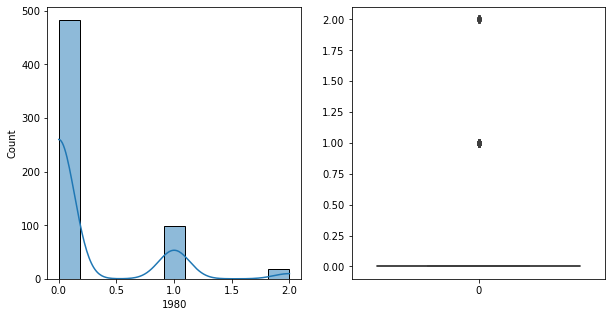

1980   Unique :  [1 0 2]
--------------------------------------------------------------------
1980   N unique :  3
--------------------------------------------------------------------
1980   Value Counts :  0    483
1     99
2     18
Name: 1980, dtype: int64
--------------------------------------------------------------------



[ 1981 ]
show_df_info :  1981


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


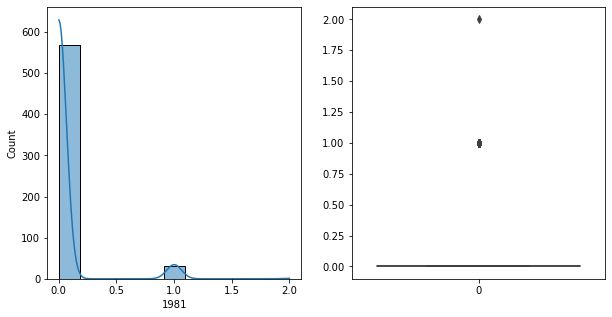

1981   Unique :  [0 1 2]
--------------------------------------------------------------------
1981   N unique :  3
--------------------------------------------------------------------
1981   Value Counts :  0    568
1     31
2      1
Name: 1981, dtype: int64
--------------------------------------------------------------------



[ 1982 ]
show_df_info :  1982


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


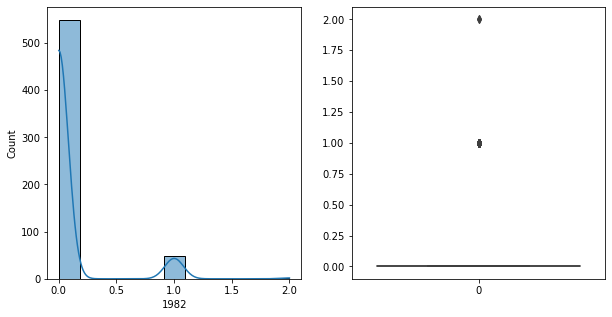

1982   Unique :  [2 0 1]
--------------------------------------------------------------------
1982   N unique :  3
--------------------------------------------------------------------
1982   Value Counts :  0    549
1     49
2      2
Name: 1982, dtype: int64
--------------------------------------------------------------------



[ 1983 ]
show_df_info :  1983


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


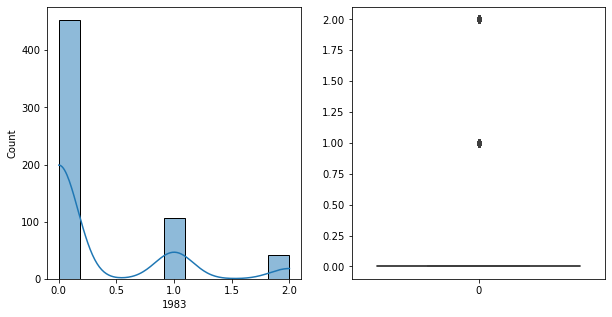

1983   Unique :  [0 2 1]
--------------------------------------------------------------------
1983   N unique :  3
--------------------------------------------------------------------
1983   Value Counts :  0    453
1    106
2     41
Name: 1983, dtype: int64
--------------------------------------------------------------------



[ 1984 ]
show_df_info :  1984


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


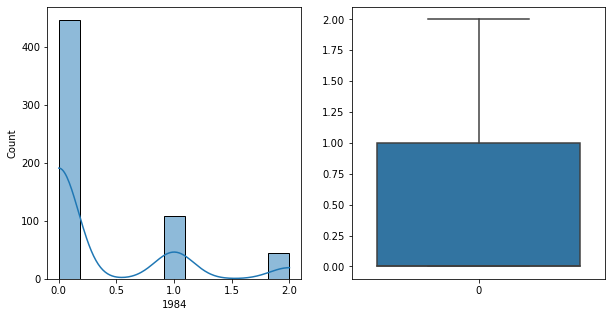

1984   Unique :  [0 2 1]
--------------------------------------------------------------------
1984   N unique :  3
--------------------------------------------------------------------
1984   Value Counts :  0    447
1    108
2     45
Name: 1984, dtype: int64
--------------------------------------------------------------------



[ 1985 ]
show_df_info :  1985


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


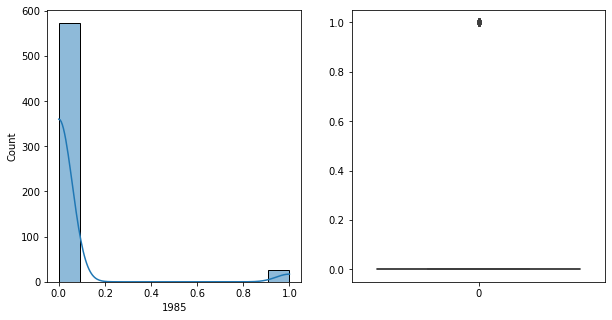

1985   Unique :  [0 1]
--------------------------------------------------------------------
1985   N unique :  2
--------------------------------------------------------------------
1985   Value Counts :  0    573
1     27
Name: 1985, dtype: int64
--------------------------------------------------------------------



[ 1986 ]
show_df_info :  1986


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


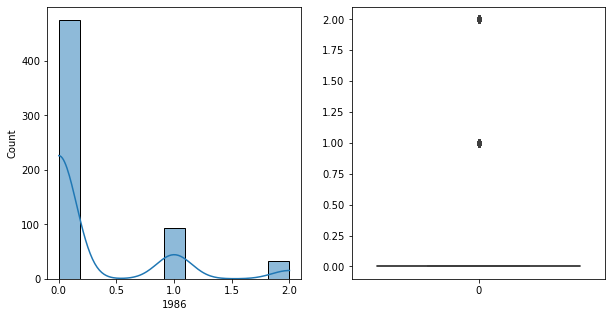

1986   Unique :  [0 2 1]
--------------------------------------------------------------------
1986   N unique :  3
--------------------------------------------------------------------
1986   Value Counts :  0    475
1     93
2     32
Name: 1986, dtype: int64
--------------------------------------------------------------------



[ 1987 ]
show_df_info :  1987


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


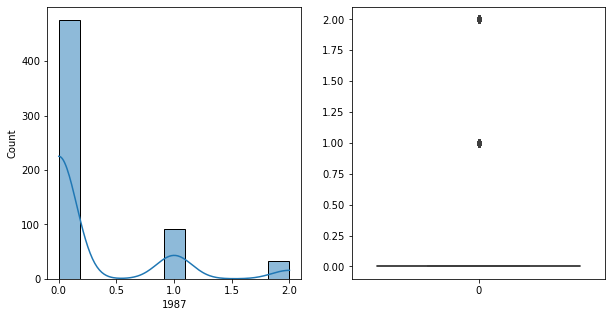

1987   Unique :  [0 2 1]
--------------------------------------------------------------------
1987   N unique :  3
--------------------------------------------------------------------
1987   Value Counts :  0    476
1     91
2     33
Name: 1987, dtype: int64
--------------------------------------------------------------------



[ 1988 ]
show_df_info :  1988


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


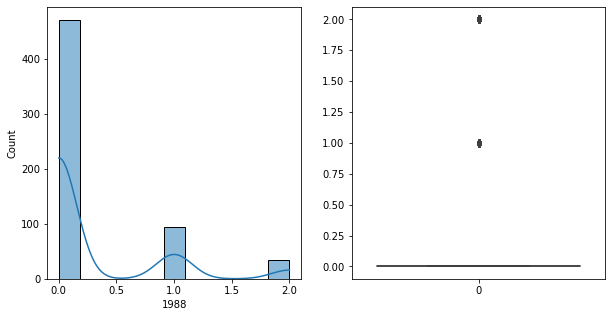

1988   Unique :  [0 2 1]
--------------------------------------------------------------------
1988   N unique :  3
--------------------------------------------------------------------
1988   Value Counts :  0    471
1     95
2     34
Name: 1988, dtype: int64
--------------------------------------------------------------------



[ 1989 ]
show_df_info :  1989


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


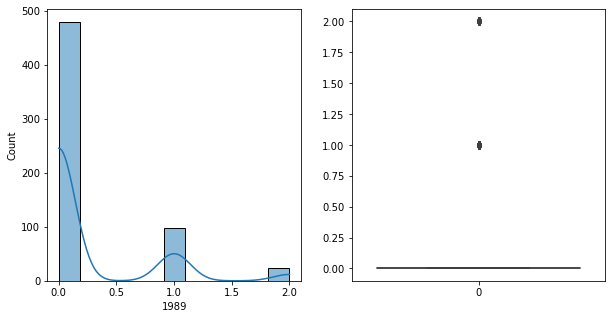

1989   Unique :  [1 0 2]
--------------------------------------------------------------------
1989   N unique :  3
--------------------------------------------------------------------
1989   Value Counts :  0    479
1     98
2     23
Name: 1989, dtype: int64
--------------------------------------------------------------------



[ 1990 ]
show_df_info :  1990


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


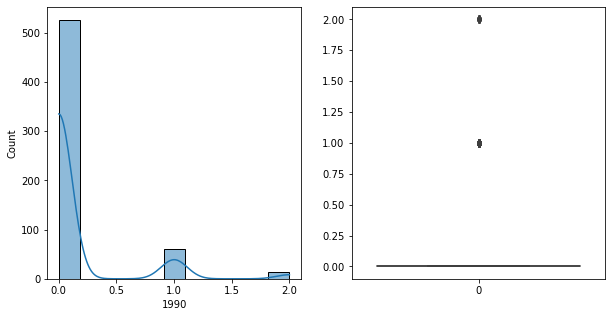

1990   Unique :  [0 1 2]
--------------------------------------------------------------------
1990   N unique :  3
--------------------------------------------------------------------
1990   Value Counts :  0    526
1     61
2     13
Name: 1990, dtype: int64
--------------------------------------------------------------------



[ 1991 ]
show_df_info :  1991


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


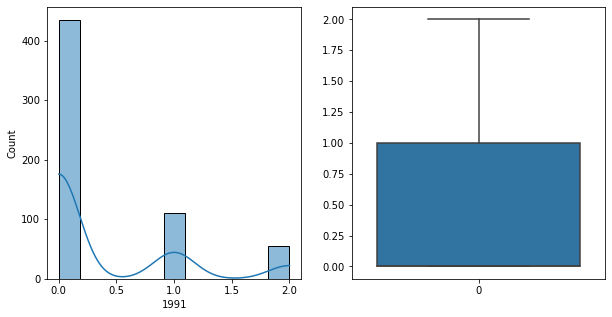

1991   Unique :  [2 0 1]
--------------------------------------------------------------------
1991   N unique :  3
--------------------------------------------------------------------
1991   Value Counts :  0    435
1    110
2     55
Name: 1991, dtype: int64
--------------------------------------------------------------------



[ 1992 ]
show_df_info :  1992


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


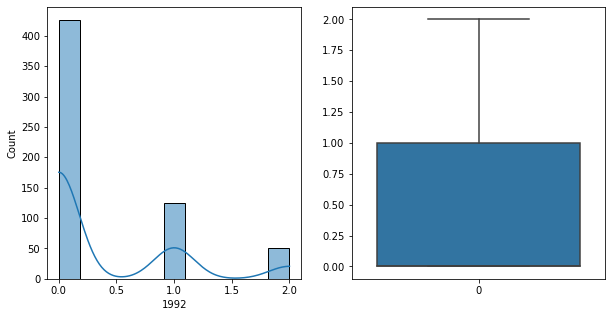

1992   Unique :  [2 0 1]
--------------------------------------------------------------------
1992   N unique :  3
--------------------------------------------------------------------
1992   Value Counts :  0    426
1    124
2     50
Name: 1992, dtype: int64
--------------------------------------------------------------------



[ 1993 ]
show_df_info :  1993


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


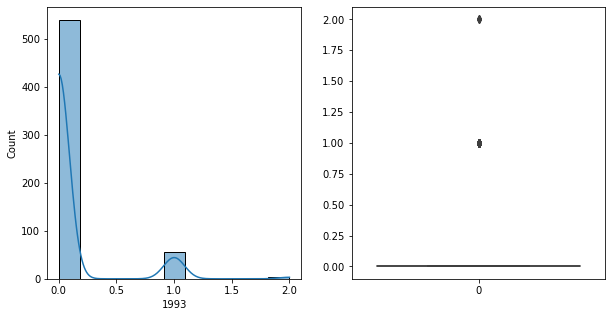

1993   Unique :  [1 0 2]
--------------------------------------------------------------------
1993   N unique :  3
--------------------------------------------------------------------
1993   Value Counts :  0    540
1     56
2      4
Name: 1993, dtype: int64
--------------------------------------------------------------------



[ 1994 ]
show_df_info :  1994


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


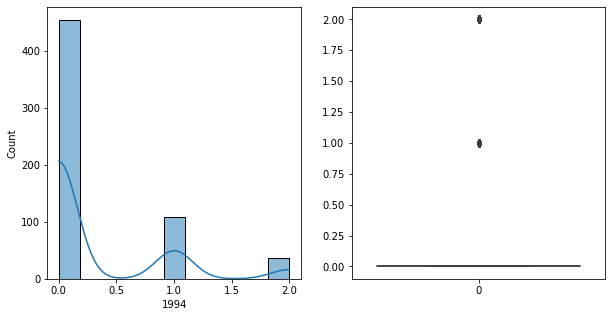

1994   Unique :  [1 0 2]
--------------------------------------------------------------------
1994   N unique :  3
--------------------------------------------------------------------
1994   Value Counts :  0    455
1    109
2     36
Name: 1994, dtype: int64
--------------------------------------------------------------------



[ 1995 ]
show_df_info :  1995


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


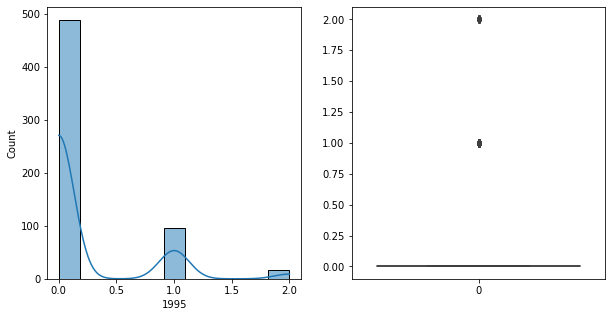

1995   Unique :  [0 1 2]
--------------------------------------------------------------------
1995   N unique :  3
--------------------------------------------------------------------
1995   Value Counts :  0    488
1     96
2     16
Name: 1995, dtype: int64
--------------------------------------------------------------------



[ 1996 ]
show_df_info :  1996


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


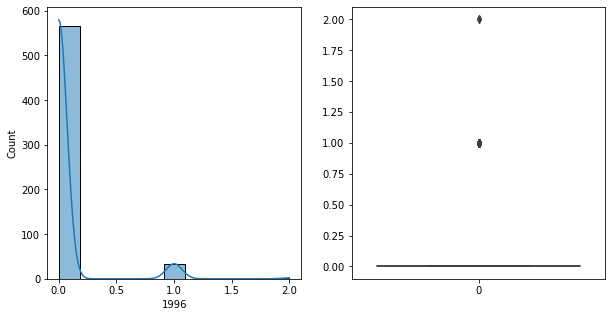

1996   Unique :  [0 1 2]
--------------------------------------------------------------------
1996   N unique :  3
--------------------------------------------------------------------
1996   Value Counts :  0    565
1     33
2      2
Name: 1996, dtype: int64
--------------------------------------------------------------------



[ 1997 ]
show_df_info :  1997


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


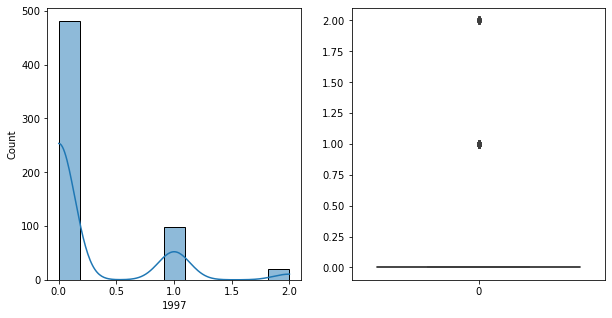

1997   Unique :  [1 0 2]
--------------------------------------------------------------------
1997   N unique :  3
--------------------------------------------------------------------
1997   Value Counts :  0    481
1     99
2     20
Name: 1997, dtype: int64
--------------------------------------------------------------------



[ 1998 ]
show_df_info :  1998


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


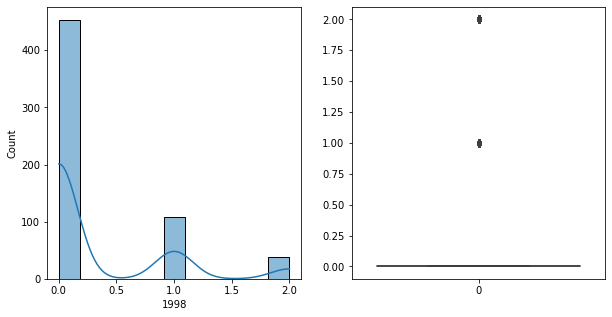

1998   Unique :  [2 0 1]
--------------------------------------------------------------------
1998   N unique :  3
--------------------------------------------------------------------
1998   Value Counts :  0    453
1    108
2     39
Name: 1998, dtype: int64
--------------------------------------------------------------------



[ 1999 ]
show_df_info :  1999


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


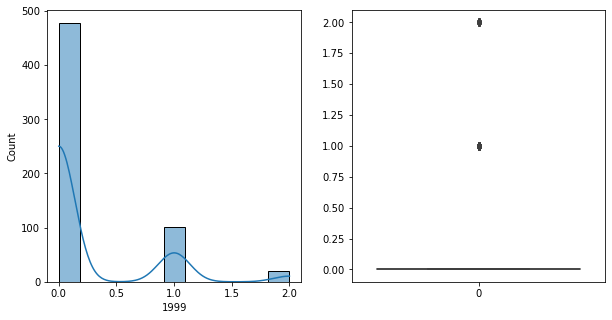

1999   Unique :  [2 0 1]
--------------------------------------------------------------------
1999   N unique :  3
--------------------------------------------------------------------
1999   Value Counts :  0    478
1    102
2     20
Name: 1999, dtype: int64
--------------------------------------------------------------------



[ 2000 ]
show_df_info :  2000


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


2000   Unique :  [1 0 2]
--------------------------------------------------------------------
2000   N unique :  3
--------------------------------------------------------------------
2000   Value Counts :  0    469
1    100
2     31
Name: 2000, dtype: int64
--------------------------------------------------------------------



[ 2001 ]
show_df_info :  2001


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


2001   Unique :  [1 0 2]
--------------------------------------------------------------------
2001   N unique :  3
--------------------------------------------------------------------
2001   Value Counts :  0    440
1    113
2     47
Name: 2001, dtype: int64
--------------------------------------------------------------------



[ 2002 ]
show_df_info :  2002


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


2002   Unique :  [1 0 2]
--------------------------------------------------------------------
2002   N unique :  3
--------------------------------------------------------------------
2002   Value Counts :  0    557
1     40
2      3
Name: 2002, dtype: int64
--------------------------------------------------------------------



[ 2003 ]
show_df_info :  2003


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


2003   Unique :  [0 1 2]
--------------------------------------------------------------------
2003   N unique :  3
--------------------------------------------------------------------
2003   Value Counts :  0    470
1    103
2     27
Name: 2003, dtype: int64
--------------------------------------------------------------------



[ 2004 ]
show_df_info :  2004


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


2004   Unique :  [0 1 2]
--------------------------------------------------------------------
2004   N unique :  3
--------------------------------------------------------------------
2004   Value Counts :  0    509
1     80
2     11
Name: 2004, dtype: int64
--------------------------------------------------------------------



[ 2005 ]
show_df_info :  2005


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


2005   Unique :  [0 2 1]
--------------------------------------------------------------------
2005   N unique :  3
--------------------------------------------------------------------
2005   Value Counts :  0    447
1    112
2     41
Name: 2005, dtype: int64
--------------------------------------------------------------------



[ 2006 ]
show_df_info :  2006


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


2006   Unique :  [0 1 2]
--------------------------------------------------------------------
2006   N unique :  3
--------------------------------------------------------------------
2006   Value Counts :  0    484
1     88
2     28
Name: 2006, dtype: int64
--------------------------------------------------------------------



[ 2007 ]
show_df_info :  2007


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


2007   Unique :  [1 0 2]
--------------------------------------------------------------------
2007   N unique :  3
--------------------------------------------------------------------
2007   Value Counts :  0    525
1     68
2      7
Name: 2007, dtype: int64
--------------------------------------------------------------------



[ 2008 ]
show_df_info :  2008


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


2008   Unique :  [0 1 2]
--------------------------------------------------------------------
2008   N unique :  3
--------------------------------------------------------------------
2008   Value Counts :  0    457
1    105
2     38
Name: 2008, dtype: int64
--------------------------------------------------------------------



[ 2009 ]
show_df_info :  2009


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


2009   Unique :  [0 1 2]
--------------------------------------------------------------------
2009   N unique :  3
--------------------------------------------------------------------
2009   Value Counts :  0    444
1    114
2     42
Name: 2009, dtype: int64
--------------------------------------------------------------------



[ 2010 ]
show_df_info :  2010


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


2010   Unique :  [0 1 2]
--------------------------------------------------------------------
2010   N unique :  3
--------------------------------------------------------------------
2010   Value Counts :  0    443
1    114
2     43
Name: 2010, dtype: int64
--------------------------------------------------------------------



[ 2011 ]
show_df_info :  2011


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


2011   Unique :  [1 0 2]
--------------------------------------------------------------------
2011   N unique :  3
--------------------------------------------------------------------
2011   Value Counts :  0    519
1     74
2      7
Name: 2011, dtype: int64
--------------------------------------------------------------------



[ 2012 ]
show_df_info :  2012


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


2012   Unique :  [1 0 2]
--------------------------------------------------------------------
2012   N unique :  3
--------------------------------------------------------------------
2012   Value Counts :  0    453
1    111
2     36
Name: 2012, dtype: int64
--------------------------------------------------------------------



[ 2013 ]
show_df_info :  2013


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


2013   Unique :  [1 0]
--------------------------------------------------------------------
2013   N unique :  2
--------------------------------------------------------------------
2013   Value Counts :  0    557
1     43
Name: 2013, dtype: int64
--------------------------------------------------------------------



[ 2014 ]
show_df_info :  2014


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


2014   Unique :  [0 1 2]
--------------------------------------------------------------------
2014   N unique :  3
--------------------------------------------------------------------
2014   Value Counts :  0    545
1     52
2      3
Name: 2014, dtype: int64
--------------------------------------------------------------------



[ 2015 ]
show_df_info :  2015


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


2015   Unique :  [1 0 2]
--------------------------------------------------------------------
2015   N unique :  3
--------------------------------------------------------------------
2015   Value Counts :  0    504
1     86
2     10
Name: 2015, dtype: int64
--------------------------------------------------------------------



[ 2016 ]
show_df_info :  2016


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


2016   Unique :  [1 0 2]
--------------------------------------------------------------------
2016   N unique :  3
--------------------------------------------------------------------
2016   Value Counts :  0    460
1    107
2     33
Name: 2016, dtype: int64
--------------------------------------------------------------------



[ 2017 ]
show_df_info :  2017


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


2017   Unique :  [1 0 2]
--------------------------------------------------------------------
2017   N unique :  3
--------------------------------------------------------------------
2017   Value Counts :  0    445
1    112
2     43
Name: 2017, dtype: int64
--------------------------------------------------------------------



[ 2018 ]
show_df_info :  2018


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


2018   Unique :  [1 0 2]
--------------------------------------------------------------------
2018   N unique :  3
--------------------------------------------------------------------
2018   Value Counts :  0    505
1     85
2     10
Name: 2018, dtype: int64
--------------------------------------------------------------------



[ 2019 ]
show_df_info :  2019


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


2019   Unique :  [0 1 2]
--------------------------------------------------------------------
2019   N unique :  3
--------------------------------------------------------------------
2019   Value Counts :  0    533
1     59
2      8
Name: 2019, dtype: int64
--------------------------------------------------------------------



[ 2020 ]
show_df_info :  2020


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


2020   Unique :  [0 1 2]
--------------------------------------------------------------------
2020   N unique :  3
--------------------------------------------------------------------
2020   Value Counts :  0    509
1     76
2     15
Name: 2020, dtype: int64
--------------------------------------------------------------------



[ 2021 ]
show_df_info :  2021


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


2021   Unique :  [0 1 2]
--------------------------------------------------------------------
2021   N unique :  3
--------------------------------------------------------------------
2021   Value Counts :  0    521
1     67
2     12
Name: 2021, dtype: int64
--------------------------------------------------------------------



[ 2022 ]
show_df_info :  2022


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


2022   Unique :  [0 1 2]
--------------------------------------------------------------------
2022   N unique :  3
--------------------------------------------------------------------
2022   Value Counts :  0    518
1     69
2     13
Name: 2022, dtype: int64
--------------------------------------------------------------------



[ 2023 ]
show_df_info :  2023


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


2023   Unique :  [0 1 2]
--------------------------------------------------------------------
2023   N unique :  3
--------------------------------------------------------------------
2023   Value Counts :  0    495
1     92
2     13
Name: 2023, dtype: int64
--------------------------------------------------------------------



[ 2024 ]
show_df_info :  2024


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


2024   Unique :  [0 1 2]
--------------------------------------------------------------------
2024   N unique :  3
--------------------------------------------------------------------
2024   Value Counts :  0    505
1     82
2     13
Name: 2024, dtype: int64
--------------------------------------------------------------------



[ 2025 ]
show_df_info :  2025


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


2025   Unique :  [0 2 1]
--------------------------------------------------------------------
2025   N unique :  3
--------------------------------------------------------------------
2025   Value Counts :  0    436
1    110
2     54
Name: 2025, dtype: int64
--------------------------------------------------------------------



[ 2026 ]
show_df_info :  2026


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


2026   Unique :  [1 0 2]
--------------------------------------------------------------------
2026   N unique :  3
--------------------------------------------------------------------
2026   Value Counts :  0    434
1    124
2     42
Name: 2026, dtype: int64
--------------------------------------------------------------------



[ 2027 ]
show_df_info :  2027


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


2027   Unique :  [1 0 2]
--------------------------------------------------------------------
2027   N unique :  3
--------------------------------------------------------------------
2027   Value Counts :  0    456
1    115
2     29
Name: 2027, dtype: int64
--------------------------------------------------------------------



[ 2028 ]
show_df_info :  2028


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


2028   Unique :  [1 0 2]
--------------------------------------------------------------------
2028   N unique :  3
--------------------------------------------------------------------
2028   Value Counts :  0    451
1    118
2     31
Name: 2028, dtype: int64
--------------------------------------------------------------------



[ 2029 ]
show_df_info :  2029


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


2029   Unique :  [0 1 2]
--------------------------------------------------------------------
2029   N unique :  3
--------------------------------------------------------------------
2029   Value Counts :  0    561
1     37
2      2
Name: 2029, dtype: int64
--------------------------------------------------------------------



[ 2030 ]
show_df_info :  2030


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


2030   Unique :  [0 1 2]
--------------------------------------------------------------------
2030   N unique :  3
--------------------------------------------------------------------
2030   Value Counts :  0    567
1     30
2      3
Name: 2030, dtype: int64
--------------------------------------------------------------------



[ 2031 ]
show_df_info :  2031


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


2031   Unique :  [0 2 1]
--------------------------------------------------------------------
2031   N unique :  3
--------------------------------------------------------------------
2031   Value Counts :  0    470
1    111
2     19
Name: 2031, dtype: int64
--------------------------------------------------------------------



[ 2032 ]
show_df_info :  2032


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


2032   Unique :  [0 1 2]
--------------------------------------------------------------------
2032   N unique :  3
--------------------------------------------------------------------
2032   Value Counts :  0    567
1     30
2      3
Name: 2032, dtype: int64
--------------------------------------------------------------------



[ 2033 ]
show_df_info :  2033


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


2033   Unique :  [1 0 2]
--------------------------------------------------------------------
2033   N unique :  3
--------------------------------------------------------------------
2033   Value Counts :  0    466
1    104
2     30
Name: 2033, dtype: int64
--------------------------------------------------------------------



[ 2034 ]
show_df_info :  2034


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


2034   Unique :  [1 0 2]
--------------------------------------------------------------------
2034   N unique :  3
--------------------------------------------------------------------
2034   Value Counts :  0    473
1     96
2     31
Name: 2034, dtype: int64
--------------------------------------------------------------------



[ 2035 ]
show_df_info :  2035


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


2035   Unique :  [1 0 2]
--------------------------------------------------------------------
2035   N unique :  3
--------------------------------------------------------------------
2035   Value Counts :  0    474
1     98
2     28
Name: 2035, dtype: int64
--------------------------------------------------------------------



[ 2036 ]
show_df_info :  2036


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


2036   Unique :  [0 1 2]
--------------------------------------------------------------------
2036   N unique :  3
--------------------------------------------------------------------
2036   Value Counts :  0    529
1     59
2     12
Name: 2036, dtype: int64
--------------------------------------------------------------------



[ 2037 ]
show_df_info :  2037


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


2037   Unique :  [1 0 2]
--------------------------------------------------------------------
2037   N unique :  3
--------------------------------------------------------------------
2037   Value Counts :  0    476
1     98
2     26
Name: 2037, dtype: int64
--------------------------------------------------------------------



[ 2038 ]
show_df_info :  2038


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


2038   Unique :  [0 1 2]
--------------------------------------------------------------------
2038   N unique :  3
--------------------------------------------------------------------
2038   Value Counts :  0    546
1     49
2      5
Name: 2038, dtype: int64
--------------------------------------------------------------------



[ 2039 ]
show_df_info :  2039


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


2039   Unique :  [0 1 2]
--------------------------------------------------------------------
2039   N unique :  3
--------------------------------------------------------------------
2039   Value Counts :  0    456
1    105
2     39
Name: 2039, dtype: int64
--------------------------------------------------------------------



[ 2040 ]
show_df_info :  2040


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


2040   Unique :  [2 0 1]
--------------------------------------------------------------------
2040   N unique :  3
--------------------------------------------------------------------
2040   Value Counts :  0    466
1     97
2     37
Name: 2040, dtype: int64
--------------------------------------------------------------------



[ 2041 ]
show_df_info :  2041


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


2041   Unique :  [0 1 2]
--------------------------------------------------------------------
2041   N unique :  3
--------------------------------------------------------------------
2041   Value Counts :  0    477
1     97
2     26
Name: 2041, dtype: int64
--------------------------------------------------------------------



[ 2042 ]
show_df_info :  2042


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


2042   Unique :  [0 1 2]
--------------------------------------------------------------------
2042   N unique :  3
--------------------------------------------------------------------
2042   Value Counts :  0    467
1    108
2     25
Name: 2042, dtype: int64
--------------------------------------------------------------------



[ 2043 ]
show_df_info :  2043


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


2043   Unique :  [0 1 2]
--------------------------------------------------------------------
2043   N unique :  3
--------------------------------------------------------------------
2043   Value Counts :  0    527
1     69
2      4
Name: 2043, dtype: int64
--------------------------------------------------------------------



[ 2044 ]
show_df_info :  2044


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


2044   Unique :  [0 1 2]
--------------------------------------------------------------------
2044   N unique :  3
--------------------------------------------------------------------
2044   Value Counts :  0    486
1     85
2     29
Name: 2044, dtype: int64
--------------------------------------------------------------------



[ 2045 ]
show_df_info :  2045


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


2045   Unique :  [1 0 2]
--------------------------------------------------------------------
2045   N unique :  3
--------------------------------------------------------------------
2045   Value Counts :  0    443
1    110
2     47
Name: 2045, dtype: int64
--------------------------------------------------------------------



[ 2046 ]
show_df_info :  2046


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


2046   Unique :  [0 1 2]
--------------------------------------------------------------------
2046   N unique :  3
--------------------------------------------------------------------
2046   Value Counts :  0    470
1    101
2     29
Name: 2046, dtype: int64
--------------------------------------------------------------------



[ 2047 ]
show_df_info :  2047


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


2047   Unique :  [0 1 2]
--------------------------------------------------------------------
2047   N unique :  3
--------------------------------------------------------------------
2047   Value Counts :  0    555
1     41
2      4
Name: 2047, dtype: int64
--------------------------------------------------------------------



[ 2048 ]
show_df_info :  2048


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


2048   Unique :  [1 0 2]
--------------------------------------------------------------------
2048   N unique :  3
--------------------------------------------------------------------
2048   Value Counts :  0    445
1    116
2     39
Name: 2048, dtype: int64
--------------------------------------------------------------------



[ 2049 ]
show_df_info :  2049


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


2049   Unique :  [0 1 2]
--------------------------------------------------------------------
2049   N unique :  3
--------------------------------------------------------------------
2049   Value Counts :  0    510
1     75
2     15
Name: 2049, dtype: int64
--------------------------------------------------------------------



[ 2050 ]
show_df_info :  2050


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


2050   Unique :  [1 0 2]
--------------------------------------------------------------------
2050   N unique :  3
--------------------------------------------------------------------
2050   Value Counts :  0    556
1     41
2      3
Name: 2050, dtype: int64
--------------------------------------------------------------------



[ 2051 ]
show_df_info :  2051


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


2051   Unique :  [0 1 2]
--------------------------------------------------------------------
2051   N unique :  3
--------------------------------------------------------------------
2051   Value Counts :  0    471
1     97
2     32
Name: 2051, dtype: int64
--------------------------------------------------------------------



[ 2052 ]
show_df_info :  2052


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


2052   Unique :  [0 1 2]
--------------------------------------------------------------------
2052   N unique :  3
--------------------------------------------------------------------
2052   Value Counts :  0    527
1     68
2      5
Name: 2052, dtype: int64
--------------------------------------------------------------------



[ 2053 ]
show_df_info :  2053


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


2053   Unique :  [0 1 2]
--------------------------------------------------------------------
2053   N unique :  3
--------------------------------------------------------------------
2053   Value Counts :  0    524
1     70
2      6
Name: 2053, dtype: int64
--------------------------------------------------------------------



[ 2054 ]
show_df_info :  2054


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


2054   Unique :  [0 1 2]
--------------------------------------------------------------------
2054   N unique :  3
--------------------------------------------------------------------
2054   Value Counts :  0    528
1     60
2     12
Name: 2054, dtype: int64
--------------------------------------------------------------------



[ 2055 ]
show_df_info :  2055


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


2055   Unique :  [0 1 2]
--------------------------------------------------------------------
2055   N unique :  3
--------------------------------------------------------------------
2055   Value Counts :  0    528
1     65
2      7
Name: 2055, dtype: int64
--------------------------------------------------------------------



[ 2056 ]
show_df_info :  2056


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


2056   Unique :  [0 2 1]
--------------------------------------------------------------------
2056   N unique :  3
--------------------------------------------------------------------
2056   Value Counts :  0    486
1     95
2     19
Name: 2056, dtype: int64
--------------------------------------------------------------------



[ 2057 ]
show_df_info :  2057


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


2057   Unique :  [1 0 2]
--------------------------------------------------------------------
2057   N unique :  3
--------------------------------------------------------------------
2057   Value Counts :  0    480
1     95
2     25
Name: 2057, dtype: int64
--------------------------------------------------------------------



[ 2058 ]
show_df_info :  2058


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


2058   Unique :  [1 0 2]
--------------------------------------------------------------------
2058   N unique :  3
--------------------------------------------------------------------
2058   Value Counts :  0    525
1     62
2     13
Name: 2058, dtype: int64
--------------------------------------------------------------------



[ 2059 ]
show_df_info :  2059


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


2059   Unique :  [0 1 2]
--------------------------------------------------------------------
2059   N unique :  3
--------------------------------------------------------------------
2059   Value Counts :  0    530
1     63
2      7
Name: 2059, dtype: int64
--------------------------------------------------------------------



[ 2060 ]
show_df_info :  2060


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


2060   Unique :  [0 1 2]
--------------------------------------------------------------------
2060   N unique :  3
--------------------------------------------------------------------
2060   Value Counts :  0    550
1     47
2      3
Name: 2060, dtype: int64
--------------------------------------------------------------------



[ 2061 ]
show_df_info :  2061


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


2061   Unique :  [2 0 1]
--------------------------------------------------------------------
2061   N unique :  3
--------------------------------------------------------------------
2061   Value Counts :  0    439
1    105
2     56
Name: 2061, dtype: int64
--------------------------------------------------------------------



[ 2062 ]
show_df_info :  2062


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


2062   Unique :  [2 0 1]
--------------------------------------------------------------------
2062   N unique :  3
--------------------------------------------------------------------
2062   Value Counts :  0    443
1    102
2     55
Name: 2062, dtype: int64
--------------------------------------------------------------------



[ 2063 ]
show_df_info :  2063


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


2063   Unique :  [2 0 1]
--------------------------------------------------------------------
2063   N unique :  3
--------------------------------------------------------------------
2063   Value Counts :  0    455
1    102
2     43
Name: 2063, dtype: int64
--------------------------------------------------------------------



[ 2064 ]
show_df_info :  2064


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


2064   Unique :  [0 1 2]
--------------------------------------------------------------------
2064   N unique :  3
--------------------------------------------------------------------
2064   Value Counts :  0    571
1     25
2      4
Name: 2064, dtype: int64
--------------------------------------------------------------------



[ 2065 ]
show_df_info :  2065


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


2065   Unique :  [0 1 2]
--------------------------------------------------------------------
2065   N unique :  3
--------------------------------------------------------------------
2065   Value Counts :  0    533
1     58
2      9
Name: 2065, dtype: int64
--------------------------------------------------------------------



[ 2066 ]
show_df_info :  2066


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


2066   Unique :  [0 1 2]
--------------------------------------------------------------------
2066   N unique :  3
--------------------------------------------------------------------
2066   Value Counts :  0    458
1    104
2     38
Name: 2066, dtype: int64
--------------------------------------------------------------------



[ 2067 ]
show_df_info :  2067


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


2067   Unique :  [0 1 2]
--------------------------------------------------------------------
2067   N unique :  3
--------------------------------------------------------------------
2067   Value Counts :  0    537
1     56
2      7
Name: 2067, dtype: int64
--------------------------------------------------------------------



[ 2068 ]
show_df_info :  2068


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


2068   Unique :  [0 1 2]
--------------------------------------------------------------------
2068   N unique :  3
--------------------------------------------------------------------
2068   Value Counts :  0    472
1    100
2     28
Name: 2068, dtype: int64
--------------------------------------------------------------------



[ 2069 ]
show_df_info :  2069


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


2069   Unique :  [0 1 2]
--------------------------------------------------------------------
2069   N unique :  3
--------------------------------------------------------------------
2069   Value Counts :  0    474
1     98
2     28
Name: 2069, dtype: int64
--------------------------------------------------------------------



[ 2070 ]
show_df_info :  2070


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


2070   Unique :  [1 0 2]
--------------------------------------------------------------------
2070   N unique :  3
--------------------------------------------------------------------
2070   Value Counts :  0    544
1     54
2      2
Name: 2070, dtype: int64
--------------------------------------------------------------------



[ 2071 ]
show_df_info :  2071


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


2071   Unique :  [0 1 2]
--------------------------------------------------------------------
2071   N unique :  3
--------------------------------------------------------------------
2071   Value Counts :  0    446
1    108
2     46
Name: 2071, dtype: int64
--------------------------------------------------------------------



[ 2072 ]
show_df_info :  2072


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


2072   Unique :  [2 0 1]
--------------------------------------------------------------------
2072   N unique :  3
--------------------------------------------------------------------
2072   Value Counts :  0    507
1     80
2     13
Name: 2072, dtype: int64
--------------------------------------------------------------------



[ 2073 ]
show_df_info :  2073


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


2073   Unique :  [1 0 2]
--------------------------------------------------------------------
2073   N unique :  3
--------------------------------------------------------------------
2073   Value Counts :  0    530
1     59
2     11
Name: 2073, dtype: int64
--------------------------------------------------------------------



[ 2074 ]
show_df_info :  2074


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


2074   Unique :  [0 2 1]
--------------------------------------------------------------------
2074   N unique :  3
--------------------------------------------------------------------
2074   Value Counts :  0    535
1     60
2      5
Name: 2074, dtype: int64
--------------------------------------------------------------------



[ 2075 ]
show_df_info :  2075


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


2075   Unique :  [2 0 1]
--------------------------------------------------------------------
2075   N unique :  3
--------------------------------------------------------------------
2075   Value Counts :  0    467
1    103
2     30
Name: 2075, dtype: int64
--------------------------------------------------------------------



[ 2076 ]
show_df_info :  2076


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


2076   Unique :  [2 0 1]
--------------------------------------------------------------------
2076   N unique :  3
--------------------------------------------------------------------
2076   Value Counts :  0    443
1    115
2     42
Name: 2076, dtype: int64
--------------------------------------------------------------------



[ 2077 ]
show_df_info :  2077


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


2077   Unique :  [2 0 1]
--------------------------------------------------------------------
2077   N unique :  3
--------------------------------------------------------------------
2077   Value Counts :  0    443
1    104
2     53
Name: 2077, dtype: int64
--------------------------------------------------------------------



[ 2078 ]
show_df_info :  2078


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


2078   Unique :  [0 1 2]
--------------------------------------------------------------------
2078   N unique :  3
--------------------------------------------------------------------
2078   Value Counts :  0    437
1    114
2     49
Name: 2078, dtype: int64
--------------------------------------------------------------------



[ 2079 ]
show_df_info :  2079


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


2079   Unique :  [0 1 2]
--------------------------------------------------------------------
2079   N unique :  3
--------------------------------------------------------------------
2079   Value Counts :  0    437
1    112
2     51
Name: 2079, dtype: int64
--------------------------------------------------------------------



[ 2080 ]
show_df_info :  2080


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


2080   Unique :  [1 0 2]
--------------------------------------------------------------------
2080   N unique :  3
--------------------------------------------------------------------
2080   Value Counts :  0    555
1     40
2      5
Name: 2080, dtype: int64
--------------------------------------------------------------------



[ 2081 ]
show_df_info :  2081


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


2081   Unique :  [1 0 2]
--------------------------------------------------------------------
2081   N unique :  3
--------------------------------------------------------------------
2081   Value Counts :  0    466
1    101
2     33
Name: 2081, dtype: int64
--------------------------------------------------------------------



[ 2082 ]
show_df_info :  2082


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


2082   Unique :  [1 0 2]
--------------------------------------------------------------------
2082   N unique :  3
--------------------------------------------------------------------
2082   Value Counts :  0    443
1    114
2     43
Name: 2082, dtype: int64
--------------------------------------------------------------------



[ 2083 ]
show_df_info :  2083


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


2083   Unique :  [1 0 2]
--------------------------------------------------------------------
2083   N unique :  3
--------------------------------------------------------------------
2083   Value Counts :  0    444
1    113
2     43
Name: 2083, dtype: int64
--------------------------------------------------------------------



[ 2084 ]
show_df_info :  2084


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


2084   Unique :  [1 0 2]
--------------------------------------------------------------------
2084   N unique :  3
--------------------------------------------------------------------
2084   Value Counts :  0    492
1     98
2     10
Name: 2084, dtype: int64
--------------------------------------------------------------------



[ 2085 ]
show_df_info :  2085


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


2085   Unique :  [2 0 1]
--------------------------------------------------------------------
2085   N unique :  3
--------------------------------------------------------------------
2085   Value Counts :  0    457
1    109
2     34
Name: 2085, dtype: int64
--------------------------------------------------------------------



[ 2086 ]
show_df_info :  2086


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


2086   Unique :  [0 1 2]
--------------------------------------------------------------------
2086   N unique :  3
--------------------------------------------------------------------
2086   Value Counts :  0    535
1     60
2      5
Name: 2086, dtype: int64
--------------------------------------------------------------------



[ 2087 ]
show_df_info :  2087


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


2087   Unique :  [0 1 2]
--------------------------------------------------------------------
2087   N unique :  3
--------------------------------------------------------------------
2087   Value Counts :  0    558
1     41
2      1
Name: 2087, dtype: int64
--------------------------------------------------------------------



[ 2088 ]
show_df_info :  2088


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


2088   Unique :  [2 0 1]
--------------------------------------------------------------------
2088   N unique :  3
--------------------------------------------------------------------
2088   Value Counts :  0    511
1     74
2     15
Name: 2088, dtype: int64
--------------------------------------------------------------------



[ 2089 ]
show_df_info :  2089


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


2089   Unique :  [0 1 2]
--------------------------------------------------------------------
2089   N unique :  3
--------------------------------------------------------------------
2089   Value Counts :  0    491
1     91
2     18
Name: 2089, dtype: int64
--------------------------------------------------------------------



[ 2090 ]
show_df_info :  2090


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


2090   Unique :  [0 1 2]
--------------------------------------------------------------------
2090   N unique :  3
--------------------------------------------------------------------
2090   Value Counts :  0    515
1     80
2      5
Name: 2090, dtype: int64
--------------------------------------------------------------------



[ 2091 ]
show_df_info :  2091


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


2091   Unique :  [0 1 2]
--------------------------------------------------------------------
2091   N unique :  3
--------------------------------------------------------------------
2091   Value Counts :  0    523
1     73
2      4
Name: 2091, dtype: int64
--------------------------------------------------------------------



[ 2092 ]
show_df_info :  2092


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


2092   Unique :  [0 1 2]
--------------------------------------------------------------------
2092   N unique :  3
--------------------------------------------------------------------
2092   Value Counts :  0    440
1    115
2     45
Name: 2092, dtype: int64
--------------------------------------------------------------------



[ 2093 ]
show_df_info :  2093


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


2093   Unique :  [0 1 2]
--------------------------------------------------------------------
2093   N unique :  3
--------------------------------------------------------------------
2093   Value Counts :  0    528
1     67
2      5
Name: 2093, dtype: int64
--------------------------------------------------------------------



[ 2094 ]
show_df_info :  2094


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


2094   Unique :  [0 1 2]
--------------------------------------------------------------------
2094   N unique :  3
--------------------------------------------------------------------
2094   Value Counts :  0    506
1     83
2     11
Name: 2094, dtype: int64
--------------------------------------------------------------------



[ 2095 ]
show_df_info :  2095


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


2095   Unique :  [1 0 2]
--------------------------------------------------------------------
2095   N unique :  3
--------------------------------------------------------------------
2095   Value Counts :  0    296
1    237
2     67
Name: 2095, dtype: int64
--------------------------------------------------------------------



[ 2096 ]
show_df_info :  2096


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


2096   Unique :  [0 1 2]
--------------------------------------------------------------------
2096   N unique :  3
--------------------------------------------------------------------
2096   Value Counts :  0    481
1    104
2     15
Name: 2096, dtype: int64
--------------------------------------------------------------------



[ 2097 ]
show_df_info :  2097


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


2097   Unique :  [0 1 2]
--------------------------------------------------------------------
2097   N unique :  3
--------------------------------------------------------------------
2097   Value Counts :  0    475
1    101
2     24
Name: 2097, dtype: int64
--------------------------------------------------------------------



[ 2098 ]
show_df_info :  2098


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


2098   Unique :  [1 0 2]
--------------------------------------------------------------------
2098   N unique :  3
--------------------------------------------------------------------
2098   Value Counts :  0    438
1     97
2     65
Name: 2098, dtype: int64
--------------------------------------------------------------------



[ 2099 ]
show_df_info :  2099


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


2099   Unique :  [0 1 2]
--------------------------------------------------------------------
2099   N unique :  3
--------------------------------------------------------------------
2099   Value Counts :  0    562
1     37
2      1
Name: 2099, dtype: int64
--------------------------------------------------------------------



[ 2100 ]
show_df_info :  2100


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


2100   Unique :  [0 1 2]
--------------------------------------------------------------------
2100   N unique :  3
--------------------------------------------------------------------
2100   Value Counts :  0    500
1     87
2     13
Name: 2100, dtype: int64
--------------------------------------------------------------------



[ 2101 ]
show_df_info :  2101


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


2101   Unique :  [1 0 2]
--------------------------------------------------------------------
2101   N unique :  3
--------------------------------------------------------------------
2101   Value Counts :  0    465
1    103
2     32
Name: 2101, dtype: int64
--------------------------------------------------------------------



[ 2102 ]
show_df_info :  2102


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


2102   Unique :  [0 1 2]
--------------------------------------------------------------------
2102   N unique :  3
--------------------------------------------------------------------
2102   Value Counts :  0    451
1    119
2     30
Name: 2102, dtype: int64
--------------------------------------------------------------------



[ 2103 ]
show_df_info :  2103


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


2103   Unique :  [1 0 2]
--------------------------------------------------------------------
2103   N unique :  3
--------------------------------------------------------------------
2103   Value Counts :  0    444
1    113
2     43
Name: 2103, dtype: int64
--------------------------------------------------------------------



[ 2104 ]
show_df_info :  2104


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


2104   Unique :  [0 1 2]
--------------------------------------------------------------------
2104   N unique :  3
--------------------------------------------------------------------
2104   Value Counts :  0    503
1     79
2     18
Name: 2104, dtype: int64
--------------------------------------------------------------------



[ 2105 ]
show_df_info :  2105


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


2105   Unique :  [1 0 2]
--------------------------------------------------------------------
2105   N unique :  3
--------------------------------------------------------------------
2105   Value Counts :  0    465
1     98
2     37
Name: 2105, dtype: int64
--------------------------------------------------------------------



[ 2106 ]
show_df_info :  2106


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


2106   Unique :  [1 0 2]
--------------------------------------------------------------------
2106   N unique :  3
--------------------------------------------------------------------
2106   Value Counts :  0    428
1    132
2     40
Name: 2106, dtype: int64
--------------------------------------------------------------------



[ 2107 ]
show_df_info :  2107


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


2107   Unique :  [0 1 2]
--------------------------------------------------------------------
2107   N unique :  3
--------------------------------------------------------------------
2107   Value Counts :  0    518
1     73
2      9
Name: 2107, dtype: int64
--------------------------------------------------------------------



[ 2108 ]
show_df_info :  2108


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


2108   Unique :  [0 1 2]
--------------------------------------------------------------------
2108   N unique :  3
--------------------------------------------------------------------
2108   Value Counts :  0    554
1     43
2      3
Name: 2108, dtype: int64
--------------------------------------------------------------------



[ 2109 ]
show_df_info :  2109


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


2109   Unique :  [2 0 1]
--------------------------------------------------------------------
2109   N unique :  3
--------------------------------------------------------------------
2109   Value Counts :  0    446
1    110
2     44
Name: 2109, dtype: int64
--------------------------------------------------------------------



[ 2110 ]
show_df_info :  2110


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


2110   Unique :  [0 1]
--------------------------------------------------------------------
2110   N unique :  2
--------------------------------------------------------------------
2110   Value Counts :  0    546
1     54
Name: 2110, dtype: int64
--------------------------------------------------------------------



[ 2111 ]
show_df_info :  2111


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


2111   Unique :  [0 2 1]
--------------------------------------------------------------------
2111   N unique :  3
--------------------------------------------------------------------
2111   Value Counts :  0    486
1     96
2     18
Name: 2111, dtype: int64
--------------------------------------------------------------------



[ 2112 ]
show_df_info :  2112


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


2112   Unique :  [0 2 1]
--------------------------------------------------------------------
2112   N unique :  3
--------------------------------------------------------------------
2112   Value Counts :  0    494
1     95
2     11
Name: 2112, dtype: int64
--------------------------------------------------------------------



[ 2113 ]
show_df_info :  2113


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


2113   Unique :  [0 1]
--------------------------------------------------------------------
2113   N unique :  2
--------------------------------------------------------------------
2113   Value Counts :  0    545
1     55
Name: 2113, dtype: int64
--------------------------------------------------------------------



[ 2114 ]
show_df_info :  2114


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


2114   Unique :  [0 2 1]
--------------------------------------------------------------------
2114   N unique :  3
--------------------------------------------------------------------
2114   Value Counts :  0    542
1     55
2      3
Name: 2114, dtype: int64
--------------------------------------------------------------------



[ 2115 ]
show_df_info :  2115


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


2115   Unique :  [0 2 1]
--------------------------------------------------------------------
2115   N unique :  3
--------------------------------------------------------------------
2115   Value Counts :  0    542
1     55
2      3
Name: 2115, dtype: int64
--------------------------------------------------------------------



[ 2116 ]
show_df_info :  2116


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


2116   Unique :  [0 2 1]
--------------------------------------------------------------------
2116   N unique :  3
--------------------------------------------------------------------
2116   Value Counts :  0    543
1     54
2      3
Name: 2116, dtype: int64
--------------------------------------------------------------------



[ 2117 ]
show_df_info :  2117


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


2117   Unique :  [0 2 1]
--------------------------------------------------------------------
2117   N unique :  3
--------------------------------------------------------------------
2117   Value Counts :  0    543
1     54
2      3
Name: 2117, dtype: int64
--------------------------------------------------------------------



[ 2118 ]
show_df_info :  2118


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


2118   Unique :  [0 1 2]
--------------------------------------------------------------------
2118   N unique :  3
--------------------------------------------------------------------
2118   Value Counts :  0    545
1     54
2      1
Name: 2118, dtype: int64
--------------------------------------------------------------------



[ 2119 ]
show_df_info :  2119


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


2119   Unique :  [0 1 2]
--------------------------------------------------------------------
2119   N unique :  3
--------------------------------------------------------------------
2119   Value Counts :  0    544
1     55
2      1
Name: 2119, dtype: int64
--------------------------------------------------------------------



[ 2120 ]
show_df_info :  2120


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


2120   Unique :  [0 1 2]
--------------------------------------------------------------------
2120   N unique :  3
--------------------------------------------------------------------
2120   Value Counts :  0    546
1     53
2      1
Name: 2120, dtype: int64
--------------------------------------------------------------------



[ 2121 ]
show_df_info :  2121


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


2121   Unique :  [0 1 2]
--------------------------------------------------------------------
2121   N unique :  3
--------------------------------------------------------------------
2121   Value Counts :  0    469
1    103
2     28
Name: 2121, dtype: int64
--------------------------------------------------------------------



[ 2122 ]
show_df_info :  2122


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


2122   Unique :  [0 1 2]
--------------------------------------------------------------------
2122   N unique :  3
--------------------------------------------------------------------
2122   Value Counts :  0    537
1     59
2      4
Name: 2122, dtype: int64
--------------------------------------------------------------------



[ 2123 ]
show_df_info :  2123


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


2123   Unique :  [0 1 2]
--------------------------------------------------------------------
2123   N unique :  3
--------------------------------------------------------------------
2123   Value Counts :  0    538
1     58
2      4
Name: 2123, dtype: int64
--------------------------------------------------------------------



[ 2124 ]
show_df_info :  2124


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


2124   Unique :  [0 1]
--------------------------------------------------------------------
2124   N unique :  2
--------------------------------------------------------------------
2124   Value Counts :  0    553
1     47
Name: 2124, dtype: int64
--------------------------------------------------------------------



[ 2125 ]
show_df_info :  2125


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


2125   Unique :  [0 1 2]
--------------------------------------------------------------------
2125   N unique :  3
--------------------------------------------------------------------
2125   Value Counts :  0    440
1    119
2     41
Name: 2125, dtype: int64
--------------------------------------------------------------------



[ 2126 ]
show_df_info :  2126


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


2126   Unique :  [0 1]
--------------------------------------------------------------------
2126   N unique :  2
--------------------------------------------------------------------
2126   Value Counts :  0    548
1     52
Name: 2126, dtype: int64
--------------------------------------------------------------------



[ 2127 ]
show_df_info :  2127


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


2127   Unique :  [2 0 1]
--------------------------------------------------------------------
2127   N unique :  3
--------------------------------------------------------------------
2127   Value Counts :  0    432
1    120
2     48
Name: 2127, dtype: int64
--------------------------------------------------------------------



[ 2128 ]
show_df_info :  2128


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


2128   Unique :  [0 1 2]
--------------------------------------------------------------------
2128   N unique :  3
--------------------------------------------------------------------
2128   Value Counts :  0    511
1     79
2     10
Name: 2128, dtype: int64
--------------------------------------------------------------------



[ 2129 ]
show_df_info :  2129


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


2129   Unique :  [2 0 1]
--------------------------------------------------------------------
2129   N unique :  3
--------------------------------------------------------------------
2129   Value Counts :  0    432
1    121
2     47
Name: 2129, dtype: int64
--------------------------------------------------------------------



[ 2130 ]
show_df_info :  2130


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


2130   Unique :  [2 0 1]
--------------------------------------------------------------------
2130   N unique :  3
--------------------------------------------------------------------
2130   Value Counts :  0    432
1    120
2     48
Name: 2130, dtype: int64
--------------------------------------------------------------------



[ 2131 ]
show_df_info :  2131


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


2131   Unique :  [0 1 2]
--------------------------------------------------------------------
2131   N unique :  3
--------------------------------------------------------------------
2131   Value Counts :  0    469
1    109
2     22
Name: 2131, dtype: int64
--------------------------------------------------------------------



[ 2132 ]
show_df_info :  2132


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


2132   Unique :  [0 1 2]
--------------------------------------------------------------------
2132   N unique :  3
--------------------------------------------------------------------
2132   Value Counts :  0    459
1    112
2     29
Name: 2132, dtype: int64
--------------------------------------------------------------------



[ 2133 ]
show_df_info :  2133


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


2133   Unique :  [0 1 2]
--------------------------------------------------------------------
2133   N unique :  3
--------------------------------------------------------------------
2133   Value Counts :  0    447
1    119
2     34
Name: 2133, dtype: int64
--------------------------------------------------------------------



[ 2134 ]
show_df_info :  2134


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


2134   Unique :  [0 1 2]
--------------------------------------------------------------------
2134   N unique :  3
--------------------------------------------------------------------
2134   Value Counts :  0    470
1    110
2     20
Name: 2134, dtype: int64
--------------------------------------------------------------------



[ 2135 ]
show_df_info :  2135


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


2135   Unique :  [0 1 2]
--------------------------------------------------------------------
2135   N unique :  3
--------------------------------------------------------------------
2135   Value Counts :  0    457
1    118
2     25
Name: 2135, dtype: int64
--------------------------------------------------------------------



[ 2136 ]
show_df_info :  2136


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


2136   Unique :  [2 0 1]
--------------------------------------------------------------------
2136   N unique :  3
--------------------------------------------------------------------
2136   Value Counts :  0    435
1    119
2     46
Name: 2136, dtype: int64
--------------------------------------------------------------------



[ 2137 ]
show_df_info :  2137


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


2137   Unique :  [2 0 1]
--------------------------------------------------------------------
2137   N unique :  3
--------------------------------------------------------------------
2137   Value Counts :  0    435
1    119
2     46
Name: 2137, dtype: int64
--------------------------------------------------------------------



[ 2138 ]
show_df_info :  2138


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


2138   Unique :  [1 0 2]
--------------------------------------------------------------------
2138   N unique :  3
--------------------------------------------------------------------
2138   Value Counts :  0    473
1    107
2     20
Name: 2138, dtype: int64
--------------------------------------------------------------------



[ 2139 ]
show_df_info :  2139


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


2139   Unique :  [1 0 2]
--------------------------------------------------------------------
2139   N unique :  3
--------------------------------------------------------------------
2139   Value Counts :  0    474
1    106
2     20
Name: 2139, dtype: int64
--------------------------------------------------------------------



[ 2140 ]
show_df_info :  2140


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


2140   Unique :  [1 0 2]
--------------------------------------------------------------------
2140   N unique :  3
--------------------------------------------------------------------
2140   Value Counts :  0    580
1     19
2      1
Name: 2140, dtype: int64
--------------------------------------------------------------------



[ 2141 ]
show_df_info :  2141


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


2141   Unique :  [0 1 2]
--------------------------------------------------------------------
2141   N unique :  3
--------------------------------------------------------------------
2141   Value Counts :  0    470
1     99
2     31
Name: 2141, dtype: int64
--------------------------------------------------------------------



[ 2142 ]
show_df_info :  2142


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


2142   Unique :  [0 1 2]
--------------------------------------------------------------------
2142   N unique :  3
--------------------------------------------------------------------
2142   Value Counts :  0    544
1     52
2      4
Name: 2142, dtype: int64
--------------------------------------------------------------------



[ 2143 ]
show_df_info :  2143


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


2143   Unique :  [0 1 2]
--------------------------------------------------------------------
2143   N unique :  3
--------------------------------------------------------------------
2143   Value Counts :  0    543
1     53
2      4
Name: 2143, dtype: int64
--------------------------------------------------------------------



[ 2144 ]
show_df_info :  2144


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


2144   Unique :  [0 1 2]
--------------------------------------------------------------------
2144   N unique :  3
--------------------------------------------------------------------
2144   Value Counts :  0    543
1     53
2      4
Name: 2144, dtype: int64
--------------------------------------------------------------------



[ 2145 ]
show_df_info :  2145


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


2145   Unique :  [0 1 2]
--------------------------------------------------------------------
2145   N unique :  3
--------------------------------------------------------------------
2145   Value Counts :  0    543
1     53
2      4
Name: 2145, dtype: int64
--------------------------------------------------------------------



[ 2146 ]
show_df_info :  2146


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


2146   Unique :  [0 1 2]
--------------------------------------------------------------------
2146   N unique :  3
--------------------------------------------------------------------
2146   Value Counts :  0    424
1    115
2     61
Name: 2146, dtype: int64
--------------------------------------------------------------------



[ 2147 ]
show_df_info :  2147


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


2147   Unique :  [0 1 2]
--------------------------------------------------------------------
2147   N unique :  3
--------------------------------------------------------------------
2147   Value Counts :  0    422
1    117
2     61
Name: 2147, dtype: int64
--------------------------------------------------------------------



[ 2148 ]
show_df_info :  2148


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


2148   Unique :  [0 1 2]
--------------------------------------------------------------------
2148   N unique :  3
--------------------------------------------------------------------
2148   Value Counts :  0    423
1    116
2     61
Name: 2148, dtype: int64
--------------------------------------------------------------------



[ 2149 ]
show_df_info :  2149


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


2149   Unique :  [0 1 2]
--------------------------------------------------------------------
2149   N unique :  3
--------------------------------------------------------------------
2149   Value Counts :  0    432
1    110
2     58
Name: 2149, dtype: int64
--------------------------------------------------------------------



[ 2150 ]
show_df_info :  2150


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


2150   Unique :  [0 1 2]
--------------------------------------------------------------------
2150   N unique :  3
--------------------------------------------------------------------
2150   Value Counts :  0    552
1     44
2      4
Name: 2150, dtype: int64
--------------------------------------------------------------------



[ 2151 ]
show_df_info :  2151


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


2151   Unique :  [2 0 1]
--------------------------------------------------------------------
2151   N unique :  3
--------------------------------------------------------------------
2151   Value Counts :  0    465
1    100
2     35
Name: 2151, dtype: int64
--------------------------------------------------------------------



[ 2152 ]
show_df_info :  2152


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


2152   Unique :  [0 1 2]
--------------------------------------------------------------------
2152   N unique :  3
--------------------------------------------------------------------
2152   Value Counts :  0    508
1     77
2     15
Name: 2152, dtype: int64
--------------------------------------------------------------------



[ 2153 ]
show_df_info :  2153


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


2153   Unique :  [1 0 2]
--------------------------------------------------------------------
2153   N unique :  3
--------------------------------------------------------------------
2153   Value Counts :  0    459
1     98
2     43
Name: 2153, dtype: int64
--------------------------------------------------------------------



[ 2154 ]
show_df_info :  2154


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


2154   Unique :  [1 0 2]
--------------------------------------------------------------------
2154   N unique :  3
--------------------------------------------------------------------
2154   Value Counts :  0    449
1    100
2     51
Name: 2154, dtype: int64
--------------------------------------------------------------------



[ 2155 ]
show_df_info :  2155


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


2155   Unique :  [0 1 2]
--------------------------------------------------------------------
2155   N unique :  3
--------------------------------------------------------------------
2155   Value Counts :  0    519
1     66
2     15
Name: 2155, dtype: int64
--------------------------------------------------------------------



[ 2156 ]
show_df_info :  2156


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


2156   Unique :  [0 1 2]
--------------------------------------------------------------------
2156   N unique :  3
--------------------------------------------------------------------
2156   Value Counts :  0    429
1    101
2     70
Name: 2156, dtype: int64
--------------------------------------------------------------------



[ 2157 ]
show_df_info :  2157


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


2157   Unique :  [0 1 2]
--------------------------------------------------------------------
2157   N unique :  3
--------------------------------------------------------------------
2157   Value Counts :  0    516
1     69
2     15
Name: 2157, dtype: int64
--------------------------------------------------------------------



[ 2158 ]
show_df_info :  2158


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


2158   Unique :  [1 0 2]
--------------------------------------------------------------------
2158   N unique :  3
--------------------------------------------------------------------
2158   Value Counts :  0    472
1    101
2     27
Name: 2158, dtype: int64
--------------------------------------------------------------------



[ 2159 ]
show_df_info :  2159


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


2159   Unique :  [0 1 2]
--------------------------------------------------------------------
2159   N unique :  3
--------------------------------------------------------------------
2159   Value Counts :  0    515
1     77
2      8
Name: 2159, dtype: int64
--------------------------------------------------------------------



[ 2160 ]
show_df_info :  2160


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


2160   Unique :  [1 0 2]
--------------------------------------------------------------------
2160   N unique :  3
--------------------------------------------------------------------
2160   Value Counts :  0    465
1     95
2     40
Name: 2160, dtype: int64
--------------------------------------------------------------------



[ 2161 ]
show_df_info :  2161


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


2161   Unique :  [1 0 2]
--------------------------------------------------------------------
2161   N unique :  3
--------------------------------------------------------------------
2161   Value Counts :  0    465
1     95
2     40
Name: 2161, dtype: int64
--------------------------------------------------------------------



[ 2162 ]
show_df_info :  2162


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


2162   Unique :  [0 1 2]
--------------------------------------------------------------------
2162   N unique :  3
--------------------------------------------------------------------
2162   Value Counts :  0    521
1     71
2      8
Name: 2162, dtype: int64
--------------------------------------------------------------------



[ 2163 ]
show_df_info :  2163


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


2163   Unique :  [0 1 2]
--------------------------------------------------------------------
2163   N unique :  3
--------------------------------------------------------------------
2163   Value Counts :  0    514
1     77
2      9
Name: 2163, dtype: int64
--------------------------------------------------------------------



[ 2164 ]
show_df_info :  2164


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


2164   Unique :  [1 0 2]
--------------------------------------------------------------------
2164   N unique :  3
--------------------------------------------------------------------
2164   Value Counts :  0    456
1    106
2     38
Name: 2164, dtype: int64
--------------------------------------------------------------------



[ 2165 ]
show_df_info :  2165


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


2165   Unique :  [1 0 2]
--------------------------------------------------------------------
2165   N unique :  3
--------------------------------------------------------------------
2165   Value Counts :  0    485
1     89
2     26
Name: 2165, dtype: int64
--------------------------------------------------------------------



[ 2166 ]
show_df_info :  2166


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


2166   Unique :  [1 0 2]
--------------------------------------------------------------------
2166   N unique :  3
--------------------------------------------------------------------
2166   Value Counts :  0    461
1    105
2     34
Name: 2166, dtype: int64
--------------------------------------------------------------------



[ 2167 ]
show_df_info :  2167


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


2167   Unique :  [0 2 1]
--------------------------------------------------------------------
2167   N unique :  3
--------------------------------------------------------------------
2167   Value Counts :  0    482
1    101
2     17
Name: 2167, dtype: int64
--------------------------------------------------------------------



[ 2168 ]
show_df_info :  2168


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


2168   Unique :  [1 0 2]
--------------------------------------------------------------------
2168   N unique :  3
--------------------------------------------------------------------
2168   Value Counts :  0    451
1    107
2     42
Name: 2168, dtype: int64
--------------------------------------------------------------------



[ 2169 ]
show_df_info :  2169


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


2169   Unique :  [1 0 2]
--------------------------------------------------------------------
2169   N unique :  3
--------------------------------------------------------------------
2169   Value Counts :  0    423
1    118
2     59
Name: 2169, dtype: int64
--------------------------------------------------------------------



[ 2170 ]
show_df_info :  2170


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


2170   Unique :  [1 0 2]
--------------------------------------------------------------------
2170   N unique :  3
--------------------------------------------------------------------
2170   Value Counts :  0    447
1    108
2     45
Name: 2170, dtype: int64
--------------------------------------------------------------------



[ 2171 ]
show_df_info :  2171


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


2171   Unique :  [1 0 2]
--------------------------------------------------------------------
2171   N unique :  3
--------------------------------------------------------------------
2171   Value Counts :  0    433
1    119
2     48
Name: 2171, dtype: int64
--------------------------------------------------------------------



[ 2172 ]
show_df_info :  2172


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


2172   Unique :  [1 0 2]
--------------------------------------------------------------------
2172   N unique :  3
--------------------------------------------------------------------
2172   Value Counts :  0    484
1     97
2     19
Name: 2172, dtype: int64
--------------------------------------------------------------------



[ 2173 ]
show_df_info :  2173


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


2173   Unique :  [1 0 2]
--------------------------------------------------------------------
2173   N unique :  3
--------------------------------------------------------------------
2173   Value Counts :  0    463
1    116
2     21
Name: 2173, dtype: int64
--------------------------------------------------------------------



[ 2174 ]
show_df_info :  2174


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


2174   Unique :  [0 2 1]
--------------------------------------------------------------------
2174   N unique :  3
--------------------------------------------------------------------
2174   Value Counts :  0    497
1     86
2     17
Name: 2174, dtype: int64
--------------------------------------------------------------------



[ 2175 ]
show_df_info :  2175


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


2175   Unique :  [0 2 1]
--------------------------------------------------------------------
2175   N unique :  3
--------------------------------------------------------------------
2175   Value Counts :  0    498
1     86
2     16
Name: 2175, dtype: int64
--------------------------------------------------------------------



[ 2176 ]
show_df_info :  2176


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


2176   Unique :  [0 1 2]
--------------------------------------------------------------------
2176   N unique :  3
--------------------------------------------------------------------
2176   Value Counts :  0    544
1     52
2      4
Name: 2176, dtype: int64
--------------------------------------------------------------------



[ 2177 ]
show_df_info :  2177


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


2177   Unique :  [0 1 2]
--------------------------------------------------------------------
2177   N unique :  3
--------------------------------------------------------------------
2177   Value Counts :  0    545
1     50
2      5
Name: 2177, dtype: int64
--------------------------------------------------------------------



[ 2178 ]
show_df_info :  2178


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


2178   Unique :  [1 0 2]
--------------------------------------------------------------------
2178   N unique :  3
--------------------------------------------------------------------
2178   Value Counts :  0    432
1    105
2     63
Name: 2178, dtype: int64
--------------------------------------------------------------------



[ 2179 ]
show_df_info :  2179


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


2179   Unique :  [1 0 2]
--------------------------------------------------------------------
2179   N unique :  3
--------------------------------------------------------------------
2179   Value Counts :  0    431
1    107
2     62
Name: 2179, dtype: int64
--------------------------------------------------------------------



[ 2180 ]
show_df_info :  2180


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


2180   Unique :  [1 0 2]
--------------------------------------------------------------------
2180   N unique :  3
--------------------------------------------------------------------
2180   Value Counts :  0    434
1    107
2     59
Name: 2180, dtype: int64
--------------------------------------------------------------------



[ 2181 ]
show_df_info :  2181


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


2181   Unique :  [2 0 1]
--------------------------------------------------------------------
2181   N unique :  3
--------------------------------------------------------------------
2181   Value Counts :  0    436
1    114
2     50
Name: 2181, dtype: int64
--------------------------------------------------------------------



[ 2182 ]
show_df_info :  2182


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


2182   Unique :  [0 1 2]
--------------------------------------------------------------------
2182   N unique :  3
--------------------------------------------------------------------
2182   Value Counts :  0    507
1     86
2      7
Name: 2182, dtype: int64
--------------------------------------------------------------------



[ 2183 ]
show_df_info :  2183


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


2183   Unique :  [1 0 2]
--------------------------------------------------------------------
2183   N unique :  3
--------------------------------------------------------------------
2183   Value Counts :  0    482
1    100
2     18
Name: 2183, dtype: int64
--------------------------------------------------------------------



[ 2184 ]
show_df_info :  2184


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


2184   Unique :  [1 0 2]
--------------------------------------------------------------------
2184   N unique :  3
--------------------------------------------------------------------
2184   Value Counts :  0    482
1    100
2     18
Name: 2184, dtype: int64
--------------------------------------------------------------------



[ 2185 ]
show_df_info :  2185


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


2185   Unique :  [0 2 1]
--------------------------------------------------------------------
2185   N unique :  3
--------------------------------------------------------------------
2185   Value Counts :  0    507
1     86
2      7
Name: 2185, dtype: int64
--------------------------------------------------------------------



[ 2186 ]
show_df_info :  2186


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


2186   Unique :  [0 2 1]
--------------------------------------------------------------------
2186   N unique :  3
--------------------------------------------------------------------
2186   Value Counts :  0    524
1     66
2     10
Name: 2186, dtype: int64
--------------------------------------------------------------------



[ 2187 ]
show_df_info :  2187


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


2187   Unique :  [1 0 2]
--------------------------------------------------------------------
2187   N unique :  3
--------------------------------------------------------------------
2187   Value Counts :  0    482
1     98
2     20
Name: 2187, dtype: int64
--------------------------------------------------------------------



[ 2188 ]
show_df_info :  2188


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


2188   Unique :  [1 0 2]
--------------------------------------------------------------------
2188   N unique :  3
--------------------------------------------------------------------
2188   Value Counts :  0    540
1     56
2      4
Name: 2188, dtype: int64
--------------------------------------------------------------------



[ 2189 ]
show_df_info :  2189


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


2189   Unique :  [0 1]
--------------------------------------------------------------------
2189   N unique :  2
--------------------------------------------------------------------
2189   Value Counts :  0    562
1     38
Name: 2189, dtype: int64
--------------------------------------------------------------------



[ 2190 ]
show_df_info :  2190


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


2190   Unique :  [2 0 1]
--------------------------------------------------------------------
2190   N unique :  3
--------------------------------------------------------------------
2190   Value Counts :  0    433
1    104
2     63
Name: 2190, dtype: int64
--------------------------------------------------------------------



[ 2191 ]
show_df_info :  2191


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


2191   Unique :  [34.9 26.4 29.4 27.6 39.7 15.3 31.7 20.9 32.3 19.4 28.3 20.8 23.7  8.
 21.3 32.8 17.5 36.  25.4 35.7 29.6 34.8 28.9 21.  29.2 21.1 32.1 31.2
 21.7 20.6 25.8 23.5 29.1 27.1 21.2 24.6 24.  14.2 22.  37.8 30.9 29.7
 24.4 23.  23.4 29.9 24.8 29.5 17.6  8.5 14.3  9.  20.3 23.6 11.7 22.1
 24.7 15.  34.2 24.5 31.3 23.8 34.6 15.5 22.7 13.3 21.9 30.2 39.4 22.5
 31.9 26.9 20.5 10.4 37.2 31.5 27.2 32.2 26.2 13.7 26.7 27.5 25.9 30.
 22.8 26.3 33.2 38.4 20.7 25.1 36.5 28.2 35.3 41.  37.3 27.9 33.3 33.1
 29.  30.3 24.2 27.8 30.8 22.3 30.4 26.  31.4 35.1 12.3 36.4 19.   6.3
 34.4 14.9 16.4 25.7 27.4 25.2 37.4 29.3 16.  33.7 26.1 35.9 18.5 33.4
 18.  22.9 13.1 10.  28.  12.9 15.6 17.7 25.5 28.6 29.8 23.2 22.2 26.8
 19.7 20.2 23.3 27.7 15.9 14.7 36.6 34.1 22.6 14.6 26.6 28.5 21.6 32.6
 30.6 31.  37.9 14.5 32.7 19.6 24.9 35.8 30.1 22.4 15.8 35.5 33.  18.4
 25.   9.8 15.2 19.3 30.5  7.8 37.7 28.7  7.2 32.9 15.4 18.2  9.9 19.2
 33.5 28.4 26.5 24.1 12.2 31.8 19.5 17.1 32.  10.2  8.6 38.9 1

,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


2192   Unique :  [0.9  0.8  0.6  1.   0.7  0.65 0.85 0.95 0.4  0.75 0.45 0.5  0.35 0.55
 0.2  0.3 ]
--------------------------------------------------------------------
2192   N unique :  16
--------------------------------------------------------------------
2192   Value Counts :  0.80    151
0.90     96
0.60     72
1.00     72
0.70     66
0.65     35
0.85     25
0.95     20
0.75     19
0.50     17
0.40      8
0.55      7
0.45      4
0.35      3
0.30      3
0.20      2
Name: 2192, dtype: int64
--------------------------------------------------------------------



[ 2193 ]
show_df_info :  2193


,0,1,2,3,4,5,6,7,8,9,...,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193
0,2699,17997,0,7262,13700,11147,10643,0,10932,8115,...,1,0,0,1,1,0,2,34.9,0.9,A
1,2274,18152,0,6745,14012,11664,9310,0,12054,6974,...,0,0,0,0,0,0,0,26.4,0.8,B
2,2450,18228,0,7058,12814,13077,10697,0,10639,8944,...,1,0,0,1,0,0,1,29.4,0.8,A


ValueError: could not convert string to float: 'A'

In [103]:
print_df_info(df_xtrain)

# Show basic information of Y train

In [ ]:
print_df_info(df_ytrain)

# Show basic information of S train

In [ ]:
print_df_info(df_strain)

# Show (S train & Y train) by Y class(0/1/2/3)

In [ ]:
display(df_strain.head(2))
display(df_ytrain.head(2))

df_sy = pd.concat([df_strain, df_ytrain], axis=1)
display(df_sy.head(3))
df_sy.columns = ["yield", "class"]
display(df_sy.head(3))


print_df_info( (df_sy.loc[ df_sy["class"]==0, : ]) )
print_df_info( (df_sy.loc[ df_sy["class"]==1, : ]) )
print_df_info( (df_sy.loc[ df_sy["class"]==2, : ]) )
print_df_info( (df_sy.loc[ df_sy["class"]==3, : ]) )



# Continuous & Discrete Data Exploration

In [ ]:
df_xtrain_continuous = df_xtrain.iloc[:,:92]
df_xtrain_discrete = df_xtrain.iloc[:,93:2090]
df_xtrain_continuous_T = df_xtrain.iloc[:,:92].T
df_xtrain_discrete_T = df_xtrain.iloc[:,93:2090].T


In [ ]:
profile = ProfileReport(df_xtrain_continuous, minimal=True,explorative=True)
# for large dataset minimal is True, and explorative as True
# profile.widgets()
# Saving file to in JSON and HTML format
# To HTML
profile.to_file("df_xtrain_continuous_1208_01.html")
# # To JSON
# json_data = profile.to_json()
# # As a file
# profile.to_file("your_report.json")

In [104]:
profile = ProfileReport(df_xtrain_discrete, minimal=True,explorative=True)
# profile.widgets()
profile.to_file("df_xtrain_discrete_1208_01.html")

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

In [108]:
profile = ProfileReport(df_xtrain_continuous_T, minimal=True,explorative=True)
# profile.widgets()
profile.to_file("df_xtrain_continuous_1208_01.html")

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

In [109]:
profile = ProfileReport(df_xtrain_discrete_T, minimal=True,explorative=True)
# profile.widgets()
profile.to_file("df_xtrain_discrete_T_1208_01.html")

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]